In [1]:
# Necessary Library Calls
import nibabel as nib
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
from skimage.util import montage 
from skimage.transform import rotate
from sklearn.model_selection import train_test_split as ttt
import torch
import torch.nn as nn 
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from tqdm import tqdm
from pylab import *
import gc
import torchmetrics 
import radiomics
from torchvision.utils import save_image
import matplotlib.image
import SimpleITK as sitk
import radiomics
from radiomics import featureextractor


C:\Users\timlu\anaconda3\envs\FYP\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Global variable definition
IMAGE_PATH = 'data/MICCAI_BraTS_2019_Data_Training'
CSV_FILE='data/MICCAI_BraTS_2019_Data_Training/new.csv'
MODEL_PATH = 'log/21/'

# number of slices, meaning how many slices we are taking from one image file  
SLICE_NUM = 10
# Original Image Size
IMAGE_SIZE=240
# Image size after cropping
HEIGHT=128
WIDTH=144

# Batch size constant
BATCH_SIZE= 1
# input_channel corresponds to the number of different types of images used: 
# e.g: T1, T2, T1_flair, etc. 
# only using one type of images at the moment
INPUT_CHANNEL=2
EPOCH = 50
LEARNING_RATE = 0.001
SLICE_STARTS=torch.load('data/slice_starts.pt')
WEIGHT = torch.load('data/weight.pt')
device = torch.device('cuda')
LOAD_CURRENT = True
LOAD_BEST = False


In [3]:
"""

Data loader for easy data access. 

Output shape for get_item: X [slices, input_channels, W, H ]
                           y [slices, W, H, ]
Notes: the output channel for y has dimension of 1 and has value in range of (0,3).


"""


# Simple helper function for retriving images given the path
def get_image(image_path,image_cat,image_id,image_type):
    t1_data=nib.load(os.path.join(image_path,image_cat,image_id,'')+image_id+'_t1.nii.gz').get_fdata()
    t1ce_data=nib.load(os.path.join(image_path,image_cat,image_id,'')+image_id+'_t1ce.nii.gz').get_fdata()
    t2_data=nib.load(os.path.join(image_path,image_cat,image_id,'')+image_id+'_t2.nii.gz').get_fdata()
    seg_data=nib.load(image_path+'/'+image_cat+'/'+image_id+'/'+image_id+'_seg.nii.gz').get_fdata()
    flair_data=nib.load(os.path.join(image_path,image_cat,image_id,'')+image_id+'_flair.nii.gz').get_fdata()
    result={'t1':t1_data,'t1ce':t1ce_data,'t2':t2_data,'seg':seg_data,'flair':flair_data}
   
    return result[image_type]; 


class BraTS19Dataset(Dataset):
    def __init__(self, csv_f,i_path,i_type):
        self.source=pd.read_csv(csv_f)
        self.image_path=i_path
        self.type=i_type
        self.batch=BATCH_SIZE
    def __len__(self):
        return len(self.source)
     
    def __getitem__(self,idx):
        image_cat=self.source.iloc[idx,0]
        image_id=self.source.iloc[idx,1]
        starts=SLICE_STARTS[idx].int()
        age=self.source.iloc[idx,2]
        sur=self.source.iloc[idx,3]
        stu=self.source.iloc[idx,4]
        if sur<300: 
            cla = 0
        elif sur<450:
            cla=1
        else:
            cla =2
        #classification class 
        
        # get the image and its corresponding mask 
        img = np.zeros((INPUT_CHANNEL,IMAGE_SIZE,IMAGE_SIZE,155))
        
        for i in range(INPUT_CHANNEL):
            img[i]=get_image(self.image_path,image_cat,image_id,self.type[i])
        
     
        mask=get_image(self.image_path,image_cat,image_id,'seg')
        
        
        # change label 4 to 3 for easy index handling
        
        mask[mask==4]=3
        
        # initialize results arrays
        X=np.zeros((INPUT_CHANNEL,HEIGHT,WIDTH,SLICE_NUM))
        y=np.zeros((HEIGHT,WIDTH,SLICE_NUM))
        X = img[:,50:50+HEIGHT,55:55+WIDTH,starts-5:starts-5+SLICE_NUM]
        y = mask[50:50+HEIGHT,55:55+WIDTH,starts-5:starts-5+SLICE_NUM]
        X=torch.from_numpy(X)
        y=torch.from_numpy(y)
        
        
      
       
       
        y = y.long()
#        y = F.one_hot(y,num_classes=4)
        return (X.permute(3,0,1,2),y.permute(2,0,1),(age,sur,stu,cla))
    
def GetBraTS19Dataset(csv,ipath,itype,batch_size=1,shuffle=True,pin_memory=True):
    data = BraTS19Dataset(csv,ipath,itype)
    leng = [int(0.6* len(data)),int(0.2* len(data)),len(data) - int(0.6 * len(data))-int(0.2 * len(data))]
    train,eva,test=torch.utils.data.random_split(data,leng)
    train=DataLoader(train,batch_size=batch_size,shuffle=shuffle,pin_memory=pin_memory)
    eva=DataLoader(eva,batch_size=batch_size,shuffle=shuffle,pin_memory=pin_memory)
    test=DataLoader(eva,batch_size=batch_size,shuffle=shuffle,pin_memory=pin_memory)
    return train,eva,test

In [4]:
# Unet model
class Unet(nn.Module):

    def encoder_block(self,in_channels,out_channels,k=3,conv2d_pad1=(1,1),conv2d_pad2=(1,1)):
        block = nn.Sequential(
            nn.Conv2d(in_channels,out_channels,kernel_size=k,padding=conv2d_pad1),
            nn.ReLU(inplace=True),
            nn.GroupNorm(4,out_channels),
            nn.Conv2d(out_channels,out_channels,kernel_size=k,padding=conv2d_pad2),
            nn.ReLU(inplace=True),
            nn.GroupNorm(4,out_channels),
        )
        return block
    
    # actual output channel size = output_channel/2
    def decoder_block(self,in_channels,out_channels,k=3,s=2,conv2d_pad1=(1,1),conv2d_pad2=(1,1),convtrans2d_pad=(0,0)):
        block = nn.Sequential(
            nn.Conv2d(in_channels,out_channels,kernel_size=k,padding=conv2d_pad1),
            nn.GroupNorm(4,out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels,out_channels,kernel_size=k,padding=conv2d_pad2),
            nn.ReLU(inplace=True),
            nn.GroupNorm(4,out_channels),
            nn.ConvTranspose2d(out_channels,int(out_channels/2),kernel_size=2,stride=s,padding=convtrans2d_pad),
        )
        return block
    
    def bottle_neck(self,in_channels,out_channels,k=3):
        block = nn.Sequential(
            nn.Conv2d(in_channels,out_channels,kernel_size=k,stride=1,padding=1),
            nn.GroupNorm(4,out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels,out_channels,kernel_size=k,stride=1,padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout(p=0.5),
            nn.GroupNorm(4,out_channels),
            nn.ConvTranspose2d(out_channels,in_channels,kernel_size=2,stride=2,padding=(0,0),output_padding=(0,0)),
        )
        return block
    
        
    def final_block(self,in_channels,out_channels,k):
        block = nn.Sequential(
            nn.Conv2d(in_channels,int(in_channels/2),kernel_size=k,padding=(1,1)),
            nn.GroupNorm(4,int(in_channels/2)),
            nn.ReLU(inplace=True),
            nn.Conv2d(int(in_channels/2),out_channels,kernel_size=k,padding=(1,1)),
            nn.ReLU(inplace=True),
            nn.GroupNorm(4,out_channels),
            nn.Conv2d(out_channels,out_channels,kernel_size=1,stride=1),
            nn.Softmax(dim=1),
            
        )
        return block
    
    def __init__(self, in_channel, out_channel):
        super(Unet, self).__init__()
        self.en1=self.encoder_block(in_channel,32)
        self.max1 = nn.MaxPool2d(kernel_size=2,stride=2)
        self.en2=self.encoder_block(32,64)
        self.max2 = nn.MaxPool2d(kernel_size=2,stride=2)
        self.en3=self.encoder_block(64,128)
        self.max3 = nn.MaxPool2d(kernel_size=2,stride=2)
        self.en4=self.encoder_block(128,256)
        self.max4 = nn.MaxPool2d(kernel_size=2,stride=2)
        self.bn=self.bottle_neck(256,512)
        self.dc4=self.decoder_block(512,256)
        self.dc3=self.decoder_block(256,128)
        self.dc2=self.decoder_block(128,64)
        self.final=self.final_block(64,out_channel,k=3)
   
    def forward(self,x):
        encoder_block1=self.en1(x)
        mp1 = self.max1(encoder_block1)
        encoder_block2=self.en2(mp1)
        mp2 = self.max2(encoder_block2)
        encoder_block3=self.en3(mp2)
        mp3 = self.max3(encoder_block3)
        encoder_block4=self.en4(mp3)
        mp4 = self.max4(encoder_block4)
        bottleneck_block1 =self.bn(mp4)
        
        cat_block4= torch.cat((bottleneck_block1,encoder_block4),1)
        decoder_block4=self.dc4(cat_block4)
        
        cat_block3= torch.cat((decoder_block4,encoder_block3),1)
        decoder_block3=self.dc3(cat_block3)
        
        cat_block2= torch.cat((decoder_block3,encoder_block2),1)
        decoder_block2=self.dc2(cat_block2)
        
        cat_block1= torch.cat((decoder_block2,encoder_block1),1)
        
        result=self.final(cat_block1)
        
        return result

In [5]:
class DiceScore(nn.Module):

    def __init__(self):
        super(DiceScore, self).__init__()
        
    def forward(self, y_pred, y_true):
        dice = torchmetrics.Dice(average = 'micro').to(device)
        macdice = torchmetrics.Dice(num_classes=4,average = 'micro').to(device)
        assert y_pred.size() == y_true.size()
        y_pred1 = F.one_hot(torch.argmax(y_pred,dim=3),num_classes=4)
      
        yp0 = y_pred1[:,:,:,0].contiguous().view(-1)
        yt0 = y_true[:,:,:,0].contiguous().view(-1)
        t0 = dice(yp0,yt0)
        
        yp1 = y_pred1[:,:,:,1].contiguous().view(-1)
        yt1 = y_true[:,:,:,1].contiguous().view(-1)
        t1 = dice(yp1,yt1)
        
        yp2 = y_pred1[:,:,:,2].contiguous().view(-1)
        yt2 = y_true[:,:,:,2].contiguous().view(-1)
        t2 = dice(yp2,yt2)
        
    
        yp3 = y_pred1[:,:,:,3].contiguous().view(-1)
        yt3 = y_true[:,:,:,3].contiguous().view(-1)
        t3 = dice(yp3,yt3)


        return macdice(y_pred1,y_true),t0,t1,t2,t3


"""

""" 
        
        
        
        
        

'\n\n'

In [6]:
class DiceLoss(nn.Module):

    def __init__(self):
        super(DiceLoss, self).__init__()
        
    def forward(self, y_pred, y_true):
        total_loss=0.0
        assert y_pred.size() == y_true.size()
        for i in range(4):
            preds =torch.flatten(y_pred[:,:,:,i])
         
            target =torch.flatten(y_true[:,:,:,i])
            intersection = torch.sum((preds * target))

            dsc = (2. * intersection + 1) / (torch.sum(preds) + torch.sum(target) + 1)
            total_loss+=(1-dsc)
        
        
       
        return total_loss/4

In [7]:
# Train function
def training(dataset, model, opt,  dev, batch_size, lr):
    print('Training in session: ')
    iou=torchmetrics.JaccardIndex('multiclass',num_classes=4,validate_args=False).to(device)
    dic = DiceScore().to(device)
    IoU=[]
    md=[]
    d0=[]
    d1=[]
    d2=[]
    d3=[]
    epoch_loss=0.0
    dataset=tqdm(dataset)
    for index, batch in enumerate(dataset):
        
        # reshape the data and load the data to gpu
        x, y,other= batch 
        a,b,c,d,e=x.shape
        x=x.reshape(a*b,c,d,e)
        x=x.float()

        a,b,c,d=y.shape
        y=y.reshape(a*b,c,d)
        
        x,y=x.to(device),y.to(device)
       
        
      
        
        
        
        loss_fn = DiceLoss().to(device)
       
        # training model
        res = model(x)
        res=res.to(device)
        loss = loss_fn(res.permute(0,2,3,1).to(device),F.one_hot(y,num_classes=4).to(device)).to(device)
        
        opt.zero_grad()
        
        loss.backward()
        
        opt.step()
        
        #torch.nn.utils.clip_grad_norm_(model.parameters(), gc)
        
        
        
        # Loss 
        print("Batch_id: ", index,"Training loss: ", loss.item())
        epoch_loss+=loss.item()
        
        
        
        
        #IoU
        bac = iou(torch.argmax(res,dim = 1).to(device),y.to(device)).to(device)
        print("Batch_id: ", index,"Training IoU: ", bac)
        IoU.append(bac)
        
        
        
        # Dice Score
        
        t,t0,t1,t2,t3=dic(res.permute(0,2,3,1).to(device),F.one_hot(y,num_classes=4).to(device))
        
        
            
        print("Batch_id: ", index,"Training Mean Dice Score: ", t)
        md.append(t)
            
        print("Batch_id: ", index,"Training Non-tumor Dice Score: ", t0)
        d0.append(t0)
            
        print("Batch_id: ", index,"Training NCR/NET Dice Score: ", t1)
        d1.append(t1)
            
        print("Batch_id: ", index,"Training ED Dice Score: ", t2)
        d2.append(t2)
            
        print("Batch_id: ", index,"Training ET Dice Score: ", t3)
        d3.append(t3)

        
            
    IoU=torch.tensor(IoU)
    md = torch.tensor(md)
    d0=torch.tensor(d0)
    d1=torch.tensor(d1)
    d2=torch.tensor(d2)
    d3=torch.tensor(d3)
    return torch.mean(IoU),epoch_loss,torch.mean(md),torch.mean(d0),torch.mean(d1),torch.mean(d2),torch.mean(d3)
        
        
        
        





       
        
        
        
#        IoU.append(iou(res,y.float()).to(torch.device('cpu')))
    
    
   

In [8]:
# Evaluation function
def evaluation(dataset, model):
    print('Evaluation in session: ')
    iou=torchmetrics.JaccardIndex('multiclass',num_classes=4,validate_args=False).to(device)
    dic = DiceScore().to(device)
    IoU=[]
    md=[]
    d0=[]
    d1=[]
    d2=[]
    d3=[]
    epoch_loss=0.0
    dataset=tqdm(dataset)
    model.eval()
    with torch.no_grad():
        
        for index, batch in enumerate(dataset):
        
            # reshape the data and load the data to gpu
            x, y,other= batch 
            a,b,c,d,e=x.shape
            x=x.reshape(a*b,c,d,e)
            x=x.float()
        
            a,b,c,d=y.shape
            y=y.reshape(a*b,c,d)
        
            x,y=x.to(device),y.to(device)
       
        
        
        
        
        
            loss_fn = DiceLoss().to(device)
       
            #eval
            res = model(x)
            res=res.to(device)
            loss = loss_fn(res.permute(0,2,3,1).to(device),F.one_hot(y,num_classes=4).to(device)).to(device)
        
        
        
            # Loss
            print("Batch_id: ", index,"Eval loss: ", loss.item())
            epoch_loss+=loss.item()
            
            
            # IoU

            bac = iou(torch.argmax(res,dim = 1).to(device),y.to(device)).to(device)
            print("Batch_id: ", index,"Eval IoU: ", bac)
            IoU.append(bac)
            
            # Dice Score
            t,t0,t1,t2,t3=dic(res.permute(0,2,3,1).to(device),F.one_hot(y,num_classes=4).to(device))
            
            print("Batch_id: ", index,"Eval Mean Dice Score: ", t)
            md.append(t)
            
            print("Batch_id: ", index,"Eval Non-tumor Dice Score: ", t0)
            d0.append(t0)
            
            print("Batch_id: ", index,"Eval NCR/NET Dice Score: ", t1)
            d1.append(t1)
            
            print("Batch_id: ", index,"Eval ED Dice Score: ", t2)
            d2.append(t2)
            
            print("Batch_id: ", index,"Eval ET Dice Score: ", t3)
            d3.append(t3)
            if index%10==0:
                
                img1=np.zeros((HEIGHT,WIDTH))
                img1=torch.tensor(img1)
                img1[:,:]=res.argmax(dim=1)[5,:,:]
                img1[img1==3]=4
                img2=np.zeros((HEIGHT,WIDTH))
                img2=torch.tensor(img2)
                img2[:,:]=y[5,:,:]
                img2[img2==3]=4
                figure()
                imshow(img1)
                show()
                figure()
                imshow(img2)
                show()
            
            
            

            
    IoU=torch.tensor(IoU)
    md = torch.tensor(md)
    d0=torch.tensor(d0)
    d1=torch.tensor(d1)
    d2=torch.tensor(d2)
    d3=torch.tensor(d3)
    return torch.mean(IoU),epoch_loss,torch.mean(md),torch.mean(d0),torch.mean(d1),torch.mean(d2),torch.mean(d3)
    
    
    

In [9]:
# Load Best Model
def test(data):
    print('test in session: ') 
    checkpoint = torch.load(MODEL_PATH+'#21-BEST')
    model = Unet(in_channel=INPUT_CHANNEL,out_channel=4).to(device)
    opt = optim.Adam(model.parameters(), lr=LEARNING_RATE)
    model.load_state_dict(checkpoint['model_state_dict'])
    opt.load_state_dict(checkpoint['optim_state_dict'])
    epoch = checkpoint['epoch']
    Avg_dice = checkpoint['Eval Dice Scores']
    non = checkpoint['Eval Non-tumor Dice Scores']
    ncr = checkpoint['Eval NCR/NET Dice Scores']
    ed = checkpoint['Eval ED Dice Scores']
    et = checkpoint['Eval ET Dice Scores']
    
    print('Model loaded!','Epoch = ', epoch, 'Mean eval dice scores is: ',Avg_dice)
    print('Dice Scorese Per class: ')
    print('Non-Tumor: ', non)
    print('NCR/NET: ', ncr)
    print('ED: ', ed)
    print('ET: ',et)
    iou=torchmetrics.JaccardIndex('multiclass',num_classes=4,validate_args=False).to(device)
    dic = DiceScore().to(device)
    IoU=[]
    md=[]
    d0=[]
    d1=[]
    d2=[]
    d3=[]
    epoch_loss=0.0
    data=tqdm(data)
    model.eval()
    with torch.no_grad():
        
        for index, batch in enumerate(data):
        
            # reshape the data and load the data to gpu
            x, y,other= batch 
            a,b,c,d,e=x.shape
            x=x.reshape(a*b,c,d,e)
            x=x.float()
        
            a,b,c,d=y.shape
            y=y.reshape(a*b,c,d)
        
            x,y=x.to(device),y.to(device)
       
        
    

    
        
        
        
        
            loss_fn = DiceLoss().to(device)
       
            #test
            res = model(x)
            res=res.to(device)
            loss = loss_fn(res.permute(0,2,3,1).to(device),F.one_hot(y,num_classes=4).to(device)).to(device)
        
        
        
            # Loss
            print("Batch_id: ", index,"Test loss: ", loss.item())
            epoch_loss+=loss.item()
            
            
            # IoU

            bac = iou(torch.argmax(res,dim = 1).to(device),y.to(device)).to(device)
            print("Batch_id: ", index,"Test IoU: ", bac)
            IoU.append(bac)
            
            
            # Dice Score
            t,t0,t1,t2,t3=dic(res.permute(0,2,3,1).to(device),F.one_hot(y,num_classes=4).to(device))
            
            print("Batch_id: ", index,"Test Mean Dice Score: ", t)
            md.append(t)
            
            print("Batch_id: ", index,"Test Non-tumor Dice Score: ", t0)
            d0.append(t0)
            
            print("Batch_id: ", index,"Test NCR/NET Dice Score: ", t1)
            d1.append(t1)
            
            print("Batch_id: ", index,"Test ED Dice Score: ", t2)
            d2.append(t2)
            
            print("Batch_id: ", index,"Test ET Dice Score: ", t3)
            d3.append(t3)

            img1=np.zeros((HEIGHT,WIDTH))
            img1=torch.tensor(img1)
            img1[:,:]=res.argmax(dim=1)[0,:,:]
            img1[img1==3]=4
            img2=np.zeros((HEIGHT,WIDTH))
            img2=torch.tensor(img2)
            img2[:,:]=y[0,:,:]
            img2[img2==3]=4
            figure()
            imshow(img1)
            show()
            figure()
            imshow(img2)
            show()
            
    IoU=torch.tensor(IoU)
    md = torch.tensor(md)
    d0=torch.tensor(d0)
    d1=torch.tensor(d1)
    d2=torch.tensor(d2)
    d3=torch.tensor(d3)
    print('Avg IoU: ',torch.mean(IoU))
    print('Avg Loss: ',epoch_loss/(len(dataset)))
    print('Avg Dice Scores: ', torch.mean(md))
    print('Non-Tumor Dice Scores: ',torch.mean(d0))
    print('NCR/NET Dice Scores: ',torch.mean(d1))
    print('ED Dice Scores: ',torch.mean(d2))
    print('ET Dice Scores: ', torch.mean(d3))
    
    
    
    
    
    
    
    
    
    
    
    
    
    
    
    
    

test in session: 
Model loaded! Epoch =  23 Mean eval dice scores is:  tensor(0.9737)
Dice Scorese Per class: 
Non-Tumor:  tensor(0.9725)
NCR/NET:  tensor(0.9879)
ED:  tensor(0.9684)
ET:  tensor(0.9921)


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Test loss:  0.24115383625030518
Batch_id:  0 Test IoU:  tensor(0.6640, device='cuda:0')
Batch_id:  0 Test Mean Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  0 Test Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  0 Test NCR/NET Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  0 Test ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  0 Test ET Dice Score:  tensor(0.9930, device='cuda:0')


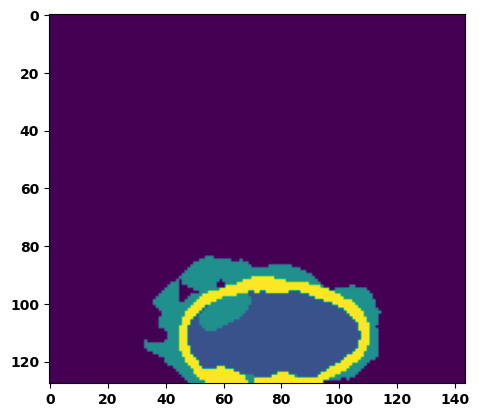

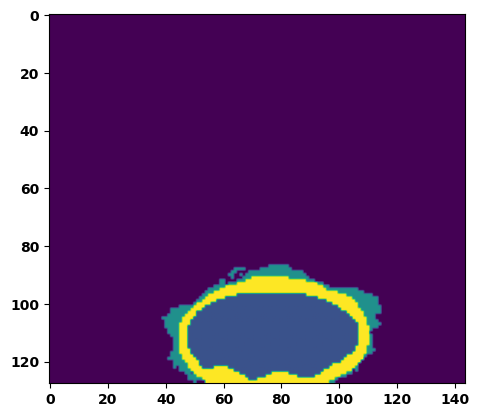

  3%|▎         | 1/36 [00:02<01:39,  2.83s/it]

Batch_id:  1 Test loss:  0.25082141160964966
Batch_id:  1 Test IoU:  tensor(0.6678, device='cuda:0')
Batch_id:  1 Test Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  1 Test Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  1 Test NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  1 Test ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  1 Test ET Dice Score:  tensor(0.9967, device='cuda:0')


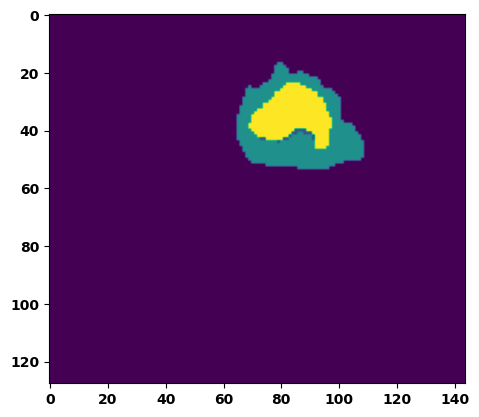

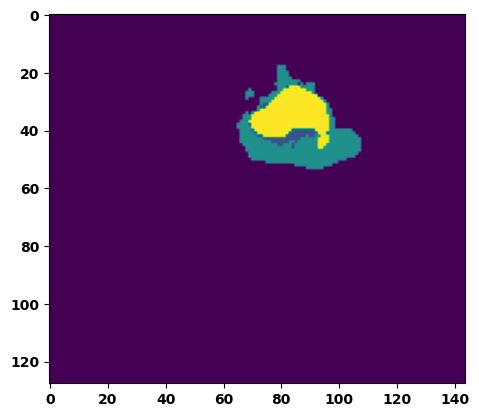

  6%|▌         | 2/36 [00:04<01:06,  1.97s/it]

Batch_id:  2 Test loss:  0.2358788102865219
Batch_id:  2 Test IoU:  tensor(0.6663, device='cuda:0')
Batch_id:  2 Test Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  2 Test Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  2 Test NCR/NET Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  2 Test ED Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  2 Test ET Dice Score:  tensor(0.9790, device='cuda:0')


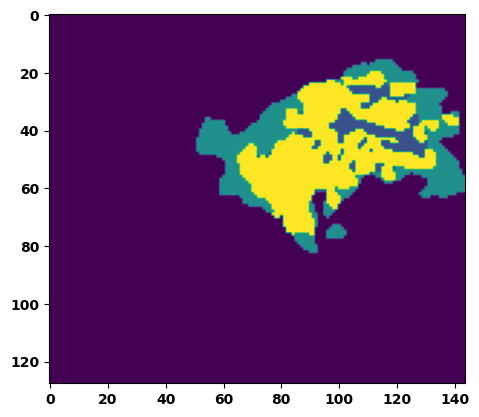

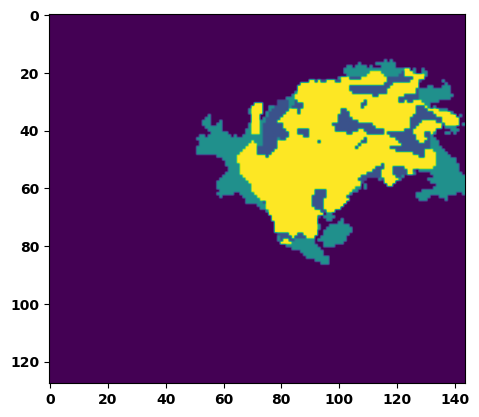

  8%|▊         | 3/36 [00:05<00:53,  1.61s/it]

Batch_id:  3 Test loss:  0.37550610303878784
Batch_id:  3 Test IoU:  tensor(0.5532, device='cuda:0')
Batch_id:  3 Test Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  3 Test Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  3 Test NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  3 Test ED Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  3 Test ET Dice Score:  tensor(0.9943, device='cuda:0')


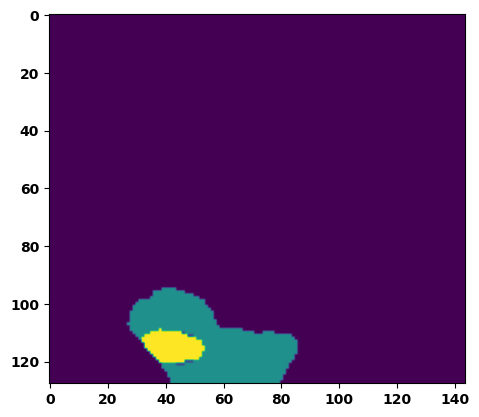

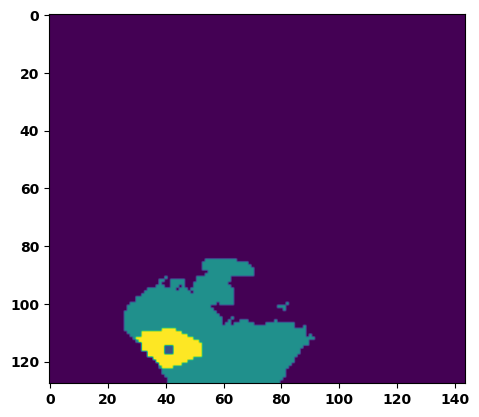

 11%|█         | 4/36 [00:06<00:45,  1.43s/it]

Batch_id:  4 Test loss:  0.14048956334590912
Batch_id:  4 Test IoU:  tensor(0.7796, device='cuda:0')
Batch_id:  4 Test Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  4 Test Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  4 Test NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  4 Test ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  4 Test ET Dice Score:  tensor(0.9948, device='cuda:0')


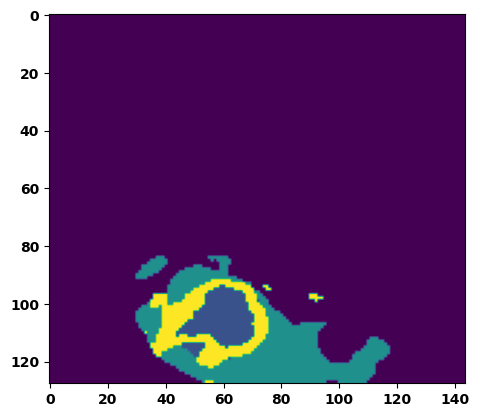

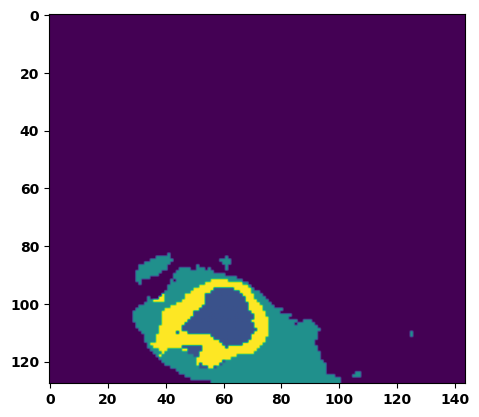

 14%|█▍        | 5/36 [00:07<00:41,  1.34s/it]

Batch_id:  5 Test loss:  0.2129410356283188
Batch_id:  5 Test IoU:  tensor(0.6726, device='cuda:0')
Batch_id:  5 Test Mean Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  5 Test Non-tumor Dice Score:  tensor(0.9428, device='cuda:0')
Batch_id:  5 Test NCR/NET Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  5 Test ED Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  5 Test ET Dice Score:  tensor(0.9825, device='cuda:0')


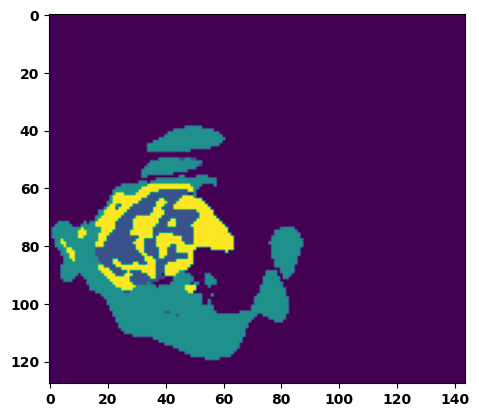

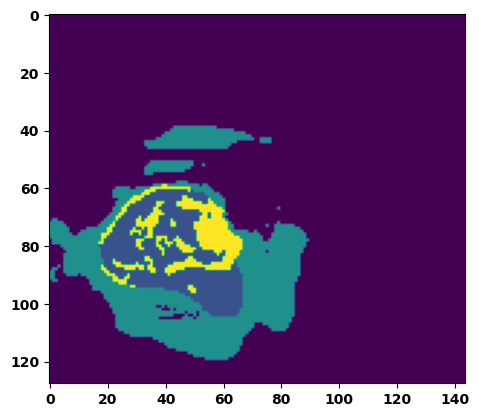

 17%|█▋        | 6/36 [00:08<00:39,  1.31s/it]

Batch_id:  6 Test loss:  0.11674131453037262
Batch_id:  6 Test IoU:  tensor(0.8046, device='cuda:0')
Batch_id:  6 Test Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  6 Test Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  6 Test NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  6 Test ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  6 Test ET Dice Score:  tensor(0.9895, device='cuda:0')


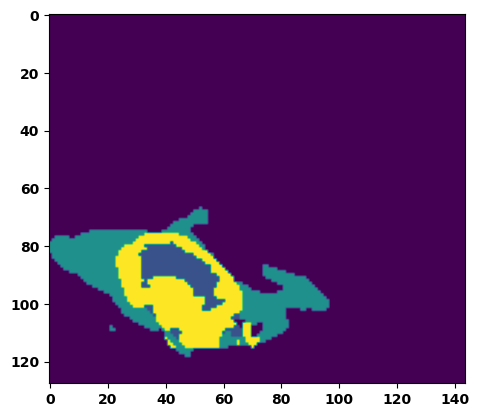

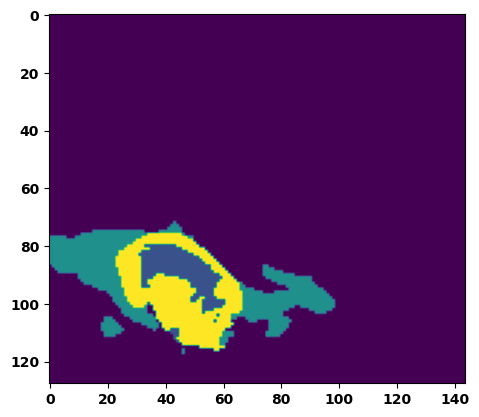

 19%|█▉        | 7/36 [00:10<00:36,  1.27s/it]

Batch_id:  7 Test loss:  0.4467102885246277
Batch_id:  7 Test IoU:  tensor(0.4485, device='cuda:0')
Batch_id:  7 Test Mean Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  7 Test Non-tumor Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  7 Test NCR/NET Dice Score:  tensor(0.9342, device='cuda:0')
Batch_id:  7 Test ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  7 Test ET Dice Score:  tensor(0.9978, device='cuda:0')


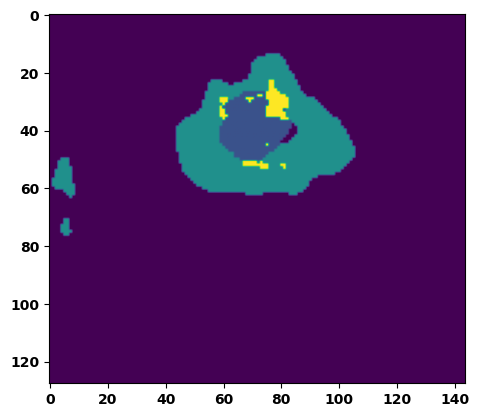

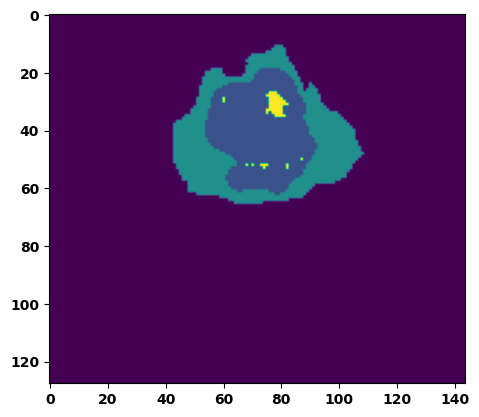

 22%|██▏       | 8/36 [00:11<00:34,  1.22s/it]

Batch_id:  8 Test loss:  0.08516903221607208
Batch_id:  8 Test IoU:  tensor(0.8568, device='cuda:0')
Batch_id:  8 Test Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  8 Test Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  8 Test NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  8 Test ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  8 Test ET Dice Score:  tensor(0.9964, device='cuda:0')


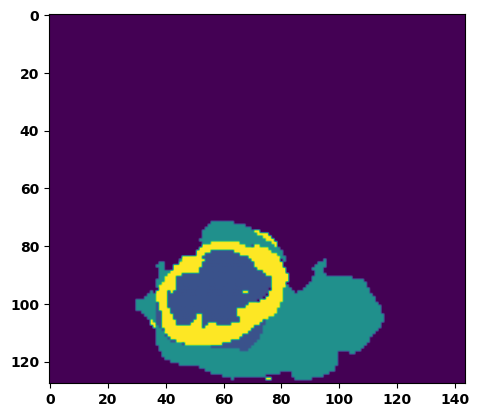

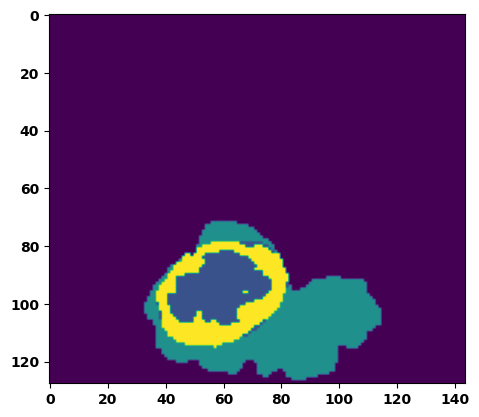

 25%|██▌       | 9/36 [00:12<00:33,  1.25s/it]

Batch_id:  9 Test loss:  0.06913700699806213
Batch_id:  9 Test IoU:  tensor(0.8963, device='cuda:0')
Batch_id:  9 Test Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  9 Test Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  9 Test NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  9 Test ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  9 Test ET Dice Score:  tensor(0.9952, device='cuda:0')


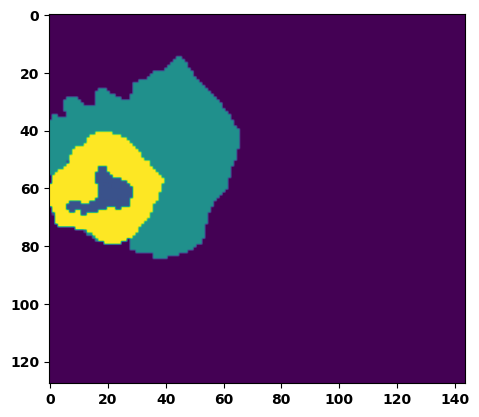

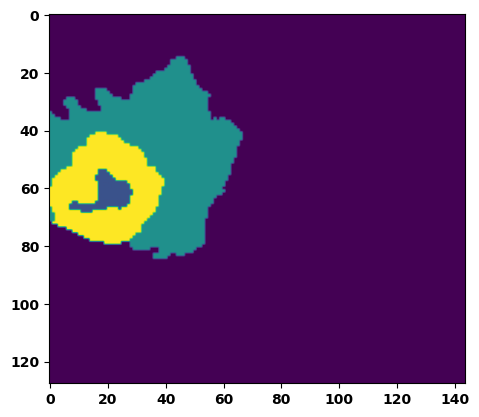

 28%|██▊       | 10/36 [00:13<00:32,  1.24s/it]

Batch_id:  10 Test loss:  0.2585206627845764
Batch_id:  10 Test IoU:  tensor(0.6972, device='cuda:0')
Batch_id:  10 Test Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  10 Test Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  10 Test NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  10 Test ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  10 Test ET Dice Score:  tensor(0.9961, device='cuda:0')


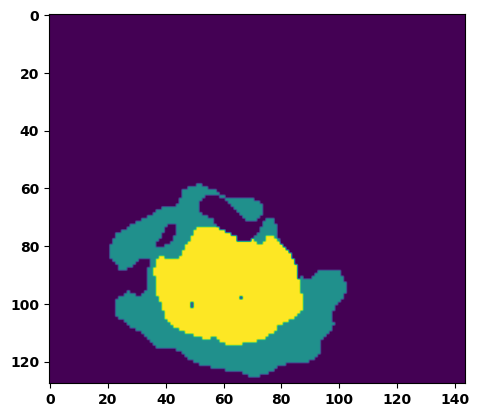

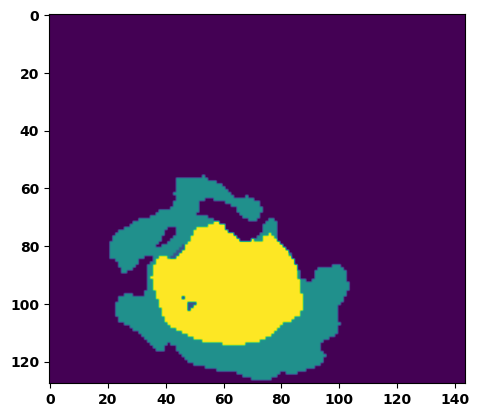

 31%|███       | 11/36 [00:15<00:31,  1.25s/it]

Batch_id:  11 Test loss:  0.2547193765640259
Batch_id:  11 Test IoU:  tensor(0.6532, device='cuda:0')
Batch_id:  11 Test Mean Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  11 Test Non-tumor Dice Score:  tensor(0.9459, device='cuda:0')
Batch_id:  11 Test NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  11 Test ED Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  11 Test ET Dice Score:  tensor(0.9920, device='cuda:0')


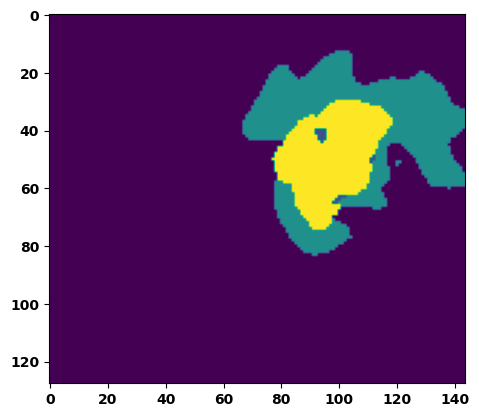

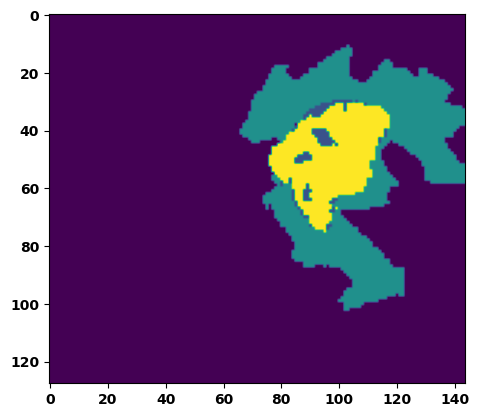

 33%|███▎      | 12/36 [00:16<00:30,  1.27s/it]

Batch_id:  12 Test loss:  0.07963171601295471
Batch_id:  12 Test IoU:  tensor(0.8624, device='cuda:0')
Batch_id:  12 Test Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  12 Test Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  12 Test NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  12 Test ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  12 Test ET Dice Score:  tensor(0.9906, device='cuda:0')


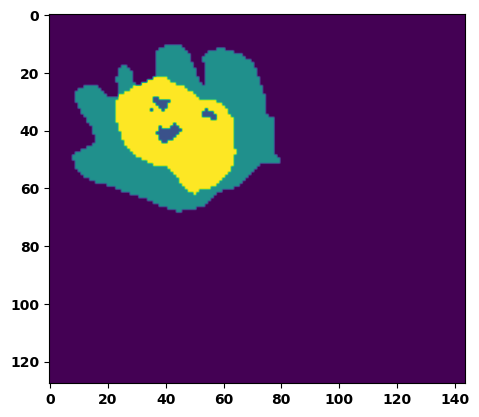

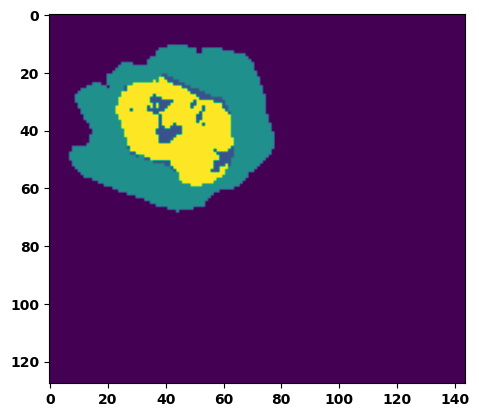

 36%|███▌      | 13/36 [00:17<00:28,  1.24s/it]

Batch_id:  13 Test loss:  0.12499231100082397
Batch_id:  13 Test IoU:  tensor(0.8057, device='cuda:0')
Batch_id:  13 Test Mean Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  13 Test Non-tumor Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  13 Test NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  13 Test ED Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  13 Test ET Dice Score:  tensor(0.9933, device='cuda:0')


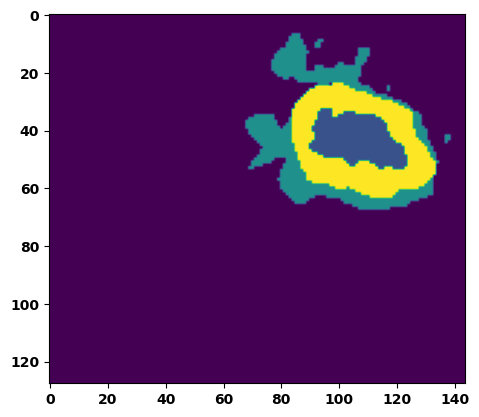

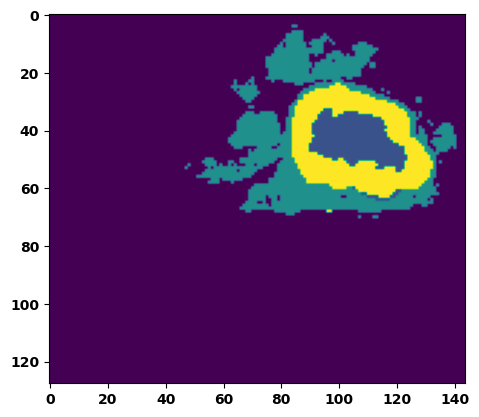

 39%|███▉      | 14/36 [00:18<00:26,  1.21s/it]

Batch_id:  14 Test loss:  0.08796490728855133
Batch_id:  14 Test IoU:  tensor(0.8726, device='cuda:0')
Batch_id:  14 Test Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  14 Test Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  14 Test NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  14 Test ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  14 Test ET Dice Score:  tensor(0.9981, device='cuda:0')


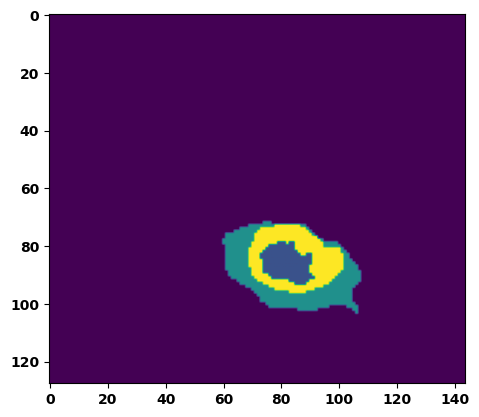

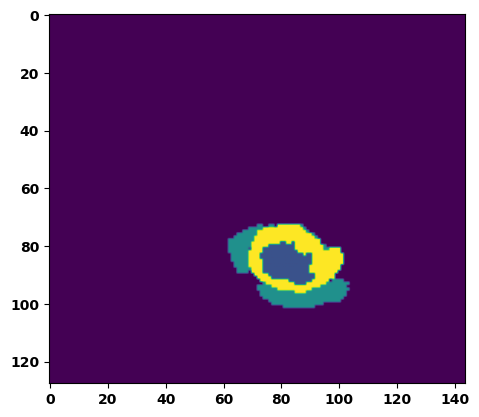

 42%|████▏     | 15/36 [00:19<00:25,  1.19s/it]

Batch_id:  15 Test loss:  0.4066006541252136
Batch_id:  15 Test IoU:  tensor(0.5300, device='cuda:0')
Batch_id:  15 Test Mean Dice Score:  tensor(0.9058, device='cuda:0')
Batch_id:  15 Test Non-tumor Dice Score:  tensor(0.8598, device='cuda:0')
Batch_id:  15 Test NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  15 Test ED Dice Score:  tensor(0.8591, device='cuda:0')
Batch_id:  15 Test ET Dice Score:  tensor(0.9987, device='cuda:0')


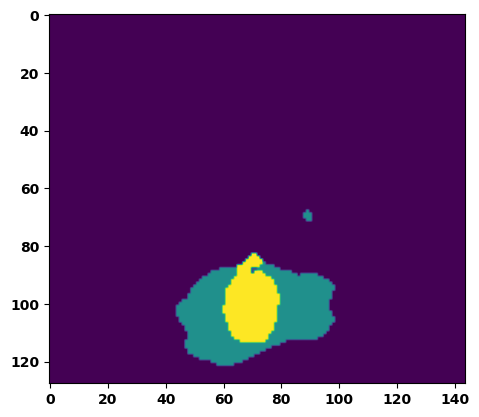

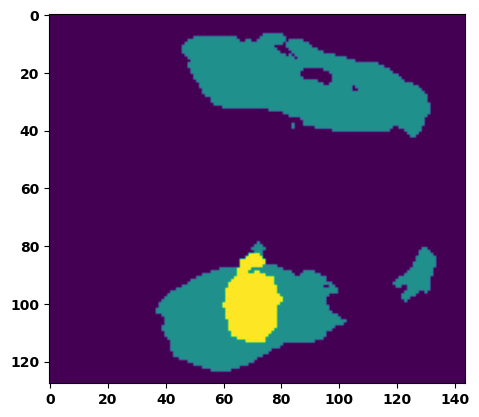

 44%|████▍     | 16/36 [00:21<00:23,  1.20s/it]

Batch_id:  16 Test loss:  0.09678852558135986
Batch_id:  16 Test IoU:  tensor(0.8395, device='cuda:0')
Batch_id:  16 Test Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  16 Test Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  16 Test NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  16 Test ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  16 Test ET Dice Score:  tensor(0.9937, device='cuda:0')


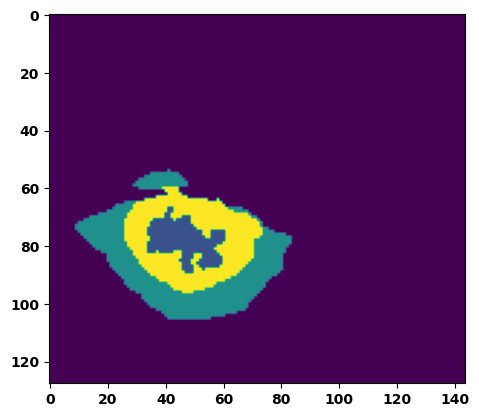

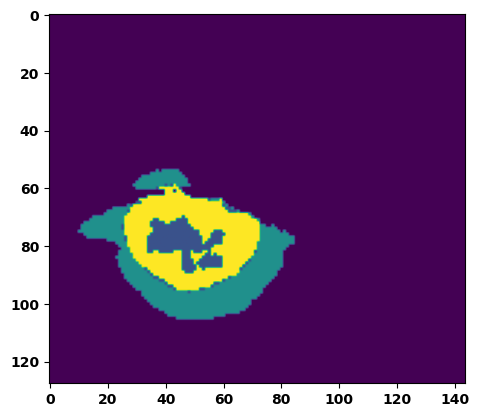

 47%|████▋     | 17/36 [00:22<00:22,  1.19s/it]

Batch_id:  17 Test loss:  0.22846724092960358
Batch_id:  17 Test IoU:  tensor(0.6772, device='cuda:0')
Batch_id:  17 Test Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  17 Test Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  17 Test NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  17 Test ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  17 Test ET Dice Score:  tensor(0.9875, device='cuda:0')


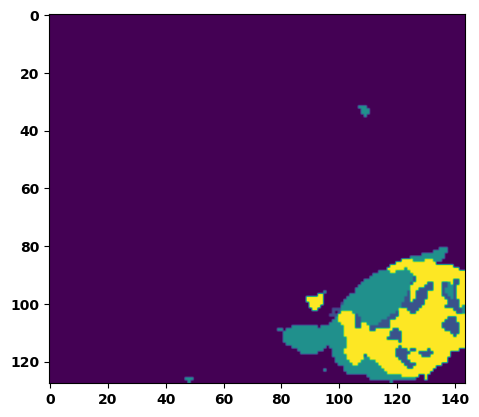

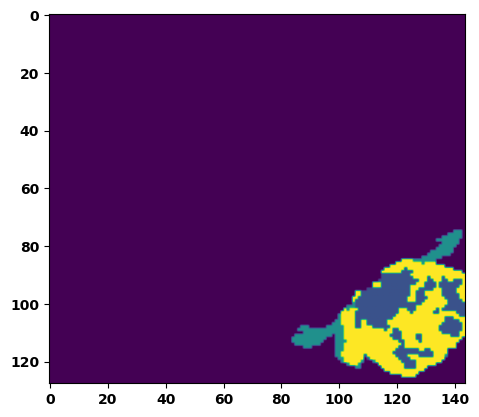

 50%|█████     | 18/36 [00:23<00:22,  1.26s/it]

Batch_id:  18 Test loss:  0.08026780188083649
Batch_id:  18 Test IoU:  tensor(0.8625, device='cuda:0')
Batch_id:  18 Test Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  18 Test Non-tumor Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  18 Test NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  18 Test ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  18 Test ET Dice Score:  tensor(0.9899, device='cuda:0')


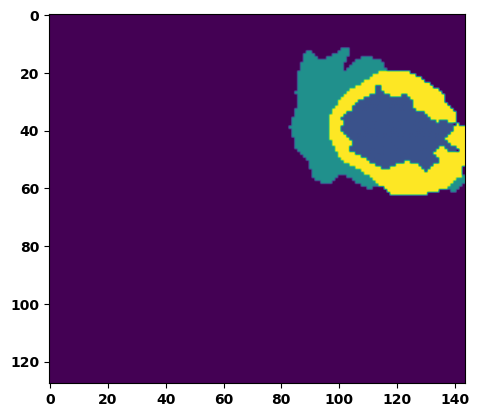

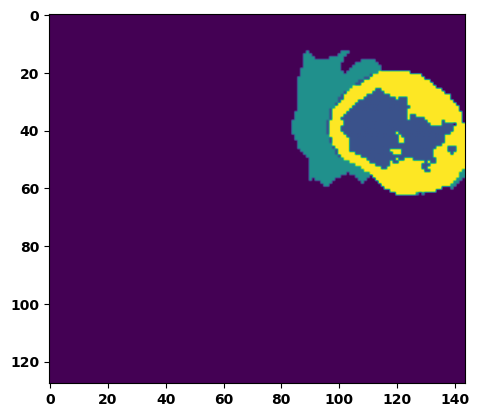

 53%|█████▎    | 19/36 [00:24<00:20,  1.23s/it]

Batch_id:  19 Test loss:  0.1581835299730301
Batch_id:  19 Test IoU:  tensor(0.7600, device='cuda:0')
Batch_id:  19 Test Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  19 Test Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  19 Test NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  19 Test ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  19 Test ET Dice Score:  tensor(0.9956, device='cuda:0')


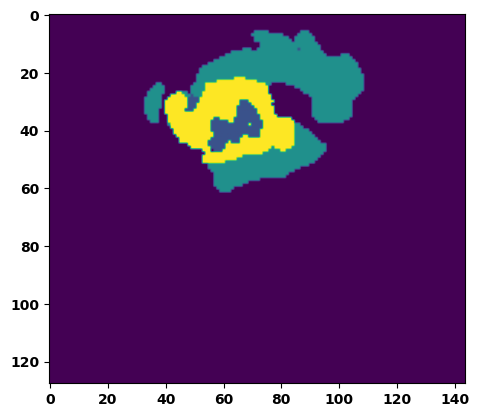

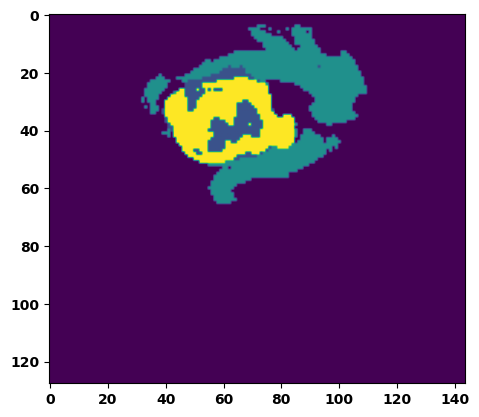

 56%|█████▌    | 20/36 [00:26<00:19,  1.23s/it]

Batch_id:  20 Test loss:  0.06206496059894562
Batch_id:  20 Test IoU:  tensor(0.8935, device='cuda:0')
Batch_id:  20 Test Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  20 Test Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  20 Test NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  20 Test ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  20 Test ET Dice Score:  tensor(0.9931, device='cuda:0')


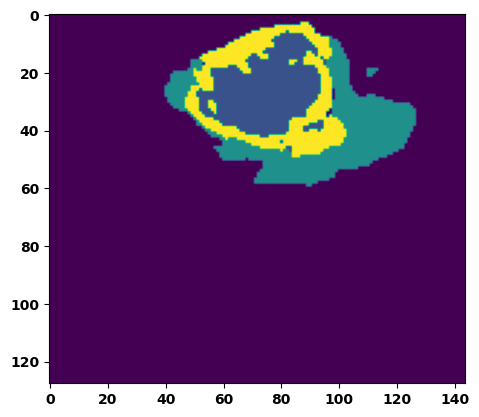

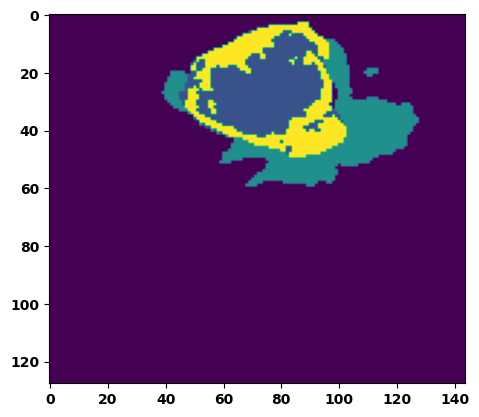

 58%|█████▊    | 21/36 [00:27<00:18,  1.21s/it]

Batch_id:  21 Test loss:  0.17648370563983917
Batch_id:  21 Test IoU:  tensor(0.7320, device='cuda:0')
Batch_id:  21 Test Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  21 Test Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  21 Test NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  21 Test ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  21 Test ET Dice Score:  tensor(0.9887, device='cuda:0')


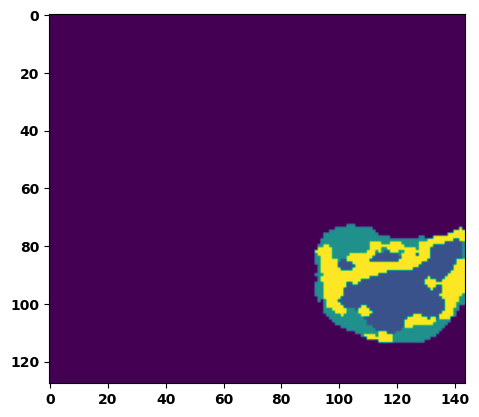

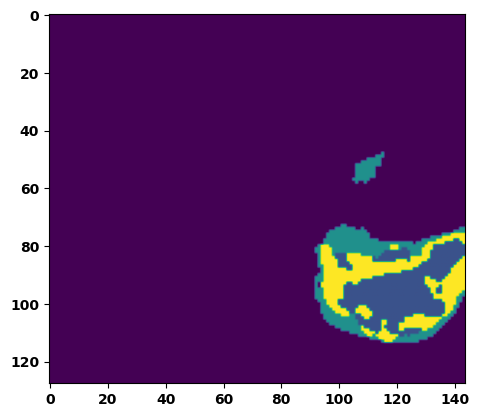

 61%|██████    | 22/36 [00:28<00:17,  1.23s/it]

Batch_id:  22 Test loss:  0.1062295138835907
Batch_id:  22 Test IoU:  tensor(0.8190, device='cuda:0')
Batch_id:  22 Test Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  22 Test Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  22 Test NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  22 Test ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  22 Test ET Dice Score:  tensor(0.9886, device='cuda:0')


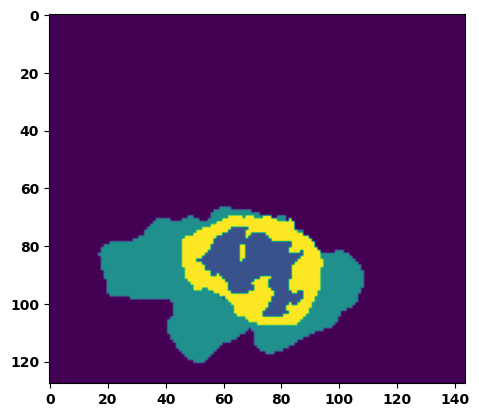

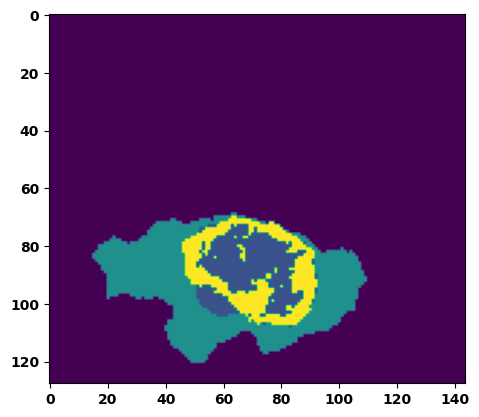

 64%|██████▍   | 23/36 [00:29<00:15,  1.22s/it]

Batch_id:  23 Test loss:  0.4189404845237732
Batch_id:  23 Test IoU:  tensor(0.5054, device='cuda:0')
Batch_id:  23 Test Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  23 Test Non-tumor Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  23 Test NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  23 Test ED Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  23 Test ET Dice Score:  tensor(0.9969, device='cuda:0')


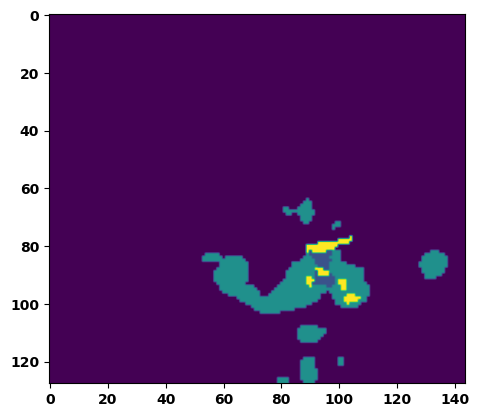

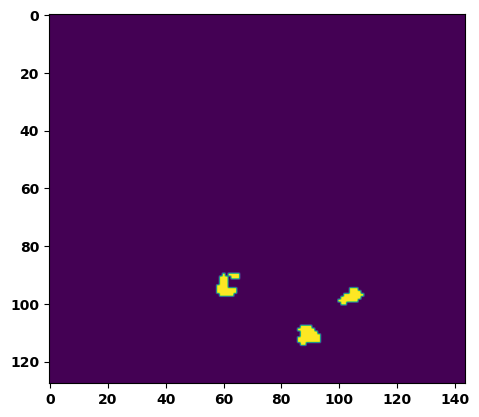

 67%|██████▋   | 24/36 [00:30<00:14,  1.23s/it]

Batch_id:  24 Test loss:  0.1551281362771988
Batch_id:  24 Test IoU:  tensor(0.7715, device='cuda:0')
Batch_id:  24 Test Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  24 Test Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  24 Test NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  24 Test ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  24 Test ET Dice Score:  tensor(0.9897, device='cuda:0')


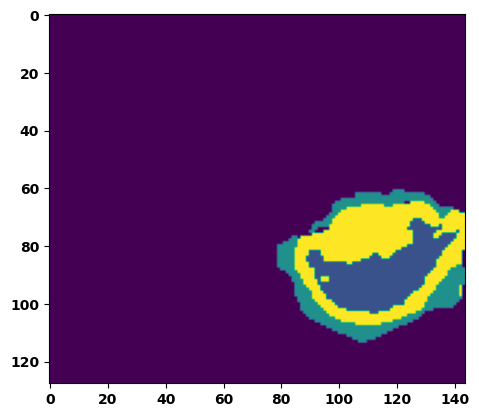

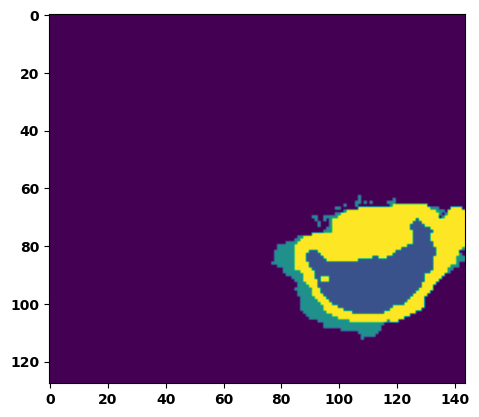

 69%|██████▉   | 25/36 [00:32<00:13,  1.20s/it]

Batch_id:  25 Test loss:  0.5895591974258423
Batch_id:  25 Test IoU:  tensor(0.3596, device='cuda:0')
Batch_id:  25 Test Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  25 Test Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  25 Test NCR/NET Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  25 Test ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  25 Test ET Dice Score:  tensor(0.9928, device='cuda:0')


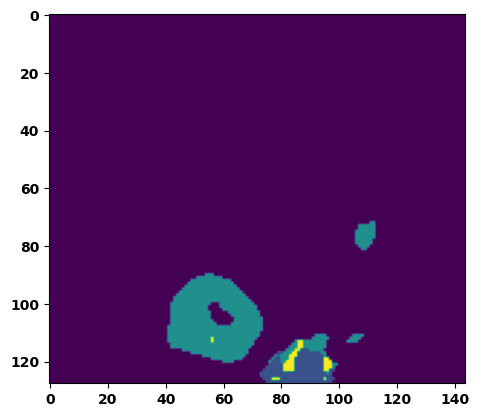

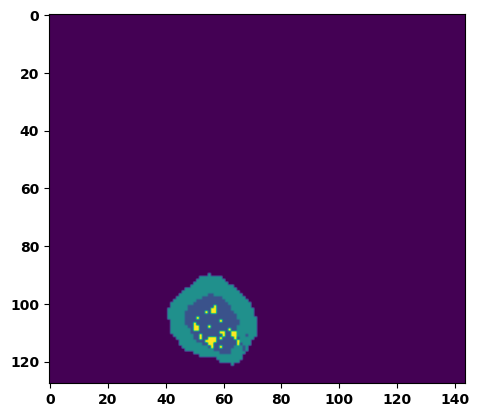

 72%|███████▏  | 26/36 [00:33<00:12,  1.22s/it]

Batch_id:  26 Test loss:  0.7286732792854309
Batch_id:  26 Test IoU:  tensor(0.2472, device='cuda:0')
Batch_id:  26 Test Mean Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  26 Test Non-tumor Dice Score:  tensor(0.9245, device='cuda:0')
Batch_id:  26 Test NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  26 Test ED Dice Score:  tensor(0.9329, device='cuda:0')
Batch_id:  26 Test ET Dice Score:  tensor(0.9945, device='cuda:0')


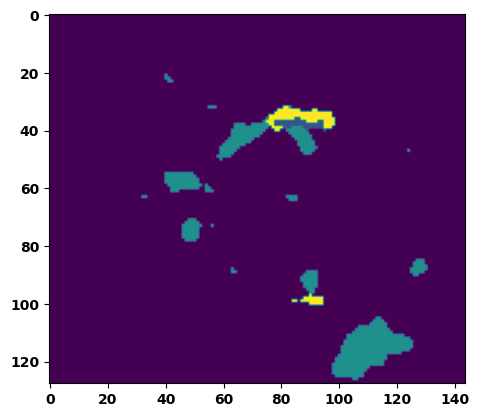

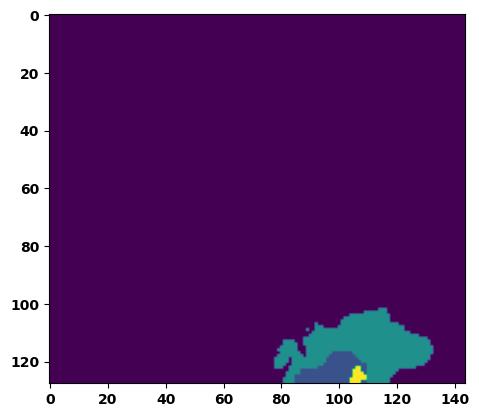

 75%|███████▌  | 27/36 [00:34<00:11,  1.25s/it]

Batch_id:  27 Test loss:  0.20599330961704254
Batch_id:  27 Test IoU:  tensor(0.7065, device='cuda:0')
Batch_id:  27 Test Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  27 Test Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  27 Test NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  27 Test ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  27 Test ET Dice Score:  tensor(0.9884, device='cuda:0')


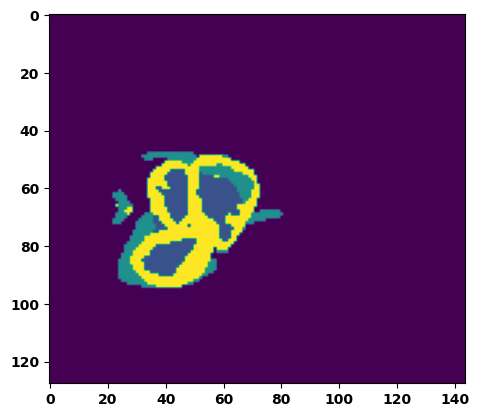

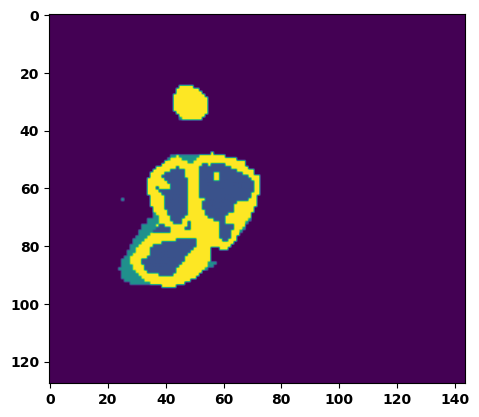

 78%|███████▊  | 28/36 [00:36<00:10,  1.35s/it]

Batch_id:  28 Test loss:  0.21183280646800995
Batch_id:  28 Test IoU:  tensor(0.7013, device='cuda:0')
Batch_id:  28 Test Mean Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  28 Test Non-tumor Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  28 Test NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  28 Test ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  28 Test ET Dice Score:  tensor(0.9943, device='cuda:0')


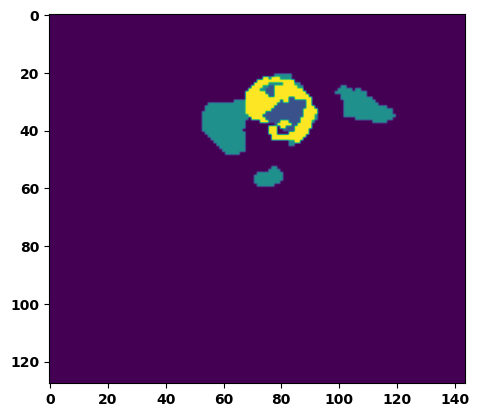

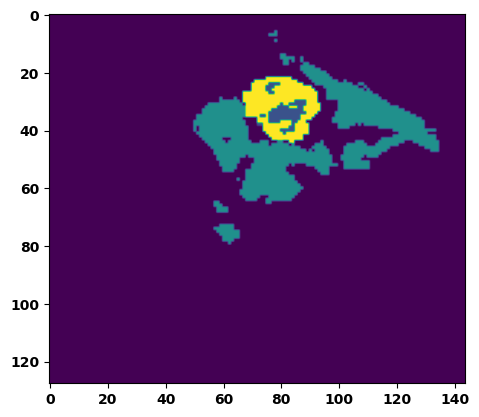

 81%|████████  | 29/36 [00:37<00:09,  1.37s/it]

Batch_id:  29 Test loss:  0.38141825795173645
Batch_id:  29 Test IoU:  tensor(0.5035, device='cuda:0')
Batch_id:  29 Test Mean Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  29 Test Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  29 Test NCR/NET Dice Score:  tensor(0.9280, device='cuda:0')
Batch_id:  29 Test ED Dice Score:  tensor(0.9217, device='cuda:0')
Batch_id:  29 Test ET Dice Score:  tensor(0.9898, device='cuda:0')


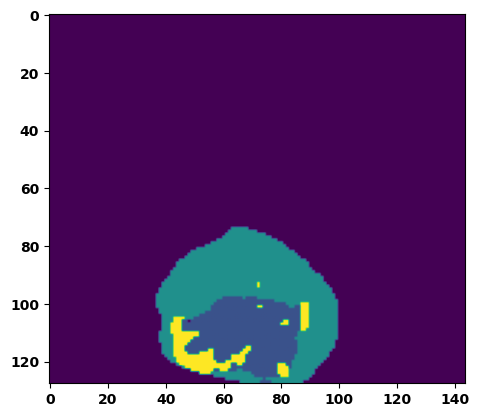

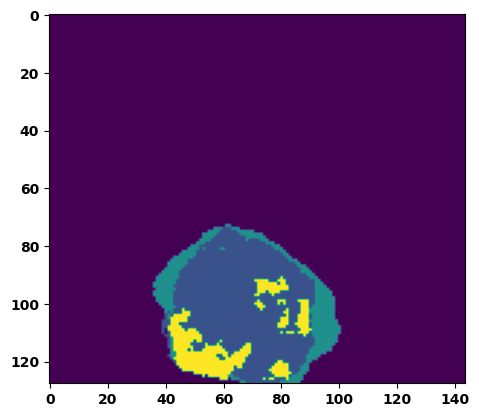

 83%|████████▎ | 30/36 [00:38<00:07,  1.33s/it]

Batch_id:  30 Test loss:  0.11844596266746521
Batch_id:  30 Test IoU:  tensor(0.8447, device='cuda:0')
Batch_id:  30 Test Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  30 Test Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  30 Test NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  30 Test ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  30 Test ET Dice Score:  tensor(0.9949, device='cuda:0')


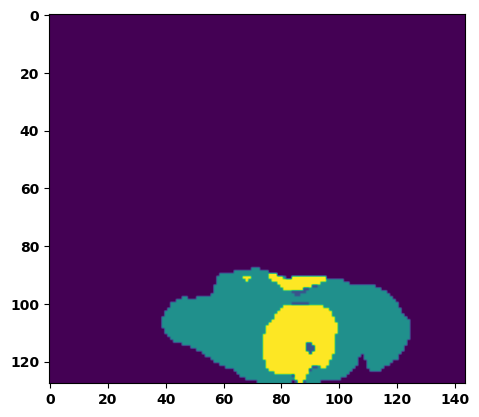

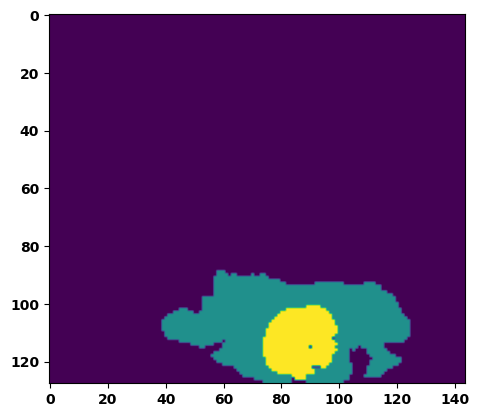

 86%|████████▌ | 31/36 [00:40<00:06,  1.34s/it]

Batch_id:  31 Test loss:  0.20668543875217438
Batch_id:  31 Test IoU:  tensor(0.6910, device='cuda:0')
Batch_id:  31 Test Mean Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  31 Test Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  31 Test NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  31 Test ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  31 Test ET Dice Score:  tensor(0.9863, device='cuda:0')


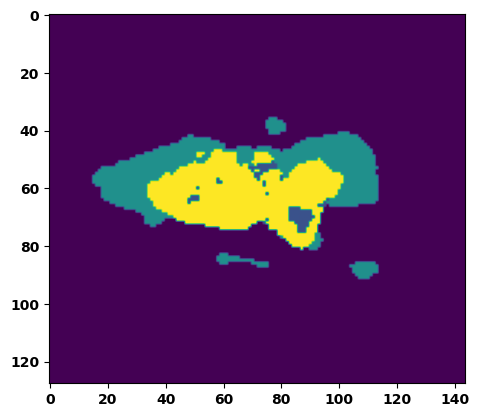

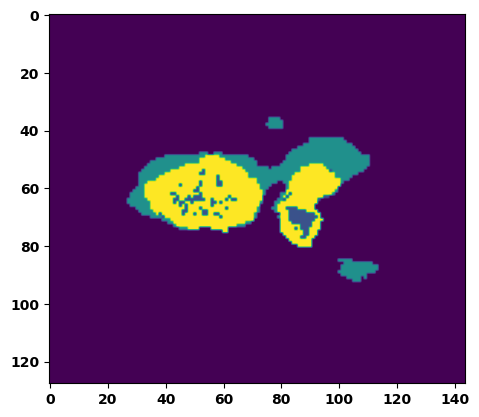

 89%|████████▉ | 32/36 [00:41<00:05,  1.34s/it]

Batch_id:  32 Test loss:  0.07925014197826385
Batch_id:  32 Test IoU:  tensor(0.8705, device='cuda:0')
Batch_id:  32 Test Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  32 Test Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  32 Test NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  32 Test ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  32 Test ET Dice Score:  tensor(0.9871, device='cuda:0')


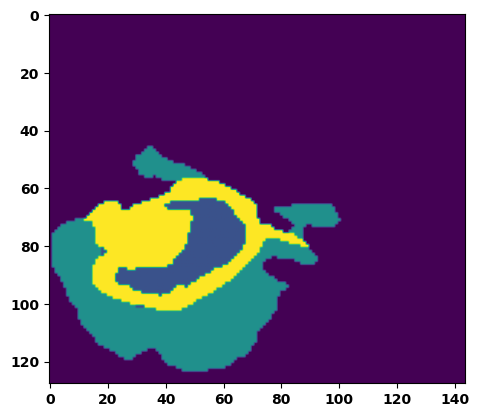

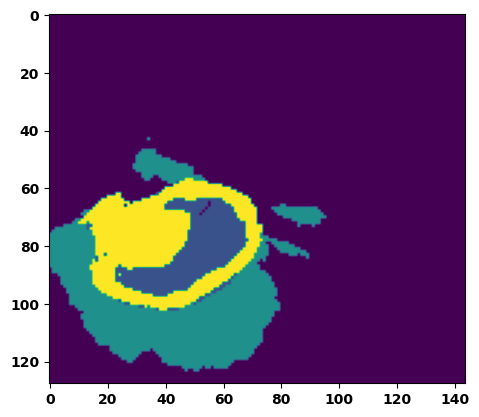

 92%|█████████▏| 33/36 [00:42<00:04,  1.34s/it]

Batch_id:  33 Test loss:  0.10511910915374756
Batch_id:  33 Test IoU:  tensor(0.8239, device='cuda:0')
Batch_id:  33 Test Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  33 Test Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  33 Test NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  33 Test ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  33 Test ET Dice Score:  tensor(0.9914, device='cuda:0')


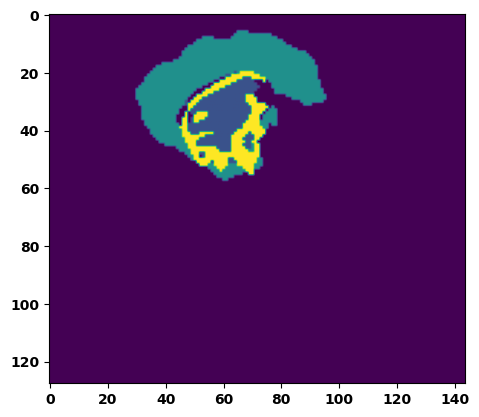

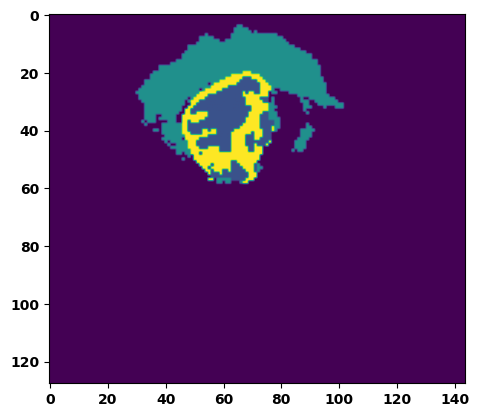

 94%|█████████▍| 34/36 [00:44<00:02,  1.33s/it]

Batch_id:  34 Test loss:  0.1872234344482422
Batch_id:  34 Test IoU:  tensor(0.7277, device='cuda:0')
Batch_id:  34 Test Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  34 Test Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  34 Test NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  34 Test ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  34 Test ET Dice Score:  tensor(0.9956, device='cuda:0')


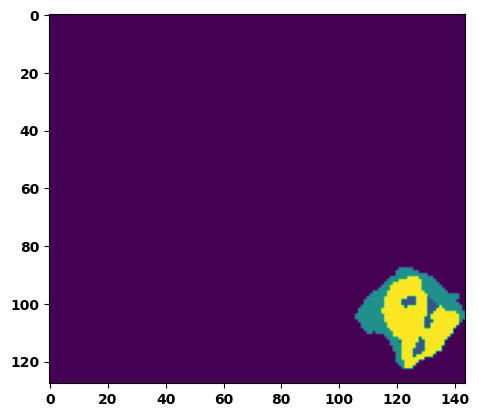

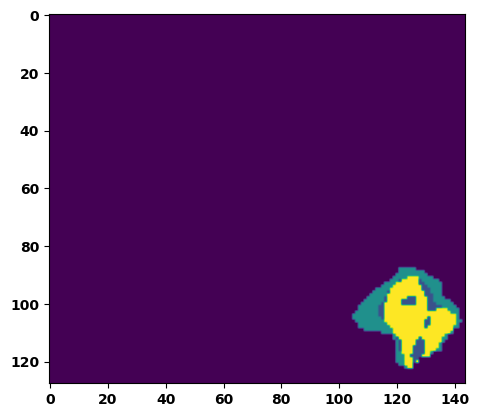

 97%|█████████▋| 35/36 [00:45<00:01,  1.29s/it]

Batch_id:  35 Test loss:  0.07427982985973358
Batch_id:  35 Test IoU:  tensor(0.8741, device='cuda:0')
Batch_id:  35 Test Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  35 Test Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  35 Test NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  35 Test ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  35 Test ET Dice Score:  tensor(0.9898, device='cuda:0')


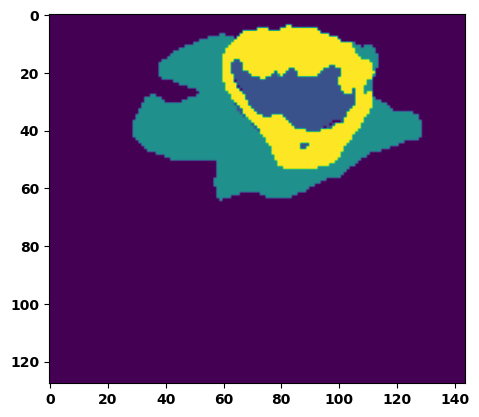

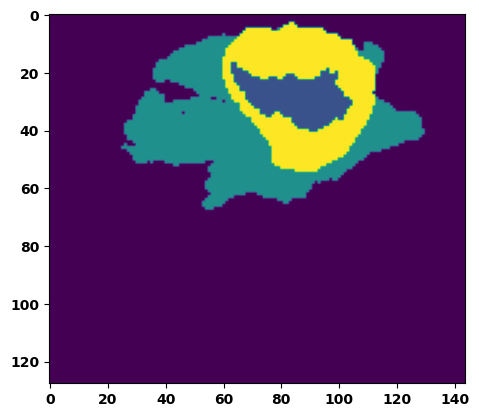

100%|██████████| 36/36 [00:46<00:00,  1.30s/it]

Avg IoU:  tensor(0.7123)
Avg Loss:  0.21550035269724
Avg Dice Scores:  tensor(0.9737)
Non-Tumor Dice Scores:  tensor(0.9725)
NCR/NET Dice Scores:  tensor(0.9879)
ED Dice Scores:  tensor(0.9684)
ET Dice Scores:  tensor(0.9921)


In [12]:
d=torch.load(MODEL_PATH+'tdata.pth')
test(d.dataset)

In [37]:
# main

def main(BEST_EVAL):
    if LOAD_CURRENT:
        train_data = torch.load(MODEL_PATH+'trdata.pth')
        eval_data = torch.load(MODEL_PATH+'edata.pth')
        test_data = torch.load(MODEL_PATH+'tdata.pth')
    else:
        train_data,eval_data,test_data = GetBraTS19Dataset(CSV_FILE,IMAGE_PATH,['t1ce','flair'],batch_size=BATCH_SIZE)
        torch.save(train_data, MODEL_PATH+'trdata.pth')
        torch.save(eval_data, MODEL_PATH+'edata.pth')
        torch.save(test_data,MODEL_PATH+'tdata.pth')
    
    print('Data Loaded!')
    
    
    
    
    
    model = Unet(in_channel=INPUT_CHANNEL,out_channel=4).to(device)
    opt = optim.Adam(model.parameters(), lr=LEARNING_RATE)
    sc = torch.optim.lr_scheduler.ReduceLROnPlateau(opt,patience=5,factor = 0.5,threshold=0.1,mode = 'max',verbose = True)
    if LOAD_CURRENT:
        checkpoint = torch.load(MODEL_PATH+'#21-current')
        model.load_state_dict(checkpoint['model_state_dict'])
        opt.load_state_dict(checkpoint['optim_state_dict'])
        sc.load_state_dict(checkpoint['sche'])
        index =torch.load(MODEL_PATH+'index.pt')
        loss_value=torch.load(MODEL_PATH+'tloss.pt')
        accuracy=torch.load(MODEL_PATH+'tac.pt')
        eval_loss=torch.load(MODEL_PATH+'eloss.pt')
        eval_accuracy=torch.load(MODEL_PATH+'eacc.pt')
        mean_dice=torch.load(MODEL_PATH+'md.pt')
        d0=torch.load(MODEL_PATH+'d0.pt')
        d1=torch.load(MODEL_PATH+'d1.pt')
        d2=torch.load(MODEL_PATH+'d2.pt')
        d3=torch.load(MODEL_PATH+'d3.pt')
        e_mean_dice=torch.load(MODEL_PATH+'emd.pt')
        ed0=torch.load(MODEL_PATH+'ed0.pt')
        ed1=torch.load(MODEL_PATH+'ed1.pt')
        ed2=torch.load(MODEL_PATH+'ed2.pt')
        ed3=torch.load(MODEL_PATH+'ed3.pt')     
        ep = torch.load(MODEL_PATH+'ep.pt')
        
    else:
        index =[]
        loss_value=[]
        accuracy=[]
        eval_loss=[]
        eval_accuracy=[]
        mean_dice=[]
        d0=[]
        d1=[]
        d2=[]
        d3=[]
        e_mean_dice=[]
        ed0=[]
        ed1=[]
        ed2=[]
        ed3=[]
        ep = 0 
    
    
    for i in range (ep,EPOCH):
        print(f'Epoch: {i}')
        
        acc, loss_val,md,di0,di1,di2,di3=training(train_data,model.train(),opt, device,BATCH_SIZE,LEARNING_RATE)
        
        eacc,eloss_val,emd,edi0,edi1,edi2,edi3=evaluation(eval_data,model.eval())
        sc.step(eloss_val)
        
        loss_value.append(loss_val/len(train_data.sampler))
        accuracy.append(acc)
        mean_dice.append(md)
        d0.append(di0)
        d1.append(di1)
        d2.append(di2)
        d3.append(di3)
        
        eval_loss.append(eloss_val/len(eval_data.sampler))
        eval_accuracy.append(eacc)
        e_mean_dice.append(emd)
        ed0.append(edi0)
        ed1.append(edi1)
        ed2.append(edi2)
        ed3.append(edi3)
        
        index.append(i)
        ep=ep+1
        
        torch.save(index,MODEL_PATH+'index.pt')
        torch.save(loss_value,MODEL_PATH+'tloss.pt')
        torch.save(accuracy,MODEL_PATH+'tac.pt')
        torch.save(eval_loss,MODEL_PATH+'eloss.pt')
        torch.save(eval_accuracy,MODEL_PATH+'eacc.pt')
        torch.save(mean_dice,MODEL_PATH+'md.pt')
        torch.save(d0,MODEL_PATH+'d0.pt')
        torch.save(d1,MODEL_PATH+'d1.pt')
        torch.save(d2,MODEL_PATH+'d2.pt')
        torch.save(d3,MODEL_PATH+'d3.pt')
        torch.save(e_mean_dice,MODEL_PATH+'emd.pt')
        torch.save(ed0,MODEL_PATH+'ed0.pt')
        torch.save(ed1,MODEL_PATH+'ed1.pt')
        torch.save(ed2,MODEL_PATH+'ed2.pt')
        torch.save(ed3,MODEL_PATH+'ed3.pt')     
        torch.save(ep,MODEL_PATH+'ep.pt')
        
        
        print('Epoch ',i,'Training loss: ',loss_val/len(train_data.sampler))
        print('Epoch ',i,'Evaluation loss: ',eloss_val/len(eval_data.sampler))
        
        print('Epoch ',i,'Training accuracy : ',acc)
        print('Epoch ',i,'Evaluation accuracy : ',eacc)
        
        print('Epoch ',i,'Training Mean Dice Score: ',md)
        print('Epoch ',i,'Eval Mean Dice Score: ',emd)
        
        print('Epoch ',i,'Training Non-tumor Dice Score: ',di0)
        print('Epoch ',i,'Eval Non-tumor Dice Score: ',edi0)
       
        print('Epoch ',i,'Training NCR/NET Dice Score: ',di1)
        print('Epoch ',i,'Eval NCR/NET Dice Score: ',edi1)
        
        print('Epoch ',i,'Training ED Dice Score: ',di2)
        print('Epoch ',i,'Eval ED Dice Score: ',edi2)
        
        print('Epoch ',i,'Training ET Dice Score: ',di3)
        print('Epoch ',i,'Eval ET Dice Score: ',edi3)
        torch.save({
            'model_state_dict': model.state_dict(),
            'optim_state_dict': opt.state_dict(),
            'epoch': i,
            'sche':sc.state_dict(),
            'Training loss_values': loss_val/len(train_data.sampler),
            'Training accuracy':acc,
            'Eval loss_values': eloss_val/len(eval_data.sampler),
            'Eval IoU':eacc,
            'Training Dice Scores':md,
            'Eval Dice Scores': emd,
            'Training Non-tumor Dice Scores':di0,
            'Eval Non-tumor Dice Scores':edi0,   
            'Training NCR/NET Dice Scores': di1,
            'Eval NCR/NET Dice Scores': edi1,   
            'Training ED Dice Scores': di2,
            'Eval ED Dice Scores': edi2,    
            'Training ET Dice Scores': di3,
            'Eval ET Dice Scores': edi3,    
            }, MODEL_PATH+'#21-current')
        print('Epoch completed and model successfully saved')
        if BEST_EVAL < eacc :
            torch.save({
            'model_state_dict': model.state_dict(),
            'optim_state_dict': opt.state_dict(),
            'epoch': i,
            'sche':sc.state_dict(),
            'Training loss_values': loss_val/len(train_data.sampler),
            'Training accuracy':acc,
            'Eval loss_values': eloss_val/len(eval_data.sampler),
            'Eval IoU':eacc,
            'Training Dice Scores':md,
            'Eval Dice Scores': emd,
            'Training Non-tumor Dice Scores':di0,
            'Eval Non-tumor Dice Scores':edi0,   
            'Training NCR/NET Dice Scores': di1,
            'Eval NCR/NET Dice Scores': edi1,   
            'Training ED Dice Scores': di2,
            'Eval ED Dice Scores': edi2,    
            'Training ET Dice Scores': di3,
            'Eval ET Dice Scores': edi3,    
            }, MODEL_PATH+'#21-BEST')
            print("Best Model saved!")
            BEST_EVAL = eacc
        gc.collect()
        torch.cuda.empty_cache()
        if eacc > 0.75:
            break
        
    plt.plot(index, loss_value, label ="Training ")
    plt.plot(index,eval_loss, label = "Validation")
    plt.title("Training and Validation Loss Curve: (Sample_size={}, lr={})".format(BATCH_SIZE*SLICE_NUM ,LEARNING_RATE))
    plt.xlabel("Epoch:")
    plt.ylabel("Average Loss ")
    plt.legend()
    plt.savefig(MODEL_PATH+ 'Training and eval Loss plot.png')
    plt.show()
    
    
    plt.plot(index, accuracy,label ="Training ")
    plt.plot(index, eval_accuracy,label ="Validation ")
    plt.title("Training and Validation IoU Scores (batch_size={}, lr={})".format(BATCH_SIZE*SLICE_NUM, LEARNING_RATE))
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy (Mean IoU Scores)")
    plt.legend()
    plt.savefig(MODEL_PATH+ 'Training and eval Accuracy plot.png')
    plt.show()
    
    plt.plot(index, mean_dice, label ="Training ")
    plt.plot(index,e_mean_dice, label = "Validation")
    plt.title("Training and Validation Mean Dice Scores: (Sample_size={}, lr={})".format(BATCH_SIZE*SLICE_NUM ,LEARNING_RATE))
    plt.xlabel("Epoch:")
    plt.ylabel("Mean Dice Scores: ")
    plt.legend()
    plt.savefig(MODEL_PATH+ 'Training and eval avg dice plot.png')
    plt.show()
    
    plt.plot(index, d0, label ="Non-Tumor ")
    plt.plot(index,d1, label = "NCT/NET")
    plt.plot(index, d2, label ="ED ")
    plt.plot(index,d3, label = "ET")
    plt.title("Training Dice Scores per class: (Sample_size={}, lr={})".format(BATCH_SIZE*SLICE_NUM ,LEARNING_RATE))
    plt.xlabel("Epoch:")
    plt.ylabel("Mean Dice Scores: ")
    plt.legend()
    plt.savefig(MODEL_PATH+ 'Training dice per class plot.png')
    plt.show()
    
    plt.plot(index, ed0, label ="Non-Tumor ")
    plt.plot(index,ed1, label = "NCT/NET")
    plt.plot(index, ed2, label ="ED ")
    plt.plot(index,ed3, label = "ET")
    plt.title("Validation Dice Scores per class: (Sample_size={}, lr={})".format(BATCH_SIZE*SLICE_NUM ,LEARNING_RATE))
    plt.xlabel("Epoch:")
    plt.ylabel("Mean Dice Scores: ")
    plt.legend()
    plt.savefig(MODEL_PATH+ 'Eval dice per class plot.png')
    plt.show()
    test(test_data.dataset)

In [38]:
gc.collect()
torch.cuda.empty_cache()

Data Loaded!
Epoch: 0
Training in session: 


  1%|          | 1/110 [00:01<02:41,  1.48s/it]

Batch_id:  0 Training loss:  0.8631753325462341
Batch_id:  0 Training IoU:  tensor(0.0488, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.4330, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.2060, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.6352, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.4650, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:34,  1.43s/it]

Batch_id:  1 Training loss:  0.8546462655067444
Batch_id:  1 Training IoU:  tensor(0.0474, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.4496, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.2047, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.4315, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.7672, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9453, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:39,  1.49s/it]

Batch_id:  2 Training loss:  0.825520932674408
Batch_id:  2 Training IoU:  tensor(0.1445, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.5940, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.4291, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.5117, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.8578, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9833, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:27,  1.40s/it]

Batch_id:  3 Training loss:  0.8287835121154785
Batch_id:  3 Training IoU:  tensor(0.2031, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.7057, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.6423, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.5870, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9131, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9747, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:33,  1.46s/it]

Batch_id:  4 Training loss:  0.7691980600357056
Batch_id:  4 Training IoU:  tensor(0.1840, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.6292, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.4508, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.6018, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.8401, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:34,  1.49s/it]

Batch_id:  5 Training loss:  0.7723428606987
Batch_id:  5 Training IoU:  tensor(0.1991, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.6278, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.5422, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.5091, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.8750, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9571, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:32,  1.48s/it]

Batch_id:  6 Training loss:  0.8238407373428345
Batch_id:  6 Training IoU:  tensor(0.1330, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.6040, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.5773, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.5620, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.7530, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9199, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:35,  1.53s/it]

Batch_id:  7 Training loss:  0.7128970623016357
Batch_id:  7 Training IoU:  tensor(0.3040, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.7731, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.7644, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.7127, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.8811, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9611, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:28,  1.47s/it]

Batch_id:  8 Training loss:  0.8091839551925659
Batch_id:  8 Training IoU:  tensor(0.2094, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.7078, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.6430, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.6152, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9200, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9453, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:27,  1.47s/it]

Batch_id:  9 Training loss:  0.8281052112579346
Batch_id:  9 Training IoU:  tensor(0.2185, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.7282, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.6207, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.6989, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.8883, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9768, device='cuda:0')


 10%|█         | 11/110 [00:16<02:25,  1.47s/it]

Batch_id:  10 Training loss:  0.7534627914428711
Batch_id:  10 Training IoU:  tensor(0.2508, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.7737, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.8260, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.8070, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.8067, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.8814, device='cuda:0')


 11%|█         | 12/110 [00:17<02:22,  1.45s/it]

Batch_id:  11 Training loss:  0.787290096282959
Batch_id:  11 Training IoU:  tensor(0.2475, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.7791, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.7373, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.7560, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.8828, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9611, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:26,  1.51s/it]

Batch_id:  12 Training loss:  0.8198685050010681
Batch_id:  12 Training IoU:  tensor(0.1977, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.7367, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.7076, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.7082, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.8502, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9441, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:21,  1.48s/it]

Batch_id:  13 Training loss:  0.7782410383224487
Batch_id:  13 Training IoU:  tensor(0.1574, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.6573, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.5620, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.8848, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.5999, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9252, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:29,  1.57s/it]

Batch_id:  14 Training loss:  0.8343526124954224
Batch_id:  14 Training IoU:  tensor(0.1909, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.7622, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.6870, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.8007, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.8139, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:26,  1.56s/it]

Batch_id:  15 Training loss:  0.7325531244277954
Batch_id:  15 Training IoU:  tensor(0.2952, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.8173, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.8309, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.8137, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.8698, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9375, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:25,  1.56s/it]

Batch_id:  16 Training loss:  0.8175525069236755
Batch_id:  16 Training IoU:  tensor(0.2257, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.8091, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.7410, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.8389, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.8718, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9755, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:17,  1.50s/it]

Batch_id:  17 Training loss:  0.8008458614349365
Batch_id:  17 Training IoU:  tensor(0.2327, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.7550, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.7489, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.7524, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.8549, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9088, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:17,  1.51s/it]

Batch_id:  18 Training loss:  0.8206205368041992
Batch_id:  18 Training IoU:  tensor(0.1844, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.7224, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.5903, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.7544, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.8281, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:13,  1.49s/it]

Batch_id:  19 Training loss:  0.6901571154594421
Batch_id:  19 Training IoU:  tensor(0.3487, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.8735, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.8401, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9021, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9041, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9741, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:14,  1.51s/it]

Batch_id:  20 Training loss:  0.7931962609291077
Batch_id:  20 Training IoU:  tensor(0.2491, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.7966, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.8605, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.8118, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.8107, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9066, device='cuda:0')


 20%|██        | 22/110 [00:32<02:12,  1.51s/it]

Batch_id:  21 Training loss:  0.7410721778869629
Batch_id:  21 Training IoU:  tensor(0.3049, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.8589, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.8118, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.8968, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.8789, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 21%|██        | 23/110 [00:34<02:08,  1.47s/it]

Batch_id:  22 Training loss:  0.7131080627441406
Batch_id:  22 Training IoU:  tensor(0.3115, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.8590, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.8758, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9052, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.8722, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9236, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:07,  1.49s/it]

Batch_id:  23 Training loss:  0.7177623510360718
Batch_id:  23 Training IoU:  tensor(0.3144, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.8092, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.7968, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.7901, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9142, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9264, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:02,  1.44s/it]

Batch_id:  24 Training loss:  0.7669264078140259
Batch_id:  24 Training IoU:  tensor(0.2641, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.7627, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.6499, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.7398, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9027, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:01,  1.45s/it]

Batch_id:  25 Training loss:  0.7443509697914124
Batch_id:  25 Training IoU:  tensor(0.2562, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.7917, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.7560, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.8435, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.8319, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9437, device='cuda:0')


 25%|██▍       | 27/110 [00:39<01:57,  1.41s/it]

Batch_id:  26 Training loss:  0.7360091209411621
Batch_id:  26 Training IoU:  tensor(0.3062, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.8074, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.7806, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.7729, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9212, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9474, device='cuda:0')


 25%|██▌       | 28/110 [00:41<01:57,  1.44s/it]

Batch_id:  27 Training loss:  0.6735166311264038
Batch_id:  27 Training IoU:  tensor(0.3928, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.8782, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.8631, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.8610, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9697, device='cuda:0')


 26%|██▋       | 29/110 [00:43<01:59,  1.47s/it]

Batch_id:  28 Training loss:  0.8186250925064087
Batch_id:  28 Training IoU:  tensor(0.2123, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.7696, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.6747, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.7641, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.8861, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9839, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:57,  1.46s/it]

Batch_id:  29 Training loss:  0.7482874989509583
Batch_id:  29 Training IoU:  tensor(0.2902, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.8279, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.8029, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.8212, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.8995, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9600, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:54,  1.44s/it]

Batch_id:  30 Training loss:  0.7169618606567383
Batch_id:  30 Training IoU:  tensor(0.3682, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.8811, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.8603, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.8689, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9668, device='cuda:0')


 29%|██▉       | 32/110 [00:47<01:56,  1.49s/it]

Batch_id:  31 Training loss:  0.8339372873306274
Batch_id:  31 Training IoU:  tensor(0.2333, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.8231, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.7771, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.7829, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9258, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 30%|███       | 33/110 [00:48<01:52,  1.46s/it]

Batch_id:  32 Training loss:  0.7810318470001221
Batch_id:  32 Training IoU:  tensor(0.2436, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.7905, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.7014, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.8068, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.8776, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 31%|███       | 34/110 [00:50<01:53,  1.50s/it]

Batch_id:  33 Training loss:  0.8400768041610718
Batch_id:  33 Training IoU:  tensor(0.2242, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.8254, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.7864, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.7726, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9377, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9794, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:47,  1.43s/it]

Batch_id:  34 Training loss:  0.7436244487762451
Batch_id:  34 Training IoU:  tensor(0.3110, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.8641, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9053, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.8814, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.8738, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9318, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:47,  1.46s/it]

Batch_id:  35 Training loss:  0.7543356418609619
Batch_id:  35 Training IoU:  tensor(0.2154, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.7137, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.6059, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.7748, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.8038, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9565, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:45,  1.45s/it]

Batch_id:  36 Training loss:  0.8232636451721191
Batch_id:  36 Training IoU:  tensor(0.2244, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.8271, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.8731, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.7896, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.8698, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9487, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:45,  1.47s/it]

Batch_id:  37 Training loss:  0.6973724365234375
Batch_id:  37 Training IoU:  tensor(0.3348, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.8490, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.8463, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.8752, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9187, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9069, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:41,  1.43s/it]

Batch_id:  38 Training loss:  0.7682850360870361
Batch_id:  38 Training IoU:  tensor(0.3010, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.8564, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.8257, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.8621, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9193, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9623, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:37,  1.40s/it]

Batch_id:  39 Training loss:  0.6972614526748657
Batch_id:  39 Training IoU:  tensor(0.4388, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.8877, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.8502, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.8538, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9765, device='cuda:0')


 37%|███▋      | 41/110 [01:00<01:41,  1.47s/it]

Batch_id:  40 Training loss:  0.6853619813919067
Batch_id:  40 Training IoU:  tensor(0.3301, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.8631, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9134, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.8888, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.8765, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9106, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:42,  1.50s/it]

Batch_id:  41 Training loss:  0.797225296497345
Batch_id:  41 Training IoU:  tensor(0.2279, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.7993, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.7130, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.8268, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.8654, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 39%|███▉      | 43/110 [01:03<01:37,  1.46s/it]

Batch_id:  42 Training loss:  0.7250715494155884
Batch_id:  42 Training IoU:  tensor(0.3367, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.8723, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.8431, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.8680, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9271, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9787, device='cuda:0')


 40%|████      | 44/110 [01:04<01:36,  1.46s/it]

Batch_id:  43 Training loss:  0.7086824178695679
Batch_id:  43 Training IoU:  tensor(0.3171, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.8596, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.8184, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.8885, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.8975, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9743, device='cuda:0')


 41%|████      | 45/110 [01:06<01:36,  1.49s/it]

Batch_id:  44 Training loss:  0.6682491898536682
Batch_id:  44 Training IoU:  tensor(0.4367, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9320, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9046, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9216, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:37,  1.52s/it]

Batch_id:  45 Training loss:  0.7278302311897278
Batch_id:  45 Training IoU:  tensor(0.2634, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.7860, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.8083, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.8499, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.7727, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9273, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:29,  1.43s/it]

Batch_id:  46 Training loss:  0.7492636442184448
Batch_id:  46 Training IoU:  tensor(0.2739, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.8441, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.7915, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.8892, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.8680, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 44%|████▎     | 48/110 [01:10<01:29,  1.45s/it]

Batch_id:  47 Training loss:  0.7467397451400757
Batch_id:  47 Training IoU:  tensor(0.2984, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.8749, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.8832, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9011, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9037, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9367, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:29,  1.47s/it]

Batch_id:  48 Training loss:  0.7438628077507019
Batch_id:  48 Training IoU:  tensor(0.3425, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.8891, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.8470, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.8864, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:26,  1.44s/it]

Batch_id:  49 Training loss:  0.7301612496376038
Batch_id:  49 Training IoU:  tensor(0.3393, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.8959, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9323, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.8862, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9160, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9531, device='cuda:0')


 46%|████▋     | 51/110 [01:15<01:25,  1.45s/it]

Batch_id:  50 Training loss:  0.7918528318405151
Batch_id:  50 Training IoU:  tensor(0.2825, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.8543, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9390, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.7905, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.8354, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:25,  1.47s/it]

Batch_id:  51 Training loss:  0.7672873735427856
Batch_id:  51 Training IoU:  tensor(0.2885, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.8399, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.8477, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.7936, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.8879, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:21,  1.44s/it]

Batch_id:  52 Training loss:  0.7647606134414673
Batch_id:  52 Training IoU:  tensor(0.2924, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.8548, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.8517, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.8437, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9283, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9408, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:19,  1.43s/it]

Batch_id:  53 Training loss:  0.8295789361000061
Batch_id:  53 Training IoU:  tensor(0.2077, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.8036, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.7068, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9198, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.7910, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 50%|█████     | 55/110 [01:20<01:18,  1.42s/it]

Batch_id:  54 Training loss:  0.7708580493927002
Batch_id:  54 Training IoU:  tensor(0.2710, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.8216, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.7548, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.8175, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9157, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9767, device='cuda:0')


 51%|█████     | 56/110 [01:22<01:14,  1.39s/it]

Batch_id:  55 Training loss:  0.8209133148193359
Batch_id:  55 Training IoU:  tensor(0.1866, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.7729, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.7197, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.7423, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.8849, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9719, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:15,  1.43s/it]

Batch_id:  56 Training loss:  0.6793674826622009
Batch_id:  56 Training IoU:  tensor(0.3987, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.8320, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.7935, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.8271, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9129, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9624, device='cuda:0')


 53%|█████▎    | 58/110 [01:25<01:14,  1.44s/it]

Batch_id:  57 Training loss:  0.7409994602203369
Batch_id:  57 Training IoU:  tensor(0.3851, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.8663, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.8007, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.8621, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 54%|█████▎    | 59/110 [01:26<01:12,  1.42s/it]

Batch_id:  58 Training loss:  0.6565439105033875
Batch_id:  58 Training IoU:  tensor(0.4824, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.8637, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.8150, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.8564, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9405, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9791, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:16,  1.52s/it]

Batch_id:  59 Training loss:  0.7673265337944031
Batch_id:  59 Training IoU:  tensor(0.2816, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.7929, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.7133, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.7989, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.8986, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9678, device='cuda:0')


 55%|█████▌    | 61/110 [01:29<01:11,  1.45s/it]

Batch_id:  60 Training loss:  0.6881267428398132
Batch_id:  60 Training IoU:  tensor(0.4562, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.8921, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9268, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.8917, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.8952, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9625, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:10,  1.48s/it]

Batch_id:  61 Training loss:  0.7129443883895874
Batch_id:  61 Training IoU:  tensor(0.4259, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.8867, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.8457, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9052, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9443, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9648, device='cuda:0')


 57%|█████▋    | 63/110 [01:32<01:08,  1.46s/it]

Batch_id:  62 Training loss:  0.7388417720794678
Batch_id:  62 Training IoU:  tensor(0.3310, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.8589, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.8346, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.8836, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9073, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9511, device='cuda:0')


 58%|█████▊    | 64/110 [01:33<01:04,  1.41s/it]

Batch_id:  63 Training loss:  0.7829592227935791
Batch_id:  63 Training IoU:  tensor(0.2509, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.7601, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.6444, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.8725, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.8166, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9467, device='cuda:0')


 59%|█████▉    | 65/110 [01:35<01:02,  1.39s/it]

Batch_id:  64 Training loss:  0.7040629386901855
Batch_id:  64 Training IoU:  tensor(0.4295, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.8706, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.8497, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.8647, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9237, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9738, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:03,  1.43s/it]

Batch_id:  65 Training loss:  0.7534211874008179
Batch_id:  65 Training IoU:  tensor(0.3296, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.8224, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.7943, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.7865, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9188, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9677, device='cuda:0')


 61%|██████    | 67/110 [01:37<01:00,  1.40s/it]

Batch_id:  66 Training loss:  0.7812487483024597
Batch_id:  66 Training IoU:  tensor(0.2814, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.8467, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.7747, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.8909, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9185, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9560, device='cuda:0')


 62%|██████▏   | 68/110 [01:39<01:01,  1.47s/it]

Batch_id:  67 Training loss:  0.6002693772315979
Batch_id:  67 Training IoU:  tensor(0.5372, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9208, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9285, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9373, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9574, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<00:59,  1.46s/it]

Batch_id:  68 Training loss:  0.6636389493942261
Batch_id:  68 Training IoU:  tensor(0.4402, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.8583, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9302, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.8381, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.8335, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9731, device='cuda:0')


 64%|██████▎   | 70/110 [01:42<00:56,  1.41s/it]

Batch_id:  69 Training loss:  0.6747868657112122
Batch_id:  69 Training IoU:  tensor(0.4961, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9722, device='cuda:0')


 65%|██████▍   | 71/110 [01:44<00:58,  1.50s/it]

Batch_id:  70 Training loss:  0.8298361897468567
Batch_id:  70 Training IoU:  tensor(0.2013, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.7482, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.6326, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.8829, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.7550, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9741, device='cuda:0')


 65%|██████▌   | 72/110 [01:45<00:56,  1.49s/it]

Batch_id:  71 Training loss:  0.6433457136154175
Batch_id:  71 Training IoU:  tensor(0.5646, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9208, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9812, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:56,  1.52s/it]

Batch_id:  72 Training loss:  0.6215468645095825
Batch_id:  72 Training IoU:  tensor(0.5564, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9324, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9211, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:53,  1.48s/it]

Batch_id:  73 Training loss:  0.7980319261550903
Batch_id:  73 Training IoU:  tensor(0.3085, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.8257, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.7468, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9137, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.8326, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 68%|██████▊   | 75/110 [01:49<00:51,  1.49s/it]

Batch_id:  74 Training loss:  0.7160072326660156
Batch_id:  74 Training IoU:  tensor(0.4566, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9073, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.8783, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9132, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9789, device='cuda:0')


 69%|██████▉   | 76/110 [01:51<00:50,  1.50s/it]

Batch_id:  75 Training loss:  0.6133022308349609
Batch_id:  75 Training IoU:  tensor(0.5921, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9476, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 70%|███████   | 77/110 [01:52<00:48,  1.46s/it]

Batch_id:  76 Training loss:  0.6886050701141357
Batch_id:  76 Training IoU:  tensor(0.4717, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9014, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.8546, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9170, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:46,  1.46s/it]

Batch_id:  77 Training loss:  0.6898813247680664
Batch_id:  77 Training IoU:  tensor(0.3495, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.8548, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.8054, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9015, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.8996, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9580, device='cuda:0')


 72%|███████▏  | 79/110 [01:55<00:43,  1.42s/it]

Batch_id:  78 Training loss:  0.7003697156906128
Batch_id:  78 Training IoU:  tensor(0.3027, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.8245, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.8874, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.8886, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.8100, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.8875, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:43,  1.44s/it]

Batch_id:  79 Training loss:  0.5761108994483948
Batch_id:  79 Training IoU:  tensor(0.6294, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 74%|███████▎  | 81/110 [01:58<00:41,  1.43s/it]

Batch_id:  80 Training loss:  0.6993857622146606
Batch_id:  80 Training IoU:  tensor(0.5784, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9375, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 75%|███████▍  | 82/110 [01:59<00:40,  1.44s/it]

Batch_id:  81 Training loss:  0.6861639022827148
Batch_id:  81 Training IoU:  tensor(0.4871, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9722, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:40,  1.48s/it]

Batch_id:  82 Training loss:  0.6961320638656616
Batch_id:  82 Training IoU:  tensor(0.4625, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9262, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9287, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9693, device='cuda:0')


 76%|███████▋  | 84/110 [02:02<00:37,  1.43s/it]

Batch_id:  83 Training loss:  0.7264965772628784
Batch_id:  83 Training IoU:  tensor(0.3955, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.8555, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.8418, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.8754, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.8713, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9781, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:36,  1.48s/it]

Batch_id:  84 Training loss:  0.5754362344741821
Batch_id:  84 Training IoU:  tensor(0.6036, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9382, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:35,  1.50s/it]

Batch_id:  85 Training loss:  0.750953733921051
Batch_id:  85 Training IoU:  tensor(0.2752, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.8274, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.7969, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9077, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.8374, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9403, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:34,  1.49s/it]

Batch_id:  86 Training loss:  0.6665852069854736
Batch_id:  86 Training IoU:  tensor(0.3920, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.8955, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9053, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.8738, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9443, device='cuda:0')


 80%|████████  | 88/110 [02:08<00:32,  1.50s/it]

Batch_id:  87 Training loss:  0.6889418959617615
Batch_id:  87 Training IoU:  tensor(0.3723, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.8791, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.8863, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.8351, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9445, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:30,  1.44s/it]

Batch_id:  88 Training loss:  0.7050374150276184
Batch_id:  88 Training IoU:  tensor(0.4044, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.8720, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.8138, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.8815, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9819, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:29,  1.47s/it]

Batch_id:  89 Training loss:  0.5736740827560425
Batch_id:  89 Training IoU:  tensor(0.6321, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:28,  1.49s/it]

Batch_id:  90 Training loss:  0.6569594144821167
Batch_id:  90 Training IoU:  tensor(0.4835, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9193, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9338, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9041, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9762, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:26,  1.48s/it]

Batch_id:  91 Training loss:  0.7650725245475769
Batch_id:  91 Training IoU:  tensor(0.4077, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.8694, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.8176, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.8327, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:24,  1.43s/it]

Batch_id:  92 Training loss:  0.7535671591758728
Batch_id:  92 Training IoU:  tensor(0.3330, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.8350, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.7816, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9374, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.8194, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9665, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:23,  1.50s/it]

Batch_id:  93 Training loss:  0.611191987991333
Batch_id:  93 Training IoU:  tensor(0.5415, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9718, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:22,  1.53s/it]

Batch_id:  94 Training loss:  0.7703641057014465
Batch_id:  94 Training IoU:  tensor(0.2679, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.8427, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.7674, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.8472, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9354, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:20,  1.46s/it]

Batch_id:  95 Training loss:  0.8376940488815308
Batch_id:  95 Training IoU:  tensor(0.2030, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.8253, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.7491, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.8590, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.8893, device='cuda:0')


 88%|████████▊ | 97/110 [02:22<00:18,  1.45s/it]

Batch_id:  96 Training loss:  0.6399264931678772
Batch_id:  96 Training IoU:  tensor(0.5224, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9405, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9208, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9761, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:17,  1.45s/it]

Batch_id:  97 Training loss:  0.6556791067123413
Batch_id:  97 Training IoU:  tensor(0.5044, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9454, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9682, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:16,  1.50s/it]

Batch_id:  98 Training loss:  0.620668888092041
Batch_id:  98 Training IoU:  tensor(0.4995, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9339, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9194, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9651, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:14,  1.46s/it]

Batch_id:  99 Training loss:  0.6598690748214722
Batch_id:  99 Training IoU:  tensor(0.5297, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9796, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:13,  1.50s/it]

Batch_id:  100 Training loss:  0.6397804021835327
Batch_id:  100 Training IoU:  tensor(0.4924, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9249, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9257, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9106, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9767, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:11,  1.49s/it]

Batch_id:  101 Training loss:  0.6621147394180298
Batch_id:  101 Training IoU:  tensor(0.4451, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9104, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.8969, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9209, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9646, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.52s/it]

Batch_id:  102 Training loss:  0.7701665163040161
Batch_id:  102 Training IoU:  tensor(0.3523, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9063, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.8671, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9286, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9800, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:08,  1.49s/it]

Batch_id:  103 Training loss:  0.7005632519721985
Batch_id:  103 Training IoU:  tensor(0.4159, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.8828, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.8733, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9104, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.8834, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9814, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.56s/it]

Batch_id:  104 Training loss:  0.6600817441940308
Batch_id:  104 Training IoU:  tensor(0.5172, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9405, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:06,  1.52s/it]

Batch_id:  105 Training loss:  0.564784824848175
Batch_id:  105 Training IoU:  tensor(0.5557, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9475, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9522, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9613, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.50s/it]

Batch_id:  106 Training loss:  0.6128413677215576
Batch_id:  106 Training IoU:  tensor(0.5282, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9139, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9128, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.8947, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:03,  1.52s/it]

Batch_id:  107 Training loss:  0.5952513813972473
Batch_id:  107 Training IoU:  tensor(0.6177, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9529, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.50s/it]

Batch_id:  108 Training loss:  0.6455311179161072
Batch_id:  108 Training IoU:  tensor(0.4156, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.8935, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9038, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.8770, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9474, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.7459809184074402
Batch_id:  109 Training IoU:  tensor(0.2827, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.8661, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.8028, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.8856, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9400, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.6377513408660889
Batch_id:  0 Eval IoU:  tensor(0.4900, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9310, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9205, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9659, device='cuda:0')


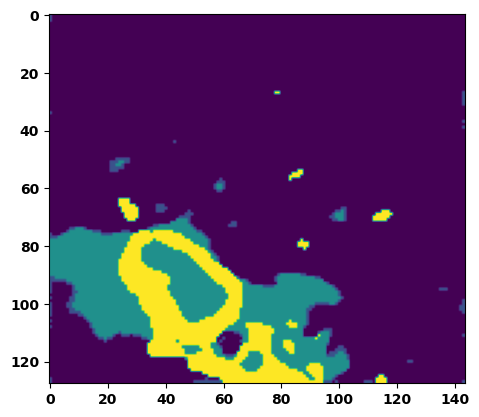

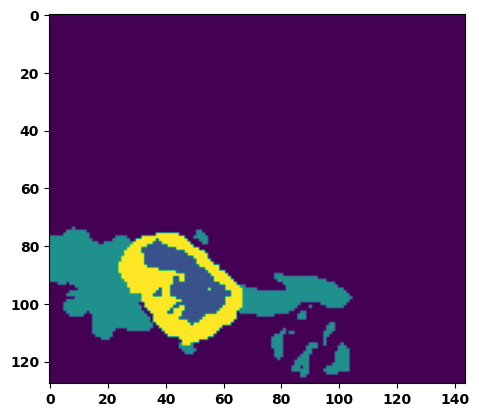

  6%|▌         | 2/36 [00:03<00:57,  1.70s/it]

Batch_id:  1 Eval loss:  0.6109063029289246
Batch_id:  1 Eval IoU:  tensor(0.5670, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9477, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:50,  1.52s/it]

Batch_id:  2 Eval loss:  0.588880717754364
Batch_id:  2 Eval IoU:  tensor(0.5411, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9285, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9383, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9218, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9795, device='cuda:0')


 11%|█         | 4/36 [00:06<00:50,  1.58s/it]

Batch_id:  3 Eval loss:  0.6414388418197632
Batch_id:  3 Eval IoU:  tensor(0.4653, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9008, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.8711, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.8808, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9834, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:48,  1.58s/it]

Batch_id:  4 Eval loss:  0.547781229019165
Batch_id:  4 Eval IoU:  tensor(0.6133, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9452, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9851, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:45,  1.53s/it]

Batch_id:  5 Eval loss:  0.6206260919570923
Batch_id:  5 Eval IoU:  tensor(0.5598, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9383, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9208, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 19%|█▉        | 7/36 [00:11<00:45,  1.57s/it]

Batch_id:  6 Eval loss:  0.7356033325195312
Batch_id:  6 Eval IoU:  tensor(0.3595, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9034, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9028, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9302, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9122, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9651, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:43,  1.54s/it]

Batch_id:  7 Eval loss:  0.6192405223846436
Batch_id:  7 Eval IoU:  tensor(0.5222, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9398, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9457, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9291, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9791, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:40,  1.51s/it]

Batch_id:  8 Eval loss:  0.6984246969223022
Batch_id:  8 Eval IoU:  tensor(0.4123, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9060, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9235, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9340, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.8832, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9773, device='cuda:0')


 28%|██▊       | 10/36 [00:15<00:39,  1.52s/it]

Batch_id:  9 Eval loss:  0.7173060178756714
Batch_id:  9 Eval IoU:  tensor(0.4674, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9036, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.8631, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9084, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  10 Eval loss:  0.6671317219734192
Batch_id:  10 Eval IoU:  tensor(0.4287, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9229, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9002, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9352, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9606, device='cuda:0')


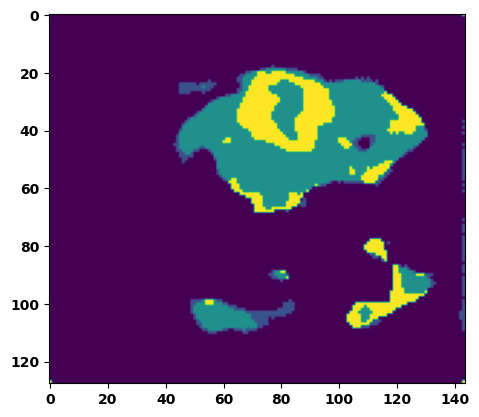

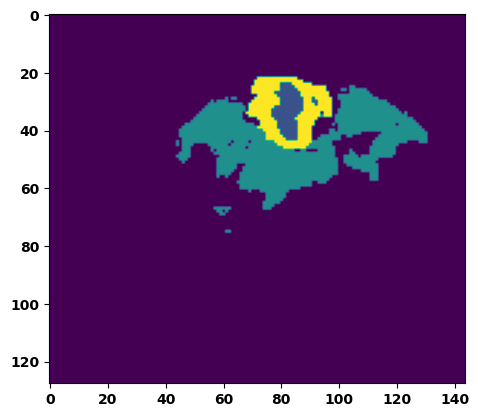

 33%|███▎      | 12/36 [00:18<00:38,  1.58s/it]

Batch_id:  11 Eval loss:  0.5867583751678467
Batch_id:  11 Eval IoU:  tensor(0.5732, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9143, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9015, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.8934, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


 36%|███▌      | 13/36 [00:20<00:36,  1.57s/it]

Batch_id:  12 Eval loss:  0.6043645143508911
Batch_id:  12 Eval IoU:  tensor(0.5380, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9445, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9220, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9820, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:35,  1.60s/it]

Batch_id:  13 Eval loss:  0.6177643537521362
Batch_id:  13 Eval IoU:  tensor(0.4893, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9146, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9201, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9454, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.8996, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9787, device='cuda:0')


 42%|████▏     | 15/36 [00:23<00:32,  1.56s/it]

Batch_id:  14 Eval loss:  0.5329686403274536
Batch_id:  14 Eval IoU:  tensor(0.6183, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9803, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:31,  1.57s/it]

Batch_id:  15 Eval loss:  0.6077498197555542
Batch_id:  15 Eval IoU:  tensor(0.5765, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')


 47%|████▋     | 17/36 [00:26<00:29,  1.56s/it]

Batch_id:  16 Eval loss:  0.5660429000854492
Batch_id:  16 Eval IoU:  tensor(0.5845, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9450, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9367, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


 50%|█████     | 18/36 [00:28<00:28,  1.57s/it]

Batch_id:  17 Eval loss:  0.8136794567108154
Batch_id:  17 Eval IoU:  tensor(0.2016, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.8063, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.7322, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.7635, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9693, device='cuda:0')


 53%|█████▎    | 19/36 [00:29<00:26,  1.56s/it]

Batch_id:  18 Eval loss:  0.7082332968711853
Batch_id:  18 Eval IoU:  tensor(0.3621, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9109, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.8980, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.8987, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9654, device='cuda:0')


 56%|█████▌    | 20/36 [00:31<00:23,  1.49s/it]

Batch_id:  19 Eval loss:  0.7232457995414734
Batch_id:  19 Eval IoU:  tensor(0.4071, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9051, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9060, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.8837, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  20 Eval loss:  0.7364296913146973
Batch_id:  20 Eval IoU:  tensor(0.3531, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9142, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9087, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.8795, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9790, device='cuda:0')


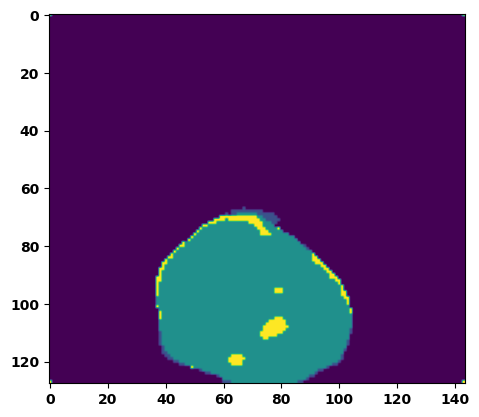

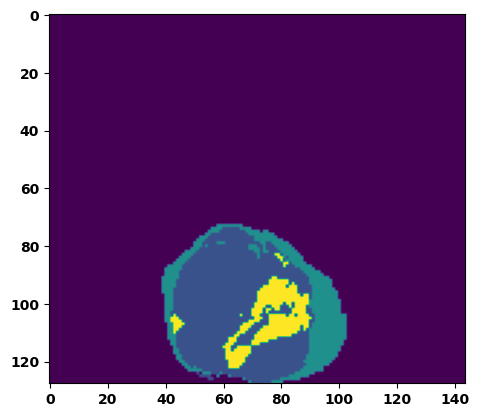

 61%|██████    | 22/36 [00:34<00:20,  1.49s/it]

Batch_id:  21 Eval loss:  0.6520989537239075
Batch_id:  21 Eval IoU:  tensor(0.4442, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9071, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.8849, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9238, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9634, device='cuda:0')


 64%|██████▍   | 23/36 [00:35<00:19,  1.48s/it]

Batch_id:  22 Eval loss:  0.751505970954895
Batch_id:  22 Eval IoU:  tensor(0.3671, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.8727, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.8222, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9444, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.8657, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9857, device='cuda:0')


 67%|██████▋   | 24/36 [00:37<00:18,  1.51s/it]

Batch_id:  23 Eval loss:  0.7995867133140564
Batch_id:  23 Eval IoU:  tensor(0.2229, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.8289, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.7635, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.8600, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9016, device='cuda:0')


 69%|██████▉   | 25/36 [00:38<00:16,  1.54s/it]

Batch_id:  24 Eval loss:  0.5441861748695374
Batch_id:  24 Eval IoU:  tensor(0.6546, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')


 72%|███████▏  | 26/36 [00:40<00:16,  1.61s/it]

Batch_id:  25 Eval loss:  0.7076370120048523
Batch_id:  25 Eval IoU:  tensor(0.4389, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9300, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9268, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9354, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9808, device='cuda:0')


 75%|███████▌  | 27/36 [00:41<00:14,  1.59s/it]

Batch_id:  26 Eval loss:  0.7829629182815552
Batch_id:  26 Eval IoU:  tensor(0.2484, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.8449, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.7688, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.8534, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9459, device='cuda:0')


 78%|███████▊  | 28/36 [00:43<00:12,  1.56s/it]

Batch_id:  27 Eval loss:  0.538663923740387
Batch_id:  27 Eval IoU:  tensor(0.6358, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9557, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 81%|████████  | 29/36 [00:44<00:10,  1.53s/it]

Batch_id:  28 Eval loss:  0.6180347800254822
Batch_id:  28 Eval IoU:  tensor(0.4908, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9350, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9169, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9626, device='cuda:0')


 83%|████████▎ | 30/36 [00:46<00:08,  1.47s/it]

Batch_id:  29 Eval loss:  0.7152552008628845
Batch_id:  29 Eval IoU:  tensor(0.4156, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9209, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9404, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9297, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9127, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  30 Eval loss:  0.5889178514480591
Batch_id:  30 Eval IoU:  tensor(0.5992, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9850, device='cuda:0')


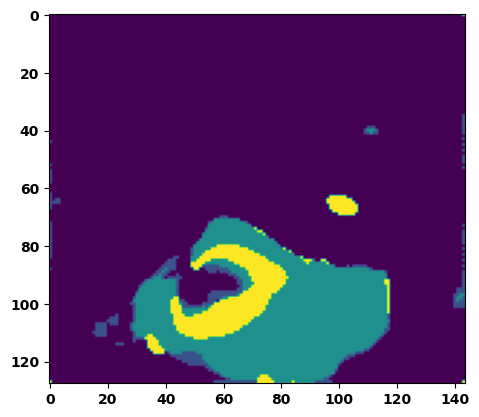

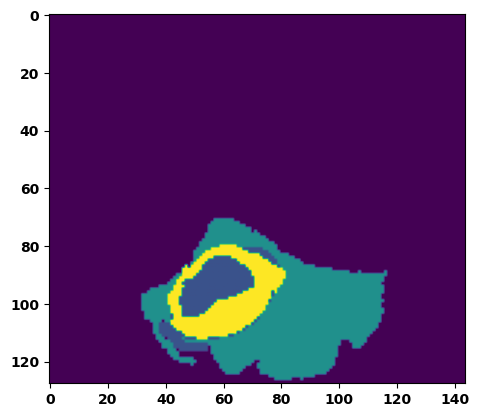

 89%|████████▉ | 32/36 [00:49<00:06,  1.53s/it]

Batch_id:  31 Eval loss:  0.7447074055671692
Batch_id:  31 Eval IoU:  tensor(0.2592, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.8201, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.7559, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9117, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.8871, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9058, device='cuda:0')


 92%|█████████▏| 33/36 [00:50<00:04,  1.49s/it]

Batch_id:  32 Eval loss:  0.6402913331985474
Batch_id:  32 Eval IoU:  tensor(0.4861, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9073, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.8737, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9090, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


 94%|█████████▍| 34/36 [00:52<00:02,  1.45s/it]

Batch_id:  33 Eval loss:  0.7298007607460022
Batch_id:  33 Eval IoU:  tensor(0.4372, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.8910, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.8471, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.8850, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')


 97%|█████████▋| 35/36 [00:53<00:01,  1.46s/it]

Batch_id:  34 Eval loss:  0.5797412395477295
Batch_id:  34 Eval IoU:  tensor(0.6065, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


100%|██████████| 36/36 [00:55<00:00,  1.53s/it]

Batch_id:  35 Eval loss:  0.6475694179534912
Batch_id:  35 Eval IoU:  tensor(0.5126, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9823, device='cuda:0')
Epoch  0 Training loss:  0.7292528461326252
Epoch  0 Evaluation loss:  0.6562024255593618
Epoch  0 Training accuracy :  tensor(0.3454)
Epoch  0 Evaluation accuracy :  tensor(0.4708)
Epoch  0 Training Mean Dice Score:  tensor(0.8370)
Epoch  0 Eval Mean Dice Score:  tensor(0.9160)
Epoch  0 Training Non-tumor Dice Score:  tensor(0.8079)
Epoch  0 Eval Non-tumor Dice Score:  tensor(0.9070)
Epoch  0 Training NCR/NET Dice Score:  tensor(0.8528)
Epoch  0 Eval NCR/NET Dice Score:  tensor(0.9528)
Epoch  0 Training ED Dice Score:  tensor(0.8861)
Epoch  0

Epoch: 1
Training in session: 


  1%|          | 1/110 [00:01<02:32,  1.40s/it]

Batch_id:  0 Training loss:  0.5432296395301819
Batch_id:  0 Training IoU:  tensor(0.5740, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9699, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:37,  1.46s/it]

Batch_id:  1 Training loss:  0.7339008450508118
Batch_id:  1 Training IoU:  tensor(0.3139, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.8678, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9395, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.8975, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.8343, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9321, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:45,  1.55s/it]

Batch_id:  2 Training loss:  0.6285216808319092
Batch_id:  2 Training IoU:  tensor(0.4053, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.8785, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9292, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9242, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.8412, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9410, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:39,  1.51s/it]

Batch_id:  3 Training loss:  0.6435902714729309
Batch_id:  3 Training IoU:  tensor(0.4513, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9260, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9312, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9120, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9665, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:40,  1.53s/it]

Batch_id:  4 Training loss:  0.5496906638145447
Batch_id:  4 Training IoU:  tensor(0.6515, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:37,  1.51s/it]

Batch_id:  5 Training loss:  0.7636221051216125
Batch_id:  5 Training IoU:  tensor(0.3371, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9253, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9254, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9467, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:32,  1.48s/it]

Batch_id:  6 Training loss:  0.6212712526321411
Batch_id:  6 Training IoU:  tensor(0.4972, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9362, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9211, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9630, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:31,  1.49s/it]

Batch_id:  7 Training loss:  0.6155346632003784
Batch_id:  7 Training IoU:  tensor(0.4330, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9024, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.8872, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9438, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:29,  1.48s/it]

Batch_id:  8 Training loss:  0.6387185454368591
Batch_id:  8 Training IoU:  tensor(0.4544, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9215, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9072, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9290, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9557, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:27,  1.47s/it]

Batch_id:  9 Training loss:  0.6206825971603394
Batch_id:  9 Training IoU:  tensor(0.4622, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9192, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9148, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.8920, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9714, device='cuda:0')


 10%|█         | 11/110 [00:16<02:25,  1.47s/it]

Batch_id:  10 Training loss:  0.6331233978271484
Batch_id:  10 Training IoU:  tensor(0.4835, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9387, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9258, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9756, device='cuda:0')


 11%|█         | 12/110 [00:17<02:24,  1.48s/it]

Batch_id:  11 Training loss:  0.787574052810669
Batch_id:  11 Training IoU:  tensor(0.2593, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.8740, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.8267, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.8652, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9700, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:28,  1.53s/it]

Batch_id:  12 Training loss:  0.5247864723205566
Batch_id:  12 Training IoU:  tensor(0.6044, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9484, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:21,  1.48s/it]

Batch_id:  13 Training loss:  0.7152583599090576
Batch_id:  13 Training IoU:  tensor(0.3771, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9012, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.8672, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.8982, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9781, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:20,  1.48s/it]

Batch_id:  14 Training loss:  0.7295563817024231
Batch_id:  14 Training IoU:  tensor(0.3722, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9188, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.8876, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9331, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9755, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:20,  1.50s/it]

Batch_id:  15 Training loss:  0.582298755645752
Batch_id:  15 Training IoU:  tensor(0.5866, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9377, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9494, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:12,  1.42s/it]

Batch_id:  16 Training loss:  0.6013461351394653
Batch_id:  16 Training IoU:  tensor(0.5386, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9330, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:12,  1.44s/it]

Batch_id:  17 Training loss:  0.8295609951019287
Batch_id:  17 Training IoU:  tensor(0.1984, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.8240, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.7479, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9212, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.8145, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:09,  1.42s/it]

Batch_id:  18 Training loss:  0.6119731068611145
Batch_id:  18 Training IoU:  tensor(0.4625, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9175, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9265, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9129, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9518, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:06,  1.40s/it]

Batch_id:  19 Training loss:  0.6178085803985596
Batch_id:  19 Training IoU:  tensor(0.4653, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9471, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:06,  1.42s/it]

Batch_id:  20 Training loss:  0.5613952279090881
Batch_id:  20 Training IoU:  tensor(0.5697, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9329, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9087, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9367, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 20%|██        | 22/110 [00:32<02:07,  1.45s/it]

Batch_id:  21 Training loss:  0.6153583526611328
Batch_id:  21 Training IoU:  tensor(0.5086, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9342, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9723, device='cuda:0')


 21%|██        | 23/110 [00:33<02:05,  1.44s/it]

Batch_id:  22 Training loss:  0.6218051314353943
Batch_id:  22 Training IoU:  tensor(0.5359, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9442, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9264, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:04,  1.44s/it]

Batch_id:  23 Training loss:  0.7219147682189941
Batch_id:  23 Training IoU:  tensor(0.3049, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.8725, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.8115, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.8848, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9610, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:05,  1.48s/it]

Batch_id:  24 Training loss:  0.5906983613967896
Batch_id:  24 Training IoU:  tensor(0.4699, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9239, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9021, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9603, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:05,  1.50s/it]

Batch_id:  25 Training loss:  0.5830578804016113
Batch_id:  25 Training IoU:  tensor(0.5737, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9799, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:05,  1.51s/it]

Batch_id:  26 Training loss:  0.6701437830924988
Batch_id:  26 Training IoU:  tensor(0.3965, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9284, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.8967, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9371, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9726, device='cuda:0')


 25%|██▌       | 28/110 [00:41<02:01,  1.49s/it]

Batch_id:  27 Training loss:  0.6116772890090942
Batch_id:  27 Training IoU:  tensor(0.5179, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9355, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9740, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:58,  1.47s/it]

Batch_id:  28 Training loss:  0.6999624967575073
Batch_id:  28 Training IoU:  tensor(0.4222, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9344, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9123, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9466, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:58,  1.49s/it]

Batch_id:  29 Training loss:  0.6703876852989197
Batch_id:  29 Training IoU:  tensor(0.4511, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9351, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9688, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:54,  1.45s/it]

Batch_id:  30 Training loss:  0.6319032907485962
Batch_id:  30 Training IoU:  tensor(0.4735, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9359, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9378, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9518, device='cuda:0')


 29%|██▉       | 32/110 [00:47<02:01,  1.55s/it]

Batch_id:  31 Training loss:  0.594133734703064
Batch_id:  31 Training IoU:  tensor(0.5014, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.8893, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.8841, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.8419, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 30%|███       | 33/110 [00:48<01:55,  1.50s/it]

Batch_id:  32 Training loss:  0.6693506240844727
Batch_id:  32 Training IoU:  tensor(0.4185, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9321, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9103, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9215, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9716, device='cuda:0')


 31%|███       | 34/110 [00:50<01:52,  1.48s/it]

Batch_id:  33 Training loss:  0.7408159375190735
Batch_id:  33 Training IoU:  tensor(0.2894, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.8753, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.8491, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.8197, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:48,  1.45s/it]

Batch_id:  34 Training loss:  0.6438263654708862
Batch_id:  34 Training IoU:  tensor(0.5107, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9231, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9296, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.8993, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:46,  1.43s/it]

Batch_id:  35 Training loss:  0.6462838053703308
Batch_id:  35 Training IoU:  tensor(0.4567, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9282, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9164, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:43,  1.42s/it]

Batch_id:  36 Training loss:  0.5926613211631775
Batch_id:  36 Training IoU:  tensor(0.5087, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9381, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9802, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:43,  1.43s/it]

Batch_id:  37 Training loss:  0.6219004392623901
Batch_id:  37 Training IoU:  tensor(0.4415, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9213, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9509, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.8861, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9697, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:42,  1.44s/it]

Batch_id:  38 Training loss:  0.6809176802635193
Batch_id:  38 Training IoU:  tensor(0.4602, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9289, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9017, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9048, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:40,  1.44s/it]

Batch_id:  39 Training loss:  0.6946857571601868
Batch_id:  39 Training IoU:  tensor(0.4026, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9685, device='cuda:0')


 37%|███▋      | 41/110 [01:00<01:37,  1.41s/it]

Batch_id:  40 Training loss:  0.5874360203742981
Batch_id:  40 Training IoU:  tensor(0.5718, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:36,  1.42s/it]

Batch_id:  41 Training loss:  0.5734851956367493
Batch_id:  41 Training IoU:  tensor(0.5967, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:36,  1.43s/it]

Batch_id:  42 Training loss:  0.5976839661598206
Batch_id:  42 Training IoU:  tensor(0.5001, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9293, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9435, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9052, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9748, device='cuda:0')


 40%|████      | 44/110 [01:04<01:33,  1.42s/it]

Batch_id:  43 Training loss:  0.6806374788284302
Batch_id:  43 Training IoU:  tensor(0.3985, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9202, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9322, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9218, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9580, device='cuda:0')


 41%|████      | 45/110 [01:05<01:32,  1.43s/it]

Batch_id:  44 Training loss:  0.7233860492706299
Batch_id:  44 Training IoU:  tensor(0.3025, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.8975, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.8808, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.8918, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9318, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:32,  1.44s/it]

Batch_id:  45 Training loss:  0.620163083076477
Batch_id:  45 Training IoU:  tensor(0.4407, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9371, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9436, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:31,  1.45s/it]

Batch_id:  46 Training loss:  0.6402159929275513
Batch_id:  46 Training IoU:  tensor(0.4331, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9345, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9160, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9346, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9706, device='cuda:0')


 44%|████▎     | 48/110 [01:10<01:28,  1.43s/it]

Batch_id:  47 Training loss:  0.6070680618286133
Batch_id:  47 Training IoU:  tensor(0.5381, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9397, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:29,  1.47s/it]

Batch_id:  48 Training loss:  0.5956274271011353
Batch_id:  48 Training IoU:  tensor(0.5392, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:26,  1.44s/it]

Batch_id:  49 Training loss:  0.6785526871681213
Batch_id:  49 Training IoU:  tensor(0.4074, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9257, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9228, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.8954, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9751, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:28,  1.50s/it]

Batch_id:  50 Training loss:  0.5505284070968628
Batch_id:  50 Training IoU:  tensor(0.5538, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9436, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9293, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:26,  1.48s/it]

Batch_id:  51 Training loss:  0.5072429776191711
Batch_id:  51 Training IoU:  tensor(0.5916, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9774, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:25,  1.50s/it]

Batch_id:  52 Training loss:  0.6082301735877991
Batch_id:  52 Training IoU:  tensor(0.5605, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:25,  1.52s/it]

Batch_id:  53 Training loss:  0.7338597774505615
Batch_id:  53 Training IoU:  tensor(0.2560, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.8450, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.8324, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9071, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.8787, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9168, device='cuda:0')


 50%|█████     | 55/110 [01:20<01:24,  1.53s/it]

Batch_id:  54 Training loss:  0.5262988805770874
Batch_id:  54 Training IoU:  tensor(0.5836, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9812, device='cuda:0')


 51%|█████     | 56/110 [01:22<01:21,  1.50s/it]

Batch_id:  55 Training loss:  0.6188969016075134
Batch_id:  55 Training IoU:  tensor(0.4272, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9014, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9072, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.8743, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9632, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:18,  1.48s/it]

Batch_id:  56 Training loss:  0.7233840823173523
Batch_id:  56 Training IoU:  tensor(0.3713, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9263, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9202, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9275, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9810, device='cuda:0')


 53%|█████▎    | 58/110 [01:25<01:18,  1.51s/it]

Batch_id:  57 Training loss:  0.6115108728408813
Batch_id:  57 Training IoU:  tensor(0.4918, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9464, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9434, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9811, device='cuda:0')


 54%|█████▎    | 59/110 [01:26<01:17,  1.52s/it]

Batch_id:  58 Training loss:  0.6727386116981506
Batch_id:  58 Training IoU:  tensor(0.3870, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9334, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9042, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9338, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9821, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:13,  1.48s/it]

Batch_id:  59 Training loss:  0.700466513633728
Batch_id:  59 Training IoU:  tensor(0.3143, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.8845, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.8334, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9109, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9289, device='cuda:0')


 55%|█████▌    | 61/110 [01:29<01:11,  1.45s/it]

Batch_id:  60 Training loss:  0.4963604211807251
Batch_id:  60 Training IoU:  tensor(0.5989, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 56%|█████▋    | 62/110 [01:30<01:09,  1.44s/it]

Batch_id:  61 Training loss:  0.5236749649047852
Batch_id:  61 Training IoU:  tensor(0.5926, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9509, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 57%|█████▋    | 63/110 [01:32<01:07,  1.43s/it]

Batch_id:  62 Training loss:  0.5372593402862549
Batch_id:  62 Training IoU:  tensor(0.5052, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9214, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.8924, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9630, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:09,  1.52s/it]

Batch_id:  63 Training loss:  0.5673912167549133
Batch_id:  63 Training IoU:  tensor(0.5259, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9398, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9266, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 59%|█████▉    | 65/110 [01:35<01:07,  1.49s/it]

Batch_id:  64 Training loss:  0.7506840229034424
Batch_id:  64 Training IoU:  tensor(0.3323, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.8978, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.8486, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.8896, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:06,  1.51s/it]

Batch_id:  65 Training loss:  0.5880675315856934
Batch_id:  65 Training IoU:  tensor(0.5047, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9788, device='cuda:0')


 61%|██████    | 67/110 [01:38<01:02,  1.46s/it]

Batch_id:  66 Training loss:  0.5238662958145142
Batch_id:  66 Training IoU:  tensor(0.6606, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 62%|██████▏   | 68/110 [01:39<01:02,  1.49s/it]

Batch_id:  67 Training loss:  0.5167904496192932
Batch_id:  67 Training IoU:  tensor(0.5699, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9261, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 63%|██████▎   | 69/110 [01:41<01:00,  1.47s/it]

Batch_id:  68 Training loss:  0.785224437713623
Batch_id:  68 Training IoU:  tensor(0.2247, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.8663, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.8145, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.8759, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9118, device='cuda:0')


 64%|██████▎   | 70/110 [01:42<00:57,  1.43s/it]

Batch_id:  69 Training loss:  0.6164681315422058
Batch_id:  69 Training IoU:  tensor(0.5252, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 65%|██████▍   | 71/110 [01:44<00:56,  1.46s/it]

Batch_id:  70 Training loss:  0.49418193101882935
Batch_id:  70 Training IoU:  tensor(0.5936, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9528, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 65%|██████▌   | 72/110 [01:45<00:55,  1.46s/it]

Batch_id:  71 Training loss:  0.5104693174362183
Batch_id:  71 Training IoU:  tensor(0.5851, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9528, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:52,  1.41s/it]

Batch_id:  72 Training loss:  0.5439552664756775
Batch_id:  72 Training IoU:  tensor(0.5471, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:50,  1.41s/it]

Batch_id:  73 Training loss:  0.501469612121582
Batch_id:  73 Training IoU:  tensor(0.5811, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9391, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 68%|██████▊   | 75/110 [01:49<00:49,  1.40s/it]

Batch_id:  74 Training loss:  0.5783513188362122
Batch_id:  74 Training IoU:  tensor(0.6287, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 69%|██████▉   | 76/110 [01:51<00:48,  1.43s/it]

Batch_id:  75 Training loss:  0.5692841410636902
Batch_id:  75 Training IoU:  tensor(0.4772, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9153, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.8922, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.8895, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9817, device='cuda:0')


 70%|███████   | 77/110 [01:52<00:47,  1.43s/it]

Batch_id:  76 Training loss:  0.6738287806510925
Batch_id:  76 Training IoU:  tensor(0.3238, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.8781, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.8662, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.8619, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9344, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:46,  1.45s/it]

Batch_id:  77 Training loss:  0.45047473907470703
Batch_id:  77 Training IoU:  tensor(0.6226, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 72%|███████▏  | 79/110 [01:55<00:45,  1.48s/it]

Batch_id:  78 Training loss:  0.7019134759902954
Batch_id:  78 Training IoU:  tensor(0.3122, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9061, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.8685, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9074, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9557, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:45,  1.52s/it]

Batch_id:  79 Training loss:  0.6217966675758362
Batch_id:  79 Training IoU:  tensor(0.4969, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9553, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 74%|███████▎  | 81/110 [01:58<00:44,  1.54s/it]

Batch_id:  80 Training loss:  0.6963778734207153
Batch_id:  80 Training IoU:  tensor(0.3826, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9763, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:42,  1.52s/it]

Batch_id:  81 Training loss:  0.6176717877388
Batch_id:  81 Training IoU:  tensor(0.4357, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9563, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:40,  1.49s/it]

Batch_id:  82 Training loss:  0.5348398685455322
Batch_id:  82 Training IoU:  tensor(0.5537, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9835, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:38,  1.47s/it]

Batch_id:  83 Training loss:  0.595862627029419
Batch_id:  83 Training IoU:  tensor(0.5039, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9781, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:36,  1.44s/it]

Batch_id:  84 Training loss:  0.5930262804031372
Batch_id:  84 Training IoU:  tensor(0.5841, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:34,  1.45s/it]

Batch_id:  85 Training loss:  0.6267528533935547
Batch_id:  85 Training IoU:  tensor(0.4782, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9244, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:33,  1.47s/it]

Batch_id:  86 Training loss:  0.5670905113220215
Batch_id:  86 Training IoU:  tensor(0.4524, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9010, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.8808, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.8591, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9808, device='cuda:0')


 80%|████████  | 88/110 [02:09<00:32,  1.48s/it]

Batch_id:  87 Training loss:  0.4774112403392792
Batch_id:  87 Training IoU:  tensor(0.6208, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:31,  1.50s/it]

Batch_id:  88 Training loss:  0.4873076379299164
Batch_id:  88 Training IoU:  tensor(0.5610, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9346, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9232, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 82%|████████▏ | 90/110 [02:12<00:29,  1.49s/it]

Batch_id:  89 Training loss:  0.5592483282089233
Batch_id:  89 Training IoU:  tensor(0.5028, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:28,  1.48s/it]

Batch_id:  90 Training loss:  0.4999842643737793
Batch_id:  90 Training IoU:  tensor(0.5269, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9180, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9143, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.8832, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9772, device='cuda:0')


 84%|████████▎ | 92/110 [02:15<00:26,  1.46s/it]

Batch_id:  91 Training loss:  0.6033065915107727
Batch_id:  91 Training IoU:  tensor(0.4595, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9261, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9069, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9073, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:25,  1.48s/it]

Batch_id:  92 Training loss:  0.48121121525764465
Batch_id:  92 Training IoU:  tensor(0.5747, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9352, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9328, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9112, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 85%|████████▌ | 94/110 [02:18<00:24,  1.52s/it]

Batch_id:  93 Training loss:  0.5498530268669128
Batch_id:  93 Training IoU:  tensor(0.5542, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:22,  1.50s/it]

Batch_id:  94 Training loss:  0.5571608543395996
Batch_id:  94 Training IoU:  tensor(0.5688, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 87%|████████▋ | 96/110 [02:21<00:21,  1.51s/it]

Batch_id:  95 Training loss:  0.701352596282959
Batch_id:  95 Training IoU:  tensor(0.3404, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9082, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.8692, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.8854, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 88%|████████▊ | 97/110 [02:22<00:20,  1.54s/it]

Batch_id:  96 Training loss:  0.4415699243545532
Batch_id:  96 Training IoU:  tensor(0.6237, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 89%|████████▉ | 98/110 [02:24<00:18,  1.52s/it]

Batch_id:  97 Training loss:  0.5454139709472656
Batch_id:  97 Training IoU:  tensor(0.5176, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9462, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9319, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9256, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:16,  1.51s/it]

Batch_id:  98 Training loss:  0.4622907042503357
Batch_id:  98 Training IoU:  tensor(0.5959, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 91%|█████████ | 100/110 [02:27<00:15,  1.55s/it]

Batch_id:  99 Training loss:  0.6715764999389648
Batch_id:  99 Training IoU:  tensor(0.3519, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9343, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9077, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9379, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9594, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:13,  1.53s/it]

Batch_id:  100 Training loss:  0.7082520127296448
Batch_id:  100 Training IoU:  tensor(0.2967, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9131, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.8775, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9036, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9669, device='cuda:0')


 93%|█████████▎| 102/110 [02:30<00:12,  1.55s/it]

Batch_id:  101 Training loss:  0.6508364677429199
Batch_id:  101 Training IoU:  tensor(0.4177, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9354, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9689, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.51s/it]

Batch_id:  102 Training loss:  0.5847733020782471
Batch_id:  102 Training IoU:  tensor(0.5227, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 95%|█████████▍| 104/110 [02:33<00:08,  1.47s/it]

Batch_id:  103 Training loss:  0.4700638949871063
Batch_id:  103 Training IoU:  tensor(0.6678, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.46s/it]

Batch_id:  104 Training loss:  0.6238690614700317
Batch_id:  104 Training IoU:  tensor(0.4855, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 96%|█████████▋| 106/110 [02:36<00:05,  1.48s/it]

Batch_id:  105 Training loss:  0.5044872760772705
Batch_id:  105 Training IoU:  tensor(0.5354, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9315, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9339, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9047, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.46s/it]

Batch_id:  106 Training loss:  0.689744234085083
Batch_id:  106 Training IoU:  tensor(0.3968, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 98%|█████████▊| 108/110 [02:39<00:02,  1.45s/it]

Batch_id:  107 Training loss:  0.5256443023681641
Batch_id:  107 Training IoU:  tensor(0.5660, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9847, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.44s/it]

Batch_id:  108 Training loss:  0.4652818739414215
Batch_id:  108 Training IoU:  tensor(0.6312, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


100%|██████████| 110/110 [02:42<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.5601230263710022
Batch_id:  109 Training IoU:  tensor(0.5117, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9863, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.5012134313583374
Batch_id:  0 Eval IoU:  tensor(0.5559, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9134, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.8858, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.8760, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9964, device='cuda:0')


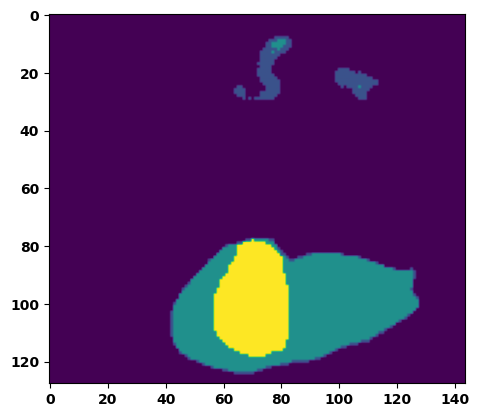

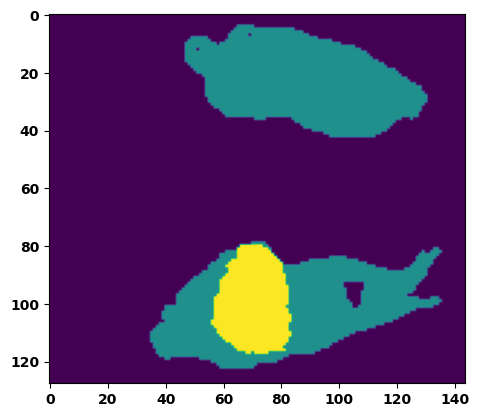

  6%|▌         | 2/36 [00:03<00:54,  1.61s/it]

Batch_id:  1 Eval loss:  0.6410791277885437
Batch_id:  1 Eval IoU:  tensor(0.4189, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9484, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9768, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.50s/it]

Batch_id:  2 Eval loss:  0.46042048931121826
Batch_id:  2 Eval IoU:  tensor(0.5685, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9729, device='cuda:0')


 11%|█         | 4/36 [00:06<00:47,  1.48s/it]

Batch_id:  3 Eval loss:  0.5411511063575745
Batch_id:  3 Eval IoU:  tensor(0.4517, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9294, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9042, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9469, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:44,  1.43s/it]

Batch_id:  4 Eval loss:  0.5524230003356934
Batch_id:  4 Eval IoU:  tensor(0.5286, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9374, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:43,  1.47s/it]

Batch_id:  5 Eval loss:  0.6133255362510681
Batch_id:  5 Eval IoU:  tensor(0.4542, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9377, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9840, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.47s/it]

Batch_id:  6 Eval loss:  0.5126582384109497
Batch_id:  6 Eval IoU:  tensor(0.5077, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9280, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9340, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9443, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9278, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9780, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:41,  1.48s/it]

Batch_id:  7 Eval loss:  0.7340750694274902
Batch_id:  7 Eval IoU:  tensor(0.2861, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9229, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9045, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9302, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9702, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:39,  1.46s/it]

Batch_id:  8 Eval loss:  0.6528677344322205
Batch_id:  8 Eval IoU:  tensor(0.4581, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9395, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9205, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9267, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:37,  1.45s/it]

Batch_id:  9 Eval loss:  0.43698418140411377
Batch_id:  9 Eval IoU:  tensor(0.5912, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9454, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9498, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  10 Eval loss:  0.4232712388038635
Batch_id:  10 Eval IoU:  tensor(0.6512, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9919, device='cuda:0')


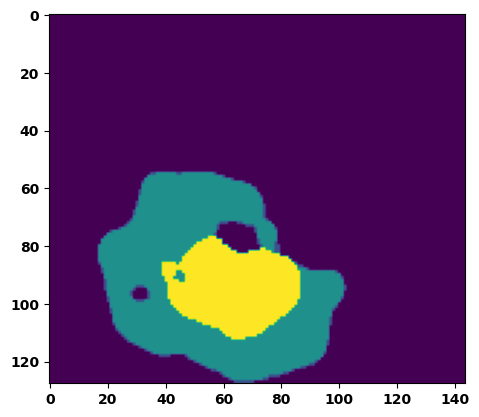

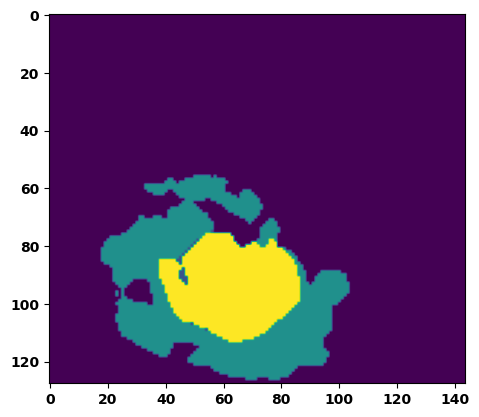

 33%|███▎      | 12/36 [00:17<00:35,  1.47s/it]

Batch_id:  11 Eval loss:  0.5060471296310425
Batch_id:  11 Eval IoU:  tensor(0.5494, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9304, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:33,  1.47s/it]

Batch_id:  12 Eval loss:  0.6299327611923218
Batch_id:  12 Eval IoU:  tensor(0.5045, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9312, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9967, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:33,  1.50s/it]

Batch_id:  13 Eval loss:  0.5142048597335815
Batch_id:  13 Eval IoU:  tensor(0.5398, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9824, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:30,  1.43s/it]

Batch_id:  14 Eval loss:  0.5573436617851257
Batch_id:  14 Eval IoU:  tensor(0.4961, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9786, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.41s/it]

Batch_id:  15 Eval loss:  0.5252572298049927
Batch_id:  15 Eval IoU:  tensor(0.5426, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9373, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9115, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9917, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:27,  1.45s/it]

Batch_id:  16 Eval loss:  0.42473191022872925
Batch_id:  16 Eval IoU:  tensor(0.6688, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.48s/it]

Batch_id:  17 Eval loss:  0.5960854887962341
Batch_id:  17 Eval IoU:  tensor(0.4667, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9168, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9846, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.44s/it]

Batch_id:  18 Eval loss:  0.5341178774833679
Batch_id:  18 Eval IoU:  tensor(0.5554, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:24,  1.50s/it]

Batch_id:  19 Eval loss:  0.47581037878990173
Batch_id:  19 Eval IoU:  tensor(0.6064, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9522, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  20 Eval loss:  0.4621293246746063
Batch_id:  20 Eval IoU:  tensor(0.5938, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9895, device='cuda:0')


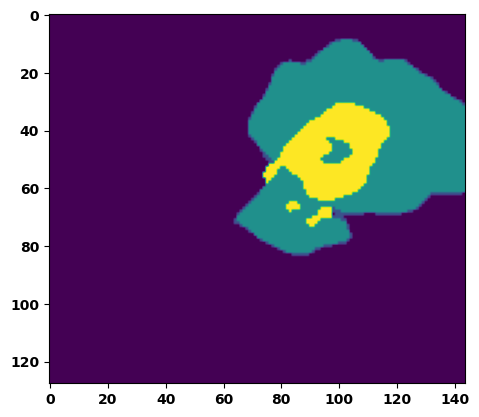

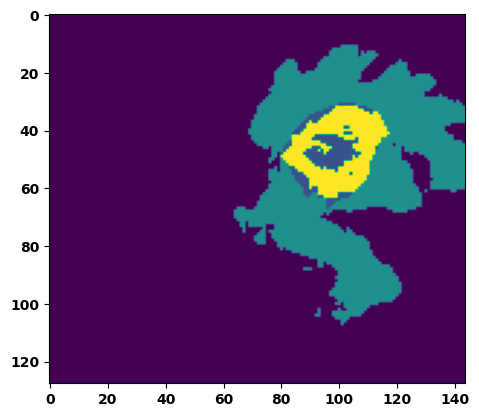

 61%|██████    | 22/36 [00:32<00:21,  1.55s/it]

Batch_id:  21 Eval loss:  0.5263983011245728
Batch_id:  21 Eval IoU:  tensor(0.5207, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9318, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9306, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9860, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:20,  1.61s/it]

Batch_id:  22 Eval loss:  0.7099047899246216
Batch_id:  22 Eval IoU:  tensor(0.2981, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.8968, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.8464, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.8859, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9733, device='cuda:0')


 67%|██████▋   | 24/36 [00:36<00:18,  1.55s/it]

Batch_id:  23 Eval loss:  0.7715416550636292
Batch_id:  23 Eval IoU:  tensor(0.2217, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.8515, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.7983, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.8124, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9780, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:17,  1.55s/it]

Batch_id:  24 Eval loss:  0.6543978452682495
Batch_id:  24 Eval IoU:  tensor(0.3913, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9203, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9066, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.8854, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9861, device='cuda:0')


 72%|███████▏  | 26/36 [00:39<00:15,  1.57s/it]

Batch_id:  25 Eval loss:  0.6461271643638611
Batch_id:  25 Eval IoU:  tensor(0.4196, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9444, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9231, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9816, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:13,  1.52s/it]

Batch_id:  26 Eval loss:  0.5267198085784912
Batch_id:  26 Eval IoU:  tensor(0.5430, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9473, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9398, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 78%|███████▊  | 28/36 [00:42<00:12,  1.60s/it]

Batch_id:  27 Eval loss:  0.4842400550842285
Batch_id:  27 Eval IoU:  tensor(0.5927, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:11,  1.58s/it]

Batch_id:  28 Eval loss:  0.47097814083099365
Batch_id:  28 Eval IoU:  tensor(0.5952, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9880, device='cuda:0')


 83%|████████▎ | 30/36 [00:45<00:09,  1.56s/it]

Batch_id:  29 Eval loss:  0.4757058322429657
Batch_id:  29 Eval IoU:  tensor(0.6268, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  30 Eval loss:  0.4930245876312256
Batch_id:  30 Eval IoU:  tensor(0.5836, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


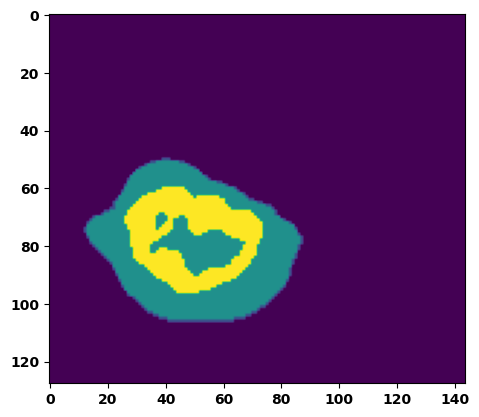

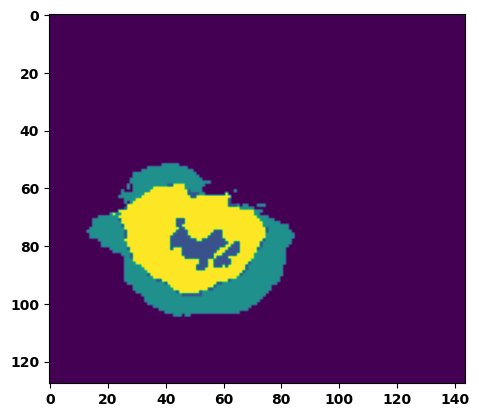

 89%|████████▉ | 32/36 [00:48<00:06,  1.61s/it]

Batch_id:  31 Eval loss:  0.6163927316665649
Batch_id:  31 Eval IoU:  tensor(0.5321, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9968, device='cuda:0')


 92%|█████████▏| 33/36 [00:50<00:04,  1.54s/it]

Batch_id:  32 Eval loss:  0.6212234497070312
Batch_id:  32 Eval IoU:  tensor(0.4479, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9169, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9096, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.8864, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 94%|█████████▍| 34/36 [00:51<00:03,  1.54s/it]

Batch_id:  33 Eval loss:  0.6721229553222656
Batch_id:  33 Eval IoU:  tensor(0.3240, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.8995, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9214, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9173, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.8822, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9775, device='cuda:0')


 97%|█████████▋| 35/36 [00:53<00:01,  1.53s/it]

Batch_id:  34 Eval loss:  0.5083009004592896
Batch_id:  34 Eval IoU:  tensor(0.5155, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9350, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9226, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9788, device='cuda:0')


100%|██████████| 36/36 [00:54<00:00,  1.52s/it]

Batch_id:  35 Eval loss:  0.5700488090515137
Batch_id:  35 Eval IoU:  tensor(0.5559, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')
Epoch  1 Training loss:  0.6092385251413692
Epoch  1 Evaluation loss:  0.5567293556200134
Epoch  1 Training accuracy :  tensor(0.4803)
Epoch  1 Evaluation accuracy :  tensor(0.5045)
Epoch  1 Training Mean Dice Score:  tensor(0.9353)
Epoch  1 Eval Mean Dice Score:  tensor(0.9411)
Epoch  1 Training Non-tumor Dice Score:  tensor(0.9380)
Epoch  1 Eval Non-tumor Dice Score:  tensor(0.9441)
Epoch  1 Training NCR/NET Dice Score:  tensor(0.9660)
Epoch  1 Eval NCR/NET Dice Score:  tensor(0.9654)
Epoch  1 Training ED Dice Score:  tensor(0.9283)
Epoch  1

Epoch: 2
Training in session: 


  1%|          | 1/110 [00:01<03:11,  1.75s/it]

Batch_id:  0 Training loss:  0.5894561409950256
Batch_id:  0 Training IoU:  tensor(0.4773, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9367, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9816, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:51,  1.59s/it]

Batch_id:  1 Training loss:  0.531304121017456
Batch_id:  1 Training IoU:  tensor(0.5882, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:55,  1.64s/it]

Batch_id:  2 Training loss:  0.4708716869354248
Batch_id:  2 Training IoU:  tensor(0.5752, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9484, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9245, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:50,  1.61s/it]

Batch_id:  3 Training loss:  0.49367398023605347
Batch_id:  3 Training IoU:  tensor(0.5207, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9243, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.8948, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9673, device='cuda:0')


  5%|▍         | 5/110 [00:08<02:51,  1.63s/it]

Batch_id:  4 Training loss:  0.5312523245811462
Batch_id:  4 Training IoU:  tensor(0.4594, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.8842, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9166, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9270, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.8473, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9616, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:47,  1.61s/it]

Batch_id:  5 Training loss:  0.49158015847206116
Batch_id:  5 Training IoU:  tensor(0.5163, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9154, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9337, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.8962, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9744, device='cuda:0')


  6%|▋         | 7/110 [00:11<02:39,  1.55s/it]

Batch_id:  6 Training loss:  0.5836014747619629
Batch_id:  6 Training IoU:  tensor(0.4192, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9375, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9167, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9278, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:45,  1.62s/it]

Batch_id:  7 Training loss:  0.7063294649124146
Batch_id:  7 Training IoU:  tensor(0.2750, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.8728, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.8218, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.8765, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9274, device='cuda:0')


  8%|▊         | 9/110 [00:14<02:39,  1.58s/it]

Batch_id:  8 Training loss:  0.532090425491333
Batch_id:  8 Training IoU:  tensor(0.5440, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


  9%|▉         | 10/110 [00:16<02:39,  1.60s/it]

Batch_id:  9 Training loss:  0.686632513999939
Batch_id:  9 Training IoU:  tensor(0.3492, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.8979, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.8780, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.8753, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 10%|█         | 11/110 [00:17<02:32,  1.54s/it]

Batch_id:  10 Training loss:  0.5838632583618164
Batch_id:  10 Training IoU:  tensor(0.4065, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9159, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.8910, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9038, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9731, device='cuda:0')


 11%|█         | 12/110 [00:19<02:36,  1.60s/it]

Batch_id:  11 Training loss:  0.45792585611343384
Batch_id:  11 Training IoU:  tensor(0.5727, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9283, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9794, device='cuda:0')


 12%|█▏        | 13/110 [00:20<02:26,  1.51s/it]

Batch_id:  12 Training loss:  0.5321639180183411
Batch_id:  12 Training IoU:  tensor(0.4927, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9349, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9176, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 13%|█▎        | 14/110 [00:22<02:27,  1.53s/it]

Batch_id:  13 Training loss:  0.5490372776985168
Batch_id:  13 Training IoU:  tensor(0.4637, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9314, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9672, device='cuda:0')


 14%|█▎        | 15/110 [00:23<02:21,  1.49s/it]

Batch_id:  14 Training loss:  0.7025973200798035
Batch_id:  14 Training IoU:  tensor(0.2962, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.8825, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.8482, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.8277, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 15%|█▍        | 16/110 [00:25<02:24,  1.54s/it]

Batch_id:  15 Training loss:  0.4671562910079956
Batch_id:  15 Training IoU:  tensor(0.6622, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 15%|█▌        | 17/110 [00:26<02:18,  1.49s/it]

Batch_id:  16 Training loss:  0.6152749061584473
Batch_id:  16 Training IoU:  tensor(0.3703, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.8998, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.8863, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.8754, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9643, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:14,  1.46s/it]

Batch_id:  17 Training loss:  0.6127581596374512
Batch_id:  17 Training IoU:  tensor(0.3967, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9280, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.8961, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9551, device='cuda:0')


 17%|█▋        | 19/110 [00:29<02:13,  1.46s/it]

Batch_id:  18 Training loss:  0.43944066762924194
Batch_id:  18 Training IoU:  tensor(0.6516, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:12,  1.48s/it]

Batch_id:  19 Training loss:  0.6258498430252075
Batch_id:  19 Training IoU:  tensor(0.4667, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 19%|█▉        | 21/110 [00:32<02:08,  1.44s/it]

Batch_id:  20 Training loss:  0.5238140225410461
Batch_id:  20 Training IoU:  tensor(0.5747, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9444, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9264, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9796, device='cuda:0')


 20%|██        | 22/110 [00:33<02:04,  1.41s/it]

Batch_id:  21 Training loss:  0.6325414180755615
Batch_id:  21 Training IoU:  tensor(0.4183, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9331, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9697, device='cuda:0')


 21%|██        | 23/110 [00:34<02:00,  1.38s/it]

Batch_id:  22 Training loss:  0.508519172668457
Batch_id:  22 Training IoU:  tensor(0.5437, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9817, device='cuda:0')


 22%|██▏       | 24/110 [00:36<01:58,  1.38s/it]

Batch_id:  23 Training loss:  0.5301973819732666
Batch_id:  23 Training IoU:  tensor(0.5581, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:01,  1.43s/it]

Batch_id:  24 Training loss:  0.4041414260864258
Batch_id:  24 Training IoU:  tensor(0.6409, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:01,  1.45s/it]

Batch_id:  25 Training loss:  0.5278767347335815
Batch_id:  25 Training IoU:  tensor(0.4915, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9586, device='cuda:0')


 25%|██▍       | 27/110 [00:40<01:59,  1.44s/it]

Batch_id:  26 Training loss:  0.7695257663726807
Batch_id:  26 Training IoU:  tensor(0.2390, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.8965, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.8554, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9465, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.8967, device='cuda:0')


 25%|██▌       | 28/110 [00:42<01:57,  1.43s/it]

Batch_id:  27 Training loss:  0.4273948073387146
Batch_id:  27 Training IoU:  tensor(0.6034, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 26%|██▋       | 29/110 [00:43<01:56,  1.43s/it]

Batch_id:  28 Training loss:  0.5398012399673462
Batch_id:  28 Training IoU:  tensor(0.4455, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9234, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9098, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9612, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:52,  1.40s/it]

Batch_id:  29 Training loss:  0.5191696882247925
Batch_id:  29 Training IoU:  tensor(0.4980, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9290, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9682, device='cuda:0')


 28%|██▊       | 31/110 [00:46<01:49,  1.39s/it]

Batch_id:  30 Training loss:  0.48279982805252075
Batch_id:  30 Training IoU:  tensor(0.5187, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9330, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9084, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 29%|██▉       | 32/110 [00:47<01:52,  1.44s/it]

Batch_id:  31 Training loss:  0.5164144039154053
Batch_id:  31 Training IoU:  tensor(0.5193, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9312, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 30%|███       | 33/110 [00:49<01:53,  1.48s/it]

Batch_id:  32 Training loss:  0.5353530049324036
Batch_id:  32 Training IoU:  tensor(0.5101, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 31%|███       | 34/110 [00:50<01:50,  1.45s/it]

Batch_id:  33 Training loss:  0.4450664520263672
Batch_id:  33 Training IoU:  tensor(0.5925, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:45,  1.41s/it]

Batch_id:  34 Training loss:  0.4900405704975128
Batch_id:  34 Training IoU:  tensor(0.5307, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9454, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9183, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:42,  1.39s/it]

Batch_id:  35 Training loss:  0.5220502614974976
Batch_id:  35 Training IoU:  tensor(0.4978, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9580, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:41,  1.40s/it]

Batch_id:  36 Training loss:  0.5030738115310669
Batch_id:  36 Training IoU:  tensor(0.4902, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9124, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.8894, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.8773, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9847, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:41,  1.41s/it]

Batch_id:  37 Training loss:  0.4987209737300873
Batch_id:  37 Training IoU:  tensor(0.5167, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9443, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9446, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9198, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:41,  1.44s/it]

Batch_id:  38 Training loss:  0.48377734422683716
Batch_id:  38 Training IoU:  tensor(0.6030, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 36%|███▋      | 40/110 [00:59<01:41,  1.45s/it]

Batch_id:  39 Training loss:  0.46740975975990295
Batch_id:  39 Training IoU:  tensor(0.5864, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9808, device='cuda:0')


 37%|███▋      | 41/110 [01:00<01:39,  1.45s/it]

Batch_id:  40 Training loss:  0.5359960794448853
Batch_id:  40 Training IoU:  tensor(0.5333, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:39,  1.46s/it]

Batch_id:  41 Training loss:  0.45191216468811035
Batch_id:  41 Training IoU:  tensor(0.5812, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9547, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9361, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 39%|███▉      | 43/110 [01:03<01:37,  1.46s/it]

Batch_id:  42 Training loss:  0.5207139253616333
Batch_id:  42 Training IoU:  tensor(0.5446, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9792, device='cuda:0')


 40%|████      | 44/110 [01:05<01:36,  1.46s/it]

Batch_id:  43 Training loss:  0.519618570804596
Batch_id:  43 Training IoU:  tensor(0.5272, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 41%|████      | 45/110 [01:06<01:35,  1.46s/it]

Batch_id:  44 Training loss:  0.6513762474060059
Batch_id:  44 Training IoU:  tensor(0.4072, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:33,  1.46s/it]

Batch_id:  45 Training loss:  0.6350828409194946
Batch_id:  45 Training IoU:  tensor(0.4249, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:31,  1.45s/it]

Batch_id:  46 Training loss:  0.6670674085617065
Batch_id:  46 Training IoU:  tensor(0.3645, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9360, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9408, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9811, device='cuda:0')


 44%|████▎     | 48/110 [01:10<01:30,  1.46s/it]

Batch_id:  47 Training loss:  0.49028897285461426
Batch_id:  47 Training IoU:  tensor(0.5736, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:31,  1.51s/it]

Batch_id:  48 Training loss:  0.5663465261459351
Batch_id:  48 Training IoU:  tensor(0.4680, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 45%|████▌     | 50/110 [01:14<01:29,  1.49s/it]

Batch_id:  49 Training loss:  0.42436113953590393
Batch_id:  49 Training IoU:  tensor(0.5742, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9473, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9322, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 46%|████▋     | 51/110 [01:15<01:28,  1.50s/it]

Batch_id:  50 Training loss:  0.6447939872741699
Batch_id:  50 Training IoU:  tensor(0.3944, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:23,  1.43s/it]

Batch_id:  51 Training loss:  0.5333089828491211
Batch_id:  51 Training IoU:  tensor(0.5553, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 48%|████▊     | 53/110 [01:18<01:20,  1.42s/it]

Batch_id:  52 Training loss:  0.6324983835220337
Batch_id:  52 Training IoU:  tensor(0.4450, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:22,  1.47s/it]

Batch_id:  53 Training loss:  0.4581671357154846
Batch_id:  53 Training IoU:  tensor(0.6155, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:19,  1.44s/it]

Batch_id:  54 Training loss:  0.4875853359699249
Batch_id:  54 Training IoU:  tensor(0.5624, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 51%|█████     | 56/110 [01:22<01:15,  1.40s/it]

Batch_id:  55 Training loss:  0.4942501485347748
Batch_id:  55 Training IoU:  tensor(0.5606, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9839, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:15,  1.43s/it]

Batch_id:  56 Training loss:  0.7414253950119019
Batch_id:  56 Training IoU:  tensor(0.2506, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9110, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.8827, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9254, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9272, device='cuda:0')


 53%|█████▎    | 58/110 [01:25<01:16,  1.46s/it]

Batch_id:  57 Training loss:  0.5017490983009338
Batch_id:  57 Training IoU:  tensor(0.5352, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9754, device='cuda:0')


 54%|█████▎    | 59/110 [01:27<01:16,  1.50s/it]

Batch_id:  58 Training loss:  0.4759301245212555
Batch_id:  58 Training IoU:  tensor(0.5195, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9271, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9114, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9317, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9616, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:12,  1.46s/it]

Batch_id:  59 Training loss:  0.4869953691959381
Batch_id:  59 Training IoU:  tensor(0.5316, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9792, device='cuda:0')


 55%|█████▌    | 61/110 [01:29<01:09,  1.43s/it]

Batch_id:  60 Training loss:  0.4855004549026489
Batch_id:  60 Training IoU:  tensor(0.5154, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9576, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9273, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9807, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:06,  1.39s/it]

Batch_id:  61 Training loss:  0.5874556303024292
Batch_id:  61 Training IoU:  tensor(0.4327, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9349, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9537, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 57%|█████▋    | 63/110 [01:32<01:05,  1.40s/it]

Batch_id:  62 Training loss:  0.7087856531143188
Batch_id:  62 Training IoU:  tensor(0.2752, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.8914, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.8389, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.8790, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9751, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:06,  1.45s/it]

Batch_id:  63 Training loss:  0.4709542989730835
Batch_id:  63 Training IoU:  tensor(0.5344, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9398, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 59%|█████▉    | 65/110 [01:35<01:04,  1.42s/it]

Batch_id:  64 Training loss:  0.5906857848167419
Batch_id:  64 Training IoU:  tensor(0.4754, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9291, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9205, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:02,  1.41s/it]

Batch_id:  65 Training loss:  0.4137141704559326
Batch_id:  65 Training IoU:  tensor(0.6453, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 61%|██████    | 67/110 [01:38<01:02,  1.46s/it]

Batch_id:  66 Training loss:  0.4120916426181793
Batch_id:  66 Training IoU:  tensor(0.6106, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 62%|██████▏   | 68/110 [01:39<01:02,  1.48s/it]

Batch_id:  67 Training loss:  0.537787139415741
Batch_id:  67 Training IoU:  tensor(0.4766, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9508, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9553, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9709, device='cuda:0')


 63%|██████▎   | 69/110 [01:41<01:00,  1.48s/it]

Batch_id:  68 Training loss:  0.4841731786727905
Batch_id:  68 Training IoU:  tensor(0.6067, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 64%|██████▎   | 70/110 [01:42<01:00,  1.50s/it]

Batch_id:  69 Training loss:  0.410135418176651
Batch_id:  69 Training IoU:  tensor(0.6261, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 65%|██████▍   | 71/110 [01:44<00:59,  1.53s/it]

Batch_id:  70 Training loss:  0.4529598355293274
Batch_id:  70 Training IoU:  tensor(0.5454, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9718, device='cuda:0')


 65%|██████▌   | 72/110 [01:46<01:01,  1.61s/it]

Batch_id:  71 Training loss:  0.4363608956336975
Batch_id:  71 Training IoU:  tensor(0.5524, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9328, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9190, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9800, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:57,  1.56s/it]

Batch_id:  72 Training loss:  0.5010620355606079
Batch_id:  72 Training IoU:  tensor(0.5100, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:55,  1.54s/it]

Batch_id:  73 Training loss:  0.4540684223175049
Batch_id:  73 Training IoU:  tensor(0.5198, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9214, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9718, device='cuda:0')


 68%|██████▊   | 75/110 [01:50<00:51,  1.46s/it]

Batch_id:  74 Training loss:  0.6445251107215881
Batch_id:  74 Training IoU:  tensor(0.3147, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.8974, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.8623, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.8778, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9553, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:49,  1.47s/it]

Batch_id:  75 Training loss:  0.5721981525421143
Batch_id:  75 Training IoU:  tensor(0.3988, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9395, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9275, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9509, device='cuda:0')


 70%|███████   | 77/110 [01:53<00:47,  1.45s/it]

Batch_id:  76 Training loss:  0.4215884804725647
Batch_id:  76 Training IoU:  tensor(0.5862, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:48,  1.51s/it]

Batch_id:  77 Training loss:  0.48276805877685547
Batch_id:  77 Training IoU:  tensor(0.4697, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.8864, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.8872, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.8315, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9787, device='cuda:0')


 72%|███████▏  | 79/110 [01:56<00:45,  1.46s/it]

Batch_id:  78 Training loss:  0.5270847082138062
Batch_id:  78 Training IoU:  tensor(0.4571, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9226, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9222, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9148, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:44,  1.48s/it]

Batch_id:  79 Training loss:  0.4222768247127533
Batch_id:  79 Training IoU:  tensor(0.5845, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9512, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9547, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 74%|███████▎  | 81/110 [01:59<00:42,  1.45s/it]

Batch_id:  80 Training loss:  0.42103904485702515
Batch_id:  80 Training IoU:  tensor(0.5832, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9765, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:39,  1.42s/it]

Batch_id:  81 Training loss:  0.4944920539855957
Batch_id:  81 Training IoU:  tensor(0.5486, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 75%|███████▌  | 83/110 [02:02<00:39,  1.45s/it]

Batch_id:  82 Training loss:  0.4408431351184845
Batch_id:  82 Training IoU:  tensor(0.5634, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9378, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9299, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9387, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9760, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:38,  1.46s/it]

Batch_id:  83 Training loss:  0.43384435772895813
Batch_id:  83 Training IoU:  tensor(0.5612, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9784, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:34,  1.39s/it]

Batch_id:  84 Training loss:  0.3996411859989166
Batch_id:  84 Training IoU:  tensor(0.6019, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9812, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:33,  1.40s/it]

Batch_id:  85 Training loss:  0.6705299019813538
Batch_id:  85 Training IoU:  tensor(0.2984, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.8766, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.8994, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9119, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.8628, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9556, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:32,  1.39s/it]

Batch_id:  86 Training loss:  0.4768441915512085
Batch_id:  86 Training IoU:  tensor(0.4954, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9036, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9093, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.8692, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9788, device='cuda:0')


 80%|████████  | 88/110 [02:09<00:31,  1.44s/it]

Batch_id:  87 Training loss:  0.3583075702190399
Batch_id:  87 Training IoU:  tensor(0.6714, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 81%|████████  | 89/110 [02:11<00:32,  1.54s/it]

Batch_id:  88 Training loss:  0.44882404804229736
Batch_id:  88 Training IoU:  tensor(0.5215, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9284, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9267, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9129, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9720, device='cuda:0')


 82%|████████▏ | 90/110 [02:12<00:29,  1.47s/it]

Batch_id:  89 Training loss:  0.5629821419715881
Batch_id:  89 Training IoU:  tensor(0.4573, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9543, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9793, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:27,  1.45s/it]

Batch_id:  90 Training loss:  0.5213221311569214
Batch_id:  90 Training IoU:  tensor(0.4700, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9339, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9735, device='cuda:0')


 84%|████████▎ | 92/110 [02:15<00:26,  1.45s/it]

Batch_id:  91 Training loss:  0.5677509307861328
Batch_id:  91 Training IoU:  tensor(0.4533, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9340, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9181, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9185, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:24,  1.44s/it]

Batch_id:  92 Training loss:  0.46759742498397827
Batch_id:  92 Training IoU:  tensor(0.6339, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 85%|████████▌ | 94/110 [02:18<00:23,  1.47s/it]

Batch_id:  93 Training loss:  0.5188335180282593
Batch_id:  93 Training IoU:  tensor(0.5172, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:21,  1.46s/it]

Batch_id:  94 Training loss:  0.6402854323387146
Batch_id:  94 Training IoU:  tensor(0.3887, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9355, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9127, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9617, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9445, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 87%|████████▋ | 96/110 [02:21<00:20,  1.44s/it]

Batch_id:  95 Training loss:  0.46931785345077515
Batch_id:  95 Training IoU:  tensor(0.5132, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9436, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9122, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9756, device='cuda:0')


 88%|████████▊ | 97/110 [02:22<00:18,  1.44s/it]

Batch_id:  96 Training loss:  0.5116353631019592
Batch_id:  96 Training IoU:  tensor(0.4898, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9529, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9343, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:17,  1.43s/it]

Batch_id:  97 Training loss:  0.5292903184890747
Batch_id:  97 Training IoU:  tensor(0.5069, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:15,  1.45s/it]

Batch_id:  98 Training loss:  0.6498321294784546
Batch_id:  98 Training IoU:  tensor(0.3162, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9160, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.8850, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9171, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9632, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:14,  1.45s/it]

Batch_id:  99 Training loss:  0.5338830947875977
Batch_id:  99 Training IoU:  tensor(0.4858, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:12,  1.43s/it]

Batch_id:  100 Training loss:  0.43360984325408936
Batch_id:  100 Training IoU:  tensor(0.5452, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9789, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:11,  1.49s/it]

Batch_id:  101 Training loss:  0.6379796266555786
Batch_id:  101 Training IoU:  tensor(0.3210, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.8847, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9037, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.8517, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9354, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.51s/it]

Batch_id:  102 Training loss:  0.3774501085281372
Batch_id:  102 Training IoU:  tensor(0.6775, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:08,  1.49s/it]

Batch_id:  103 Training loss:  0.5703301429748535
Batch_id:  103 Training IoU:  tensor(0.3796, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.8903, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9100, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.8605, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9499, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.56s/it]

Batch_id:  104 Training loss:  0.5347501039505005
Batch_id:  104 Training IoU:  tensor(0.4852, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9752, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:06,  1.52s/it]

Batch_id:  105 Training loss:  0.477954626083374
Batch_id:  105 Training IoU:  tensor(0.5002, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9229, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9720, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.52s/it]

Batch_id:  106 Training loss:  0.47376948595046997
Batch_id:  106 Training IoU:  tensor(0.5238, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9796, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:03,  1.50s/it]

Batch_id:  107 Training loss:  0.4264950454235077
Batch_id:  107 Training IoU:  tensor(0.5685, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9793, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.48s/it]

Batch_id:  108 Training loss:  0.6161125302314758
Batch_id:  108 Training IoU:  tensor(0.3757, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9370, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9331, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9314, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9759, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.6934728026390076
Batch_id:  109 Training IoU:  tensor(0.2725, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.8916, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.8471, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.8725, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9600, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.5659407377243042
Batch_id:  0 Eval IoU:  tensor(0.4271, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9450, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9295, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9783, device='cuda:0')


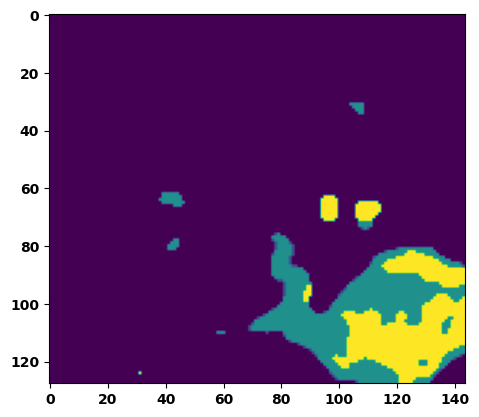

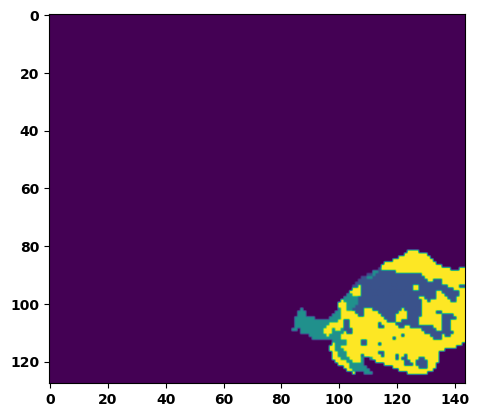

  6%|▌         | 2/36 [00:03<00:50,  1.48s/it]

Batch_id:  1 Eval loss:  0.4575343132019043
Batch_id:  1 Eval IoU:  tensor(0.5257, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9454, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9298, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9315, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9874, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:48,  1.48s/it]

Batch_id:  2 Eval loss:  0.40689507126808167
Batch_id:  2 Eval IoU:  tensor(0.5731, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9442, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9331, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9279, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9860, device='cuda:0')


 11%|█         | 4/36 [00:06<00:47,  1.49s/it]

Batch_id:  3 Eval loss:  0.35848718881607056
Batch_id:  3 Eval IoU:  tensor(0.6559, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.46s/it]

Batch_id:  4 Eval loss:  0.6273403167724609
Batch_id:  4 Eval IoU:  tensor(0.3654, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9139, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.8871, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.8851, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9810, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:43,  1.46s/it]

Batch_id:  5 Eval loss:  0.4052155911922455
Batch_id:  5 Eval IoU:  tensor(0.5894, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9883, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:40,  1.40s/it]

Batch_id:  6 Eval loss:  0.659312903881073
Batch_id:  6 Eval IoU:  tensor(0.2883, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.8710, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.8757, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9246, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.8668, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9460, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.44s/it]

Batch_id:  7 Eval loss:  0.4576089382171631
Batch_id:  7 Eval IoU:  tensor(0.5189, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9457, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9336, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9838, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:39,  1.45s/it]

Batch_id:  8 Eval loss:  0.442362904548645
Batch_id:  8 Eval IoU:  tensor(0.5452, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9185, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.8830, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.8808, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9921, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:36,  1.41s/it]

Batch_id:  9 Eval loss:  0.56524658203125
Batch_id:  9 Eval IoU:  tensor(0.4204, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9370, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9226, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  10 Eval loss:  0.4041014313697815
Batch_id:  10 Eval IoU:  tensor(0.5886, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9878, device='cuda:0')


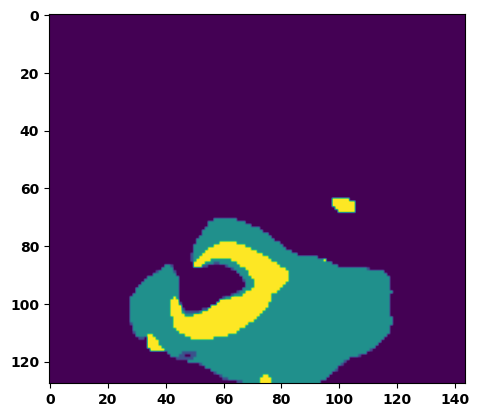

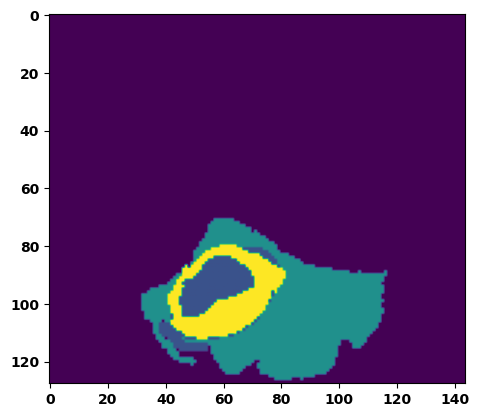

 33%|███▎      | 12/36 [00:17<00:36,  1.52s/it]

Batch_id:  11 Eval loss:  0.4657091498374939
Batch_id:  11 Eval IoU:  tensor(0.4981, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9392, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9124, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9668, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:36,  1.57s/it]

Batch_id:  12 Eval loss:  0.7505050897598267
Batch_id:  12 Eval IoU:  tensor(0.2110, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.8301, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.7656, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.7947, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9517, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:33,  1.54s/it]

Batch_id:  13 Eval loss:  0.45174551010131836
Batch_id:  13 Eval IoU:  tensor(0.5239, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9373, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9797, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:32,  1.53s/it]

Batch_id:  14 Eval loss:  0.7042241096496582
Batch_id:  14 Eval IoU:  tensor(0.2779, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9209, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9043, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9241, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9557, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:30,  1.52s/it]

Batch_id:  15 Eval loss:  0.6181493997573853
Batch_id:  15 Eval IoU:  tensor(0.3667, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9319, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9188, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9073, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9762, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:28,  1.51s/it]

Batch_id:  16 Eval loss:  0.4358755350112915
Batch_id:  16 Eval IoU:  tensor(0.5361, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9425, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9293, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9816, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.48s/it]

Batch_id:  17 Eval loss:  0.5752435922622681
Batch_id:  17 Eval IoU:  tensor(0.4444, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9444, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9296, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9228, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:24,  1.43s/it]

Batch_id:  18 Eval loss:  0.44822078943252563
Batch_id:  18 Eval IoU:  tensor(0.5046, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9286, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9473, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9207, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9695, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.48s/it]

Batch_id:  19 Eval loss:  0.48490414023399353
Batch_id:  19 Eval IoU:  tensor(0.4901, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9305, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9122, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9078, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  20 Eval loss:  0.45618659257888794
Batch_id:  20 Eval IoU:  tensor(0.5333, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9845, device='cuda:0')


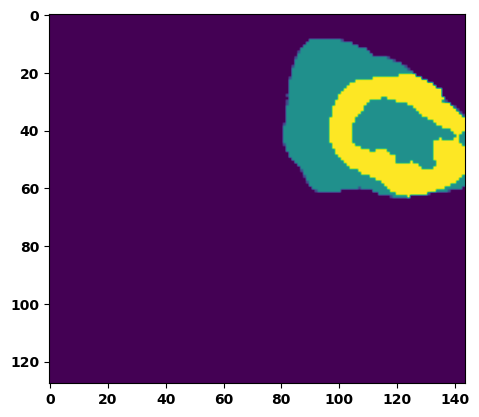

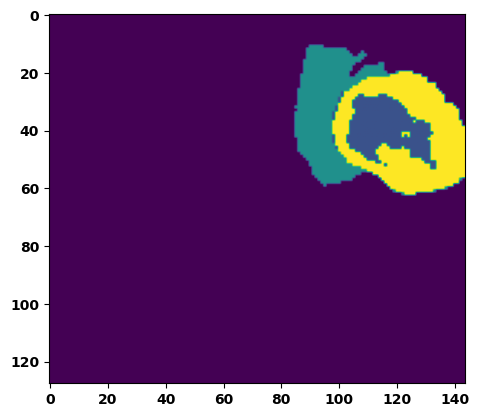

 61%|██████    | 22/36 [00:33<00:22,  1.57s/it]

Batch_id:  21 Eval loss:  0.543711245059967
Batch_id:  21 Eval IoU:  tensor(0.4618, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9465, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9317, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9864, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.49s/it]

Batch_id:  22 Eval loss:  0.5596597790718079
Batch_id:  22 Eval IoU:  tensor(0.4289, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9119, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9150, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.8801, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  23 Eval loss:  0.4509207308292389
Batch_id:  23 Eval IoU:  tensor(0.5143, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  

 67%|██████▋   | 24/36 [00:36<00:19,  1.60s/it]

tensor(0.9438, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9759, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:17,  1.55s/it]

Batch_id:  24 Eval loss:  0.4019443392753601
Batch_id:  24 Eval IoU:  tensor(0.5890, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9853, device='cuda:0')


 72%|███████▏  | 26/36 [00:39<00:15,  1.51s/it]

Batch_id:  25 Eval loss:  0.41724467277526855
Batch_id:  25 Eval IoU:  tensor(0.5828, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  26 Eval loss:  0.517248272895813
Batch_id:  26 Eval IoU:  tensor(0.4475, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:14,  1.58s/it]

Batch_id:  26 Eval Mean Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9337, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9329, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9692, device='cuda:0')


 78%|███████▊  | 28/36 [00:42<00:12,  1.55s/it]

Batch_id:  27 Eval loss:  0.4761596918106079
Batch_id:  27 Eval IoU:  tensor(0.4697, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9236, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9398, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9065, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9665, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:10,  1.53s/it]

Batch_id:  28 Eval loss:  0.36436501145362854
Batch_id:  28 Eval IoU:  tensor(0.6470, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9509, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9955, device='cuda:0')


 83%|████████▎ | 30/36 [00:45<00:09,  1.55s/it]

Batch_id:  29 Eval loss:  0.5148574113845825
Batch_id:  29 Eval IoU:  tensor(0.5008, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  30 Eval loss:  0.3742716908454895
Batch_id:  30 Eval IoU:  tensor(0.6094, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9490, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9814, device='cuda:0')


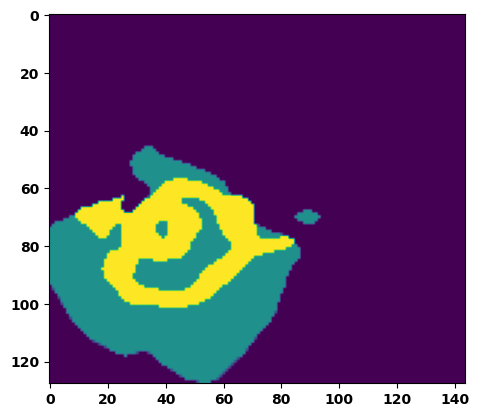

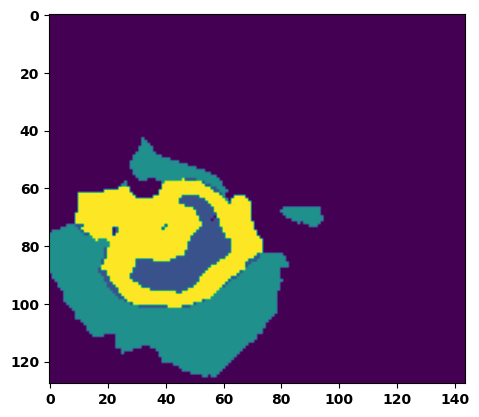

 89%|████████▉ | 32/36 [00:48<00:06,  1.51s/it]

Batch_id:  31 Eval loss:  0.5561201572418213
Batch_id:  31 Eval IoU:  tensor(0.4256, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9220, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9114, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.8904, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9850, device='cuda:0')


 92%|█████████▏| 33/36 [00:49<00:04,  1.51s/it]

Batch_id:  32 Eval loss:  0.35349002480506897
Batch_id:  32 Eval IoU:  tensor(0.6232, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9858, device='cuda:0')


 94%|█████████▍| 34/36 [00:51<00:03,  1.53s/it]

Batch_id:  33 Eval loss:  0.6875612735748291
Batch_id:  33 Eval IoU:  tensor(0.2730, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.8818, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.8251, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.8594, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9628, device='cuda:0')


 97%|█████████▋| 35/36 [00:52<00:01,  1.49s/it]

Batch_id:  34 Eval loss:  0.529434323310852
Batch_id:  34 Eval IoU:  tensor(0.4650, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9354, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9110, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9845, device='cuda:0')


100%|██████████| 36/36 [00:54<00:00,  1.51s/it]

Batch_id:  35 Eval loss:  0.41078972816467285
Batch_id:  35 Eval IoU:  tensor(0.5837, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9350, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9889, device='cuda:0')
Epoch  2 Training loss:  0.5256837430325422
Epoch  2 Evaluation loss:  0.4971830066707399
Epoch  2 Training accuracy :  tensor(0.4974)
Epoch  2 Evaluation accuracy :  tensor(0.4863)
Epoch  2 Training Mean Dice Score:  tensor(0.9448)
Epoch  2 Eval Mean Dice Score:  tensor(0.9360)
Epoch  2 Training Non-tumor Dice Score:  tensor(0.9502)
Epoch  2 Eval Non-tumor Dice Score:  tensor(0.9346)
Epoch  2 Training NCR/NET Dice Score:  tensor(0.9699)
Epoch  2 Eval NCR/NET Dice Score:  tensor(0.9730)
Epoch  2 Training ED Dice Score:  tensor(0.9368)
Epoch  

Epoch: 3
Training in session: 


  1%|          | 1/110 [00:01<02:41,  1.48s/it]

Batch_id:  0 Training loss:  0.45833542943000793
Batch_id:  0 Training IoU:  tensor(0.5462, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:37,  1.46s/it]

Batch_id:  1 Training loss:  0.43968021869659424
Batch_id:  1 Training IoU:  tensor(0.5362, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9343, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:44,  1.54s/it]

Batch_id:  2 Training loss:  0.3687915802001953
Batch_id:  2 Training IoU:  tensor(0.6690, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:43,  1.55s/it]

Batch_id:  3 Training loss:  0.4053357243537903
Batch_id:  3 Training IoU:  tensor(0.5827, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:38,  1.51s/it]

Batch_id:  4 Training loss:  0.4235171675682068
Batch_id:  4 Training IoU:  tensor(0.5830, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:48,  1.62s/it]

Batch_id:  5 Training loss:  0.3833085298538208
Batch_id:  5 Training IoU:  tensor(0.6227, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:39,  1.55s/it]

Batch_id:  6 Training loss:  0.5350470542907715
Batch_id:  6 Training IoU:  tensor(0.4442, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9557, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:33,  1.50s/it]

Batch_id:  7 Training loss:  0.5309906005859375
Batch_id:  7 Training IoU:  tensor(0.5035, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


  8%|▊         | 9/110 [00:14<02:41,  1.60s/it]

Batch_id:  8 Training loss:  0.365997850894928
Batch_id:  8 Training IoU:  tensor(0.6303, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9774, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:34,  1.55s/it]

Batch_id:  9 Training loss:  0.5225008726119995
Batch_id:  9 Training IoU:  tensor(0.5147, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 10%|█         | 11/110 [00:17<02:37,  1.59s/it]

Batch_id:  10 Training loss:  0.6468222737312317
Batch_id:  10 Training IoU:  tensor(0.3137, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.8891, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9041, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.8775, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9319, device='cuda:0')


 11%|█         | 12/110 [00:18<02:30,  1.54s/it]

Batch_id:  11 Training loss:  0.6537946462631226
Batch_id:  11 Training IoU:  tensor(0.3709, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:23,  1.48s/it]

Batch_id:  12 Training loss:  0.4437065124511719
Batch_id:  12 Training IoU:  tensor(0.5679, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9617, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:29,  1.55s/it]

Batch_id:  13 Training loss:  0.3415745496749878
Batch_id:  13 Training IoU:  tensor(0.6375, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9540, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 14%|█▎        | 15/110 [00:23<02:28,  1.56s/it]

Batch_id:  14 Training loss:  0.4157201647758484
Batch_id:  14 Training IoU:  tensor(0.5705, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9317, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:24,  1.54s/it]

Batch_id:  15 Training loss:  0.4518469274044037
Batch_id:  15 Training IoU:  tensor(0.5661, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 15%|█▌        | 17/110 [00:26<02:20,  1.51s/it]

Batch_id:  16 Training loss:  0.45129895210266113
Batch_id:  16 Training IoU:  tensor(0.5298, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9794, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:18,  1.50s/it]

Batch_id:  17 Training loss:  0.48639440536499023
Batch_id:  17 Training IoU:  tensor(0.4866, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9292, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9256, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9455, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9344, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 17%|█▋        | 19/110 [00:29<02:15,  1.48s/it]

Batch_id:  18 Training loss:  0.4053151607513428
Batch_id:  18 Training IoU:  tensor(0.5723, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9482, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9806, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:13,  1.49s/it]

Batch_id:  19 Training loss:  0.41970574855804443
Batch_id:  19 Training IoU:  tensor(0.5499, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9271, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 19%|█▉        | 21/110 [00:32<02:12,  1.49s/it]

Batch_id:  20 Training loss:  0.4244939088821411
Batch_id:  20 Training IoU:  tensor(0.6075, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 20%|██        | 22/110 [00:33<02:14,  1.53s/it]

Batch_id:  21 Training loss:  0.4480656385421753
Batch_id:  21 Training IoU:  tensor(0.5314, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9388, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9314, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 21%|██        | 23/110 [00:35<02:10,  1.50s/it]

Batch_id:  22 Training loss:  0.4294382929801941
Batch_id:  22 Training IoU:  tensor(0.5538, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9809, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:11,  1.52s/it]

Batch_id:  23 Training loss:  0.5095515847206116
Batch_id:  23 Training IoU:  tensor(0.4335, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.8750, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.8306, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.8552, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9787, device='cuda:0')


 23%|██▎       | 25/110 [00:38<02:11,  1.54s/it]

Batch_id:  24 Training loss:  0.37530797719955444
Batch_id:  24 Training IoU:  tensor(0.6125, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:09,  1.54s/it]

Batch_id:  25 Training loss:  0.5593469738960266
Batch_id:  25 Training IoU:  tensor(0.3861, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9138, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.8741, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9301, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9615, device='cuda:0')


 25%|██▍       | 27/110 [00:41<02:08,  1.55s/it]

Batch_id:  26 Training loss:  0.49305999279022217
Batch_id:  26 Training IoU:  tensor(0.4730, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9245, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9428, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9815, device='cuda:0')


 25%|██▌       | 28/110 [00:42<02:06,  1.54s/it]

Batch_id:  27 Training loss:  0.4788614511489868
Batch_id:  27 Training IoU:  tensor(0.6112, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 26%|██▋       | 29/110 [00:44<02:03,  1.52s/it]

Batch_id:  28 Training loss:  0.4666594862937927
Batch_id:  28 Training IoU:  tensor(0.5715, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 27%|██▋       | 30/110 [00:45<02:02,  1.53s/it]

Batch_id:  29 Training loss:  0.34117060899734497
Batch_id:  29 Training IoU:  tensor(0.6743, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 28%|██▊       | 31/110 [00:47<01:57,  1.49s/it]

Batch_id:  30 Training loss:  0.4454558789730072
Batch_id:  30 Training IoU:  tensor(0.5415, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9778, device='cuda:0')


 29%|██▉       | 32/110 [00:48<01:53,  1.46s/it]

Batch_id:  31 Training loss:  0.41581711173057556
Batch_id:  31 Training IoU:  tensor(0.6155, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 30%|███       | 33/110 [00:50<01:51,  1.45s/it]

Batch_id:  32 Training loss:  0.5251952409744263
Batch_id:  32 Training IoU:  tensor(0.5596, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 31%|███       | 34/110 [00:51<01:47,  1.41s/it]

Batch_id:  33 Training loss:  0.45343923568725586
Batch_id:  33 Training IoU:  tensor(0.5149, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9385, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9169, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9819, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:48,  1.45s/it]

Batch_id:  34 Training loss:  0.45459794998168945
Batch_id:  34 Training IoU:  tensor(0.4749, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.8934, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.8862, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.8467, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9791, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:46,  1.44s/it]

Batch_id:  35 Training loss:  0.4860970973968506
Batch_id:  35 Training IoU:  tensor(0.5472, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 34%|███▎      | 37/110 [00:55<01:44,  1.43s/it]

Batch_id:  36 Training loss:  0.3824893832206726
Batch_id:  36 Training IoU:  tensor(0.6257, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 35%|███▍      | 38/110 [00:57<01:40,  1.40s/it]

Batch_id:  37 Training loss:  0.44845181703567505
Batch_id:  37 Training IoU:  tensor(0.5923, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 35%|███▌      | 39/110 [00:58<01:42,  1.44s/it]

Batch_id:  38 Training loss:  0.5924710035324097
Batch_id:  38 Training IoU:  tensor(0.4246, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 36%|███▋      | 40/110 [01:00<01:41,  1.44s/it]

Batch_id:  39 Training loss:  0.38500353693962097
Batch_id:  39 Training IoU:  tensor(0.6151, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:41,  1.47s/it]

Batch_id:  40 Training loss:  0.44447240233421326
Batch_id:  40 Training IoU:  tensor(0.5618, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:37,  1.43s/it]

Batch_id:  41 Training loss:  0.48279064893722534
Batch_id:  41 Training IoU:  tensor(0.4681, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9095, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9144, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.8894, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9642, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:36,  1.44s/it]

Batch_id:  42 Training loss:  0.724174976348877
Batch_id:  42 Training IoU:  tensor(0.2476, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9049, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.8717, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9033, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9410, device='cuda:0')


 40%|████      | 44/110 [01:05<01:36,  1.46s/it]

Batch_id:  43 Training loss:  0.586535632610321
Batch_id:  43 Training IoU:  tensor(0.3904, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9404, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9658, device='cuda:0')


 41%|████      | 45/110 [01:07<01:35,  1.46s/it]

Batch_id:  44 Training loss:  0.4589848220348358
Batch_id:  44 Training IoU:  tensor(0.5273, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9490, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9764, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:33,  1.47s/it]

Batch_id:  45 Training loss:  0.4920993447303772
Batch_id:  45 Training IoU:  tensor(0.4253, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9117, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9385, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9362, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9109, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9494, device='cuda:0')


 43%|████▎     | 47/110 [01:10<01:31,  1.46s/it]

Batch_id:  46 Training loss:  0.45052021741867065
Batch_id:  46 Training IoU:  tensor(0.4998, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9066, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9151, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.8749, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9784, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:28,  1.42s/it]

Batch_id:  47 Training loss:  0.35924580693244934
Batch_id:  47 Training IoU:  tensor(0.6118, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 45%|████▍     | 49/110 [01:13<01:26,  1.41s/it]

Batch_id:  48 Training loss:  0.432913601398468
Batch_id:  48 Training IoU:  tensor(0.5739, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 45%|████▌     | 50/110 [01:14<01:24,  1.40s/it]

Batch_id:  49 Training loss:  0.6794208884239197
Batch_id:  49 Training IoU:  tensor(0.2919, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9212, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.8897, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9127, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9752, device='cuda:0')


 46%|████▋     | 51/110 [01:15<01:22,  1.40s/it]

Batch_id:  50 Training loss:  0.36048629879951477
Batch_id:  50 Training IoU:  tensor(0.6297, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 47%|████▋     | 52/110 [01:17<01:20,  1.38s/it]

Batch_id:  51 Training loss:  0.4278058707714081
Batch_id:  51 Training IoU:  tensor(0.5776, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 48%|████▊     | 53/110 [01:18<01:24,  1.48s/it]

Batch_id:  52 Training loss:  0.368219256401062
Batch_id:  52 Training IoU:  tensor(0.6170, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 49%|████▉     | 54/110 [01:20<01:22,  1.47s/it]

Batch_id:  53 Training loss:  0.42327314615249634
Batch_id:  53 Training IoU:  tensor(0.5607, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:17,  1.41s/it]

Batch_id:  54 Training loss:  0.4168739318847656
Batch_id:  54 Training IoU:  tensor(0.5368, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9341, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9718, device='cuda:0')


 51%|█████     | 56/110 [01:23<01:18,  1.45s/it]

Batch_id:  55 Training loss:  0.6193760633468628
Batch_id:  55 Training IoU:  tensor(0.3324, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9204, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.8909, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9238, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9707, device='cuda:0')


 52%|█████▏    | 57/110 [01:24<01:16,  1.45s/it]

Batch_id:  56 Training loss:  0.4901352524757385
Batch_id:  56 Training IoU:  tensor(0.5036, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9833, device='cuda:0')


 53%|█████▎    | 58/110 [01:25<01:14,  1.43s/it]

Batch_id:  57 Training loss:  0.46452224254608154
Batch_id:  57 Training IoU:  tensor(0.5308, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9524, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 54%|█████▎    | 59/110 [01:27<01:12,  1.43s/it]

Batch_id:  58 Training loss:  0.44879844784736633
Batch_id:  58 Training IoU:  tensor(0.5573, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:12,  1.45s/it]

Batch_id:  59 Training loss:  0.4229191243648529
Batch_id:  59 Training IoU:  tensor(0.5740, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 55%|█████▌    | 61/110 [01:30<01:10,  1.43s/it]

Batch_id:  60 Training loss:  0.37013480067253113
Batch_id:  60 Training IoU:  tensor(0.6674, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:09,  1.45s/it]

Batch_id:  61 Training loss:  0.5251225829124451
Batch_id:  61 Training IoU:  tensor(0.5784, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 57%|█████▋    | 63/110 [01:33<01:09,  1.47s/it]

Batch_id:  62 Training loss:  0.6343207955360413
Batch_id:  62 Training IoU:  tensor(0.3464, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9306, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9054, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:06,  1.45s/it]

Batch_id:  63 Training loss:  0.47822922468185425
Batch_id:  63 Training IoU:  tensor(0.4973, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9432, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9445, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9258, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 59%|█████▉    | 65/110 [01:36<01:05,  1.45s/it]

Batch_id:  64 Training loss:  0.355411171913147
Batch_id:  64 Training IoU:  tensor(0.6760, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:05,  1.48s/it]

Batch_id:  65 Training loss:  0.4408903121948242
Batch_id:  65 Training IoU:  tensor(0.5398, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9802, device='cuda:0')


 61%|██████    | 67/110 [01:39<01:03,  1.48s/it]

Batch_id:  66 Training loss:  0.3626522421836853
Batch_id:  66 Training IoU:  tensor(0.6027, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9769, device='cuda:0')


 62%|██████▏   | 68/110 [01:40<01:02,  1.48s/it]

Batch_id:  67 Training loss:  0.5739554166793823
Batch_id:  67 Training IoU:  tensor(0.4140, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9804, device='cuda:0')


 63%|██████▎   | 69/110 [01:42<01:01,  1.50s/it]

Batch_id:  68 Training loss:  0.35670918226242065
Batch_id:  68 Training IoU:  tensor(0.6767, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 64%|██████▎   | 70/110 [01:43<01:00,  1.51s/it]

Batch_id:  69 Training loss:  0.625354528427124
Batch_id:  69 Training IoU:  tensor(0.3165, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.8962, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9029, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.8762, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9348, device='cuda:0')


 65%|██████▍   | 71/110 [01:45<00:56,  1.46s/it]

Batch_id:  70 Training loss:  0.5126510858535767
Batch_id:  70 Training IoU:  tensor(0.4598, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 65%|██████▌   | 72/110 [01:46<00:53,  1.41s/it]

Batch_id:  71 Training loss:  0.4687008857727051
Batch_id:  71 Training IoU:  tensor(0.5047, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 66%|██████▋   | 73/110 [01:48<00:54,  1.48s/it]

Batch_id:  72 Training loss:  0.6594573259353638
Batch_id:  72 Training IoU:  tensor(0.3777, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:52,  1.47s/it]

Batch_id:  73 Training loss:  0.5029540657997131
Batch_id:  73 Training IoU:  tensor(0.4597, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9257, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.8900, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9727, device='cuda:0')


 68%|██████▊   | 75/110 [01:50<00:51,  1.47s/it]

Batch_id:  74 Training loss:  0.6463624238967896
Batch_id:  74 Training IoU:  tensor(0.3246, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9184, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9276, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.8848, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9628, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:50,  1.48s/it]

Batch_id:  75 Training loss:  0.5420187711715698
Batch_id:  75 Training IoU:  tensor(0.5037, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 70%|███████   | 77/110 [01:53<00:47,  1.45s/it]

Batch_id:  76 Training loss:  0.39800596237182617
Batch_id:  76 Training IoU:  tensor(0.6043, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:46,  1.45s/it]

Batch_id:  77 Training loss:  0.5757824182510376
Batch_id:  77 Training IoU:  tensor(0.4452, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 72%|███████▏  | 79/110 [01:56<00:45,  1.46s/it]

Batch_id:  78 Training loss:  0.4210960865020752
Batch_id:  78 Training IoU:  tensor(0.5537, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9299, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 73%|███████▎  | 80/110 [01:58<00:43,  1.45s/it]

Batch_id:  79 Training loss:  0.5521749258041382
Batch_id:  79 Training IoU:  tensor(0.4678, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 74%|███████▎  | 81/110 [01:59<00:42,  1.48s/it]

Batch_id:  80 Training loss:  0.38042646646499634
Batch_id:  80 Training IoU:  tensor(0.6075, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 75%|███████▍  | 82/110 [02:01<00:41,  1.48s/it]

Batch_id:  81 Training loss:  0.5000836849212646
Batch_id:  81 Training IoU:  tensor(0.4888, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9450, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 75%|███████▌  | 83/110 [02:02<00:40,  1.52s/it]

Batch_id:  82 Training loss:  0.4311259984970093
Batch_id:  82 Training IoU:  tensor(0.5202, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9232, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9324, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.8933, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 76%|███████▋  | 84/110 [02:04<00:38,  1.46s/it]

Batch_id:  83 Training loss:  0.558626651763916
Batch_id:  83 Training IoU:  tensor(0.4180, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 77%|███████▋  | 85/110 [02:05<00:37,  1.49s/it]

Batch_id:  84 Training loss:  0.4183647632598877
Batch_id:  84 Training IoU:  tensor(0.5267, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9300, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9348, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9081, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 78%|███████▊  | 86/110 [02:07<00:35,  1.48s/it]

Batch_id:  85 Training loss:  0.42044797539711
Batch_id:  85 Training IoU:  tensor(0.5301, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9215, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9782, device='cuda:0')


 79%|███████▉  | 87/110 [02:08<00:33,  1.47s/it]

Batch_id:  86 Training loss:  0.5031502842903137
Batch_id:  86 Training IoU:  tensor(0.4675, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9811, device='cuda:0')


 80%|████████  | 88/110 [02:10<00:32,  1.48s/it]

Batch_id:  87 Training loss:  0.5099841952323914
Batch_id:  87 Training IoU:  tensor(0.4573, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 81%|████████  | 89/110 [02:11<00:30,  1.47s/it]

Batch_id:  88 Training loss:  0.4703369438648224
Batch_id:  88 Training IoU:  tensor(0.4580, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9329, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9270, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9622, device='cuda:0')


 82%|████████▏ | 90/110 [02:13<00:29,  1.47s/it]

Batch_id:  89 Training loss:  0.44628188014030457
Batch_id:  89 Training IoU:  tensor(0.5332, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 83%|████████▎ | 91/110 [02:14<00:27,  1.47s/it]

Batch_id:  90 Training loss:  0.4177231788635254
Batch_id:  90 Training IoU:  tensor(0.5523, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 84%|████████▎ | 92/110 [02:15<00:26,  1.48s/it]

Batch_id:  91 Training loss:  0.3332744836807251
Batch_id:  91 Training IoU:  tensor(0.6558, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 85%|████████▍ | 93/110 [02:17<00:24,  1.46s/it]

Batch_id:  92 Training loss:  0.4506818652153015
Batch_id:  92 Training IoU:  tensor(0.5006, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9778, device='cuda:0')


 85%|████████▌ | 94/110 [02:18<00:22,  1.44s/it]

Batch_id:  93 Training loss:  0.35366126894950867
Batch_id:  93 Training IoU:  tensor(0.6026, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 86%|████████▋ | 95/110 [02:20<00:21,  1.41s/it]

Batch_id:  94 Training loss:  0.5236955881118774
Batch_id:  94 Training IoU:  tensor(0.4529, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9482, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 87%|████████▋ | 96/110 [02:21<00:19,  1.42s/it]

Batch_id:  95 Training loss:  0.5216052532196045
Batch_id:  95 Training IoU:  tensor(0.4214, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9042, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9092, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.8966, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9570, device='cuda:0')


 88%|████████▊ | 97/110 [02:22<00:18,  1.41s/it]

Batch_id:  96 Training loss:  0.437634140253067
Batch_id:  96 Training IoU:  tensor(0.5083, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9455, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9378, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9757, device='cuda:0')


 89%|████████▉ | 98/110 [02:24<00:17,  1.45s/it]

Batch_id:  97 Training loss:  0.516473650932312
Batch_id:  97 Training IoU:  tensor(0.4394, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9352, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:15,  1.39s/it]

Batch_id:  98 Training loss:  0.4288315176963806
Batch_id:  98 Training IoU:  tensor(0.5526, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 91%|█████████ | 100/110 [02:27<00:14,  1.41s/it]

Batch_id:  99 Training loss:  0.4199230968952179
Batch_id:  99 Training IoU:  tensor(0.5687, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:13,  1.45s/it]

Batch_id:  100 Training loss:  0.37836819887161255
Batch_id:  100 Training IoU:  tensor(0.5808, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9255, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 93%|█████████▎| 102/110 [02:30<00:11,  1.45s/it]

Batch_id:  101 Training loss:  0.3525289297103882
Batch_id:  101 Training IoU:  tensor(0.6244, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.43s/it]

Batch_id:  102 Training loss:  0.35268068313598633
Batch_id:  102 Training IoU:  tensor(0.6242, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9803, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:08,  1.41s/it]

Batch_id:  103 Training loss:  0.6839020252227783
Batch_id:  103 Training IoU:  tensor(0.2827, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.8831, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.8526, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.8283, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.41s/it]

Batch_id:  104 Training loss:  0.3421386182308197
Batch_id:  104 Training IoU:  tensor(0.6790, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:05,  1.45s/it]

Batch_id:  105 Training loss:  0.4801574945449829
Batch_id:  105 Training IoU:  tensor(0.4805, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9759, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.45s/it]

Batch_id:  106 Training loss:  0.47077739238739014
Batch_id:  106 Training IoU:  tensor(0.4503, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.8958, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9190, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9214, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.8935, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9537, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:03,  1.51s/it]

Batch_id:  107 Training loss:  0.3943149447441101
Batch_id:  107 Training IoU:  tensor(0.5504, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9326, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9298, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9318, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9675, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.45s/it]

Batch_id:  108 Training loss:  0.5986853241920471
Batch_id:  108 Training IoU:  tensor(0.3410, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.8809, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.8621, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9154, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.8969, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9683, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.3956195116043091
Batch_id:  109 Training IoU:  tensor(0.6357, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9939, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.384951651096344
Batch_id:  0 Eval IoU:  tensor(0.5975, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9482, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9917, device='cuda:0')


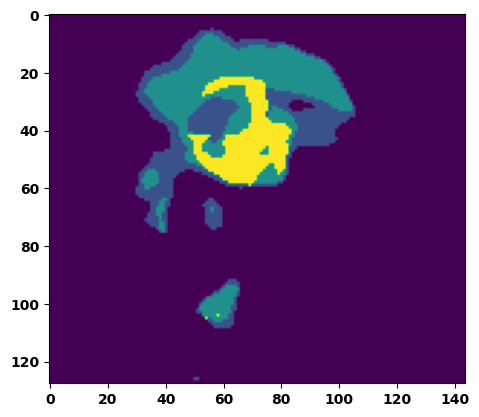

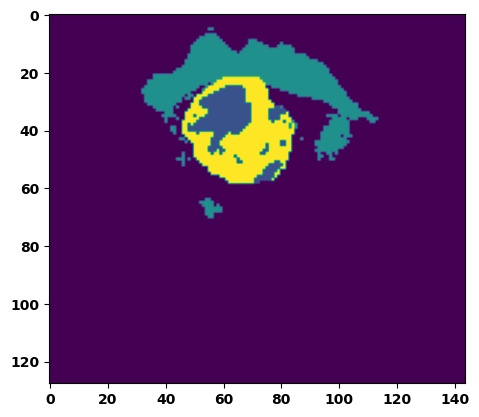

  6%|▌         | 2/36 [00:03<00:53,  1.57s/it]

Batch_id:  1 Eval loss:  0.358102947473526
Batch_id:  1 Eval IoU:  tensor(0.6076, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9828, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.49s/it]

Batch_id:  2 Eval loss:  0.38162481784820557
Batch_id:  2 Eval IoU:  tensor(0.5942, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 11%|█         | 4/36 [00:05<00:46,  1.45s/it]

Batch_id:  3 Eval loss:  0.4325125515460968
Batch_id:  3 Eval IoU:  tensor(0.5306, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9294, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9144, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9856, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.46s/it]

Batch_id:  4 Eval loss:  0.5219066739082336
Batch_id:  4 Eval IoU:  tensor(0.4596, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9326, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9324, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9310, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9857, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:42,  1.43s/it]

Batch_id:  5 Eval loss:  0.5546301603317261
Batch_id:  5 Eval IoU:  tensor(0.4092, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9215, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9261, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9167, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9768, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:40,  1.39s/it]

Batch_id:  6 Eval loss:  0.7501713037490845
Batch_id:  6 Eval IoU:  tensor(0.2136, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.8383, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.7784, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9122, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.8433, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9809, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:38,  1.39s/it]

Batch_id:  7 Eval loss:  0.42709898948669434
Batch_id:  7 Eval IoU:  tensor(0.5582, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9395, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9932, device='cuda:0')


 25%|██▌       | 9/36 [00:12<00:37,  1.38s/it]

Batch_id:  8 Eval loss:  0.5215411186218262
Batch_id:  8 Eval IoU:  tensor(0.4530, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9125, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.8939, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.8919, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9895, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:36,  1.40s/it]

Batch_id:  9 Eval loss:  0.31820327043533325
Batch_id:  9 Eval IoU:  tensor(0.6450, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9476, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  10 Eval loss:  0.4016556143760681
Batch_id:  10 Eval IoU:  tensor(0.5527, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9386, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9290, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9344, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9873, device='cuda:0')


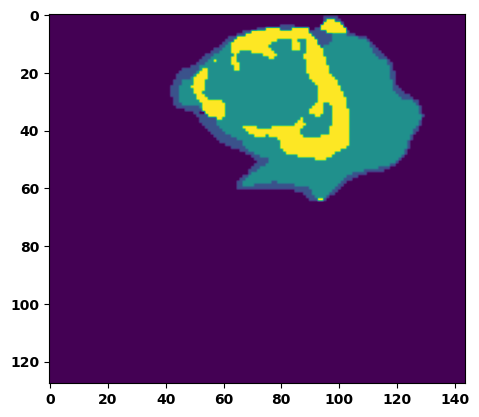

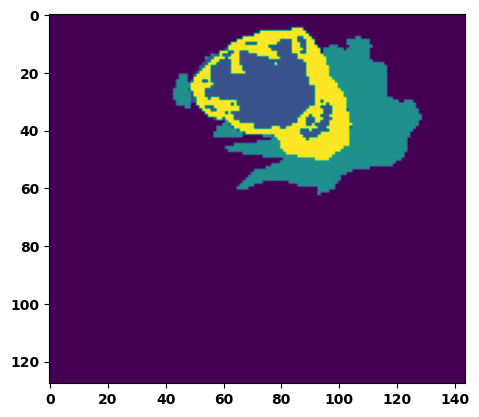

 33%|███▎      | 12/36 [00:17<00:37,  1.56s/it]

Batch_id:  11 Eval loss:  0.3635907471179962
Batch_id:  11 Eval IoU:  tensor(0.6072, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9385, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9296, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:35,  1.55s/it]

Batch_id:  12 Eval loss:  0.3983369469642639
Batch_id:  12 Eval IoU:  tensor(0.5557, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9334, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9304, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9321, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:33,  1.53s/it]

Batch_id:  13 Eval loss:  0.5301285982131958
Batch_id:  13 Eval IoU:  tensor(0.4338, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9243, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9096, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9322, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9839, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:30,  1.47s/it]

Batch_id:  14 Eval loss:  0.4746885895729065
Batch_id:  14 Eval IoU:  tensor(0.5628, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9340, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9434, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9974, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:30,  1.52s/it]

Batch_id:  15 Eval loss:  0.5655312538146973
Batch_id:  15 Eval IoU:  tensor(0.3878, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9165, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.8938, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.8909, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9858, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:27,  1.45s/it]

Batch_id:  16 Eval loss:  0.37404245138168335
Batch_id:  16 Eval IoU:  tensor(0.6060, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:27,  1.53s/it]

Batch_id:  17 Eval loss:  0.5240349173545837
Batch_id:  17 Eval IoU:  tensor(0.4815, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9264, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9014, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9323, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9957, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:25,  1.50s/it]

Batch_id:  18 Eval loss:  0.4375512897968292
Batch_id:  18 Eval IoU:  tensor(0.5703, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9378, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9957, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:24,  1.52s/it]

Batch_id:  19 Eval loss:  0.4959665536880493
Batch_id:  19 Eval IoU:  tensor(0.4730, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9258, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9190, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9262, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  20 Eval loss:  0.4870411157608032
Batch_id:  20 Eval IoU:  tensor(0.4419, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9186, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9399, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9084, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9447, device='cuda:0')


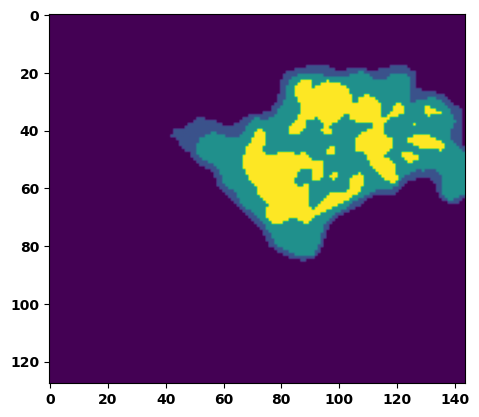

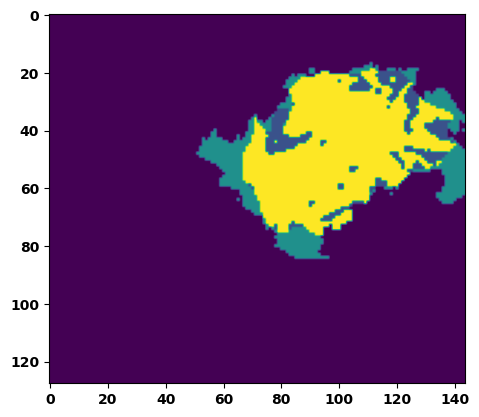

 61%|██████    | 22/36 [00:32<00:21,  1.55s/it]

Batch_id:  21 Eval loss:  0.44159990549087524
Batch_id:  21 Eval IoU:  tensor(0.5248, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.8925, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.8501, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.8607, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:20,  1.57s/it]

Batch_id:  22 Eval loss:  0.3678089678287506
Batch_id:  22 Eval IoU:  tensor(0.5874, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9311, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9204, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9841, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:18,  1.55s/it]

Batch_id:  23 Eval loss:  0.4145107865333557
Batch_id:  23 Eval IoU:  tensor(0.5481, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9353, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9508, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9865, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:16,  1.54s/it]

Batch_id:  24 Eval loss:  0.3263532817363739
Batch_id:  24 Eval IoU:  tensor(0.6675, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9913, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:15,  1.52s/it]

Batch_id:  25 Eval loss:  0.39027076959609985
Batch_id:  25 Eval IoU:  tensor(0.6148, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9378, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9320, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:13,  1.48s/it]

Batch_id:  26 Eval loss:  0.3226105272769928
Batch_id:  26 Eval IoU:  tensor(0.6736, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:12,  1.51s/it]

Batch_id:  27 Eval loss:  0.6765851974487305
Batch_id:  27 Eval IoU:  tensor(0.2977, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9182, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.8981, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9190, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:10,  1.55s/it]

Batch_id:  28 Eval loss:  0.34564709663391113
Batch_id:  28 Eval IoU:  tensor(0.6314, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 83%|████████▎ | 30/36 [00:45<00:09,  1.54s/it]

Batch_id:  29 Eval loss:  0.46486008167266846
Batch_id:  29 Eval IoU:  tensor(0.5533, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9141, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9432, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  30 Eval loss:  0.3516111373901367
Batch_id:  30 Eval IoU:  tensor(0.6315, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


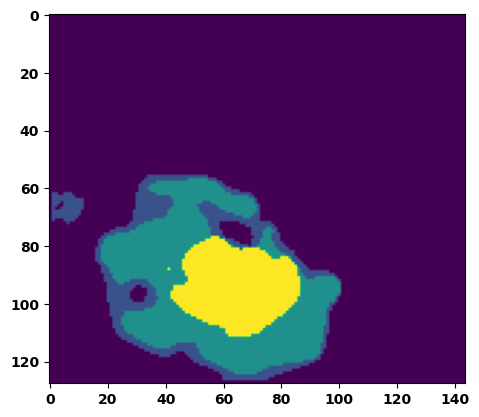

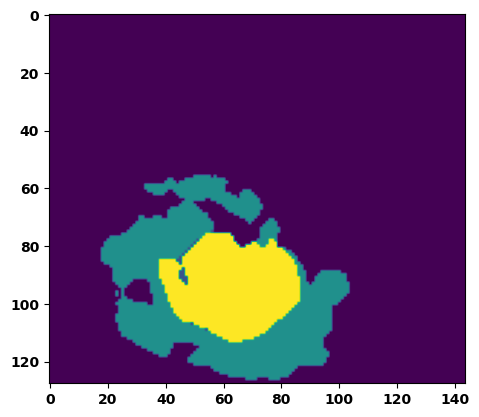

 89%|████████▉ | 32/36 [00:48<00:06,  1.55s/it]

Batch_id:  31 Eval loss:  0.4244598150253296
Batch_id:  31 Eval IoU:  tensor(0.5371, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9847, device='cuda:0')


 92%|█████████▏| 33/36 [00:49<00:04,  1.53s/it]

Batch_id:  32 Eval loss:  0.3633948862552643
Batch_id:  32 Eval IoU:  tensor(0.6240, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9359, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 94%|█████████▍| 34/36 [00:51<00:03,  1.53s/it]

Batch_id:  33 Eval loss:  0.43044453859329224
Batch_id:  33 Eval IoU:  tensor(0.5418, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9243, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9101, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9069, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 97%|█████████▋| 35/36 [00:52<00:01,  1.54s/it]

Batch_id:  34 Eval loss:  0.6215284466743469
Batch_id:  34 Eval IoU:  tensor(0.3277, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.8929, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.8400, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9350, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9222, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9816, device='cuda:0')


100%|██████████| 36/36 [00:54<00:00,  1.51s/it]

Batch_id:  35 Eval loss:  0.556191086769104
Batch_id:  35 Eval IoU:  tensor(0.3887, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9093, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9156, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9113, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9141, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9869, device='cuda:0')
Epoch  3 Training loss:  0.4664701521396637
Epoch  3 Evaluation loss:  0.4500330024295383
Epoch  3 Training accuracy :  tensor(0.5210)
Epoch  3 Evaluation accuracy :  tensor(0.5247)
Epoch  3 Training Mean Dice Score:  tensor(0.9525)
Epoch  3 Eval Mean Dice Score:  tensor(0.9331)
Epoch  3 Training Non-tumor Dice Score:  tensor(0.9603)
Epoch  3 Eval Non-tumor Dice Score:  tensor(0.9348)
Epoch  3 Training NCR/NET Dice Score:  tensor(0.9680)
Epoch  3 Eval NCR/NET Dice Score:  tensor(0.9357)
Epoch  3 Training ED Dice Score:  tensor(0.9472)
Epoch  3 

Epoch: 4
Training in session: 


  1%|          | 1/110 [00:01<02:35,  1.43s/it]

Batch_id:  0 Training loss:  0.37139058113098145
Batch_id:  0 Training IoU:  tensor(0.6009, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9338, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:45,  1.53s/it]

Batch_id:  1 Training loss:  0.3344112038612366
Batch_id:  1 Training IoU:  tensor(0.6415, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9434, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:41,  1.51s/it]

Batch_id:  2 Training loss:  0.4288322925567627
Batch_id:  2 Training IoU:  tensor(0.5526, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:46,  1.57s/it]

Batch_id:  3 Training loss:  0.6199880838394165
Batch_id:  3 Training IoU:  tensor(0.3258, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.8465, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.8031, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.8401, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9122, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9842, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:51,  1.63s/it]

Batch_id:  4 Training loss:  0.6097109317779541
Batch_id:  4 Training IoU:  tensor(0.3522, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.8779, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.8223, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9294, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.8902, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:47,  1.61s/it]

Batch_id:  5 Training loss:  0.40019524097442627
Batch_id:  5 Training IoU:  tensor(0.5495, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9249, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9750, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:40,  1.56s/it]

Batch_id:  6 Training loss:  0.4285731315612793
Batch_id:  6 Training IoU:  tensor(0.5890, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9391, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:32,  1.49s/it]

Batch_id:  7 Training loss:  0.43970853090286255
Batch_id:  7 Training IoU:  tensor(0.5171, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9225, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9080, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9224, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:30,  1.49s/it]

Batch_id:  8 Training loss:  0.4463423192501068
Batch_id:  8 Training IoU:  tensor(0.4623, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.8933, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9317, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9157, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.8738, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9587, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:31,  1.52s/it]

Batch_id:  9 Training loss:  0.5591694116592407
Batch_id:  9 Training IoU:  tensor(0.3740, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.8931, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.8679, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.8588, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 10%|█         | 11/110 [00:16<02:26,  1.48s/it]

Batch_id:  10 Training loss:  0.4805756211280823
Batch_id:  10 Training IoU:  tensor(0.4787, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9227, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9294, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9096, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9441, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 11%|█         | 12/110 [00:18<02:24,  1.47s/it]

Batch_id:  11 Training loss:  0.36194437742233276
Batch_id:  11 Training IoU:  tensor(0.6380, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:23,  1.48s/it]

Batch_id:  12 Training loss:  0.4318462014198303
Batch_id:  12 Training IoU:  tensor(0.5235, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9557, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9785, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:22,  1.49s/it]

Batch_id:  13 Training loss:  0.40883201360702515
Batch_id:  13 Training IoU:  tensor(0.6209, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:18,  1.46s/it]

Batch_id:  14 Training loss:  0.47128093242645264
Batch_id:  14 Training IoU:  tensor(0.5124, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:20,  1.50s/it]

Batch_id:  15 Training loss:  0.39054128527641296
Batch_id:  15 Training IoU:  tensor(0.5789, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:26,  1.58s/it]

Batch_id:  16 Training loss:  0.3858722448348999
Batch_id:  16 Training IoU:  tensor(0.5587, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9445, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9205, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:25,  1.59s/it]

Batch_id:  17 Training loss:  0.43245550990104675
Batch_id:  17 Training IoU:  tensor(0.6416, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 17%|█▋        | 19/110 [00:29<02:24,  1.59s/it]

Batch_id:  18 Training loss:  0.34260812401771545
Batch_id:  18 Training IoU:  tensor(0.6293, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:24,  1.60s/it]

Batch_id:  19 Training loss:  0.39672231674194336
Batch_id:  19 Training IoU:  tensor(0.5223, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9282, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9268, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.8986, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9804, device='cuda:0')


 19%|█▉        | 21/110 [00:32<02:19,  1.56s/it]

Batch_id:  20 Training loss:  0.6290969252586365
Batch_id:  20 Training IoU:  tensor(0.2982, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.8912, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.8544, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.8395, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 20%|██        | 22/110 [00:33<02:18,  1.57s/it]

Batch_id:  21 Training loss:  0.3749043345451355
Batch_id:  21 Training IoU:  tensor(0.5853, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9359, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 21%|██        | 23/110 [00:35<02:14,  1.55s/it]

Batch_id:  22 Training loss:  0.5208195447921753
Batch_id:  22 Training IoU:  tensor(0.4923, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:12,  1.54s/it]

Batch_id:  23 Training loss:  0.5345686674118042
Batch_id:  23 Training IoU:  tensor(0.4472, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9540, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 23%|██▎       | 25/110 [00:38<02:10,  1.53s/it]

Batch_id:  24 Training loss:  0.40340307354927063
Batch_id:  24 Training IoU:  tensor(0.5613, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9806, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:08,  1.53s/it]

Batch_id:  25 Training loss:  0.3396962881088257
Batch_id:  25 Training IoU:  tensor(0.5897, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9200, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9218, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.8916, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 25%|██▍       | 27/110 [00:41<02:13,  1.61s/it]

Batch_id:  26 Training loss:  0.4177650809288025
Batch_id:  26 Training IoU:  tensor(0.5938, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 25%|██▌       | 28/110 [00:43<02:12,  1.62s/it]

Batch_id:  27 Training loss:  0.40935176610946655
Batch_id:  27 Training IoU:  tensor(0.5680, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 26%|██▋       | 29/110 [00:44<02:06,  1.57s/it]

Batch_id:  28 Training loss:  0.45699164271354675
Batch_id:  28 Training IoU:  tensor(0.5788, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 27%|██▋       | 30/110 [00:46<02:03,  1.54s/it]

Batch_id:  29 Training loss:  0.43973344564437866
Batch_id:  29 Training IoU:  tensor(0.5255, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9377, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 28%|██▊       | 31/110 [00:48<02:06,  1.60s/it]

Batch_id:  30 Training loss:  0.49028894305229187
Batch_id:  30 Training IoU:  tensor(0.5337, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 29%|██▉       | 32/110 [00:49<02:05,  1.61s/it]

Batch_id:  31 Training loss:  0.48733803629875183
Batch_id:  31 Training IoU:  tensor(0.4842, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9513, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9432, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 30%|███       | 33/110 [00:51<02:00,  1.57s/it]

Batch_id:  32 Training loss:  0.4192494750022888
Batch_id:  32 Training IoU:  tensor(0.5559, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 31%|███       | 34/110 [00:52<01:59,  1.57s/it]

Batch_id:  33 Training loss:  0.6566872596740723
Batch_id:  33 Training IoU:  tensor(0.3031, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9295, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.8964, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9062, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 32%|███▏      | 35/110 [00:54<01:56,  1.55s/it]

Batch_id:  34 Training loss:  0.38660115003585815
Batch_id:  34 Training IoU:  tensor(0.5962, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 33%|███▎      | 36/110 [00:55<01:52,  1.52s/it]

Batch_id:  35 Training loss:  0.3908703923225403
Batch_id:  35 Training IoU:  tensor(0.5570, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9512, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9343, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9818, device='cuda:0')


 34%|███▎      | 37/110 [00:57<01:49,  1.50s/it]

Batch_id:  36 Training loss:  0.5124463438987732
Batch_id:  36 Training IoU:  tensor(0.3979, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.8913, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9336, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.8497, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9324, device='cuda:0')


 35%|███▍      | 38/110 [00:58<01:47,  1.49s/it]

Batch_id:  37 Training loss:  0.5078433752059937
Batch_id:  37 Training IoU:  tensor(0.4546, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 35%|███▌      | 39/110 [01:00<01:45,  1.48s/it]

Batch_id:  38 Training loss:  0.4620043635368347
Batch_id:  38 Training IoU:  tensor(0.4630, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9277, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9275, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9021, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9709, device='cuda:0')


 36%|███▋      | 40/110 [01:01<01:51,  1.59s/it]

Batch_id:  39 Training loss:  0.5517858862876892
Batch_id:  39 Training IoU:  tensor(0.4049, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9464, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 37%|███▋      | 41/110 [01:03<01:47,  1.56s/it]

Batch_id:  40 Training loss:  0.4199690818786621
Batch_id:  40 Training IoU:  tensor(0.5297, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9810, device='cuda:0')


 38%|███▊      | 42/110 [01:04<01:46,  1.57s/it]

Batch_id:  41 Training loss:  0.34971997141838074
Batch_id:  41 Training IoU:  tensor(0.6199, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 39%|███▉      | 43/110 [01:06<01:42,  1.54s/it]

Batch_id:  42 Training loss:  0.4288426637649536
Batch_id:  42 Training IoU:  tensor(0.5115, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9765, device='cuda:0')


 40%|████      | 44/110 [01:07<01:37,  1.48s/it]

Batch_id:  43 Training loss:  0.6187545657157898
Batch_id:  43 Training IoU:  tensor(0.3537, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 41%|████      | 45/110 [01:09<01:34,  1.45s/it]

Batch_id:  44 Training loss:  0.3718108534812927
Batch_id:  44 Training IoU:  tensor(0.6296, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 42%|████▏     | 46/110 [01:10<01:31,  1.44s/it]

Batch_id:  45 Training loss:  0.40417546033859253
Batch_id:  45 Training IoU:  tensor(0.5448, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9764, device='cuda:0')


 43%|████▎     | 47/110 [01:11<01:26,  1.38s/it]

Batch_id:  46 Training loss:  0.3649790287017822
Batch_id:  46 Training IoU:  tensor(0.5989, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 44%|████▎     | 48/110 [01:13<01:26,  1.40s/it]

Batch_id:  47 Training loss:  0.5517358779907227
Batch_id:  47 Training IoU:  tensor(0.4271, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9464, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 45%|████▍     | 49/110 [01:14<01:24,  1.39s/it]

Batch_id:  48 Training loss:  0.40793514251708984
Batch_id:  48 Training IoU:  tensor(0.5221, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9308, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9204, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9356, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9592, device='cuda:0')


 45%|████▌     | 50/110 [01:15<01:21,  1.36s/it]

Batch_id:  49 Training loss:  0.3683607578277588
Batch_id:  49 Training IoU:  tensor(0.5974, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 46%|████▋     | 51/110 [01:17<01:19,  1.35s/it]

Batch_id:  50 Training loss:  0.33893898129463196
Batch_id:  50 Training IoU:  tensor(0.6483, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 47%|████▋     | 52/110 [01:18<01:18,  1.36s/it]

Batch_id:  51 Training loss:  0.4124951958656311
Batch_id:  51 Training IoU:  tensor(0.5585, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 48%|████▊     | 53/110 [01:19<01:17,  1.35s/it]

Batch_id:  52 Training loss:  0.37447088956832886
Batch_id:  52 Training IoU:  tensor(0.5867, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 49%|████▉     | 54/110 [01:21<01:13,  1.32s/it]

Batch_id:  53 Training loss:  0.5125056505203247
Batch_id:  53 Training IoU:  tensor(0.4196, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.8999, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9072, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.8703, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9590, device='cuda:0')


 50%|█████     | 55/110 [01:22<01:13,  1.34s/it]

Batch_id:  54 Training loss:  0.31421250104904175
Batch_id:  54 Training IoU:  tensor(0.6353, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 51%|█████     | 56/110 [01:23<01:11,  1.32s/it]

Batch_id:  55 Training loss:  0.3076833188533783
Batch_id:  55 Training IoU:  tensor(0.6946, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 52%|█████▏    | 57/110 [01:25<01:12,  1.36s/it]

Batch_id:  56 Training loss:  0.4315859079360962
Batch_id:  56 Training IoU:  tensor(0.5109, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9355, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9455, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9142, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9719, device='cuda:0')


 53%|█████▎    | 58/110 [01:26<01:09,  1.34s/it]

Batch_id:  57 Training loss:  0.4655438959598541
Batch_id:  57 Training IoU:  tensor(0.4545, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9355, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9158, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9376, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 54%|█████▎    | 59/110 [01:28<01:11,  1.40s/it]

Batch_id:  58 Training loss:  0.4192243814468384
Batch_id:  58 Training IoU:  tensor(0.5197, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9484, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9771, device='cuda:0')


 55%|█████▍    | 60/110 [01:29<01:09,  1.39s/it]

Batch_id:  59 Training loss:  0.509125828742981
Batch_id:  59 Training IoU:  tensor(0.4144, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9285, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9207, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9558, device='cuda:0')


 55%|█████▌    | 61/110 [01:30<01:05,  1.34s/it]

Batch_id:  60 Training loss:  0.7194386124610901
Batch_id:  60 Training IoU:  tensor(0.2498, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9151, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.8839, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9327, device='cuda:0')


 56%|█████▋    | 62/110 [01:32<01:05,  1.36s/it]

Batch_id:  61 Training loss:  0.3995465636253357
Batch_id:  61 Training IoU:  tensor(0.5528, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9444, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 57%|█████▋    | 63/110 [01:33<01:03,  1.35s/it]

Batch_id:  62 Training loss:  0.5892621278762817
Batch_id:  62 Training IoU:  tensor(0.3720, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9084, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:03,  1.37s/it]

Batch_id:  63 Training loss:  0.3804425299167633
Batch_id:  63 Training IoU:  tensor(0.5968, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 59%|█████▉    | 65/110 [01:36<01:02,  1.39s/it]

Batch_id:  64 Training loss:  0.583244800567627
Batch_id:  64 Training IoU:  tensor(0.3676, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9340, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9122, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9802, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:03,  1.45s/it]

Batch_id:  65 Training loss:  0.5019586086273193
Batch_id:  65 Training IoU:  tensor(0.5190, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 61%|██████    | 67/110 [01:39<01:01,  1.43s/it]

Batch_id:  66 Training loss:  0.42094045877456665
Batch_id:  66 Training IoU:  tensor(0.5233, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9372, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9244, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9354, device='cuda:0')


 62%|██████▏   | 68/110 [01:40<01:02,  1.48s/it]

Batch_id:  67 Training loss:  0.4633455276489258
Batch_id:  67 Training IoU:  tensor(0.5314, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9477, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 63%|██████▎   | 69/110 [01:42<00:59,  1.46s/it]

Batch_id:  68 Training loss:  0.4205208420753479
Batch_id:  68 Training IoU:  tensor(0.5319, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9617, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9814, device='cuda:0')


 64%|██████▎   | 70/110 [01:43<00:56,  1.40s/it]

Batch_id:  69 Training loss:  0.4091986119747162
Batch_id:  69 Training IoU:  tensor(0.5544, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 65%|██████▍   | 71/110 [01:44<00:53,  1.36s/it]

Batch_id:  70 Training loss:  0.4924970269203186
Batch_id:  70 Training IoU:  tensor(0.4486, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.8822, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9318, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.8963, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.8404, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9782, device='cuda:0')


 65%|██████▌   | 72/110 [01:46<00:53,  1.40s/it]

Batch_id:  71 Training loss:  0.3424871563911438
Batch_id:  71 Training IoU:  tensor(0.6247, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:52,  1.42s/it]

Batch_id:  72 Training loss:  0.3259100019931793
Batch_id:  72 Training IoU:  tensor(0.6848, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:50,  1.41s/it]

Batch_id:  73 Training loss:  0.4178388714790344
Batch_id:  73 Training IoU:  tensor(0.5295, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9462, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9475, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 68%|██████▊   | 75/110 [01:50<00:50,  1.45s/it]

Batch_id:  74 Training loss:  0.3359676003456116
Batch_id:  74 Training IoU:  tensor(0.6337, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:48,  1.42s/it]

Batch_id:  75 Training loss:  0.2766457796096802
Batch_id:  75 Training IoU:  tensor(0.6908, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 70%|███████   | 77/110 [01:53<00:45,  1.39s/it]

Batch_id:  76 Training loss:  0.44931575655937195
Batch_id:  76 Training IoU:  tensor(0.5126, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:45,  1.42s/it]

Batch_id:  77 Training loss:  0.36746296286582947
Batch_id:  77 Training IoU:  tensor(0.5574, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9321, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9210, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9111, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 72%|███████▏  | 79/110 [01:56<00:43,  1.42s/it]

Batch_id:  78 Training loss:  0.52141273021698
Batch_id:  78 Training IoU:  tensor(0.4449, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9307, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9175, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9116, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9833, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:42,  1.40s/it]

Batch_id:  79 Training loss:  0.5220234990119934
Batch_id:  79 Training IoU:  tensor(0.4032, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9395, device='cuda:0')


 74%|███████▎  | 81/110 [01:58<00:39,  1.36s/it]

Batch_id:  80 Training loss:  0.39063480496406555
Batch_id:  80 Training IoU:  tensor(0.5271, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9378, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9348, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9428, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9802, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:38,  1.38s/it]

Batch_id:  81 Training loss:  0.4549049139022827
Batch_id:  81 Training IoU:  tensor(0.4968, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9223, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:35,  1.33s/it]

Batch_id:  82 Training loss:  0.37446051836013794
Batch_id:  82 Training IoU:  tensor(0.5937, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:36,  1.38s/it]

Batch_id:  83 Training loss:  0.3717575669288635
Batch_id:  83 Training IoU:  tensor(0.5635, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:34,  1.39s/it]

Batch_id:  84 Training loss:  0.4089711904525757
Batch_id:  84 Training IoU:  tensor(0.5551, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 78%|███████▊  | 86/110 [02:05<00:33,  1.39s/it]

Batch_id:  85 Training loss:  0.4242750406265259
Batch_id:  85 Training IoU:  tensor(0.4881, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9332, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9271, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9282, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9710, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:32,  1.41s/it]

Batch_id:  86 Training loss:  0.43245911598205566
Batch_id:  86 Training IoU:  tensor(0.5319, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 80%|████████  | 88/110 [02:08<00:30,  1.40s/it]

Batch_id:  87 Training loss:  0.2963402271270752
Batch_id:  87 Training IoU:  tensor(0.6874, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:29,  1.40s/it]

Batch_id:  88 Training loss:  0.40823906660079956
Batch_id:  88 Training IoU:  tensor(0.5118, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9360, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9113, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9807, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:28,  1.42s/it]

Batch_id:  89 Training loss:  0.34457534551620483
Batch_id:  89 Training IoU:  tensor(0.5799, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9328, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9227, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9664, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:27,  1.45s/it]

Batch_id:  90 Training loss:  0.4596484303474426
Batch_id:  90 Training IoU:  tensor(0.5748, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:25,  1.43s/it]

Batch_id:  91 Training loss:  0.455745130777359
Batch_id:  91 Training IoU:  tensor(0.4664, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9132, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.8977, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9199, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9819, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:25,  1.48s/it]

Batch_id:  92 Training loss:  0.37437063455581665
Batch_id:  92 Training IoU:  tensor(0.5810, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:23,  1.46s/it]

Batch_id:  93 Training loss:  0.4401850700378418
Batch_id:  93 Training IoU:  tensor(0.5060, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9371, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9740, device='cuda:0')


 86%|████████▋ | 95/110 [02:18<00:21,  1.46s/it]

Batch_id:  94 Training loss:  0.3384496569633484
Batch_id:  94 Training IoU:  tensor(0.5923, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9790, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:19,  1.41s/it]

Batch_id:  95 Training loss:  0.6310892701148987
Batch_id:  95 Training IoU:  tensor(0.3155, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9226, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.8879, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9203, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9799, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:18,  1.44s/it]

Batch_id:  96 Training loss:  0.3008216619491577
Batch_id:  96 Training IoU:  tensor(0.6318, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:17,  1.47s/it]

Batch_id:  97 Training loss:  0.5812342762947083
Batch_id:  97 Training IoU:  tensor(0.3424, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.8888, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.8958, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.8592, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9439, device='cuda:0')


 90%|█████████ | 99/110 [02:24<00:16,  1.48s/it]

Batch_id:  98 Training loss:  0.4799371063709259
Batch_id:  98 Training IoU:  tensor(0.4696, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9475, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:14,  1.48s/it]

Batch_id:  99 Training loss:  0.31668394804000854
Batch_id:  99 Training IoU:  tensor(0.6638, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 92%|█████████▏| 101/110 [02:27<00:13,  1.49s/it]

Batch_id:  100 Training loss:  0.3965347111225128
Batch_id:  100 Training IoU:  tensor(0.5256, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9410, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9311, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9578, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:11,  1.47s/it]

Batch_id:  101 Training loss:  0.3701917231082916
Batch_id:  101 Training IoU:  tensor(0.5550, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9743, device='cuda:0')


 94%|█████████▎| 103/110 [02:30<00:10,  1.50s/it]

Batch_id:  102 Training loss:  0.3256661295890808
Batch_id:  102 Training IoU:  tensor(0.6683, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:09,  1.51s/it]

Batch_id:  103 Training loss:  0.37210559844970703
Batch_id:  103 Training IoU:  tensor(0.6005, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 95%|█████████▌| 105/110 [02:33<00:07,  1.52s/it]

Batch_id:  104 Training loss:  0.43504154682159424
Batch_id:  104 Training IoU:  tensor(0.4775, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9202, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9083, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9045, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9680, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:05,  1.49s/it]

Batch_id:  105 Training loss:  0.425538033246994
Batch_id:  105 Training IoU:  tensor(0.5348, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9524, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 97%|█████████▋| 107/110 [02:36<00:04,  1.42s/it]

Batch_id:  106 Training loss:  0.3902328610420227
Batch_id:  106 Training IoU:  tensor(0.5605, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:02,  1.47s/it]

Batch_id:  107 Training loss:  0.28755810856819153
Batch_id:  107 Training IoU:  tensor(0.6853, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 99%|█████████▉| 109/110 [02:39<00:01,  1.46s/it]

Batch_id:  108 Training loss:  0.29664188623428345
Batch_id:  108 Training IoU:  tensor(0.7002, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


100%|██████████| 110/110 [02:40<00:00,  1.46s/it]


Batch_id:  109 Training loss:  0.5620473027229309
Batch_id:  109 Training IoU:  tensor(0.3997, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9323, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9806, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.3109312653541565
Batch_id:  0 Eval IoU:  tensor(0.6756, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')


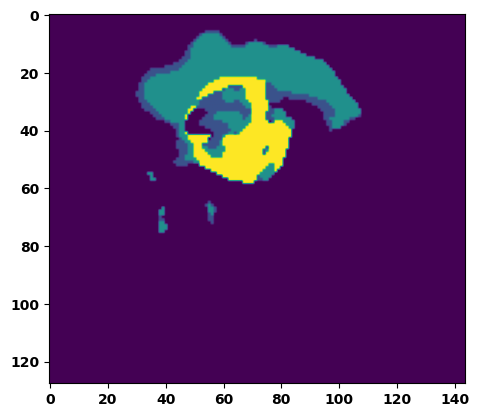

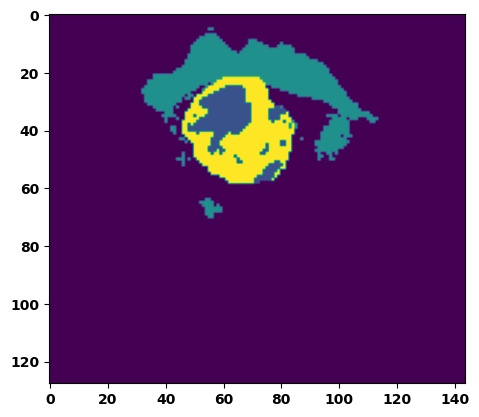

  6%|▌         | 2/36 [00:02<00:49,  1.46s/it]

Batch_id:  1 Eval loss:  0.28807151317596436
Batch_id:  1 Eval IoU:  tensor(0.7036, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.50s/it]

Batch_id:  2 Eval loss:  0.48100781440734863
Batch_id:  2 Eval IoU:  tensor(0.4892, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9879, device='cuda:0')


 11%|█         | 4/36 [00:06<00:49,  1.56s/it]

Batch_id:  3 Eval loss:  0.4436209797859192
Batch_id:  3 Eval IoU:  tensor(0.5145, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9284, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9395, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.8989, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:46,  1.49s/it]

Batch_id:  4 Eval loss:  0.47965383529663086
Batch_id:  4 Eval IoU:  tensor(0.4862, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9358, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9876, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:44,  1.49s/it]

Batch_id:  5 Eval loss:  0.3458540439605713
Batch_id:  5 Eval IoU:  tensor(0.6101, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9454, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9928, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.45s/it]

Batch_id:  6 Eval loss:  0.4090600907802582
Batch_id:  6 Eval IoU:  tensor(0.6080, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9963, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:39,  1.41s/it]

Batch_id:  7 Eval loss:  0.39074721932411194
Batch_id:  7 Eval IoU:  tensor(0.5758, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9916, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:38,  1.41s/it]

Batch_id:  8 Eval loss:  0.3844919800758362
Batch_id:  8 Eval IoU:  tensor(0.5655, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9864, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:36,  1.39s/it]

Batch_id:  9 Eval loss:  0.3403286933898926
Batch_id:  9 Eval IoU:  tensor(0.5954, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  10 Eval loss:  0.37965378165245056
Batch_id:  10 Eval IoU:  tensor(0.5733, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')


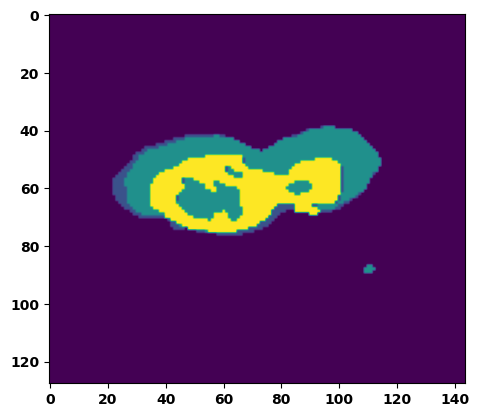

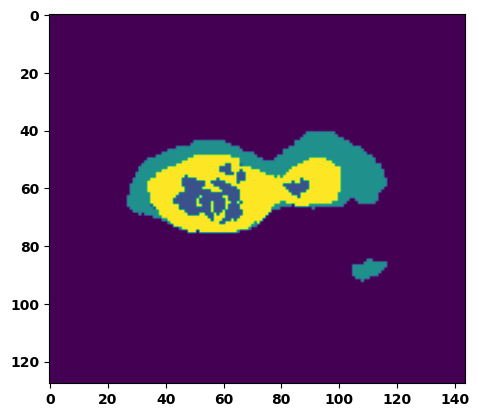

 33%|███▎      | 12/36 [00:17<00:34,  1.45s/it]

Batch_id:  11 Eval loss:  0.4140093922615051
Batch_id:  11 Eval IoU:  tensor(0.5787, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:33,  1.47s/it]

Batch_id:  12 Eval loss:  0.3392602801322937
Batch_id:  12 Eval IoU:  tensor(0.6248, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9916, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.42s/it]

Batch_id:  13 Eval loss:  0.4897717237472534
Batch_id:  13 Eval IoU:  tensor(0.4726, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9268, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9106, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.8964, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:30,  1.44s/it]

Batch_id:  14 Eval loss:  0.3523884415626526
Batch_id:  14 Eval IoU:  tensor(0.5797, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9482, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9896, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.42s/it]

Batch_id:  15 Eval loss:  0.35733693838119507
Batch_id:  15 Eval IoU:  tensor(0.5639, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9513, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9851, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:27,  1.47s/it]

Batch_id:  16 Eval loss:  0.3126869797706604
Batch_id:  16 Eval IoU:  tensor(0.6336, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9490, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9807, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.46s/it]

Batch_id:  17 Eval loss:  0.6299377679824829
Batch_id:  17 Eval IoU:  tensor(0.3499, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:25,  1.48s/it]

Batch_id:  18 Eval loss:  0.3231114149093628
Batch_id:  18 Eval IoU:  tensor(0.6166, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9353, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9274, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9367, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9882, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:24,  1.52s/it]

Batch_id:  19 Eval loss:  0.4225196838378906
Batch_id:  19 Eval IoU:  tensor(0.5349, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9076, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.8673, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.8656, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  20 Eval loss:  0.48099222779273987
Batch_id:  20 Eval IoU:  tensor(0.5054, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9513, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9553, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9963, device='cuda:0')


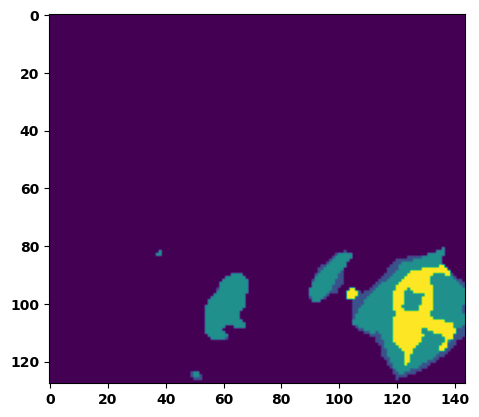

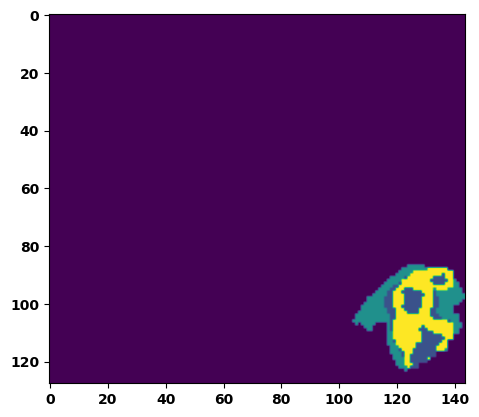

 61%|██████    | 22/36 [00:32<00:20,  1.48s/it]

Batch_id:  21 Eval loss:  0.4021379053592682
Batch_id:  21 Eval IoU:  tensor(0.6126, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:18,  1.45s/it]

Batch_id:  22 Eval loss:  0.33401286602020264
Batch_id:  22 Eval IoU:  tensor(0.6389, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.47s/it]

Batch_id:  23 Eval loss:  0.5173353552818298
Batch_id:  23 Eval IoU:  tensor(0.4064, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9264, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9071, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.8935, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:16,  1.50s/it]

Batch_id:  24 Eval loss:  0.28199052810668945
Batch_id:  24 Eval IoU:  tensor(0.6947, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.45s/it]

Batch_id:  25 Eval loss:  0.7549452781677246
Batch_id:  25 Eval IoU:  tensor(0.2150, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.8791, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.8245, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.8739, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9857, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:13,  1.45s/it]

Batch_id:  26 Eval loss:  0.3114376962184906
Batch_id:  26 Eval IoU:  tensor(0.6783, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9935, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.41s/it]

Batch_id:  27 Eval loss:  0.5168781280517578
Batch_id:  27 Eval IoU:  tensor(0.4295, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9455, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9339, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9825, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.46s/it]

Batch_id:  28 Eval loss:  0.2949243187904358
Batch_id:  28 Eval IoU:  tensor(0.6651, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.43s/it]

Batch_id:  29 Eval loss:  0.45136404037475586
Batch_id:  29 Eval IoU:  tensor(0.4625, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9359, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9231, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  30 Eval loss:  0.5642387866973877
Batch_id:  30 Eval IoU:  tensor(0.3899, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9371, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9064, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9349, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


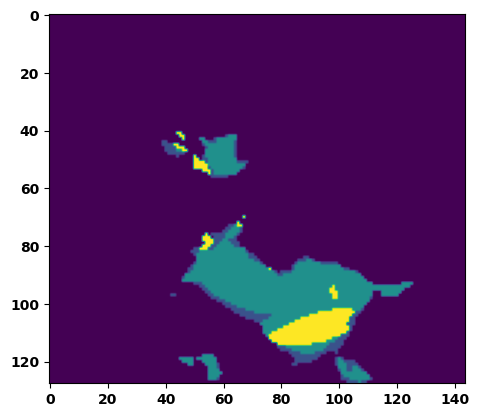

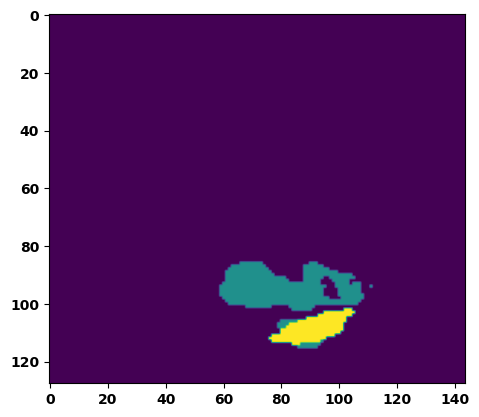

 89%|████████▉ | 32/36 [00:46<00:06,  1.51s/it]

Batch_id:  31 Eval loss:  0.5220288038253784
Batch_id:  31 Eval IoU:  tensor(0.4368, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9803, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.53s/it]

Batch_id:  32 Eval loss:  0.33090537786483765
Batch_id:  32 Eval IoU:  tensor(0.6448, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.46s/it]

Batch_id:  33 Eval loss:  0.5442200899124146
Batch_id:  33 Eval IoU:  tensor(0.3918, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9287, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9445, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9280, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9230, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.48s/it]

Batch_id:  34 Eval loss:  0.36998534202575684
Batch_id:  34 Eval IoU:  tensor(0.5992, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.47s/it]

Batch_id:  35 Eval loss:  0.41286778450012207
Batch_id:  35 Eval IoU:  tensor(0.5667, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')
Epoch  4 Training loss:  0.4326392477208918
Epoch  4 Evaluation loss:  0.4162418991327286
Epoch  4 Training accuracy :  tensor(0.5287)
Epoch  4 Evaluation accuracy :  tensor(0.5469)
Epoch  4 Training Mean Dice Score:  tensor(0.9497)
Epoch  4 Eval Mean Dice Score:  tensor(0.9540)
Epoch  4 Training Non-tumor Dice Score:  tensor(0.9584)
Epoch  4 Eval Non-tumor Dice Score:  tensor(0.9611)
Epoch  4 Training NCR/NET Dice Score:  tensor(0.9618)
Epoch  4 Eval NCR/NET Dice Score:  tensor(0.9645)
Epoch  4 Training ED Dice Score:  tensor(0.9461)
Epoch  

Epoch: 5
Training in session: 


  1%|          | 1/110 [00:01<02:59,  1.65s/it]

Batch_id:  0 Training loss:  0.6078972220420837
Batch_id:  0 Training IoU:  tensor(0.3517, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9395, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9132, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:42,  1.51s/it]

Batch_id:  1 Training loss:  0.3989601135253906
Batch_id:  1 Training IoU:  tensor(0.5530, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:44,  1.54s/it]

Batch_id:  2 Training loss:  0.45645347237586975
Batch_id:  2 Training IoU:  tensor(0.4832, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9307, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9450, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9013, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9752, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:36,  1.47s/it]

Batch_id:  3 Training loss:  0.3765084147453308
Batch_id:  3 Training IoU:  tensor(0.6332, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:36,  1.49s/it]

Batch_id:  4 Training loss:  0.584204912185669
Batch_id:  4 Training IoU:  tensor(0.3846, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9432, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9806, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:30,  1.45s/it]

Batch_id:  5 Training loss:  0.4250980615615845
Batch_id:  5 Training IoU:  tensor(0.5491, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:31,  1.47s/it]

Batch_id:  6 Training loss:  0.5238330364227295
Batch_id:  6 Training IoU:  tensor(0.4533, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:27,  1.45s/it]

Batch_id:  7 Training loss:  0.5264948606491089
Batch_id:  7 Training IoU:  tensor(0.4626, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:25,  1.44s/it]

Batch_id:  8 Training loss:  0.36067330837249756
Batch_id:  8 Training IoU:  tensor(0.6027, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9789, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:29,  1.49s/it]

Batch_id:  9 Training loss:  0.6164358854293823
Batch_id:  9 Training IoU:  tensor(0.3506, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 10%|█         | 11/110 [00:16<02:29,  1.51s/it]

Batch_id:  10 Training loss:  0.46056216955184937
Batch_id:  10 Training IoU:  tensor(0.5687, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 11%|█         | 12/110 [00:17<02:24,  1.48s/it]

Batch_id:  11 Training loss:  0.45851969718933105
Batch_id:  11 Training IoU:  tensor(0.4994, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:21,  1.46s/it]

Batch_id:  12 Training loss:  0.31454840302467346
Batch_id:  12 Training IoU:  tensor(0.6793, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:19,  1.45s/it]

Batch_id:  13 Training loss:  0.48842963576316833
Batch_id:  13 Training IoU:  tensor(0.4644, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9743, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:22,  1.50s/it]

Batch_id:  14 Training loss:  0.30171120166778564
Batch_id:  14 Training IoU:  tensor(0.6731, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:20,  1.49s/it]

Batch_id:  15 Training loss:  0.4040862023830414
Batch_id:  15 Training IoU:  tensor(0.5326, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9275, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9465, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:17,  1.48s/it]

Batch_id:  16 Training loss:  0.37525492906570435
Batch_id:  16 Training IoU:  tensor(0.5651, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9441, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:13,  1.45s/it]

Batch_id:  17 Training loss:  0.44413524866104126
Batch_id:  17 Training IoU:  tensor(0.5311, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:13,  1.46s/it]

Batch_id:  18 Training loss:  0.53194260597229
Batch_id:  18 Training IoU:  tensor(0.4150, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9815, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:15,  1.51s/it]

Batch_id:  19 Training loss:  0.4187324345111847
Batch_id:  19 Training IoU:  tensor(0.6069, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:13,  1.49s/it]

Batch_id:  20 Training loss:  0.3992629051208496
Batch_id:  20 Training IoU:  tensor(0.5626, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 20%|██        | 22/110 [00:32<02:07,  1.45s/it]

Batch_id:  21 Training loss:  0.36135512590408325
Batch_id:  21 Training IoU:  tensor(0.6130, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 21%|██        | 23/110 [00:33<02:06,  1.45s/it]

Batch_id:  22 Training loss:  0.451781690120697
Batch_id:  22 Training IoU:  tensor(0.4901, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9831, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:04,  1.45s/it]

Batch_id:  23 Training loss:  0.4496920108795166
Batch_id:  23 Training IoU:  tensor(0.4743, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9075, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9303, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9459, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.8820, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9643, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:05,  1.48s/it]

Batch_id:  24 Training loss:  0.33041030168533325
Batch_id:  24 Training IoU:  tensor(0.6396, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:04,  1.49s/it]

Batch_id:  25 Training loss:  0.43234479427337646
Batch_id:  25 Training IoU:  tensor(0.4859, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9266, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9801, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:02,  1.48s/it]

Batch_id:  26 Training loss:  0.351406991481781
Batch_id:  26 Training IoU:  tensor(0.5950, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 25%|██▌       | 28/110 [00:41<02:01,  1.49s/it]

Batch_id:  27 Training loss:  0.2741517722606659
Batch_id:  27 Training IoU:  tensor(0.6795, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9537, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:56,  1.44s/it]

Batch_id:  28 Training loss:  0.4631537199020386
Batch_id:  28 Training IoU:  tensor(0.4628, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9614, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:56,  1.45s/it]

Batch_id:  29 Training loss:  0.5117576122283936
Batch_id:  29 Training IoU:  tensor(0.4243, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:52,  1.43s/it]

Batch_id:  30 Training loss:  0.34584760665893555
Batch_id:  30 Training IoU:  tensor(0.6345, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 29%|██▉       | 32/110 [00:47<01:53,  1.46s/it]

Batch_id:  31 Training loss:  0.40100622177124023
Batch_id:  31 Training IoU:  tensor(0.5312, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9374, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 30%|███       | 33/110 [00:48<01:55,  1.50s/it]

Batch_id:  32 Training loss:  0.41204413771629333
Batch_id:  32 Training IoU:  tensor(0.5351, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9817, device='cuda:0')


 31%|███       | 34/110 [00:50<01:53,  1.49s/it]

Batch_id:  33 Training loss:  0.37786513566970825
Batch_id:  33 Training IoU:  tensor(0.5451, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9302, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9238, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9811, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:49,  1.47s/it]

Batch_id:  34 Training loss:  0.3870423436164856
Batch_id:  34 Training IoU:  tensor(0.5529, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:48,  1.47s/it]

Batch_id:  35 Training loss:  0.38468778133392334
Batch_id:  35 Training IoU:  tensor(0.5506, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9669, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:50,  1.51s/it]

Batch_id:  36 Training loss:  0.30239301919937134
Batch_id:  36 Training IoU:  tensor(0.6666, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:45,  1.47s/it]

Batch_id:  37 Training loss:  0.36831212043762207
Batch_id:  37 Training IoU:  tensor(0.5991, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9763, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:47,  1.51s/it]

Batch_id:  38 Training loss:  0.4177059531211853
Batch_id:  38 Training IoU:  tensor(0.5051, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.8996, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.8780, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.8706, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9786, device='cuda:0')


 36%|███▋      | 40/110 [00:59<01:45,  1.51s/it]

Batch_id:  39 Training loss:  0.36846810579299927
Batch_id:  39 Training IoU:  tensor(0.6024, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 37%|███▋      | 41/110 [01:00<01:44,  1.52s/it]

Batch_id:  40 Training loss:  0.3972368836402893
Batch_id:  40 Training IoU:  tensor(0.5286, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9381, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9692, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:44,  1.53s/it]

Batch_id:  41 Training loss:  0.3628793954849243
Batch_id:  41 Training IoU:  tensor(0.5829, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9524, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9800, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:47,  1.60s/it]

Batch_id:  42 Training loss:  0.3957750201225281
Batch_id:  42 Training IoU:  tensor(0.5416, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9255, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9166, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9041, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 40%|████      | 44/110 [01:05<01:42,  1.55s/it]

Batch_id:  43 Training loss:  0.42741459608078003
Batch_id:  43 Training IoU:  tensor(0.5272, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9528, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9781, device='cuda:0')


 41%|████      | 45/110 [01:07<01:43,  1.59s/it]

Batch_id:  44 Training loss:  0.6149354577064514
Batch_id:  44 Training IoU:  tensor(0.3252, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9120, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9242, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9356, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.8935, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:37,  1.52s/it]

Batch_id:  45 Training loss:  0.5549479722976685
Batch_id:  45 Training IoU:  tensor(0.3569, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.8874, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.8994, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9177, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.8868, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9582, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:34,  1.50s/it]

Batch_id:  46 Training loss:  0.5668409466743469
Batch_id:  46 Training IoU:  tensor(0.3661, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9104, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.8949, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.8862, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:32,  1.50s/it]

Batch_id:  47 Training loss:  0.5873159766197205
Batch_id:  47 Training IoU:  tensor(0.3770, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9265, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9072, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9162, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:31,  1.50s/it]

Batch_id:  48 Training loss:  0.4488042891025543
Batch_id:  48 Training IoU:  tensor(0.4708, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9072, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.8979, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.8773, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 45%|████▌     | 50/110 [01:14<01:35,  1.59s/it]

Batch_id:  49 Training loss:  0.3496198058128357
Batch_id:  49 Training IoU:  tensor(0.5848, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9218, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9025, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.8851, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 46%|████▋     | 51/110 [01:16<01:29,  1.52s/it]

Batch_id:  50 Training loss:  0.41293132305145264
Batch_id:  50 Training IoU:  tensor(0.4822, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9083, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9046, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.8954, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9593, device='cuda:0')


 47%|████▋     | 52/110 [01:17<01:28,  1.52s/it]

Batch_id:  51 Training loss:  0.6191333532333374
Batch_id:  51 Training IoU:  tensor(0.3332, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.8999, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.8668, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.8897, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 48%|████▊     | 53/110 [01:19<01:28,  1.56s/it]

Batch_id:  52 Training loss:  0.39967843890190125
Batch_id:  52 Training IoU:  tensor(0.6187, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9512, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 49%|████▉     | 54/110 [01:20<01:29,  1.60s/it]

Batch_id:  53 Training loss:  0.3198705017566681
Batch_id:  53 Training IoU:  tensor(0.6171, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9490, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9251, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9835, device='cuda:0')


 50%|█████     | 55/110 [01:22<01:28,  1.60s/it]

Batch_id:  54 Training loss:  0.6901723146438599
Batch_id:  54 Training IoU:  tensor(0.2735, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.8211, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.7445, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.8800, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.8580, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9807, device='cuda:0')


 51%|█████     | 56/110 [01:24<01:25,  1.59s/it]

Batch_id:  55 Training loss:  0.3946724236011505
Batch_id:  55 Training IoU:  tensor(0.4928, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9041, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9362, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9358, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.8818, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9585, device='cuda:0')


 52%|█████▏    | 57/110 [01:25<01:25,  1.62s/it]

Batch_id:  56 Training loss:  0.3813437521457672
Batch_id:  56 Training IoU:  tensor(0.5831, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 53%|█████▎    | 58/110 [01:27<01:20,  1.54s/it]

Batch_id:  57 Training loss:  0.31815969944000244
Batch_id:  57 Training IoU:  tensor(0.6537, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 54%|█████▎    | 59/110 [01:28<01:17,  1.53s/it]

Batch_id:  58 Training loss:  0.3073115944862366
Batch_id:  58 Training IoU:  tensor(0.6839, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9979, device='cuda:0')


 55%|█████▍    | 60/110 [01:30<01:15,  1.51s/it]

Batch_id:  59 Training loss:  0.3991625905036926
Batch_id:  59 Training IoU:  tensor(0.6177, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 55%|█████▌    | 61/110 [01:31<01:12,  1.48s/it]

Batch_id:  60 Training loss:  0.36247432231903076
Batch_id:  60 Training IoU:  tensor(0.5954, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 56%|█████▋    | 62/110 [01:32<01:08,  1.42s/it]

Batch_id:  61 Training loss:  0.3450963497161865
Batch_id:  61 Training IoU:  tensor(0.5891, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9674, device='cuda:0')


 57%|█████▋    | 63/110 [01:34<01:11,  1.52s/it]

Batch_id:  62 Training loss:  0.4160466194152832
Batch_id:  62 Training IoU:  tensor(0.5039, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9084, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9145, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.8770, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9781, device='cuda:0')


 58%|█████▊    | 64/110 [01:36<01:10,  1.52s/it]

Batch_id:  63 Training loss:  0.3164156675338745
Batch_id:  63 Training IoU:  tensor(0.6285, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 59%|█████▉    | 65/110 [01:37<01:06,  1.48s/it]

Batch_id:  64 Training loss:  0.27534496784210205
Batch_id:  64 Training IoU:  tensor(0.6586, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9457, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


 60%|██████    | 66/110 [01:38<01:04,  1.47s/it]

Batch_id:  65 Training loss:  0.45595744252204895
Batch_id:  65 Training IoU:  tensor(0.5000, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 61%|██████    | 67/110 [01:40<01:01,  1.43s/it]

Batch_id:  66 Training loss:  0.4162103235721588
Batch_id:  66 Training IoU:  tensor(0.5326, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 62%|██████▏   | 68/110 [01:41<01:00,  1.44s/it]

Batch_id:  67 Training loss:  0.67870032787323
Batch_id:  67 Training IoU:  tensor(0.2934, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9381, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9731, device='cuda:0')


 63%|██████▎   | 69/110 [01:43<00:57,  1.40s/it]

Batch_id:  68 Training loss:  0.3977476954460144
Batch_id:  68 Training IoU:  tensor(0.4909, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9374, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9290, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9699, device='cuda:0')


 64%|██████▎   | 70/110 [01:44<00:57,  1.43s/it]

Batch_id:  69 Training loss:  0.5221335887908936
Batch_id:  69 Training IoU:  tensor(0.4348, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 65%|██████▍   | 71/110 [01:45<00:54,  1.39s/it]

Batch_id:  70 Training loss:  0.2964969277381897
Batch_id:  70 Training IoU:  tensor(0.7255, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 65%|██████▌   | 72/110 [01:47<00:53,  1.42s/it]

Batch_id:  71 Training loss:  0.4122450351715088
Batch_id:  71 Training IoU:  tensor(0.5295, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 66%|██████▋   | 73/110 [01:48<00:52,  1.41s/it]

Batch_id:  72 Training loss:  0.392023503780365
Batch_id:  72 Training IoU:  tensor(0.5724, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 67%|██████▋   | 74/110 [01:50<00:50,  1.41s/it]

Batch_id:  73 Training loss:  0.3359617292881012
Batch_id:  73 Training IoU:  tensor(0.6118, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 68%|██████▊   | 75/110 [01:51<00:49,  1.41s/it]

Batch_id:  74 Training loss:  0.36564698815345764
Batch_id:  74 Training IoU:  tensor(0.5761, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9729, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:47,  1.41s/it]

Batch_id:  75 Training loss:  0.2746008634567261
Batch_id:  75 Training IoU:  tensor(0.6948, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9791, device='cuda:0')


 70%|███████   | 77/110 [01:54<00:47,  1.42s/it]

Batch_id:  76 Training loss:  0.3170737028121948
Batch_id:  76 Training IoU:  tensor(0.6083, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:46,  1.44s/it]

Batch_id:  77 Training loss:  0.3494507670402527
Batch_id:  77 Training IoU:  tensor(0.5728, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9479, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:44,  1.45s/it]

Batch_id:  78 Training loss:  0.29648131132125854
Batch_id:  78 Training IoU:  tensor(0.6246, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9256, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9322, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9134, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 73%|███████▎  | 80/110 [01:58<00:43,  1.45s/it]

Batch_id:  79 Training loss:  0.37293171882629395
Batch_id:  79 Training IoU:  tensor(0.5221, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9789, device='cuda:0')


 74%|███████▎  | 81/110 [02:00<00:42,  1.45s/it]

Batch_id:  80 Training loss:  0.46005234122276306
Batch_id:  80 Training IoU:  tensor(0.4728, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9383, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9445, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9405, device='cuda:0')


 75%|███████▍  | 82/110 [02:01<00:40,  1.43s/it]

Batch_id:  81 Training loss:  0.4309436082839966
Batch_id:  81 Training IoU:  tensor(0.4973, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9813, device='cuda:0')


 75%|███████▌  | 83/110 [02:02<00:37,  1.39s/it]

Batch_id:  82 Training loss:  0.26823580265045166
Batch_id:  82 Training IoU:  tensor(0.6742, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9717, device='cuda:0')


 76%|███████▋  | 84/110 [02:04<00:35,  1.38s/it]

Batch_id:  83 Training loss:  0.3438275158405304
Batch_id:  83 Training IoU:  tensor(0.5935, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9372, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9126, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 77%|███████▋  | 85/110 [02:06<00:36,  1.48s/it]

Batch_id:  84 Training loss:  0.3019298315048218
Batch_id:  84 Training IoU:  tensor(0.6616, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 78%|███████▊  | 86/110 [02:07<00:35,  1.47s/it]

Batch_id:  85 Training loss:  0.312725305557251
Batch_id:  85 Training IoU:  tensor(0.6345, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 79%|███████▉  | 87/110 [02:08<00:33,  1.47s/it]

Batch_id:  86 Training loss:  0.3327375650405884
Batch_id:  86 Training IoU:  tensor(0.6014, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9786, device='cuda:0')


 80%|████████  | 88/110 [02:10<00:33,  1.54s/it]

Batch_id:  87 Training loss:  0.3387976586818695
Batch_id:  87 Training IoU:  tensor(0.5698, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9348, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9417, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9148, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9762, device='cuda:0')


 81%|████████  | 89/110 [02:12<00:32,  1.54s/it]

Batch_id:  88 Training loss:  0.5313236713409424
Batch_id:  88 Training IoU:  tensor(0.3723, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.8874, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.8904, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.8850, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9431, device='cuda:0')


 82%|████████▏ | 90/110 [02:13<00:29,  1.50s/it]

Batch_id:  89 Training loss:  0.2864459156990051
Batch_id:  89 Training IoU:  tensor(0.6546, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 83%|████████▎ | 91/110 [02:14<00:27,  1.47s/it]

Batch_id:  90 Training loss:  0.334652841091156
Batch_id:  90 Training IoU:  tensor(0.6382, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


 84%|████████▎ | 92/110 [02:16<00:25,  1.42s/it]

Batch_id:  91 Training loss:  0.3953781723976135
Batch_id:  91 Training IoU:  tensor(0.5110, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9712, device='cuda:0')


 85%|████████▍ | 93/110 [02:17<00:24,  1.42s/it]

Batch_id:  92 Training loss:  0.40241801738739014
Batch_id:  92 Training IoU:  tensor(0.5138, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9357, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9362, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9149, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 85%|████████▌ | 94/110 [02:19<00:23,  1.45s/it]

Batch_id:  93 Training loss:  0.24884329736232758
Batch_id:  93 Training IoU:  tensor(0.6637, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9479, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9271, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 86%|████████▋ | 95/110 [02:20<00:21,  1.46s/it]

Batch_id:  94 Training loss:  0.33064132928848267
Batch_id:  94 Training IoU:  tensor(0.6747, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 87%|████████▋ | 96/110 [02:22<00:20,  1.44s/it]

Batch_id:  95 Training loss:  0.43708840012550354
Batch_id:  95 Training IoU:  tensor(0.4947, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9465, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9317, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9404, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 88%|████████▊ | 97/110 [02:23<00:19,  1.50s/it]

Batch_id:  96 Training loss:  0.306881308555603
Batch_id:  96 Training IoU:  tensor(0.6283, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9310, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9788, device='cuda:0')


 89%|████████▉ | 98/110 [02:25<00:18,  1.51s/it]

Batch_id:  97 Training loss:  0.3262089490890503
Batch_id:  97 Training IoU:  tensor(0.6220, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 90%|█████████ | 99/110 [02:26<00:16,  1.51s/it]

Batch_id:  98 Training loss:  0.44802114367485046
Batch_id:  98 Training IoU:  tensor(0.4870, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9522, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9844, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:14,  1.49s/it]

Batch_id:  99 Training loss:  0.30265992879867554
Batch_id:  99 Training IoU:  tensor(0.6561, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 92%|█████████▏| 101/110 [02:29<00:13,  1.51s/it]

Batch_id:  100 Training loss:  0.277779221534729
Batch_id:  100 Training IoU:  tensor(0.6587, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9522, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


 93%|█████████▎| 102/110 [02:31<00:12,  1.54s/it]

Batch_id:  101 Training loss:  0.23372787237167358
Batch_id:  101 Training IoU:  tensor(0.7043, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9512, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 94%|█████████▎| 103/110 [02:32<00:10,  1.56s/it]

Batch_id:  102 Training loss:  0.22898830473423004
Batch_id:  102 Training IoU:  tensor(0.7289, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9522, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9391, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 95%|█████████▍| 104/110 [02:34<00:09,  1.53s/it]

Batch_id:  103 Training loss:  0.3391982614994049
Batch_id:  103 Training IoU:  tensor(0.5985, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 95%|█████████▌| 105/110 [02:35<00:07,  1.52s/it]

Batch_id:  104 Training loss:  0.3103765547275543
Batch_id:  104 Training IoU:  tensor(0.6212, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 96%|█████████▋| 106/110 [02:37<00:06,  1.51s/it]

Batch_id:  105 Training loss:  0.2844502925872803
Batch_id:  105 Training IoU:  tensor(0.6424, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9260, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 97%|█████████▋| 107/110 [02:38<00:04,  1.52s/it]

Batch_id:  106 Training loss:  0.2736082077026367
Batch_id:  106 Training IoU:  tensor(0.6530, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 98%|█████████▊| 108/110 [02:40<00:03,  1.51s/it]

Batch_id:  107 Training loss:  0.2804451584815979
Batch_id:  107 Training IoU:  tensor(0.6924, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 99%|█████████▉| 109/110 [02:41<00:01,  1.50s/it]

Batch_id:  108 Training loss:  0.2515602707862854
Batch_id:  108 Training IoU:  tensor(0.6986, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


100%|██████████| 110/110 [02:43<00:00,  1.49s/it]


Batch_id:  109 Training loss:  0.5668359994888306
Batch_id:  109 Training IoU:  tensor(0.3766, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9355, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9134, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9813, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.5238121151924133
Batch_id:  0 Eval IoU:  tensor(0.4353, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9853, device='cuda:0')


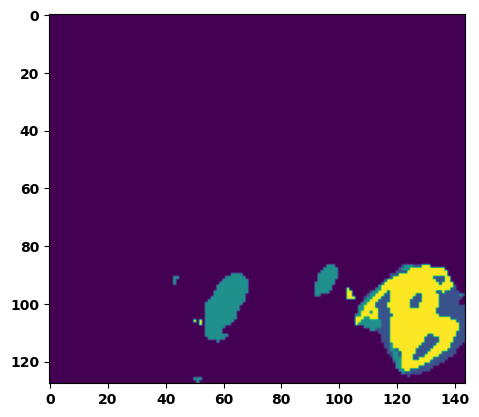

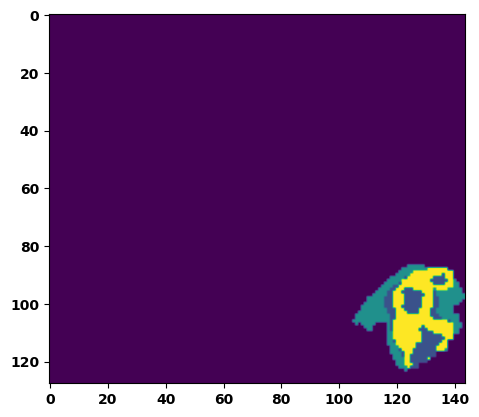

  6%|▌         | 2/36 [00:03<00:52,  1.54s/it]

Batch_id:  1 Eval loss:  0.2310086488723755
Batch_id:  1 Eval IoU:  tensor(0.7271, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:46,  1.42s/it]

Batch_id:  2 Eval loss:  0.3020040988922119
Batch_id:  2 Eval IoU:  tensor(0.6333, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9455, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9839, device='cuda:0')


 11%|█         | 4/36 [00:05<00:45,  1.41s/it]

Batch_id:  3 Eval loss:  0.29841068387031555
Batch_id:  3 Eval IoU:  tensor(0.6541, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9888, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:44,  1.42s/it]

Batch_id:  4 Eval loss:  0.30356690287590027
Batch_id:  4 Eval IoU:  tensor(0.6016, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9327, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9254, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9821, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:44,  1.47s/it]

Batch_id:  5 Eval loss:  0.21784283220767975
Batch_id:  5 Eval IoU:  tensor(0.7498, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.45s/it]

Batch_id:  6 Eval loss:  0.3470650911331177
Batch_id:  6 Eval IoU:  tensor(0.5922, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9886, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:39,  1.41s/it]

Batch_id:  7 Eval loss:  0.24020464718341827
Batch_id:  7 Eval IoU:  tensor(0.7299, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 25%|██▌       | 9/36 [00:12<00:38,  1.41s/it]

Batch_id:  8 Eval loss:  0.5184616446495056
Batch_id:  8 Eval IoU:  tensor(0.4324, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9768, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.47s/it]

Batch_id:  9 Eval loss:  0.5890325307846069
Batch_id:  9 Eval IoU:  tensor(0.3458, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9237, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.8921, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9262, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  10 Eval loss:  0.23986847698688507
Batch_id:  10 Eval IoU:  tensor(0.6980, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9881, device='cuda:0')


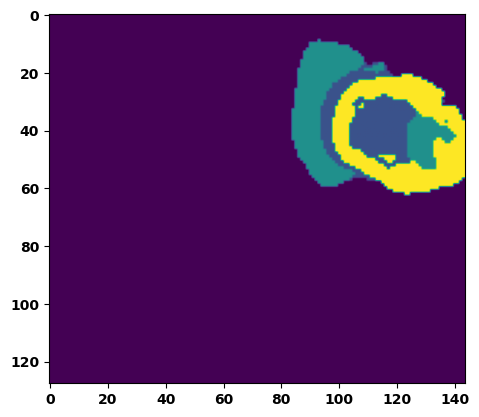

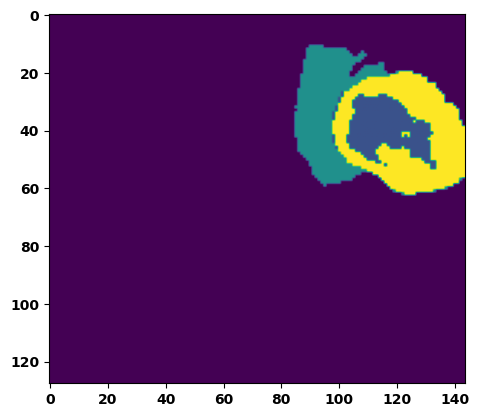

 33%|███▎      | 12/36 [00:17<00:34,  1.46s/it]

Batch_id:  11 Eval loss:  0.2707381248474121
Batch_id:  11 Eval IoU:  tensor(0.6597, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:32,  1.42s/it]

Batch_id:  12 Eval loss:  0.36675065755844116
Batch_id:  12 Eval IoU:  tensor(0.6101, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.43s/it]

Batch_id:  13 Eval loss:  0.22272300720214844
Batch_id:  13 Eval IoU:  tensor(0.7226, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9881, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:29,  1.40s/it]

Batch_id:  14 Eval loss:  0.25567424297332764
Batch_id:  14 Eval IoU:  tensor(0.7088, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9321, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.45s/it]

Batch_id:  15 Eval loss:  0.23243319988250732
Batch_id:  15 Eval IoU:  tensor(0.7304, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:27,  1.44s/it]

Batch_id:  16 Eval loss:  0.3208502233028412
Batch_id:  16 Eval IoU:  tensor(0.6213, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9307, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9910, device='cuda:0')


 50%|█████     | 18/36 [00:25<00:25,  1.40s/it]

Batch_id:  17 Eval loss:  0.3398086726665497
Batch_id:  17 Eval IoU:  tensor(0.6044, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9805, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:25,  1.48s/it]

Batch_id:  18 Eval loss:  0.30718666315078735
Batch_id:  18 Eval IoU:  tensor(0.6761, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 56%|█████▌    | 20/36 [00:28<00:22,  1.40s/it]

Batch_id:  19 Eval loss:  0.3863089680671692
Batch_id:  19 Eval IoU:  tensor(0.5485, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9297, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  20 Eval loss:  0.4260503649711609
Batch_id:  20 Eval IoU:  tensor(0.5184, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9049, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.8718, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.8583, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


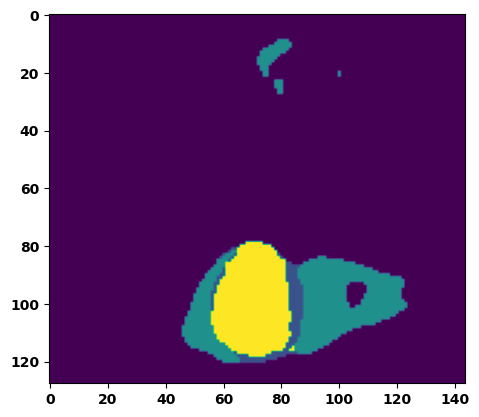

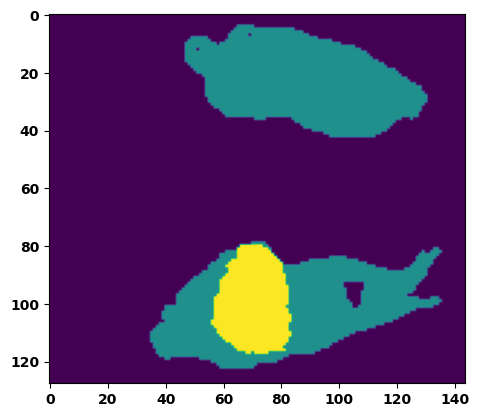

 61%|██████    | 22/36 [00:31<00:20,  1.47s/it]

Batch_id:  21 Eval loss:  0.3705406188964844
Batch_id:  21 Eval IoU:  tensor(0.5751, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9428, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9880, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.51s/it]

Batch_id:  22 Eval loss:  0.2946416735649109
Batch_id:  22 Eval IoU:  tensor(0.6196, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9513, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:17,  1.44s/it]

Batch_id:  23 Eval loss:  0.3179803490638733
Batch_id:  23 Eval IoU:  tensor(0.6292, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9932, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.45s/it]

Batch_id:  24 Eval loss:  0.3748963177204132
Batch_id:  24 Eval IoU:  tensor(0.5295, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9455, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9289, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9268, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 72%|███████▏  | 26/36 [00:37<00:14,  1.44s/it]

Batch_id:  25 Eval loss:  0.5186874270439148
Batch_id:  25 Eval IoU:  tensor(0.4073, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9477, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9335, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9781, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:13,  1.46s/it]

Batch_id:  26 Eval loss:  0.24348892271518707
Batch_id:  26 Eval IoU:  tensor(0.6807, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9764, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.47s/it]

Batch_id:  27 Eval loss:  0.6443302035331726
Batch_id:  27 Eval IoU:  tensor(0.3070, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9213, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9047, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9330, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.50s/it]

Batch_id:  28 Eval loss:  0.37853676080703735
Batch_id:  28 Eval IoU:  tensor(0.5809, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9871, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.46s/it]

Batch_id:  29 Eval loss:  0.1882478892803192
Batch_id:  29 Eval IoU:  tensor(0.7786, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  30 Eval loss:  0.7229897975921631
Batch_id:  30 Eval IoU:  tensor(0.2359, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.8908, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.8509, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.8950, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9817, device='cuda:0')


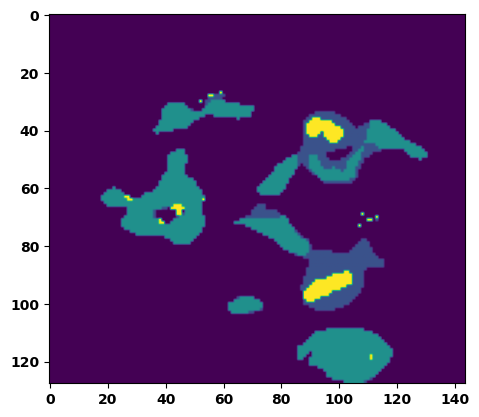

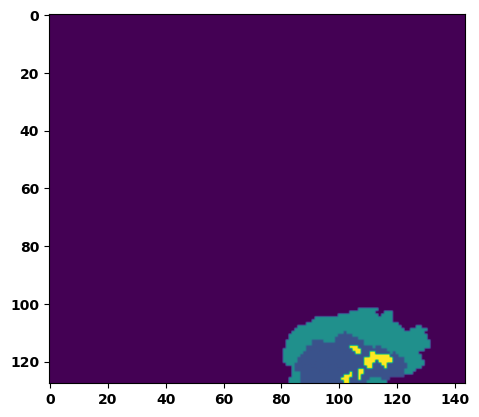

 89%|████████▉ | 32/36 [00:46<00:05,  1.47s/it]

Batch_id:  31 Eval loss:  0.5732895731925964
Batch_id:  31 Eval IoU:  tensor(0.3487, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9085, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9266, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.8968, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9194, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9828, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.54s/it]

Batch_id:  32 Eval loss:  0.3449491560459137
Batch_id:  32 Eval IoU:  tensor(0.5935, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9860, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.49s/it]

Batch_id:  33 Eval loss:  0.2967413365840912
Batch_id:  33 Eval IoU:  tensor(0.6332, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9482, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.47s/it]

Batch_id:  34 Eval loss:  0.3121684193611145
Batch_id:  34 Eval IoU:  tensor(0.6688, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.46s/it]

Batch_id:  35 Eval loss:  0.354877769947052
Batch_id:  35 Eval IoU:  tensor(0.5615, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9620, device='cuda:0')
Epoch  5 Training loss:  0.3963563645427877
Epoch  5 Evaluation loss:  0.3576713336838616
Epoch  5 Training accuracy :  tensor(0.5526)
Epoch  5 Evaluation accuracy :  tensor(0.5875)
Epoch  5 Training Mean Dice Score:  tensor(0.9525)
Epoch  5 Eval Mean Dice Score:  tensor(0.9560)
Epoch  5 Training Non-tumor Dice Score:  tensor(0.9612)
Epoch  5 Eval Non-tumor Dice Score:  tensor(0.9595)
Epoch  5 Training NCR/NET Dice Score:  tensor(0.9648)
Epoch  5 Eval NCR/NET Dice Score:  tensor(0.9705)
Epoch  5 Training ED Dice Score:  tensor(0.9477)
Epoch  5 

Epoch: 6
Training in session: 


  1%|          | 1/110 [00:01<02:35,  1.43s/it]

Batch_id:  0 Training loss:  0.2562108039855957
Batch_id:  0 Training IoU:  tensor(0.7005, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9783, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:42,  1.50s/it]

Batch_id:  1 Training loss:  0.5415272116661072
Batch_id:  1 Training IoU:  tensor(0.3943, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9387, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:41,  1.51s/it]

Batch_id:  2 Training loss:  0.6383374929428101
Batch_id:  2 Training IoU:  tensor(0.3050, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9114, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.8811, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9241, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9719, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:44,  1.55s/it]

Batch_id:  3 Training loss:  0.23813267052173615
Batch_id:  3 Training IoU:  tensor(0.7332, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:43,  1.56s/it]

Batch_id:  4 Training loss:  0.5017879605293274
Batch_id:  4 Training IoU:  tensor(0.4301, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9498, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9804, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:34,  1.49s/it]

Batch_id:  5 Training loss:  0.32197725772857666
Batch_id:  5 Training IoU:  tensor(0.5800, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9589, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:29,  1.46s/it]

Batch_id:  6 Training loss:  0.293840229511261
Batch_id:  6 Training IoU:  tensor(0.6445, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:28,  1.46s/it]

Batch_id:  7 Training loss:  0.31989073753356934
Batch_id:  7 Training IoU:  tensor(0.5945, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9810, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:25,  1.44s/it]

Batch_id:  8 Training loss:  0.2641693949699402
Batch_id:  8 Training IoU:  tensor(0.6999, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:20,  1.40s/it]

Batch_id:  9 Training loss:  0.3536297082901001
Batch_id:  9 Training IoU:  tensor(0.5840, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9768, device='cuda:0')


 10%|█         | 11/110 [00:16<02:20,  1.42s/it]

Batch_id:  10 Training loss:  0.3424185514450073
Batch_id:  10 Training IoU:  tensor(0.5693, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9273, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9285, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9241, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9655, device='cuda:0')


 11%|█         | 12/110 [00:17<02:19,  1.43s/it]

Batch_id:  11 Training loss:  0.3086618185043335
Batch_id:  11 Training IoU:  tensor(0.6357, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:18,  1.43s/it]

Batch_id:  12 Training loss:  0.24777181446552277
Batch_id:  12 Training IoU:  tensor(0.6962, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9732, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:18,  1.44s/it]

Batch_id:  13 Training loss:  0.3975711762905121
Batch_id:  13 Training IoU:  tensor(0.5504, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:16,  1.44s/it]

Batch_id:  14 Training loss:  0.3556300699710846
Batch_id:  14 Training IoU:  tensor(0.5875, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:18,  1.47s/it]

Batch_id:  15 Training loss:  0.36160561442375183
Batch_id:  15 Training IoU:  tensor(0.6045, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:16,  1.47s/it]

Batch_id:  16 Training loss:  0.38426703214645386
Batch_id:  16 Training IoU:  tensor(0.5652, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:17,  1.49s/it]

Batch_id:  17 Training loss:  0.1431170403957367
Batch_id:  17 Training IoU:  tensor(0.8612, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:16,  1.50s/it]

Batch_id:  18 Training loss:  0.23748667538166046
Batch_id:  18 Training IoU:  tensor(0.7281, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:16,  1.52s/it]

Batch_id:  19 Training loss:  0.43334683775901794
Batch_id:  19 Training IoU:  tensor(0.4966, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9338, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9395, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:12,  1.49s/it]

Batch_id:  20 Training loss:  0.27293455600738525
Batch_id:  20 Training IoU:  tensor(0.6453, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9844, device='cuda:0')


 20%|██        | 22/110 [00:32<02:06,  1.44s/it]

Batch_id:  21 Training loss:  0.6280340552330017
Batch_id:  21 Training IoU:  tensor(0.3583, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 21%|██        | 23/110 [00:33<02:04,  1.43s/it]

Batch_id:  22 Training loss:  0.2640452980995178
Batch_id:  22 Training IoU:  tensor(0.6835, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9842, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:02,  1.43s/it]

Batch_id:  23 Training loss:  0.2955057919025421
Batch_id:  23 Training IoU:  tensor(0.6504, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:01,  1.43s/it]

Batch_id:  24 Training loss:  0.3754529058933258
Batch_id:  24 Training IoU:  tensor(0.5951, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:00,  1.44s/it]

Batch_id:  25 Training loss:  0.21936720609664917
Batch_id:  25 Training IoU:  tensor(0.7044, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9479, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9272, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:02,  1.48s/it]

Batch_id:  26 Training loss:  0.2275606095790863
Batch_id:  26 Training IoU:  tensor(0.7013, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 25%|██▌       | 28/110 [00:41<02:03,  1.51s/it]

Batch_id:  27 Training loss:  0.24155938625335693
Batch_id:  27 Training IoU:  tensor(0.7191, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 26%|██▋       | 29/110 [00:42<02:01,  1.50s/it]

Batch_id:  28 Training loss:  0.31651386618614197
Batch_id:  28 Training IoU:  tensor(0.5709, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9367, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9267, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 27%|██▋       | 30/110 [00:44<02:02,  1.54s/it]

Batch_id:  29 Training loss:  0.31736165285110474
Batch_id:  29 Training IoU:  tensor(0.6167, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9462, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9815, device='cuda:0')


 28%|██▊       | 31/110 [00:45<02:00,  1.53s/it]

Batch_id:  30 Training loss:  0.23289577662944794
Batch_id:  30 Training IoU:  tensor(0.6962, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9553, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 29%|██▉       | 32/110 [00:47<02:00,  1.54s/it]

Batch_id:  31 Training loss:  0.2471151500940323
Batch_id:  31 Training IoU:  tensor(0.7029, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9835, device='cuda:0')


 30%|███       | 33/110 [00:48<01:58,  1.54s/it]

Batch_id:  32 Training loss:  0.2824183702468872
Batch_id:  32 Training IoU:  tensor(0.6525, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 31%|███       | 34/110 [00:50<01:57,  1.54s/it]

Batch_id:  33 Training loss:  0.32439592480659485
Batch_id:  33 Training IoU:  tensor(0.6236, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9473, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:54,  1.52s/it]

Batch_id:  34 Training loss:  0.2598305940628052
Batch_id:  34 Training IoU:  tensor(0.6957, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:55,  1.56s/it]

Batch_id:  35 Training loss:  0.3869311511516571
Batch_id:  35 Training IoU:  tensor(0.5393, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 34%|███▎      | 37/110 [00:55<01:55,  1.58s/it]

Batch_id:  36 Training loss:  0.1825655996799469
Batch_id:  36 Training IoU:  tensor(0.7833, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:51,  1.55s/it]

Batch_id:  37 Training loss:  0.5111351013183594
Batch_id:  37 Training IoU:  tensor(0.3957, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9282, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9081, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9511, device='cuda:0')


 35%|███▌      | 39/110 [00:58<01:47,  1.52s/it]

Batch_id:  38 Training loss:  0.4418938457965851
Batch_id:  38 Training IoU:  tensor(0.4977, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9351, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 36%|███▋      | 40/110 [00:59<01:46,  1.52s/it]

Batch_id:  39 Training loss:  0.39455026388168335
Batch_id:  39 Training IoU:  tensor(0.5563, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 37%|███▋      | 41/110 [01:00<01:42,  1.49s/it]

Batch_id:  40 Training loss:  0.3809942603111267
Batch_id:  40 Training IoU:  tensor(0.5458, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9435, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9388, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9254, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:41,  1.49s/it]

Batch_id:  41 Training loss:  0.5331885814666748
Batch_id:  41 Training IoU:  tensor(0.3879, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9357, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9110, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9252, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 39%|███▉      | 43/110 [01:03<01:39,  1.48s/it]

Batch_id:  42 Training loss:  0.3930646479129791
Batch_id:  42 Training IoU:  tensor(0.5740, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 40%|████      | 44/110 [01:05<01:36,  1.46s/it]

Batch_id:  43 Training loss:  0.26548635959625244
Batch_id:  43 Training IoU:  tensor(0.7316, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 41%|████      | 45/110 [01:06<01:33,  1.44s/it]

Batch_id:  44 Training loss:  0.3272313177585602
Batch_id:  44 Training IoU:  tensor(0.6515, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:29,  1.39s/it]

Batch_id:  45 Training loss:  0.34940820932388306
Batch_id:  45 Training IoU:  tensor(0.5957, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:30,  1.44s/it]

Batch_id:  46 Training loss:  0.31357815861701965
Batch_id:  46 Training IoU:  tensor(0.6181, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:28,  1.43s/it]

Batch_id:  47 Training loss:  0.40390545129776
Batch_id:  47 Training IoU:  tensor(0.5030, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9436, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9699, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:25,  1.39s/it]

Batch_id:  48 Training loss:  0.38174378871917725
Batch_id:  48 Training IoU:  tensor(0.5448, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:23,  1.39s/it]

Batch_id:  49 Training loss:  0.45326346158981323
Batch_id:  49 Training IoU:  tensor(0.4623, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9512, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9833, device='cuda:0')


 46%|████▋     | 51/110 [01:15<01:24,  1.43s/it]

Batch_id:  50 Training loss:  0.6093710660934448
Batch_id:  50 Training IoU:  tensor(0.3455, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9441, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9173, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9256, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:24,  1.46s/it]

Batch_id:  51 Training loss:  0.2980109453201294
Batch_id:  51 Training IoU:  tensor(0.6000, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9686, device='cuda:0')


 48%|████▊     | 53/110 [01:18<01:24,  1.47s/it]

Batch_id:  52 Training loss:  0.28335875272750854
Batch_id:  52 Training IoU:  tensor(0.6599, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:21,  1.46s/it]

Batch_id:  53 Training loss:  0.2909573018550873
Batch_id:  53 Training IoU:  tensor(0.6256, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9617, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:21,  1.48s/it]

Batch_id:  54 Training loss:  0.18316635489463806
Batch_id:  54 Training IoU:  tensor(0.7853, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 51%|█████     | 56/110 [01:22<01:17,  1.43s/it]

Batch_id:  55 Training loss:  0.35724547505378723
Batch_id:  55 Training IoU:  tensor(0.5520, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9388, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9212, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9767, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:15,  1.43s/it]

Batch_id:  56 Training loss:  0.4069119691848755
Batch_id:  56 Training IoU:  tensor(0.5439, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 53%|█████▎    | 58/110 [01:25<01:14,  1.42s/it]

Batch_id:  57 Training loss:  0.24331903457641602
Batch_id:  57 Training IoU:  tensor(0.6809, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 54%|█████▎    | 59/110 [01:26<01:15,  1.49s/it]

Batch_id:  58 Training loss:  0.3552125096321106
Batch_id:  58 Training IoU:  tensor(0.5923, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:15,  1.51s/it]

Batch_id:  59 Training loss:  0.30132001638412476
Batch_id:  59 Training IoU:  tensor(0.6151, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 55%|█████▌    | 61/110 [01:30<01:13,  1.50s/it]

Batch_id:  60 Training loss:  0.41702014207839966
Batch_id:  60 Training IoU:  tensor(0.5076, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:12,  1.50s/it]

Batch_id:  61 Training loss:  0.2565261423587799
Batch_id:  61 Training IoU:  tensor(0.6630, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 57%|█████▋    | 63/110 [01:32<01:07,  1.45s/it]

Batch_id:  62 Training loss:  0.6237843036651611
Batch_id:  62 Training IoU:  tensor(0.3131, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9040, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.8963, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9316, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9097, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9746, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:07,  1.46s/it]

Batch_id:  63 Training loss:  0.4037330150604248
Batch_id:  63 Training IoU:  tensor(0.4986, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9445, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9443, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9410, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 59%|█████▉    | 65/110 [01:35<01:04,  1.44s/it]

Batch_id:  64 Training loss:  0.1730010062456131
Batch_id:  64 Training IoU:  tensor(0.7713, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9800, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:05,  1.49s/it]

Batch_id:  65 Training loss:  0.26950156688690186
Batch_id:  65 Training IoU:  tensor(0.6930, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 61%|██████    | 67/110 [01:38<01:03,  1.47s/it]

Batch_id:  66 Training loss:  0.2895907759666443
Batch_id:  66 Training IoU:  tensor(0.6478, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 62%|██████▏   | 68/110 [01:40<01:02,  1.49s/it]

Batch_id:  67 Training loss:  0.2484436184167862
Batch_id:  67 Training IoU:  tensor(0.6724, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9498, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9319, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 63%|██████▎   | 69/110 [01:41<00:59,  1.46s/it]

Batch_id:  68 Training loss:  0.3334527313709259
Batch_id:  68 Training IoU:  tensor(0.5630, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9300, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9709, device='cuda:0')


 64%|██████▎   | 70/110 [01:43<00:57,  1.44s/it]

Batch_id:  69 Training loss:  0.3273622393608093
Batch_id:  69 Training IoU:  tensor(0.6285, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 65%|██████▍   | 71/110 [01:44<00:56,  1.45s/it]

Batch_id:  70 Training loss:  0.2499741166830063
Batch_id:  70 Training IoU:  tensor(0.6792, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 65%|██████▌   | 72/110 [01:46<00:56,  1.49s/it]

Batch_id:  71 Training loss:  0.35297465324401855
Batch_id:  71 Training IoU:  tensor(0.5947, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:56,  1.52s/it]

Batch_id:  72 Training loss:  0.4213089346885681
Batch_id:  72 Training IoU:  tensor(0.5242, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9452, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:54,  1.51s/it]

Batch_id:  73 Training loss:  0.3224201798439026
Batch_id:  73 Training IoU:  tensor(0.6539, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 68%|██████▊   | 75/110 [01:50<00:52,  1.51s/it]

Batch_id:  74 Training loss:  0.5209735631942749
Batch_id:  74 Training IoU:  tensor(0.3960, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9003, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9273, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9073, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.8773, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:52,  1.55s/it]

Batch_id:  75 Training loss:  0.3906189799308777
Batch_id:  75 Training IoU:  tensor(0.5708, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 70%|███████   | 77/110 [01:53<00:50,  1.53s/it]

Batch_id:  76 Training loss:  0.2652786076068878
Batch_id:  76 Training IoU:  tensor(0.6922, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:47,  1.49s/it]

Batch_id:  77 Training loss:  0.30732157826423645
Batch_id:  77 Training IoU:  tensor(0.5997, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9722, device='cuda:0')


 72%|███████▏  | 79/110 [01:56<00:44,  1.44s/it]

Batch_id:  78 Training loss:  0.5958085656166077
Batch_id:  78 Training IoU:  tensor(0.3545, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9408, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9222, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9231, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:43,  1.43s/it]

Batch_id:  79 Training loss:  0.5054595470428467
Batch_id:  79 Training IoU:  tensor(0.3883, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.8866, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9222, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9257, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.8823, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9295, device='cuda:0')


 74%|███████▎  | 81/110 [01:59<00:40,  1.39s/it]

Batch_id:  80 Training loss:  0.39152371883392334
Batch_id:  80 Training IoU:  tensor(0.5636, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:39,  1.40s/it]

Batch_id:  81 Training loss:  0.3756848871707916
Batch_id:  81 Training IoU:  tensor(0.5490, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9400, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9160, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 75%|███████▌  | 83/110 [02:02<00:37,  1.39s/it]

Batch_id:  82 Training loss:  0.34302008152008057
Batch_id:  82 Training IoU:  tensor(0.5824, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9547, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9528, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9688, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:35,  1.38s/it]

Batch_id:  83 Training loss:  0.26312029361724854
Batch_id:  83 Training IoU:  tensor(0.6504, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:34,  1.38s/it]

Batch_id:  84 Training loss:  0.36963197588920593
Batch_id:  84 Training IoU:  tensor(0.5133, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.8982, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.8943, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.8784, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:33,  1.41s/it]

Batch_id:  85 Training loss:  0.4570118188858032
Batch_id:  85 Training IoU:  tensor(0.4887, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:32,  1.41s/it]

Batch_id:  86 Training loss:  0.36396870017051697
Batch_id:  86 Training IoU:  tensor(0.5790, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 80%|████████  | 88/110 [02:09<00:31,  1.44s/it]

Batch_id:  87 Training loss:  0.3981984257698059
Batch_id:  87 Training IoU:  tensor(0.5515, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:30,  1.44s/it]

Batch_id:  88 Training loss:  0.2616730332374573
Batch_id:  88 Training IoU:  tensor(0.6990, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 82%|████████▏ | 90/110 [02:12<00:29,  1.47s/it]

Batch_id:  89 Training loss:  0.27553820610046387
Batch_id:  89 Training IoU:  tensor(0.7410, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:28,  1.48s/it]

Batch_id:  90 Training loss:  0.3819226920604706
Batch_id:  90 Training IoU:  tensor(0.5879, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 84%|████████▎ | 92/110 [02:15<00:25,  1.44s/it]

Batch_id:  91 Training loss:  0.33506494760513306
Batch_id:  91 Training IoU:  tensor(0.6284, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:24,  1.42s/it]

Batch_id:  92 Training loss:  0.5103442668914795
Batch_id:  92 Training IoU:  tensor(0.3804, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.8909, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.8783, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9162, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9221, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9561, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:22,  1.42s/it]

Batch_id:  93 Training loss:  0.2553200125694275
Batch_id:  93 Training IoU:  tensor(0.6923, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:21,  1.41s/it]

Batch_id:  94 Training loss:  0.3219391703605652
Batch_id:  94 Training IoU:  tensor(0.6204, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:19,  1.38s/it]

Batch_id:  95 Training loss:  0.29923778772354126
Batch_id:  95 Training IoU:  tensor(0.6279, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:17,  1.38s/it]

Batch_id:  96 Training loss:  0.4990655183792114
Batch_id:  96 Training IoU:  tensor(0.4435, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:17,  1.49s/it]

Batch_id:  97 Training loss:  0.3159320652484894
Batch_id:  97 Training IoU:  tensor(0.5708, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9302, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9494, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9148, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9811, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:15,  1.45s/it]

Batch_id:  98 Training loss:  0.3577457368373871
Batch_id:  98 Training IoU:  tensor(0.5568, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9356, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:14,  1.45s/it]

Batch_id:  99 Training loss:  0.356565922498703
Batch_id:  99 Training IoU:  tensor(0.5673, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 92%|█████████▏| 101/110 [02:27<00:12,  1.41s/it]

Batch_id:  100 Training loss:  0.2481728345155716
Batch_id:  100 Training IoU:  tensor(0.7203, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:11,  1.42s/it]

Batch_id:  101 Training loss:  0.3989798128604889
Batch_id:  101 Training IoU:  tensor(0.5058, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9700, device='cuda:0')


 94%|█████████▎| 103/110 [02:30<00:09,  1.40s/it]

Batch_id:  102 Training loss:  0.49353381991386414
Batch_id:  102 Training IoU:  tensor(0.4367, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:08,  1.50s/it]

Batch_id:  103 Training loss:  0.2976219654083252
Batch_id:  103 Training IoU:  tensor(0.6609, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 95%|█████████▌| 105/110 [02:33<00:07,  1.46s/it]

Batch_id:  104 Training loss:  0.5854415893554688
Batch_id:  104 Training IoU:  tensor(0.3326, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.8951, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.8746, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.8536, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:05,  1.42s/it]

Batch_id:  105 Training loss:  0.5041521191596985
Batch_id:  105 Training IoU:  tensor(0.3977, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9300, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9176, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9543, device='cuda:0')


 97%|█████████▋| 107/110 [02:36<00:04,  1.36s/it]

Batch_id:  106 Training loss:  0.3658771514892578
Batch_id:  106 Training IoU:  tensor(0.5409, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9275, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9180, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9083, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9745, device='cuda:0')


 98%|█████████▊| 108/110 [02:37<00:02,  1.34s/it]

Batch_id:  107 Training loss:  0.3582514822483063
Batch_id:  107 Training IoU:  tensor(0.5413, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9194, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9388, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.8951, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9586, device='cuda:0')


 99%|█████████▉| 109/110 [02:39<00:01,  1.40s/it]

Batch_id:  108 Training loss:  0.3650438189506531
Batch_id:  108 Training IoU:  tensor(0.5309, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9417, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9831, device='cuda:0')


100%|██████████| 110/110 [02:40<00:00,  1.46s/it]


Batch_id:  109 Training loss:  0.5013015866279602
Batch_id:  109 Training IoU:  tensor(0.4056, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.8961, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9018, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.8894, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9550, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.20867106318473816
Batch_id:  0 Eval IoU:  tensor(0.7510, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


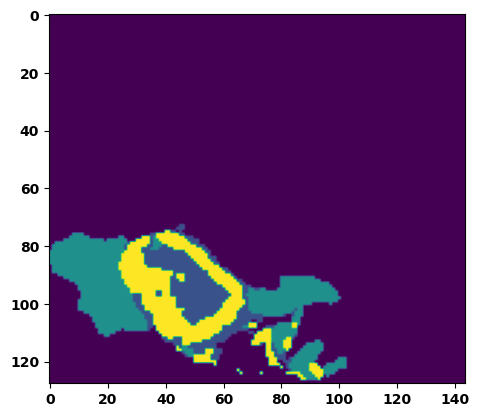

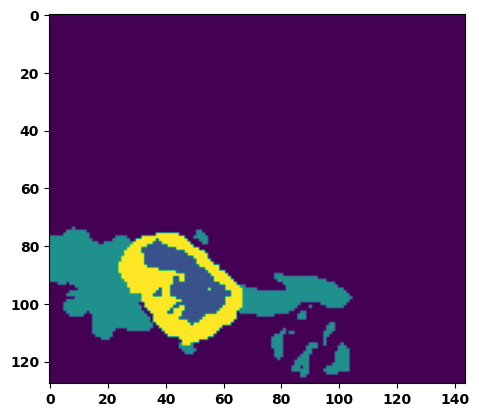

  6%|▌         | 2/36 [00:03<00:51,  1.50s/it]

Batch_id:  1 Eval loss:  0.3018016517162323
Batch_id:  1 Eval IoU:  tensor(0.6483, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9949, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:46,  1.41s/it]

Batch_id:  2 Eval loss:  0.19247828423976898
Batch_id:  2 Eval IoU:  tensor(0.7777, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


 11%|█         | 4/36 [00:05<00:44,  1.39s/it]

Batch_id:  3 Eval loss:  0.4127171039581299
Batch_id:  3 Eval IoU:  tensor(0.5277, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:43,  1.42s/it]

Batch_id:  4 Eval loss:  0.33189231157302856
Batch_id:  4 Eval IoU:  tensor(0.5733, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9358, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9392, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9105, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:41,  1.37s/it]

Batch_id:  5 Eval loss:  0.2585710287094116
Batch_id:  5 Eval IoU:  tensor(0.6650, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')


 19%|█▉        | 7/36 [00:09<00:39,  1.37s/it]

Batch_id:  6 Eval loss:  0.20512469112873077
Batch_id:  6 Eval IoU:  tensor(0.7287, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9872, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:42,  1.51s/it]

Batch_id:  7 Eval loss:  0.2659134864807129
Batch_id:  7 Eval IoU:  tensor(0.6365, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:40,  1.49s/it]

Batch_id:  8 Eval loss:  0.5333347916603088
Batch_id:  8 Eval IoU:  tensor(0.3936, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9315, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9017, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9378, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:39,  1.50s/it]

Batch_id:  9 Eval loss:  0.4200296998023987
Batch_id:  9 Eval IoU:  tensor(0.5243, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9019, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.8640, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.8552, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  10 Eval loss:  0.37769460678100586
Batch_id:  10 Eval IoU:  tensor(0.5101, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9436, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9273, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9245, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


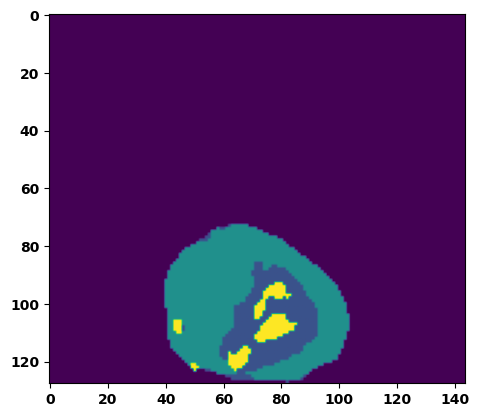

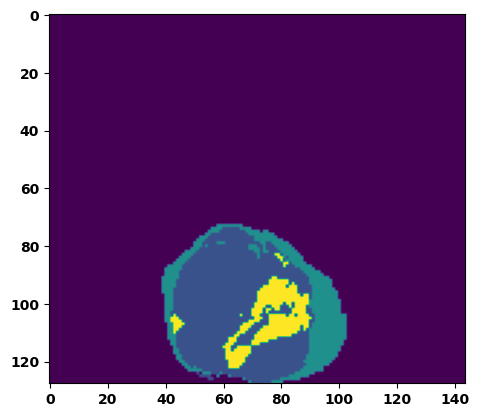

 33%|███▎      | 12/36 [00:17<00:36,  1.53s/it]

Batch_id:  11 Eval loss:  0.1929130107164383
Batch_id:  11 Eval IoU:  tensor(0.7345, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9843, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:33,  1.45s/it]

Batch_id:  12 Eval loss:  0.39723169803619385
Batch_id:  12 Eval IoU:  tensor(0.4947, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9388, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9348, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9419, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.45s/it]

Batch_id:  13 Eval loss:  0.19150805473327637
Batch_id:  13 Eval IoU:  tensor(0.7481, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:29,  1.42s/it]

Batch_id:  14 Eval loss:  0.2713400423526764
Batch_id:  14 Eval IoU:  tensor(0.6311, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9371, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9285, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9863, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.40s/it]

Batch_id:  15 Eval loss:  0.3258107304573059
Batch_id:  15 Eval IoU:  tensor(0.5860, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9876, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:27,  1.43s/it]

Batch_id:  16 Eval loss:  0.5671892166137695
Batch_id:  16 Eval IoU:  tensor(0.3639, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9205, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.8957, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9522, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9380, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.47s/it]

Batch_id:  17 Eval loss:  0.2885267734527588
Batch_id:  17 Eval IoU:  tensor(0.6490, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.44s/it]

Batch_id:  18 Eval loss:  0.3161086142063141
Batch_id:  18 Eval IoU:  tensor(0.6366, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.46s/it]

Batch_id:  19 Eval loss:  0.387829065322876
Batch_id:  19 Eval IoU:  tensor(0.5263, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  20 Eval loss:  0.41913503408432007
Batch_id:  20 Eval IoU:  tensor(0.5150, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


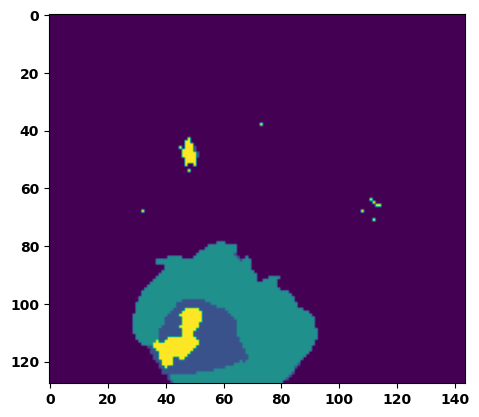

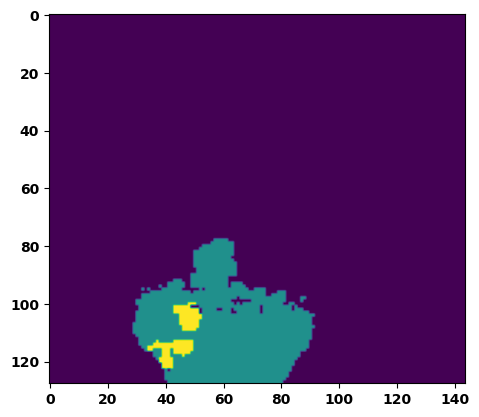

 61%|██████    | 22/36 [00:32<00:20,  1.44s/it]

Batch_id:  21 Eval loss:  0.2972116470336914
Batch_id:  21 Eval IoU:  tensor(0.6507, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:18,  1.43s/it]

Batch_id:  22 Eval loss:  0.2961353063583374
Batch_id:  22 Eval IoU:  tensor(0.6313, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:17,  1.43s/it]

Batch_id:  23 Eval loss:  0.2074068933725357
Batch_id:  23 Eval IoU:  tensor(0.7654, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')


 69%|██████▉   | 25/36 [00:35<00:14,  1.34s/it]

Batch_id:  24 Eval loss:  0.3450630307197571
Batch_id:  24 Eval IoU:  tensor(0.5722, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9475, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9305, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


 72%|███████▏  | 26/36 [00:37<00:13,  1.39s/it]

Batch_id:  25 Eval loss:  0.7551928758621216
Batch_id:  25 Eval IoU:  tensor(0.2163, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.8938, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.8505, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.8964, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9838, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:13,  1.50s/it]

Batch_id:  26 Eval loss:  0.2857450544834137
Batch_id:  26 Eval IoU:  tensor(0.6516, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.47s/it]

Batch_id:  27 Eval loss:  0.3513389229774475
Batch_id:  27 Eval IoU:  tensor(0.5788, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.48s/it]

Batch_id:  28 Eval loss:  0.24395979940891266
Batch_id:  28 Eval IoU:  tensor(0.6955, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:09,  1.60s/it]

Batch_id:  29 Eval loss:  0.40641820430755615
Batch_id:  29 Eval IoU:  tensor(0.5145, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  30 Eval loss:  0.5003355741500854
Batch_id:  30 Eval IoU:  tensor(0.4015, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9271, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9194, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9263, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9887, device='cuda:0')


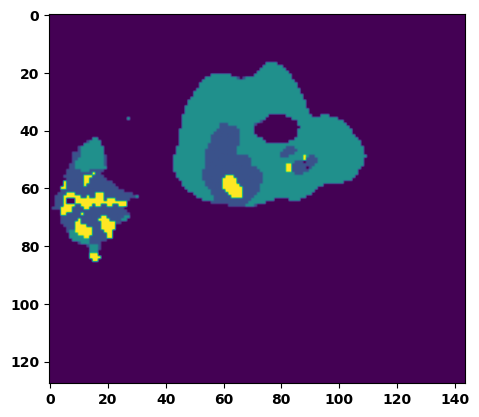

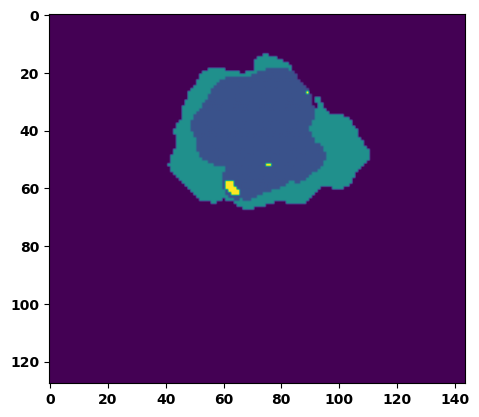

 89%|████████▉ | 32/36 [00:46<00:06,  1.52s/it]

Batch_id:  31 Eval loss:  0.3088186979293823
Batch_id:  31 Eval IoU:  tensor(0.6287, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9508, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9356, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.47s/it]

Batch_id:  32 Eval loss:  0.3054547905921936
Batch_id:  32 Eval IoU:  tensor(0.6643, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9912, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.44s/it]

Batch_id:  33 Eval loss:  0.19196879863739014
Batch_id:  33 Eval IoU:  tensor(0.7701, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9715, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.44s/it]

Batch_id:  34 Eval loss:  0.25922730565071106
Batch_id:  34 Eval IoU:  tensor(0.6548, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9813, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.46s/it]

Batch_id:  35 Eval loss:  0.28985074162483215
Batch_id:  35 Eval IoU:  tensor(0.6283, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9784, device='cuda:0')
Epoch 00007: reducing learning rate of group 0 to 5.0000e-04.
Epoch  6 Training loss:  0.3547238597815687
Epoch  6 Evaluation loss:  0.33083190561996567
Epoch  6 Training accuracy :  tensor(0.5822)
Epoch  6 Evaluation accuracy :  tensor(0.6013)
Epoch  6 Training Mean Dice Score:  tensor(0.9575)
Epoch  6 Eval Mean Dice Score:  tensor(0.9576)
Epoch  6 Training Non-tumor Dice Score:  tensor(0.9656)
Epoch  6 Eval Non-tumor Dice Score:  tensor(0.9615)
Epoch  6 Training NCR/NET Dice Score:  tensor(0.9705)
Epoch  6 Eval NCR/NET Dice Score:  tensor(0

Epoch: 7
Training in session: 


  1%|          | 1/110 [00:01<02:26,  1.34s/it]

Batch_id:  0 Training loss:  0.3136439323425293
Batch_id:  0 Training IoU:  tensor(0.6066, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9759, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:28,  1.38s/it]

Batch_id:  1 Training loss:  0.29838645458221436
Batch_id:  1 Training IoU:  tensor(0.6006, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9811, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:30,  1.41s/it]

Batch_id:  2 Training loss:  0.3297807574272156
Batch_id:  2 Training IoU:  tensor(0.5710, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:27,  1.39s/it]

Batch_id:  3 Training loss:  0.20566028356552124
Batch_id:  3 Training IoU:  tensor(0.7311, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:29,  1.42s/it]

Batch_id:  4 Training loss:  0.20974424481391907
Batch_id:  4 Training IoU:  tensor(0.7283, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9847, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:31,  1.45s/it]

Batch_id:  5 Training loss:  0.19625285267829895
Batch_id:  5 Training IoU:  tensor(0.7381, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:35,  1.51s/it]

Batch_id:  6 Training loss:  0.48571497201919556
Batch_id:  6 Training IoU:  tensor(0.4186, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9135, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9273, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9156, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9388, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:29,  1.46s/it]

Batch_id:  7 Training loss:  0.35715073347091675
Batch_id:  7 Training IoU:  tensor(0.5524, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9447, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9383, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9315, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9797, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:29,  1.48s/it]

Batch_id:  8 Training loss:  0.3565807640552521
Batch_id:  8 Training IoU:  tensor(0.5883, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:27,  1.48s/it]

Batch_id:  9 Training loss:  0.3257860541343689
Batch_id:  9 Training IoU:  tensor(0.5877, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 10%|█         | 11/110 [00:16<02:28,  1.50s/it]

Batch_id:  10 Training loss:  0.32902735471725464
Batch_id:  10 Training IoU:  tensor(0.5790, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9375, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9332, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9169, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 11%|█         | 12/110 [00:17<02:23,  1.46s/it]

Batch_id:  11 Training loss:  0.20607951283454895
Batch_id:  11 Training IoU:  tensor(0.7524, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:20,  1.45s/it]

Batch_id:  12 Training loss:  0.43549197912216187
Batch_id:  12 Training IoU:  tensor(0.5130, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:16,  1.43s/it]

Batch_id:  13 Training loss:  0.2393375039100647
Batch_id:  13 Training IoU:  tensor(0.6889, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9789, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:16,  1.43s/it]

Batch_id:  14 Training loss:  0.17013618350028992
Batch_id:  14 Training IoU:  tensor(0.7662, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:18,  1.47s/it]

Batch_id:  15 Training loss:  0.27586817741394043
Batch_id:  15 Training IoU:  tensor(0.6232, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9227, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:16,  1.47s/it]

Batch_id:  16 Training loss:  0.19588737189769745
Batch_id:  16 Training IoU:  tensor(0.7383, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 16%|█▋        | 18/110 [00:25<02:09,  1.41s/it]

Batch_id:  17 Training loss:  0.2962276339530945
Batch_id:  17 Training IoU:  tensor(0.6637, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:07,  1.40s/it]

Batch_id:  18 Training loss:  0.23536835610866547
Batch_id:  18 Training IoU:  tensor(0.7075, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9820, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:11,  1.46s/it]

Batch_id:  19 Training loss:  0.43924933671951294
Batch_id:  19 Training IoU:  tensor(0.5078, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:12,  1.48s/it]

Batch_id:  20 Training loss:  0.16403546929359436
Batch_id:  20 Training IoU:  tensor(0.7881, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 20%|██        | 22/110 [00:31<02:06,  1.43s/it]

Batch_id:  21 Training loss:  0.5065320134162903
Batch_id:  21 Training IoU:  tensor(0.4055, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.8962, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9322, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9081, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.8953, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9529, device='cuda:0')


 21%|██        | 23/110 [00:33<02:08,  1.48s/it]

Batch_id:  22 Training loss:  0.3921935260295868
Batch_id:  22 Training IoU:  tensor(0.5104, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9721, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:08,  1.49s/it]

Batch_id:  23 Training loss:  0.30510789155960083
Batch_id:  23 Training IoU:  tensor(0.6004, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9797, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:08,  1.51s/it]

Batch_id:  24 Training loss:  0.1536676287651062
Batch_id:  24 Training IoU:  tensor(0.8078, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:05,  1.49s/it]

Batch_id:  25 Training loss:  0.18216338753700256
Batch_id:  25 Training IoU:  tensor(0.7769, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:01,  1.46s/it]

Batch_id:  26 Training loss:  0.3850895166397095
Batch_id:  26 Training IoU:  tensor(0.4976, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9130, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9329, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9095, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9564, device='cuda:0')


 25%|██▌       | 28/110 [00:40<01:59,  1.46s/it]

Batch_id:  27 Training loss:  0.2422977089881897
Batch_id:  27 Training IoU:  tensor(0.7028, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9803, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:57,  1.45s/it]

Batch_id:  28 Training loss:  0.30055344104766846
Batch_id:  28 Training IoU:  tensor(0.6283, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:56,  1.45s/it]

Batch_id:  29 Training loss:  0.46940934658050537
Batch_id:  29 Training IoU:  tensor(0.4584, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9314, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:53,  1.44s/it]

Batch_id:  30 Training loss:  0.20146650075912476
Batch_id:  30 Training IoU:  tensor(0.7504, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:53,  1.45s/it]

Batch_id:  31 Training loss:  0.3309868574142456
Batch_id:  31 Training IoU:  tensor(0.6170, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 30%|███       | 33/110 [00:47<01:50,  1.43s/it]

Batch_id:  32 Training loss:  0.29354962706565857
Batch_id:  32 Training IoU:  tensor(0.6476, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 31%|███       | 34/110 [00:49<01:52,  1.48s/it]

Batch_id:  33 Training loss:  0.2457360476255417
Batch_id:  33 Training IoU:  tensor(0.6665, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9445, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:49,  1.46s/it]

Batch_id:  34 Training loss:  0.3186803460121155
Batch_id:  34 Training IoU:  tensor(0.5885, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:49,  1.49s/it]

Batch_id:  35 Training loss:  0.7039216756820679
Batch_id:  35 Training IoU:  tensor(0.2605, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9345, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9220, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9267, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9773, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:49,  1.50s/it]

Batch_id:  36 Training loss:  0.2828344404697418
Batch_id:  36 Training IoU:  tensor(0.6638, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9811, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:44,  1.45s/it]

Batch_id:  37 Training loss:  0.23298296332359314
Batch_id:  37 Training IoU:  tensor(0.7071, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:43,  1.45s/it]

Batch_id:  38 Training loss:  0.3661736845970154
Batch_id:  38 Training IoU:  tensor(0.5792, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:41,  1.45s/it]

Batch_id:  39 Training loss:  0.2650716304779053
Batch_id:  39 Training IoU:  tensor(0.7027, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:36,  1.40s/it]

Batch_id:  40 Training loss:  0.2632162570953369
Batch_id:  40 Training IoU:  tensor(0.6593, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:39,  1.47s/it]

Batch_id:  41 Training loss:  0.2634075880050659
Batch_id:  41 Training IoU:  tensor(0.6318, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9251, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9833, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:39,  1.49s/it]

Batch_id:  42 Training loss:  0.26730895042419434
Batch_id:  42 Training IoU:  tensor(0.6354, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9375, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 40%|████      | 44/110 [01:04<01:36,  1.46s/it]

Batch_id:  43 Training loss:  0.4329575002193451
Batch_id:  43 Training IoU:  tensor(0.5073, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 41%|████      | 45/110 [01:05<01:34,  1.46s/it]

Batch_id:  44 Training loss:  0.38622862100601196
Batch_id:  44 Training IoU:  tensor(0.5274, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9842, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:38,  1.53s/it]

Batch_id:  45 Training loss:  0.25070124864578247
Batch_id:  45 Training IoU:  tensor(0.6736, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:36,  1.53s/it]

Batch_id:  46 Training loss:  0.23371130228042603
Batch_id:  46 Training IoU:  tensor(0.6844, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9465, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9798, device='cuda:0')


 44%|████▎     | 48/110 [01:10<01:36,  1.55s/it]

Batch_id:  47 Training loss:  0.1837095469236374
Batch_id:  47 Training IoU:  tensor(0.7567, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:35,  1.56s/it]

Batch_id:  48 Training loss:  0.1804054081439972
Batch_id:  48 Training IoU:  tensor(0.7599, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:31,  1.52s/it]

Batch_id:  49 Training loss:  0.20048829913139343
Batch_id:  49 Training IoU:  tensor(0.7196, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:27,  1.48s/it]

Batch_id:  50 Training loss:  0.18187834322452545
Batch_id:  50 Training IoU:  tensor(0.7523, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:24,  1.46s/it]

Batch_id:  51 Training loss:  0.5640630125999451
Batch_id:  51 Training IoU:  tensor(0.3877, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9319, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:22,  1.45s/it]

Batch_id:  52 Training loss:  0.1758750081062317
Batch_id:  52 Training IoU:  tensor(0.7799, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:21,  1.46s/it]

Batch_id:  53 Training loss:  0.49230003356933594
Batch_id:  53 Training IoU:  tensor(0.4323, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9354, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9272, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9177, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9765, device='cuda:0')


 50%|█████     | 55/110 [01:20<01:19,  1.44s/it]

Batch_id:  54 Training loss:  0.30861854553222656
Batch_id:  54 Training IoU:  tensor(0.5969, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9270, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9355, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9095, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9622, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:17,  1.43s/it]

Batch_id:  55 Training loss:  0.18191473186016083
Batch_id:  55 Training IoU:  tensor(0.7623, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9811, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:16,  1.43s/it]

Batch_id:  56 Training loss:  0.20017512142658234
Batch_id:  56 Training IoU:  tensor(0.7553, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:13,  1.40s/it]

Batch_id:  57 Training loss:  0.26955491304397583
Batch_id:  57 Training IoU:  tensor(0.6189, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9701, device='cuda:0')


 54%|█████▎    | 59/110 [01:26<01:11,  1.41s/it]

Batch_id:  58 Training loss:  0.3746187090873718
Batch_id:  58 Training IoU:  tensor(0.5604, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 55%|█████▍    | 60/110 [01:27<01:12,  1.45s/it]

Batch_id:  59 Training loss:  0.3720851242542267
Batch_id:  59 Training IoU:  tensor(0.5379, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9835, device='cuda:0')


 55%|█████▌    | 61/110 [01:29<01:10,  1.43s/it]

Batch_id:  60 Training loss:  0.3795027732849121
Batch_id:  60 Training IoU:  tensor(0.6161, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9428, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9361, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9993, device='cuda:0')


 56%|█████▋    | 62/110 [01:30<01:08,  1.43s/it]

Batch_id:  61 Training loss:  0.13719922304153442
Batch_id:  61 Training IoU:  tensor(0.8158, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:07,  1.43s/it]

Batch_id:  62 Training loss:  0.2295699119567871
Batch_id:  62 Training IoU:  tensor(0.6910, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9344, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9775, device='cuda:0')


 58%|█████▊    | 64/110 [01:33<01:06,  1.45s/it]

Batch_id:  63 Training loss:  0.24574756622314453
Batch_id:  63 Training IoU:  tensor(0.6525, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9707, device='cuda:0')


 59%|█████▉    | 65/110 [01:35<01:10,  1.56s/it]

Batch_id:  64 Training loss:  0.369326651096344
Batch_id:  64 Training IoU:  tensor(0.5277, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9308, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:05,  1.49s/it]

Batch_id:  65 Training loss:  0.2233607918024063
Batch_id:  65 Training IoU:  tensor(0.7247, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 61%|██████    | 67/110 [01:38<01:06,  1.55s/it]

Batch_id:  66 Training loss:  0.2918846905231476
Batch_id:  66 Training IoU:  tensor(0.5928, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9194, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9139, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.8919, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 62%|██████▏   | 68/110 [01:39<01:03,  1.52s/it]

Batch_id:  67 Training loss:  0.24371547996997833
Batch_id:  67 Training IoU:  tensor(0.6842, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 63%|██████▎   | 69/110 [01:41<01:01,  1.49s/it]

Batch_id:  68 Training loss:  0.41976767778396606
Batch_id:  68 Training IoU:  tensor(0.4656, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9221, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9282, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.8884, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 64%|██████▎   | 70/110 [01:42<00:59,  1.48s/it]

Batch_id:  69 Training loss:  0.2317783683538437
Batch_id:  69 Training IoU:  tensor(0.6717, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9714, device='cuda:0')


 65%|██████▍   | 71/110 [01:44<00:58,  1.50s/it]

Batch_id:  70 Training loss:  0.6225839257240295
Batch_id:  70 Training IoU:  tensor(0.3205, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9450, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9336, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 65%|██████▌   | 72/110 [01:45<00:59,  1.58s/it]

Batch_id:  71 Training loss:  0.2313910871744156
Batch_id:  71 Training IoU:  tensor(0.6809, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:57,  1.56s/it]

Batch_id:  72 Training loss:  0.4307170510292053
Batch_id:  72 Training IoU:  tensor(0.5028, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9345, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:54,  1.51s/it]

Batch_id:  73 Training loss:  0.3425884544849396
Batch_id:  73 Training IoU:  tensor(0.6047, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 68%|██████▊   | 75/110 [01:50<00:52,  1.51s/it]

Batch_id:  74 Training loss:  0.4145826995372772
Batch_id:  74 Training IoU:  tensor(0.5167, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9356, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9055, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 69%|██████▉   | 76/110 [01:51<00:51,  1.51s/it]

Batch_id:  75 Training loss:  0.28989943861961365
Batch_id:  75 Training IoU:  tensor(0.6372, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 70%|███████   | 77/110 [01:53<00:49,  1.49s/it]

Batch_id:  76 Training loss:  0.25386255979537964
Batch_id:  76 Training IoU:  tensor(0.6595, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9529, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9784, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:47,  1.48s/it]

Batch_id:  77 Training loss:  0.6057020425796509
Batch_id:  77 Training IoU:  tensor(0.3554, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9475, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 72%|███████▏  | 79/110 [01:56<00:47,  1.52s/it]

Batch_id:  78 Training loss:  0.16004769504070282
Batch_id:  78 Training IoU:  tensor(0.7689, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9457, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:45,  1.51s/it]

Batch_id:  79 Training loss:  0.3191398084163666
Batch_id:  79 Training IoU:  tensor(0.6077, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 74%|███████▎  | 81/110 [01:59<00:43,  1.51s/it]

Batch_id:  80 Training loss:  0.16592276096343994
Batch_id:  80 Training IoU:  tensor(0.7650, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9821, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:41,  1.48s/it]

Batch_id:  81 Training loss:  0.430253803730011
Batch_id:  81 Training IoU:  tensor(0.5187, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 75%|███████▌  | 83/110 [02:02<00:40,  1.49s/it]

Batch_id:  82 Training loss:  0.38555431365966797
Batch_id:  82 Training IoU:  tensor(0.5413, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:41,  1.58s/it]

Batch_id:  83 Training loss:  0.3118235468864441
Batch_id:  83 Training IoU:  tensor(0.6429, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 77%|███████▋  | 85/110 [02:05<00:39,  1.58s/it]

Batch_id:  84 Training loss:  0.2807466387748718
Batch_id:  84 Training IoU:  tensor(0.6409, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:36,  1.53s/it]

Batch_id:  85 Training loss:  0.3143836259841919
Batch_id:  85 Training IoU:  tensor(0.5970, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 79%|███████▉  | 87/110 [02:08<00:34,  1.51s/it]

Batch_id:  86 Training loss:  0.22049906849861145
Batch_id:  86 Training IoU:  tensor(0.7297, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 80%|████████  | 88/110 [02:09<00:32,  1.46s/it]

Batch_id:  87 Training loss:  0.38286593556404114
Batch_id:  87 Training IoU:  tensor(0.5202, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 81%|████████  | 89/110 [02:11<00:31,  1.52s/it]

Batch_id:  88 Training loss:  0.2757315933704376
Batch_id:  88 Training IoU:  tensor(0.6832, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 82%|████████▏ | 90/110 [02:12<00:30,  1.52s/it]

Batch_id:  89 Training loss:  0.28941288590431213
Batch_id:  89 Training IoU:  tensor(0.6144, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9367, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9319, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9699, device='cuda:0')


 83%|████████▎ | 91/110 [02:14<00:30,  1.58s/it]

Batch_id:  90 Training loss:  0.27118980884552
Batch_id:  90 Training IoU:  tensor(0.6717, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 84%|████████▎ | 92/110 [02:16<00:28,  1.58s/it]

Batch_id:  91 Training loss:  0.41413554549217224
Batch_id:  91 Training IoU:  tensor(0.5274, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 85%|████████▍ | 93/110 [02:17<00:26,  1.55s/it]

Batch_id:  92 Training loss:  0.26698416471481323
Batch_id:  92 Training IoU:  tensor(0.6948, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 85%|████████▌ | 94/110 [02:19<00:23,  1.50s/it]

Batch_id:  93 Training loss:  0.30300700664520264
Batch_id:  93 Training IoU:  tensor(0.6315, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9540, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9529, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9379, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9800, device='cuda:0')


 86%|████████▋ | 95/110 [02:20<00:22,  1.49s/it]

Batch_id:  94 Training loss:  0.25919270515441895
Batch_id:  94 Training IoU:  tensor(0.6844, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9576, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 87%|████████▋ | 96/110 [02:22<00:21,  1.54s/it]

Batch_id:  95 Training loss:  0.4369034767150879
Batch_id:  95 Training IoU:  tensor(0.4677, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9398, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9512, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 88%|████████▊ | 97/110 [02:23<00:19,  1.51s/it]

Batch_id:  96 Training loss:  0.29675722122192383
Batch_id:  96 Training IoU:  tensor(0.6225, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9815, device='cuda:0')


 89%|████████▉ | 98/110 [02:25<00:17,  1.49s/it]

Batch_id:  97 Training loss:  0.24947090446949005
Batch_id:  97 Training IoU:  tensor(0.6725, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9801, device='cuda:0')


 90%|█████████ | 99/110 [02:26<00:16,  1.50s/it]

Batch_id:  98 Training loss:  0.39516687393188477
Batch_id:  98 Training IoU:  tensor(0.5374, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:14,  1.47s/it]

Batch_id:  99 Training loss:  0.5835278630256653
Batch_id:  99 Training IoU:  tensor(0.3600, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 92%|█████████▏| 101/110 [02:29<00:12,  1.43s/it]

Batch_id:  100 Training loss:  0.3401739001274109
Batch_id:  100 Training IoU:  tensor(0.6196, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 93%|█████████▎| 102/110 [02:30<00:11,  1.41s/it]

Batch_id:  101 Training loss:  0.2750205099582672
Batch_id:  101 Training IoU:  tensor(0.6304, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9392, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9289, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9317, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 94%|█████████▎| 103/110 [02:32<00:10,  1.44s/it]

Batch_id:  102 Training loss:  0.3257623314857483
Batch_id:  102 Training IoU:  tensor(0.5751, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9374, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9187, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 95%|█████████▍| 104/110 [02:33<00:08,  1.40s/it]

Batch_id:  103 Training loss:  0.20452959835529327
Batch_id:  103 Training IoU:  tensor(0.7259, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:06,  1.37s/it]

Batch_id:  104 Training loss:  0.35033923387527466
Batch_id:  104 Training IoU:  tensor(0.6052, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 96%|█████████▋| 106/110 [02:36<00:05,  1.34s/it]

Batch_id:  105 Training loss:  0.3171018958091736
Batch_id:  105 Training IoU:  tensor(0.6525, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:03,  1.33s/it]

Batch_id:  106 Training loss:  0.5720338821411133
Batch_id:  106 Training IoU:  tensor(0.3836, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 98%|█████████▊| 108/110 [02:39<00:02,  1.45s/it]

Batch_id:  107 Training loss:  0.2782580852508545
Batch_id:  107 Training IoU:  tensor(0.6702, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.43s/it]

Batch_id:  108 Training loss:  0.20783750712871552
Batch_id:  108 Training IoU:  tensor(0.7379, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


100%|██████████| 110/110 [02:42<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.2718666195869446
Batch_id:  109 Training IoU:  tensor(0.6616, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9313, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9959, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.4365864396095276
Batch_id:  0 Eval IoU:  tensor(0.4652, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9361, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9345, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9475, device='cuda:0')


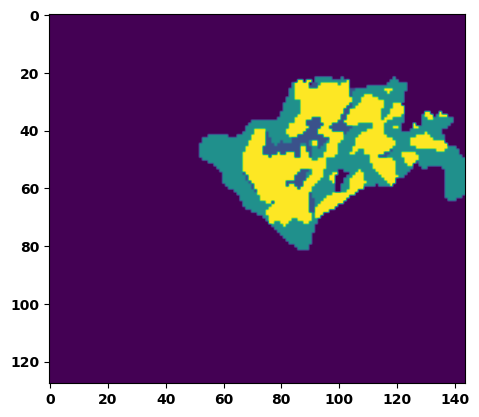

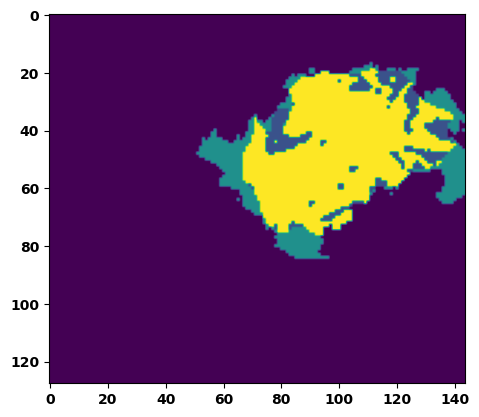

  6%|▌         | 2/36 [00:03<00:52,  1.54s/it]

Batch_id:  1 Eval loss:  0.4265488386154175
Batch_id:  1 Eval IoU:  tensor(0.5171, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9012, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.8544, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.8521, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9982, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:47,  1.44s/it]

Batch_id:  2 Eval loss:  0.2146003395318985
Batch_id:  2 Eval IoU:  tensor(0.7437, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9955, device='cuda:0')


 11%|█         | 4/36 [00:05<00:47,  1.48s/it]

Batch_id:  3 Eval loss:  0.23541094362735748
Batch_id:  3 Eval IoU:  tensor(0.7073, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:44,  1.43s/it]

Batch_id:  4 Eval loss:  0.3502415120601654
Batch_id:  4 Eval IoU:  tensor(0.6074, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9388, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9909, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:42,  1.41s/it]

Batch_id:  5 Eval loss:  0.4352951645851135
Batch_id:  5 Eval IoU:  tensor(0.4635, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9339, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9171, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9113, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9896, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:40,  1.39s/it]

Batch_id:  6 Eval loss:  0.28434306383132935
Batch_id:  6 Eval IoU:  tensor(0.7038, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9955, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:39,  1.42s/it]

Batch_id:  7 Eval loss:  0.2352716028690338
Batch_id:  7 Eval IoU:  tensor(0.7368, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9949, device='cuda:0')


 25%|██▌       | 9/36 [00:12<00:37,  1.40s/it]

Batch_id:  8 Eval loss:  0.6576475501060486
Batch_id:  8 Eval IoU:  tensor(0.3711, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9182, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.8866, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9219, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9990, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:37,  1.46s/it]

Batch_id:  9 Eval loss:  0.19957755506038666
Batch_id:  9 Eval IoU:  tensor(0.7421, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  10 Eval loss:  0.18474599719047546
Batch_id:  10 Eval IoU:  tensor(0.7431, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


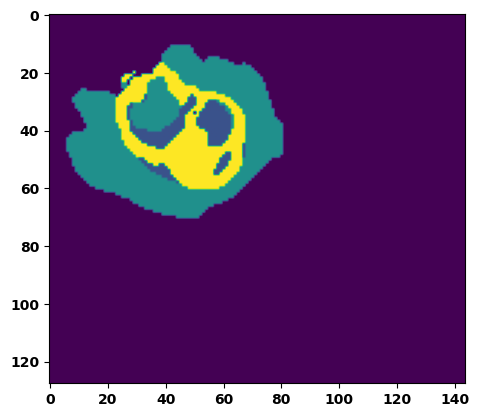

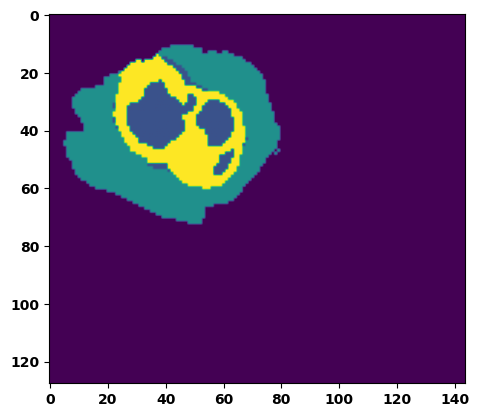

 33%|███▎      | 12/36 [00:17<00:35,  1.49s/it]

Batch_id:  11 Eval loss:  0.37419527769088745
Batch_id:  11 Eval IoU:  tensor(0.5131, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9110, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.8773, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9075, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9846, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:33,  1.45s/it]

Batch_id:  12 Eval loss:  0.1561770737171173
Batch_id:  12 Eval IoU:  tensor(0.8278, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9912, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.44s/it]

Batch_id:  13 Eval loss:  0.13896490633487701
Batch_id:  13 Eval IoU:  tensor(0.8276, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:29,  1.40s/it]

Batch_id:  14 Eval loss:  0.35763609409332275
Batch_id:  14 Eval IoU:  tensor(0.5654, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.42s/it]

Batch_id:  15 Eval loss:  0.1903621256351471
Batch_id:  15 Eval IoU:  tensor(0.8354, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9972, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:25,  1.36s/it]

Batch_id:  16 Eval loss:  0.21804580092430115
Batch_id:  16 Eval IoU:  tensor(0.7095, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9919, device='cuda:0')


 50%|█████     | 18/36 [00:25<00:24,  1.38s/it]

Batch_id:  17 Eval loss:  0.6442790627479553
Batch_id:  17 Eval IoU:  tensor(0.3163, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9715, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.41s/it]

Batch_id:  18 Eval loss:  0.24130044877529144
Batch_id:  18 Eval IoU:  tensor(0.6664, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


 56%|█████▌    | 20/36 [00:28<00:21,  1.36s/it]

Batch_id:  19 Eval loss:  0.3887830972671509
Batch_id:  19 Eval IoU:  tensor(0.5252, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9327, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9197, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  20 Eval loss:  0.23913583159446716
Batch_id:  20 Eval IoU:  tensor(0.6691, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9815, device='cuda:0')


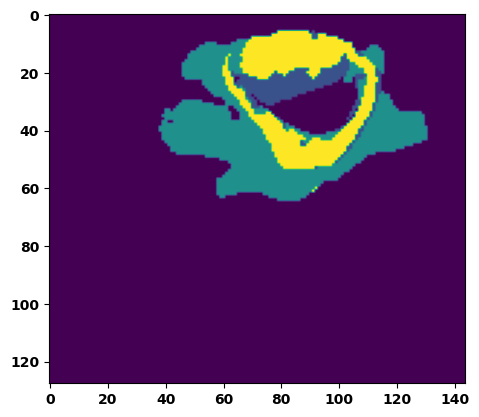

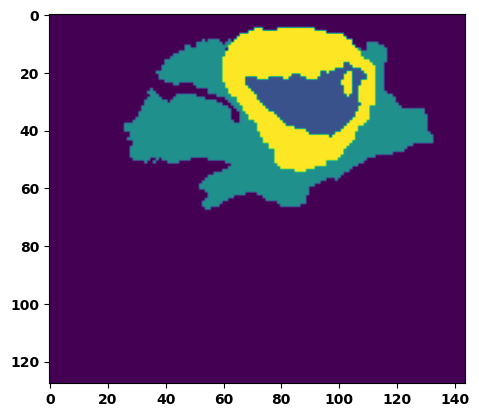

 61%|██████    | 22/36 [00:31<00:20,  1.44s/it]

Batch_id:  21 Eval loss:  0.17239433526992798
Batch_id:  21 Eval IoU:  tensor(0.7598, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9771, device='cuda:0')


 64%|██████▍   | 23/36 [00:32<00:18,  1.44s/it]

Batch_id:  22 Eval loss:  0.2297777235507965
Batch_id:  22 Eval IoU:  tensor(0.6809, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9837, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:17,  1.44s/it]

Batch_id:  23 Eval loss:  0.7543292045593262
Batch_id:  23 Eval IoU:  tensor(0.2300, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9367, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9072, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9881, device='cuda:0')


 69%|██████▉   | 25/36 [00:35<00:16,  1.46s/it]

Batch_id:  24 Eval loss:  0.29022344946861267
Batch_id:  24 Eval IoU:  tensor(0.6356, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9408, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9343, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 72%|███████▏  | 26/36 [00:37<00:15,  1.53s/it]

Batch_id:  25 Eval loss:  0.3318489193916321
Batch_id:  25 Eval IoU:  tensor(0.5995, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9881, device='cuda:0')


 75%|███████▌  | 27/36 [00:38<00:13,  1.48s/it]

Batch_id:  26 Eval loss:  0.18080013990402222
Batch_id:  26 Eval IoU:  tensor(0.7517, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.50s/it]

Batch_id:  27 Eval loss:  0.390656441450119
Batch_id:  27 Eval IoU:  tensor(0.5578, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 81%|████████  | 29/36 [00:41<00:10,  1.47s/it]

Batch_id:  28 Eval loss:  0.18134930729866028
Batch_id:  28 Eval IoU:  tensor(0.7711, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.48s/it]

Batch_id:  29 Eval loss:  0.3326219618320465
Batch_id:  29 Eval IoU:  tensor(0.6107, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  30 Eval loss:  0.21854084730148315
Batch_id:  30 Eval IoU:  tensor(0.6865, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9866, device='cuda:0')


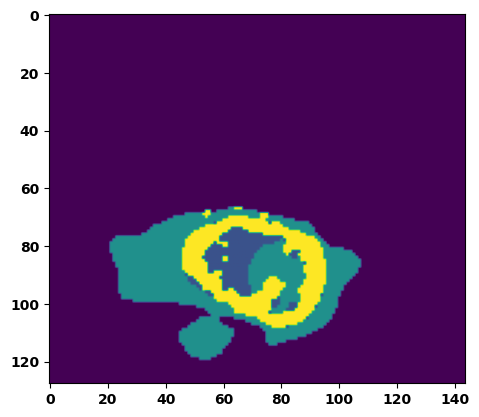

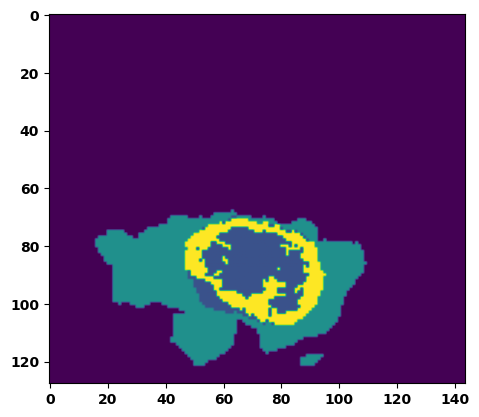

 89%|████████▉ | 32/36 [00:46<00:06,  1.56s/it]

Batch_id:  31 Eval loss:  0.42248380184173584
Batch_id:  31 Eval IoU:  tensor(0.5065, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9862, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.53s/it]

Batch_id:  32 Eval loss:  0.3275562524795532
Batch_id:  32 Eval IoU:  tensor(0.5808, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9886, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.47s/it]

Batch_id:  33 Eval loss:  0.3107690215110779
Batch_id:  33 Eval IoU:  tensor(0.6747, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9454, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 97%|█████████▋| 35/36 [00:50<00:01,  1.45s/it]

Batch_id:  34 Eval loss:  0.22643300890922546
Batch_id:  34 Eval IoU:  tensor(0.7063, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9259, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.46s/it]

Batch_id:  35 Eval loss:  0.4600295424461365
Batch_id:  35 Eval IoU:  tensor(0.5019, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')
Epoch  7 Training loss:  0.31041697846217586
Epoch  7 Evaluation loss:  0.3177489634189341
Epoch  7 Training accuracy :  tensor(0.6204)
Epoch  7 Evaluation accuracy :  tensor(0.6253)
Epoch  7 Training Mean Dice Score:  tensor(0.9631)
Epoch  7 Eval Mean Dice Score:  tensor(0.9627)
Epoch  7 Training Non-tumor Dice Score:  tensor(0.9699)
Epoch  7 Eval Non-tumor Dice Score:  tensor(0.9627)
Epoch  7 Training NCR/NET Dice Score:  tensor(0.9751)
Epoch  7 Eval NCR/NET Dice Score:  tensor(0.9794)
Epoch  7 Training ED Dice Score:  tensor(0.9575)
Epoch  

Epoch: 8
Training in session: 


  1%|          | 1/110 [00:01<02:45,  1.51s/it]

Batch_id:  0 Training loss:  0.34979039430618286
Batch_id:  0 Training IoU:  tensor(0.5504, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9747, device='cuda:0')


  2%|▏         | 2/110 [00:03<03:02,  1.69s/it]

Batch_id:  1 Training loss:  0.19644711911678314
Batch_id:  1 Training IoU:  tensor(0.7321, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9443, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9335, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:45,  1.55s/it]

Batch_id:  2 Training loss:  0.5167301893234253
Batch_id:  2 Training IoU:  tensor(0.4111, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.8971, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9347, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9075, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.8871, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9621, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:44,  1.55s/it]

Batch_id:  3 Training loss:  0.2100074291229248
Batch_id:  3 Training IoU:  tensor(0.7129, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:36,  1.49s/it]

Batch_id:  4 Training loss:  0.2490967959165573
Batch_id:  4 Training IoU:  tensor(0.7045, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:31,  1.46s/it]

Batch_id:  5 Training loss:  0.13713593780994415
Batch_id:  5 Training IoU:  tensor(0.8062, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:30,  1.46s/it]

Batch_id:  6 Training loss:  0.3180471658706665
Batch_id:  6 Training IoU:  tensor(0.5615, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9435, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9707, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:31,  1.49s/it]

Batch_id:  7 Training loss:  0.4657837152481079
Batch_id:  7 Training IoU:  tensor(0.4269, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9154, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9372, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9063, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9403, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:24,  1.43s/it]

Batch_id:  8 Training loss:  0.2077692449092865
Batch_id:  8 Training IoU:  tensor(0.7117, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:25,  1.46s/it]

Batch_id:  9 Training loss:  0.22806726396083832
Batch_id:  9 Training IoU:  tensor(0.6922, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 10%|█         | 11/110 [00:16<02:23,  1.45s/it]

Batch_id:  10 Training loss:  0.38524913787841797
Batch_id:  10 Training IoU:  tensor(0.5098, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9450, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9314, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9761, device='cuda:0')


 11%|█         | 12/110 [00:17<02:19,  1.42s/it]

Batch_id:  11 Training loss:  0.254265695810318
Batch_id:  11 Training IoU:  tensor(0.6475, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:19,  1.44s/it]

Batch_id:  12 Training loss:  0.20747604966163635
Batch_id:  12 Training IoU:  tensor(0.7094, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:16,  1.42s/it]

Batch_id:  13 Training loss:  0.19489474594593048
Batch_id:  13 Training IoU:  tensor(0.7344, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:27,  1.56s/it]

Batch_id:  14 Training loss:  0.27086639404296875
Batch_id:  14 Training IoU:  tensor(0.6653, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9354, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:24,  1.54s/it]

Batch_id:  15 Training loss:  0.3947705924510956
Batch_id:  15 Training IoU:  tensor(0.5306, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:18,  1.49s/it]

Batch_id:  16 Training loss:  0.23991800844669342
Batch_id:  16 Training IoU:  tensor(0.6668, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9198, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:15,  1.47s/it]

Batch_id:  17 Training loss:  0.6191267371177673
Batch_id:  17 Training IoU:  tensor(0.3234, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9301, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9144, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9446, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9812, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:16,  1.51s/it]

Batch_id:  18 Training loss:  0.7064964771270752
Batch_id:  18 Training IoU:  tensor(0.2568, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9304, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9164, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9381, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9725, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:11,  1.46s/it]

Batch_id:  19 Training loss:  0.2368677705526352
Batch_id:  19 Training IoU:  tensor(0.6959, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:08,  1.44s/it]

Batch_id:  20 Training loss:  0.27604955434799194
Batch_id:  20 Training IoU:  tensor(0.6178, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9734, device='cuda:0')


 20%|██        | 22/110 [00:32<02:07,  1.45s/it]

Batch_id:  21 Training loss:  0.22281195223331451
Batch_id:  21 Training IoU:  tensor(0.6854, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9704, device='cuda:0')


 21%|██        | 23/110 [00:34<02:09,  1.49s/it]

Batch_id:  22 Training loss:  0.2886516749858856
Batch_id:  22 Training IoU:  tensor(0.6267, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:11,  1.53s/it]

Batch_id:  23 Training loss:  0.10873493552207947
Batch_id:  23 Training IoU:  tensor(0.8507, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:05,  1.48s/it]

Batch_id:  24 Training loss:  0.2156502902507782
Batch_id:  24 Training IoU:  tensor(0.7270, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:05,  1.50s/it]

Batch_id:  25 Training loss:  0.13200892508029938
Batch_id:  25 Training IoU:  tensor(0.8241, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 25%|██▍       | 27/110 [00:40<02:02,  1.47s/it]

Batch_id:  26 Training loss:  0.41190552711486816
Batch_id:  26 Training IoU:  tensor(0.5213, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9216, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 25%|██▌       | 28/110 [00:41<02:04,  1.51s/it]

Batch_id:  27 Training loss:  0.13648071885108948
Batch_id:  27 Training IoU:  tensor(0.8212, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:59,  1.47s/it]

Batch_id:  28 Training loss:  0.16418178379535675
Batch_id:  28 Training IoU:  tensor(0.7758, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:55,  1.44s/it]

Batch_id:  29 Training loss:  0.30634987354278564
Batch_id:  29 Training IoU:  tensor(0.6095, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9445, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:53,  1.43s/it]

Batch_id:  30 Training loss:  0.1905883103609085
Batch_id:  30 Training IoU:  tensor(0.7332, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 29%|██▉       | 32/110 [00:47<01:51,  1.42s/it]

Batch_id:  31 Training loss:  0.46581918001174927
Batch_id:  31 Training IoU:  tensor(0.4629, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 30%|███       | 33/110 [00:48<01:49,  1.42s/it]

Batch_id:  32 Training loss:  0.2519875168800354
Batch_id:  32 Training IoU:  tensor(0.7094, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 31%|███       | 34/110 [00:50<01:48,  1.43s/it]

Batch_id:  33 Training loss:  0.429035484790802
Batch_id:  33 Training IoU:  tensor(0.4979, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:45,  1.40s/it]

Batch_id:  34 Training loss:  0.22916534543037415
Batch_id:  34 Training IoU:  tensor(0.6677, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:45,  1.43s/it]

Batch_id:  35 Training loss:  0.13470067083835602
Batch_id:  35 Training IoU:  tensor(0.8542, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:48,  1.49s/it]

Batch_id:  36 Training loss:  0.272462397813797
Batch_id:  36 Training IoU:  tensor(0.6986, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:46,  1.48s/it]

Batch_id:  37 Training loss:  0.5481500625610352
Batch_id:  37 Training IoU:  tensor(0.4187, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:43,  1.46s/it]

Batch_id:  38 Training loss:  0.29060643911361694
Batch_id:  38 Training IoU:  tensor(0.6838, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9793, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:38,  1.40s/it]

Batch_id:  39 Training loss:  0.19345690310001373
Batch_id:  39 Training IoU:  tensor(0.7634, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 37%|███▋      | 41/110 [01:00<01:39,  1.44s/it]

Batch_id:  40 Training loss:  0.2301550954580307
Batch_id:  40 Training IoU:  tensor(0.7054, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:36,  1.42s/it]

Batch_id:  41 Training loss:  0.2807154953479767
Batch_id:  41 Training IoU:  tensor(0.6375, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9796, device='cuda:0')


 39%|███▉      | 43/110 [01:03<01:35,  1.43s/it]

Batch_id:  42 Training loss:  0.3747653365135193
Batch_id:  42 Training IoU:  tensor(0.5329, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 40%|████      | 44/110 [01:04<01:36,  1.46s/it]

Batch_id:  43 Training loss:  0.4111596345901489
Batch_id:  43 Training IoU:  tensor(0.5400, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 41%|████      | 45/110 [01:05<01:33,  1.44s/it]

Batch_id:  44 Training loss:  0.2131708860397339
Batch_id:  44 Training IoU:  tensor(0.7105, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9332, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9387, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9806, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:34,  1.48s/it]

Batch_id:  45 Training loss:  0.329207181930542
Batch_id:  45 Training IoU:  tensor(0.6233, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:32,  1.47s/it]

Batch_id:  46 Training loss:  0.35544443130493164
Batch_id:  46 Training IoU:  tensor(0.5648, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 44%|████▎     | 48/110 [01:10<01:32,  1.49s/it]

Batch_id:  47 Training loss:  0.3228241205215454
Batch_id:  47 Training IoU:  tensor(0.5896, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:29,  1.47s/it]

Batch_id:  48 Training loss:  0.22188711166381836
Batch_id:  48 Training IoU:  tensor(0.7517, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:25,  1.43s/it]

Batch_id:  49 Training loss:  0.3150246739387512
Batch_id:  49 Training IoU:  tensor(0.5799, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9208, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9187, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9056, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9604, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:22,  1.41s/it]

Batch_id:  50 Training loss:  0.22376464307308197
Batch_id:  50 Training IoU:  tensor(0.7645, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:26,  1.49s/it]

Batch_id:  51 Training loss:  0.24490702152252197
Batch_id:  51 Training IoU:  tensor(0.6922, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9759, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:23,  1.47s/it]

Batch_id:  52 Training loss:  0.3742689788341522
Batch_id:  52 Training IoU:  tensor(0.5625, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:20,  1.43s/it]

Batch_id:  53 Training loss:  0.1975448727607727
Batch_id:  53 Training IoU:  tensor(0.7547, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 50%|█████     | 55/110 [01:20<01:19,  1.45s/it]

Batch_id:  54 Training loss:  0.21985140442848206
Batch_id:  54 Training IoU:  tensor(0.6986, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:14,  1.38s/it]

Batch_id:  55 Training loss:  0.34937548637390137
Batch_id:  55 Training IoU:  tensor(0.6034, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:13,  1.38s/it]

Batch_id:  56 Training loss:  0.31548964977264404
Batch_id:  56 Training IoU:  tensor(0.6465, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:10,  1.36s/it]

Batch_id:  57 Training loss:  0.30068325996398926
Batch_id:  57 Training IoU:  tensor(0.6283, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 54%|█████▎    | 59/110 [01:25<01:09,  1.37s/it]

Batch_id:  58 Training loss:  0.29982268810272217
Batch_id:  58 Training IoU:  tensor(0.6662, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 55%|█████▍    | 60/110 [01:27<01:11,  1.44s/it]

Batch_id:  59 Training loss:  0.23491747677326202
Batch_id:  59 Training IoU:  tensor(0.6762, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:09,  1.43s/it]

Batch_id:  60 Training loss:  0.3006593585014343
Batch_id:  60 Training IoU:  tensor(0.6258, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9410, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 56%|█████▋    | 62/110 [01:30<01:07,  1.41s/it]

Batch_id:  61 Training loss:  0.21722163259983063
Batch_id:  61 Training IoU:  tensor(0.6928, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9528, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:08,  1.46s/it]

Batch_id:  62 Training loss:  0.14712072908878326
Batch_id:  62 Training IoU:  tensor(0.8123, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 58%|█████▊    | 64/110 [01:33<01:06,  1.45s/it]

Batch_id:  63 Training loss:  0.4947018027305603
Batch_id:  63 Training IoU:  tensor(0.4185, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9019, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9052, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.8665, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:07,  1.50s/it]

Batch_id:  64 Training loss:  0.3336353898048401
Batch_id:  64 Training IoU:  tensor(0.6517, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9994, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:07,  1.54s/it]

Batch_id:  65 Training loss:  0.28026893734931946
Batch_id:  65 Training IoU:  tensor(0.6401, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 61%|██████    | 67/110 [01:37<01:03,  1.48s/it]

Batch_id:  66 Training loss:  0.15831074118614197
Batch_id:  66 Training IoU:  tensor(0.7786, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 62%|██████▏   | 68/110 [01:39<01:02,  1.49s/it]

Batch_id:  67 Training loss:  0.25671929121017456
Batch_id:  67 Training IoU:  tensor(0.6744, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<01:01,  1.49s/it]

Batch_id:  68 Training loss:  0.21713098883628845
Batch_id:  68 Training IoU:  tensor(0.7401, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 64%|██████▎   | 70/110 [01:42<00:59,  1.49s/it]

Batch_id:  69 Training loss:  0.2862466871738434
Batch_id:  69 Training IoU:  tensor(0.6520, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9425, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 65%|██████▍   | 71/110 [01:43<00:57,  1.46s/it]

Batch_id:  70 Training loss:  0.23562639951705933
Batch_id:  70 Training IoU:  tensor(0.6877, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 65%|██████▌   | 72/110 [01:45<00:56,  1.50s/it]

Batch_id:  71 Training loss:  0.16667631268501282
Batch_id:  71 Training IoU:  tensor(0.7624, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 66%|██████▋   | 73/110 [01:46<00:57,  1.56s/it]

Batch_id:  72 Training loss:  0.32362669706344604
Batch_id:  72 Training IoU:  tensor(0.6352, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9547, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:55,  1.53s/it]

Batch_id:  73 Training loss:  0.17043720185756683
Batch_id:  73 Training IoU:  tensor(0.7692, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 68%|██████▊   | 75/110 [01:49<00:53,  1.52s/it]

Batch_id:  74 Training loss:  0.3510640263557434
Batch_id:  74 Training IoU:  tensor(0.6090, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 69%|██████▉   | 76/110 [01:51<00:49,  1.44s/it]

Batch_id:  75 Training loss:  0.2956368029117584
Batch_id:  75 Training IoU:  tensor(0.6231, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 70%|███████   | 77/110 [01:52<00:47,  1.45s/it]

Batch_id:  76 Training loss:  0.35043394565582275
Batch_id:  76 Training IoU:  tensor(0.5665, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9772, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:47,  1.49s/it]

Batch_id:  77 Training loss:  0.2634609341621399
Batch_id:  77 Training IoU:  tensor(0.6316, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9265, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 72%|███████▏  | 79/110 [01:55<00:45,  1.46s/it]

Batch_id:  78 Training loss:  0.26402747631073
Batch_id:  78 Training IoU:  tensor(0.7155, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:44,  1.48s/it]

Batch_id:  79 Training loss:  0.16015812754631042
Batch_id:  79 Training IoU:  tensor(0.7746, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 74%|███████▎  | 81/110 [01:58<00:44,  1.52s/it]

Batch_id:  80 Training loss:  0.24784061312675476
Batch_id:  80 Training IoU:  tensor(0.6751, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:41,  1.49s/it]

Batch_id:  81 Training loss:  0.374244749546051
Batch_id:  81 Training IoU:  tensor(0.5288, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9091, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9141, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.8808, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9799, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:40,  1.49s/it]

Batch_id:  82 Training loss:  0.15071144700050354
Batch_id:  82 Training IoU:  tensor(0.7917, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:39,  1.52s/it]

Batch_id:  83 Training loss:  0.3274746537208557
Batch_id:  83 Training IoU:  tensor(0.6188, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:37,  1.48s/it]

Batch_id:  84 Training loss:  0.5871774554252625
Batch_id:  84 Training IoU:  tensor(0.3549, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:35,  1.49s/it]

Batch_id:  85 Training loss:  0.2199503630399704
Batch_id:  85 Training IoU:  tensor(0.6841, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9694, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:35,  1.55s/it]

Batch_id:  86 Training loss:  0.17168743908405304
Batch_id:  86 Training IoU:  tensor(0.7623, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9821, device='cuda:0')


 80%|████████  | 88/110 [02:09<00:33,  1.53s/it]

Batch_id:  87 Training loss:  0.20479916036128998
Batch_id:  87 Training IoU:  tensor(0.7201, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:31,  1.51s/it]

Batch_id:  88 Training loss:  0.2757749557495117
Batch_id:  88 Training IoU:  tensor(0.6511, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 82%|████████▏ | 90/110 [02:12<00:29,  1.47s/it]

Batch_id:  89 Training loss:  0.42778217792510986
Batch_id:  89 Training IoU:  tensor(0.4971, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9465, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9310, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:28,  1.52s/it]

Batch_id:  90 Training loss:  0.3693365454673767
Batch_id:  90 Training IoU:  tensor(0.5811, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 84%|████████▎ | 92/110 [02:15<00:27,  1.53s/it]

Batch_id:  91 Training loss:  0.38087064027786255
Batch_id:  91 Training IoU:  tensor(0.5148, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9778, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:26,  1.54s/it]

Batch_id:  92 Training loss:  0.3399817943572998
Batch_id:  92 Training IoU:  tensor(0.5450, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9192, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9267, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9454, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9185, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9670, device='cuda:0')


 85%|████████▌ | 94/110 [02:18<00:24,  1.52s/it]

Batch_id:  93 Training loss:  0.1927555650472641
Batch_id:  93 Training IoU:  tensor(0.7223, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:22,  1.51s/it]

Batch_id:  94 Training loss:  0.2732248306274414
Batch_id:  94 Training IoU:  tensor(0.6451, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 87%|████████▋ | 96/110 [02:21<00:21,  1.50s/it]

Batch_id:  95 Training loss:  0.48991018533706665
Batch_id:  95 Training IoU:  tensor(0.4380, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9351, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9312, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9044, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 88%|████████▊ | 97/110 [02:22<00:19,  1.49s/it]

Batch_id:  96 Training loss:  0.4013563096523285
Batch_id:  96 Training IoU:  tensor(0.5243, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 89%|████████▉ | 98/110 [02:24<00:18,  1.51s/it]

Batch_id:  97 Training loss:  0.21424545347690582
Batch_id:  97 Training IoU:  tensor(0.7253, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9792, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:16,  1.50s/it]

Batch_id:  98 Training loss:  0.5423157811164856
Batch_id:  98 Training IoU:  tensor(0.4086, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9400, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 91%|█████████ | 100/110 [02:27<00:15,  1.53s/it]

Batch_id:  99 Training loss:  0.32126539945602417
Batch_id:  99 Training IoU:  tensor(0.5734, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9781, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:13,  1.52s/it]

Batch_id:  100 Training loss:  0.18559320271015167
Batch_id:  100 Training IoU:  tensor(0.7587, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 93%|█████████▎| 102/110 [02:30<00:12,  1.54s/it]

Batch_id:  101 Training loss:  0.5666213631629944
Batch_id:  101 Training IoU:  tensor(0.3759, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.51s/it]

Batch_id:  102 Training loss:  0.33911651372909546
Batch_id:  102 Training IoU:  tensor(0.5812, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 95%|█████████▍| 104/110 [02:33<00:08,  1.47s/it]

Batch_id:  103 Training loss:  0.14398691058158875
Batch_id:  103 Training IoU:  tensor(0.8033, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.45s/it]

Batch_id:  104 Training loss:  0.2278846651315689
Batch_id:  104 Training IoU:  tensor(0.7239, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 96%|█████████▋| 106/110 [02:36<00:06,  1.50s/it]

Batch_id:  105 Training loss:  0.24398070573806763
Batch_id:  105 Training IoU:  tensor(0.6852, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.51s/it]

Batch_id:  106 Training loss:  0.236453115940094
Batch_id:  106 Training IoU:  tensor(0.6672, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9528, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 98%|█████████▊| 108/110 [02:39<00:03,  1.53s/it]

Batch_id:  107 Training loss:  0.16417093575000763
Batch_id:  107 Training IoU:  tensor(0.7654, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 99%|█████████▉| 109/110 [02:41<00:01,  1.52s/it]

Batch_id:  108 Training loss:  0.20460310578346252
Batch_id:  108 Training IoU:  tensor(0.7338, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


100%|██████████| 110/110 [02:42<00:00,  1.48s/it]


Batch_id:  109 Training loss:  0.27847713232040405
Batch_id:  109 Training IoU:  tensor(0.6253, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9922, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.20102176070213318
Batch_id:  0 Eval IoU:  tensor(0.7408, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9954, device='cuda:0')


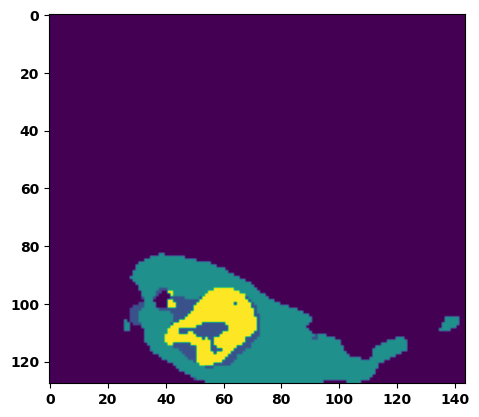

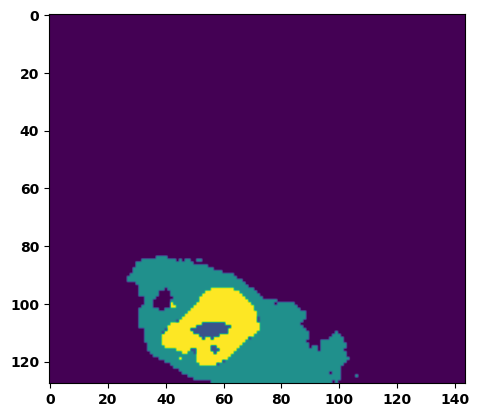

  6%|▌         | 2/36 [00:03<00:58,  1.71s/it]

Batch_id:  1 Eval loss:  0.7549651861190796
Batch_id:  1 Eval IoU:  tensor(0.2223, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9135, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.8755, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9013, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:52,  1.58s/it]

Batch_id:  2 Eval loss:  0.33455848693847656
Batch_id:  2 Eval IoU:  tensor(0.5802, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9873, device='cuda:0')


 11%|█         | 4/36 [00:06<00:46,  1.47s/it]

Batch_id:  3 Eval loss:  0.18398626148700714
Batch_id:  3 Eval IoU:  tensor(0.7953, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:44,  1.44s/it]

Batch_id:  4 Eval loss:  0.2721482813358307
Batch_id:  4 Eval IoU:  tensor(0.7209, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:43,  1.45s/it]

Batch_id:  5 Eval loss:  0.2719544470310211
Batch_id:  5 Eval IoU:  tensor(0.6449, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9882, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:41,  1.42s/it]

Batch_id:  6 Eval loss:  0.3608359098434448
Batch_id:  6 Eval IoU:  tensor(0.5334, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9562, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:38,  1.39s/it]

Batch_id:  7 Eval loss:  0.26401424407958984
Batch_id:  7 Eval IoU:  tensor(0.6852, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9928, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:38,  1.41s/it]

Batch_id:  8 Eval loss:  0.22771772742271423
Batch_id:  8 Eval IoU:  tensor(0.6739, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9828, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:36,  1.42s/it]

Batch_id:  9 Eval loss:  0.11859063804149628
Batch_id:  9 Eval IoU:  tensor(0.8355, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  10 Eval loss:  0.29373258352279663
Batch_id:  10 Eval IoU:  tensor(0.6331, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


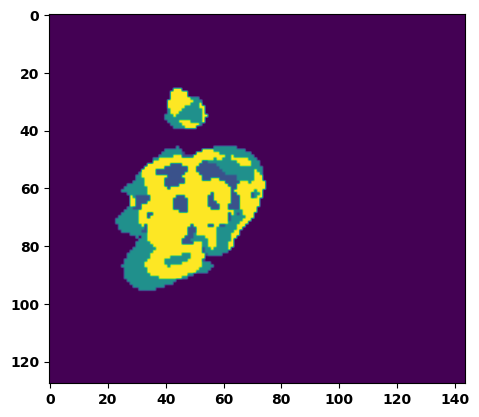

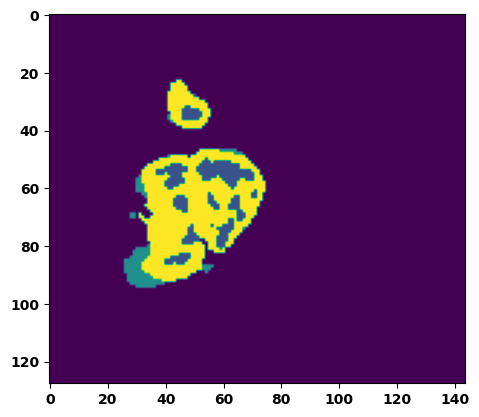

 33%|███▎      | 12/36 [00:17<00:34,  1.44s/it]

Batch_id:  11 Eval loss:  0.2612791657447815
Batch_id:  11 Eval IoU:  tensor(0.7002, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9967, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.51s/it]

Batch_id:  12 Eval loss:  0.40403538942337036
Batch_id:  12 Eval IoU:  tensor(0.5388, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9089, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.8680, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.8638, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9988, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.45s/it]

Batch_id:  13 Eval loss:  0.1275060921907425
Batch_id:  13 Eval IoU:  tensor(0.8302, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9932, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:29,  1.42s/it]

Batch_id:  14 Eval loss:  0.48555105924606323
Batch_id:  14 Eval IoU:  tensor(0.4531, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9358, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9964, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.45s/it]

Batch_id:  15 Eval loss:  0.47889673709869385
Batch_id:  15 Eval IoU:  tensor(0.4267, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9357, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9576, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9319, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9209, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9968, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:27,  1.45s/it]

Batch_id:  16 Eval loss:  0.2655072808265686
Batch_id:  16 Eval IoU:  tensor(0.6663, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9462, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9400, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.47s/it]

Batch_id:  17 Eval loss:  0.16803468763828278
Batch_id:  17 Eval IoU:  tensor(0.7550, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.45s/it]

Batch_id:  18 Eval loss:  0.3738965690135956
Batch_id:  18 Eval IoU:  tensor(0.5674, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.45s/it]

Batch_id:  19 Eval loss:  0.15981034934520721
Batch_id:  19 Eval IoU:  tensor(0.7866, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9395, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  20 Eval loss:  0.29312384128570557
Batch_id:  20 Eval IoU:  tensor(0.6437, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


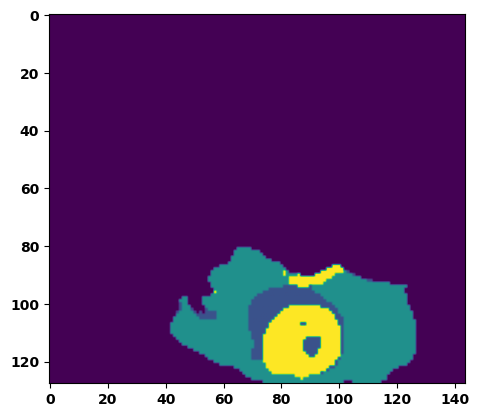

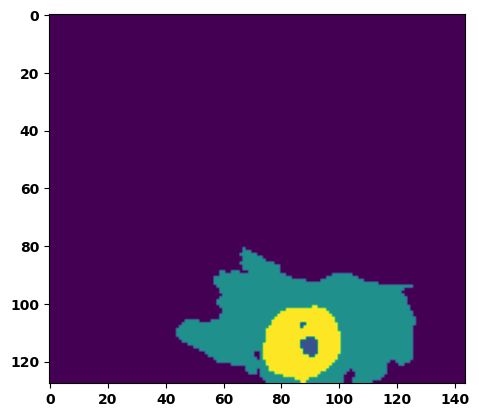

 61%|██████    | 22/36 [00:32<00:22,  1.57s/it]

Batch_id:  21 Eval loss:  0.34415072202682495
Batch_id:  21 Eval IoU:  tensor(0.5288, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9197, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.8976, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9227, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9803, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.52s/it]

Batch_id:  22 Eval loss:  0.21516525745391846
Batch_id:  22 Eval IoU:  tensor(0.7016, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:18,  1.50s/it]

Batch_id:  23 Eval loss:  0.592668890953064
Batch_id:  23 Eval IoU:  tensor(0.3426, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9465, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9715, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:16,  1.48s/it]

Batch_id:  24 Eval loss:  0.12921740114688873
Batch_id:  24 Eval IoU:  tensor(0.8170, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.50s/it]

Batch_id:  25 Eval loss:  0.14805874228477478
Batch_id:  25 Eval IoU:  tensor(0.7767, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:14,  1.58s/it]

Batch_id:  26 Eval loss:  0.12281519174575806
Batch_id:  26 Eval IoU:  tensor(0.8413, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:12,  1.52s/it]

Batch_id:  27 Eval loss:  0.12073570489883423
Batch_id:  27 Eval IoU:  tensor(0.8276, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.46s/it]

Batch_id:  28 Eval loss:  0.2695600390434265
Batch_id:  28 Eval IoU:  tensor(0.6455, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.43s/it]

Batch_id:  29 Eval loss:  0.15968628227710724
Batch_id:  29 Eval IoU:  tensor(0.8031, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  30 Eval loss:  0.18465907871723175
Batch_id:  30 Eval IoU:  tensor(0.7333, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9835, device='cuda:0')


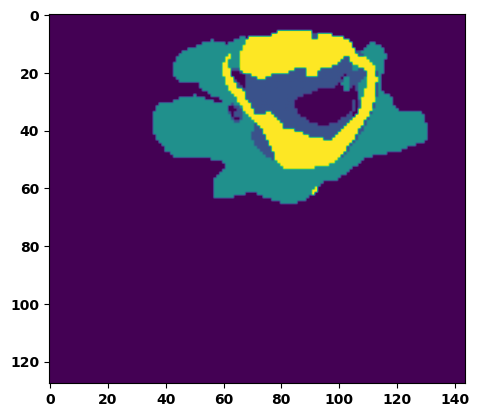

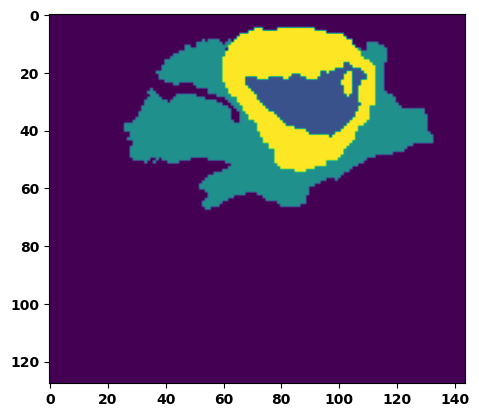

 89%|████████▉ | 32/36 [00:47<00:05,  1.44s/it]

Batch_id:  31 Eval loss:  0.36973825097084045
Batch_id:  31 Eval IoU:  tensor(0.5112, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9457, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9291, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9278, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.43s/it]

Batch_id:  32 Eval loss:  0.34524160623550415
Batch_id:  32 Eval IoU:  tensor(0.5917, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.42s/it]

Batch_id:  33 Eval loss:  0.32612666487693787
Batch_id:  33 Eval IoU:  tensor(0.5824, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9294, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.39s/it]

Batch_id:  34 Eval loss:  0.1604522317647934
Batch_id:  34 Eval IoU:  tensor(0.7722, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.46s/it]

Batch_id:  35 Eval loss:  0.23310501873493195
Batch_id:  35 Eval IoU:  tensor(0.6770, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9888, device='cuda:0')
Epoch  8 Training loss:  0.2895394592122598
Epoch  8 Evaluation loss:  0.2784041050407622
Epoch  8 Training accuracy :  tensor(0.6425)
Epoch  8 Evaluation accuracy :  tensor(0.6552)
Epoch  8 Training Mean Dice Score:  tensor(0.9661)
Epoch  8 Eval Mean Dice Score:  tensor(0.9652)
Epoch  8 Training Non-tumor Dice Score:  tensor(0.9715)
Epoch  8 Eval Non-tumor Dice Score:  tensor(0.9663)
Epoch  8 Training NCR/NET Dice Score:  tensor(0.9781)
Epoch  8 Eval NCR/NET Dice Score:  tensor(0.9813)
Epoch  8 Training ED Dice Score:  tensor(0.9614)
Epoch  

Epoch completed and model successfully saved
Epoch: 9
Training in session: 


  1%|          | 1/110 [00:01<02:32,  1.40s/it]

Batch_id:  0 Training loss:  0.15752080082893372
Batch_id:  0 Training IoU:  tensor(0.7689, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:35,  1.44s/it]

Batch_id:  1 Training loss:  0.21894106268882751
Batch_id:  1 Training IoU:  tensor(0.7014, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:38,  1.48s/it]

Batch_id:  2 Training loss:  0.3412582576274872
Batch_id:  2 Training IoU:  tensor(0.6017, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:36,  1.48s/it]

Batch_id:  3 Training loss:  0.2879447937011719
Batch_id:  3 Training IoU:  tensor(0.6065, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9788, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:32,  1.45s/it]

Batch_id:  4 Training loss:  0.2387881875038147
Batch_id:  4 Training IoU:  tensor(0.6694, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9447, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9766, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:35,  1.50s/it]

Batch_id:  5 Training loss:  0.11430995166301727
Batch_id:  5 Training IoU:  tensor(0.8366, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:31,  1.47s/it]

Batch_id:  6 Training loss:  0.18005071580410004
Batch_id:  6 Training IoU:  tensor(0.7496, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:34,  1.51s/it]

Batch_id:  7 Training loss:  0.2067568153142929
Batch_id:  7 Training IoU:  tensor(0.7370, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:29,  1.48s/it]

Batch_id:  8 Training loss:  0.3502371907234192
Batch_id:  8 Training IoU:  tensor(0.5543, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:34,  1.54s/it]

Batch_id:  9 Training loss:  0.23450155556201935
Batch_id:  9 Training IoU:  tensor(0.6759, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 10%|█         | 11/110 [00:16<02:31,  1.53s/it]

Batch_id:  10 Training loss:  0.11947447061538696
Batch_id:  10 Training IoU:  tensor(0.8264, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 11%|█         | 12/110 [00:17<02:26,  1.49s/it]

Batch_id:  11 Training loss:  0.27966082096099854
Batch_id:  11 Training IoU:  tensor(0.6379, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:24,  1.49s/it]

Batch_id:  12 Training loss:  0.22917033731937408
Batch_id:  12 Training IoU:  tensor(0.7313, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:23,  1.50s/it]

Batch_id:  13 Training loss:  0.2891058921813965
Batch_id:  13 Training IoU:  tensor(0.5955, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9252, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9336, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9037, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9800, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:20,  1.48s/it]

Batch_id:  14 Training loss:  0.16064587235450745
Batch_id:  14 Training IoU:  tensor(0.7859, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:18,  1.47s/it]

Batch_id:  15 Training loss:  0.5081548690795898
Batch_id:  15 Training IoU:  tensor(0.4116, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:19,  1.50s/it]

Batch_id:  16 Training loss:  0.29166197776794434
Batch_id:  16 Training IoU:  tensor(0.5885, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9206, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9201, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.8956, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9804, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:14,  1.46s/it]

Batch_id:  17 Training loss:  0.15115313231945038
Batch_id:  17 Training IoU:  tensor(0.7769, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:11,  1.44s/it]

Batch_id:  18 Training loss:  0.3015596270561218
Batch_id:  18 Training IoU:  tensor(0.6543, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:06,  1.40s/it]

Batch_id:  19 Training loss:  0.46146243810653687
Batch_id:  19 Training IoU:  tensor(0.4445, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9057, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9089, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9010, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9597, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:08,  1.45s/it]

Batch_id:  20 Training loss:  0.2547101378440857
Batch_id:  20 Training IoU:  tensor(0.6527, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 20%|██        | 22/110 [00:32<02:02,  1.39s/it]

Batch_id:  21 Training loss:  0.2853429317474365
Batch_id:  21 Training IoU:  tensor(0.6166, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9815, device='cuda:0')


 21%|██        | 23/110 [00:33<02:03,  1.42s/it]

Batch_id:  22 Training loss:  0.14219295978546143
Batch_id:  22 Training IoU:  tensor(0.7934, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:02,  1.42s/it]

Batch_id:  23 Training loss:  0.15762615203857422
Batch_id:  23 Training IoU:  tensor(0.7707, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9742, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:05,  1.47s/it]

Batch_id:  24 Training loss:  0.15740397572517395
Batch_id:  24 Training IoU:  tensor(0.7704, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:03,  1.48s/it]

Batch_id:  25 Training loss:  0.33599787950515747
Batch_id:  25 Training IoU:  tensor(0.5731, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9808, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:01,  1.46s/it]

Batch_id:  26 Training loss:  0.21364888548851013
Batch_id:  26 Training IoU:  tensor(0.6964, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9844, device='cuda:0')


 25%|██▌       | 28/110 [00:41<01:58,  1.45s/it]

Batch_id:  27 Training loss:  0.184695765376091
Batch_id:  27 Training IoU:  tensor(0.7586, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:59,  1.48s/it]

Batch_id:  28 Training loss:  0.3749431371688843
Batch_id:  28 Training IoU:  tensor(0.5273, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9340, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9472, device='cuda:0')


 27%|██▋       | 30/110 [00:44<02:00,  1.50s/it]

Batch_id:  29 Training loss:  0.44334518909454346
Batch_id:  29 Training IoU:  tensor(0.4482, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9149, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9284, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.8914, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:54,  1.45s/it]

Batch_id:  30 Training loss:  0.17197328805923462
Batch_id:  30 Training IoU:  tensor(0.7760, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:51,  1.43s/it]

Batch_id:  31 Training loss:  0.33098477125167847
Batch_id:  31 Training IoU:  tensor(0.5945, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9557, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9480, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9843, device='cuda:0')


 30%|███       | 33/110 [00:48<01:49,  1.42s/it]

Batch_id:  32 Training loss:  0.11369162797927856
Batch_id:  32 Training IoU:  tensor(0.8451, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 31%|███       | 34/110 [00:49<01:48,  1.43s/it]

Batch_id:  33 Training loss:  0.14346712827682495
Batch_id:  33 Training IoU:  tensor(0.7866, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9775, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:45,  1.40s/it]

Batch_id:  34 Training loss:  0.4235747158527374
Batch_id:  34 Training IoU:  tensor(0.5116, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9279, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:45,  1.43s/it]

Batch_id:  35 Training loss:  0.30956655740737915
Batch_id:  35 Training IoU:  tensor(0.5939, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9452, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9678, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:48,  1.49s/it]

Batch_id:  36 Training loss:  0.2400122433900833
Batch_id:  36 Training IoU:  tensor(0.6704, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:45,  1.46s/it]

Batch_id:  37 Training loss:  0.2170204371213913
Batch_id:  37 Training IoU:  tensor(0.6881, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:45,  1.49s/it]

Batch_id:  38 Training loss:  0.320789098739624
Batch_id:  38 Training IoU:  tensor(0.6011, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:40,  1.43s/it]

Batch_id:  39 Training loss:  0.1819230318069458
Batch_id:  39 Training IoU:  tensor(0.7370, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9800, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:36,  1.40s/it]

Batch_id:  40 Training loss:  0.44758927822113037
Batch_id:  40 Training IoU:  tensor(0.4721, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9473, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9334, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:36,  1.42s/it]

Batch_id:  41 Training loss:  0.2313094586133957
Batch_id:  41 Training IoU:  tensor(0.7053, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:34,  1.41s/it]

Batch_id:  42 Training loss:  0.4655681550502777
Batch_id:  42 Training IoU:  tensor(0.4874, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9537, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9348, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 40%|████      | 44/110 [01:04<01:33,  1.41s/it]

Batch_id:  43 Training loss:  0.3856801986694336
Batch_id:  43 Training IoU:  tensor(0.5202, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9268, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9273, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.8973, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 41%|████      | 45/110 [01:05<01:34,  1.45s/it]

Batch_id:  44 Training loss:  0.43548494577407837
Batch_id:  44 Training IoU:  tensor(0.4748, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9441, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9296, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9770, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:33,  1.46s/it]

Batch_id:  45 Training loss:  0.3483462631702423
Batch_id:  45 Training IoU:  tensor(0.5372, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9189, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9390, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9327, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9199, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9649, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:32,  1.46s/it]

Batch_id:  46 Training loss:  0.2595524787902832
Batch_id:  46 Training IoU:  tensor(0.6771, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:29,  1.45s/it]

Batch_id:  47 Training loss:  0.16112476587295532
Batch_id:  47 Training IoU:  tensor(0.7667, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:25,  1.41s/it]

Batch_id:  48 Training loss:  0.18816936016082764
Batch_id:  48 Training IoU:  tensor(0.7476, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:24,  1.41s/it]

Batch_id:  49 Training loss:  0.2615255117416382
Batch_id:  49 Training IoU:  tensor(0.6271, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9699, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:23,  1.41s/it]

Batch_id:  50 Training loss:  0.3222081661224365
Batch_id:  50 Training IoU:  tensor(0.6082, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:22,  1.42s/it]

Batch_id:  51 Training loss:  0.18179360032081604
Batch_id:  51 Training IoU:  tensor(0.7403, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:24,  1.48s/it]

Batch_id:  52 Training loss:  0.26894038915634155
Batch_id:  52 Training IoU:  tensor(0.6392, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9450, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9184, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9697, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:23,  1.49s/it]

Batch_id:  53 Training loss:  0.2530827522277832
Batch_id:  53 Training IoU:  tensor(0.6840, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 50%|█████     | 55/110 [01:20<01:22,  1.50s/it]

Batch_id:  54 Training loss:  0.22862708568572998
Batch_id:  54 Training IoU:  tensor(0.6973, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:22,  1.52s/it]

Batch_id:  55 Training loss:  0.40942704677581787
Batch_id:  55 Training IoU:  tensor(0.4920, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:20,  1.51s/it]

Batch_id:  56 Training loss:  0.4480445086956024
Batch_id:  56 Training IoU:  tensor(0.4753, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9215, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:17,  1.49s/it]

Batch_id:  57 Training loss:  0.2792617380619049
Batch_id:  57 Training IoU:  tensor(0.6680, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 54%|█████▎    | 59/110 [01:26<01:14,  1.45s/it]

Batch_id:  58 Training loss:  0.5296953916549683
Batch_id:  58 Training IoU:  tensor(0.4107, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 55%|█████▍    | 60/110 [01:27<01:11,  1.43s/it]

Batch_id:  59 Training loss:  0.15386949479579926
Batch_id:  59 Training IoU:  tensor(0.7810, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:11,  1.46s/it]

Batch_id:  60 Training loss:  0.13074450194835663
Batch_id:  60 Training IoU:  tensor(0.8227, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 56%|█████▋    | 62/110 [01:30<01:09,  1.44s/it]

Batch_id:  61 Training loss:  0.2458186000585556
Batch_id:  61 Training IoU:  tensor(0.6478, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9383, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:07,  1.44s/it]

Batch_id:  62 Training loss:  0.15182079374790192
Batch_id:  62 Training IoU:  tensor(0.7847, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 58%|█████▊    | 64/110 [01:33<01:05,  1.42s/it]

Batch_id:  63 Training loss:  0.13687774538993835
Batch_id:  63 Training IoU:  tensor(0.8121, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:03,  1.42s/it]

Batch_id:  64 Training loss:  0.27754658460617065
Batch_id:  64 Training IoU:  tensor(0.6801, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:02,  1.42s/it]

Batch_id:  65 Training loss:  0.1985451579093933
Batch_id:  65 Training IoU:  tensor(0.7387, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 61%|██████    | 67/110 [01:37<01:01,  1.43s/it]

Batch_id:  66 Training loss:  0.267875611782074
Batch_id:  66 Training IoU:  tensor(0.6285, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9441, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9374, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9707, device='cuda:0')


 62%|██████▏   | 68/110 [01:38<00:59,  1.43s/it]

Batch_id:  67 Training loss:  0.5564718246459961
Batch_id:  67 Training IoU:  tensor(0.3960, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<00:57,  1.41s/it]

Batch_id:  68 Training loss:  0.2717570960521698
Batch_id:  68 Training IoU:  tensor(0.6342, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9794, device='cuda:0')


 64%|██████▎   | 70/110 [01:41<00:54,  1.37s/it]

Batch_id:  69 Training loss:  0.3478711247444153
Batch_id:  69 Training IoU:  tensor(0.6076, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 65%|██████▍   | 71/110 [01:43<00:55,  1.41s/it]

Batch_id:  70 Training loss:  0.2802921235561371
Batch_id:  70 Training IoU:  tensor(0.6288, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9480, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 65%|██████▌   | 72/110 [01:44<00:52,  1.38s/it]

Batch_id:  71 Training loss:  0.3643704652786255
Batch_id:  71 Training IoU:  tensor(0.5339, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 66%|██████▋   | 73/110 [01:45<00:52,  1.42s/it]

Batch_id:  72 Training loss:  0.22818362712860107
Batch_id:  72 Training IoU:  tensor(0.7351, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 67%|██████▋   | 74/110 [01:47<00:52,  1.44s/it]

Batch_id:  73 Training loss:  0.2130221426486969
Batch_id:  73 Training IoU:  tensor(0.7327, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 68%|██████▊   | 75/110 [01:48<00:50,  1.44s/it]

Batch_id:  74 Training loss:  0.30610886216163635
Batch_id:  74 Training IoU:  tensor(0.5956, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 69%|██████▉   | 76/110 [01:50<00:49,  1.47s/it]

Batch_id:  75 Training loss:  0.23454830050468445
Batch_id:  75 Training IoU:  tensor(0.6882, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9480, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9410, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 70%|███████   | 77/110 [01:51<00:49,  1.51s/it]

Batch_id:  76 Training loss:  0.42720913887023926
Batch_id:  76 Training IoU:  tensor(0.5033, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 71%|███████   | 78/110 [01:53<00:48,  1.50s/it]

Batch_id:  77 Training loss:  0.3468654751777649
Batch_id:  77 Training IoU:  tensor(0.5672, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 72%|███████▏  | 79/110 [01:55<00:49,  1.59s/it]

Batch_id:  78 Training loss:  0.2219153493642807
Batch_id:  78 Training IoU:  tensor(0.6772, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9351, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9844, device='cuda:0')


 73%|███████▎  | 80/110 [01:56<00:46,  1.54s/it]

Batch_id:  79 Training loss:  0.5423825979232788
Batch_id:  79 Training IoU:  tensor(0.4015, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 74%|███████▎  | 81/110 [01:58<00:44,  1.52s/it]

Batch_id:  80 Training loss:  0.1484857201576233
Batch_id:  80 Training IoU:  tensor(0.7994, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 75%|███████▍  | 82/110 [01:59<00:41,  1.49s/it]

Batch_id:  81 Training loss:  0.24038007855415344
Batch_id:  81 Training IoU:  tensor(0.6859, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9423, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 75%|███████▌  | 83/110 [02:00<00:39,  1.48s/it]

Batch_id:  82 Training loss:  0.20239411294460297
Batch_id:  82 Training IoU:  tensor(0.7112, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 76%|███████▋  | 84/110 [02:02<00:37,  1.46s/it]

Batch_id:  83 Training loss:  0.4110996723175049
Batch_id:  83 Training IoU:  tensor(0.5030, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 77%|███████▋  | 85/110 [02:03<00:36,  1.44s/it]

Batch_id:  84 Training loss:  0.2634240984916687
Batch_id:  84 Training IoU:  tensor(0.6677, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 78%|███████▊  | 86/110 [02:05<00:34,  1.46s/it]

Batch_id:  85 Training loss:  0.1391219049692154
Batch_id:  85 Training IoU:  tensor(0.7934, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 79%|███████▉  | 87/110 [02:06<00:34,  1.50s/it]

Batch_id:  86 Training loss:  0.28941264748573303
Batch_id:  86 Training IoU:  tensor(0.6648, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9979, device='cuda:0')


 80%|████████  | 88/110 [02:08<00:33,  1.52s/it]

Batch_id:  87 Training loss:  0.1643531620502472
Batch_id:  87 Training IoU:  tensor(0.7601, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9447, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9376, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:32,  1.56s/it]

Batch_id:  88 Training loss:  0.31354039907455444
Batch_id:  88 Training IoU:  tensor(0.6590, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9996, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:30,  1.50s/it]

Batch_id:  89 Training loss:  0.49929970502853394
Batch_id:  89 Training IoU:  tensor(0.4493, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:30,  1.62s/it]

Batch_id:  90 Training loss:  0.6179306507110596
Batch_id:  90 Training IoU:  tensor(0.3244, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:28,  1.58s/it]

Batch_id:  91 Training loss:  0.3171994686126709
Batch_id:  91 Training IoU:  tensor(0.6489, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:25,  1.51s/it]

Batch_id:  92 Training loss:  0.2586349546909332
Batch_id:  92 Training IoU:  tensor(0.7047, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:23,  1.47s/it]

Batch_id:  93 Training loss:  0.39214852452278137
Batch_id:  93 Training IoU:  tensor(0.5247, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9745, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:21,  1.46s/it]

Batch_id:  94 Training loss:  0.3853892982006073
Batch_id:  94 Training IoU:  tensor(0.5188, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9344, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9060, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:20,  1.47s/it]

Batch_id:  95 Training loss:  0.288257360458374
Batch_id:  95 Training IoU:  tensor(0.6153, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9831, device='cuda:0')


 88%|████████▊ | 97/110 [02:22<00:19,  1.54s/it]

Batch_id:  96 Training loss:  0.3544686436653137
Batch_id:  96 Training IoU:  tensor(0.5518, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9509, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:18,  1.55s/it]

Batch_id:  97 Training loss:  0.2254285216331482
Batch_id:  97 Training IoU:  tensor(0.6823, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9784, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:16,  1.53s/it]

Batch_id:  98 Training loss:  0.19339758157730103
Batch_id:  98 Training IoU:  tensor(0.7239, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:15,  1.52s/it]

Batch_id:  99 Training loss:  0.26578766107559204
Batch_id:  99 Training IoU:  tensor(0.6595, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:14,  1.56s/it]

Batch_id:  100 Training loss:  0.3658634424209595
Batch_id:  100 Training IoU:  tensor(0.5953, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:12,  1.55s/it]

Batch_id:  101 Training loss:  0.21910282969474792
Batch_id:  101 Training IoU:  tensor(0.7368, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.52s/it]

Batch_id:  102 Training loss:  0.5800777077674866
Batch_id:  102 Training IoU:  tensor(0.3583, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9311, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:09,  1.50s/it]

Batch_id:  103 Training loss:  0.23625953495502472
Batch_id:  103 Training IoU:  tensor(0.6943, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9762, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.52s/it]

Batch_id:  104 Training loss:  0.2466101199388504
Batch_id:  104 Training IoU:  tensor(0.6463, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9816, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:05,  1.49s/it]

Batch_id:  105 Training loss:  0.32245147228240967
Batch_id:  105 Training IoU:  tensor(0.6266, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.48s/it]

Batch_id:  106 Training loss:  0.2289460003376007
Batch_id:  106 Training IoU:  tensor(0.6907, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:03,  1.52s/it]

Batch_id:  107 Training loss:  0.09872591495513916
Batch_id:  107 Training IoU:  tensor(0.8684, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.47s/it]

Batch_id:  108 Training loss:  0.3408970236778259
Batch_id:  108 Training IoU:  tensor(0.5981, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.20016644895076752
Batch_id:  109 Training IoU:  tensor(0.7244, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9927, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.12711896002292633
Batch_id:  0 Eval IoU:  tensor(0.8273, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


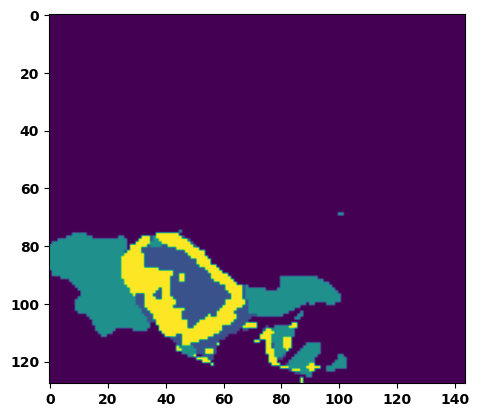

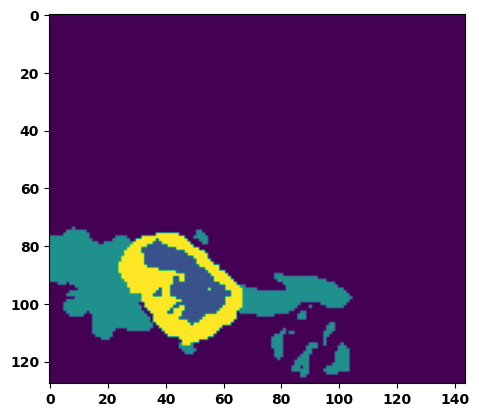

  6%|▌         | 2/36 [00:03<00:56,  1.66s/it]

Batch_id:  1 Eval loss:  0.26391682028770447
Batch_id:  1 Eval IoU:  tensor(0.6692, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:52,  1.58s/it]

Batch_id:  2 Eval loss:  0.27217280864715576
Batch_id:  2 Eval IoU:  tensor(0.6572, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9476, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9397, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


 11%|█         | 4/36 [00:06<00:50,  1.56s/it]

Batch_id:  3 Eval loss:  0.18405577540397644
Batch_id:  3 Eval IoU:  tensor(0.7735, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.47s/it]

Batch_id:  4 Eval loss:  0.2640033960342407
Batch_id:  4 Eval IoU:  tensor(0.6252, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9370, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9219, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9395, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9846, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:44,  1.49s/it]

Batch_id:  5 Eval loss:  0.25192558765411377
Batch_id:  5 Eval IoU:  tensor(0.6635, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9887, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.47s/it]

Batch_id:  6 Eval loss:  0.2322380691766739
Batch_id:  6 Eval IoU:  tensor(0.6759, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9882, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:42,  1.51s/it]

Batch_id:  7 Eval loss:  0.18160848319530487
Batch_id:  7 Eval IoU:  tensor(0.7373, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9921, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:42,  1.59s/it]

Batch_id:  8 Eval loss:  0.25361841917037964
Batch_id:  8 Eval IoU:  tensor(0.6703, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9886, device='cuda:0')


 28%|██▊       | 10/36 [00:15<00:39,  1.53s/it]

Batch_id:  9 Eval loss:  0.2739982008934021
Batch_id:  9 Eval IoU:  tensor(0.6383, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  10 Eval loss:  0.49157240986824036
Batch_id:  10 Eval IoU:  tensor(0.4452, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9286, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9465, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


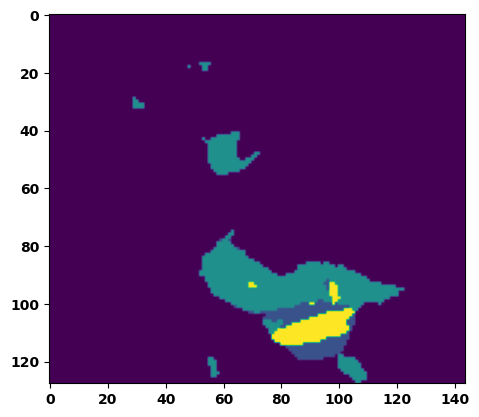

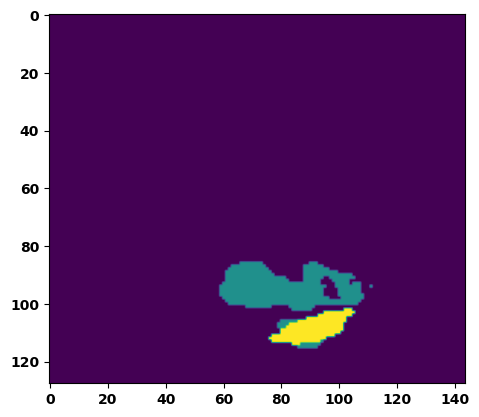

 33%|███▎      | 12/36 [00:18<00:38,  1.59s/it]

Batch_id:  11 Eval loss:  0.38972219824790955
Batch_id:  11 Eval IoU:  tensor(0.4964, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9246, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9235, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9887, device='cuda:0')


 36%|███▌      | 13/36 [00:20<00:34,  1.52s/it]

Batch_id:  12 Eval loss:  0.23364946246147156
Batch_id:  12 Eval IoU:  tensor(0.7248, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9965, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:34,  1.55s/it]

Batch_id:  13 Eval loss:  0.33962345123291016
Batch_id:  13 Eval IoU:  tensor(0.5697, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9863, device='cuda:0')


 42%|████▏     | 15/36 [00:23<00:31,  1.51s/it]

Batch_id:  14 Eval loss:  0.7250444889068604
Batch_id:  14 Eval IoU:  tensor(0.2390, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9147, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.8845, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9007, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:30,  1.51s/it]

Batch_id:  15 Eval loss:  0.16498439013957977
Batch_id:  15 Eval IoU:  tensor(0.7541, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9873, device='cuda:0')


 47%|████▋     | 17/36 [00:26<00:29,  1.55s/it]

Batch_id:  16 Eval loss:  0.4029900133609772
Batch_id:  16 Eval IoU:  tensor(0.5399, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9101, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.8701, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.8660, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 50%|█████     | 18/36 [00:27<00:27,  1.54s/it]

Batch_id:  17 Eval loss:  0.27134212851524353
Batch_id:  17 Eval IoU:  tensor(0.7089, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


 53%|█████▎    | 19/36 [00:29<00:25,  1.52s/it]

Batch_id:  18 Eval loss:  0.1621129959821701
Batch_id:  18 Eval IoU:  tensor(0.7958, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 56%|█████▌    | 20/36 [00:30<00:23,  1.48s/it]

Batch_id:  19 Eval loss:  0.15886910259723663
Batch_id:  19 Eval IoU:  tensor(0.7705, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  20 Eval loss:  0.2795334458351135
Batch_id:  20 Eval IoU:  tensor(0.6295, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9916, device='cuda:0')


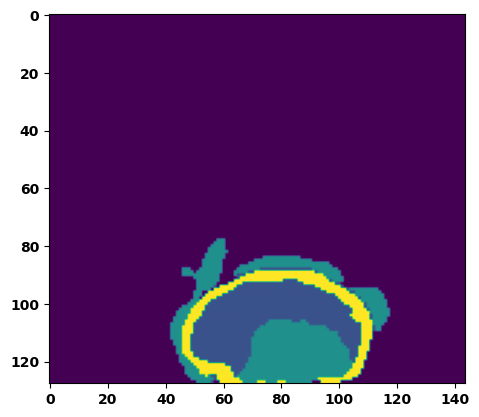

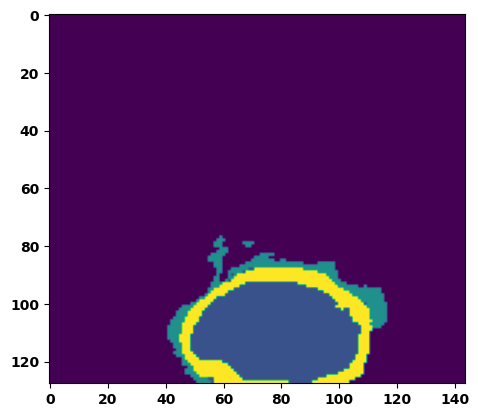

 61%|██████    | 22/36 [00:33<00:20,  1.47s/it]

Batch_id:  21 Eval loss:  0.2230866551399231
Batch_id:  21 Eval IoU:  tensor(0.7043, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.47s/it]

Batch_id:  22 Eval loss:  0.49246668815612793
Batch_id:  22 Eval IoU:  tensor(0.4288, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9814, device='cuda:0')


 67%|██████▋   | 24/36 [00:36<00:16,  1.41s/it]

Batch_id:  23 Eval loss:  0.3459794521331787
Batch_id:  23 Eval IoU:  tensor(0.5494, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9540, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9581, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:15,  1.44s/it]

Batch_id:  24 Eval loss:  0.17371766269207
Batch_id:  24 Eval IoU:  tensor(0.7632, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9404, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 72%|███████▏  | 26/36 [00:39<00:14,  1.43s/it]

Batch_id:  25 Eval loss:  0.10744553804397583
Batch_id:  25 Eval IoU:  tensor(0.8543, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:12,  1.42s/it]

Batch_id:  26 Eval loss:  0.15674425661563873
Batch_id:  26 Eval IoU:  tensor(0.7645, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9909, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.40s/it]

Batch_id:  27 Eval loss:  0.2277068942785263
Batch_id:  27 Eval IoU:  tensor(0.6894, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:09,  1.36s/it]

Batch_id:  28 Eval loss:  0.3348754048347473
Batch_id:  28 Eval IoU:  tensor(0.5903, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9948, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.37s/it]

Batch_id:  29 Eval loss:  0.13612055778503418
Batch_id:  29 Eval IoU:  tensor(0.7939, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  30 Eval loss:  0.19424156844615936
Batch_id:  30 Eval IoU:  tensor(0.7271, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9845, device='cuda:0')


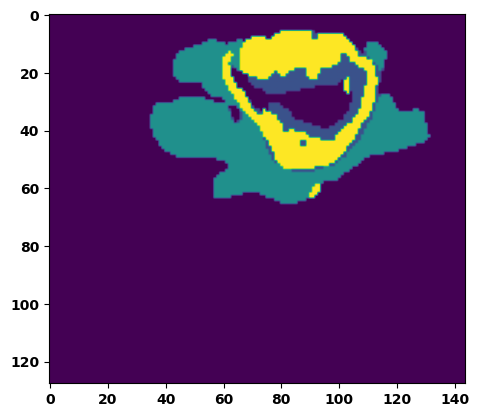

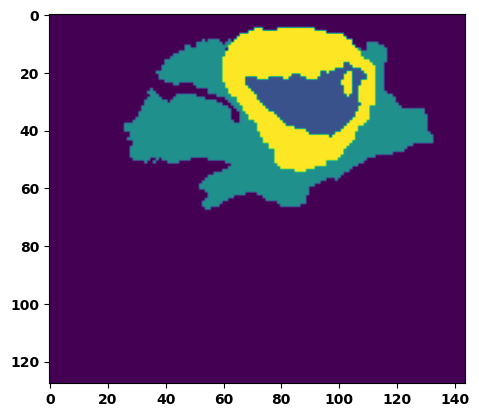

 89%|████████▉ | 32/36 [00:47<00:05,  1.40s/it]

Batch_id:  31 Eval loss:  0.39131516218185425
Batch_id:  31 Eval IoU:  tensor(0.5506, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9949, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.39s/it]

Batch_id:  32 Eval loss:  0.11366444826126099
Batch_id:  32 Eval IoU:  tensor(0.8438, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9772, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:02,  1.39s/it]

Batch_id:  33 Eval loss:  0.2610760033130646
Batch_id:  33 Eval IoU:  tensor(0.6816, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9935, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.41s/it]

Batch_id:  34 Eval loss:  0.4627951979637146
Batch_id:  34 Eval IoU:  tensor(0.4528, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9399, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9379, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')


100%|██████████| 36/36 [00:53<00:00,  1.47s/it]

Batch_id:  35 Eval loss:  0.1286841481924057
Batch_id:  35 Eval IoU:  tensor(0.8213, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')
Epoch  9 Training loss:  0.28130955506454813
Epoch  9 Evaluation loss:  0.2687227846019798
Epoch  9 Training accuracy :  tensor(0.6453)
Epoch  9 Evaluation accuracy :  tensor(0.6619)
Epoch  9 Training Mean Dice Score:  tensor(0.9674)
Epoch  9 Eval Mean Dice Score:  tensor(0.9669)
Epoch  9 Training Non-tumor Dice Score:  tensor(0.9727)
Epoch  9 Eval Non-tumor Dice Score:  tensor(0.9675)
Epoch  9 Training NCR/NET Dice Score:  tensor(0.9797)
Epoch  9 Eval NCR/NET Dice Score:  tensor(0.9813)
Epoch  9 Training ED Dice Score:  tensor(0.9618)
Epoch  

Epoch: 10
Training in session: 


  1%|          | 1/110 [00:01<02:25,  1.33s/it]

Batch_id:  0 Training loss:  0.5146783590316772
Batch_id:  0 Training IoU:  tensor(0.4275, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:36,  1.45s/it]

Batch_id:  1 Training loss:  0.1856483817100525
Batch_id:  1 Training IoU:  tensor(0.7329, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:34,  1.44s/it]

Batch_id:  2 Training loss:  0.13741986453533173
Batch_id:  2 Training IoU:  tensor(0.7965, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:31,  1.43s/it]

Batch_id:  3 Training loss:  0.21426278352737427
Batch_id:  3 Training IoU:  tensor(0.6898, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9815, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:28,  1.42s/it]

Batch_id:  4 Training loss:  0.27846208214759827
Batch_id:  4 Training IoU:  tensor(0.6677, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:31,  1.45s/it]

Batch_id:  5 Training loss:  0.18267208337783813
Batch_id:  5 Training IoU:  tensor(0.7523, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:28,  1.44s/it]

Batch_id:  6 Training loss:  0.361329048871994
Batch_id:  6 Training IoU:  tensor(0.6028, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9319, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:30,  1.48s/it]

Batch_id:  7 Training loss:  0.3666244149208069
Batch_id:  7 Training IoU:  tensor(0.5788, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:27,  1.46s/it]

Batch_id:  8 Training loss:  0.19982144236564636
Batch_id:  8 Training IoU:  tensor(0.7420, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:24,  1.44s/it]

Batch_id:  9 Training loss:  0.1683463454246521
Batch_id:  9 Training IoU:  tensor(0.7467, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9740, device='cuda:0')


 10%|█         | 11/110 [00:15<02:23,  1.45s/it]

Batch_id:  10 Training loss:  0.2668948173522949
Batch_id:  10 Training IoU:  tensor(0.6220, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9252, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9293, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9022, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 11%|█         | 12/110 [00:17<02:20,  1.43s/it]

Batch_id:  11 Training loss:  0.6054215431213379
Batch_id:  11 Training IoU:  tensor(0.3355, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9305, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:16,  1.40s/it]

Batch_id:  12 Training loss:  0.35778650641441345
Batch_id:  12 Training IoU:  tensor(0.5387, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9353, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9118, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:15,  1.41s/it]

Batch_id:  13 Training loss:  0.3436416983604431
Batch_id:  13 Training IoU:  tensor(0.5613, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:17,  1.44s/it]

Batch_id:  14 Training loss:  0.12429475784301758
Batch_id:  14 Training IoU:  tensor(0.8232, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:16,  1.45s/it]

Batch_id:  15 Training loss:  0.37751346826553345
Batch_id:  15 Training IoU:  tensor(0.5443, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:11,  1.42s/it]

Batch_id:  16 Training loss:  0.2563415765762329
Batch_id:  16 Training IoU:  tensor(0.6677, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 16%|█▋        | 18/110 [00:25<02:08,  1.40s/it]

Batch_id:  17 Training loss:  0.08754853904247284
Batch_id:  17 Training IoU:  tensor(0.8766, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:08,  1.42s/it]

Batch_id:  18 Training loss:  0.23341579735279083
Batch_id:  18 Training IoU:  tensor(0.6774, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:06,  1.41s/it]

Batch_id:  19 Training loss:  0.16174936294555664
Batch_id:  19 Training IoU:  tensor(0.7615, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9754, device='cuda:0')


 19%|█▉        | 21/110 [00:29<02:05,  1.41s/it]

Batch_id:  20 Training loss:  0.34038710594177246
Batch_id:  20 Training IoU:  tensor(0.5968, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 20%|██        | 22/110 [00:31<02:03,  1.41s/it]

Batch_id:  21 Training loss:  0.2930367588996887
Batch_id:  21 Training IoU:  tensor(0.6405, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 21%|██        | 23/110 [00:32<02:02,  1.41s/it]

Batch_id:  22 Training loss:  0.30211591720581055
Batch_id:  22 Training IoU:  tensor(0.5930, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9282, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9784, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:01,  1.42s/it]

Batch_id:  23 Training loss:  0.2783876359462738
Batch_id:  23 Training IoU:  tensor(0.6589, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 23%|██▎       | 25/110 [00:35<02:00,  1.42s/it]

Batch_id:  24 Training loss:  0.2994886636734009
Batch_id:  24 Training IoU:  tensor(0.6576, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:00,  1.43s/it]

Batch_id:  25 Training loss:  0.19559435546398163
Batch_id:  25 Training IoU:  tensor(0.7282, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 25%|██▍       | 27/110 [00:38<01:57,  1.41s/it]

Batch_id:  26 Training loss:  0.15741978585720062
Batch_id:  26 Training IoU:  tensor(0.7963, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 25%|██▌       | 28/110 [00:39<01:54,  1.40s/it]

Batch_id:  27 Training loss:  0.34612178802490234
Batch_id:  27 Training IoU:  tensor(0.5998, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 26%|██▋       | 29/110 [00:41<01:52,  1.39s/it]

Batch_id:  28 Training loss:  0.301518976688385
Batch_id:  28 Training IoU:  tensor(0.6574, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 27%|██▋       | 30/110 [00:42<01:52,  1.40s/it]

Batch_id:  29 Training loss:  0.47764113545417786
Batch_id:  29 Training IoU:  tensor(0.4420, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:56,  1.48s/it]

Batch_id:  30 Training loss:  0.07475404441356659
Batch_id:  30 Training IoU:  tensor(0.8937, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 29%|██▉       | 32/110 [00:45<01:54,  1.46s/it]

Batch_id:  31 Training loss:  0.22761517763137817
Batch_id:  31 Training IoU:  tensor(0.6843, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9557, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9758, device='cuda:0')


 30%|███       | 33/110 [00:47<01:51,  1.44s/it]

Batch_id:  32 Training loss:  0.20748566091060638
Batch_id:  32 Training IoU:  tensor(0.6935, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 31%|███       | 34/110 [00:48<01:48,  1.43s/it]

Batch_id:  33 Training loss:  0.16454818844795227
Batch_id:  33 Training IoU:  tensor(0.7527, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 32%|███▏      | 35/110 [00:49<01:47,  1.44s/it]

Batch_id:  34 Training loss:  0.14368672668933868
Batch_id:  34 Training IoU:  tensor(0.7936, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 33%|███▎      | 36/110 [00:51<01:43,  1.40s/it]

Batch_id:  35 Training loss:  0.27195966243743896
Batch_id:  35 Training IoU:  tensor(0.6426, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 34%|███▎      | 37/110 [00:52<01:40,  1.37s/it]

Batch_id:  36 Training loss:  0.24924466013908386
Batch_id:  36 Training IoU:  tensor(0.6850, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 35%|███▍      | 38/110 [00:54<01:40,  1.40s/it]

Batch_id:  37 Training loss:  0.2347293347120285
Batch_id:  37 Training IoU:  tensor(0.6716, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9800, device='cuda:0')


 35%|███▌      | 39/110 [00:55<01:39,  1.40s/it]

Batch_id:  38 Training loss:  0.32712793350219727
Batch_id:  38 Training IoU:  tensor(0.6262, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 36%|███▋      | 40/110 [00:56<01:38,  1.41s/it]

Batch_id:  39 Training loss:  0.46729421615600586
Batch_id:  39 Training IoU:  tensor(0.4481, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9391, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9350, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9229, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9767, device='cuda:0')


 37%|███▋      | 41/110 [00:58<01:37,  1.42s/it]

Batch_id:  40 Training loss:  0.2094607800245285
Batch_id:  40 Training IoU:  tensor(0.6978, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 38%|███▊      | 42/110 [00:59<01:37,  1.43s/it]

Batch_id:  41 Training loss:  0.265730082988739
Batch_id:  41 Training IoU:  tensor(0.6128, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9723, device='cuda:0')


 39%|███▉      | 43/110 [01:01<01:33,  1.40s/it]

Batch_id:  42 Training loss:  0.15781165659427643
Batch_id:  42 Training IoU:  tensor(0.7654, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 40%|████      | 44/110 [01:02<01:32,  1.40s/it]

Batch_id:  43 Training loss:  0.1963784247636795
Batch_id:  43 Training IoU:  tensor(0.7441, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 41%|████      | 45/110 [01:04<01:33,  1.44s/it]

Batch_id:  44 Training loss:  0.2348676174879074
Batch_id:  44 Training IoU:  tensor(0.6796, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 42%|████▏     | 46/110 [01:05<01:33,  1.45s/it]

Batch_id:  45 Training loss:  0.20434865355491638
Batch_id:  45 Training IoU:  tensor(0.7051, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 43%|████▎     | 47/110 [01:06<01:31,  1.45s/it]

Batch_id:  46 Training loss:  0.16341428458690643
Batch_id:  46 Training IoU:  tensor(0.7464, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9819, device='cuda:0')


 44%|████▎     | 48/110 [01:08<01:30,  1.45s/it]

Batch_id:  47 Training loss:  0.129170224070549
Batch_id:  47 Training IoU:  tensor(0.8167, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 45%|████▍     | 49/110 [01:09<01:28,  1.45s/it]

Batch_id:  48 Training loss:  0.21423019468784332
Batch_id:  48 Training IoU:  tensor(0.7028, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 45%|████▌     | 50/110 [01:11<01:24,  1.41s/it]

Batch_id:  49 Training loss:  0.2193179875612259
Batch_id:  49 Training IoU:  tensor(0.6961, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9814, device='cuda:0')


 46%|████▋     | 51/110 [01:12<01:20,  1.37s/it]

Batch_id:  50 Training loss:  0.14691400527954102
Batch_id:  50 Training IoU:  tensor(0.7761, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 47%|████▋     | 52/110 [01:13<01:21,  1.40s/it]

Batch_id:  51 Training loss:  0.22960129380226135
Batch_id:  51 Training IoU:  tensor(0.6690, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9815, device='cuda:0')


 48%|████▊     | 53/110 [01:15<01:17,  1.36s/it]

Batch_id:  52 Training loss:  0.2573569416999817
Batch_id:  52 Training IoU:  tensor(0.6407, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9209, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9696, device='cuda:0')


 49%|████▉     | 54/110 [01:16<01:17,  1.39s/it]

Batch_id:  53 Training loss:  0.2589206397533417
Batch_id:  53 Training IoU:  tensor(0.6530, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 50%|█████     | 55/110 [01:18<01:20,  1.46s/it]

Batch_id:  54 Training loss:  0.22558815777301788
Batch_id:  54 Training IoU:  tensor(0.7038, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 51%|█████     | 56/110 [01:19<01:17,  1.44s/it]

Batch_id:  55 Training loss:  0.323149174451828
Batch_id:  55 Training IoU:  tensor(0.5743, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 52%|█████▏    | 57/110 [01:21<01:18,  1.48s/it]

Batch_id:  56 Training loss:  0.08766566216945648
Batch_id:  56 Training IoU:  tensor(0.8692, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 53%|█████▎    | 58/110 [01:22<01:15,  1.45s/it]

Batch_id:  57 Training loss:  0.25758442282676697
Batch_id:  57 Training IoU:  tensor(0.6591, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 54%|█████▎    | 59/110 [01:23<01:11,  1.41s/it]

Batch_id:  58 Training loss:  0.20240503549575806
Batch_id:  58 Training IoU:  tensor(0.7386, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 55%|█████▍    | 60/110 [01:25<01:09,  1.40s/it]

Batch_id:  59 Training loss:  0.26294785737991333
Batch_id:  59 Training IoU:  tensor(0.6764, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 55%|█████▌    | 61/110 [01:26<01:08,  1.41s/it]

Batch_id:  60 Training loss:  0.4564092457294464
Batch_id:  60 Training IoU:  tensor(0.4429, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9042, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9382, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9098, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9069, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9577, device='cuda:0')


 56%|█████▋    | 62/110 [01:28<01:07,  1.41s/it]

Batch_id:  61 Training loss:  0.28347188234329224
Batch_id:  61 Training IoU:  tensor(0.6222, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


 57%|█████▋    | 63/110 [01:29<01:05,  1.39s/it]

Batch_id:  62 Training loss:  0.1779586225748062
Batch_id:  62 Training IoU:  tensor(0.7320, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9450, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9378, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 58%|█████▊    | 64/110 [01:31<01:05,  1.43s/it]

Batch_id:  63 Training loss:  0.4681819975376129
Batch_id:  63 Training IoU:  tensor(0.4268, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9184, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9195, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9397, device='cuda:0')


 59%|█████▉    | 65/110 [01:32<01:04,  1.43s/it]

Batch_id:  64 Training loss:  0.21295376121997833
Batch_id:  64 Training IoU:  tensor(0.7066, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 60%|██████    | 66/110 [01:34<01:04,  1.47s/it]

Batch_id:  65 Training loss:  0.5953484773635864
Batch_id:  65 Training IoU:  tensor(0.3456, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 61%|██████    | 67/110 [01:35<01:01,  1.42s/it]

Batch_id:  66 Training loss:  0.18721255660057068
Batch_id:  66 Training IoU:  tensor(0.7395, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 62%|██████▏   | 68/110 [01:36<01:00,  1.44s/it]

Batch_id:  67 Training loss:  0.2318660467863083
Batch_id:  67 Training IoU:  tensor(0.7129, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 63%|██████▎   | 69/110 [01:38<00:58,  1.43s/it]

Batch_id:  68 Training loss:  0.22485949099063873
Batch_id:  68 Training IoU:  tensor(0.6704, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9326, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9097, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9290, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9705, device='cuda:0')


 64%|██████▎   | 70/110 [01:39<00:57,  1.45s/it]

Batch_id:  69 Training loss:  0.16106125712394714
Batch_id:  69 Training IoU:  tensor(0.7581, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9809, device='cuda:0')


 65%|██████▍   | 71/110 [01:41<00:55,  1.43s/it]

Batch_id:  70 Training loss:  0.3864172399044037
Batch_id:  70 Training IoU:  tensor(0.5429, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9441, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9173, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 65%|██████▌   | 72/110 [01:42<00:54,  1.43s/it]

Batch_id:  71 Training loss:  0.34569674730300903
Batch_id:  71 Training IoU:  tensor(0.5629, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9766, device='cuda:0')


 66%|██████▋   | 73/110 [01:44<00:54,  1.46s/it]

Batch_id:  72 Training loss:  0.34850746393203735
Batch_id:  72 Training IoU:  tensor(0.6129, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 67%|██████▋   | 74/110 [01:45<00:54,  1.51s/it]

Batch_id:  73 Training loss:  0.24337038397789001
Batch_id:  73 Training IoU:  tensor(0.6760, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 68%|██████▊   | 75/110 [01:47<00:52,  1.49s/it]

Batch_id:  74 Training loss:  0.18109749257564545
Batch_id:  74 Training IoU:  tensor(0.7509, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 69%|██████▉   | 76/110 [01:48<00:50,  1.49s/it]

Batch_id:  75 Training loss:  0.13567078113555908
Batch_id:  75 Training IoU:  tensor(0.8234, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 70%|███████   | 77/110 [01:50<00:49,  1.49s/it]

Batch_id:  76 Training loss:  0.24319539964199066
Batch_id:  76 Training IoU:  tensor(0.6939, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 71%|███████   | 78/110 [01:51<00:45,  1.43s/it]

Batch_id:  77 Training loss:  0.4551467299461365
Batch_id:  77 Training IoU:  tensor(0.5112, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 72%|███████▏  | 79/110 [01:52<00:43,  1.39s/it]

Batch_id:  78 Training loss:  0.3488515317440033
Batch_id:  78 Training IoU:  tensor(0.5412, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9696, device='cuda:0')


 73%|███████▎  | 80/110 [01:54<00:41,  1.37s/it]

Batch_id:  79 Training loss:  0.4110894203186035
Batch_id:  79 Training IoU:  tensor(0.4986, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 74%|███████▎  | 81/110 [01:55<00:39,  1.36s/it]

Batch_id:  80 Training loss:  0.1556028127670288
Batch_id:  80 Training IoU:  tensor(0.7760, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 75%|███████▍  | 82/110 [01:56<00:38,  1.36s/it]

Batch_id:  81 Training loss:  0.33665186166763306
Batch_id:  81 Training IoU:  tensor(0.5457, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9181, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9397, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9391, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9092, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9662, device='cuda:0')


 75%|███████▌  | 83/110 [01:58<00:37,  1.40s/it]

Batch_id:  82 Training loss:  0.17755043506622314
Batch_id:  82 Training IoU:  tensor(0.7363, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 76%|███████▋  | 84/110 [01:59<00:37,  1.42s/it]

Batch_id:  83 Training loss:  0.3784957230091095
Batch_id:  83 Training IoU:  tensor(0.5110, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9304, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 77%|███████▋  | 85/110 [02:01<00:35,  1.42s/it]

Batch_id:  84 Training loss:  0.16730159521102905
Batch_id:  84 Training IoU:  tensor(0.7471, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 78%|███████▊  | 86/110 [02:02<00:33,  1.40s/it]

Batch_id:  85 Training loss:  0.2590731978416443
Batch_id:  85 Training IoU:  tensor(0.6900, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 79%|███████▉  | 87/110 [02:04<00:33,  1.48s/it]

Batch_id:  86 Training loss:  0.1386297196149826
Batch_id:  86 Training IoU:  tensor(0.7975, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 80%|████████  | 88/110 [02:05<00:32,  1.48s/it]

Batch_id:  87 Training loss:  0.09486976265907288
Batch_id:  87 Training IoU:  tensor(0.8677, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 81%|████████  | 89/110 [02:07<00:32,  1.54s/it]

Batch_id:  88 Training loss:  0.20787236094474792
Batch_id:  88 Training IoU:  tensor(0.7327, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 82%|████████▏ | 90/110 [02:08<00:30,  1.50s/it]

Batch_id:  89 Training loss:  0.22141380608081818
Batch_id:  89 Training IoU:  tensor(0.7001, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 83%|████████▎ | 91/110 [02:10<00:28,  1.48s/it]

Batch_id:  90 Training loss:  0.32806071639060974
Batch_id:  90 Training IoU:  tensor(0.6109, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 84%|████████▎ | 92/110 [02:11<00:26,  1.45s/it]

Batch_id:  91 Training loss:  0.26992741227149963
Batch_id:  91 Training IoU:  tensor(0.6553, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 85%|████████▍ | 93/110 [02:12<00:24,  1.44s/it]

Batch_id:  92 Training loss:  0.17291077971458435
Batch_id:  92 Training IoU:  tensor(0.7403, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 85%|████████▌ | 94/110 [02:14<00:22,  1.43s/it]

Batch_id:  93 Training loss:  0.11904838681221008
Batch_id:  93 Training IoU:  tensor(0.8226, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 86%|████████▋ | 95/110 [02:15<00:22,  1.47s/it]

Batch_id:  94 Training loss:  0.29388904571533203
Batch_id:  94 Training IoU:  tensor(0.5965, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9274, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9301, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9036, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9816, device='cuda:0')


 87%|████████▋ | 96/110 [02:17<00:20,  1.47s/it]

Batch_id:  95 Training loss:  0.28716135025024414
Batch_id:  95 Training IoU:  tensor(0.6595, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 88%|████████▊ | 97/110 [02:18<00:18,  1.45s/it]

Batch_id:  96 Training loss:  0.4246503710746765
Batch_id:  96 Training IoU:  tensor(0.4804, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 89%|████████▉ | 98/110 [02:20<00:18,  1.55s/it]

Batch_id:  97 Training loss:  0.16328398883342743
Batch_id:  97 Training IoU:  tensor(0.7646, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 90%|█████████ | 99/110 [02:21<00:16,  1.51s/it]

Batch_id:  98 Training loss:  0.23687507212162018
Batch_id:  98 Training IoU:  tensor(0.6794, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 91%|█████████ | 100/110 [02:23<00:14,  1.46s/it]

Batch_id:  99 Training loss:  0.18505194783210754
Batch_id:  99 Training IoU:  tensor(0.7867, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 92%|█████████▏| 101/110 [02:24<00:12,  1.41s/it]

Batch_id:  100 Training loss:  0.6112796664237976
Batch_id:  100 Training IoU:  tensor(0.3264, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9346, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9134, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9282, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 93%|█████████▎| 102/110 [02:26<00:11,  1.44s/it]

Batch_id:  101 Training loss:  0.3460752069950104
Batch_id:  101 Training IoU:  tensor(0.5378, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9305, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9802, device='cuda:0')


 94%|█████████▎| 103/110 [02:27<00:10,  1.44s/it]

Batch_id:  102 Training loss:  0.43356478214263916
Batch_id:  102 Training IoU:  tensor(0.4867, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 95%|█████████▍| 104/110 [02:29<00:08,  1.46s/it]

Batch_id:  103 Training loss:  0.12028221786022186
Batch_id:  103 Training IoU:  tensor(0.8166, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 95%|█████████▌| 105/110 [02:30<00:07,  1.43s/it]

Batch_id:  104 Training loss:  0.31857940554618835
Batch_id:  104 Training IoU:  tensor(0.6332, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 96%|█████████▋| 106/110 [02:31<00:05,  1.44s/it]

Batch_id:  105 Training loss:  0.12440863251686096
Batch_id:  105 Training IoU:  tensor(0.8207, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 97%|█████████▋| 107/110 [02:33<00:04,  1.43s/it]

Batch_id:  106 Training loss:  0.6197792887687683
Batch_id:  106 Training IoU:  tensor(0.3065, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.8917, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.8710, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.8418, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 98%|█████████▊| 108/110 [02:34<00:02,  1.40s/it]

Batch_id:  107 Training loss:  0.1447264403104782
Batch_id:  107 Training IoU:  tensor(0.8058, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 99%|█████████▉| 109/110 [02:36<00:01,  1.43s/it]

Batch_id:  108 Training loss:  0.5263816118240356
Batch_id:  108 Training IoU:  tensor(0.3810, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.8961, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9107, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9140, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.8729, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


100%|██████████| 110/110 [02:37<00:00,  1.43s/it]


Batch_id:  109 Training loss:  0.27496975660324097
Batch_id:  109 Training IoU:  tensor(0.6413, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9887, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.3802545666694641
Batch_id:  0 Eval IoU:  tensor(0.5178, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9434, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9569, device='cuda:0')


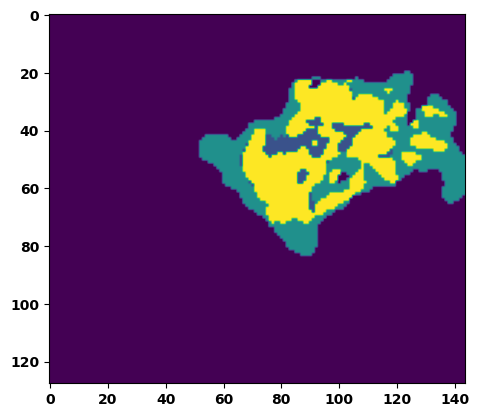

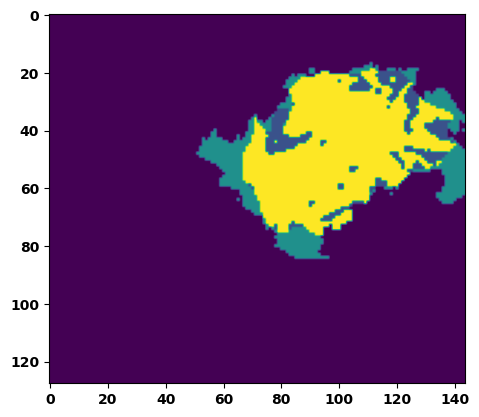

  6%|▌         | 2/36 [00:03<00:51,  1.50s/it]

Batch_id:  1 Eval loss:  0.17700107395648956
Batch_id:  1 Eval IoU:  tensor(0.7486, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9949, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:47,  1.43s/it]

Batch_id:  2 Eval loss:  0.2915591597557068
Batch_id:  2 Eval IoU:  tensor(0.6635, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 11%|█         | 4/36 [00:05<00:46,  1.44s/it]

Batch_id:  3 Eval loss:  0.11074626445770264
Batch_id:  3 Eval IoU:  tensor(0.8240, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.45s/it]

Batch_id:  4 Eval loss:  0.26239997148513794
Batch_id:  4 Eval IoU:  tensor(0.6549, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9476, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:43,  1.46s/it]

Batch_id:  5 Eval loss:  0.26977062225341797
Batch_id:  5 Eval IoU:  tensor(0.6125, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9338, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9116, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9355, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9850, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:43,  1.51s/it]

Batch_id:  6 Eval loss:  0.11140091717243195
Batch_id:  6 Eval IoU:  tensor(0.8461, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9948, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:41,  1.48s/it]

Batch_id:  7 Eval loss:  0.5590927600860596
Batch_id:  7 Eval IoU:  tensor(0.4451, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9277, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9206, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9271, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9362, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9992, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:40,  1.50s/it]

Batch_id:  8 Eval loss:  0.16800178587436676
Batch_id:  8 Eval IoU:  tensor(0.7437, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9844, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:39,  1.53s/it]

Batch_id:  9 Eval loss:  0.3654738962650299
Batch_id:  9 Eval IoU:  tensor(0.5737, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  10 Eval loss:  0.1392255574464798
Batch_id:  10 Eval IoU:  tensor(0.8527, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9980, device='cuda:0')


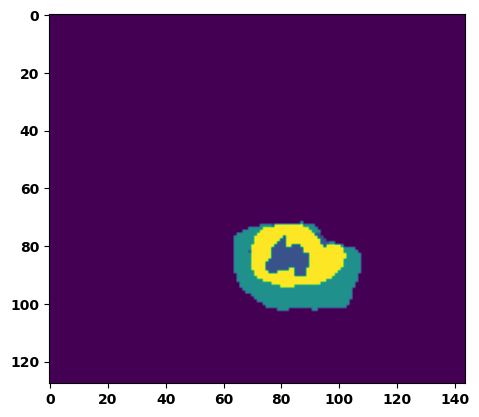

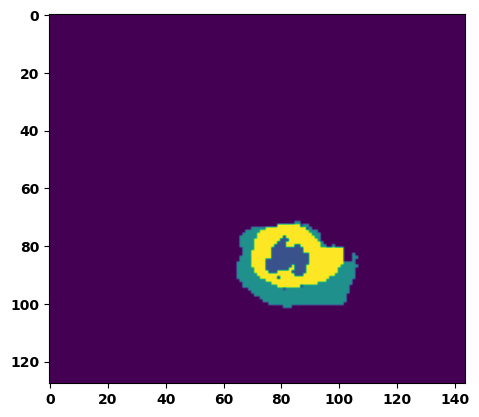

 33%|███▎      | 12/36 [00:17<00:36,  1.51s/it]

Batch_id:  11 Eval loss:  0.2531808614730835
Batch_id:  11 Eval IoU:  tensor(0.6993, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.48s/it]

Batch_id:  12 Eval loss:  0.14137542247772217
Batch_id:  12 Eval IoU:  tensor(0.7937, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:32,  1.47s/it]

Batch_id:  13 Eval loss:  0.09964874386787415
Batch_id:  13 Eval IoU:  tensor(0.8504, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:30,  1.44s/it]

Batch_id:  14 Eval loss:  0.18152523040771484
Batch_id:  14 Eval IoU:  tensor(0.7599, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9281, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9257, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.49s/it]

Batch_id:  15 Eval loss:  0.14445723593235016
Batch_id:  15 Eval IoU:  tensor(0.7802, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9933, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:28,  1.51s/it]

Batch_id:  16 Eval loss:  0.5269772410392761
Batch_id:  16 Eval IoU:  tensor(0.4039, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.47s/it]

Batch_id:  17 Eval loss:  0.2142203450202942
Batch_id:  17 Eval IoU:  tensor(0.7357, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:25,  1.48s/it]

Batch_id:  18 Eval loss:  0.4053646922111511
Batch_id:  18 Eval IoU:  tensor(0.4811, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9219, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9172, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.47s/it]

Batch_id:  19 Eval loss:  0.21604813635349274
Batch_id:  19 Eval IoU:  tensor(0.6902, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  20 Eval loss:  0.2307024747133255
Batch_id:  20 Eval IoU:  tensor(0.6852, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


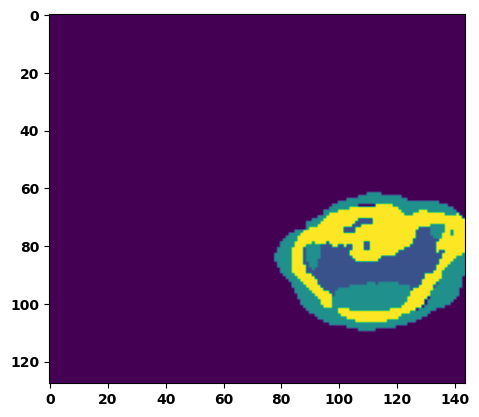

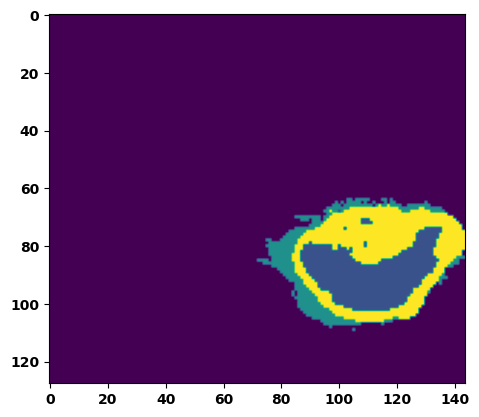

 61%|██████    | 22/36 [00:32<00:21,  1.53s/it]

Batch_id:  21 Eval loss:  0.21668414771556854
Batch_id:  21 Eval IoU:  tensor(0.7022, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.52s/it]

Batch_id:  22 Eval loss:  0.13557471334934235
Batch_id:  22 Eval IoU:  tensor(0.7905, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.49s/it]

Batch_id:  23 Eval loss:  0.21513710916042328
Batch_id:  23 Eval IoU:  tensor(0.6919, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9826, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:16,  1.50s/it]

Batch_id:  24 Eval loss:  0.17364783585071564
Batch_id:  24 Eval IoU:  tensor(0.7592, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.47s/it]

Batch_id:  25 Eval loss:  0.10481053590774536
Batch_id:  25 Eval IoU:  tensor(0.8444, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9777, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:13,  1.45s/it]

Batch_id:  26 Eval loss:  0.29049813747406006
Batch_id:  26 Eval IoU:  tensor(0.6391, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9957, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.47s/it]

Batch_id:  27 Eval loss:  0.29231125116348267
Batch_id:  27 Eval IoU:  tensor(0.6088, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9425, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:10,  1.52s/it]

Batch_id:  28 Eval loss:  0.346084326505661
Batch_id:  28 Eval IoU:  tensor(0.5617, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9861, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:09,  1.56s/it]

Batch_id:  29 Eval loss:  0.2659514546394348
Batch_id:  29 Eval IoU:  tensor(0.6536, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  30 Eval loss:  0.7406373023986816
Batch_id:  30 Eval IoU:  tensor(0.2351, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9213, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.8945, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9042, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9910, device='cuda:0')


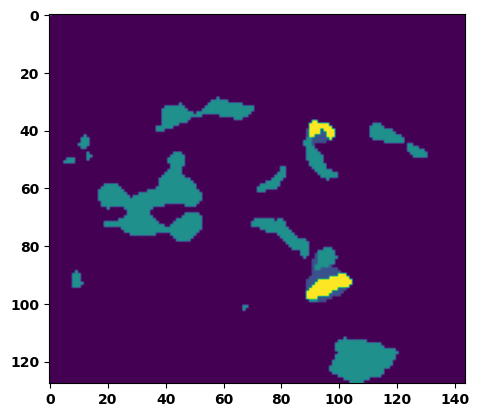

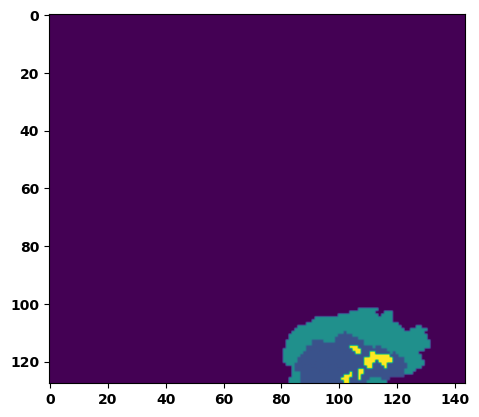

 89%|████████▉ | 32/36 [00:48<00:06,  1.62s/it]

Batch_id:  31 Eval loss:  0.18997660279273987
Batch_id:  31 Eval IoU:  tensor(0.7896, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9974, device='cuda:0')


 92%|█████████▏| 33/36 [00:49<00:04,  1.61s/it]

Batch_id:  32 Eval loss:  0.4050210416316986
Batch_id:  32 Eval IoU:  tensor(0.5355, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9078, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.8643, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.8623, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9987, device='cuda:0')


 94%|█████████▍| 34/36 [00:51<00:03,  1.60s/it]

Batch_id:  33 Eval loss:  0.13345623016357422
Batch_id:  33 Eval IoU:  tensor(0.8237, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 97%|█████████▋| 35/36 [00:52<00:01,  1.58s/it]

Batch_id:  34 Eval loss:  0.45501187443733215
Batch_id:  34 Eval IoU:  tensor(0.4941, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


100%|██████████| 36/36 [00:54<00:00,  1.51s/it]

Batch_id:  35 Eval loss:  0.11330047249794006
Batch_id:  35 Eval IoU:  tensor(0.8364, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')
Epoch  10 Training loss:  0.26606934165412727
Epoch  10 Evaluation loss:  0.2590702776279714
Epoch  10 Training accuracy :  tensor(0.6596)
Epoch  10 Evaluation accuracy :  tensor(0.6758)
Epoch  10 Training Mean Dice Score:  tensor(0.9682)
Epoch  10 Eval Mean Dice Score:  tensor(0.9677)
Epoch  10 Training Non-tumor Dice Score:  tensor(0.9729)
Epoch  10 Eval Non-tumor Dice Score:  tensor(0.9669)
Epoch  10 Training NCR/NET Dice Score:  tensor(0.9801)
Epoch  10 Eval NCR/NET Dice Score:  tensor(0.9840)
Epoch  10 Training ED Dice Score:  tensor(0.9

Epoch: 11
Training in session: 


  1%|          | 1/110 [00:01<02:47,  1.54s/it]

Batch_id:  0 Training loss:  0.21914468705654144
Batch_id:  0 Training IoU:  tensor(0.7280, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:42,  1.51s/it]

Batch_id:  1 Training loss:  0.29742997884750366
Batch_id:  1 Training IoU:  tensor(0.6037, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9308, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:44,  1.54s/it]

Batch_id:  2 Training loss:  0.24583689868450165
Batch_id:  2 Training IoU:  tensor(0.6386, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9714, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:42,  1.53s/it]

Batch_id:  3 Training loss:  0.25657886266708374
Batch_id:  3 Training IoU:  tensor(0.6219, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9308, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9150, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9769, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:35,  1.48s/it]

Batch_id:  4 Training loss:  0.24516917765140533
Batch_id:  4 Training IoU:  tensor(0.7053, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:34,  1.48s/it]

Batch_id:  5 Training loss:  0.22637887299060822
Batch_id:  5 Training IoU:  tensor(0.6850, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:32,  1.48s/it]

Batch_id:  6 Training loss:  0.17838247120380402
Batch_id:  6 Training IoU:  tensor(0.7240, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9699, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:22,  1.40s/it]

Batch_id:  7 Training loss:  0.08234083652496338
Batch_id:  7 Training IoU:  tensor(0.8810, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:23,  1.42s/it]

Batch_id:  8 Training loss:  0.3495737910270691
Batch_id:  8 Training IoU:  tensor(0.5350, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9729, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:19,  1.40s/it]

Batch_id:  9 Training loss:  0.26220422983169556
Batch_id:  9 Training IoU:  tensor(0.6520, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9428, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9803, device='cuda:0')


 10%|█         | 11/110 [00:15<02:20,  1.42s/it]

Batch_id:  10 Training loss:  0.2038373351097107
Batch_id:  10 Training IoU:  tensor(0.7370, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 11%|█         | 12/110 [00:17<02:17,  1.41s/it]

Batch_id:  11 Training loss:  0.0944402664899826
Batch_id:  11 Training IoU:  tensor(0.8597, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:17,  1.42s/it]

Batch_id:  12 Training loss:  0.14288589358329773
Batch_id:  12 Training IoU:  tensor(0.7963, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9844, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:16,  1.42s/it]

Batch_id:  13 Training loss:  0.3225935399532318
Batch_id:  13 Training IoU:  tensor(0.6043, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:16,  1.44s/it]

Batch_id:  14 Training loss:  0.20461505651474
Batch_id:  14 Training IoU:  tensor(0.7193, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:13,  1.42s/it]

Batch_id:  15 Training loss:  0.17644217610359192
Batch_id:  15 Training IoU:  tensor(0.7332, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:14,  1.45s/it]

Batch_id:  16 Training loss:  0.14039090275764465
Batch_id:  16 Training IoU:  tensor(0.8126, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 16%|█▋        | 18/110 [00:25<02:10,  1.42s/it]

Batch_id:  17 Training loss:  0.5293805599212646
Batch_id:  17 Training IoU:  tensor(0.3932, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:08,  1.41s/it]

Batch_id:  18 Training loss:  0.3229038715362549
Batch_id:  18 Training IoU:  tensor(0.5625, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9256, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9459, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9204, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9684, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:06,  1.41s/it]

Batch_id:  19 Training loss:  0.3181764483451843
Batch_id:  19 Training IoU:  tensor(0.6295, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:06,  1.42s/it]

Batch_id:  20 Training loss:  0.20758159458637238
Batch_id:  20 Training IoU:  tensor(0.6924, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 20%|██        | 22/110 [00:31<02:06,  1.43s/it]

Batch_id:  21 Training loss:  0.08311764895915985
Batch_id:  21 Training IoU:  tensor(0.9015, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 21%|██        | 23/110 [00:33<02:06,  1.45s/it]

Batch_id:  22 Training loss:  0.2131800353527069
Batch_id:  22 Training IoU:  tensor(0.7212, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:03,  1.44s/it]

Batch_id:  23 Training loss:  0.2977568507194519
Batch_id:  23 Training IoU:  tensor(0.6458, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 23%|██▎       | 25/110 [00:35<02:00,  1.42s/it]

Batch_id:  24 Training loss:  0.5182307362556458
Batch_id:  24 Training IoU:  tensor(0.3992, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9229, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9106, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.8866, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 24%|██▎       | 26/110 [00:37<01:58,  1.41s/it]

Batch_id:  25 Training loss:  0.3272895812988281
Batch_id:  25 Training IoU:  tensor(0.6240, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 25%|██▍       | 27/110 [00:38<01:53,  1.37s/it]

Batch_id:  26 Training loss:  0.24201245605945587
Batch_id:  26 Training IoU:  tensor(0.6525, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


 25%|██▌       | 28/110 [00:40<01:53,  1.39s/it]

Batch_id:  27 Training loss:  0.18266154825687408
Batch_id:  27 Training IoU:  tensor(0.7310, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9831, device='cuda:0')


 26%|██▋       | 29/110 [00:41<01:55,  1.42s/it]

Batch_id:  28 Training loss:  0.12212271988391876
Batch_id:  28 Training IoU:  tensor(0.8199, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 27%|██▋       | 30/110 [00:42<01:54,  1.43s/it]

Batch_id:  29 Training loss:  0.19116848707199097
Batch_id:  29 Training IoU:  tensor(0.7133, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:52,  1.43s/it]

Batch_id:  30 Training loss:  0.2743668854236603
Batch_id:  30 Training IoU:  tensor(0.6423, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 29%|██▉       | 32/110 [00:45<01:50,  1.42s/it]

Batch_id:  31 Training loss:  0.3893539011478424
Batch_id:  31 Training IoU:  tensor(0.5512, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 30%|███       | 33/110 [00:47<01:47,  1.40s/it]

Batch_id:  32 Training loss:  0.2833632230758667
Batch_id:  32 Training IoU:  tensor(0.6193, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 31%|███       | 34/110 [00:48<01:48,  1.43s/it]

Batch_id:  33 Training loss:  0.42423325777053833
Batch_id:  33 Training IoU:  tensor(0.4923, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9457, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9281, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:50,  1.47s/it]

Batch_id:  34 Training loss:  0.37391117215156555
Batch_id:  34 Training IoU:  tensor(0.5442, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 33%|███▎      | 36/110 [00:51<01:46,  1.44s/it]

Batch_id:  35 Training loss:  0.23888616263866425
Batch_id:  35 Training IoU:  tensor(0.6741, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:47,  1.47s/it]

Batch_id:  36 Training loss:  0.40755850076675415
Batch_id:  36 Training IoU:  tensor(0.4885, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9291, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9171, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9453, device='cuda:0')


 35%|███▍      | 38/110 [00:54<01:42,  1.42s/it]

Batch_id:  37 Training loss:  0.20024046301841736
Batch_id:  37 Training IoU:  tensor(0.7123, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9785, device='cuda:0')


 35%|███▌      | 39/110 [00:55<01:43,  1.46s/it]

Batch_id:  38 Training loss:  0.23180459439754486
Batch_id:  38 Training IoU:  tensor(0.6884, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 36%|███▋      | 40/110 [00:57<01:41,  1.44s/it]

Batch_id:  39 Training loss:  0.20113208889961243
Batch_id:  39 Training IoU:  tensor(0.7106, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 37%|███▋      | 41/110 [00:58<01:37,  1.41s/it]

Batch_id:  40 Training loss:  0.2709887623786926
Batch_id:  40 Training IoU:  tensor(0.6345, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 38%|███▊      | 42/110 [01:00<01:35,  1.41s/it]

Batch_id:  41 Training loss:  0.22376088798046112
Batch_id:  41 Training IoU:  tensor(0.7413, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 39%|███▉      | 43/110 [01:01<01:35,  1.43s/it]

Batch_id:  42 Training loss:  0.2251025140285492
Batch_id:  42 Training IoU:  tensor(0.6849, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9791, device='cuda:0')


 40%|████      | 44/110 [01:03<01:36,  1.47s/it]

Batch_id:  43 Training loss:  0.30120009183883667
Batch_id:  43 Training IoU:  tensor(0.5766, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 41%|████      | 45/110 [01:04<01:33,  1.44s/it]

Batch_id:  44 Training loss:  0.13086189329624176
Batch_id:  44 Training IoU:  tensor(0.7972, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:33,  1.46s/it]

Batch_id:  45 Training loss:  0.23539617657661438
Batch_id:  45 Training IoU:  tensor(0.6675, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 43%|████▎     | 47/110 [01:07<01:30,  1.44s/it]

Batch_id:  46 Training loss:  0.25527992844581604
Batch_id:  46 Training IoU:  tensor(0.6847, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 44%|████▎     | 48/110 [01:08<01:30,  1.45s/it]

Batch_id:  47 Training loss:  0.2574657201766968
Batch_id:  47 Training IoU:  tensor(0.6341, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9783, device='cuda:0')


 45%|████▍     | 49/110 [01:10<01:28,  1.46s/it]

Batch_id:  48 Training loss:  0.4178122282028198
Batch_id:  48 Training IoU:  tensor(0.5001, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 45%|████▌     | 50/110 [01:11<01:26,  1.44s/it]

Batch_id:  49 Training loss:  0.38467276096343994
Batch_id:  49 Training IoU:  tensor(0.5434, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9294, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 46%|████▋     | 51/110 [01:13<01:26,  1.46s/it]

Batch_id:  50 Training loss:  0.3663637042045593
Batch_id:  50 Training IoU:  tensor(0.5237, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9280, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9332, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9054, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 47%|████▋     | 52/110 [01:14<01:25,  1.47s/it]

Batch_id:  51 Training loss:  0.28909018635749817
Batch_id:  51 Training IoU:  tensor(0.6123, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:24,  1.48s/it]

Batch_id:  52 Training loss:  0.19429577887058258
Batch_id:  52 Training IoU:  tensor(0.7376, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 49%|████▉     | 54/110 [01:17<01:22,  1.48s/it]

Batch_id:  53 Training loss:  0.30297261476516724
Batch_id:  53 Training IoU:  tensor(0.5777, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9173, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9119, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9074, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9528, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:19,  1.45s/it]

Batch_id:  54 Training loss:  0.22894366085529327
Batch_id:  54 Training IoU:  tensor(0.6777, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9801, device='cuda:0')


 51%|█████     | 56/110 [01:20<01:18,  1.46s/it]

Batch_id:  55 Training loss:  0.12585215270519257
Batch_id:  55 Training IoU:  tensor(0.8115, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 52%|█████▏    | 57/110 [01:21<01:15,  1.43s/it]

Batch_id:  56 Training loss:  0.48401543498039246
Batch_id:  56 Training IoU:  tensor(0.4354, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 53%|█████▎    | 58/110 [01:23<01:15,  1.45s/it]

Batch_id:  57 Training loss:  0.158839613199234
Batch_id:  57 Training IoU:  tensor(0.7613, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 54%|█████▎    | 59/110 [01:24<01:13,  1.43s/it]

Batch_id:  58 Training loss:  0.1760224997997284
Batch_id:  58 Training IoU:  tensor(0.7533, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 55%|█████▍    | 60/110 [01:26<01:12,  1.46s/it]

Batch_id:  59 Training loss:  0.08829282224178314
Batch_id:  59 Training IoU:  tensor(0.8660, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 55%|█████▌    | 61/110 [01:27<01:11,  1.45s/it]

Batch_id:  60 Training loss:  0.5435712337493896
Batch_id:  60 Training IoU:  tensor(0.3909, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 56%|█████▋    | 62/110 [01:29<01:09,  1.45s/it]

Batch_id:  61 Training loss:  0.28154170513153076
Batch_id:  61 Training IoU:  tensor(0.6681, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 57%|█████▋    | 63/110 [01:30<01:07,  1.44s/it]

Batch_id:  62 Training loss:  0.14183154702186584
Batch_id:  62 Training IoU:  tensor(0.7936, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 58%|█████▊    | 64/110 [01:32<01:05,  1.43s/it]

Batch_id:  63 Training loss:  0.17270807921886444
Batch_id:  63 Training IoU:  tensor(0.7693, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 59%|█████▉    | 65/110 [01:33<01:02,  1.40s/it]

Batch_id:  64 Training loss:  0.2960395812988281
Batch_id:  64 Training IoU:  tensor(0.5966, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9379, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9809, device='cuda:0')


 60%|██████    | 66/110 [01:34<01:02,  1.41s/it]

Batch_id:  65 Training loss:  0.16831448674201965
Batch_id:  65 Training IoU:  tensor(0.7745, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 61%|██████    | 67/110 [01:36<00:59,  1.39s/it]

Batch_id:  66 Training loss:  0.42709672451019287
Batch_id:  66 Training IoU:  tensor(0.4902, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9164, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9494, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9222, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9042, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9734, device='cuda:0')


 62%|██████▏   | 68/110 [01:37<01:00,  1.43s/it]

Batch_id:  67 Training loss:  0.33000707626342773
Batch_id:  67 Training IoU:  tensor(0.5633, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9810, device='cuda:0')


 63%|██████▎   | 69/110 [01:39<01:00,  1.48s/it]

Batch_id:  68 Training loss:  0.29185056686401367
Batch_id:  68 Training IoU:  tensor(0.5894, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9180, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9128, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.8873, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 64%|██████▎   | 70/110 [01:40<00:59,  1.49s/it]

Batch_id:  69 Training loss:  0.11131060123443604
Batch_id:  69 Training IoU:  tensor(0.8346, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 65%|██████▍   | 71/110 [01:42<00:57,  1.47s/it]

Batch_id:  70 Training loss:  0.22099058330059052
Batch_id:  70 Training IoU:  tensor(0.7179, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 65%|██████▌   | 72/110 [01:43<00:54,  1.44s/it]

Batch_id:  71 Training loss:  0.2477148324251175
Batch_id:  71 Training IoU:  tensor(0.6580, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 66%|██████▋   | 73/110 [01:45<00:53,  1.45s/it]

Batch_id:  72 Training loss:  0.27217692136764526
Batch_id:  72 Training IoU:  tensor(0.6266, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 67%|██████▋   | 74/110 [01:46<00:51,  1.44s/it]

Batch_id:  73 Training loss:  0.26841264963150024
Batch_id:  73 Training IoU:  tensor(0.6563, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 68%|██████▊   | 75/110 [01:48<00:52,  1.49s/it]

Batch_id:  74 Training loss:  0.4784705340862274
Batch_id:  74 Training IoU:  tensor(0.4404, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 69%|██████▉   | 76/110 [01:49<00:48,  1.44s/it]

Batch_id:  75 Training loss:  0.29657983779907227
Batch_id:  75 Training IoU:  tensor(0.6125, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 70%|███████   | 77/110 [01:50<00:47,  1.44s/it]

Batch_id:  76 Training loss:  0.6785210371017456
Batch_id:  76 Training IoU:  tensor(0.2745, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9367, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9215, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9392, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9756, device='cuda:0')


 71%|███████   | 78/110 [01:52<00:48,  1.50s/it]

Batch_id:  77 Training loss:  0.3433355391025543
Batch_id:  77 Training IoU:  tensor(0.5880, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 72%|███████▏  | 79/110 [01:54<00:46,  1.49s/it]

Batch_id:  78 Training loss:  0.0932426005601883
Batch_id:  78 Training IoU:  tensor(0.8678, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 73%|███████▎  | 80/110 [01:55<00:43,  1.45s/it]

Batch_id:  79 Training loss:  0.17432676255702972
Batch_id:  79 Training IoU:  tensor(0.7300, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 74%|███████▎  | 81/110 [01:56<00:41,  1.43s/it]

Batch_id:  80 Training loss:  0.15817563235759735
Batch_id:  80 Training IoU:  tensor(0.7550, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 75%|███████▍  | 82/110 [01:58<00:39,  1.41s/it]

Batch_id:  81 Training loss:  0.4855186939239502
Batch_id:  81 Training IoU:  tensor(0.4657, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 75%|███████▌  | 83/110 [01:59<00:38,  1.44s/it]

Batch_id:  82 Training loss:  0.2227972149848938
Batch_id:  82 Training IoU:  tensor(0.6659, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9666, device='cuda:0')


 76%|███████▋  | 84/110 [02:01<00:37,  1.43s/it]

Batch_id:  83 Training loss:  0.2774990200996399
Batch_id:  83 Training IoU:  tensor(0.6350, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9810, device='cuda:0')


 77%|███████▋  | 85/110 [02:02<00:35,  1.40s/it]

Batch_id:  84 Training loss:  0.18025381863117218
Batch_id:  84 Training IoU:  tensor(0.7244, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9835, device='cuda:0')


 78%|███████▊  | 86/110 [02:03<00:33,  1.41s/it]

Batch_id:  85 Training loss:  0.23961612582206726
Batch_id:  85 Training IoU:  tensor(0.6564, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9844, device='cuda:0')


 79%|███████▉  | 87/110 [02:05<00:31,  1.38s/it]

Batch_id:  86 Training loss:  0.1484285145998001
Batch_id:  86 Training IoU:  tensor(0.7884, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 80%|████████  | 88/110 [02:06<00:30,  1.40s/it]

Batch_id:  87 Training loss:  0.21728748083114624
Batch_id:  87 Training IoU:  tensor(0.6726, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9447, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 81%|████████  | 89/110 [02:08<00:29,  1.41s/it]

Batch_id:  88 Training loss:  0.2802465558052063
Batch_id:  88 Training IoU:  tensor(0.6378, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 82%|████████▏ | 90/110 [02:09<00:28,  1.43s/it]

Batch_id:  89 Training loss:  0.3231910467147827
Batch_id:  89 Training IoU:  tensor(0.6293, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 83%|████████▎ | 91/110 [02:10<00:26,  1.40s/it]

Batch_id:  90 Training loss:  0.2719690203666687
Batch_id:  90 Training IoU:  tensor(0.6374, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 84%|████████▎ | 92/110 [02:12<00:25,  1.42s/it]

Batch_id:  91 Training loss:  0.15358665585517883
Batch_id:  91 Training IoU:  tensor(0.7663, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9787, device='cuda:0')


 85%|████████▍ | 93/110 [02:13<00:24,  1.47s/it]

Batch_id:  92 Training loss:  0.3961319327354431
Batch_id:  92 Training IoU:  tensor(0.5019, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 85%|████████▌ | 94/110 [02:15<00:23,  1.48s/it]

Batch_id:  93 Training loss:  0.3831186592578888
Batch_id:  93 Training IoU:  tensor(0.5312, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 86%|████████▋ | 95/110 [02:16<00:22,  1.48s/it]

Batch_id:  94 Training loss:  0.3304148316383362
Batch_id:  94 Training IoU:  tensor(0.6237, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 87%|████████▋ | 96/110 [02:18<00:20,  1.43s/it]

Batch_id:  95 Training loss:  0.14097291231155396
Batch_id:  95 Training IoU:  tensor(0.7888, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 88%|████████▊ | 97/110 [02:19<00:19,  1.48s/it]

Batch_id:  96 Training loss:  0.30340737104415894
Batch_id:  96 Training IoU:  tensor(0.6177, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 89%|████████▉ | 98/110 [02:21<00:17,  1.48s/it]

Batch_id:  97 Training loss:  0.13801907002925873
Batch_id:  97 Training IoU:  tensor(0.7807, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 90%|█████████ | 99/110 [02:22<00:16,  1.50s/it]

Batch_id:  98 Training loss:  0.47444087266921997
Batch_id:  98 Training IoU:  tensor(0.4722, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 91%|█████████ | 100/110 [02:24<00:15,  1.51s/it]

Batch_id:  99 Training loss:  0.2932877540588379
Batch_id:  99 Training IoU:  tensor(0.6013, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9442, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9232, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9815, device='cuda:0')


 92%|█████████▏| 101/110 [02:25<00:13,  1.49s/it]

Batch_id:  100 Training loss:  0.24292108416557312
Batch_id:  100 Training IoU:  tensor(0.6580, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9755, device='cuda:0')


 93%|█████████▎| 102/110 [02:27<00:11,  1.48s/it]

Batch_id:  101 Training loss:  0.1998506784439087
Batch_id:  101 Training IoU:  tensor(0.7054, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9806, device='cuda:0')


 94%|█████████▎| 103/110 [02:28<00:10,  1.50s/it]

Batch_id:  102 Training loss:  0.41481247544288635
Batch_id:  102 Training IoU:  tensor(0.5030, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 95%|█████████▍| 104/110 [02:30<00:08,  1.50s/it]

Batch_id:  103 Training loss:  0.1160769909620285
Batch_id:  103 Training IoU:  tensor(0.8111, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 95%|█████████▌| 105/110 [02:31<00:07,  1.52s/it]

Batch_id:  104 Training loss:  0.0973610132932663
Batch_id:  104 Training IoU:  tensor(0.8556, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 96%|█████████▋| 106/110 [02:33<00:06,  1.53s/it]

Batch_id:  105 Training loss:  0.22715847194194794
Batch_id:  105 Training IoU:  tensor(0.6761, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 97%|█████████▋| 107/110 [02:34<00:04,  1.49s/it]

Batch_id:  106 Training loss:  0.16571085155010223
Batch_id:  106 Training IoU:  tensor(0.7645, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 98%|█████████▊| 108/110 [02:36<00:02,  1.50s/it]

Batch_id:  107 Training loss:  0.17477001249790192
Batch_id:  107 Training IoU:  tensor(0.7472, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 99%|█████████▉| 109/110 [02:37<00:01,  1.45s/it]

Batch_id:  108 Training loss:  0.5928219556808472
Batch_id:  108 Training IoU:  tensor(0.3434, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9498, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


100%|██████████| 110/110 [02:39<00:00,  1.45s/it]


Batch_id:  109 Training loss:  0.17236626148223877
Batch_id:  109 Training IoU:  tensor(0.7497, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9934, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.4730280041694641
Batch_id:  0 Eval IoU:  tensor(0.4517, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


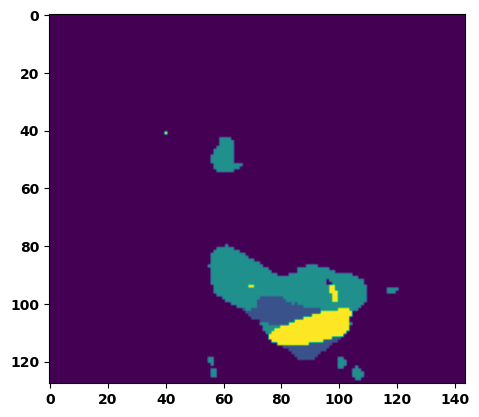

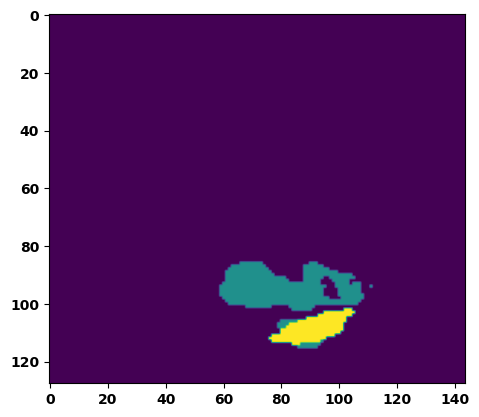

  6%|▌         | 2/36 [00:03<00:51,  1.52s/it]

Batch_id:  1 Eval loss:  0.11831618845462799
Batch_id:  1 Eval IoU:  tensor(0.8155, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9873, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:48,  1.46s/it]

Batch_id:  2 Eval loss:  0.3656274676322937
Batch_id:  2 Eval IoU:  tensor(0.5628, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9989, device='cuda:0')


 11%|█         | 4/36 [00:05<00:45,  1.44s/it]

Batch_id:  3 Eval loss:  0.2870541512966156
Batch_id:  3 Eval IoU:  tensor(0.6808, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:43,  1.41s/it]

Batch_id:  4 Eval loss:  0.7377371191978455
Batch_id:  4 Eval IoU:  tensor(0.2328, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9309, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9022, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9243, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:42,  1.42s/it]

Batch_id:  5 Eval loss:  0.18814077973365784
Batch_id:  5 Eval IoU:  tensor(0.7345, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.48s/it]

Batch_id:  6 Eval loss:  0.2528654932975769
Batch_id:  6 Eval IoU:  tensor(0.6640, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9892, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:41,  1.48s/it]

Batch_id:  7 Eval loss:  0.2604500651359558
Batch_id:  7 Eval IoU:  tensor(0.6791, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:39,  1.46s/it]

Batch_id:  8 Eval loss:  0.19616833329200745
Batch_id:  8 Eval IoU:  tensor(0.7135, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9889, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:37,  1.46s/it]

Batch_id:  9 Eval loss:  0.18235069513320923
Batch_id:  9 Eval IoU:  tensor(0.7518, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  10 Eval loss:  0.3488606810569763
Batch_id:  10 Eval IoU:  tensor(0.5195, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9172, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.8884, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9217, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9787, device='cuda:0')


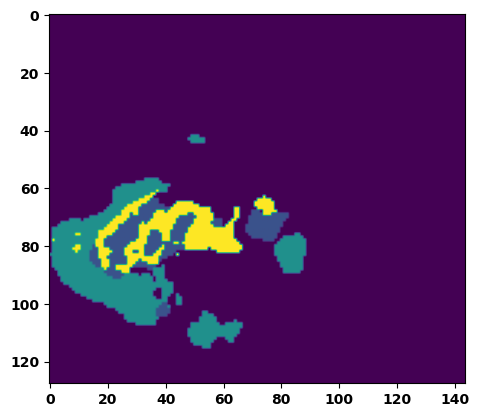

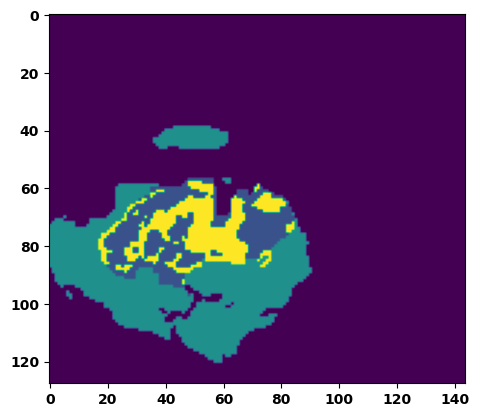

 33%|███▎      | 12/36 [00:17<00:35,  1.46s/it]

Batch_id:  11 Eval loss:  0.12904103100299835
Batch_id:  11 Eval IoU:  tensor(0.8067, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.49s/it]

Batch_id:  12 Eval loss:  0.2943459153175354
Batch_id:  12 Eval IoU:  tensor(0.6117, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9874, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:33,  1.50s/it]

Batch_id:  13 Eval loss:  0.3260003328323364
Batch_id:  13 Eval IoU:  tensor(0.5532, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9399, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9360, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:30,  1.46s/it]

Batch_id:  14 Eval loss:  0.11793409287929535
Batch_id:  14 Eval IoU:  tensor(0.8239, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:27,  1.40s/it]

Batch_id:  15 Eval loss:  0.21578028798103333
Batch_id:  15 Eval IoU:  tensor(0.6785, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9826, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:27,  1.43s/it]

Batch_id:  16 Eval loss:  0.21345701813697815
Batch_id:  16 Eval IoU:  tensor(0.7036, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.47s/it]

Batch_id:  17 Eval loss:  0.16031362116336823
Batch_id:  17 Eval IoU:  tensor(0.7560, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9860, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:25,  1.47s/it]

Batch_id:  18 Eval loss:  0.24617615342140198
Batch_id:  18 Eval IoU:  tensor(0.6637, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.49s/it]

Batch_id:  19 Eval loss:  0.12071812152862549
Batch_id:  19 Eval IoU:  tensor(0.8205, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  20 Eval loss:  0.1370825469493866
Batch_id:  20 Eval IoU:  tensor(0.8045, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9480, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


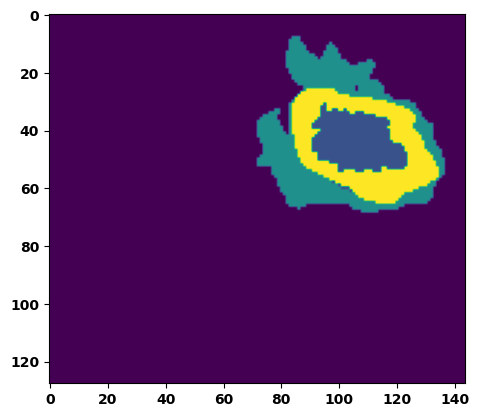

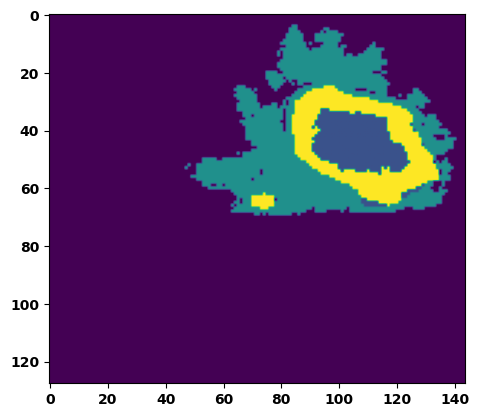

 61%|██████    | 22/36 [00:32<00:22,  1.58s/it]

Batch_id:  21 Eval loss:  0.2151099145412445
Batch_id:  21 Eval IoU:  tensor(0.6967, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9576, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.52s/it]

Batch_id:  22 Eval loss:  0.34733688831329346
Batch_id:  22 Eval IoU:  tensor(0.5471, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9619, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:18,  1.55s/it]

Batch_id:  23 Eval loss:  0.27310216426849365
Batch_id:  23 Eval IoU:  tensor(0.6476, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9479, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9916, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:16,  1.54s/it]

Batch_id:  24 Eval loss:  0.12132060527801514
Batch_id:  24 Eval IoU:  tensor(0.8149, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:15,  1.56s/it]

Batch_id:  25 Eval loss:  0.3801577091217041
Batch_id:  25 Eval IoU:  tensor(0.5550, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:14,  1.57s/it]

Batch_id:  26 Eval loss:  0.4085719585418701
Batch_id:  26 Eval IoU:  tensor(0.5312, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9069, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.8646, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.8606, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 78%|███████▊  | 28/36 [00:42<00:12,  1.58s/it]

Batch_id:  27 Eval loss:  0.12088339030742645
Batch_id:  27 Eval IoU:  tensor(0.8564, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:10,  1.55s/it]

Batch_id:  28 Eval loss:  0.23486311733722687
Batch_id:  28 Eval IoU:  tensor(0.7058, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


 83%|████████▎ | 30/36 [00:45<00:09,  1.53s/it]

Batch_id:  29 Eval loss:  0.12765546143054962
Batch_id:  29 Eval IoU:  tensor(0.8021, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  30 Eval loss:  0.25104862451553345
Batch_id:  30 Eval IoU:  tensor(0.6749, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


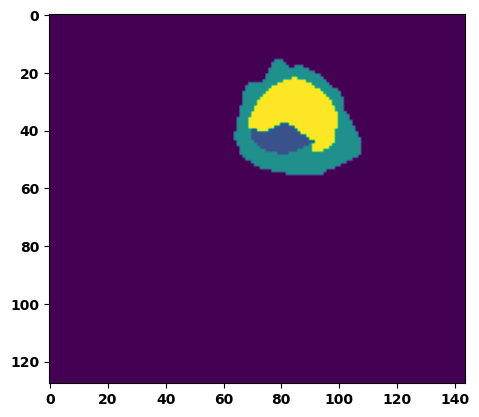

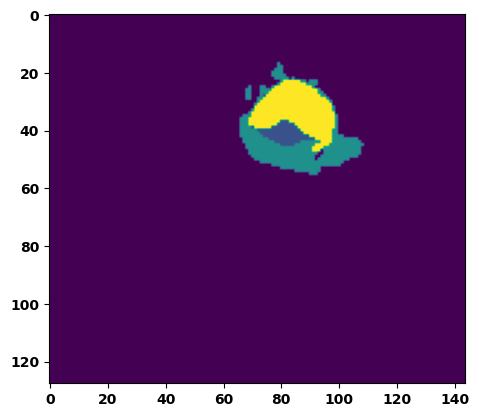

 89%|████████▉ | 32/36 [00:48<00:06,  1.54s/it]

Batch_id:  31 Eval loss:  0.30159908533096313
Batch_id:  31 Eval IoU:  tensor(0.6183, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


 92%|█████████▏| 33/36 [00:49<00:04,  1.56s/it]

Batch_id:  32 Eval loss:  0.08495455980300903
Batch_id:  32 Eval IoU:  tensor(0.8666, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 94%|█████████▍| 34/36 [00:51<00:03,  1.55s/it]

Batch_id:  33 Eval loss:  0.14298132061958313
Batch_id:  33 Eval IoU:  tensor(0.8325, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')


 97%|█████████▋| 35/36 [00:52<00:01,  1.50s/it]

Batch_id:  34 Eval loss:  0.4379272758960724
Batch_id:  34 Eval IoU:  tensor(0.4648, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9476, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9397, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9980, device='cuda:0')


100%|██████████| 36/36 [00:54<00:00,  1.50s/it]

Batch_id:  35 Eval loss:  0.10852406919002533
Batch_id:  35 Eval IoU:  tensor(0.8382, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9794, device='cuda:0')
Epoch  11 Training loss:  0.2636923915960572
Epoch  11 Evaluation loss:  0.24798567344745
Epoch  11 Training accuracy :  tensor(0.6571)
Epoch  11 Evaluation accuracy :  tensor(0.6800)
Epoch  11 Training Mean Dice Score:  tensor(0.9685)
Epoch  11 Eval Mean Dice Score:  tensor(0.9695)
Epoch  11 Training Non-tumor Dice Score:  tensor(0.9725)
Epoch  11 Eval Non-tumor Dice Score:  tensor(0.9690)
Epoch  11 Training NCR/NET Dice Score:  tensor(0.9817)
Epoch  11 Eval NCR/NET Dice Score:  tensor(0.9848)
Epoch  11 Training ED Dice Score:  tensor(0.9641

Epoch: 12
Training in session: 


  1%|          | 1/110 [00:01<03:14,  1.78s/it]

Batch_id:  0 Training loss:  0.32500338554382324
Batch_id:  0 Training IoU:  tensor(0.6162, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


  2%|▏         | 2/110 [00:03<03:01,  1.68s/it]

Batch_id:  1 Training loss:  0.4302166700363159
Batch_id:  1 Training IoU:  tensor(0.4877, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


  3%|▎         | 3/110 [00:05<02:57,  1.66s/it]

Batch_id:  2 Training loss:  0.2428595870733261
Batch_id:  2 Training IoU:  tensor(0.6504, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9847, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:45,  1.57s/it]

Batch_id:  3 Training loss:  0.2806141972541809
Batch_id:  3 Training IoU:  tensor(0.6276, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9405, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


  5%|▍         | 5/110 [00:08<02:48,  1.61s/it]

Batch_id:  4 Training loss:  0.1853790432214737
Batch_id:  4 Training IoU:  tensor(0.7244, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9325, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:42,  1.56s/it]

Batch_id:  5 Training loss:  0.1861078441143036
Batch_id:  5 Training IoU:  tensor(0.7133, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9847, device='cuda:0')


  6%|▋         | 7/110 [00:11<02:38,  1.54s/it]

Batch_id:  6 Training loss:  0.15544043481349945
Batch_id:  6 Training IoU:  tensor(0.7926, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:37,  1.54s/it]

Batch_id:  7 Training loss:  0.16420219838619232
Batch_id:  7 Training IoU:  tensor(0.7429, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9705, device='cuda:0')


  8%|▊         | 9/110 [00:14<02:34,  1.53s/it]

Batch_id:  8 Training loss:  0.155475914478302
Batch_id:  8 Training IoU:  tensor(0.7755, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:32,  1.52s/it]

Batch_id:  9 Training loss:  0.30745601654052734
Batch_id:  9 Training IoU:  tensor(0.6177, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 10%|█         | 11/110 [00:17<02:28,  1.50s/it]

Batch_id:  10 Training loss:  0.14385387301445007
Batch_id:  10 Training IoU:  tensor(0.8411, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 11%|█         | 12/110 [00:18<02:27,  1.51s/it]

Batch_id:  11 Training loss:  0.30899158120155334
Batch_id:  11 Training IoU:  tensor(0.6535, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9994, device='cuda:0')


 12%|█▏        | 13/110 [00:20<02:27,  1.53s/it]

Batch_id:  12 Training loss:  0.09724447131156921
Batch_id:  12 Training IoU:  tensor(0.8494, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:23,  1.50s/it]

Batch_id:  13 Training loss:  0.16232146322727203
Batch_id:  13 Training IoU:  tensor(0.7755, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 14%|█▎        | 15/110 [00:23<02:21,  1.48s/it]

Batch_id:  14 Training loss:  0.46903491020202637
Batch_id:  14 Training IoU:  tensor(0.4620, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:20,  1.50s/it]

Batch_id:  15 Training loss:  0.17960728704929352
Batch_id:  15 Training IoU:  tensor(0.7242, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


 15%|█▌        | 17/110 [00:26<02:22,  1.53s/it]

Batch_id:  16 Training loss:  0.3551432490348816
Batch_id:  16 Training IoU:  tensor(0.5847, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9311, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:16,  1.49s/it]

Batch_id:  17 Training loss:  0.5443629622459412
Batch_id:  17 Training IoU:  tensor(0.3702, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9150, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.8984, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.8739, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 17%|█▋        | 19/110 [00:29<02:15,  1.49s/it]

Batch_id:  18 Training loss:  0.31940749287605286
Batch_id:  18 Training IoU:  tensor(0.5720, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9199, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9279, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.8952, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9810, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:16,  1.51s/it]

Batch_id:  19 Training loss:  0.17949460446834564
Batch_id:  19 Training IoU:  tensor(0.7700, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 19%|█▉        | 21/110 [00:32<02:12,  1.49s/it]

Batch_id:  20 Training loss:  0.3494190573692322
Batch_id:  20 Training IoU:  tensor(0.5354, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9181, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9298, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9171, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9673, device='cuda:0')


 20%|██        | 22/110 [00:33<02:10,  1.49s/it]

Batch_id:  21 Training loss:  0.2270737588405609
Batch_id:  21 Training IoU:  tensor(0.6708, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


 21%|██        | 23/110 [00:35<02:10,  1.50s/it]

Batch_id:  22 Training loss:  0.06742705404758453
Batch_id:  22 Training IoU:  tensor(0.8983, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:08,  1.50s/it]

Batch_id:  23 Training loss:  0.25858229398727417
Batch_id:  23 Training IoU:  tensor(0.6681, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 23%|██▎       | 25/110 [00:38<02:05,  1.48s/it]

Batch_id:  24 Training loss:  0.19663378596305847
Batch_id:  24 Training IoU:  tensor(0.7093, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:01,  1.45s/it]

Batch_id:  25 Training loss:  0.41122448444366455
Batch_id:  25 Training IoU:  tensor(0.4950, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9174, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9480, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9234, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9095, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9713, device='cuda:0')


 25%|██▍       | 27/110 [00:40<01:57,  1.42s/it]

Batch_id:  26 Training loss:  0.1446867436170578
Batch_id:  26 Training IoU:  tensor(0.7869, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 25%|██▌       | 28/110 [00:42<01:54,  1.40s/it]

Batch_id:  27 Training loss:  0.16920806467533112
Batch_id:  27 Training IoU:  tensor(0.7608, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9473, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9796, device='cuda:0')


 26%|██▋       | 29/110 [00:43<01:53,  1.40s/it]

Batch_id:  28 Training loss:  0.1081911027431488
Batch_id:  28 Training IoU:  tensor(0.8430, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:49,  1.37s/it]

Batch_id:  29 Training loss:  0.29052239656448364
Batch_id:  29 Training IoU:  tensor(0.6049, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9847, device='cuda:0')


 28%|██▊       | 31/110 [00:46<01:48,  1.37s/it]

Batch_id:  30 Training loss:  0.25038450956344604
Batch_id:  30 Training IoU:  tensor(0.6822, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 29%|██▉       | 32/110 [00:47<01:47,  1.38s/it]

Batch_id:  31 Training loss:  0.10123084485530853
Batch_id:  31 Training IoU:  tensor(0.8451, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 30%|███       | 33/110 [00:49<01:47,  1.40s/it]

Batch_id:  32 Training loss:  0.24567799270153046
Batch_id:  32 Training IoU:  tensor(0.6946, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 31%|███       | 34/110 [00:50<01:46,  1.41s/it]

Batch_id:  33 Training loss:  0.3119660019874573
Batch_id:  33 Training IoU:  tensor(0.6312, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:47,  1.43s/it]

Batch_id:  34 Training loss:  0.26566123962402344
Batch_id:  34 Training IoU:  tensor(0.6215, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9259, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9286, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9062, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:45,  1.43s/it]

Batch_id:  35 Training loss:  0.13877709209918976
Batch_id:  35 Training IoU:  tensor(0.7840, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:43,  1.42s/it]

Batch_id:  36 Training loss:  0.1692357212305069
Batch_id:  36 Training IoU:  tensor(0.7389, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:40,  1.40s/it]

Batch_id:  37 Training loss:  0.2525187134742737
Batch_id:  37 Training IoU:  tensor(0.6645, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9528, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:38,  1.39s/it]

Batch_id:  38 Training loss:  0.10627999901771545
Batch_id:  38 Training IoU:  tensor(0.8441, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:38,  1.41s/it]

Batch_id:  39 Training loss:  0.2598409652709961
Batch_id:  39 Training IoU:  tensor(0.6314, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9316, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9322, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9166, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9662, device='cuda:0')


 37%|███▋      | 41/110 [01:00<01:37,  1.41s/it]

Batch_id:  40 Training loss:  0.3833075165748596
Batch_id:  40 Training IoU:  tensor(0.5329, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:34,  1.39s/it]

Batch_id:  41 Training loss:  0.20816032588481903
Batch_id:  41 Training IoU:  tensor(0.7005, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 39%|███▉      | 43/110 [01:03<01:36,  1.44s/it]

Batch_id:  42 Training loss:  0.1590307205915451
Batch_id:  42 Training IoU:  tensor(0.7734, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 40%|████      | 44/110 [01:04<01:30,  1.38s/it]

Batch_id:  43 Training loss:  0.061240747570991516
Batch_id:  43 Training IoU:  tensor(0.9125, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 41%|████      | 45/110 [01:05<01:31,  1.40s/it]

Batch_id:  44 Training loss:  0.17785966396331787
Batch_id:  44 Training IoU:  tensor(0.7464, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:31,  1.42s/it]

Batch_id:  45 Training loss:  0.29047590494155884
Batch_id:  45 Training IoU:  tensor(0.6453, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:25,  1.36s/it]

Batch_id:  46 Training loss:  0.27680057287216187
Batch_id:  46 Training IoU:  tensor(0.6784, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:21,  1.32s/it]

Batch_id:  47 Training loss:  0.5286226272583008
Batch_id:  47 Training IoU:  tensor(0.4061, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9270, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9271, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:22,  1.35s/it]

Batch_id:  48 Training loss:  0.15256887674331665
Batch_id:  48 Training IoU:  tensor(0.7581, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:23,  1.40s/it]

Batch_id:  49 Training loss:  0.20592783391475677
Batch_id:  49 Training IoU:  tensor(0.7435, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:22,  1.39s/it]

Batch_id:  50 Training loss:  0.32167965173721313
Batch_id:  50 Training IoU:  tensor(0.6156, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:20,  1.38s/it]

Batch_id:  51 Training loss:  0.2342446893453598
Batch_id:  51 Training IoU:  tensor(0.6666, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:19,  1.40s/it]

Batch_id:  52 Training loss:  0.38322070240974426
Batch_id:  52 Training IoU:  tensor(0.5117, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9312, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9187, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9473, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:19,  1.42s/it]

Batch_id:  53 Training loss:  0.2599153518676758
Batch_id:  53 Training IoU:  tensor(0.6927, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:20,  1.46s/it]

Batch_id:  54 Training loss:  0.33024391531944275
Batch_id:  54 Training IoU:  tensor(0.5986, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:20,  1.49s/it]

Batch_id:  55 Training loss:  0.17454372346401215
Batch_id:  55 Training IoU:  tensor(0.7357, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:19,  1.50s/it]

Batch_id:  56 Training loss:  0.07277791202068329
Batch_id:  56 Training IoU:  tensor(0.8831, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:15,  1.45s/it]

Batch_id:  57 Training loss:  0.1879071593284607
Batch_id:  57 Training IoU:  tensor(0.7714, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 54%|█████▎    | 59/110 [01:25<01:15,  1.48s/it]

Batch_id:  58 Training loss:  0.39756277203559875
Batch_id:  58 Training IoU:  tensor(0.5302, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 55%|█████▍    | 60/110 [01:27<01:12,  1.45s/it]

Batch_id:  59 Training loss:  0.09335407614707947
Batch_id:  59 Training IoU:  tensor(0.8508, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:08,  1.40s/it]

Batch_id:  60 Training loss:  0.20330658555030823
Batch_id:  60 Training IoU:  tensor(0.7655, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 56%|█████▋    | 62/110 [01:30<01:08,  1.43s/it]

Batch_id:  61 Training loss:  0.23527605831623077
Batch_id:  61 Training IoU:  tensor(0.7070, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:06,  1.42s/it]

Batch_id:  62 Training loss:  0.41526395082473755
Batch_id:  62 Training IoU:  tensor(0.4665, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9589, device='cuda:0')


 58%|█████▊    | 64/110 [01:33<01:07,  1.46s/it]

Batch_id:  63 Training loss:  0.21477192640304565
Batch_id:  63 Training IoU:  tensor(0.7339, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:06,  1.47s/it]

Batch_id:  64 Training loss:  0.15064731240272522
Batch_id:  64 Training IoU:  tensor(0.7801, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:05,  1.48s/it]

Batch_id:  65 Training loss:  0.3612956404685974
Batch_id:  65 Training IoU:  tensor(0.6409, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 61%|██████    | 67/110 [01:37<01:03,  1.47s/it]

Batch_id:  66 Training loss:  0.10863079130649567
Batch_id:  66 Training IoU:  tensor(0.8309, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 62%|██████▏   | 68/110 [01:38<01:01,  1.46s/it]

Batch_id:  67 Training loss:  0.3127928376197815
Batch_id:  67 Training IoU:  tensor(0.6467, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<00:59,  1.46s/it]

Batch_id:  68 Training loss:  0.1693205088376999
Batch_id:  68 Training IoU:  tensor(0.7713, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 64%|██████▎   | 70/110 [01:41<00:57,  1.44s/it]

Batch_id:  69 Training loss:  0.5499712824821472
Batch_id:  69 Training IoU:  tensor(0.4088, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 65%|██████▍   | 71/110 [01:43<00:56,  1.46s/it]

Batch_id:  70 Training loss:  0.17847760021686554
Batch_id:  70 Training IoU:  tensor(0.7627, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 65%|██████▌   | 72/110 [01:44<00:54,  1.44s/it]

Batch_id:  71 Training loss:  0.34522348642349243
Batch_id:  71 Training IoU:  tensor(0.5555, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9464, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9273, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 66%|██████▋   | 73/110 [01:46<00:52,  1.42s/it]

Batch_id:  72 Training loss:  0.1361851990222931
Batch_id:  72 Training IoU:  tensor(0.8132, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 67%|██████▋   | 74/110 [01:47<00:50,  1.41s/it]

Batch_id:  73 Training loss:  0.16861537098884583
Batch_id:  73 Training IoU:  tensor(0.7507, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 68%|██████▊   | 75/110 [01:48<00:49,  1.40s/it]

Batch_id:  74 Training loss:  0.46914243698120117
Batch_id:  74 Training IoU:  tensor(0.4844, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 69%|██████▉   | 76/110 [01:50<00:47,  1.41s/it]

Batch_id:  75 Training loss:  0.42333489656448364
Batch_id:  75 Training IoU:  tensor(0.4988, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9275, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 70%|███████   | 77/110 [01:51<00:47,  1.44s/it]

Batch_id:  76 Training loss:  0.2828613519668579
Batch_id:  76 Training IoU:  tensor(0.6166, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 71%|███████   | 78/110 [01:53<00:45,  1.44s/it]

Batch_id:  77 Training loss:  0.24233216047286987
Batch_id:  77 Training IoU:  tensor(0.6423, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9680, device='cuda:0')


 72%|███████▏  | 79/110 [01:54<00:44,  1.42s/it]

Batch_id:  78 Training loss:  0.20949800312519073
Batch_id:  78 Training IoU:  tensor(0.7117, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 73%|███████▎  | 80/110 [01:55<00:42,  1.41s/it]

Batch_id:  79 Training loss:  0.13075275719165802
Batch_id:  79 Training IoU:  tensor(0.8050, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 74%|███████▎  | 81/110 [01:57<00:39,  1.37s/it]

Batch_id:  80 Training loss:  0.2385910600423813
Batch_id:  80 Training IoU:  tensor(0.6721, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9494, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 75%|███████▍  | 82/110 [01:58<00:37,  1.36s/it]

Batch_id:  81 Training loss:  0.21701890230178833
Batch_id:  81 Training IoU:  tensor(0.7023, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 75%|███████▌  | 83/110 [01:59<00:36,  1.36s/it]

Batch_id:  82 Training loss:  0.31978389620780945
Batch_id:  82 Training IoU:  tensor(0.5638, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9831, device='cuda:0')


 76%|███████▋  | 84/110 [02:01<00:37,  1.43s/it]

Batch_id:  83 Training loss:  0.18092481791973114
Batch_id:  83 Training IoU:  tensor(0.7232, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 77%|███████▋  | 85/110 [02:03<00:36,  1.44s/it]

Batch_id:  84 Training loss:  0.3233222961425781
Batch_id:  84 Training IoU:  tensor(0.5533, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 78%|███████▊  | 86/110 [02:04<00:34,  1.43s/it]

Batch_id:  85 Training loss:  0.31158512830734253
Batch_id:  85 Training IoU:  tensor(0.6346, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 79%|███████▉  | 87/110 [02:05<00:33,  1.47s/it]

Batch_id:  86 Training loss:  0.1632564216852188
Batch_id:  86 Training IoU:  tensor(0.7591, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 80%|████████  | 88/110 [02:07<00:31,  1.42s/it]

Batch_id:  87 Training loss:  0.1867247074842453
Batch_id:  87 Training IoU:  tensor(0.7232, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9757, device='cuda:0')


 81%|████████  | 89/110 [02:08<00:30,  1.46s/it]

Batch_id:  88 Training loss:  0.13381034135818481
Batch_id:  88 Training IoU:  tensor(0.8032, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 82%|████████▏ | 90/110 [02:10<00:29,  1.48s/it]

Batch_id:  89 Training loss:  0.2793293595314026
Batch_id:  89 Training IoU:  tensor(0.6406, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 83%|████████▎ | 91/110 [02:11<00:27,  1.45s/it]

Batch_id:  90 Training loss:  0.36324089765548706
Batch_id:  90 Training IoU:  tensor(0.5263, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9307, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9068, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 84%|████████▎ | 92/110 [02:13<00:26,  1.46s/it]

Batch_id:  91 Training loss:  0.22831305861473083
Batch_id:  91 Training IoU:  tensor(0.7003, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 85%|████████▍ | 93/110 [02:14<00:24,  1.47s/it]

Batch_id:  92 Training loss:  0.3277907967567444
Batch_id:  92 Training IoU:  tensor(0.5823, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 85%|████████▌ | 94/110 [02:16<00:22,  1.43s/it]

Batch_id:  93 Training loss:  0.5404520034790039
Batch_id:  93 Training IoU:  tensor(0.3981, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 86%|████████▋ | 95/110 [02:17<00:21,  1.42s/it]

Batch_id:  94 Training loss:  0.17789359390735626
Batch_id:  94 Training IoU:  tensor(0.7374, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9796, device='cuda:0')


 87%|████████▋ | 96/110 [02:19<00:20,  1.47s/it]

Batch_id:  95 Training loss:  0.21483242511749268
Batch_id:  95 Training IoU:  tensor(0.6973, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 88%|████████▊ | 97/110 [02:20<00:18,  1.44s/it]

Batch_id:  96 Training loss:  0.1444372683763504
Batch_id:  96 Training IoU:  tensor(0.7732, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 89%|████████▉ | 98/110 [02:21<00:17,  1.45s/it]

Batch_id:  97 Training loss:  0.23271392285823822
Batch_id:  97 Training IoU:  tensor(0.6643, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9797, device='cuda:0')


 90%|█████████ | 99/110 [02:23<00:15,  1.42s/it]

Batch_id:  98 Training loss:  0.606753408908844
Batch_id:  98 Training IoU:  tensor(0.3285, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9201, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9355, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 91%|█████████ | 100/110 [02:24<00:13,  1.36s/it]

Batch_id:  99 Training loss:  0.20173507928848267
Batch_id:  99 Training IoU:  tensor(0.7210, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 92%|█████████▏| 101/110 [02:25<00:12,  1.40s/it]

Batch_id:  100 Training loss:  0.12063249945640564
Batch_id:  100 Training IoU:  tensor(0.8070, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 93%|█████████▎| 102/110 [02:27<00:11,  1.44s/it]

Batch_id:  101 Training loss:  0.11672830581665039
Batch_id:  101 Training IoU:  tensor(0.8182, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 94%|█████████▎| 103/110 [02:28<00:10,  1.44s/it]

Batch_id:  102 Training loss:  0.2612752318382263
Batch_id:  102 Training IoU:  tensor(0.6615, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9392, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 95%|█████████▍| 104/110 [02:30<00:08,  1.41s/it]

Batch_id:  103 Training loss:  0.2999454140663147
Batch_id:  103 Training IoU:  tensor(0.5914, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9814, device='cuda:0')


 95%|█████████▌| 105/110 [02:31<00:07,  1.41s/it]

Batch_id:  104 Training loss:  0.1631106585264206
Batch_id:  104 Training IoU:  tensor(0.7468, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9843, device='cuda:0')


 96%|█████████▋| 106/110 [02:33<00:05,  1.41s/it]

Batch_id:  105 Training loss:  0.20916926860809326
Batch_id:  105 Training IoU:  tensor(0.6874, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9763, device='cuda:0')


 97%|█████████▋| 107/110 [02:34<00:04,  1.43s/it]

Batch_id:  106 Training loss:  0.10346536338329315
Batch_id:  106 Training IoU:  tensor(0.8455, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 98%|█████████▊| 108/110 [02:36<00:02,  1.46s/it]

Batch_id:  107 Training loss:  0.14107637107372284
Batch_id:  107 Training IoU:  tensor(0.7848, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 99%|█████████▉| 109/110 [02:37<00:01,  1.47s/it]

Batch_id:  108 Training loss:  0.14871181547641754
Batch_id:  108 Training IoU:  tensor(0.7715, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9734, device='cuda:0')


100%|██████████| 110/110 [02:38<00:00,  1.45s/it]


Batch_id:  109 Training loss:  0.12075990438461304
Batch_id:  109 Training IoU:  tensor(0.8088, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9908, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.3558696210384369
Batch_id:  0 Eval IoU:  tensor(0.5853, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


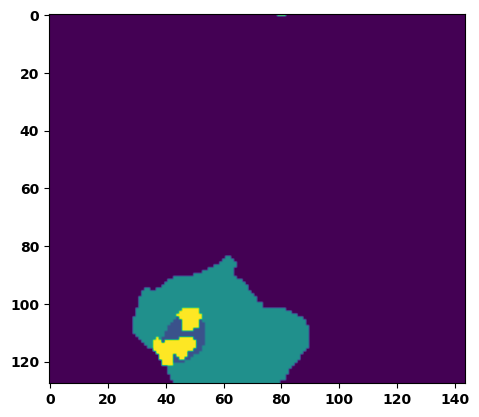

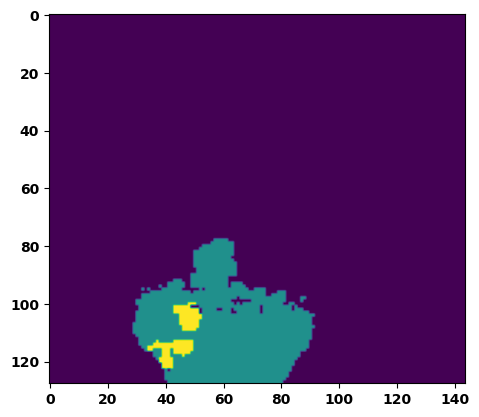

  6%|▌         | 2/36 [00:02<00:49,  1.47s/it]

Batch_id:  1 Eval loss:  0.15873520076274872
Batch_id:  1 Eval IoU:  tensor(0.8113, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:47,  1.44s/it]

Batch_id:  2 Eval loss:  0.39856475591659546
Batch_id:  2 Eval IoU:  tensor(0.4909, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9247, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9168, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


 11%|█         | 4/36 [00:05<00:45,  1.43s/it]

Batch_id:  3 Eval loss:  0.12786135077476501
Batch_id:  3 Eval IoU:  tensor(0.8023, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9889, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.46s/it]

Batch_id:  4 Eval loss:  0.09639197587966919
Batch_id:  4 Eval IoU:  tensor(0.8487, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:41,  1.39s/it]

Batch_id:  5 Eval loss:  0.08714866638183594
Batch_id:  5 Eval IoU:  tensor(0.8860, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  6 Eval loss:  0.21775980293750763
Batch_id:  6 Eval IoU:  tensor(0.6903, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:44,  1.54s/it]

Batch_id:  6 Eval Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9874, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.46s/it]

Batch_id:  7 Eval loss:  0.26691001653671265
Batch_id:  7 Eval IoU:  tensor(0.6519, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9954, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:38,  1.42s/it]

Batch_id:  8 Eval loss:  0.26809558272361755
Batch_id:  8 Eval IoU:  tensor(0.6402, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:40,  1.54s/it]

Batch_id:  9 Eval loss:  0.4085204601287842
Batch_id:  9 Eval IoU:  tensor(0.5308, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9060, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.8600, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.8593, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  10 Eval loss:  0.1794285625219345
Batch_id:  10 Eval IoU:  tensor(0.7572, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9280, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9254, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


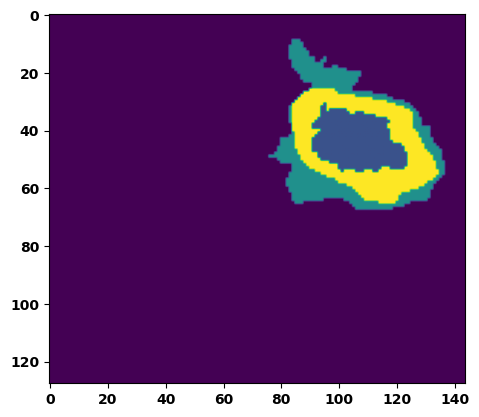

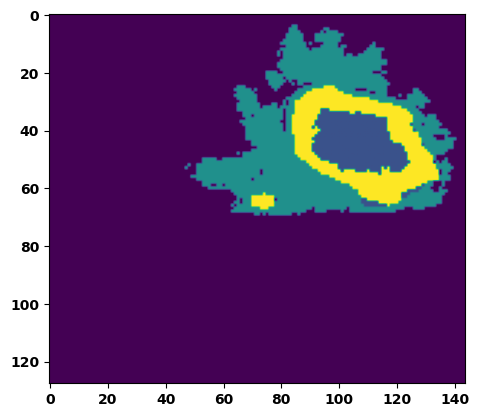

 33%|███▎      | 12/36 [00:17<00:35,  1.46s/it]

Batch_id:  11 Eval loss:  0.23565059900283813
Batch_id:  11 Eval IoU:  tensor(0.7069, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9475, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9494, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:33,  1.45s/it]

Batch_id:  12 Eval loss:  0.11175861954689026
Batch_id:  12 Eval IoU:  tensor(0.8734, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:32,  1.46s/it]

Batch_id:  13 Eval loss:  0.2615487575531006
Batch_id:  13 Eval IoU:  tensor(0.6504, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9397, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.48s/it]

Batch_id:  14 Eval loss:  0.4433225393295288
Batch_id:  14 Eval IoU:  tensor(0.4970, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9540, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9975, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.42s/it]

Batch_id:  15 Eval loss:  0.44443026185035706
Batch_id:  15 Eval IoU:  tensor(0.4552, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9342, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9970, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:26,  1.42s/it]

Batch_id:  16 Eval loss:  0.44961515069007874
Batch_id:  16 Eval IoU:  tensor(0.4953, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9987, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:25,  1.44s/it]

Batch_id:  17 Eval loss:  0.09068523347377777
Batch_id:  17 Eval IoU:  tensor(0.8658, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9949, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.41s/it]

Batch_id:  18 Eval loss:  0.29822343587875366
Batch_id:  18 Eval IoU:  tensor(0.6505, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.47s/it]

Batch_id:  19 Eval loss:  0.23847144842147827
Batch_id:  19 Eval IoU:  tensor(0.6956, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  20 Eval loss:  0.0898728221654892
Batch_id:  20 Eval IoU:  tensor(0.8546, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


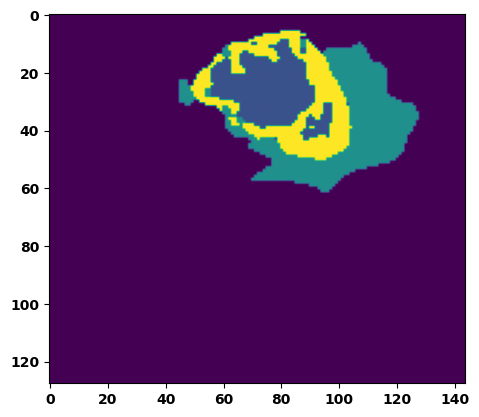

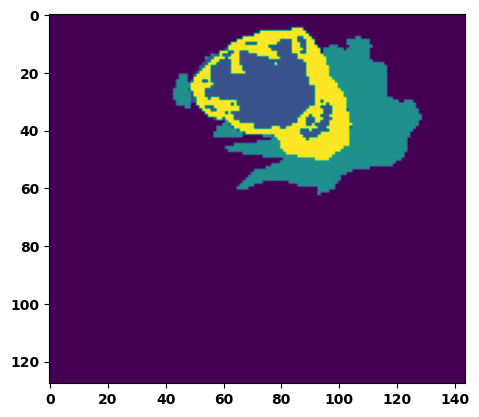

 61%|██████    | 22/36 [00:32<00:20,  1.49s/it]

Batch_id:  21 Eval loss:  0.09241645038127899
Batch_id:  21 Eval IoU:  tensor(0.8488, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.51s/it]

Batch_id:  22 Eval loss:  0.15548758208751678
Batch_id:  22 Eval IoU:  tensor(0.7558, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9857, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:18,  1.58s/it]

Batch_id:  23 Eval loss:  0.2982794940471649
Batch_id:  23 Eval IoU:  tensor(0.6062, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9873, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:17,  1.59s/it]

Batch_id:  24 Eval loss:  0.1494169980287552
Batch_id:  24 Eval IoU:  tensor(0.7804, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:15,  1.53s/it]

Batch_id:  25 Eval loss:  0.10163545608520508
Batch_id:  25 Eval IoU:  tensor(0.8369, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9789, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:13,  1.54s/it]

Batch_id:  26 Eval loss:  0.11178657412528992
Batch_id:  26 Eval IoU:  tensor(0.8171, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.47s/it]

Batch_id:  27 Eval loss:  0.10506504774093628
Batch_id:  27 Eval IoU:  tensor(0.8394, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9932, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.48s/it]

Batch_id:  28 Eval loss:  0.31553810834884644
Batch_id:  28 Eval IoU:  tensor(0.5551, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9263, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.8994, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9343, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9795, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.48s/it]

Batch_id:  29 Eval loss:  0.7543648481369019
Batch_id:  29 Eval IoU:  tensor(0.2290, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9292, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9002, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9172, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  30 Eval loss:  0.35553714632987976
Batch_id:  30 Eval IoU:  tensor(0.5358, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9484, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9591, device='cuda:0')


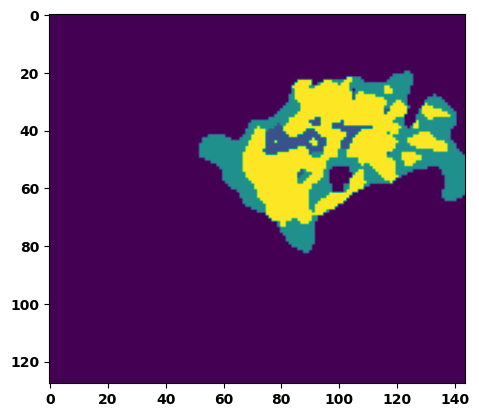

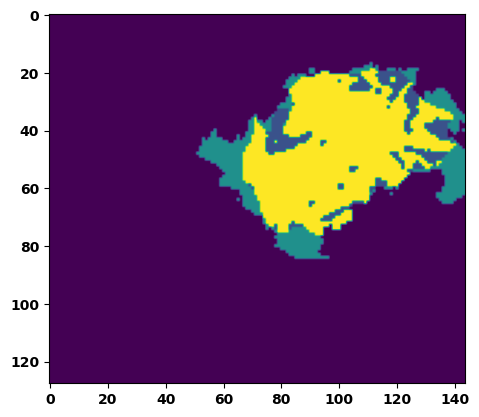

 89%|████████▉ | 32/36 [00:47<00:05,  1.47s/it]

Batch_id:  31 Eval loss:  0.20652641355991364
Batch_id:  31 Eval IoU:  tensor(0.6878, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9822, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.45s/it]

Batch_id:  32 Eval loss:  0.20736105740070343
Batch_id:  32 Eval IoU:  tensor(0.6971, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:02,  1.46s/it]

Batch_id:  33 Eval loss:  0.25558632612228394
Batch_id:  33 Eval IoU:  tensor(0.6571, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.47s/it]

Batch_id:  34 Eval loss:  0.3085329532623291
Batch_id:  34 Eval IoU:  tensor(0.5945, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


100%|██████████| 36/36 [00:53<00:00,  1.47s/it]

Batch_id:  35 Eval loss:  0.133714497089386
Batch_id:  35 Eval IoU:  tensor(0.8068, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')
Epoch 00013: reducing learning rate of group 0 to 2.5000e-04.
Epoch  12 Training loss:  0.24364807388999246
Epoch  12 Evaluation loss:  0.24389205045170254
Epoch  12 Training accuracy :  tensor(0.6821)
Epoch  12 Evaluation accuracy :  tensor(0.6858)
Epoch  12 Training Mean Dice Score:  tensor(0.9714)
Epoch  12 Eval Mean Dice Score:  tensor(0.9697)
Epoch  12 Training Non-tumor Dice Score:  tensor(0.9752)
Epoch  12 Eval Non-tumor Dice Score:  tensor(0.9687)
Epoch  12 Training NCR/NET Dice Score:  tensor(0.9834)
Epoch  12 Eval NCR/NET Dice Score: 

Epoch: 13
Training in session: 


  1%|          | 1/110 [00:01<03:15,  1.80s/it]

Batch_id:  0 Training loss:  0.22334541380405426
Batch_id:  0 Training IoU:  tensor(0.7142, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:51,  1.59s/it]

Batch_id:  1 Training loss:  0.30918562412261963
Batch_id:  1 Training IoU:  tensor(0.6369, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9979, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:46,  1.56s/it]

Batch_id:  2 Training loss:  0.15655528008937836
Batch_id:  2 Training IoU:  tensor(0.7674, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:43,  1.54s/it]

Batch_id:  3 Training loss:  0.5032001733779907
Batch_id:  3 Training IoU:  tensor(0.4093, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9235, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9111, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.8883, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:45,  1.57s/it]

Batch_id:  4 Training loss:  0.3100154995918274
Batch_id:  4 Training IoU:  tensor(0.5687, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9124, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9107, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.8843, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:36,  1.50s/it]

Batch_id:  5 Training loss:  0.36538025736808777
Batch_id:  5 Training IoU:  tensor(0.5286, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9404, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9471, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:39,  1.55s/it]

Batch_id:  6 Training loss:  0.38086986541748047
Batch_id:  6 Training IoU:  tensor(0.5136, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9246, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9284, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9025, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:33,  1.50s/it]

Batch_id:  7 Training loss:  0.17338910698890686
Batch_id:  7 Training IoU:  tensor(0.7280, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9842, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:33,  1.52s/it]

Batch_id:  8 Training loss:  0.3559819459915161
Batch_id:  8 Training IoU:  tensor(0.5806, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:30,  1.50s/it]

Batch_id:  9 Training loss:  0.34722548723220825
Batch_id:  9 Training IoU:  tensor(0.5432, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


 10%|█         | 11/110 [00:16<02:31,  1.53s/it]

Batch_id:  10 Training loss:  0.18733295798301697
Batch_id:  10 Training IoU:  tensor(0.7248, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9617, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 11%|█         | 12/110 [00:18<02:31,  1.54s/it]

Batch_id:  11 Training loss:  0.09802287817001343
Batch_id:  11 Training IoU:  tensor(0.8608, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:26,  1.51s/it]

Batch_id:  12 Training loss:  0.12339912354946136
Batch_id:  12 Training IoU:  tensor(0.8113, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:29,  1.56s/it]

Batch_id:  13 Training loss:  0.1536530703306198
Batch_id:  13 Training IoU:  tensor(0.7593, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 14%|█▎        | 15/110 [00:23<02:27,  1.55s/it]

Batch_id:  14 Training loss:  0.1717870980501175
Batch_id:  14 Training IoU:  tensor(0.7488, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:24,  1.54s/it]

Batch_id:  15 Training loss:  0.2771153450012207
Batch_id:  15 Training IoU:  tensor(0.6474, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9339, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 15%|█▌        | 17/110 [00:26<02:21,  1.52s/it]

Batch_id:  16 Training loss:  0.13257108628749847
Batch_id:  16 Training IoU:  tensor(0.7997, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:19,  1.51s/it]

Batch_id:  17 Training loss:  0.26904886960983276
Batch_id:  17 Training IoU:  tensor(0.6840, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 17%|█▋        | 19/110 [00:29<02:16,  1.50s/it]

Batch_id:  18 Training loss:  0.17655925452709198
Batch_id:  18 Training IoU:  tensor(0.7479, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9811, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:15,  1.50s/it]

Batch_id:  19 Training loss:  0.16308525204658508
Batch_id:  19 Training IoU:  tensor(0.7626, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 19%|█▉        | 21/110 [00:32<02:16,  1.53s/it]

Batch_id:  20 Training loss:  0.1743280440568924
Batch_id:  20 Training IoU:  tensor(0.7871, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 20%|██        | 22/110 [00:33<02:14,  1.53s/it]

Batch_id:  21 Training loss:  0.14013533294200897
Batch_id:  21 Training IoU:  tensor(0.7806, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9735, device='cuda:0')


 21%|██        | 23/110 [00:35<02:16,  1.57s/it]

Batch_id:  22 Training loss:  0.17607951164245605
Batch_id:  22 Training IoU:  tensor(0.7573, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:15,  1.58s/it]

Batch_id:  23 Training loss:  0.06628064811229706
Batch_id:  23 Training IoU:  tensor(0.8978, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 23%|██▎       | 25/110 [00:38<02:09,  1.52s/it]

Batch_id:  24 Training loss:  0.1547941267490387
Batch_id:  24 Training IoU:  tensor(0.7689, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9543, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9778, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:06,  1.51s/it]

Batch_id:  25 Training loss:  0.09409305453300476
Batch_id:  25 Training IoU:  tensor(0.8527, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 25%|██▍       | 27/110 [00:41<02:08,  1.55s/it]

Batch_id:  26 Training loss:  0.23145022988319397
Batch_id:  26 Training IoU:  tensor(0.6610, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


 25%|██▌       | 28/110 [00:43<02:08,  1.56s/it]

Batch_id:  27 Training loss:  0.12252816557884216
Batch_id:  27 Training IoU:  tensor(0.8093, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 26%|██▋       | 29/110 [00:44<02:05,  1.55s/it]

Batch_id:  28 Training loss:  0.08721140027046204
Batch_id:  28 Training IoU:  tensor(0.8607, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 27%|██▋       | 30/110 [00:45<01:59,  1.50s/it]

Batch_id:  29 Training loss:  0.2106522023677826
Batch_id:  29 Training IoU:  tensor(0.7610, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 28%|██▊       | 31/110 [00:47<01:56,  1.47s/it]

Batch_id:  30 Training loss:  0.3051910400390625
Batch_id:  30 Training IoU:  tensor(0.6379, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 29%|██▉       | 32/110 [00:48<01:52,  1.45s/it]

Batch_id:  31 Training loss:  0.13027988374233246
Batch_id:  31 Training IoU:  tensor(0.7968, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 30%|███       | 33/110 [00:50<01:52,  1.46s/it]

Batch_id:  32 Training loss:  0.26256629824638367
Batch_id:  32 Training IoU:  tensor(0.6907, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 31%|███       | 34/110 [00:51<01:53,  1.50s/it]

Batch_id:  33 Training loss:  0.21293054521083832
Batch_id:  33 Training IoU:  tensor(0.6884, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 32%|███▏      | 35/110 [00:53<01:48,  1.45s/it]

Batch_id:  34 Training loss:  0.24361442029476166
Batch_id:  34 Training IoU:  tensor(0.6462, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9787, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:53,  1.53s/it]

Batch_id:  35 Training loss:  0.23545122146606445
Batch_id:  35 Training IoU:  tensor(0.6678, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 34%|███▎      | 37/110 [00:56<01:49,  1.50s/it]

Batch_id:  36 Training loss:  0.0988602489233017
Batch_id:  36 Training IoU:  tensor(0.8531, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 35%|███▍      | 38/110 [00:57<01:47,  1.49s/it]

Batch_id:  37 Training loss:  0.3092153072357178
Batch_id:  37 Training IoU:  tensor(0.5934, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 35%|███▌      | 39/110 [00:59<01:42,  1.45s/it]

Batch_id:  38 Training loss:  0.07296682894229889
Batch_id:  38 Training IoU:  tensor(0.8855, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 36%|███▋      | 40/110 [01:00<01:42,  1.47s/it]

Batch_id:  39 Training loss:  0.12288106977939606
Batch_id:  39 Training IoU:  tensor(0.8568, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 37%|███▋      | 41/110 [01:02<01:43,  1.51s/it]

Batch_id:  40 Training loss:  0.2525370717048645
Batch_id:  40 Training IoU:  tensor(0.6392, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9509, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9377, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 38%|███▊      | 42/110 [01:03<01:37,  1.43s/it]

Batch_id:  41 Training loss:  0.09278452396392822
Batch_id:  41 Training IoU:  tensor(0.8667, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:34,  1.41s/it]

Batch_id:  42 Training loss:  0.2041655033826828
Batch_id:  42 Training IoU:  tensor(0.7394, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 40%|████      | 44/110 [01:06<01:30,  1.36s/it]

Batch_id:  43 Training loss:  0.32742953300476074
Batch_id:  43 Training IoU:  tensor(0.6137, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 41%|████      | 45/110 [01:07<01:35,  1.47s/it]

Batch_id:  44 Training loss:  0.19801828265190125
Batch_id:  44 Training IoU:  tensor(0.7375, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 42%|████▏     | 46/110 [01:09<01:31,  1.43s/it]

Batch_id:  45 Training loss:  0.2241944819688797
Batch_id:  45 Training IoU:  tensor(0.7081, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 43%|████▎     | 47/110 [01:10<01:30,  1.43s/it]

Batch_id:  46 Training loss:  0.2619438171386719
Batch_id:  46 Training IoU:  tensor(0.6245, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 44%|████▎     | 48/110 [01:12<01:28,  1.42s/it]

Batch_id:  47 Training loss:  0.34985899925231934
Batch_id:  47 Training IoU:  tensor(0.5286, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9543, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9796, device='cuda:0')


 45%|████▍     | 49/110 [01:13<01:24,  1.39s/it]

Batch_id:  48 Training loss:  0.18034255504608154
Batch_id:  48 Training IoU:  tensor(0.7282, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9744, device='cuda:0')


 45%|████▌     | 50/110 [01:14<01:23,  1.39s/it]

Batch_id:  49 Training loss:  0.18560130894184113
Batch_id:  49 Training IoU:  tensor(0.7304, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 46%|████▋     | 51/110 [01:16<01:22,  1.40s/it]

Batch_id:  50 Training loss:  0.2720135450363159
Batch_id:  50 Training IoU:  tensor(0.6476, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 47%|████▋     | 52/110 [01:17<01:22,  1.41s/it]

Batch_id:  51 Training loss:  0.1125534176826477
Batch_id:  51 Training IoU:  tensor(0.8305, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 48%|████▊     | 53/110 [01:19<01:22,  1.44s/it]

Batch_id:  52 Training loss:  0.3554154634475708
Batch_id:  52 Training IoU:  tensor(0.5368, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9110, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9158, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.8852, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 49%|████▉     | 54/110 [01:20<01:18,  1.40s/it]

Batch_id:  53 Training loss:  0.22932948172092438
Batch_id:  53 Training IoU:  tensor(0.6681, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:17,  1.41s/it]

Batch_id:  54 Training loss:  0.21855121850967407
Batch_id:  54 Training IoU:  tensor(0.6670, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9748, device='cuda:0')


 51%|█████     | 56/110 [01:23<01:16,  1.41s/it]

Batch_id:  55 Training loss:  0.24289290606975555
Batch_id:  55 Training IoU:  tensor(0.6536, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9761, device='cuda:0')


 52%|█████▏    | 57/110 [01:24<01:15,  1.42s/it]

Batch_id:  56 Training loss:  0.5556389093399048
Batch_id:  56 Training IoU:  tensor(0.3810, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


 53%|█████▎    | 58/110 [01:26<01:13,  1.42s/it]

Batch_id:  57 Training loss:  0.2988402247428894
Batch_id:  57 Training IoU:  tensor(0.5897, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9357, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9722, device='cuda:0')


 54%|█████▎    | 59/110 [01:27<01:11,  1.41s/it]

Batch_id:  58 Training loss:  0.139860138297081
Batch_id:  58 Training IoU:  tensor(0.7848, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:10,  1.42s/it]

Batch_id:  59 Training loss:  0.09186157584190369
Batch_id:  59 Training IoU:  tensor(0.8567, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 55%|█████▌    | 61/110 [01:30<01:08,  1.40s/it]

Batch_id:  60 Training loss:  0.13622045516967773
Batch_id:  60 Training IoU:  tensor(0.7828, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:06,  1.39s/it]

Batch_id:  61 Training loss:  0.16125211119651794
Batch_id:  61 Training IoU:  tensor(0.7609, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


 57%|█████▋    | 63/110 [01:33<01:05,  1.39s/it]

Batch_id:  62 Training loss:  0.14909259974956512
Batch_id:  62 Training IoU:  tensor(0.7655, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:04,  1.41s/it]

Batch_id:  63 Training loss:  0.2202838659286499
Batch_id:  63 Training IoU:  tensor(0.6863, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 59%|█████▉    | 65/110 [01:35<01:03,  1.42s/it]

Batch_id:  64 Training loss:  0.27703285217285156
Batch_id:  64 Training IoU:  tensor(0.6594, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:01,  1.39s/it]

Batch_id:  65 Training loss:  0.23803402483463287
Batch_id:  65 Training IoU:  tensor(0.6601, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 61%|██████    | 67/110 [01:38<01:01,  1.42s/it]

Batch_id:  66 Training loss:  0.374000608921051
Batch_id:  66 Training IoU:  tensor(0.5570, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9512, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 62%|██████▏   | 68/110 [01:40<00:59,  1.41s/it]

Batch_id:  67 Training loss:  0.14675839245319366
Batch_id:  67 Training IoU:  tensor(0.7713, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 63%|██████▎   | 69/110 [01:41<00:58,  1.43s/it]

Batch_id:  68 Training loss:  0.19352829456329346
Batch_id:  68 Training IoU:  tensor(0.7027, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9793, device='cuda:0')


 64%|██████▎   | 70/110 [01:43<00:56,  1.42s/it]

Batch_id:  69 Training loss:  0.29233795404434204
Batch_id:  69 Training IoU:  tensor(0.5878, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9237, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9191, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9682, device='cuda:0')


 65%|██████▍   | 71/110 [01:44<00:53,  1.37s/it]

Batch_id:  70 Training loss:  0.2182847559452057
Batch_id:  70 Training IoU:  tensor(0.7235, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 65%|██████▌   | 72/110 [01:45<00:51,  1.36s/it]

Batch_id:  71 Training loss:  0.20036427676677704
Batch_id:  71 Training IoU:  tensor(0.7069, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9795, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:52,  1.41s/it]

Batch_id:  72 Training loss:  0.06439238786697388
Batch_id:  72 Training IoU:  tensor(0.8980, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:52,  1.45s/it]

Batch_id:  73 Training loss:  0.09724962711334229
Batch_id:  73 Training IoU:  tensor(0.8542, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 68%|██████▊   | 75/110 [01:50<00:52,  1.49s/it]

Batch_id:  74 Training loss:  0.3709917962551117
Batch_id:  74 Training IoU:  tensor(0.5387, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 69%|██████▉   | 76/110 [01:51<00:50,  1.48s/it]

Batch_id:  75 Training loss:  0.16023629903793335
Batch_id:  75 Training IoU:  tensor(0.7538, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 70%|███████   | 77/110 [01:53<00:50,  1.53s/it]

Batch_id:  76 Training loss:  0.09480834007263184
Batch_id:  76 Training IoU:  tensor(0.8474, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:46,  1.47s/it]

Batch_id:  77 Training loss:  0.44274723529815674
Batch_id:  77 Training IoU:  tensor(0.4885, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 72%|███████▏  | 79/110 [01:56<00:44,  1.45s/it]

Batch_id:  78 Training loss:  0.15588787198066711
Batch_id:  78 Training IoU:  tensor(0.7528, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9729, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:42,  1.43s/it]

Batch_id:  79 Training loss:  0.4928058981895447
Batch_id:  79 Training IoU:  tensor(0.4437, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9344, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9362, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 74%|███████▎  | 81/110 [01:58<00:40,  1.40s/it]

Batch_id:  80 Training loss:  0.23418846726417542
Batch_id:  80 Training IoU:  tensor(0.6783, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9494, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:39,  1.40s/it]

Batch_id:  81 Training loss:  0.24844175577163696
Batch_id:  81 Training IoU:  tensor(0.6652, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:39,  1.45s/it]

Batch_id:  82 Training loss:  0.21574100852012634
Batch_id:  82 Training IoU:  tensor(0.6925, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:37,  1.43s/it]

Batch_id:  83 Training loss:  0.28872573375701904
Batch_id:  83 Training IoU:  tensor(0.6601, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:35,  1.44s/it]

Batch_id:  84 Training loss:  0.20835758745670319
Batch_id:  84 Training IoU:  tensor(0.7152, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:34,  1.43s/it]

Batch_id:  85 Training loss:  0.31031492352485657
Batch_id:  85 Training IoU:  tensor(0.6457, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:32,  1.40s/it]

Batch_id:  86 Training loss:  0.354030579328537
Batch_id:  86 Training IoU:  tensor(0.5823, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9278, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 80%|████████  | 88/110 [02:08<00:31,  1.43s/it]

Batch_id:  87 Training loss:  0.19868870079517365
Batch_id:  87 Training IoU:  tensor(0.7060, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9778, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:29,  1.43s/it]

Batch_id:  88 Training loss:  0.312505304813385
Batch_id:  88 Training IoU:  tensor(0.6166, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:29,  1.47s/it]

Batch_id:  89 Training loss:  0.22200435400009155
Batch_id:  89 Training IoU:  tensor(0.6805, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:27,  1.45s/it]

Batch_id:  90 Training loss:  0.1682680994272232
Batch_id:  90 Training IoU:  tensor(0.7564, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:25,  1.43s/it]

Batch_id:  91 Training loss:  0.5425354242324829
Batch_id:  91 Training IoU:  tensor(0.3952, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:25,  1.49s/it]

Batch_id:  92 Training loss:  0.3281888961791992
Batch_id:  92 Training IoU:  tensor(0.5981, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:23,  1.46s/it]

Batch_id:  93 Training loss:  0.21077874302864075
Batch_id:  93 Training IoU:  tensor(0.7102, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:21,  1.45s/it]

Batch_id:  94 Training loss:  0.21386459469795227
Batch_id:  94 Training IoU:  tensor(0.6904, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9839, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:20,  1.43s/it]

Batch_id:  95 Training loss:  0.3020285367965698
Batch_id:  95 Training IoU:  tensor(0.6627, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:18,  1.41s/it]

Batch_id:  96 Training loss:  0.108756884932518
Batch_id:  96 Training IoU:  tensor(0.8248, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:16,  1.41s/it]

Batch_id:  97 Training loss:  0.504524290561676
Batch_id:  97 Training IoU:  tensor(0.4359, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 90%|█████████ | 99/110 [02:24<00:15,  1.43s/it]

Batch_id:  98 Training loss:  0.17041170597076416
Batch_id:  98 Training IoU:  tensor(0.7313, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:14,  1.44s/it]

Batch_id:  99 Training loss:  0.2732740640640259
Batch_id:  99 Training IoU:  tensor(0.6114, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9242, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9138, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9145, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9622, device='cuda:0')


 92%|█████████▏| 101/110 [02:27<00:12,  1.41s/it]

Batch_id:  100 Training loss:  0.16112060844898224
Batch_id:  100 Training IoU:  tensor(0.7828, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 93%|█████████▎| 102/110 [02:28<00:11,  1.38s/it]

Batch_id:  101 Training loss:  0.21678617596626282
Batch_id:  101 Training IoU:  tensor(0.7063, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 94%|█████████▎| 103/110 [02:30<00:09,  1.38s/it]

Batch_id:  102 Training loss:  0.5804185271263123
Batch_id:  102 Training IoU:  tensor(0.3610, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 95%|█████████▍| 104/110 [02:31<00:08,  1.45s/it]

Batch_id:  103 Training loss:  0.1110641360282898
Batch_id:  103 Training IoU:  tensor(0.8256, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 95%|█████████▌| 105/110 [02:33<00:07,  1.47s/it]

Batch_id:  104 Training loss:  0.12987196445465088
Batch_id:  104 Training IoU:  tensor(0.8012, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 96%|█████████▋| 106/110 [02:34<00:05,  1.46s/it]

Batch_id:  105 Training loss:  0.1116572916507721
Batch_id:  105 Training IoU:  tensor(0.8462, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 97%|█████████▋| 107/110 [02:36<00:04,  1.52s/it]

Batch_id:  106 Training loss:  0.16782954335212708
Batch_id:  106 Training IoU:  tensor(0.7695, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:03,  1.53s/it]

Batch_id:  107 Training loss:  0.3832017183303833
Batch_id:  107 Training IoU:  tensor(0.5354, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9385, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 99%|█████████▉| 109/110 [02:39<00:01,  1.49s/it]

Batch_id:  108 Training loss:  0.29051101207733154
Batch_id:  108 Training IoU:  tensor(0.6056, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


100%|██████████| 110/110 [02:40<00:00,  1.46s/it]


Batch_id:  109 Training loss:  0.3879896402359009
Batch_id:  109 Training IoU:  tensor(0.5166, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9225, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9473, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9288, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9177, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9736, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.49545204639434814
Batch_id:  0 Eval IoU:  tensor(0.4607, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9989, device='cuda:0')


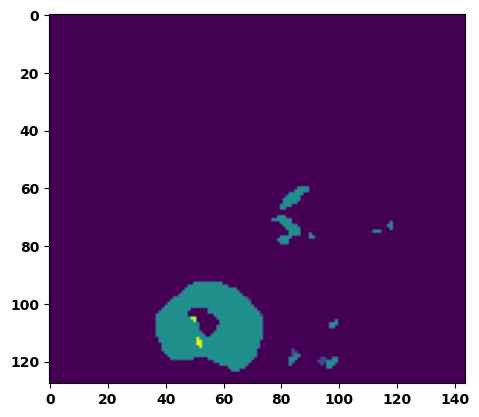

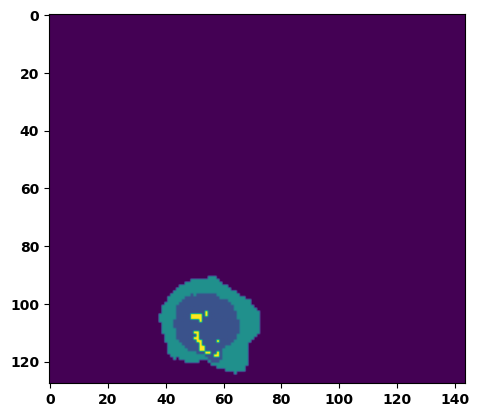

  6%|▌         | 2/36 [00:03<00:50,  1.50s/it]

Batch_id:  1 Eval loss:  0.12624208629131317
Batch_id:  1 Eval IoU:  tensor(0.8392, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9966, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.50s/it]

Batch_id:  2 Eval loss:  0.18249768018722534
Batch_id:  2 Eval IoU:  tensor(0.7954, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 11%|█         | 4/36 [00:05<00:45,  1.43s/it]

Batch_id:  3 Eval loss:  0.1165381520986557
Batch_id:  3 Eval IoU:  tensor(0.8167, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:41,  1.35s/it]

Batch_id:  4 Eval loss:  0.14192478358745575
Batch_id:  4 Eval IoU:  tensor(0.7925, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9442, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:44,  1.49s/it]

Batch_id:  5 Eval loss:  0.2250564843416214
Batch_id:  5 Eval IoU:  tensor(0.6907, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:40,  1.40s/it]

Batch_id:  6 Eval loss:  0.30030402541160583
Batch_id:  6 Eval IoU:  tensor(0.6078, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9557, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.46s/it]

Batch_id:  7 Eval loss:  0.23418019711971283
Batch_id:  7 Eval IoU:  tensor(0.6699, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9861, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:38,  1.43s/it]

Batch_id:  8 Eval loss:  0.08196951448917389
Batch_id:  8 Eval IoU:  tensor(0.8679, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9917, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:36,  1.41s/it]

Batch_id:  9 Eval loss:  0.22003349661827087
Batch_id:  9 Eval IoU:  tensor(0.7228, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  10 Eval loss:  0.10413333773612976
Batch_id:  10 Eval IoU:  tensor(0.8376, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


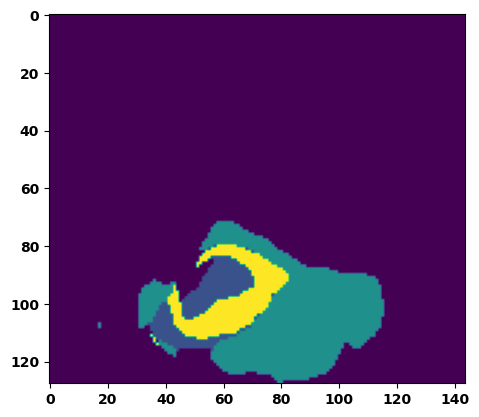

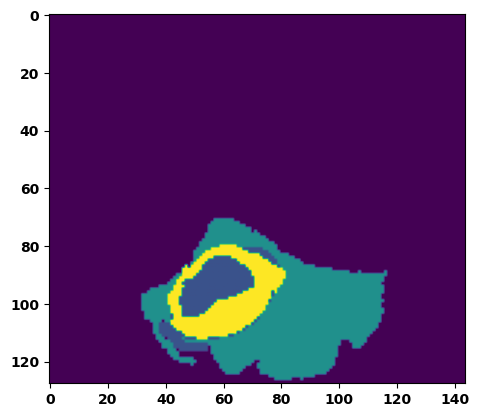

 33%|███▎      | 12/36 [00:17<00:35,  1.46s/it]

Batch_id:  11 Eval loss:  0.29372406005859375
Batch_id:  11 Eval IoU:  tensor(0.5796, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9337, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9167, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9781, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:33,  1.44s/it]

Batch_id:  12 Eval loss:  0.4547432065010071
Batch_id:  12 Eval IoU:  tensor(0.4726, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9540, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.42s/it]

Batch_id:  13 Eval loss:  0.1214655190706253
Batch_id:  13 Eval IoU:  tensor(0.8037, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9866, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:30,  1.45s/it]

Batch_id:  14 Eval loss:  0.09819424152374268
Batch_id:  14 Eval IoU:  tensor(0.8802, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9957, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.47s/it]

Batch_id:  15 Eval loss:  0.09647712111473083
Batch_id:  15 Eval IoU:  tensor(0.8527, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:27,  1.43s/it]

Batch_id:  16 Eval loss:  0.25675904750823975
Batch_id:  16 Eval IoU:  tensor(0.6640, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:27,  1.52s/it]

Batch_id:  17 Eval loss:  0.09810668230056763
Batch_id:  17 Eval IoU:  tensor(0.8422, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9887, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:25,  1.48s/it]

Batch_id:  18 Eval loss:  0.19460339844226837
Batch_id:  18 Eval IoU:  tensor(0.7419, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9957, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.48s/it]

Batch_id:  19 Eval loss:  0.17328789830207825
Batch_id:  19 Eval IoU:  tensor(0.7520, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  20 Eval loss:  0.40256625413894653
Batch_id:  20 Eval IoU:  tensor(0.5355, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9088, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.8646, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.8636, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


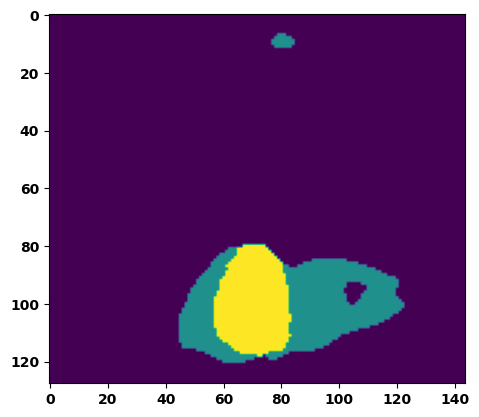

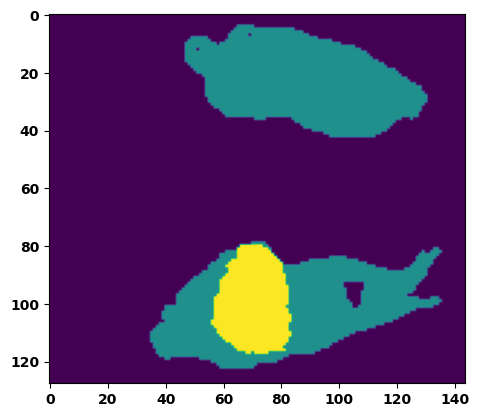

 61%|██████    | 22/36 [00:32<00:22,  1.59s/it]

Batch_id:  21 Eval loss:  0.27522730827331543
Batch_id:  21 Eval IoU:  tensor(0.6422, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9909, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:20,  1.55s/it]

Batch_id:  22 Eval loss:  0.7203066945075989
Batch_id:  22 Eval IoU:  tensor(0.2441, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9273, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9010, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9092, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.49s/it]

Batch_id:  23 Eval loss:  0.14421235024929047
Batch_id:  23 Eval IoU:  tensor(0.7929, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9954, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:16,  1.47s/it]

Batch_id:  24 Eval loss:  0.3813208341598511
Batch_id:  24 Eval IoU:  tensor(0.5066, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9267, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9196, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.49s/it]

Batch_id:  25 Eval loss:  0.35930484533309937
Batch_id:  25 Eval IoU:  tensor(0.5797, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:13,  1.45s/it]

Batch_id:  26 Eval loss:  0.09340359270572662
Batch_id:  26 Eval IoU:  tensor(0.8544, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9812, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.40s/it]

Batch_id:  27 Eval loss:  0.19347967207431793
Batch_id:  27 Eval IoU:  tensor(0.7166, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9882, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:09,  1.41s/it]

Batch_id:  28 Eval loss:  0.14922194182872772
Batch_id:  28 Eval IoU:  tensor(0.7795, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.38s/it]

Batch_id:  29 Eval loss:  0.1560775637626648
Batch_id:  29 Eval IoU:  tensor(0.7671, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  30 Eval loss:  0.257996529340744
Batch_id:  30 Eval IoU:  tensor(0.6502, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9875, device='cuda:0')


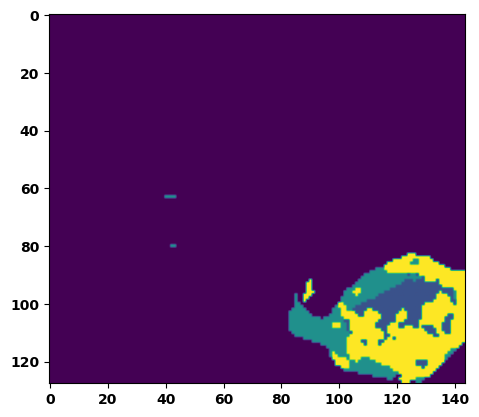

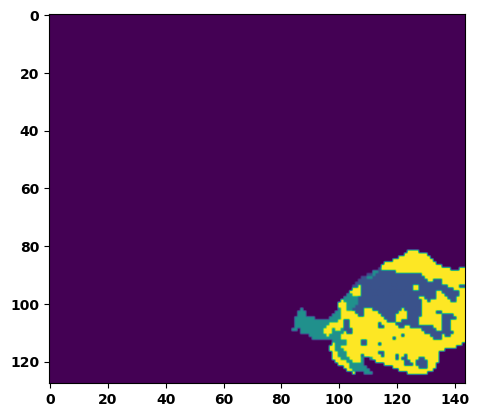

 89%|████████▉ | 32/36 [00:47<00:05,  1.47s/it]

Batch_id:  31 Eval loss:  0.2809087634086609
Batch_id:  31 Eval IoU:  tensor(0.6762, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.43s/it]

Batch_id:  32 Eval loss:  0.4944199323654175
Batch_id:  32 Eval IoU:  tensor(0.4111, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9298, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9327, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9967, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.42s/it]

Batch_id:  33 Eval loss:  0.10118196904659271
Batch_id:  33 Eval IoU:  tensor(0.8383, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9888, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.43s/it]

Batch_id:  34 Eval loss:  0.11160659790039062
Batch_id:  34 Eval IoU:  tensor(0.8259, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.47s/it]

Batch_id:  35 Eval loss:  0.29239654541015625
Batch_id:  35 Eval IoU:  tensor(0.6089, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9751, device='cuda:0')
Epoch  13 Training loss:  0.23241323679685594
Epoch  13 Evaluation loss:  0.2341478992667463
Epoch  13 Training accuracy :  tensor(0.6916)
Epoch  13 Evaluation accuracy :  tensor(0.6978)
Epoch  13 Training Mean Dice Score:  tensor(0.9725)
Epoch  13 Eval Mean Dice Score:  tensor(0.9715)
Epoch  13 Training Non-tumor Dice Score:  tensor(0.9758)
Epoch  13 Eval Non-tumor Dice Score:  tensor(0.9708)
Epoch  13 Training NCR/NET Dice Score:  tensor(0.9849)
Epoch  13 Eval NCR/NET Dice Score:  tensor(0.9866)
Epoch  13 Training ED Dice Score:  tensor(0.9

Epoch: 14
Training in session: 


  1%|          | 1/110 [00:01<02:32,  1.40s/it]

Batch_id:  0 Training loss:  0.11592385172843933
Batch_id:  0 Training IoU:  tensor(0.8224, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:42,  1.51s/it]

Batch_id:  1 Training loss:  0.29361021518707275
Batch_id:  1 Training IoU:  tensor(0.6523, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:33,  1.44s/it]

Batch_id:  2 Training loss:  0.18691067397594452
Batch_id:  2 Training IoU:  tensor(0.7123, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9802, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:30,  1.42s/it]

Batch_id:  3 Training loss:  0.09078381955623627
Batch_id:  3 Training IoU:  tensor(0.8646, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:33,  1.46s/it]

Batch_id:  4 Training loss:  0.13211022317409515
Batch_id:  4 Training IoU:  tensor(0.7911, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:33,  1.48s/it]

Batch_id:  5 Training loss:  0.10887251794338226
Batch_id:  5 Training IoU:  tensor(0.8237, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:29,  1.45s/it]

Batch_id:  6 Training loss:  0.23268796503543854
Batch_id:  6 Training IoU:  tensor(0.6924, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:32,  1.50s/it]

Batch_id:  7 Training loss:  0.13053813576698303
Batch_id:  7 Training IoU:  tensor(0.7991, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:33,  1.52s/it]

Batch_id:  8 Training loss:  0.21717949211597443
Batch_id:  8 Training IoU:  tensor(0.7198, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:29,  1.49s/it]

Batch_id:  9 Training loss:  0.20031169056892395
Batch_id:  9 Training IoU:  tensor(0.7585, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 10%|█         | 11/110 [00:16<02:28,  1.50s/it]

Batch_id:  10 Training loss:  0.06535068154335022
Batch_id:  10 Training IoU:  tensor(0.8984, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 11%|█         | 12/110 [00:17<02:27,  1.50s/it]

Batch_id:  11 Training loss:  0.30163508653640747
Batch_id:  11 Training IoU:  tensor(0.5736, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9145, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9085, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.8854, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:24,  1.49s/it]

Batch_id:  12 Training loss:  0.5268073678016663
Batch_id:  12 Training IoU:  tensor(0.3836, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9173, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9003, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.8773, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:22,  1.48s/it]

Batch_id:  13 Training loss:  0.19617979228496552
Batch_id:  13 Training IoU:  tensor(0.7189, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:17,  1.45s/it]

Batch_id:  14 Training loss:  0.19000020623207092
Batch_id:  14 Training IoU:  tensor(0.7452, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:18,  1.48s/it]

Batch_id:  15 Training loss:  0.29679322242736816
Batch_id:  15 Training IoU:  tensor(0.6618, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:21,  1.52s/it]

Batch_id:  16 Training loss:  0.2552131414413452
Batch_id:  16 Training IoU:  tensor(0.6965, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:23,  1.56s/it]

Batch_id:  17 Training loss:  0.24091190099716187
Batch_id:  17 Training IoU:  tensor(0.6872, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:23,  1.57s/it]

Batch_id:  18 Training loss:  0.14567606151103973
Batch_id:  18 Training IoU:  tensor(0.7772, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:15,  1.51s/it]

Batch_id:  19 Training loss:  0.20153173804283142
Batch_id:  19 Training IoU:  tensor(0.7017, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9816, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:10,  1.47s/it]

Batch_id:  20 Training loss:  0.2101784199476242
Batch_id:  20 Training IoU:  tensor(0.7548, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 20%|██        | 22/110 [00:32<02:10,  1.49s/it]

Batch_id:  21 Training loss:  0.20593105256557465
Batch_id:  21 Training IoU:  tensor(0.7028, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 21%|██        | 23/110 [00:34<02:12,  1.52s/it]

Batch_id:  22 Training loss:  0.13194236159324646
Batch_id:  22 Training IoU:  tensor(0.7932, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:10,  1.52s/it]

Batch_id:  23 Training loss:  0.387839138507843
Batch_id:  23 Training IoU:  tensor(0.5266, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9378, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:07,  1.50s/it]

Batch_id:  24 Training loss:  0.1916709691286087
Batch_id:  24 Training IoU:  tensor(0.7118, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9815, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:04,  1.48s/it]

Batch_id:  25 Training loss:  0.09106561541557312
Batch_id:  25 Training IoU:  tensor(0.8520, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 25%|██▍       | 27/110 [00:40<02:02,  1.48s/it]

Batch_id:  26 Training loss:  0.3079564571380615
Batch_id:  26 Training IoU:  tensor(0.6504, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 25%|██▌       | 28/110 [00:41<01:59,  1.46s/it]

Batch_id:  27 Training loss:  0.2918906807899475
Batch_id:  27 Training IoU:  tensor(0.6785, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 26%|██▋       | 29/110 [00:43<01:57,  1.46s/it]

Batch_id:  28 Training loss:  0.06310102343559265
Batch_id:  28 Training IoU:  tensor(0.9023, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:57,  1.47s/it]

Batch_id:  29 Training loss:  0.2698761522769928
Batch_id:  29 Training IoU:  tensor(0.6385, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 28%|██▊       | 31/110 [00:46<01:57,  1.49s/it]

Batch_id:  30 Training loss:  0.1457241326570511
Batch_id:  30 Training IoU:  tensor(0.7787, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 29%|██▉       | 32/110 [00:47<01:58,  1.53s/it]

Batch_id:  31 Training loss:  0.29794222116470337
Batch_id:  31 Training IoU:  tensor(0.6295, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 30%|███       | 33/110 [00:49<01:58,  1.55s/it]

Batch_id:  32 Training loss:  0.1516566425561905
Batch_id:  32 Training IoU:  tensor(0.7691, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 31%|███       | 34/110 [00:50<01:53,  1.50s/it]

Batch_id:  33 Training loss:  0.1301816999912262
Batch_id:  33 Training IoU:  tensor(0.8076, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9528, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:54,  1.53s/it]

Batch_id:  34 Training loss:  0.3120776414871216
Batch_id:  34 Training IoU:  tensor(0.5903, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9526, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:55,  1.56s/it]

Batch_id:  35 Training loss:  0.17922760546207428
Batch_id:  35 Training IoU:  tensor(0.7530, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 34%|███▎      | 37/110 [00:55<01:54,  1.56s/it]

Batch_id:  36 Training loss:  0.48648419976234436
Batch_id:  36 Training IoU:  tensor(0.4298, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:49,  1.52s/it]

Batch_id:  37 Training loss:  0.11840994656085968
Batch_id:  37 Training IoU:  tensor(0.8178, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9806, device='cuda:0')


 35%|███▌      | 39/110 [00:58<01:46,  1.50s/it]

Batch_id:  38 Training loss:  0.16372330486774445
Batch_id:  38 Training IoU:  tensor(0.8019, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 36%|███▋      | 40/110 [00:59<01:44,  1.49s/it]

Batch_id:  39 Training loss:  0.18706026673316956
Batch_id:  39 Training IoU:  tensor(0.7125, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:42,  1.49s/it]

Batch_id:  40 Training loss:  0.2618703842163086
Batch_id:  40 Training IoU:  tensor(0.6358, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:42,  1.51s/it]

Batch_id:  41 Training loss:  0.155027374625206
Batch_id:  41 Training IoU:  tensor(0.7569, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:39,  1.48s/it]

Batch_id:  42 Training loss:  0.19743607938289642
Batch_id:  42 Training IoU:  tensor(0.7006, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 40%|████      | 44/110 [01:05<01:37,  1.47s/it]

Batch_id:  43 Training loss:  0.09232565760612488
Batch_id:  43 Training IoU:  tensor(0.8593, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 41%|████      | 45/110 [01:07<01:36,  1.49s/it]

Batch_id:  44 Training loss:  0.1107056587934494
Batch_id:  44 Training IoU:  tensor(0.8268, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:35,  1.49s/it]

Batch_id:  45 Training loss:  0.28870779275894165
Batch_id:  45 Training IoU:  tensor(0.5940, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9833, device='cuda:0')


 43%|████▎     | 47/110 [01:10<01:34,  1.50s/it]

Batch_id:  46 Training loss:  0.5895132422447205
Batch_id:  46 Training IoU:  tensor(0.3440, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9370, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9398, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:31,  1.47s/it]

Batch_id:  47 Training loss:  0.28493770956993103
Batch_id:  47 Training IoU:  tensor(0.6568, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 45%|████▍     | 49/110 [01:13<01:32,  1.52s/it]

Batch_id:  48 Training loss:  0.26840442419052124
Batch_id:  48 Training IoU:  tensor(0.6687, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 45%|████▌     | 50/110 [01:15<01:35,  1.59s/it]

Batch_id:  49 Training loss:  0.20903362333774567
Batch_id:  49 Training IoU:  tensor(0.6918, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 46%|████▋     | 51/110 [01:16<01:32,  1.56s/it]

Batch_id:  50 Training loss:  0.1547553390264511
Batch_id:  50 Training IoU:  tensor(0.7533, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


 47%|████▋     | 52/110 [01:18<01:33,  1.62s/it]

Batch_id:  51 Training loss:  0.5002789497375488
Batch_id:  51 Training IoU:  tensor(0.4643, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9540, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9576, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9989, device='cuda:0')


 48%|████▊     | 53/110 [01:19<01:29,  1.57s/it]

Batch_id:  52 Training loss:  0.2047472447156906
Batch_id:  52 Training IoU:  tensor(0.7076, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 49%|████▉     | 54/110 [01:21<01:28,  1.58s/it]

Batch_id:  53 Training loss:  0.3797939419746399
Batch_id:  53 Training IoU:  tensor(0.5378, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 50%|█████     | 55/110 [01:22<01:25,  1.56s/it]

Batch_id:  54 Training loss:  0.1784205138683319
Batch_id:  54 Training IoU:  tensor(0.7248, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9747, device='cuda:0')


 51%|█████     | 56/110 [01:24<01:22,  1.53s/it]

Batch_id:  55 Training loss:  0.36013418436050415
Batch_id:  55 Training IoU:  tensor(0.5732, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9257, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 52%|█████▏    | 57/110 [01:25<01:18,  1.48s/it]

Batch_id:  56 Training loss:  0.2814146876335144
Batch_id:  56 Training IoU:  tensor(0.7062, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 53%|█████▎    | 58/110 [01:27<01:17,  1.50s/it]

Batch_id:  57 Training loss:  0.1807699203491211
Batch_id:  57 Training IoU:  tensor(0.7482, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 54%|█████▎    | 59/110 [01:28<01:18,  1.53s/it]

Batch_id:  58 Training loss:  0.46592700481414795
Batch_id:  58 Training IoU:  tensor(0.4958, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 55%|█████▍    | 60/110 [01:30<01:16,  1.52s/it]

Batch_id:  59 Training loss:  0.3237294554710388
Batch_id:  59 Training IoU:  tensor(0.5588, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9477, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9347, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9662, device='cuda:0')


 55%|█████▌    | 61/110 [01:31<01:09,  1.43s/it]

Batch_id:  60 Training loss:  0.2747257351875305
Batch_id:  60 Training IoU:  tensor(0.6076, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 56%|█████▋    | 62/110 [01:33<01:11,  1.49s/it]

Batch_id:  61 Training loss:  0.31716030836105347
Batch_id:  61 Training IoU:  tensor(0.6196, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 57%|█████▋    | 63/110 [01:34<01:08,  1.45s/it]

Batch_id:  62 Training loss:  0.3535911440849304
Batch_id:  62 Training IoU:  tensor(0.5572, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 58%|█████▊    | 64/110 [01:35<01:03,  1.39s/it]

Batch_id:  63 Training loss:  0.2741205394268036
Batch_id:  63 Training IoU:  tensor(0.6120, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9754, device='cuda:0')


 59%|█████▉    | 65/110 [01:37<01:01,  1.37s/it]

Batch_id:  64 Training loss:  0.21077626943588257
Batch_id:  64 Training IoU:  tensor(0.6898, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 60%|██████    | 66/110 [01:38<01:01,  1.39s/it]

Batch_id:  65 Training loss:  0.12645865976810455
Batch_id:  65 Training IoU:  tensor(0.7974, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 61%|██████    | 67/110 [01:40<01:05,  1.51s/it]

Batch_id:  66 Training loss:  0.12397409975528717
Batch_id:  66 Training IoU:  tensor(0.8370, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 62%|██████▏   | 68/110 [01:41<01:01,  1.47s/it]

Batch_id:  67 Training loss:  0.18239726126194
Batch_id:  67 Training IoU:  tensor(0.7207, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9711, device='cuda:0')


 63%|██████▎   | 69/110 [01:43<00:57,  1.40s/it]

Batch_id:  68 Training loss:  0.23325969278812408
Batch_id:  68 Training IoU:  tensor(0.6839, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 64%|██████▎   | 70/110 [01:44<00:59,  1.50s/it]

Batch_id:  69 Training loss:  0.31199783086776733
Batch_id:  69 Training IoU:  tensor(0.5785, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 65%|██████▍   | 71/110 [01:46<00:57,  1.47s/it]

Batch_id:  70 Training loss:  0.11438044905662537
Batch_id:  70 Training IoU:  tensor(0.8223, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


 65%|██████▌   | 72/110 [01:47<00:53,  1.42s/it]

Batch_id:  71 Training loss:  0.5878090262413025
Batch_id:  71 Training IoU:  tensor(0.3543, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9452, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 66%|██████▋   | 73/110 [01:48<00:51,  1.40s/it]

Batch_id:  72 Training loss:  0.32435938715934753
Batch_id:  72 Training IoU:  tensor(0.5591, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9221, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9192, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9690, device='cuda:0')


 67%|██████▋   | 74/110 [01:50<00:49,  1.36s/it]

Batch_id:  73 Training loss:  0.45078474283218384
Batch_id:  73 Training IoU:  tensor(0.4635, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9102, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9142, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9015, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9691, device='cuda:0')


 68%|██████▊   | 75/110 [01:51<00:48,  1.38s/it]

Batch_id:  74 Training loss:  0.08185972273349762
Batch_id:  74 Training IoU:  tensor(0.8743, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:47,  1.38s/it]

Batch_id:  75 Training loss:  0.21671217679977417
Batch_id:  75 Training IoU:  tensor(0.6861, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 70%|███████   | 77/110 [01:54<00:45,  1.39s/it]

Batch_id:  76 Training loss:  0.20364923775196075
Batch_id:  76 Training IoU:  tensor(0.6966, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9725, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:44,  1.39s/it]

Batch_id:  77 Training loss:  0.2753419578075409
Batch_id:  77 Training IoU:  tensor(0.6672, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:43,  1.40s/it]

Batch_id:  78 Training loss:  0.21388749778270721
Batch_id:  78 Training IoU:  tensor(0.6888, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 73%|███████▎  | 80/110 [01:58<00:41,  1.37s/it]

Batch_id:  79 Training loss:  0.20983028411865234
Batch_id:  79 Training IoU:  tensor(0.6954, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 74%|███████▎  | 81/110 [01:59<00:40,  1.41s/it]

Batch_id:  80 Training loss:  0.47792816162109375
Batch_id:  80 Training IoU:  tensor(0.4507, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 75%|███████▍  | 82/110 [02:01<00:40,  1.43s/it]

Batch_id:  81 Training loss:  0.2109897881746292
Batch_id:  81 Training IoU:  tensor(0.6937, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9370, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9752, device='cuda:0')


 75%|███████▌  | 83/110 [02:02<00:39,  1.45s/it]

Batch_id:  82 Training loss:  0.42660966515541077
Batch_id:  82 Training IoU:  tensor(0.4923, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 76%|███████▋  | 84/110 [02:04<00:37,  1.43s/it]

Batch_id:  83 Training loss:  0.1618785262107849
Batch_id:  83 Training IoU:  tensor(0.7742, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 77%|███████▋  | 85/110 [02:05<00:35,  1.44s/it]

Batch_id:  84 Training loss:  0.1158609688282013
Batch_id:  84 Training IoU:  tensor(0.8148, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 78%|███████▊  | 86/110 [02:07<00:33,  1.41s/it]

Batch_id:  85 Training loss:  0.15024089813232422
Batch_id:  85 Training IoU:  tensor(0.7644, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9753, device='cuda:0')


 79%|███████▉  | 87/110 [02:08<00:33,  1.44s/it]

Batch_id:  86 Training loss:  0.17766357958316803
Batch_id:  86 Training IoU:  tensor(0.7411, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 80%|████████  | 88/110 [02:10<00:31,  1.43s/it]

Batch_id:  87 Training loss:  0.1049639880657196
Batch_id:  87 Training IoU:  tensor(0.8526, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 81%|████████  | 89/110 [02:11<00:29,  1.40s/it]

Batch_id:  88 Training loss:  0.17143657803535461
Batch_id:  88 Training IoU:  tensor(0.7592, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 82%|████████▏ | 90/110 [02:12<00:28,  1.42s/it]

Batch_id:  89 Training loss:  0.17596201598644257
Batch_id:  89 Training IoU:  tensor(0.7800, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 83%|████████▎ | 91/110 [02:14<00:27,  1.46s/it]

Batch_id:  90 Training loss:  0.10493528842926025
Batch_id:  90 Training IoU:  tensor(0.8321, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 84%|████████▎ | 92/110 [02:15<00:26,  1.46s/it]

Batch_id:  91 Training loss:  0.2162299007177353
Batch_id:  91 Training IoU:  tensor(0.6935, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9806, device='cuda:0')


 85%|████████▍ | 93/110 [02:17<00:25,  1.47s/it]

Batch_id:  92 Training loss:  0.22997137904167175
Batch_id:  92 Training IoU:  tensor(0.6974, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 85%|████████▌ | 94/110 [02:18<00:22,  1.43s/it]

Batch_id:  93 Training loss:  0.06473435461521149
Batch_id:  93 Training IoU:  tensor(0.9100, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 86%|████████▋ | 95/110 [02:20<00:21,  1.42s/it]

Batch_id:  94 Training loss:  0.13802190124988556
Batch_id:  94 Training IoU:  tensor(0.7860, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 87%|████████▋ | 96/110 [02:21<00:20,  1.44s/it]

Batch_id:  95 Training loss:  0.32706373929977417
Batch_id:  95 Training IoU:  tensor(0.6207, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 88%|████████▊ | 97/110 [02:22<00:18,  1.43s/it]

Batch_id:  96 Training loss:  0.14124692976474762
Batch_id:  96 Training IoU:  tensor(0.8041, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 89%|████████▉ | 98/110 [02:24<00:17,  1.45s/it]

Batch_id:  97 Training loss:  0.21526722609996796
Batch_id:  97 Training IoU:  tensor(0.7058, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:15,  1.40s/it]

Batch_id:  98 Training loss:  0.16049805283546448
Batch_id:  98 Training IoU:  tensor(0.7783, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 91%|█████████ | 100/110 [02:27<00:14,  1.42s/it]

Batch_id:  99 Training loss:  0.29632848501205444
Batch_id:  99 Training IoU:  tensor(0.5972, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9391, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:12,  1.43s/it]

Batch_id:  100 Training loss:  0.2752980887889862
Batch_id:  100 Training IoU:  tensor(0.6224, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 93%|█████████▎| 102/110 [02:30<00:11,  1.46s/it]

Batch_id:  101 Training loss:  0.14284636080265045
Batch_id:  101 Training IoU:  tensor(0.7877, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.46s/it]

Batch_id:  102 Training loss:  0.13005933165550232
Batch_id:  102 Training IoU:  tensor(0.7919, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 95%|█████████▍| 104/110 [02:33<00:08,  1.44s/it]

Batch_id:  103 Training loss:  0.36815500259399414
Batch_id:  103 Training IoU:  tensor(0.5177, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9233, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9367, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9447, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.8939, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.47s/it]

Batch_id:  104 Training loss:  0.11224138736724854
Batch_id:  104 Training IoU:  tensor(0.8252, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:05,  1.44s/it]

Batch_id:  105 Training loss:  0.14864608645439148
Batch_id:  105 Training IoU:  tensor(0.7810, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.51s/it]

Batch_id:  106 Training loss:  0.08214817941188812
Batch_id:  106 Training IoU:  tensor(0.8685, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 98%|█████████▊| 108/110 [02:39<00:03,  1.53s/it]

Batch_id:  107 Training loss:  0.10746103525161743
Batch_id:  107 Training IoU:  tensor(0.8346, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.50s/it]

Batch_id:  108 Training loss:  0.2398330420255661
Batch_id:  108 Training IoU:  tensor(0.6808, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


100%|██████████| 110/110 [02:42<00:00,  1.48s/it]


Batch_id:  109 Training loss:  0.05502063035964966
Batch_id:  109 Training IoU:  tensor(0.9134, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9951, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.09445805847644806
Batch_id:  0 Eval IoU:  tensor(0.8550, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')


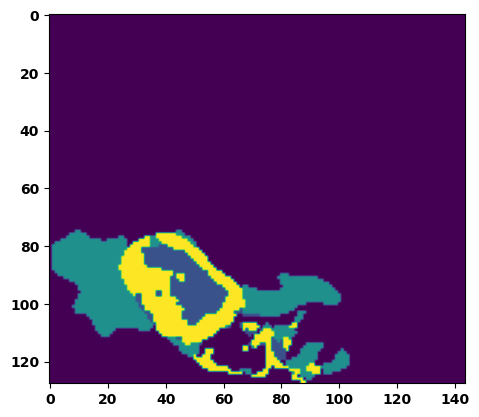

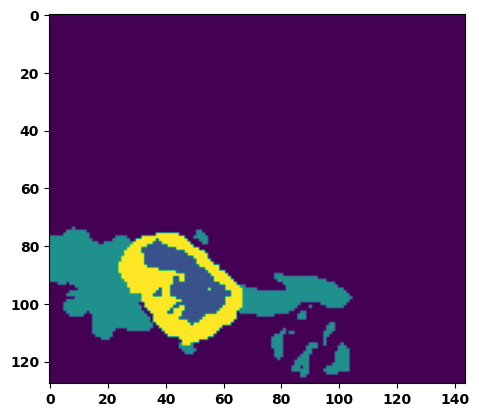

  6%|▌         | 2/36 [00:02<00:48,  1.44s/it]

Batch_id:  1 Eval loss:  0.7263466715812683
Batch_id:  1 Eval IoU:  tensor(0.2439, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9280, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9032, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9084, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:46,  1.41s/it]

Batch_id:  2 Eval loss:  0.17625601589679718
Batch_id:  2 Eval IoU:  tensor(0.7688, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9974, device='cuda:0')


 11%|█         | 4/36 [00:05<00:47,  1.48s/it]

Batch_id:  3 Eval loss:  0.2561573386192322
Batch_id:  3 Eval IoU:  tensor(0.6528, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9883, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:43,  1.39s/it]

Batch_id:  4 Eval loss:  0.2127067744731903
Batch_id:  4 Eval IoU:  tensor(0.7013, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:42,  1.43s/it]

Batch_id:  5 Eval loss:  0.22927585244178772
Batch_id:  5 Eval IoU:  tensor(0.6869, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 19%|█▉        | 7/36 [00:09<00:40,  1.41s/it]

Batch_id:  6 Eval loss:  0.10086920857429504
Batch_id:  6 Eval IoU:  tensor(0.8438, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:39,  1.40s/it]

Batch_id:  7 Eval loss:  0.10409876704216003
Batch_id:  7 Eval IoU:  tensor(0.8338, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')


 25%|██▌       | 9/36 [00:12<00:38,  1.42s/it]

Batch_id:  8 Eval loss:  0.3638212978839874
Batch_id:  8 Eval IoU:  tensor(0.5706, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:36,  1.42s/it]

Batch_id:  9 Eval loss:  0.43862780928611755
Batch_id:  9 Eval IoU:  tensor(0.4544, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9311, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  10 Eval loss:  0.15547974407672882
Batch_id:  10 Eval IoU:  tensor(0.7675, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9948, device='cuda:0')


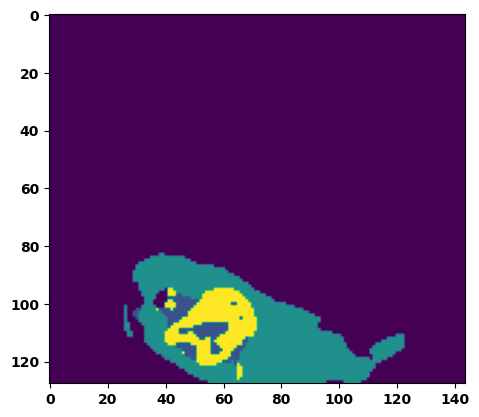

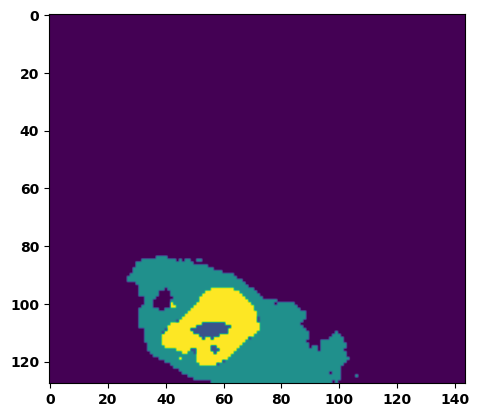

 33%|███▎      | 12/36 [00:17<00:35,  1.48s/it]

Batch_id:  11 Eval loss:  0.13198229670524597
Batch_id:  11 Eval IoU:  tensor(0.7849, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9842, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:33,  1.47s/it]

Batch_id:  12 Eval loss:  0.27927374839782715
Batch_id:  12 Eval IoU:  tensor(0.5943, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9358, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9192, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9803, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.42s/it]

Batch_id:  13 Eval loss:  0.10424824059009552
Batch_id:  13 Eval IoU:  tensor(0.8598, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:29,  1.42s/it]

Batch_id:  14 Eval loss:  0.2737874388694763
Batch_id:  14 Eval IoU:  tensor(0.6858, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.49s/it]

Batch_id:  15 Eval loss:  0.19056566059589386
Batch_id:  15 Eval IoU:  tensor(0.7576, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:28,  1.48s/it]

Batch_id:  16 Eval loss:  0.3967795968055725
Batch_id:  16 Eval IoU:  tensor(0.5424, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9106, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.8668, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.8662, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9989, device='cuda:0')


 50%|█████     | 18/36 [00:25<00:25,  1.44s/it]

Batch_id:  17 Eval loss:  0.09147217869758606
Batch_id:  17 Eval IoU:  tensor(0.8584, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9826, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.47s/it]

Batch_id:  18 Eval loss:  0.14119663834571838
Batch_id:  18 Eval IoU:  tensor(0.7883, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


 56%|█████▌    | 20/36 [00:28<00:22,  1.43s/it]

Batch_id:  19 Eval loss:  0.10749466717243195
Batch_id:  19 Eval IoU:  tensor(0.8226, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  20 Eval loss:  0.5054280757904053
Batch_id:  20 Eval IoU:  tensor(0.4440, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9988, device='cuda:0')


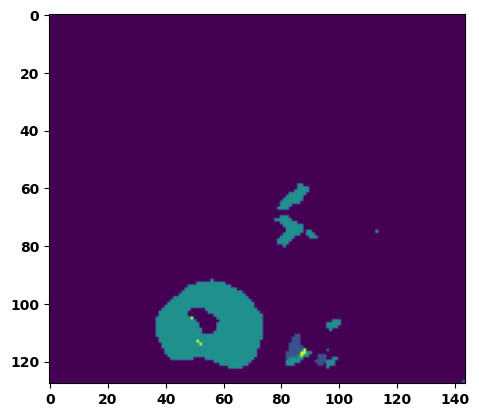

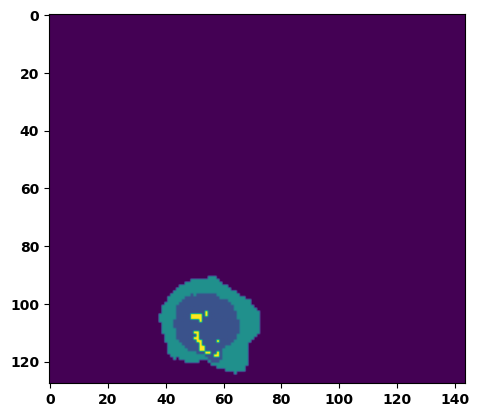

 61%|██████    | 22/36 [00:31<00:20,  1.49s/it]

Batch_id:  21 Eval loss:  0.1402251422405243
Batch_id:  21 Eval IoU:  tensor(0.7797, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9866, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.49s/it]

Batch_id:  22 Eval loss:  0.44339215755462646
Batch_id:  22 Eval IoU:  tensor(0.4887, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:18,  1.50s/it]

Batch_id:  23 Eval loss:  0.15971891582012177
Batch_id:  23 Eval IoU:  tensor(0.7713, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9912, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.45s/it]

Batch_id:  24 Eval loss:  0.1079019159078598
Batch_id:  24 Eval IoU:  tensor(0.8669, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 72%|███████▏  | 26/36 [00:37<00:14,  1.45s/it]

Batch_id:  25 Eval loss:  0.3117491900920868
Batch_id:  25 Eval IoU:  tensor(0.5863, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9690, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:13,  1.48s/it]

Batch_id:  26 Eval loss:  0.2133406549692154
Batch_id:  26 Eval IoU:  tensor(0.6921, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:12,  1.51s/it]

Batch_id:  27 Eval loss:  0.37769412994384766
Batch_id:  27 Eval IoU:  tensor(0.5057, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9288, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9222, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.46s/it]

Batch_id:  28 Eval loss:  0.253490686416626
Batch_id:  28 Eval IoU:  tensor(0.6681, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.44s/it]

Batch_id:  29 Eval loss:  0.20626001060009003
Batch_id:  29 Eval IoU:  tensor(0.7211, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  30 Eval loss:  0.13330768048763275
Batch_id:  30 Eval IoU:  tensor(0.8023, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9444, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


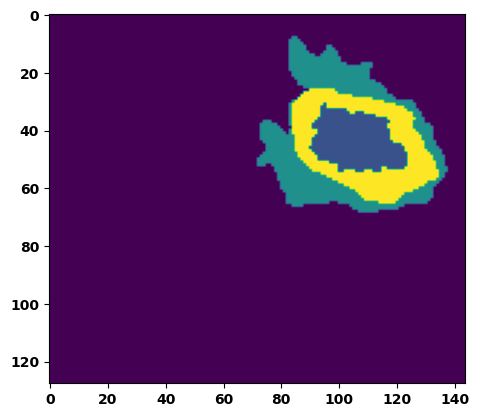

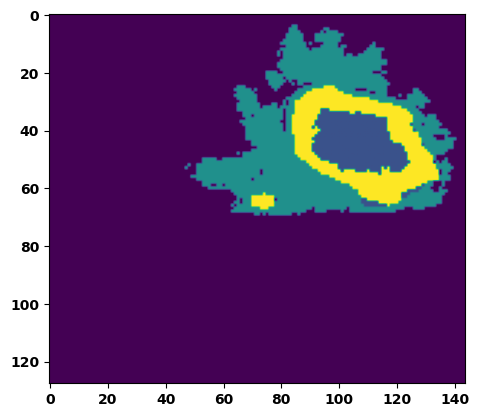

 89%|████████▉ | 32/36 [00:46<00:05,  1.46s/it]

Batch_id:  31 Eval loss:  0.18788638710975647
Batch_id:  31 Eval IoU:  tensor(0.7206, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9896, device='cuda:0')


 92%|█████████▏| 33/36 [00:47<00:04,  1.44s/it]

Batch_id:  32 Eval loss:  0.13067810237407684
Batch_id:  32 Eval IoU:  tensor(0.7936, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.46s/it]

Batch_id:  33 Eval loss:  0.07776828110218048
Batch_id:  33 Eval IoU:  tensor(0.8747, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9921, device='cuda:0')


 97%|█████████▋| 35/36 [00:50<00:01,  1.43s/it]

Batch_id:  34 Eval loss:  0.08523201942443848
Batch_id:  34 Eval IoU:  tensor(0.8615, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.46s/it]

Batch_id:  35 Eval loss:  0.2565864026546478
Batch_id:  35 Eval IoU:  tensor(0.6547, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')
Epoch  14 Training loss:  0.22506833726709538
Epoch  14 Evaluation loss:  0.226821048806111
Epoch  14 Training accuracy :  tensor(0.7015)
Epoch  14 Evaluation accuracy :  tensor(0.7029)
Epoch  14 Training Mean Dice Score:  tensor(0.9738)
Epoch  14 Eval Mean Dice Score:  tensor(0.9718)
Epoch  14 Training Non-tumor Dice Score:  tensor(0.9767)
Epoch  14 Eval Non-tumor Dice Score:  tensor(0.9708)
Epoch  14 Training NCR/NET Dice Score:  tensor(0.9859)
Epoch  14 Eval NCR/NET Dice Score:  tensor(0.9874)
Epoch  14 Training ED Dice Score:  tensor(0.969

Best Model saved!
Epoch: 15
Training in session: 


  1%|          | 1/110 [00:01<02:49,  1.55s/it]

Batch_id:  0 Training loss:  0.1166248768568039
Batch_id:  0 Training IoU:  tensor(0.8496, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:37,  1.46s/it]

Batch_id:  1 Training loss:  0.09763088822364807
Batch_id:  1 Training IoU:  tensor(0.8437, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:34,  1.45s/it]

Batch_id:  2 Training loss:  0.11377222836017609
Batch_id:  2 Training IoU:  tensor(0.8331, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:27,  1.39s/it]

Batch_id:  3 Training loss:  0.20829591155052185
Batch_id:  3 Training IoU:  tensor(0.6946, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9791, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:28,  1.42s/it]

Batch_id:  4 Training loss:  0.6163337230682373
Batch_id:  4 Training IoU:  tensor(0.3192, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9349, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9342, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:38,  1.53s/it]

Batch_id:  5 Training loss:  0.1887126863002777
Batch_id:  5 Training IoU:  tensor(0.7207, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:37,  1.52s/it]

Batch_id:  6 Training loss:  0.15154685080051422
Batch_id:  6 Training IoU:  tensor(0.7621, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:37,  1.54s/it]

Batch_id:  7 Training loss:  0.206314817070961
Batch_id:  7 Training IoU:  tensor(0.6938, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9814, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:35,  1.54s/it]

Batch_id:  8 Training loss:  0.10228985548019409
Batch_id:  8 Training IoU:  tensor(0.8425, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:32,  1.53s/it]

Batch_id:  9 Training loss:  0.20401684939861298
Batch_id:  9 Training IoU:  tensor(0.6921, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9314, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9842, device='cuda:0')


 10%|█         | 11/110 [00:16<02:31,  1.53s/it]

Batch_id:  10 Training loss:  0.26027002930641174
Batch_id:  10 Training IoU:  tensor(0.6802, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 11%|█         | 12/110 [00:18<02:29,  1.52s/it]

Batch_id:  11 Training loss:  0.13336120545864105
Batch_id:  11 Training IoU:  tensor(0.8004, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9820, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:26,  1.51s/it]

Batch_id:  12 Training loss:  0.10629649460315704
Batch_id:  12 Training IoU:  tensor(0.8263, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:21,  1.47s/it]

Batch_id:  13 Training loss:  0.2917758822441101
Batch_id:  13 Training IoU:  tensor(0.6632, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9979, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:25,  1.53s/it]

Batch_id:  14 Training loss:  0.11727336049079895
Batch_id:  14 Training IoU:  tensor(0.8115, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:21,  1.51s/it]

Batch_id:  15 Training loss:  0.13261565566062927
Batch_id:  15 Training IoU:  tensor(0.7869, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:22,  1.53s/it]

Batch_id:  16 Training loss:  0.05996590852737427
Batch_id:  16 Training IoU:  tensor(0.9027, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:16,  1.49s/it]

Batch_id:  17 Training loss:  0.15978123247623444
Batch_id:  17 Training IoU:  tensor(0.7602, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:14,  1.47s/it]

Batch_id:  18 Training loss:  0.14751918613910675
Batch_id:  18 Training IoU:  tensor(0.7616, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9738, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:10,  1.44s/it]

Batch_id:  19 Training loss:  0.43037450313568115
Batch_id:  19 Training IoU:  tensor(0.4914, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:06,  1.43s/it]

Batch_id:  20 Training loss:  0.12765949964523315
Batch_id:  20 Training IoU:  tensor(0.8004, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9755, device='cuda:0')


 20%|██        | 22/110 [00:32<02:06,  1.44s/it]

Batch_id:  21 Training loss:  0.2072705775499344
Batch_id:  21 Training IoU:  tensor(0.7273, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 21%|██        | 23/110 [00:34<02:09,  1.48s/it]

Batch_id:  22 Training loss:  0.15365207195281982
Batch_id:  22 Training IoU:  tensor(0.7840, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:00,  1.40s/it]

Batch_id:  23 Training loss:  0.2906932830810547
Batch_id:  23 Training IoU:  tensor(0.6779, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:02,  1.44s/it]

Batch_id:  24 Training loss:  0.28578007221221924
Batch_id:  24 Training IoU:  tensor(0.6615, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:02,  1.46s/it]

Batch_id:  25 Training loss:  0.33293241262435913
Batch_id:  25 Training IoU:  tensor(0.6082, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:00,  1.46s/it]

Batch_id:  26 Training loss:  0.14622126519680023
Batch_id:  26 Training IoU:  tensor(0.7890, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 25%|██▌       | 28/110 [00:41<02:00,  1.47s/it]

Batch_id:  27 Training loss:  0.06288744509220123
Batch_id:  27 Training IoU:  tensor(0.8983, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 26%|██▋       | 29/110 [00:43<02:00,  1.49s/it]

Batch_id:  28 Training loss:  0.14291729032993317
Batch_id:  28 Training IoU:  tensor(0.7904, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:56,  1.45s/it]

Batch_id:  29 Training loss:  0.27405616641044617
Batch_id:  29 Training IoU:  tensor(0.6155, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9508, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:53,  1.44s/it]

Batch_id:  30 Training loss:  0.3323551416397095
Batch_id:  30 Training IoU:  tensor(0.6141, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 29%|██▉       | 32/110 [00:47<01:55,  1.48s/it]

Batch_id:  31 Training loss:  0.19051779806613922
Batch_id:  31 Training IoU:  tensor(0.7147, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9807, device='cuda:0')


 30%|███       | 33/110 [00:48<01:52,  1.46s/it]

Batch_id:  32 Training loss:  0.21420957148075104
Batch_id:  32 Training IoU:  tensor(0.7227, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 31%|███       | 34/110 [00:50<01:48,  1.42s/it]

Batch_id:  33 Training loss:  0.09324361383914948
Batch_id:  33 Training IoU:  tensor(0.8487, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:49,  1.45s/it]

Batch_id:  34 Training loss:  0.1546555906534195
Batch_id:  34 Training IoU:  tensor(0.7541, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:45,  1.43s/it]

Batch_id:  35 Training loss:  0.239860400557518
Batch_id:  35 Training IoU:  tensor(0.6501, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9785, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:47,  1.47s/it]

Batch_id:  36 Training loss:  0.3385186195373535
Batch_id:  36 Training IoU:  tensor(0.5967, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:47,  1.49s/it]

Batch_id:  37 Training loss:  0.3532746434211731
Batch_id:  37 Training IoU:  tensor(0.5840, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9304, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:48,  1.53s/it]

Batch_id:  38 Training loss:  0.32325801253318787
Batch_id:  38 Training IoU:  tensor(0.5918, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 36%|███▋      | 40/110 [00:59<01:44,  1.49s/it]

Batch_id:  39 Training loss:  0.5018121004104614
Batch_id:  39 Training IoU:  tensor(0.4076, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9266, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9105, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.8909, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 37%|███▋      | 41/110 [01:00<01:43,  1.50s/it]

Batch_id:  40 Training loss:  0.10536761581897736
Batch_id:  40 Training IoU:  tensor(0.8307, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:41,  1.49s/it]

Batch_id:  41 Training loss:  0.211761474609375
Batch_id:  41 Training IoU:  tensor(0.6929, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 39%|███▉      | 43/110 [01:03<01:42,  1.52s/it]

Batch_id:  42 Training loss:  0.19967223703861237
Batch_id:  42 Training IoU:  tensor(0.7312, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 40%|████      | 44/110 [01:05<01:40,  1.52s/it]

Batch_id:  43 Training loss:  0.23146604001522064
Batch_id:  43 Training IoU:  tensor(0.6812, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 41%|████      | 45/110 [01:06<01:37,  1.49s/it]

Batch_id:  44 Training loss:  0.30055323243141174
Batch_id:  44 Training IoU:  tensor(0.6522, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:35,  1.50s/it]

Batch_id:  45 Training loss:  0.4029213786125183
Batch_id:  45 Training IoU:  tensor(0.4958, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9772, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:31,  1.46s/it]

Batch_id:  46 Training loss:  0.22628377377986908
Batch_id:  46 Training IoU:  tensor(0.7199, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:33,  1.50s/it]

Batch_id:  47 Training loss:  0.1734762042760849
Batch_id:  47 Training IoU:  tensor(0.7854, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9979, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:29,  1.47s/it]

Batch_id:  48 Training loss:  0.12249331176280975
Batch_id:  48 Training IoU:  tensor(0.8080, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 45%|████▌     | 50/110 [01:14<01:28,  1.48s/it]

Batch_id:  49 Training loss:  0.35954147577285767
Batch_id:  49 Training IoU:  tensor(0.5530, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 46%|████▋     | 51/110 [01:15<01:26,  1.47s/it]

Batch_id:  50 Training loss:  0.23916365206241608
Batch_id:  50 Training IoU:  tensor(0.6658, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 47%|████▋     | 52/110 [01:17<01:26,  1.50s/it]

Batch_id:  51 Training loss:  0.12995818257331848
Batch_id:  51 Training IoU:  tensor(0.7947, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 48%|████▊     | 53/110 [01:18<01:23,  1.47s/it]

Batch_id:  52 Training loss:  0.22812038660049438
Batch_id:  52 Training IoU:  tensor(0.6789, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:23,  1.49s/it]

Batch_id:  53 Training loss:  0.10251156985759735
Batch_id:  53 Training IoU:  tensor(0.8348, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:21,  1.49s/it]

Batch_id:  54 Training loss:  0.13809816539287567
Batch_id:  54 Training IoU:  tensor(0.7801, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 51%|█████     | 56/110 [01:22<01:19,  1.48s/it]

Batch_id:  55 Training loss:  0.3379257917404175
Batch_id:  55 Training IoU:  tensor(0.5525, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9311, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9372, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9047, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 52%|█████▏    | 57/110 [01:24<01:19,  1.50s/it]

Batch_id:  56 Training loss:  0.0841718316078186
Batch_id:  56 Training IoU:  tensor(0.8661, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 53%|█████▎    | 58/110 [01:26<01:19,  1.54s/it]

Batch_id:  57 Training loss:  0.08271995186805725
Batch_id:  57 Training IoU:  tensor(0.8754, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 54%|█████▎    | 59/110 [01:27<01:16,  1.51s/it]

Batch_id:  58 Training loss:  0.12047643959522247
Batch_id:  58 Training IoU:  tensor(0.8084, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:13,  1.47s/it]

Batch_id:  59 Training loss:  0.31045255064964294
Batch_id:  59 Training IoU:  tensor(0.5701, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9751, device='cuda:0')


 55%|█████▌    | 61/110 [01:30<01:12,  1.49s/it]

Batch_id:  60 Training loss:  0.16971558332443237
Batch_id:  60 Training IoU:  tensor(0.7381, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9730, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:11,  1.48s/it]

Batch_id:  61 Training loss:  0.1436586230993271
Batch_id:  61 Training IoU:  tensor(0.7719, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 57%|█████▋    | 63/110 [01:33<01:10,  1.51s/it]

Batch_id:  62 Training loss:  0.13197721540927887
Batch_id:  62 Training IoU:  tensor(0.7852, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:09,  1.50s/it]

Batch_id:  63 Training loss:  0.09004493057727814
Batch_id:  63 Training IoU:  tensor(0.8558, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 59%|█████▉    | 65/110 [01:36<01:07,  1.49s/it]

Batch_id:  64 Training loss:  0.09826156497001648
Batch_id:  64 Training IoU:  tensor(0.8461, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 60%|██████    | 66/110 [01:38<01:06,  1.51s/it]

Batch_id:  65 Training loss:  0.10374423861503601
Batch_id:  65 Training IoU:  tensor(0.8333, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 61%|██████    | 67/110 [01:39<01:04,  1.50s/it]

Batch_id:  66 Training loss:  0.15617302060127258
Batch_id:  66 Training IoU:  tensor(0.7537, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 62%|██████▏   | 68/110 [01:41<01:04,  1.53s/it]

Batch_id:  67 Training loss:  0.15324154496192932
Batch_id:  67 Training IoU:  tensor(0.7928, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 63%|██████▎   | 69/110 [01:42<01:01,  1.50s/it]

Batch_id:  68 Training loss:  0.442179411649704
Batch_id:  68 Training IoU:  tensor(0.4572, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9077, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9111, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9044, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9613, device='cuda:0')


 64%|██████▎   | 70/110 [01:44<01:00,  1.51s/it]

Batch_id:  69 Training loss:  0.32349103689193726
Batch_id:  69 Training IoU:  tensor(0.5788, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9509, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9494, device='cuda:0')


 65%|██████▍   | 71/110 [01:45<00:59,  1.52s/it]

Batch_id:  70 Training loss:  0.18003149330615997
Batch_id:  70 Training IoU:  tensor(0.7637, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 65%|██████▌   | 72/110 [01:47<00:57,  1.50s/it]

Batch_id:  71 Training loss:  0.25069212913513184
Batch_id:  71 Training IoU:  tensor(0.6934, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 66%|██████▋   | 73/110 [01:48<00:54,  1.47s/it]

Batch_id:  72 Training loss:  0.19606788456439972
Batch_id:  72 Training IoU:  tensor(0.7493, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:52,  1.45s/it]

Batch_id:  73 Training loss:  0.1880011111497879
Batch_id:  73 Training IoU:  tensor(0.7252, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 68%|██████▊   | 75/110 [01:51<00:50,  1.44s/it]

Batch_id:  74 Training loss:  0.5742127895355225
Batch_id:  74 Training IoU:  tensor(0.3555, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9477, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9283, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9360, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:49,  1.46s/it]

Batch_id:  75 Training loss:  0.11644423007965088
Batch_id:  75 Training IoU:  tensor(0.8219, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 70%|███████   | 77/110 [01:54<00:48,  1.47s/it]

Batch_id:  76 Training loss:  0.2459522932767868
Batch_id:  76 Training IoU:  tensor(0.6642, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:46,  1.46s/it]

Batch_id:  77 Training loss:  0.13991552591323853
Batch_id:  77 Training IoU:  tensor(0.7846, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:44,  1.45s/it]

Batch_id:  78 Training loss:  0.20921172201633453
Batch_id:  78 Training IoU:  tensor(0.6896, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 73%|███████▎  | 80/110 [01:58<00:42,  1.43s/it]

Batch_id:  79 Training loss:  0.1795990765094757
Batch_id:  79 Training IoU:  tensor(0.7260, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 74%|███████▎  | 81/110 [02:00<00:42,  1.45s/it]

Batch_id:  80 Training loss:  0.20791763067245483
Batch_id:  80 Training IoU:  tensor(0.7012, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 75%|███████▍  | 82/110 [02:01<00:40,  1.44s/it]

Batch_id:  81 Training loss:  0.15072442591190338
Batch_id:  81 Training IoU:  tensor(0.7684, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 75%|███████▌  | 83/110 [02:02<00:38,  1.41s/it]

Batch_id:  82 Training loss:  0.1631118357181549
Batch_id:  82 Training IoU:  tensor(0.7506, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 76%|███████▋  | 84/110 [02:04<00:36,  1.41s/it]

Batch_id:  83 Training loss:  0.19491896033287048
Batch_id:  83 Training IoU:  tensor(0.7080, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 77%|███████▋  | 85/110 [02:05<00:35,  1.42s/it]

Batch_id:  84 Training loss:  0.28221946954727173
Batch_id:  84 Training IoU:  tensor(0.5991, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9199, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9187, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.8935, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 78%|███████▊  | 86/110 [02:07<00:34,  1.45s/it]

Batch_id:  85 Training loss:  0.28805774450302124
Batch_id:  85 Training IoU:  tensor(0.5923, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9285, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9358, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9283, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9700, device='cuda:0')


 79%|███████▉  | 87/110 [02:08<00:32,  1.43s/it]

Batch_id:  86 Training loss:  0.33013904094696045
Batch_id:  86 Training IoU:  tensor(0.6312, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 80%|████████  | 88/110 [02:10<00:32,  1.46s/it]

Batch_id:  87 Training loss:  0.24789632856845856
Batch_id:  87 Training IoU:  tensor(0.7036, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 81%|████████  | 89/110 [02:11<00:30,  1.44s/it]

Batch_id:  88 Training loss:  0.1322750747203827
Batch_id:  88 Training IoU:  tensor(0.8026, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 82%|████████▏ | 90/110 [02:12<00:28,  1.41s/it]

Batch_id:  89 Training loss:  0.07560862600803375
Batch_id:  89 Training IoU:  tensor(0.8780, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 83%|████████▎ | 91/110 [02:14<00:26,  1.39s/it]

Batch_id:  90 Training loss:  0.25560644268989563
Batch_id:  90 Training IoU:  tensor(0.6296, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9293, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9222, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9185, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9651, device='cuda:0')


 84%|████████▎ | 92/110 [02:15<00:24,  1.37s/it]

Batch_id:  91 Training loss:  0.4276043176651001
Batch_id:  91 Training IoU:  tensor(0.5109, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:23,  1.36s/it]

Batch_id:  92 Training loss:  0.27737969160079956
Batch_id:  92 Training IoU:  tensor(0.6188, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 85%|████████▌ | 94/110 [02:18<00:22,  1.38s/it]

Batch_id:  93 Training loss:  0.15099768340587616
Batch_id:  93 Training IoU:  tensor(0.7898, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:20,  1.38s/it]

Batch_id:  94 Training loss:  0.17394189536571503
Batch_id:  94 Training IoU:  tensor(0.7729, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 87%|████████▋ | 96/110 [02:21<00:19,  1.41s/it]

Batch_id:  95 Training loss:  0.297618567943573
Batch_id:  95 Training IoU:  tensor(0.5860, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 88%|████████▊ | 97/110 [02:22<00:18,  1.44s/it]

Batch_id:  96 Training loss:  0.14517425000667572
Batch_id:  96 Training IoU:  tensor(0.7805, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 89%|████████▉ | 98/110 [02:24<00:17,  1.46s/it]

Batch_id:  97 Training loss:  0.4863685369491577
Batch_id:  97 Training IoU:  tensor(0.4454, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:16,  1.48s/it]

Batch_id:  98 Training loss:  0.12735597789287567
Batch_id:  98 Training IoU:  tensor(0.7982, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 91%|█████████ | 100/110 [02:27<00:14,  1.50s/it]

Batch_id:  99 Training loss:  0.24104709923267365
Batch_id:  99 Training IoU:  tensor(0.6758, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:12,  1.43s/it]

Batch_id:  100 Training loss:  0.4498347043991089
Batch_id:  100 Training IoU:  tensor(0.4924, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9537, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9547, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:11,  1.46s/it]

Batch_id:  101 Training loss:  0.2127075493335724
Batch_id:  101 Training IoU:  tensor(0.7157, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.44s/it]

Batch_id:  102 Training loss:  0.05583861470222473
Batch_id:  102 Training IoU:  tensor(0.9123, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 95%|█████████▍| 104/110 [02:33<00:09,  1.51s/it]

Batch_id:  103 Training loss:  0.2344718873500824
Batch_id:  103 Training IoU:  tensor(0.6782, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.51s/it]

Batch_id:  104 Training loss:  0.08020786941051483
Batch_id:  104 Training IoU:  tensor(0.8799, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 96%|█████████▋| 106/110 [02:36<00:06,  1.54s/it]

Batch_id:  105 Training loss:  0.3006112575531006
Batch_id:  105 Training IoU:  tensor(0.6198, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.51s/it]

Batch_id:  106 Training loss:  0.3088577687740326
Batch_id:  106 Training IoU:  tensor(0.5764, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 98%|█████████▊| 108/110 [02:39<00:03,  1.51s/it]

Batch_id:  107 Training loss:  0.17014339566230774
Batch_id:  107 Training IoU:  tensor(0.7523, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.51s/it]

Batch_id:  108 Training loss:  0.24665208160877228
Batch_id:  108 Training IoU:  tensor(0.6545, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9428, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9807, device='cuda:0')


100%|██████████| 110/110 [02:42<00:00,  1.48s/it]


Batch_id:  109 Training loss:  0.23304574191570282
Batch_id:  109 Training IoU:  tensor(0.6666, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9945, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.08447469770908356
Batch_id:  0 Eval IoU:  tensor(0.8640, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9841, device='cuda:0')


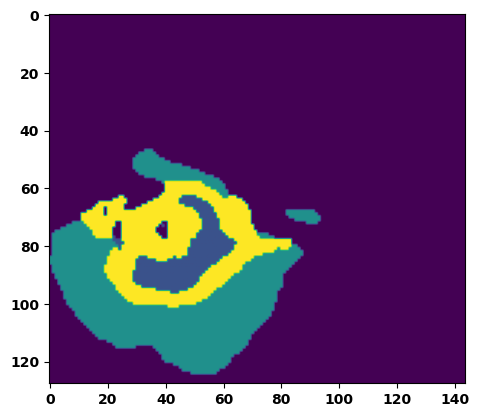

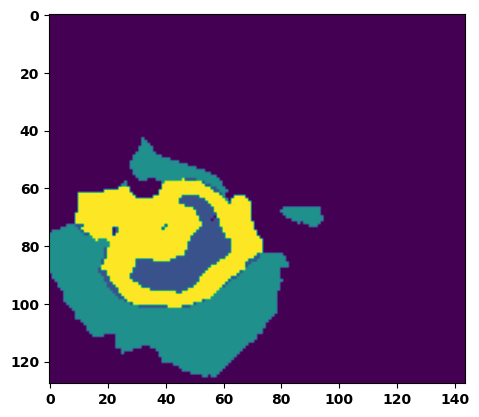

  6%|▌         | 2/36 [00:03<00:51,  1.50s/it]

Batch_id:  1 Eval loss:  0.09975230693817139
Batch_id:  1 Eval IoU:  tensor(0.8452, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:50,  1.52s/it]

Batch_id:  2 Eval loss:  0.2068249136209488
Batch_id:  2 Eval IoU:  tensor(0.6997, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9883, device='cuda:0')


 11%|█         | 4/36 [00:05<00:46,  1.44s/it]

Batch_id:  3 Eval loss:  0.21414700150489807
Batch_id:  3 Eval IoU:  tensor(0.7183, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9537, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:47,  1.53s/it]

Batch_id:  4 Eval loss:  0.29898563027381897
Batch_id:  4 Eval IoU:  tensor(0.5737, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9295, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9039, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9370, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9835, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:45,  1.51s/it]

Batch_id:  5 Eval loss:  0.10461586713790894
Batch_id:  5 Eval IoU:  tensor(0.8262, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.47s/it]

Batch_id:  6 Eval loss:  0.08076611161231995
Batch_id:  6 Eval IoU:  tensor(0.8886, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:39,  1.43s/it]

Batch_id:  7 Eval loss:  0.13944099843502045
Batch_id:  7 Eval IoU:  tensor(0.7894, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9960, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:37,  1.40s/it]

Batch_id:  8 Eval loss:  0.2247878909111023
Batch_id:  8 Eval IoU:  tensor(0.6889, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:36,  1.42s/it]

Batch_id:  9 Eval loss:  0.09939199686050415
Batch_id:  9 Eval IoU:  tensor(0.8422, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  10 Eval loss:  0.2530350387096405
Batch_id:  10 Eval IoU:  tensor(0.6584, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9479, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


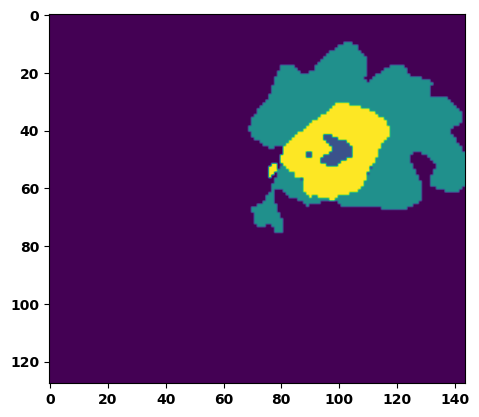

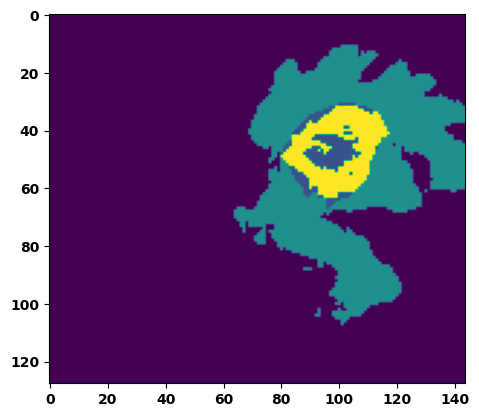

 33%|███▎      | 12/36 [00:17<00:36,  1.51s/it]

Batch_id:  11 Eval loss:  0.1042330265045166
Batch_id:  11 Eval IoU:  tensor(0.8338, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.52s/it]

Batch_id:  12 Eval loss:  0.2723136246204376
Batch_id:  12 Eval IoU:  tensor(0.6313, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9876, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:33,  1.52s/it]

Batch_id:  13 Eval loss:  0.14155738055706024
Batch_id:  13 Eval IoU:  tensor(0.8394, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9948, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.50s/it]

Batch_id:  14 Eval loss:  0.3102015256881714
Batch_id:  14 Eval IoU:  tensor(0.5863, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9685, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.42s/it]

Batch_id:  15 Eval loss:  0.3350181579589844
Batch_id:  15 Eval IoU:  tensor(0.5701, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9417, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9268, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:26,  1.38s/it]

Batch_id:  16 Eval loss:  0.11785660684108734
Batch_id:  16 Eval IoU:  tensor(0.8264, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.46s/it]

Batch_id:  17 Eval loss:  0.27916043996810913
Batch_id:  17 Eval IoU:  tensor(0.6755, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.46s/it]

Batch_id:  18 Eval loss:  0.10040108859539032
Batch_id:  18 Eval IoU:  tensor(0.8762, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.45s/it]

Batch_id:  19 Eval loss:  0.4235416650772095
Batch_id:  19 Eval IoU:  tensor(0.4701, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9367, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9210, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9127, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  20 Eval loss:  0.08960677683353424
Batch_id:  20 Eval IoU:  tensor(0.8539, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')


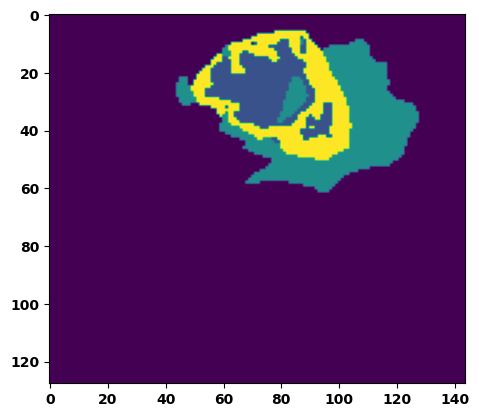

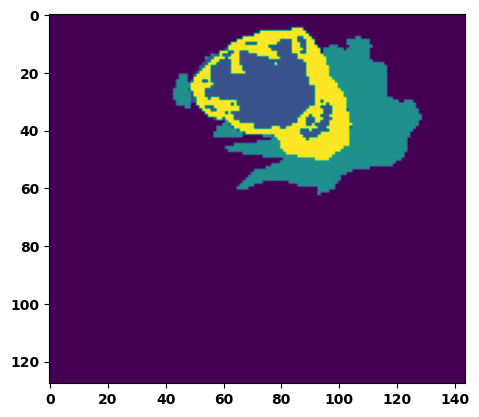

 61%|██████    | 22/36 [00:32<00:21,  1.55s/it]

Batch_id:  21 Eval loss:  0.5763188600540161
Batch_id:  21 Eval IoU:  tensor(0.3878, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.52s/it]

Batch_id:  22 Eval loss:  0.5191749930381775
Batch_id:  22 Eval IoU:  tensor(0.4493, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9311, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9243, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9243, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9989, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.48s/it]

Batch_id:  23 Eval loss:  0.20697596669197083
Batch_id:  23 Eval IoU:  tensor(0.7205, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9965, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:16,  1.54s/it]

Batch_id:  24 Eval loss:  0.4258403182029724
Batch_id:  24 Eval IoU:  tensor(0.5146, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.47s/it]

Batch_id:  25 Eval loss:  0.12250460684299469
Batch_id:  25 Eval IoU:  tensor(0.8049, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:13,  1.49s/it]

Batch_id:  26 Eval loss:  0.08138963580131531
Batch_id:  26 Eval IoU:  tensor(0.8648, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9912, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.43s/it]

Batch_id:  27 Eval loss:  0.19720564782619476
Batch_id:  27 Eval IoU:  tensor(0.7366, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9975, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.44s/it]

Batch_id:  28 Eval loss:  0.7336529493331909
Batch_id:  28 Eval IoU:  tensor(0.2426, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9344, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9106, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9191, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.42s/it]

Batch_id:  29 Eval loss:  0.4040154218673706
Batch_id:  29 Eval IoU:  tensor(0.5333, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9075, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.8624, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.8616, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  30 Eval loss:  0.09376788139343262
Batch_id:  30 Eval IoU:  tensor(0.8468, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9873, device='cuda:0')


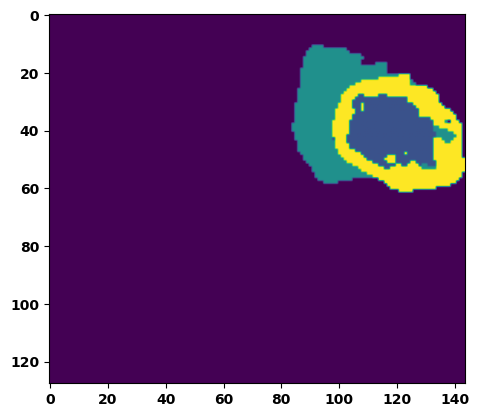

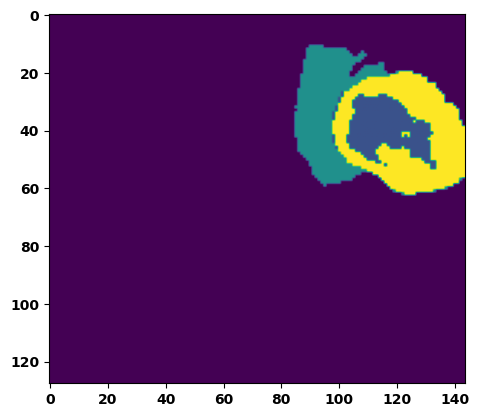

 89%|████████▉ | 32/36 [00:47<00:05,  1.44s/it]

Batch_id:  31 Eval loss:  0.1563868224620819
Batch_id:  31 Eval IoU:  tensor(0.7741, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.44s/it]

Batch_id:  32 Eval loss:  0.14465507864952087
Batch_id:  32 Eval IoU:  tensor(0.7742, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9866, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:02,  1.45s/it]

Batch_id:  33 Eval loss:  0.3536258339881897
Batch_id:  33 Eval IoU:  tensor(0.5858, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.41s/it]

Batch_id:  34 Eval loss:  0.18436674773693085
Batch_id:  34 Eval IoU:  tensor(0.7236, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.46s/it]

Batch_id:  35 Eval loss:  0.13905668258666992
Batch_id:  35 Eval IoU:  tensor(0.7957, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9397, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')
Epoch  15 Training loss:  0.21598757166754115
Epoch  15 Evaluation loss:  0.23108472757869297
Epoch  15 Training accuracy :  tensor(0.7093)
Epoch  15 Evaluation accuracy :  tensor(0.7031)
Epoch  15 Training Mean Dice Score:  tensor(0.9746)
Epoch  15 Eval Mean Dice Score:  tensor(0.9717)
Epoch  15 Training Non-tumor Dice Score:  tensor(0.9770)
Epoch  15 Eval Non-tumor Dice Score:  tensor(0.9705)
Epoch  15 Training NCR/NET Dice Score:  tensor(0.9865)
Epoch  15 Eval NCR/NET Dice Score:  tensor(0.9862)
Epoch  15 Training ED Dice Score:  tensor(0.

Best Model saved!
Epoch: 16
Training in session: 


  1%|          | 1/110 [00:01<02:58,  1.63s/it]

Batch_id:  0 Training loss:  0.15932513773441315
Batch_id:  0 Training IoU:  tensor(0.7690, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:43,  1.51s/it]

Batch_id:  1 Training loss:  0.12491200864315033
Batch_id:  1 Training IoU:  tensor(0.8072, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:39,  1.49s/it]

Batch_id:  2 Training loss:  0.26215940713882446
Batch_id:  2 Training IoU:  tensor(0.6946, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:40,  1.52s/it]

Batch_id:  3 Training loss:  0.1087053120136261
Batch_id:  3 Training IoU:  tensor(0.8243, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:38,  1.51s/it]

Batch_id:  4 Training loss:  0.5501129627227783
Batch_id:  4 Training IoU:  tensor(0.3663, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9120, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.8945, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.8713, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:33,  1.48s/it]

Batch_id:  5 Training loss:  0.10631850361824036
Batch_id:  5 Training IoU:  tensor(0.8341, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:30,  1.46s/it]

Batch_id:  6 Training loss:  0.18264047801494598
Batch_id:  6 Training IoU:  tensor(0.7244, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:28,  1.46s/it]

Batch_id:  7 Training loss:  0.15234698355197906
Batch_id:  7 Training IoU:  tensor(0.8052, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:29,  1.48s/it]

Batch_id:  8 Training loss:  0.16410592198371887
Batch_id:  8 Training IoU:  tensor(0.7492, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:25,  1.45s/it]

Batch_id:  9 Training loss:  0.3663262128829956
Batch_id:  9 Training IoU:  tensor(0.5319, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9259, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9475, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9332, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9249, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9721, device='cuda:0')


 10%|█         | 11/110 [00:16<02:22,  1.44s/it]

Batch_id:  10 Training loss:  0.2570902705192566
Batch_id:  10 Training IoU:  tensor(0.6452, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 11%|█         | 12/110 [00:17<02:25,  1.48s/it]

Batch_id:  11 Training loss:  0.11037981510162354
Batch_id:  11 Training IoU:  tensor(0.8275, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:20,  1.45s/it]

Batch_id:  12 Training loss:  0.16473983228206635
Batch_id:  12 Training IoU:  tensor(0.7485, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:17,  1.43s/it]

Batch_id:  13 Training loss:  0.13658373057842255
Batch_id:  13 Training IoU:  tensor(0.7925, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9447, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:12,  1.40s/it]

Batch_id:  14 Training loss:  0.14692121744155884
Batch_id:  14 Training IoU:  tensor(0.7800, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:12,  1.41s/it]

Batch_id:  15 Training loss:  0.32513734698295593
Batch_id:  15 Training IoU:  tensor(0.6234, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:08,  1.38s/it]

Batch_id:  16 Training loss:  0.23417474329471588
Batch_id:  16 Training IoU:  tensor(0.6629, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:11,  1.43s/it]

Batch_id:  17 Training loss:  0.07352280616760254
Batch_id:  17 Training IoU:  tensor(0.8815, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:17,  1.52s/it]

Batch_id:  18 Training loss:  0.164582759141922
Batch_id:  18 Training IoU:  tensor(0.7862, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:14,  1.50s/it]

Batch_id:  19 Training loss:  0.28915566205978394
Batch_id:  19 Training IoU:  tensor(0.6565, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:09,  1.45s/it]

Batch_id:  20 Training loss:  0.4366797208786011
Batch_id:  20 Training IoU:  tensor(0.4835, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 20%|██        | 22/110 [00:32<02:09,  1.48s/it]

Batch_id:  21 Training loss:  0.17078706622123718
Batch_id:  21 Training IoU:  tensor(0.7471, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 21%|██        | 23/110 [00:33<02:06,  1.45s/it]

Batch_id:  22 Training loss:  0.14370469748973846
Batch_id:  22 Training IoU:  tensor(0.7731, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:08,  1.49s/it]

Batch_id:  23 Training loss:  0.121574267745018
Batch_id:  23 Training IoU:  tensor(0.8078, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9444, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:05,  1.47s/it]

Batch_id:  24 Training loss:  0.18069323897361755
Batch_id:  24 Training IoU:  tensor(0.7747, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 24%|██▎       | 26/110 [00:37<01:58,  1.42s/it]

Batch_id:  25 Training loss:  0.2163522094488144
Batch_id:  25 Training IoU:  tensor(0.6777, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9790, device='cuda:0')


 25%|██▍       | 27/110 [00:39<01:57,  1.42s/it]

Batch_id:  26 Training loss:  0.20500445365905762
Batch_id:  26 Training IoU:  tensor(0.6973, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 25%|██▌       | 28/110 [00:40<01:53,  1.39s/it]

Batch_id:  27 Training loss:  0.1506224274635315
Batch_id:  27 Training IoU:  tensor(0.7781, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:53,  1.40s/it]

Batch_id:  28 Training loss:  0.21615751087665558
Batch_id:  28 Training IoU:  tensor(0.6841, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:52,  1.41s/it]

Batch_id:  29 Training loss:  0.10393007099628448
Batch_id:  29 Training IoU:  tensor(0.8282, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:51,  1.41s/it]

Batch_id:  30 Training loss:  0.36325132846832275
Batch_id:  30 Training IoU:  tensor(0.5179, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9555, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:54,  1.46s/it]

Batch_id:  31 Training loss:  0.1585598886013031
Batch_id:  31 Training IoU:  tensor(0.7523, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 30%|███       | 33/110 [00:47<01:50,  1.43s/it]

Batch_id:  32 Training loss:  0.42484888434410095
Batch_id:  32 Training IoU:  tensor(0.5321, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 31%|███       | 34/110 [00:49<01:48,  1.43s/it]

Batch_id:  33 Training loss:  0.22948509454727173
Batch_id:  33 Training IoU:  tensor(0.7219, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:48,  1.44s/it]

Batch_id:  34 Training loss:  0.25488680601119995
Batch_id:  34 Training IoU:  tensor(0.6394, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:45,  1.43s/it]

Batch_id:  35 Training loss:  0.07217171788215637
Batch_id:  35 Training IoU:  tensor(0.8894, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:50,  1.52s/it]

Batch_id:  36 Training loss:  0.3066357374191284
Batch_id:  36 Training IoU:  tensor(0.5958, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9504, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:47,  1.49s/it]

Batch_id:  37 Training loss:  0.06070414185523987
Batch_id:  37 Training IoU:  tensor(0.9026, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:45,  1.49s/it]

Batch_id:  38 Training loss:  0.30652469396591187
Batch_id:  38 Training IoU:  tensor(0.5852, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9379, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9315, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:45,  1.50s/it]

Batch_id:  39 Training loss:  0.3306519091129303
Batch_id:  39 Training IoU:  tensor(0.5462, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9188, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9233, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9195, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9676, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:43,  1.49s/it]

Batch_id:  40 Training loss:  0.5358378887176514
Batch_id:  40 Training IoU:  tensor(0.4187, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:41,  1.50s/it]

Batch_id:  41 Training loss:  0.1470421552658081
Batch_id:  41 Training IoU:  tensor(0.7777, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:39,  1.49s/it]

Batch_id:  42 Training loss:  0.13372088968753815
Batch_id:  42 Training IoU:  tensor(0.8051, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 40%|████      | 44/110 [01:04<01:39,  1.50s/it]

Batch_id:  43 Training loss:  0.11399140954017639
Batch_id:  43 Training IoU:  tensor(0.8153, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 41%|████      | 45/110 [01:05<01:36,  1.48s/it]

Batch_id:  44 Training loss:  0.14974194765090942
Batch_id:  44 Training IoU:  tensor(0.7684, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:34,  1.48s/it]

Batch_id:  45 Training loss:  0.2751801908016205
Batch_id:  45 Training IoU:  tensor(0.6738, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:33,  1.48s/it]

Batch_id:  46 Training loss:  0.10940390825271606
Batch_id:  46 Training IoU:  tensor(0.8611, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 44%|████▎     | 48/110 [01:10<01:32,  1.49s/it]

Batch_id:  47 Training loss:  0.18479184806346893
Batch_id:  47 Training IoU:  tensor(0.7551, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:30,  1.48s/it]

Batch_id:  48 Training loss:  0.13695965707302094
Batch_id:  48 Training IoU:  tensor(0.7824, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9736, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:28,  1.48s/it]

Batch_id:  49 Training loss:  0.18695659935474396
Batch_id:  49 Training IoU:  tensor(0.7108, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9484, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:27,  1.48s/it]

Batch_id:  50 Training loss:  0.17067226767539978
Batch_id:  50 Training IoU:  tensor(0.7351, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9714, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:26,  1.50s/it]

Batch_id:  51 Training loss:  0.07367010414600372
Batch_id:  51 Training IoU:  tensor(0.8913, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:24,  1.49s/it]

Batch_id:  52 Training loss:  0.1227278858423233
Batch_id:  52 Training IoU:  tensor(0.8068, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:23,  1.49s/it]

Batch_id:  53 Training loss:  0.1864609569311142
Batch_id:  53 Training IoU:  tensor(0.7522, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 50%|█████     | 55/110 [01:20<01:21,  1.48s/it]

Batch_id:  54 Training loss:  0.2831355929374695
Batch_id:  54 Training IoU:  tensor(0.6731, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:18,  1.45s/it]

Batch_id:  55 Training loss:  0.3131725788116455
Batch_id:  55 Training IoU:  tensor(0.6397, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:15,  1.43s/it]

Batch_id:  56 Training loss:  0.35098493099212646
Batch_id:  56 Training IoU:  tensor(0.5520, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9576, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:13,  1.42s/it]

Batch_id:  57 Training loss:  0.2412211298942566
Batch_id:  57 Training IoU:  tensor(0.6551, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 54%|█████▎    | 59/110 [01:26<01:16,  1.50s/it]

Batch_id:  58 Training loss:  0.1036442220211029
Batch_id:  58 Training IoU:  tensor(0.8478, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:17,  1.55s/it]

Batch_id:  59 Training loss:  0.2636536657810211
Batch_id:  59 Training IoU:  tensor(0.6172, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 55%|█████▌    | 61/110 [01:29<01:15,  1.53s/it]

Batch_id:  60 Training loss:  0.3745109438896179
Batch_id:  60 Training IoU:  tensor(0.5517, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:17,  1.62s/it]

Batch_id:  61 Training loss:  0.15477107465267181
Batch_id:  61 Training IoU:  tensor(0.7811, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 57%|█████▋    | 63/110 [01:32<01:15,  1.60s/it]

Batch_id:  62 Training loss:  0.16098833084106445
Batch_id:  62 Training IoU:  tensor(0.7982, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:12,  1.58s/it]

Batch_id:  63 Training loss:  0.2570353150367737
Batch_id:  63 Training IoU:  tensor(0.6842, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 59%|█████▉    | 65/110 [01:36<01:09,  1.55s/it]

Batch_id:  64 Training loss:  0.1527702957391739
Batch_id:  64 Training IoU:  tensor(0.7574, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:07,  1.54s/it]

Batch_id:  65 Training loss:  0.08733835816383362
Batch_id:  65 Training IoU:  tensor(0.8562, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 61%|██████    | 67/110 [01:39<01:05,  1.53s/it]

Batch_id:  66 Training loss:  0.1286638081073761
Batch_id:  66 Training IoU:  tensor(0.7964, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 62%|██████▏   | 68/110 [01:40<01:03,  1.52s/it]

Batch_id:  67 Training loss:  0.13586978614330292
Batch_id:  67 Training IoU:  tensor(0.7866, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 63%|██████▎   | 69/110 [01:41<01:01,  1.50s/it]

Batch_id:  68 Training loss:  0.4575134515762329
Batch_id:  68 Training IoU:  tensor(0.4918, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 64%|██████▎   | 70/110 [01:43<00:59,  1.49s/it]

Batch_id:  69 Training loss:  0.27056998014450073
Batch_id:  69 Training IoU:  tensor(0.6083, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9225, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9212, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.8975, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9842, device='cuda:0')


 65%|██████▍   | 71/110 [01:45<00:59,  1.52s/it]

Batch_id:  70 Training loss:  0.24056072533130646
Batch_id:  70 Training IoU:  tensor(0.6681, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 65%|██████▌   | 72/110 [01:46<00:57,  1.51s/it]

Batch_id:  71 Training loss:  0.1450381875038147
Batch_id:  71 Training IoU:  tensor(0.7716, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:55,  1.50s/it]

Batch_id:  72 Training loss:  0.09638229012489319
Batch_id:  72 Training IoU:  tensor(0.8423, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:56,  1.56s/it]

Batch_id:  73 Training loss:  0.25767242908477783
Batch_id:  73 Training IoU:  tensor(0.6494, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 68%|██████▊   | 75/110 [01:51<00:54,  1.55s/it]

Batch_id:  74 Training loss:  0.21365639567375183
Batch_id:  74 Training IoU:  tensor(0.6899, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9797, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:53,  1.57s/it]

Batch_id:  75 Training loss:  0.20262375473976135
Batch_id:  75 Training IoU:  tensor(0.7142, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 70%|███████   | 77/110 [01:54<00:50,  1.54s/it]

Batch_id:  76 Training loss:  0.21600252389907837
Batch_id:  76 Training IoU:  tensor(0.7398, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:50,  1.57s/it]

Batch_id:  77 Training loss:  0.0948331207036972
Batch_id:  77 Training IoU:  tensor(0.8473, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:47,  1.54s/it]

Batch_id:  78 Training loss:  0.5655423402786255
Batch_id:  78 Training IoU:  tensor(0.3787, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 73%|███████▎  | 80/110 [01:58<00:46,  1.55s/it]

Batch_id:  79 Training loss:  0.18069320917129517
Batch_id:  79 Training IoU:  tensor(0.7183, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 74%|███████▎  | 81/110 [02:00<00:45,  1.55s/it]

Batch_id:  80 Training loss:  0.21820849180221558
Batch_id:  80 Training IoU:  tensor(0.7112, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 75%|███████▍  | 82/110 [02:02<00:43,  1.57s/it]

Batch_id:  81 Training loss:  0.32115787267684937
Batch_id:  81 Training IoU:  tensor(0.6007, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 75%|███████▌  | 83/110 [02:03<00:42,  1.57s/it]

Batch_id:  82 Training loss:  0.31924617290496826
Batch_id:  82 Training IoU:  tensor(0.6285, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9993, device='cuda:0')


 76%|███████▋  | 84/110 [02:05<00:40,  1.55s/it]

Batch_id:  83 Training loss:  0.29409149289131165
Batch_id:  83 Training IoU:  tensor(0.6271, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 77%|███████▋  | 85/110 [02:06<00:38,  1.55s/it]

Batch_id:  84 Training loss:  0.40449362993240356
Batch_id:  84 Training IoU:  tensor(0.5357, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 78%|███████▊  | 86/110 [02:08<00:36,  1.51s/it]

Batch_id:  85 Training loss:  0.3870849907398224
Batch_id:  85 Training IoU:  tensor(0.4977, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9190, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9313, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.8907, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 79%|███████▉  | 87/110 [02:09<00:34,  1.52s/it]

Batch_id:  86 Training loss:  0.15671217441558838
Batch_id:  86 Training IoU:  tensor(0.7526, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 80%|████████  | 88/110 [02:11<00:33,  1.54s/it]

Batch_id:  87 Training loss:  0.19307592511177063
Batch_id:  87 Training IoU:  tensor(0.7354, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 81%|████████  | 89/110 [02:12<00:30,  1.47s/it]

Batch_id:  88 Training loss:  0.28347986936569214
Batch_id:  88 Training IoU:  tensor(0.6020, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 82%|████████▏ | 90/110 [02:14<00:29,  1.48s/it]

Batch_id:  89 Training loss:  0.1363510936498642
Batch_id:  89 Training IoU:  tensor(0.8053, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 83%|████████▎ | 91/110 [02:15<00:27,  1.46s/it]

Batch_id:  90 Training loss:  0.10655726492404938
Batch_id:  90 Training IoU:  tensor(0.8239, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 84%|████████▎ | 92/110 [02:16<00:25,  1.44s/it]

Batch_id:  91 Training loss:  0.23745232820510864
Batch_id:  91 Training IoU:  tensor(0.6759, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 85%|████████▍ | 93/110 [02:18<00:24,  1.46s/it]

Batch_id:  92 Training loss:  0.2071271389722824
Batch_id:  92 Training IoU:  tensor(0.6943, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9547, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9361, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9721, device='cuda:0')


 85%|████████▌ | 94/110 [02:19<00:22,  1.43s/it]

Batch_id:  93 Training loss:  0.1485069841146469
Batch_id:  93 Training IoU:  tensor(0.7753, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 86%|████████▋ | 95/110 [02:21<00:21,  1.44s/it]

Batch_id:  94 Training loss:  0.05479711294174194
Batch_id:  94 Training IoU:  tensor(0.9118, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 87%|████████▋ | 96/110 [02:22<00:19,  1.39s/it]

Batch_id:  95 Training loss:  0.3273715674877167
Batch_id:  95 Training IoU:  tensor(0.6104, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 88%|████████▊ | 97/110 [02:23<00:18,  1.40s/it]

Batch_id:  96 Training loss:  0.1549500823020935
Batch_id:  96 Training IoU:  tensor(0.7507, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9737, device='cuda:0')


 89%|████████▉ | 98/110 [02:25<00:16,  1.39s/it]

Batch_id:  97 Training loss:  0.105105459690094
Batch_id:  97 Training IoU:  tensor(0.8316, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9814, device='cuda:0')


 90%|█████████ | 99/110 [02:26<00:15,  1.37s/it]

Batch_id:  98 Training loss:  0.10088521242141724
Batch_id:  98 Training IoU:  tensor(0.8350, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:14,  1.43s/it]

Batch_id:  99 Training loss:  0.07101728022098541
Batch_id:  99 Training IoU:  tensor(0.8872, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 92%|█████████▏| 101/110 [02:29<00:12,  1.40s/it]

Batch_id:  100 Training loss:  0.16348083317279816
Batch_id:  100 Training IoU:  tensor(0.7516, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 93%|█████████▎| 102/110 [02:30<00:11,  1.39s/it]

Batch_id:  101 Training loss:  0.2242221236228943
Batch_id:  101 Training IoU:  tensor(0.6818, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 94%|█████████▎| 103/110 [02:32<00:10,  1.45s/it]

Batch_id:  102 Training loss:  0.1887052059173584
Batch_id:  102 Training IoU:  tensor(0.7053, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9794, device='cuda:0')


 95%|█████████▍| 104/110 [02:33<00:08,  1.41s/it]

Batch_id:  103 Training loss:  0.38381117582321167
Batch_id:  103 Training IoU:  tensor(0.5429, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9484, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9250, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 95%|█████████▌| 105/110 [02:35<00:07,  1.48s/it]

Batch_id:  104 Training loss:  0.05565802752971649
Batch_id:  104 Training IoU:  tensor(0.9096, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 96%|█████████▋| 106/110 [02:36<00:05,  1.49s/it]

Batch_id:  105 Training loss:  0.168081596493721
Batch_id:  105 Training IoU:  tensor(0.7460, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9804, device='cuda:0')


 97%|█████████▋| 107/110 [02:38<00:04,  1.49s/it]

Batch_id:  106 Training loss:  0.0702439546585083
Batch_id:  106 Training IoU:  tensor(0.8939, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 98%|█████████▊| 108/110 [02:39<00:02,  1.49s/it]

Batch_id:  107 Training loss:  0.15536890923976898
Batch_id:  107 Training IoU:  tensor(0.7864, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 99%|█████████▉| 109/110 [02:41<00:01,  1.49s/it]

Batch_id:  108 Training loss:  0.3944207429885864
Batch_id:  108 Training IoU:  tensor(0.5144, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


100%|██████████| 110/110 [02:42<00:00,  1.48s/it]


Batch_id:  109 Training loss:  0.12282209098339081
Batch_id:  109 Training IoU:  tensor(0.8001, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9879, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.24796517193317413
Batch_id:  0 Eval IoU:  tensor(0.6622, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


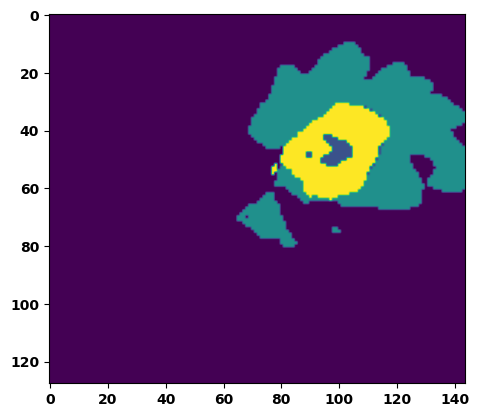

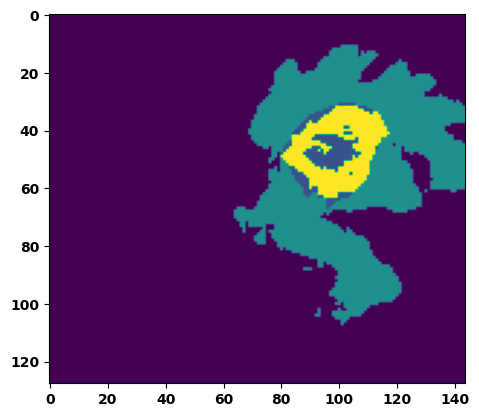

  6%|▌         | 2/36 [00:02<00:48,  1.42s/it]

Batch_id:  1 Eval loss:  0.3805994391441345
Batch_id:  1 Eval IoU:  tensor(0.5474, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:46,  1.40s/it]

Batch_id:  2 Eval loss:  0.18214063346385956
Batch_id:  2 Eval IoU:  tensor(0.7342, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  3 Eval loss:  0.6505113244056702
Batch_id:  3 Eval IoU:  tensor(0.2966, device='cuda:0')


 11%|█         | 4/36 [00:06<00:48,  1.52s/it]

Batch_id:  3 Eval Mean Dice Score:  tensor(0.9275, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9093, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9444, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9710, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.47s/it]

Batch_id:  4 Eval loss:  0.3095462918281555
Batch_id:  4 Eval IoU:  tensor(0.5964, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9949, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:44,  1.47s/it]

Batch_id:  5 Eval loss:  0.48386940360069275
Batch_id:  5 Eval IoU:  tensor(0.4410, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9168, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9337, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:43,  1.51s/it]

Batch_id:  6 Eval loss:  0.10367675125598907
Batch_id:  6 Eval IoU:  tensor(0.8275, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.45s/it]

Batch_id:  7 Eval loss:  0.25868260860443115
Batch_id:  7 Eval IoU:  tensor(0.7100, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:37,  1.40s/it]

Batch_id:  8 Eval loss:  0.3519790768623352
Batch_id:  8 Eval IoU:  tensor(0.5303, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9968, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:35,  1.38s/it]

Batch_id:  9 Eval loss:  0.24776612222194672
Batch_id:  9 Eval IoU:  tensor(0.6517, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  10 Eval loss:  0.25516247749328613
Batch_id:  10 Eval IoU:  tensor(0.6348, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9553, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


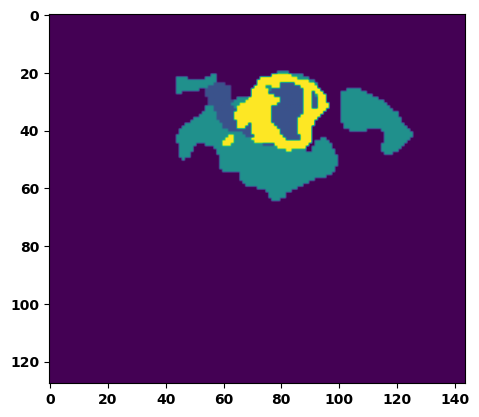

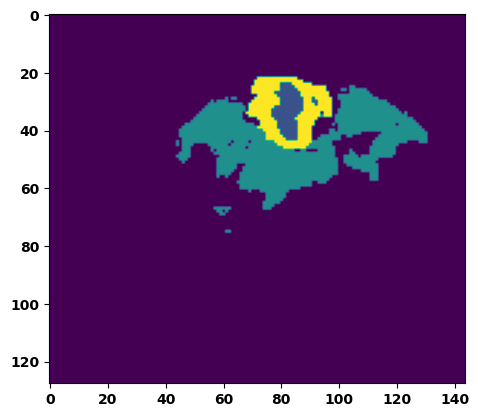

 33%|███▎      | 12/36 [00:17<00:34,  1.45s/it]

Batch_id:  11 Eval loss:  0.09434480965137482
Batch_id:  11 Eval IoU:  tensor(0.8434, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9873, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:33,  1.45s/it]

Batch_id:  12 Eval loss:  0.19624648988246918
Batch_id:  12 Eval IoU:  tensor(0.7380, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  13 Eval loss:  0.14337679743766785
Batch_id:  13 Eval IoU:  tensor(0.7737, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:33,  1.53s/it]

Batch_id:  13 Eval Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.52s/it]

Batch_id:  14 Eval loss:  0.7097159028053284
Batch_id:  14 Eval IoU:  tensor(0.2539, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9243, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9012, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9020, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.46s/it]

Batch_id:  15 Eval loss:  0.2018037885427475
Batch_id:  15 Eval IoU:  tensor(0.6891, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9528, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9839, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:28,  1.51s/it]

Batch_id:  16 Eval loss:  0.18678660690784454
Batch_id:  16 Eval IoU:  tensor(0.7335, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9919, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.45s/it]

Batch_id:  17 Eval loss:  0.12701362371444702
Batch_id:  17 Eval IoU:  tensor(0.7974, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9915, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:23,  1.40s/it]

Batch_id:  18 Eval loss:  0.1596388816833496
Batch_id:  18 Eval IoU:  tensor(0.7594, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:24,  1.52s/it]

Batch_id:  19 Eval loss:  0.19345740973949432
Batch_id:  19 Eval IoU:  tensor(0.7383, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  20 Eval loss:  0.11927446722984314
Batch_id:  20 Eval IoU:  tensor(0.8194, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9508, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')


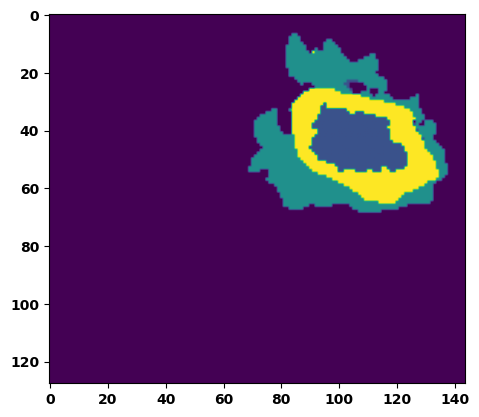

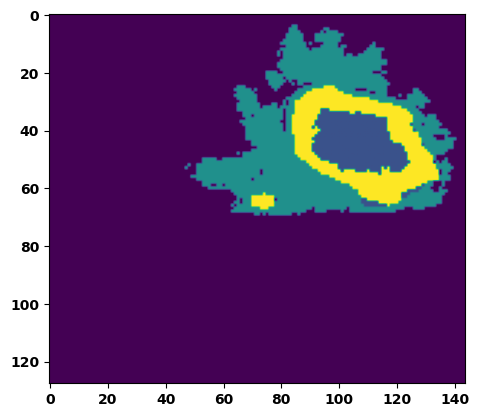

 61%|██████    | 22/36 [00:32<00:20,  1.46s/it]

Batch_id:  21 Eval loss:  0.09141997992992401
Batch_id:  21 Eval IoU:  tensor(0.8515, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9866, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.47s/it]

Batch_id:  22 Eval loss:  0.1376914232969284
Batch_id:  22 Eval IoU:  tensor(0.8175, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.48s/it]

Batch_id:  23 Eval loss:  0.1828864961862564
Batch_id:  23 Eval IoU:  tensor(0.7255, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:16,  1.49s/it]

Batch_id:  24 Eval loss:  0.22708243131637573
Batch_id:  24 Eval IoU:  tensor(0.6738, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9879, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.46s/it]

Batch_id:  25 Eval loss:  0.12427259981632233
Batch_id:  25 Eval IoU:  tensor(0.8014, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9910, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:13,  1.50s/it]

Batch_id:  26 Eval loss:  0.0949704498052597
Batch_id:  26 Eval IoU:  tensor(0.8617, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.48s/it]

Batch_id:  27 Eval loss:  0.26381826400756836
Batch_id:  27 Eval IoU:  tensor(0.6444, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9873, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.46s/it]

Batch_id:  28 Eval loss:  0.35465338826179504
Batch_id:  28 Eval IoU:  tensor(0.5249, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9338, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9277, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9895, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:09,  1.50s/it]

Batch_id:  29 Eval loss:  0.38542768359184265
Batch_id:  29 Eval IoU:  tensor(0.5523, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9153, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.8743, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.8733, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  30 Eval loss:  0.22170454263687134
Batch_id:  30 Eval IoU:  tensor(0.6955, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9889, device='cuda:0')


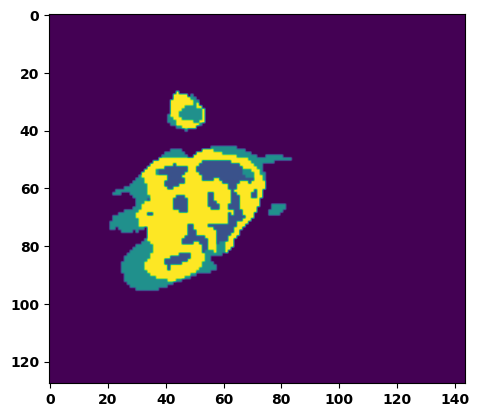

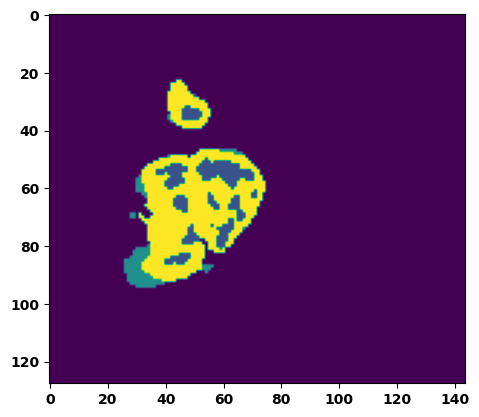

 89%|████████▉ | 32/36 [00:47<00:06,  1.57s/it]

Batch_id:  31 Eval loss:  0.08012662827968597
Batch_id:  31 Eval IoU:  tensor(0.8685, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.49s/it]

Batch_id:  32 Eval loss:  0.10838697850704193
Batch_id:  32 Eval IoU:  tensor(0.8264, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9932, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:02,  1.49s/it]

Batch_id:  33 Eval loss:  0.07007253170013428
Batch_id:  33 Eval IoU:  tensor(0.8878, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.49s/it]

Batch_id:  34 Eval loss:  0.0846177488565445
Batch_id:  34 Eval IoU:  tensor(0.8645, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9839, device='cuda:0')


100%|██████████| 36/36 [00:53<00:00,  1.48s/it]

Batch_id:  35 Eval loss:  0.1534053385257721
Batch_id:  35 Eval IoU:  tensor(0.7800, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9910, device='cuda:0')
Epoch  16 Training loss:  0.21057236302982676
Epoch  16 Evaluation loss:  0.227335960086849
Epoch  16 Training accuracy :  tensor(0.7158)
Epoch  16 Evaluation accuracy :  tensor(0.6987)
Epoch  16 Training Mean Dice Score:  tensor(0.9757)
Epoch  16 Eval Mean Dice Score:  tensor(0.9701)
Epoch  16 Training Non-tumor Dice Score:  tensor(0.9786)
Epoch  16 Eval Non-tumor Dice Score:  tensor(0.9683)
Epoch  16 Training NCR/NET Dice Score:  tensor(0.9870)
Epoch  16 Eval NCR/NET Dice Score:  tensor(0.9866)
Epoch  16 Training ED Dice Score:  tensor(0.971

Epoch completed and model successfully saved
Epoch: 17
Training in session: 


  1%|          | 1/110 [00:01<03:05,  1.70s/it]

Batch_id:  0 Training loss:  0.21386218070983887
Batch_id:  0 Training IoU:  tensor(0.6836, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:43,  1.52s/it]

Batch_id:  1 Training loss:  0.25282108783721924
Batch_id:  1 Training IoU:  tensor(0.6897, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:38,  1.48s/it]

Batch_id:  2 Training loss:  0.2177315056324005
Batch_id:  2 Training IoU:  tensor(0.6889, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:34,  1.45s/it]

Batch_id:  3 Training loss:  0.1081954687833786
Batch_id:  3 Training IoU:  tensor(0.8373, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:26,  1.40s/it]

Batch_id:  4 Training loss:  0.21515990793704987
Batch_id:  4 Training IoU:  tensor(0.7172, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:23,  1.38s/it]

Batch_id:  5 Training loss:  0.3242422342300415
Batch_id:  5 Training IoU:  tensor(0.6248, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


  6%|▋         | 7/110 [00:09<02:21,  1.38s/it]

Batch_id:  6 Training loss:  0.20605608820915222
Batch_id:  6 Training IoU:  tensor(0.6934, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9476, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9718, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:20,  1.37s/it]

Batch_id:  7 Training loss:  0.07052724063396454
Batch_id:  7 Training IoU:  tensor(0.8932, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


  8%|▊         | 9/110 [00:12<02:20,  1.39s/it]

Batch_id:  8 Training loss:  0.11646892130374908
Batch_id:  8 Training IoU:  tensor(0.8125, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9763, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:23,  1.44s/it]

Batch_id:  9 Training loss:  0.2801242768764496
Batch_id:  9 Training IoU:  tensor(0.6681, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 10%|█         | 11/110 [00:15<02:20,  1.42s/it]

Batch_id:  10 Training loss:  0.19893379509449005
Batch_id:  10 Training IoU:  tensor(0.6970, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9843, device='cuda:0')


 11%|█         | 12/110 [00:17<02:21,  1.44s/it]

Batch_id:  11 Training loss:  0.1958167403936386
Batch_id:  11 Training IoU:  tensor(0.7168, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:18,  1.42s/it]

Batch_id:  12 Training loss:  0.15809191763401031
Batch_id:  12 Training IoU:  tensor(0.7505, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


 13%|█▎        | 14/110 [00:19<02:15,  1.41s/it]

Batch_id:  13 Training loss:  0.14899085462093353
Batch_id:  13 Training IoU:  tensor(0.7767, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:16,  1.44s/it]

Batch_id:  14 Training loss:  0.13311423361301422
Batch_id:  14 Training IoU:  tensor(0.7902, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 15%|█▍        | 16/110 [00:22<02:13,  1.42s/it]

Batch_id:  15 Training loss:  0.20167721807956696
Batch_id:  15 Training IoU:  tensor(0.7306, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:14,  1.45s/it]

Batch_id:  16 Training loss:  0.1990518569946289
Batch_id:  16 Training IoU:  tensor(0.7025, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


 16%|█▋        | 18/110 [00:25<02:09,  1.41s/it]

Batch_id:  17 Training loss:  0.305295467376709
Batch_id:  17 Training IoU:  tensor(0.6068, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:11,  1.44s/it]

Batch_id:  18 Training loss:  0.1601199209690094
Batch_id:  18 Training IoU:  tensor(0.7512, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:07,  1.42s/it]

Batch_id:  19 Training loss:  0.10485772788524628
Batch_id:  19 Training IoU:  tensor(0.8611, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 19%|█▉        | 21/110 [00:29<02:04,  1.40s/it]

Batch_id:  20 Training loss:  0.14762748777866364
Batch_id:  20 Training IoU:  tensor(0.7780, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 20%|██        | 22/110 [00:31<02:02,  1.39s/it]

Batch_id:  21 Training loss:  0.24410519003868103
Batch_id:  21 Training IoU:  tensor(0.6543, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 21%|██        | 23/110 [00:32<02:03,  1.42s/it]

Batch_id:  22 Training loss:  0.060277923941612244
Batch_id:  22 Training IoU:  tensor(0.9107, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:00,  1.40s/it]

Batch_id:  23 Training loss:  0.12882176041603088
Batch_id:  23 Training IoU:  tensor(0.8041, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 23%|██▎       | 25/110 [00:35<02:05,  1.47s/it]

Batch_id:  24 Training loss:  0.22317081689834595
Batch_id:  24 Training IoU:  tensor(0.6853, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:03,  1.47s/it]

Batch_id:  25 Training loss:  0.18528275191783905
Batch_id:  25 Training IoU:  tensor(0.7163, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9818, device='cuda:0')


 25%|██▍       | 27/110 [00:38<02:00,  1.46s/it]

Batch_id:  26 Training loss:  0.26790595054626465
Batch_id:  26 Training IoU:  tensor(0.6267, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 25%|██▌       | 28/110 [00:40<02:00,  1.46s/it]

Batch_id:  27 Training loss:  0.23443225026130676
Batch_id:  27 Training IoU:  tensor(0.6518, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 26%|██▋       | 29/110 [00:41<01:57,  1.46s/it]

Batch_id:  28 Training loss:  0.4039870500564575
Batch_id:  28 Training IoU:  tensor(0.5341, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 27%|██▋       | 30/110 [00:42<01:56,  1.45s/it]

Batch_id:  29 Training loss:  0.09513109922409058
Batch_id:  29 Training IoU:  tensor(0.8465, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:54,  1.44s/it]

Batch_id:  30 Training loss:  0.2341541349887848
Batch_id:  30 Training IoU:  tensor(0.7130, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 29%|██▉       | 32/110 [00:45<01:51,  1.43s/it]

Batch_id:  31 Training loss:  0.12840813398361206
Batch_id:  31 Training IoU:  tensor(0.7883, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9843, device='cuda:0')


 30%|███       | 33/110 [00:47<01:50,  1.44s/it]

Batch_id:  32 Training loss:  0.1438981592655182
Batch_id:  32 Training IoU:  tensor(0.7753, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 31%|███       | 34/110 [00:48<01:50,  1.45s/it]

Batch_id:  33 Training loss:  0.26156139373779297
Batch_id:  33 Training IoU:  tensor(0.6779, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:48,  1.45s/it]

Batch_id:  34 Training loss:  0.41961991786956787
Batch_id:  34 Training IoU:  tensor(0.4850, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9150, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9249, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9126, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9692, device='cuda:0')


 33%|███▎      | 36/110 [00:51<01:47,  1.46s/it]

Batch_id:  35 Training loss:  0.1366613656282425
Batch_id:  35 Training IoU:  tensor(0.8064, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:44,  1.44s/it]

Batch_id:  36 Training loss:  0.16259784996509552
Batch_id:  36 Training IoU:  tensor(0.7868, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 35%|███▍      | 38/110 [00:54<01:42,  1.43s/it]

Batch_id:  37 Training loss:  0.13490672409534454
Batch_id:  37 Training IoU:  tensor(0.7988, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:46,  1.50s/it]

Batch_id:  38 Training loss:  0.14741310477256775
Batch_id:  38 Training IoU:  tensor(0.7863, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 36%|███▋      | 40/110 [00:57<01:45,  1.50s/it]

Batch_id:  39 Training loss:  0.1648002713918686
Batch_id:  39 Training IoU:  tensor(0.7364, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:41,  1.47s/it]

Batch_id:  40 Training loss:  0.15135619044303894
Batch_id:  40 Training IoU:  tensor(0.7771, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


 38%|███▊      | 42/110 [01:00<01:40,  1.48s/it]

Batch_id:  41 Training loss:  0.10652996599674225
Batch_id:  41 Training IoU:  tensor(0.8248, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:38,  1.47s/it]

Batch_id:  42 Training loss:  0.18037071824073792
Batch_id:  42 Training IoU:  tensor(0.7221, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9698, device='cuda:0')


 40%|████      | 44/110 [01:03<01:35,  1.45s/it]

Batch_id:  43 Training loss:  0.29117101430892944
Batch_id:  43 Training IoU:  tensor(0.6615, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 41%|████      | 45/110 [01:04<01:35,  1.46s/it]

Batch_id:  44 Training loss:  0.1161031723022461
Batch_id:  44 Training IoU:  tensor(0.8127, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:33,  1.46s/it]

Batch_id:  45 Training loss:  0.09593962132930756
Batch_id:  45 Training IoU:  tensor(0.8393, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 43%|████▎     | 47/110 [01:07<01:34,  1.50s/it]

Batch_id:  46 Training loss:  0.06461042165756226
Batch_id:  46 Training IoU:  tensor(0.9010, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:29,  1.45s/it]

Batch_id:  47 Training loss:  0.05472950637340546
Batch_id:  47 Training IoU:  tensor(0.9118, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 45%|████▍     | 49/110 [01:10<01:28,  1.45s/it]

Batch_id:  48 Training loss:  0.1607666164636612
Batch_id:  48 Training IoU:  tensor(0.7863, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:27,  1.46s/it]

Batch_id:  49 Training loss:  0.11828850209712982
Batch_id:  49 Training IoU:  tensor(0.8083, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 46%|████▋     | 51/110 [01:13<01:26,  1.47s/it]

Batch_id:  50 Training loss:  0.5564783215522766
Batch_id:  50 Training IoU:  tensor(0.3742, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:27,  1.51s/it]

Batch_id:  51 Training loss:  0.26913338899612427
Batch_id:  51 Training IoU:  tensor(0.6266, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:22,  1.45s/it]

Batch_id:  52 Training loss:  0.5011508464813232
Batch_id:  52 Training IoU:  tensor(0.4315, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:20,  1.43s/it]

Batch_id:  53 Training loss:  0.18901437520980835
Batch_id:  53 Training IoU:  tensor(0.7163, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9792, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:17,  1.40s/it]

Batch_id:  54 Training loss:  0.20598094165325165
Batch_id:  54 Training IoU:  tensor(0.7210, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 51%|█████     | 56/110 [01:20<01:18,  1.45s/it]

Batch_id:  55 Training loss:  0.1487959325313568
Batch_id:  55 Training IoU:  tensor(0.7691, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9457, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9753, device='cuda:0')


 52%|█████▏    | 57/110 [01:22<01:19,  1.50s/it]

Batch_id:  56 Training loss:  0.28978878259658813
Batch_id:  56 Training IoU:  tensor(0.6619, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 53%|█████▎    | 58/110 [01:23<01:16,  1.46s/it]

Batch_id:  57 Training loss:  0.16853748261928558
Batch_id:  57 Training IoU:  tensor(0.7521, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 54%|█████▎    | 59/110 [01:25<01:18,  1.54s/it]

Batch_id:  58 Training loss:  0.13599899411201477
Batch_id:  58 Training IoU:  tensor(0.7807, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9508, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 55%|█████▍    | 60/110 [01:26<01:13,  1.47s/it]

Batch_id:  59 Training loss:  0.2578750550746918
Batch_id:  59 Training IoU:  tensor(0.6338, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9773, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:10,  1.43s/it]

Batch_id:  60 Training loss:  0.10768793523311615
Batch_id:  60 Training IoU:  tensor(0.8242, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 56%|█████▋    | 62/110 [01:29<01:09,  1.46s/it]

Batch_id:  61 Training loss:  0.05260750651359558
Batch_id:  61 Training IoU:  tensor(0.9138, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:08,  1.45s/it]

Batch_id:  62 Training loss:  0.11814583837985992
Batch_id:  62 Training IoU:  tensor(0.8191, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 58%|█████▊    | 64/110 [01:32<01:07,  1.47s/it]

Batch_id:  63 Training loss:  0.15446048974990845
Batch_id:  63 Training IoU:  tensor(0.7754, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:06,  1.47s/it]

Batch_id:  64 Training loss:  0.1221737414598465
Batch_id:  64 Training IoU:  tensor(0.8011, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 60%|██████    | 66/110 [01:35<01:02,  1.43s/it]

Batch_id:  65 Training loss:  0.08716821670532227
Batch_id:  65 Training IoU:  tensor(0.8552, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 61%|██████    | 67/110 [01:37<01:03,  1.48s/it]

Batch_id:  66 Training loss:  0.16758543252944946
Batch_id:  66 Training IoU:  tensor(0.7878, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 62%|██████▏   | 68/110 [01:38<01:04,  1.54s/it]

Batch_id:  67 Training loss:  0.3430609703063965
Batch_id:  67 Training IoU:  tensor(0.5894, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<01:03,  1.56s/it]

Batch_id:  68 Training loss:  0.0761861503124237
Batch_id:  68 Training IoU:  tensor(0.8751, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 64%|██████▎   | 70/110 [01:41<01:01,  1.54s/it]

Batch_id:  69 Training loss:  0.1483069509267807
Batch_id:  69 Training IoU:  tensor(0.7669, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 65%|██████▍   | 71/110 [01:43<01:00,  1.55s/it]

Batch_id:  70 Training loss:  0.3157271146774292
Batch_id:  70 Training IoU:  tensor(0.6313, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9540, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 65%|██████▌   | 72/110 [01:44<00:58,  1.53s/it]

Batch_id:  71 Training loss:  0.15674419701099396
Batch_id:  71 Training IoU:  tensor(0.7471, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9730, device='cuda:0')


 66%|██████▋   | 73/110 [01:46<00:58,  1.58s/it]

Batch_id:  72 Training loss:  0.1283797174692154
Batch_id:  72 Training IoU:  tensor(0.8010, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:56,  1.57s/it]

Batch_id:  73 Training loss:  0.15510442852973938
Batch_id:  73 Training IoU:  tensor(0.7878, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 68%|██████▊   | 75/110 [01:49<00:55,  1.58s/it]

Batch_id:  74 Training loss:  0.09800112247467041
Batch_id:  74 Training IoU:  tensor(0.8450, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 69%|██████▉   | 76/110 [01:51<00:53,  1.56s/it]

Batch_id:  75 Training loss:  0.0502026230096817
Batch_id:  75 Training IoU:  tensor(0.9183, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 70%|███████   | 77/110 [01:52<00:50,  1.54s/it]

Batch_id:  76 Training loss:  0.16885866224765778
Batch_id:  76 Training IoU:  tensor(0.7395, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:48,  1.51s/it]

Batch_id:  77 Training loss:  0.1079799085855484
Batch_id:  77 Training IoU:  tensor(0.8288, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 72%|███████▏  | 79/110 [01:55<00:47,  1.54s/it]

Batch_id:  78 Training loss:  0.20956309139728546
Batch_id:  78 Training IoU:  tensor(0.6825, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:47,  1.58s/it]

Batch_id:  79 Training loss:  0.2099986970424652
Batch_id:  79 Training IoU:  tensor(0.7045, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 74%|███████▎  | 81/110 [01:59<00:44,  1.55s/it]

Batch_id:  80 Training loss:  0.20254167914390564
Batch_id:  80 Training IoU:  tensor(0.6981, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9801, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:41,  1.49s/it]

Batch_id:  81 Training loss:  0.21715182065963745
Batch_id:  81 Training IoU:  tensor(0.6762, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9274, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:39,  1.47s/it]

Batch_id:  82 Training loss:  0.2847710847854614
Batch_id:  82 Training IoU:  tensor(0.5981, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9288, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9479, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9262, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9713, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:37,  1.45s/it]

Batch_id:  83 Training loss:  0.3460678458213806
Batch_id:  83 Training IoU:  tensor(0.5365, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9294, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9399, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9015, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:36,  1.46s/it]

Batch_id:  84 Training loss:  0.15482071042060852
Batch_id:  84 Training IoU:  tensor(0.7656, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:34,  1.43s/it]

Batch_id:  85 Training loss:  0.0927630215883255
Batch_id:  85 Training IoU:  tensor(0.8481, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:32,  1.42s/it]

Batch_id:  86 Training loss:  0.36474108695983887
Batch_id:  86 Training IoU:  tensor(0.5656, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9494, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9258, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 80%|████████  | 88/110 [02:09<00:32,  1.47s/it]

Batch_id:  87 Training loss:  0.33400100469589233
Batch_id:  87 Training IoU:  tensor(0.5816, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:30,  1.47s/it]

Batch_id:  88 Training loss:  0.36616402864456177
Batch_id:  88 Training IoU:  tensor(0.5347, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9808, device='cuda:0')


 82%|████████▏ | 90/110 [02:12<00:29,  1.49s/it]

Batch_id:  89 Training loss:  0.24952420592308044
Batch_id:  89 Training IoU:  tensor(0.6380, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9435, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:28,  1.50s/it]

Batch_id:  90 Training loss:  0.11348678171634674
Batch_id:  90 Training IoU:  tensor(0.8181, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 84%|████████▎ | 92/110 [02:15<00:27,  1.51s/it]

Batch_id:  91 Training loss:  0.22977541387081146
Batch_id:  91 Training IoU:  tensor(0.6657, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:25,  1.49s/it]

Batch_id:  92 Training loss:  0.3725910484790802
Batch_id:  92 Training IoU:  tensor(0.5049, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9635, device='cuda:0')


 85%|████████▌ | 94/110 [02:18<00:23,  1.49s/it]

Batch_id:  93 Training loss:  0.29733285307884216
Batch_id:  93 Training IoU:  tensor(0.6527, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9979, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:22,  1.49s/it]

Batch_id:  94 Training loss:  0.4561210572719574
Batch_id:  94 Training IoU:  tensor(0.4554, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9318, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9134, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 87%|████████▋ | 96/110 [02:21<00:21,  1.52s/it]

Batch_id:  95 Training loss:  0.07327039539813995
Batch_id:  95 Training IoU:  tensor(0.8831, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 88%|████████▊ | 97/110 [02:22<00:19,  1.50s/it]

Batch_id:  96 Training loss:  0.10863974690437317
Batch_id:  96 Training IoU:  tensor(0.8228, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 89%|████████▉ | 98/110 [02:24<00:18,  1.55s/it]

Batch_id:  97 Training loss:  0.20919349789619446
Batch_id:  97 Training IoU:  tensor(0.7080, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:16,  1.54s/it]

Batch_id:  98 Training loss:  0.4498993456363678
Batch_id:  98 Training IoU:  tensor(0.5030, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9987, device='cuda:0')


 91%|█████████ | 100/110 [02:27<00:15,  1.51s/it]

Batch_id:  99 Training loss:  0.13793949782848358
Batch_id:  99 Training IoU:  tensor(0.7829, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:13,  1.55s/it]

Batch_id:  100 Training loss:  0.30680686235427856
Batch_id:  100 Training IoU:  tensor(0.6164, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 93%|█████████▎| 102/110 [02:30<00:12,  1.57s/it]

Batch_id:  101 Training loss:  0.15498092770576477
Batch_id:  101 Training IoU:  tensor(0.7681, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.50s/it]

Batch_id:  102 Training loss:  0.3007112145423889
Batch_id:  102 Training IoU:  tensor(0.6518, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 95%|█████████▍| 104/110 [02:33<00:09,  1.51s/it]

Batch_id:  103 Training loss:  0.09922733902931213
Batch_id:  103 Training IoU:  tensor(0.8372, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 95%|█████████▌| 105/110 [02:35<00:07,  1.56s/it]

Batch_id:  104 Training loss:  0.29498735070228577
Batch_id:  104 Training IoU:  tensor(0.5799, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9166, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9119, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.8928, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 96%|█████████▋| 106/110 [02:36<00:06,  1.58s/it]

Batch_id:  105 Training loss:  0.2868947982788086
Batch_id:  105 Training IoU:  tensor(0.6137, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9522, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.50s/it]

Batch_id:  106 Training loss:  0.1444648951292038
Batch_id:  106 Training IoU:  tensor(0.7677, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 98%|█████████▊| 108/110 [02:39<00:02,  1.47s/it]

Batch_id:  107 Training loss:  0.20518851280212402
Batch_id:  107 Training IoU:  tensor(0.7196, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.44s/it]

Batch_id:  108 Training loss:  0.4404774606227875
Batch_id:  108 Training IoU:  tensor(0.4938, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


100%|██████████| 110/110 [02:42<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.46468737721443176
Batch_id:  109 Training IoU:  tensor(0.5550, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9993, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.4111911654472351
Batch_id:  0 Eval IoU:  tensor(0.4618, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9139, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.8764, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9348, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9743, device='cuda:0')


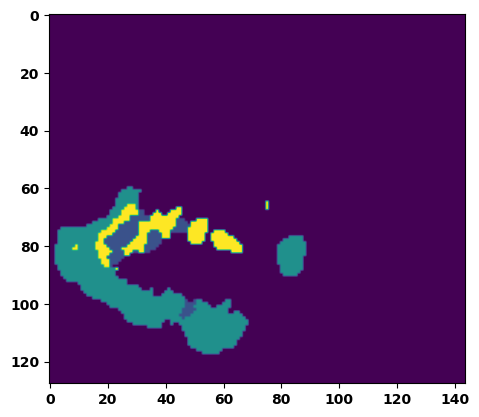

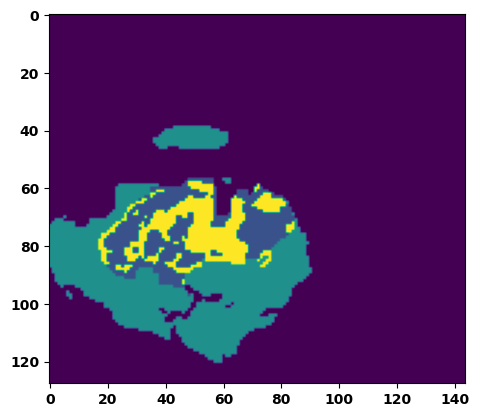

  6%|▌         | 2/36 [00:03<00:50,  1.48s/it]

Batch_id:  1 Eval loss:  0.09578393399715424
Batch_id:  1 Eval IoU:  tensor(0.8714, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:45,  1.39s/it]

Batch_id:  2 Eval loss:  0.7256988286972046
Batch_id:  2 Eval IoU:  tensor(0.2485, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9443, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9257, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9319, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9954, device='cuda:0')


 11%|█         | 4/36 [00:05<00:44,  1.38s/it]

Batch_id:  3 Eval loss:  0.10824890434741974
Batch_id:  3 Eval IoU:  tensor(0.8871, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9968, device='cuda:0')


 14%|█▍        | 5/36 [00:06<00:41,  1.35s/it]

Batch_id:  4 Eval loss:  0.25805768370628357
Batch_id:  4 Eval IoU:  tensor(0.6480, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:42,  1.43s/it]

Batch_id:  5 Eval loss:  0.18566924333572388
Batch_id:  5 Eval IoU:  tensor(0.7232, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9878, device='cuda:0')


 19%|█▉        | 7/36 [00:09<00:41,  1.43s/it]

Batch_id:  6 Eval loss:  0.48248788714408875
Batch_id:  6 Eval IoU:  tensor(0.4567, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9227, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9335, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9874, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.43s/it]

Batch_id:  7 Eval loss:  0.12309986352920532
Batch_id:  7 Eval IoU:  tensor(0.8024, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9871, device='cuda:0')


 25%|██▌       | 9/36 [00:12<00:38,  1.42s/it]

Batch_id:  8 Eval loss:  0.41736674308776855
Batch_id:  8 Eval IoU:  tensor(0.4786, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9216, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9124, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:37,  1.43s/it]

Batch_id:  9 Eval loss:  0.1077677309513092
Batch_id:  9 Eval IoU:  tensor(0.8193, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  10 Eval loss:  0.15789884328842163
Batch_id:  10 Eval IoU:  tensor(0.7701, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


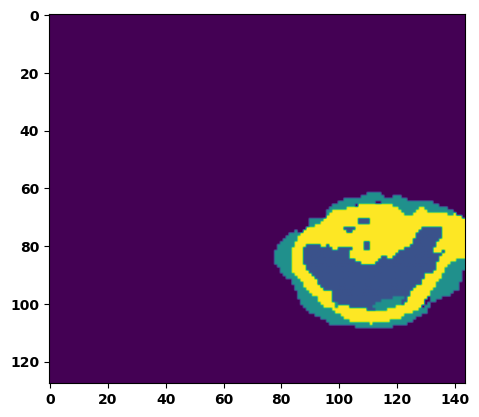

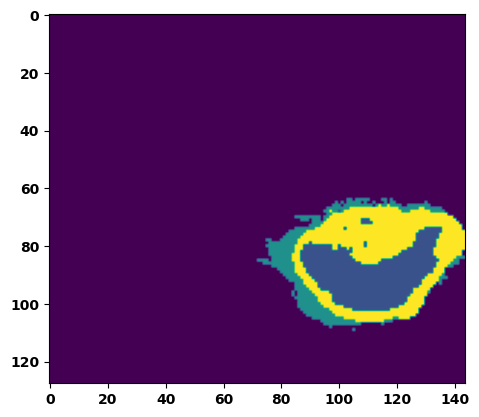

 33%|███▎      | 12/36 [00:17<00:35,  1.47s/it]

Batch_id:  11 Eval loss:  0.42058610916137695
Batch_id:  11 Eval IoU:  tensor(0.5150, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9011, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.8527, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.8529, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9978, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:34,  1.50s/it]

Batch_id:  12 Eval loss:  0.08854521811008453
Batch_id:  12 Eval IoU:  tensor(0.8514, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9921, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:32,  1.47s/it]

Batch_id:  13 Eval loss:  0.09628994762897491
Batch_id:  13 Eval IoU:  tensor(0.8450, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:29,  1.43s/it]

Batch_id:  14 Eval loss:  0.06621645390987396
Batch_id:  14 Eval IoU:  tensor(0.9103, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9955, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.44s/it]

Batch_id:  15 Eval loss:  0.23444043099880219
Batch_id:  15 Eval IoU:  tensor(0.6684, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9876, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:26,  1.40s/it]

Batch_id:  16 Eval loss:  0.34970754384994507
Batch_id:  16 Eval IoU:  tensor(0.5883, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


 50%|█████     | 18/36 [00:25<00:25,  1.40s/it]

Batch_id:  17 Eval loss:  0.5844117999076843
Batch_id:  17 Eval IoU:  tensor(0.3577, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9266, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9067, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9240, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9988, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.44s/it]

Batch_id:  18 Eval loss:  0.08290156722068787
Batch_id:  18 Eval IoU:  tensor(0.8594, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 56%|█████▌    | 20/36 [00:28<00:22,  1.42s/it]

Batch_id:  19 Eval loss:  0.11949688196182251
Batch_id:  19 Eval IoU:  tensor(0.8214, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  20 Eval loss:  0.31327497959136963
Batch_id:  20 Eval IoU:  tensor(0.6176, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


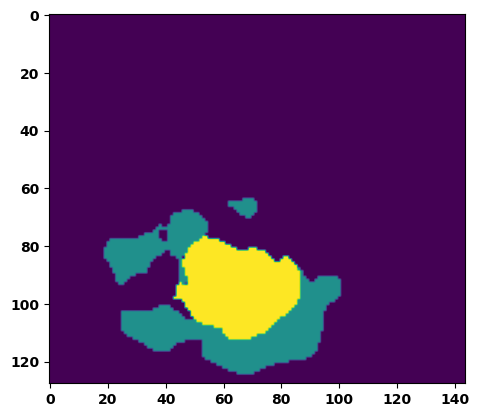

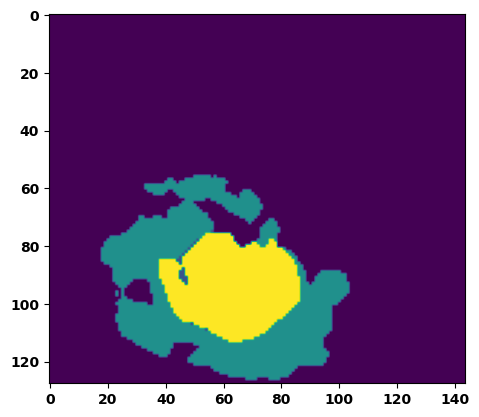

 61%|██████    | 22/36 [00:31<00:20,  1.47s/it]

Batch_id:  21 Eval loss:  0.3344820737838745
Batch_id:  21 Eval IoU:  tensor(0.5612, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9663, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:18,  1.45s/it]

Batch_id:  22 Eval loss:  0.21606619656085968
Batch_id:  22 Eval IoU:  tensor(0.6850, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:16,  1.40s/it]

Batch_id:  23 Eval loss:  0.21451838314533234
Batch_id:  23 Eval IoU:  tensor(0.6839, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9795, device='cuda:0')


 69%|██████▉   | 25/36 [00:35<00:16,  1.46s/it]

Batch_id:  24 Eval loss:  0.3867015838623047
Batch_id:  24 Eval IoU:  tensor(0.5620, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')


 72%|███████▏  | 26/36 [00:37<00:14,  1.45s/it]

Batch_id:  25 Eval loss:  0.21876339614391327
Batch_id:  25 Eval IoU:  tensor(0.7005, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9960, device='cuda:0')


 75%|███████▌  | 27/36 [00:38<00:12,  1.42s/it]

Batch_id:  26 Eval loss:  0.23712219297885895
Batch_id:  26 Eval IoU:  tensor(0.6607, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.44s/it]

Batch_id:  27 Eval loss:  0.1758405864238739
Batch_id:  27 Eval IoU:  tensor(0.7577, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9480, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9271, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9248, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 81%|████████  | 29/36 [00:41<00:10,  1.45s/it]

Batch_id:  28 Eval loss:  0.13259336352348328
Batch_id:  28 Eval IoU:  tensor(0.7835, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9852, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.42s/it]

Batch_id:  29 Eval loss:  0.3156319856643677
Batch_id:  29 Eval IoU:  tensor(0.5837, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  30 Eval loss:  0.2652525007724762
Batch_id:  30 Eval IoU:  tensor(0.6468, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


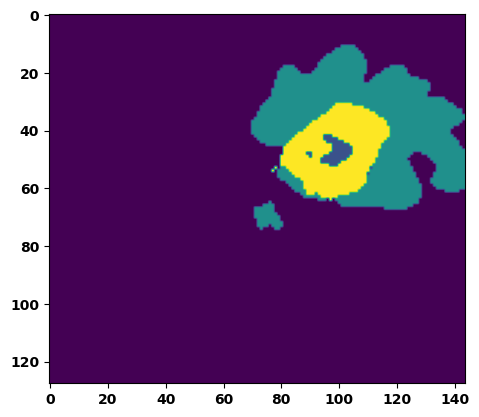

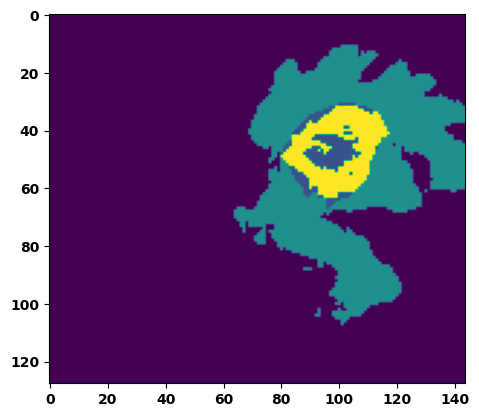

 89%|████████▉ | 32/36 [00:46<00:05,  1.46s/it]

Batch_id:  31 Eval loss:  0.09127511084079742
Batch_id:  31 Eval IoU:  tensor(0.8500, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9804, device='cuda:0')


 92%|█████████▏| 33/36 [00:47<00:04,  1.47s/it]

Batch_id:  32 Eval loss:  0.2845519185066223
Batch_id:  32 Eval IoU:  tensor(0.6542, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9974, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:03,  1.50s/it]

Batch_id:  33 Eval loss:  0.10720999538898468
Batch_id:  33 Eval IoU:  tensor(0.8273, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 97%|█████████▋| 35/36 [00:50<00:01,  1.52s/it]

Batch_id:  34 Eval loss:  0.1183495819568634
Batch_id:  34 Eval IoU:  tensor(0.8089, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.45s/it]

Batch_id:  35 Eval loss:  0.487435907125473
Batch_id:  35 Eval IoU:  tensor(0.4516, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9988, device='cuda:0')
Epoch  17 Training loss:  0.20486988628452474
Epoch  17 Evaluation loss:  0.2504149037930701
Epoch  17 Training accuracy :  tensor(0.7209)
Epoch  17 Evaluation accuracy :  tensor(0.6783)
Epoch  17 Training Mean Dice Score:  tensor(0.9762)
Epoch  17 Eval Mean Dice Score:  tensor(0.9700)
Epoch  17 Training Non-tumor Dice Score:  tensor(0.9787)
Epoch  17 Eval Non-tumor Dice Score:  tensor(0.9669)
Epoch  17 Training NCR/NET Dice Score:  tensor(0.9876)
Epoch  17 Eval NCR/NET Dice Score:  tensor(0.9861)
Epoch  17 Training ED Dice Score:  tensor(0.972

Epoch: 18
Training in session: 


  1%|          | 1/110 [00:01<03:02,  1.68s/it]

Batch_id:  0 Training loss:  0.15326209366321564
Batch_id:  0 Training IoU:  tensor(0.7676, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:42,  1.50s/it]

Batch_id:  1 Training loss:  0.15464912354946136
Batch_id:  1 Training IoU:  tensor(0.7545, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:40,  1.50s/it]

Batch_id:  2 Training loss:  0.060754016041755676
Batch_id:  2 Training IoU:  tensor(0.9005, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:34,  1.46s/it]

Batch_id:  3 Training loss:  0.15906761586666107
Batch_id:  3 Training IoU:  tensor(0.7546, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:26,  1.39s/it]

Batch_id:  4 Training loss:  0.2808665931224823
Batch_id:  4 Training IoU:  tensor(0.6166, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:34,  1.48s/it]

Batch_id:  5 Training loss:  0.2948008179664612
Batch_id:  5 Training IoU:  tensor(0.6049, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9444, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9405, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9833, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:30,  1.46s/it]

Batch_id:  6 Training loss:  0.2988625764846802
Batch_id:  6 Training IoU:  tensor(0.5872, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:28,  1.46s/it]

Batch_id:  7 Training loss:  0.1474149525165558
Batch_id:  7 Training IoU:  tensor(0.7870, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:29,  1.48s/it]

Batch_id:  8 Training loss:  0.1712285876274109
Batch_id:  8 Training IoU:  tensor(0.7324, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:25,  1.45s/it]

Batch_id:  9 Training loss:  0.10184408724308014
Batch_id:  9 Training IoU:  tensor(0.8401, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 10%|█         | 11/110 [00:16<02:22,  1.44s/it]

Batch_id:  10 Training loss:  0.1790645569562912
Batch_id:  10 Training IoU:  tensor(0.7597, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 11%|█         | 12/110 [00:17<02:16,  1.39s/it]

Batch_id:  11 Training loss:  0.33554306626319885
Batch_id:  11 Training IoU:  tensor(0.6104, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:17,  1.42s/it]

Batch_id:  12 Training loss:  0.2596479654312134
Batch_id:  12 Training IoU:  tensor(0.6898, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:22,  1.48s/it]

Batch_id:  13 Training loss:  0.22440922260284424
Batch_id:  13 Training IoU:  tensor(0.6978, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:15,  1.42s/it]

Batch_id:  14 Training loss:  0.35648608207702637
Batch_id:  14 Training IoU:  tensor(0.5778, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9317, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:19,  1.48s/it]

Batch_id:  15 Training loss:  0.2378469556570053
Batch_id:  15 Training IoU:  tensor(0.6501, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:11,  1.41s/it]

Batch_id:  16 Training loss:  0.13439075648784637
Batch_id:  16 Training IoU:  tensor(0.7845, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:14,  1.47s/it]

Batch_id:  17 Training loss:  0.22915524244308472
Batch_id:  17 Training IoU:  tensor(0.6863, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:16,  1.50s/it]

Batch_id:  18 Training loss:  0.4168887734413147
Batch_id:  18 Training IoU:  tensor(0.5484, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:11,  1.47s/it]

Batch_id:  19 Training loss:  0.18499340116977692
Batch_id:  19 Training IoU:  tensor(0.7086, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9553, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:13,  1.50s/it]

Batch_id:  20 Training loss:  0.2584623694419861
Batch_id:  20 Training IoU:  tensor(0.6925, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 20%|██        | 22/110 [00:32<02:09,  1.47s/it]

Batch_id:  21 Training loss:  0.08024756610393524
Batch_id:  21 Training IoU:  tensor(0.8711, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 21%|██        | 23/110 [00:33<02:05,  1.45s/it]

Batch_id:  22 Training loss:  0.10882864892482758
Batch_id:  22 Training IoU:  tensor(0.8236, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:03,  1.43s/it]

Batch_id:  23 Training loss:  0.1656254082918167
Batch_id:  23 Training IoU:  tensor(0.7413, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9733, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:01,  1.43s/it]

Batch_id:  24 Training loss:  0.14402014017105103
Batch_id:  24 Training IoU:  tensor(0.7650, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9435, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:01,  1.44s/it]

Batch_id:  25 Training loss:  0.12319548428058624
Batch_id:  25 Training IoU:  tensor(0.8032, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 25%|██▍       | 27/110 [00:39<01:58,  1.43s/it]

Batch_id:  26 Training loss:  0.31231215596199036
Batch_id:  26 Training IoU:  tensor(0.6104, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 25%|██▌       | 28/110 [00:40<01:53,  1.39s/it]

Batch_id:  27 Training loss:  0.5522347688674927
Batch_id:  27 Training IoU:  tensor(0.3853, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 26%|██▋       | 29/110 [00:41<01:51,  1.38s/it]

Batch_id:  28 Training loss:  0.11032532155513763
Batch_id:  28 Training IoU:  tensor(0.8163, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:50,  1.38s/it]

Batch_id:  29 Training loss:  0.1202218234539032
Batch_id:  29 Training IoU:  tensor(0.8016, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:49,  1.38s/it]

Batch_id:  30 Training loss:  0.38641297817230225
Batch_id:  30 Training IoU:  tensor(0.5104, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9423, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:55,  1.47s/it]

Batch_id:  31 Training loss:  0.10214559733867645
Batch_id:  31 Training IoU:  tensor(0.8641, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 30%|███       | 33/110 [00:47<01:51,  1.44s/it]

Batch_id:  32 Training loss:  0.07696230709552765
Batch_id:  32 Training IoU:  tensor(0.8762, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 31%|███       | 34/110 [00:49<01:47,  1.42s/it]

Batch_id:  33 Training loss:  0.14847491681575775
Batch_id:  33 Training IoU:  tensor(0.7591, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9730, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:47,  1.43s/it]

Batch_id:  34 Training loss:  0.07174234092235565
Batch_id:  34 Training IoU:  tensor(0.8889, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 33%|███▎      | 36/110 [00:51<01:43,  1.40s/it]

Batch_id:  35 Training loss:  0.313909649848938
Batch_id:  35 Training IoU:  tensor(0.5694, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9374, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9115, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:44,  1.43s/it]

Batch_id:  36 Training loss:  0.06766435503959656
Batch_id:  36 Training IoU:  tensor(0.8896, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 35%|███▍      | 38/110 [00:54<01:41,  1.41s/it]

Batch_id:  37 Training loss:  0.4615435004234314
Batch_id:  37 Training IoU:  tensor(0.4723, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:41,  1.43s/it]

Batch_id:  38 Training loss:  0.22321482002735138
Batch_id:  38 Training IoU:  tensor(0.6747, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 36%|███▋      | 40/110 [00:57<01:43,  1.47s/it]

Batch_id:  39 Training loss:  0.18439646065235138
Batch_id:  39 Training IoU:  tensor(0.7441, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:40,  1.46s/it]

Batch_id:  40 Training loss:  0.23369155824184418
Batch_id:  40 Training IoU:  tensor(0.7110, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 38%|███▊      | 42/110 [01:00<01:39,  1.47s/it]

Batch_id:  41 Training loss:  0.09267260134220123
Batch_id:  41 Training IoU:  tensor(0.8528, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:38,  1.47s/it]

Batch_id:  42 Training loss:  0.05722145736217499
Batch_id:  42 Training IoU:  tensor(0.9047, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 40%|████      | 44/110 [01:03<01:35,  1.45s/it]

Batch_id:  43 Training loss:  0.11052341759204865
Batch_id:  43 Training IoU:  tensor(0.8233, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 41%|████      | 45/110 [01:05<01:33,  1.44s/it]

Batch_id:  44 Training loss:  0.35426443815231323
Batch_id:  44 Training IoU:  tensor(0.5794, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9375, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:32,  1.45s/it]

Batch_id:  45 Training loss:  0.2858123183250427
Batch_id:  45 Training IoU:  tensor(0.6400, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 43%|████▎     | 47/110 [01:07<01:30,  1.44s/it]

Batch_id:  46 Training loss:  0.11921301484107971
Batch_id:  46 Training IoU:  tensor(0.8152, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:27,  1.41s/it]

Batch_id:  47 Training loss:  0.30561578273773193
Batch_id:  47 Training IoU:  tensor(0.6490, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 45%|████▍     | 49/110 [01:10<01:23,  1.37s/it]

Batch_id:  48 Training loss:  0.29669106006622314
Batch_id:  48 Training IoU:  tensor(0.6706, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 45%|████▌     | 50/110 [01:11<01:22,  1.38s/it]

Batch_id:  49 Training loss:  0.061126887798309326
Batch_id:  49 Training IoU:  tensor(0.8998, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 46%|████▋     | 51/110 [01:13<01:22,  1.39s/it]

Batch_id:  50 Training loss:  0.14207856357097626
Batch_id:  50 Training IoU:  tensor(0.7828, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 47%|████▋     | 52/110 [01:14<01:20,  1.39s/it]

Batch_id:  51 Training loss:  0.1691683530807495
Batch_id:  51 Training IoU:  tensor(0.7475, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9839, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:19,  1.40s/it]

Batch_id:  52 Training loss:  0.21540653705596924
Batch_id:  52 Training IoU:  tensor(0.6828, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9781, device='cuda:0')


 49%|████▉     | 54/110 [01:17<01:18,  1.39s/it]

Batch_id:  53 Training loss:  0.13994744420051575
Batch_id:  53 Training IoU:  tensor(0.7782, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:20,  1.46s/it]

Batch_id:  54 Training loss:  0.11919811367988586
Batch_id:  54 Training IoU:  tensor(0.8207, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 51%|█████     | 56/110 [01:20<01:18,  1.45s/it]

Batch_id:  55 Training loss:  0.15806742012500763
Batch_id:  55 Training IoU:  tensor(0.7468, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 52%|█████▏    | 57/110 [01:22<01:17,  1.45s/it]

Batch_id:  56 Training loss:  0.29869478940963745
Batch_id:  56 Training IoU:  tensor(0.6142, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 53%|█████▎    | 58/110 [01:23<01:15,  1.45s/it]

Batch_id:  57 Training loss:  0.27480822801589966
Batch_id:  57 Training IoU:  tensor(0.6383, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 54%|█████▎    | 59/110 [01:24<01:13,  1.43s/it]

Batch_id:  58 Training loss:  0.1437663733959198
Batch_id:  58 Training IoU:  tensor(0.8002, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 55%|█████▍    | 60/110 [01:26<01:16,  1.53s/it]

Batch_id:  59 Training loss:  0.10811451077461243
Batch_id:  59 Training IoU:  tensor(0.8255, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:13,  1.51s/it]

Batch_id:  60 Training loss:  0.15466727316379547
Batch_id:  60 Training IoU:  tensor(0.7992, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 56%|█████▋    | 62/110 [01:29<01:10,  1.46s/it]

Batch_id:  61 Training loss:  0.1593552529811859
Batch_id:  61 Training IoU:  tensor(0.7497, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 57%|█████▋    | 63/110 [01:30<01:08,  1.46s/it]

Batch_id:  62 Training loss:  0.12104614078998566
Batch_id:  62 Training IoU:  tensor(0.8008, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 58%|█████▊    | 64/110 [01:32<01:08,  1.50s/it]

Batch_id:  63 Training loss:  0.2222178727388382
Batch_id:  63 Training IoU:  tensor(0.6950, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 59%|█████▉    | 65/110 [01:33<01:05,  1.46s/it]

Batch_id:  64 Training loss:  0.17656999826431274
Batch_id:  64 Training IoU:  tensor(0.7676, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 60%|██████    | 66/110 [01:35<01:06,  1.52s/it]

Batch_id:  65 Training loss:  0.09841248393058777
Batch_id:  65 Training IoU:  tensor(0.8507, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 61%|██████    | 67/110 [01:36<01:04,  1.50s/it]

Batch_id:  66 Training loss:  0.10195979475975037
Batch_id:  66 Training IoU:  tensor(0.8330, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 62%|██████▏   | 68/110 [01:38<01:01,  1.47s/it]

Batch_id:  67 Training loss:  0.21033182740211487
Batch_id:  67 Training IoU:  tensor(0.6900, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9464, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9342, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9730, device='cuda:0')


 63%|██████▎   | 69/110 [01:39<01:00,  1.47s/it]

Batch_id:  68 Training loss:  0.2523573637008667
Batch_id:  68 Training IoU:  tensor(0.6872, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 64%|██████▎   | 70/110 [01:41<00:58,  1.45s/it]

Batch_id:  69 Training loss:  0.0686592310667038
Batch_id:  69 Training IoU:  tensor(0.8934, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 65%|██████▍   | 71/110 [01:42<00:55,  1.43s/it]

Batch_id:  70 Training loss:  0.19301679730415344
Batch_id:  70 Training IoU:  tensor(0.7035, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9817, device='cuda:0')


 65%|██████▌   | 72/110 [01:44<00:57,  1.50s/it]

Batch_id:  71 Training loss:  0.4169911742210388
Batch_id:  71 Training IoU:  tensor(0.5397, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9993, device='cuda:0')


 66%|██████▋   | 73/110 [01:45<00:55,  1.51s/it]

Batch_id:  72 Training loss:  0.09512774646282196
Batch_id:  72 Training IoU:  tensor(0.8449, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 67%|██████▋   | 74/110 [01:47<00:53,  1.50s/it]

Batch_id:  73 Training loss:  0.4977467358112335
Batch_id:  73 Training IoU:  tensor(0.4328, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 68%|██████▊   | 75/110 [01:48<00:53,  1.52s/it]

Batch_id:  74 Training loss:  0.17572033405303955
Batch_id:  74 Training IoU:  tensor(0.7349, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 69%|██████▉   | 76/110 [01:50<00:50,  1.50s/it]

Batch_id:  75 Training loss:  0.19231611490249634
Batch_id:  75 Training IoU:  tensor(0.7174, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 70%|███████   | 77/110 [01:51<00:50,  1.52s/it]

Batch_id:  76 Training loss:  0.14281846582889557
Batch_id:  76 Training IoU:  tensor(0.8143, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 71%|███████   | 78/110 [01:53<00:47,  1.49s/it]

Batch_id:  77 Training loss:  0.3703051209449768
Batch_id:  77 Training IoU:  tensor(0.5325, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9264, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9297, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9212, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9752, device='cuda:0')


 72%|███████▏  | 79/110 [01:54<00:46,  1.51s/it]

Batch_id:  78 Training loss:  0.2645144462585449
Batch_id:  78 Training IoU:  tensor(0.7020, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 73%|███████▎  | 80/110 [01:56<00:44,  1.49s/it]

Batch_id:  79 Training loss:  0.35377365350723267
Batch_id:  79 Training IoU:  tensor(0.5233, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9658, device='cuda:0')


 74%|███████▎  | 81/110 [01:57<00:42,  1.47s/it]

Batch_id:  80 Training loss:  0.11121800541877747
Batch_id:  80 Training IoU:  tensor(0.8171, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 75%|███████▍  | 82/110 [01:59<00:40,  1.45s/it]

Batch_id:  81 Training loss:  0.11919213831424713
Batch_id:  81 Training IoU:  tensor(0.8229, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 75%|███████▌  | 83/110 [02:00<00:40,  1.48s/it]

Batch_id:  82 Training loss:  0.32739728689193726
Batch_id:  82 Training IoU:  tensor(0.6076, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 76%|███████▋  | 84/110 [02:02<00:37,  1.45s/it]

Batch_id:  83 Training loss:  0.29713308811187744
Batch_id:  83 Training IoU:  tensor(0.6507, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 77%|███████▋  | 85/110 [02:03<00:37,  1.50s/it]

Batch_id:  84 Training loss:  0.18149858713150024
Batch_id:  84 Training IoU:  tensor(0.7715, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 78%|███████▊  | 86/110 [02:05<00:36,  1.53s/it]

Batch_id:  85 Training loss:  0.2728266716003418
Batch_id:  85 Training IoU:  tensor(0.6107, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9311, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9283, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9730, device='cuda:0')


 79%|███████▉  | 87/110 [02:06<00:35,  1.55s/it]

Batch_id:  86 Training loss:  0.1529243439435959
Batch_id:  86 Training IoU:  tensor(0.7807, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 80%|████████  | 88/110 [02:08<00:33,  1.51s/it]

Batch_id:  87 Training loss:  0.16070397198200226
Batch_id:  87 Training IoU:  tensor(0.7913, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 81%|████████  | 89/110 [02:09<00:31,  1.49s/it]

Batch_id:  88 Training loss:  0.09488268196582794
Batch_id:  88 Training IoU:  tensor(0.8419, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9839, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:29,  1.49s/it]

Batch_id:  89 Training loss:  0.2790555953979492
Batch_id:  89 Training IoU:  tensor(0.5992, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9207, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9162, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.8949, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 83%|████████▎ | 91/110 [02:12<00:29,  1.56s/it]

Batch_id:  90 Training loss:  0.239419624209404
Batch_id:  90 Training IoU:  tensor(0.6706, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:28,  1.57s/it]

Batch_id:  91 Training loss:  0.4274715483188629
Batch_id:  91 Training IoU:  tensor(0.4949, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 85%|████████▍ | 93/110 [02:15<00:26,  1.53s/it]

Batch_id:  92 Training loss:  0.14264915883541107
Batch_id:  92 Training IoU:  tensor(0.7926, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:24,  1.52s/it]

Batch_id:  93 Training loss:  0.1343790739774704
Batch_id:  93 Training IoU:  tensor(0.7824, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:23,  1.60s/it]

Batch_id:  94 Training loss:  0.10228985548019409
Batch_id:  94 Training IoU:  tensor(0.8302, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:21,  1.57s/it]

Batch_id:  95 Training loss:  0.19930051267147064
Batch_id:  95 Training IoU:  tensor(0.7022, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 88%|████████▊ | 97/110 [02:22<00:19,  1.52s/it]

Batch_id:  96 Training loss:  0.16821469366550446
Batch_id:  96 Training IoU:  tensor(0.7384, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:18,  1.52s/it]

Batch_id:  97 Training loss:  0.19341601431369781
Batch_id:  97 Training IoU:  tensor(0.7060, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9557, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9336, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:16,  1.50s/it]

Batch_id:  98 Training loss:  0.10464566946029663
Batch_id:  98 Training IoU:  tensor(0.8323, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:15,  1.51s/it]

Batch_id:  99 Training loss:  0.3049941062927246
Batch_id:  99 Training IoU:  tensor(0.5764, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:13,  1.52s/it]

Batch_id:  100 Training loss:  0.2059061974287033
Batch_id:  100 Training IoU:  tensor(0.6950, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:12,  1.51s/it]

Batch_id:  101 Training loss:  0.07766024768352509
Batch_id:  101 Training IoU:  tensor(0.8720, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.52s/it]

Batch_id:  102 Training loss:  0.25917869806289673
Batch_id:  102 Training IoU:  tensor(0.6325, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:08,  1.49s/it]

Batch_id:  103 Training loss:  0.27693700790405273
Batch_id:  103 Training IoU:  tensor(0.6196, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.49s/it]

Batch_id:  104 Training loss:  0.3084455132484436
Batch_id:  104 Training IoU:  tensor(0.5861, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:05,  1.47s/it]

Batch_id:  105 Training loss:  0.2099943906068802
Batch_id:  105 Training IoU:  tensor(0.6896, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9844, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.49s/it]

Batch_id:  106 Training loss:  0.28337007761001587
Batch_id:  106 Training IoU:  tensor(0.6192, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9542, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:02,  1.45s/it]

Batch_id:  107 Training loss:  0.12920619547367096
Batch_id:  107 Training IoU:  tensor(0.7968, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9759, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.47s/it]

Batch_id:  108 Training loss:  0.4477428197860718
Batch_id:  108 Training IoU:  tensor(0.4673, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9441, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9177, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.10142017900943756
Batch_id:  109 Training IoU:  tensor(0.8403, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9949, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.09321919083595276
Batch_id:  0 Eval IoU:  tensor(0.8423, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9871, device='cuda:0')


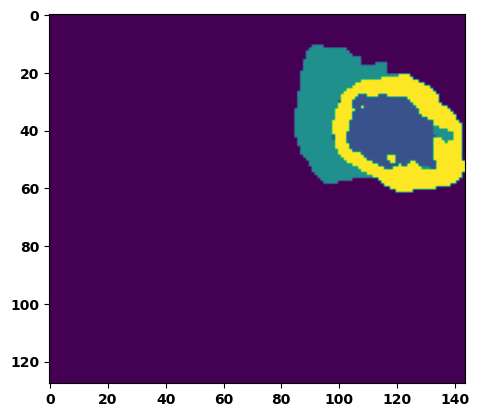

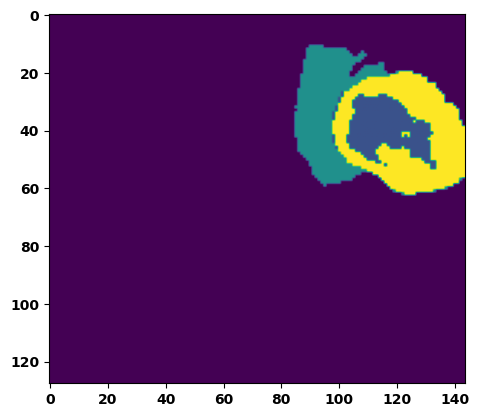

  6%|▌         | 2/36 [00:03<00:53,  1.56s/it]

Batch_id:  1 Eval loss:  0.06837743520736694
Batch_id:  1 Eval IoU:  tensor(0.8850, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:50,  1.53s/it]

Batch_id:  2 Eval loss:  0.15243835747241974
Batch_id:  2 Eval IoU:  tensor(0.7771, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9537, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9361, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9338, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')


 11%|█         | 4/36 [00:06<00:49,  1.55s/it]

Batch_id:  3 Eval loss:  0.2017190307378769
Batch_id:  3 Eval IoU:  tensor(0.7113, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9879, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:47,  1.53s/it]

Batch_id:  4 Eval loss:  0.13556815683841705
Batch_id:  4 Eval IoU:  tensor(0.7800, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9874, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:50,  1.69s/it]

Batch_id:  5 Eval loss:  0.2580358386039734
Batch_id:  5 Eval IoU:  tensor(0.6523, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 19%|█▉        | 7/36 [00:11<00:47,  1.65s/it]

Batch_id:  6 Eval loss:  0.4093444049358368
Batch_id:  6 Eval IoU:  tensor(0.5301, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9980, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:44,  1.60s/it]

Batch_id:  7 Eval loss:  0.26777559518814087
Batch_id:  7 Eval IoU:  tensor(0.6855, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9948, device='cuda:0')


 25%|██▌       | 9/36 [00:14<00:42,  1.57s/it]

Batch_id:  8 Eval loss:  0.35871922969818115
Batch_id:  8 Eval IoU:  tensor(0.5764, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


 28%|██▊       | 10/36 [00:15<00:40,  1.55s/it]

Batch_id:  9 Eval loss:  0.14006097614765167
Batch_id:  9 Eval IoU:  tensor(0.8200, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  10 Eval loss:  0.1022535115480423
Batch_id:  10 Eval IoU:  tensor(0.8332, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9917, device='cuda:0')


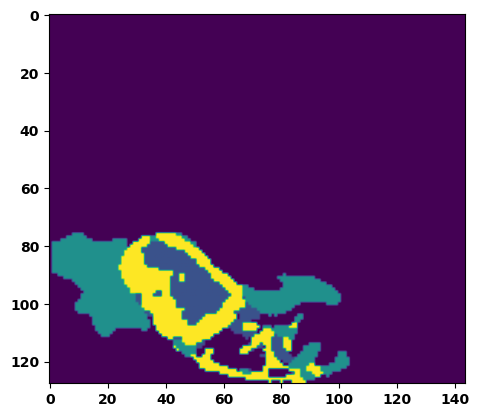

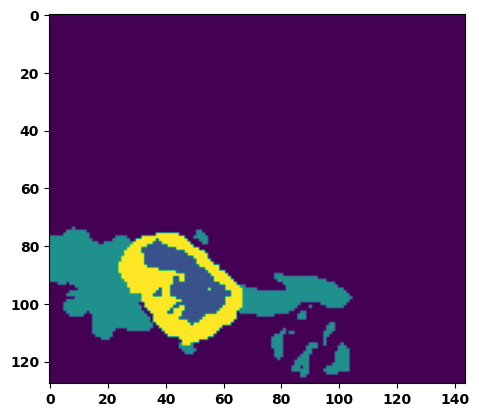

 33%|███▎      | 12/36 [00:19<00:38,  1.61s/it]

Batch_id:  11 Eval loss:  0.5469257831573486
Batch_id:  11 Eval IoU:  tensor(0.3904, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9305, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9181, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9300, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')


 36%|███▌      | 13/36 [00:20<00:35,  1.56s/it]

Batch_id:  12 Eval loss:  0.19563181698322296
Batch_id:  12 Eval IoU:  tensor(0.7275, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 39%|███▉      | 14/36 [00:22<00:33,  1.53s/it]

Batch_id:  13 Eval loss:  0.10185401141643524
Batch_id:  13 Eval IoU:  tensor(0.8278, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 42%|████▏     | 15/36 [00:23<00:31,  1.51s/it]

Batch_id:  14 Eval loss:  0.07880507409572601
Batch_id:  14 Eval IoU:  tensor(0.8681, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


 44%|████▍     | 16/36 [00:25<00:30,  1.51s/it]

Batch_id:  15 Eval loss:  0.4754094183444977
Batch_id:  15 Eval IoU:  tensor(0.4574, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')


 47%|████▋     | 17/36 [00:26<00:28,  1.48s/it]

Batch_id:  16 Eval loss:  0.3022311329841614
Batch_id:  16 Eval IoU:  tensor(0.6214, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9336, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9361, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 50%|█████     | 18/36 [00:27<00:26,  1.45s/it]

Batch_id:  17 Eval loss:  0.29281747341156006
Batch_id:  17 Eval IoU:  tensor(0.6010, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9695, device='cuda:0')


 53%|█████▎    | 19/36 [00:29<00:23,  1.39s/it]

Batch_id:  18 Eval loss:  0.3838389217853546
Batch_id:  18 Eval IoU:  tensor(0.4995, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9428, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9285, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9223, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 56%|█████▌    | 20/36 [00:30<00:22,  1.39s/it]

Batch_id:  19 Eval loss:  0.2182617038488388
Batch_id:  19 Eval IoU:  tensor(0.6901, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  20 Eval loss:  0.1506108194589615
Batch_id:  20 Eval IoU:  tensor(0.7774, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9901, device='cuda:0')


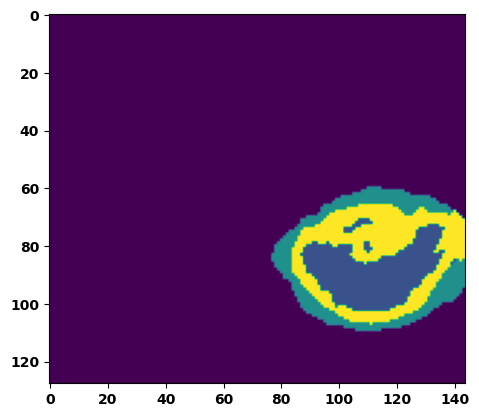

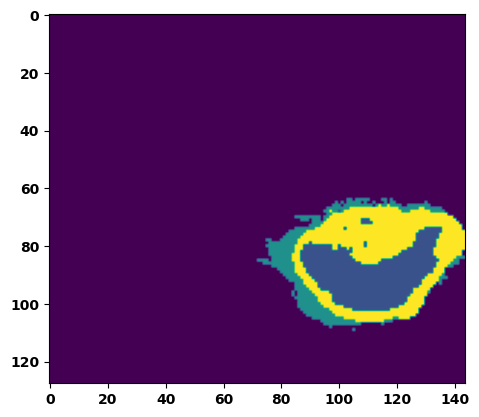

 61%|██████    | 22/36 [00:33<00:19,  1.40s/it]

Batch_id:  21 Eval loss:  0.17166589200496674
Batch_id:  21 Eval IoU:  tensor(0.7399, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9896, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:17,  1.37s/it]

Batch_id:  22 Eval loss:  0.18090994656085968
Batch_id:  22 Eval IoU:  tensor(0.7323, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 67%|██████▋   | 24/36 [00:36<00:16,  1.40s/it]

Batch_id:  23 Eval loss:  0.10507260262966156
Batch_id:  23 Eval IoU:  tensor(0.8290, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9960, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:15,  1.41s/it]

Batch_id:  24 Eval loss:  0.4048542380332947
Batch_id:  24 Eval IoU:  tensor(0.5322, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9067, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.8612, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.8603, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9987, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:13,  1.38s/it]

Batch_id:  25 Eval loss:  0.7353529334068298
Batch_id:  25 Eval IoU:  tensor(0.2431, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9216, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9281, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:12,  1.38s/it]

Batch_id:  26 Eval loss:  0.08326767385005951
Batch_id:  26 Eval IoU:  tensor(0.8874, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.39s/it]

Batch_id:  27 Eval loss:  0.0916312038898468
Batch_id:  27 Eval IoU:  tensor(0.8673, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:09,  1.37s/it]

Batch_id:  28 Eval loss:  0.2997439503669739
Batch_id:  28 Eval IoU:  tensor(0.5683, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9284, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9026, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9353, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9809, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.37s/it]

Batch_id:  29 Eval loss:  0.2039765864610672
Batch_id:  29 Eval IoU:  tensor(0.6977, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  30 Eval loss:  0.14914833009243011
Batch_id:  30 Eval IoU:  tensor(0.7699, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


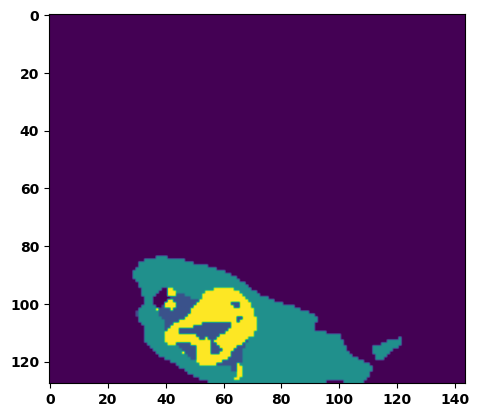

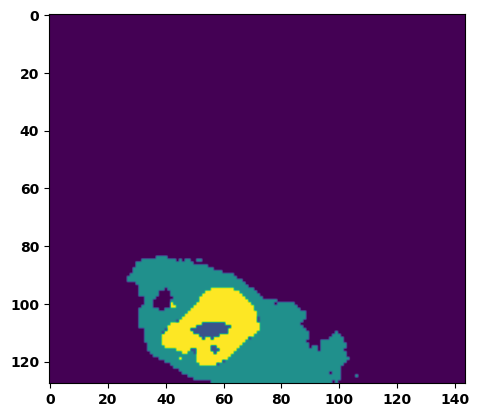

 89%|████████▉ | 32/36 [00:47<00:05,  1.33s/it]

Batch_id:  31 Eval loss:  0.18647946417331696
Batch_id:  31 Eval IoU:  tensor(0.7310, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.38s/it]

Batch_id:  32 Eval loss:  0.102556973695755
Batch_id:  32 Eval IoU:  tensor(0.8337, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9928, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.33s/it]

Batch_id:  33 Eval loss:  0.08140820264816284
Batch_id:  33 Eval IoU:  tensor(0.8670, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9845, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.32s/it]

Batch_id:  34 Eval loss:  0.19408932328224182
Batch_id:  34 Eval IoU:  tensor(0.7271, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9964, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.45s/it]

Batch_id:  35 Eval loss:  0.11057122051715851
Batch_id:  35 Eval IoU:  tensor(0.8250, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9880, device='cuda:0')
Epoch 00019: reducing learning rate of group 0 to 1.2500e-04.
Epoch  18 Training loss:  0.20600528866052628
Epoch  18 Evaluation loss:  0.22318406734201643
Epoch  18 Training accuracy :  tensor(0.7195)
Epoch  18 Evaluation accuracy :  tensor(0.7057)
Epoch  18 Training Mean Dice Score:  tensor(0.9765)
Epoch  18 Eval Mean Dice Score:  tensor(0.9724)
Epoch  18 Training Non-tumor Dice Score:  tensor(0.9790)
Epoch  18 Eval Non-tumor Dice Score:  tensor(0.9701)
Epoch  18 Training NCR/NET Dice Score:  tensor(0.9877)
Epoch  18 Eval NCR/NET Dice Score

Best Model saved!
Epoch: 19
Training in session: 


  1%|          | 1/110 [00:01<02:58,  1.64s/it]

Batch_id:  0 Training loss:  0.11137640476226807
Batch_id:  0 Training IoU:  tensor(0.8163, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:33,  1.42s/it]

Batch_id:  1 Training loss:  0.4308701753616333
Batch_id:  1 Training IoU:  tensor(0.4994, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:28,  1.39s/it]

Batch_id:  2 Training loss:  0.3256974220275879
Batch_id:  2 Training IoU:  tensor(0.6158, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:46,  1.57s/it]

Batch_id:  3 Training loss:  0.1444728821516037
Batch_id:  3 Training IoU:  tensor(0.7903, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:37,  1.50s/it]

Batch_id:  4 Training loss:  0.05379551649093628
Batch_id:  4 Training IoU:  tensor(0.9116, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:32,  1.46s/it]

Batch_id:  5 Training loss:  0.27188944816589355
Batch_id:  5 Training IoU:  tensor(0.6071, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9302, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9272, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9715, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:27,  1.44s/it]

Batch_id:  6 Training loss:  0.15080292522907257
Batch_id:  6 Training IoU:  tensor(0.7535, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9721, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:28,  1.46s/it]

Batch_id:  7 Training loss:  0.281819224357605
Batch_id:  7 Training IoU:  tensor(0.6485, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:21,  1.41s/it]

Batch_id:  8 Training loss:  0.18900015950202942
Batch_id:  8 Training IoU:  tensor(0.7105, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9810, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:20,  1.40s/it]

Batch_id:  9 Training loss:  0.2569159269332886
Batch_id:  9 Training IoU:  tensor(0.6228, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9273, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9251, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9059, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 10%|█         | 11/110 [00:15<02:21,  1.43s/it]

Batch_id:  10 Training loss:  0.20457860827445984
Batch_id:  10 Training IoU:  tensor(0.7084, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


 11%|█         | 12/110 [00:17<02:19,  1.42s/it]

Batch_id:  11 Training loss:  0.1491941660642624
Batch_id:  11 Training IoU:  tensor(0.7616, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:18,  1.43s/it]

Batch_id:  12 Training loss:  0.4457961320877075
Batch_id:  12 Training IoU:  tensor(0.4660, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9342, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9162, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:19,  1.45s/it]

Batch_id:  13 Training loss:  0.19281592965126038
Batch_id:  13 Training IoU:  tensor(0.7032, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9791, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:18,  1.46s/it]

Batch_id:  14 Training loss:  0.12346965074539185
Batch_id:  14 Training IoU:  tensor(0.8008, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9757, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:15,  1.44s/it]

Batch_id:  15 Training loss:  0.2651447355747223
Batch_id:  15 Training IoU:  tensor(0.6916, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:18,  1.49s/it]

Batch_id:  16 Training loss:  0.09460122883319855
Batch_id:  16 Training IoU:  tensor(0.8410, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:16,  1.48s/it]

Batch_id:  17 Training loss:  0.1463889181613922
Batch_id:  17 Training IoU:  tensor(0.7697, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:09,  1.43s/it]

Batch_id:  18 Training loss:  0.32192689180374146
Batch_id:  18 Training IoU:  tensor(0.5683, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9373, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9423, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9140, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:08,  1.43s/it]

Batch_id:  19 Training loss:  0.2580869197845459
Batch_id:  19 Training IoU:  tensor(0.6998, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:06,  1.42s/it]

Batch_id:  20 Training loss:  0.17841140925884247
Batch_id:  20 Training IoU:  tensor(0.7522, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 20%|██        | 22/110 [00:31<02:07,  1.45s/it]

Batch_id:  21 Training loss:  0.22906428575515747
Batch_id:  21 Training IoU:  tensor(0.7089, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 21%|██        | 23/110 [00:33<02:02,  1.41s/it]

Batch_id:  22 Training loss:  0.08918486535549164
Batch_id:  22 Training IoU:  tensor(0.8628, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:02,  1.42s/it]

Batch_id:  23 Training loss:  0.18273226916790009
Batch_id:  23 Training IoU:  tensor(0.7296, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:00,  1.42s/it]

Batch_id:  24 Training loss:  0.18255968391895294
Batch_id:  24 Training IoU:  tensor(0.7214, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9787, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:04,  1.48s/it]

Batch_id:  25 Training loss:  0.1568569839000702
Batch_id:  25 Training IoU:  tensor(0.7590, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 25%|██▍       | 27/110 [00:39<01:59,  1.44s/it]

Batch_id:  26 Training loss:  0.16438448429107666
Batch_id:  26 Training IoU:  tensor(0.7994, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 25%|██▌       | 28/110 [00:40<02:00,  1.46s/it]

Batch_id:  27 Training loss:  0.14294202625751495
Batch_id:  27 Training IoU:  tensor(0.7790, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:59,  1.48s/it]

Batch_id:  28 Training loss:  0.16943557560443878
Batch_id:  28 Training IoU:  tensor(0.7334, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9700, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:55,  1.44s/it]

Batch_id:  29 Training loss:  0.3369843065738678
Batch_id:  29 Training IoU:  tensor(0.5638, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9831, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:53,  1.43s/it]

Batch_id:  30 Training loss:  0.1463131606578827
Batch_id:  30 Training IoU:  tensor(0.7812, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:53,  1.45s/it]

Batch_id:  31 Training loss:  0.15575861930847168
Batch_id:  31 Training IoU:  tensor(0.7842, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 30%|███       | 33/110 [00:47<01:48,  1.41s/it]

Batch_id:  32 Training loss:  0.5022978782653809
Batch_id:  32 Training IoU:  tensor(0.4251, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 31%|███       | 34/110 [00:49<01:46,  1.40s/it]

Batch_id:  33 Training loss:  0.2862510085105896
Batch_id:  33 Training IoU:  tensor(0.6011, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9559, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9529, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9425, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:47,  1.43s/it]

Batch_id:  34 Training loss:  0.07638077437877655
Batch_id:  34 Training IoU:  tensor(0.8762, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:47,  1.46s/it]

Batch_id:  35 Training loss:  0.10705456137657166
Batch_id:  35 Training IoU:  tensor(0.8331, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:45,  1.45s/it]

Batch_id:  36 Training loss:  0.07044592499732971
Batch_id:  36 Training IoU:  tensor(0.8829, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 35%|███▍      | 38/110 [00:54<01:46,  1.47s/it]

Batch_id:  37 Training loss:  0.26507139205932617
Batch_id:  37 Training IoU:  tensor(0.6806, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:41,  1.42s/it]

Batch_id:  38 Training loss:  0.12114165723323822
Batch_id:  38 Training IoU:  tensor(0.8147, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 36%|███▋      | 40/110 [00:57<01:38,  1.41s/it]

Batch_id:  39 Training loss:  0.11575961112976074
Batch_id:  39 Training IoU:  tensor(0.8150, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 37%|███▋      | 41/110 [00:58<01:35,  1.38s/it]

Batch_id:  40 Training loss:  0.21452659368515015
Batch_id:  40 Training IoU:  tensor(0.7057, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 38%|███▊      | 42/110 [01:00<01:38,  1.44s/it]

Batch_id:  41 Training loss:  0.1161080002784729
Batch_id:  41 Training IoU:  tensor(0.8059, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 39%|███▉      | 43/110 [01:01<01:36,  1.44s/it]

Batch_id:  42 Training loss:  0.31299763917922974
Batch_id:  42 Training IoU:  tensor(0.6369, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 40%|████      | 44/110 [01:03<01:33,  1.41s/it]

Batch_id:  43 Training loss:  0.26915279030799866
Batch_id:  43 Training IoU:  tensor(0.6214, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 41%|████      | 45/110 [01:04<01:31,  1.41s/it]

Batch_id:  44 Training loss:  0.2627427577972412
Batch_id:  44 Training IoU:  tensor(0.6819, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:32,  1.44s/it]

Batch_id:  45 Training loss:  0.12214826047420502
Batch_id:  45 Training IoU:  tensor(0.7997, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 43%|████▎     | 47/110 [01:07<01:29,  1.43s/it]

Batch_id:  46 Training loss:  0.10622073709964752
Batch_id:  46 Training IoU:  tensor(0.8338, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:29,  1.45s/it]

Batch_id:  47 Training loss:  0.17583268880844116
Batch_id:  47 Training IoU:  tensor(0.7544, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 45%|████▍     | 49/110 [01:10<01:29,  1.46s/it]

Batch_id:  48 Training loss:  0.1384320855140686
Batch_id:  48 Training IoU:  tensor(0.8243, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 45%|████▌     | 50/110 [01:11<01:24,  1.41s/it]

Batch_id:  49 Training loss:  0.07041504979133606
Batch_id:  49 Training IoU:  tensor(0.8864, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 46%|████▋     | 51/110 [01:13<01:22,  1.40s/it]

Batch_id:  50 Training loss:  0.21452900767326355
Batch_id:  50 Training IoU:  tensor(0.6853, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:26,  1.48s/it]

Batch_id:  51 Training loss:  0.04840648174285889
Batch_id:  51 Training IoU:  tensor(0.9211, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:25,  1.50s/it]

Batch_id:  52 Training loss:  0.2997690439224243
Batch_id:  52 Training IoU:  tensor(0.6177, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 49%|████▉     | 54/110 [01:17<01:22,  1.47s/it]

Batch_id:  53 Training loss:  0.07391110062599182
Batch_id:  53 Training IoU:  tensor(0.8831, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:21,  1.48s/it]

Batch_id:  54 Training loss:  0.28738147020339966
Batch_id:  54 Training IoU:  tensor(0.6248, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 51%|█████     | 56/110 [01:20<01:20,  1.49s/it]

Batch_id:  55 Training loss:  0.28540873527526855
Batch_id:  55 Training IoU:  tensor(0.6558, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 52%|█████▏    | 57/110 [01:22<01:17,  1.46s/it]

Batch_id:  56 Training loss:  0.09389147162437439
Batch_id:  56 Training IoU:  tensor(0.8435, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 53%|█████▎    | 58/110 [01:23<01:15,  1.45s/it]

Batch_id:  57 Training loss:  0.296341210603714
Batch_id:  57 Training IoU:  tensor(0.5896, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 54%|█████▎    | 59/110 [01:25<01:15,  1.48s/it]

Batch_id:  58 Training loss:  0.26392650604248047
Batch_id:  58 Training IoU:  tensor(0.6288, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9522, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9390, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9785, device='cuda:0')


 55%|█████▍    | 60/110 [01:26<01:13,  1.47s/it]

Batch_id:  59 Training loss:  0.33536601066589355
Batch_id:  59 Training IoU:  tensor(0.6034, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:12,  1.49s/it]

Batch_id:  60 Training loss:  0.10737589001655579
Batch_id:  60 Training IoU:  tensor(0.8249, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 56%|█████▋    | 62/110 [01:29<01:09,  1.45s/it]

Batch_id:  61 Training loss:  0.3913172781467438
Batch_id:  61 Training IoU:  tensor(0.5479, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:07,  1.44s/it]

Batch_id:  62 Training loss:  0.2102072834968567
Batch_id:  62 Training IoU:  tensor(0.6931, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9806, device='cuda:0')


 58%|█████▊    | 64/110 [01:32<01:07,  1.47s/it]

Batch_id:  63 Training loss:  0.1452469825744629
Batch_id:  63 Training IoU:  tensor(0.7751, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:07,  1.50s/it]

Batch_id:  64 Training loss:  0.05334503948688507
Batch_id:  64 Training IoU:  tensor(0.9110, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 60%|██████    | 66/110 [01:35<01:04,  1.47s/it]

Batch_id:  65 Training loss:  0.5458220839500427
Batch_id:  65 Training IoU:  tensor(0.4003, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 61%|██████    | 67/110 [01:37<01:02,  1.46s/it]

Batch_id:  66 Training loss:  0.20448465645313263
Batch_id:  66 Training IoU:  tensor(0.7161, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 62%|██████▏   | 68/110 [01:38<01:04,  1.53s/it]

Batch_id:  67 Training loss:  0.285991370677948
Batch_id:  67 Training IoU:  tensor(0.6139, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9525, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<01:00,  1.48s/it]

Batch_id:  68 Training loss:  0.25112318992614746
Batch_id:  68 Training IoU:  tensor(0.6413, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 64%|██████▎   | 70/110 [01:41<00:58,  1.47s/it]

Batch_id:  69 Training loss:  0.12338602542877197
Batch_id:  69 Training IoU:  tensor(0.8029, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9833, device='cuda:0')


 65%|██████▍   | 71/110 [01:42<00:57,  1.47s/it]

Batch_id:  70 Training loss:  0.3755784034729004
Batch_id:  70 Training IoU:  tensor(0.5190, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9231, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9508, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9272, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9216, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9698, device='cuda:0')


 65%|██████▌   | 72/110 [01:44<00:55,  1.47s/it]

Batch_id:  71 Training loss:  0.09113985300064087
Batch_id:  71 Training IoU:  tensor(0.8741, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 66%|██████▋   | 73/110 [01:46<00:55,  1.50s/it]

Batch_id:  72 Training loss:  0.20511797070503235
Batch_id:  72 Training IoU:  tensor(0.6930, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 67%|██████▋   | 74/110 [01:47<00:52,  1.46s/it]

Batch_id:  73 Training loss:  0.29361042380332947
Batch_id:  73 Training IoU:  tensor(0.6565, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 68%|██████▊   | 75/110 [01:48<00:50,  1.45s/it]

Batch_id:  74 Training loss:  0.23060552775859833
Batch_id:  74 Training IoU:  tensor(0.7414, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 69%|██████▉   | 76/110 [01:50<00:50,  1.48s/it]

Batch_id:  75 Training loss:  0.11458563804626465
Batch_id:  75 Training IoU:  tensor(0.8107, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 70%|███████   | 77/110 [01:51<00:48,  1.47s/it]

Batch_id:  76 Training loss:  0.14727471768856049
Batch_id:  76 Training IoU:  tensor(0.7661, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 71%|███████   | 78/110 [01:53<00:48,  1.51s/it]

Batch_id:  77 Training loss:  0.10709698498249054
Batch_id:  77 Training IoU:  tensor(0.8262, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 72%|███████▏  | 79/110 [01:54<00:45,  1.48s/it]

Batch_id:  78 Training loss:  0.10016880929470062
Batch_id:  78 Training IoU:  tensor(0.8361, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 73%|███████▎  | 80/110 [01:56<00:43,  1.44s/it]

Batch_id:  79 Training loss:  0.22223705053329468
Batch_id:  79 Training IoU:  tensor(0.6709, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9287, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9703, device='cuda:0')


 74%|███████▎  | 81/110 [01:57<00:44,  1.52s/it]

Batch_id:  80 Training loss:  0.1649884432554245
Batch_id:  80 Training IoU:  tensor(0.7443, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 75%|███████▍  | 82/110 [01:59<00:43,  1.54s/it]

Batch_id:  81 Training loss:  0.06724105775356293
Batch_id:  81 Training IoU:  tensor(0.8894, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:41,  1.54s/it]

Batch_id:  82 Training loss:  0.1219901591539383
Batch_id:  82 Training IoU:  tensor(0.8016, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 76%|███████▋  | 84/110 [02:02<00:38,  1.49s/it]

Batch_id:  83 Training loss:  0.08116446435451508
Batch_id:  83 Training IoU:  tensor(0.8649, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 77%|███████▋  | 85/110 [02:03<00:37,  1.48s/it]

Batch_id:  84 Training loss:  0.14826923608779907
Batch_id:  84 Training IoU:  tensor(0.7610, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 78%|███████▊  | 86/110 [02:05<00:36,  1.51s/it]

Batch_id:  85 Training loss:  0.20229707658290863
Batch_id:  85 Training IoU:  tensor(0.7009, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 79%|███████▉  | 87/110 [02:06<00:33,  1.45s/it]

Batch_id:  86 Training loss:  0.17117342352867126
Batch_id:  86 Training IoU:  tensor(0.7297, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 80%|████████  | 88/110 [02:08<00:31,  1.45s/it]

Batch_id:  87 Training loss:  0.28579533100128174
Batch_id:  87 Training IoU:  tensor(0.6610, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 81%|████████  | 89/110 [02:09<00:30,  1.43s/it]

Batch_id:  88 Training loss:  0.15071173012256622
Batch_id:  88 Training IoU:  tensor(0.7616, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:28,  1.44s/it]

Batch_id:  89 Training loss:  0.14361914992332458
Batch_id:  89 Training IoU:  tensor(0.7926, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 83%|████████▎ | 91/110 [02:12<00:28,  1.48s/it]

Batch_id:  90 Training loss:  0.3723098933696747
Batch_id:  90 Training IoU:  tensor(0.6125, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9997, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:27,  1.50s/it]

Batch_id:  91 Training loss:  0.214413583278656
Batch_id:  91 Training IoU:  tensor(0.6842, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 85%|████████▍ | 93/110 [02:15<00:25,  1.48s/it]

Batch_id:  92 Training loss:  0.14654643833637238
Batch_id:  92 Training IoU:  tensor(0.7809, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:23,  1.48s/it]

Batch_id:  93 Training loss:  0.19708925485610962
Batch_id:  93 Training IoU:  tensor(0.6926, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


 86%|████████▋ | 95/110 [02:18<00:21,  1.44s/it]

Batch_id:  94 Training loss:  0.34448444843292236
Batch_id:  94 Training IoU:  tensor(0.5323, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9641, device='cuda:0')


 87%|████████▋ | 96/110 [02:19<00:20,  1.43s/it]

Batch_id:  95 Training loss:  0.22644589841365814
Batch_id:  95 Training IoU:  tensor(0.6612, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9831, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:18,  1.42s/it]

Batch_id:  96 Training loss:  0.14853380620479584
Batch_id:  96 Training IoU:  tensor(0.7751, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 89%|████████▉ | 98/110 [02:22<00:16,  1.39s/it]

Batch_id:  97 Training loss:  0.2145727574825287
Batch_id:  97 Training IoU:  tensor(0.6957, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 90%|█████████ | 99/110 [02:23<00:15,  1.41s/it]

Batch_id:  98 Training loss:  0.09359540045261383
Batch_id:  98 Training IoU:  tensor(0.8461, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 91%|█████████ | 100/110 [02:25<00:13,  1.38s/it]

Batch_id:  99 Training loss:  0.17055962979793549
Batch_id:  99 Training IoU:  tensor(0.7778, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 92%|█████████▏| 101/110 [02:26<00:12,  1.43s/it]

Batch_id:  100 Training loss:  0.06610630452632904
Batch_id:  100 Training IoU:  tensor(0.8951, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 93%|█████████▎| 102/110 [02:28<00:11,  1.44s/it]

Batch_id:  101 Training loss:  0.44530415534973145
Batch_id:  101 Training IoU:  tensor(0.4995, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 94%|█████████▎| 103/110 [02:29<00:10,  1.49s/it]

Batch_id:  102 Training loss:  0.1410466581583023
Batch_id:  102 Training IoU:  tensor(0.7826, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 95%|█████████▍| 104/110 [02:31<00:09,  1.52s/it]

Batch_id:  103 Training loss:  0.10274186730384827
Batch_id:  103 Training IoU:  tensor(0.8270, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 95%|█████████▌| 105/110 [02:32<00:07,  1.51s/it]

Batch_id:  104 Training loss:  0.17112530767917633
Batch_id:  104 Training IoU:  tensor(0.7817, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 96%|█████████▋| 106/110 [02:34<00:06,  1.53s/it]

Batch_id:  105 Training loss:  0.14141692221164703
Batch_id:  105 Training IoU:  tensor(0.7981, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 97%|█████████▋| 107/110 [02:35<00:04,  1.50s/it]

Batch_id:  106 Training loss:  0.2275562286376953
Batch_id:  106 Training IoU:  tensor(0.6792, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 98%|█████████▊| 108/110 [02:37<00:02,  1.49s/it]

Batch_id:  107 Training loss:  0.13268326222896576
Batch_id:  107 Training IoU:  tensor(0.8029, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 99%|█████████▉| 109/110 [02:38<00:01,  1.46s/it]

Batch_id:  108 Training loss:  0.10909095406532288
Batch_id:  108 Training IoU:  tensor(0.8181, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


100%|██████████| 110/110 [02:40<00:00,  1.46s/it]


Batch_id:  109 Training loss:  0.12640459835529327
Batch_id:  109 Training IoU:  tensor(0.7969, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9837, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.1082969456911087
Batch_id:  0 Eval IoU:  tensor(0.8757, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


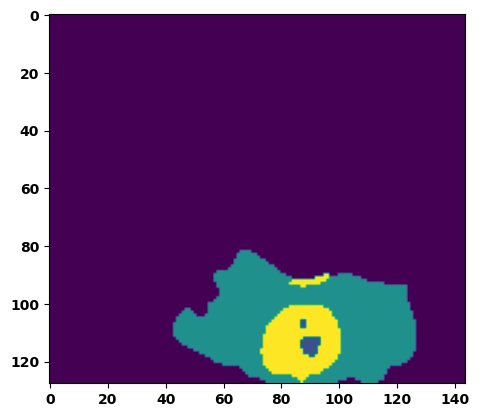

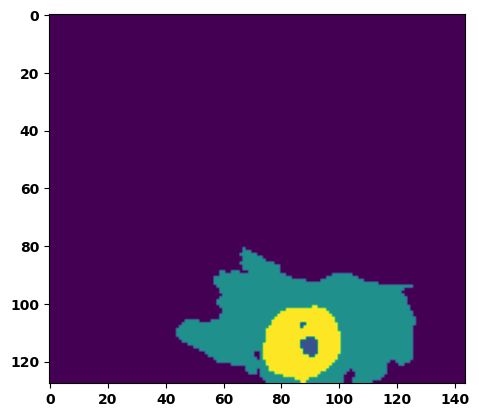

  6%|▌         | 2/36 [00:03<01:00,  1.77s/it]

Batch_id:  1 Eval loss:  0.4078993797302246
Batch_id:  1 Eval IoU:  tensor(0.5310, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:51,  1.57s/it]

Batch_id:  2 Eval loss:  0.27478671073913574
Batch_id:  2 Eval IoU:  tensor(0.6268, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9447, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 11%|█         | 4/36 [00:06<00:47,  1.49s/it]

Batch_id:  3 Eval loss:  0.09264110028743744
Batch_id:  3 Eval IoU:  tensor(0.8437, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:47,  1.54s/it]

Batch_id:  4 Eval loss:  0.21642015874385834
Batch_id:  4 Eval IoU:  tensor(0.6946, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9882, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:46,  1.53s/it]

Batch_id:  5 Eval loss:  0.2142464816570282
Batch_id:  5 Eval IoU:  tensor(0.7032, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9963, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:43,  1.50s/it]

Batch_id:  6 Eval loss:  0.09752145409584045
Batch_id:  6 Eval IoU:  tensor(0.8412, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:41,  1.48s/it]

Batch_id:  7 Eval loss:  0.1798877716064453
Batch_id:  7 Eval IoU:  tensor(0.7269, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:38,  1.43s/it]

Batch_id:  8 Eval loss:  0.14981186389923096
Batch_id:  8 Eval IoU:  tensor(0.7622, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9849, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:37,  1.43s/it]

Batch_id:  9 Eval loss:  0.07181300222873688
Batch_id:  9 Eval IoU:  tensor(0.8956, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  10 Eval loss:  0.28584492206573486
Batch_id:  10 Eval IoU:  tensor(0.6093, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9708, device='cuda:0')


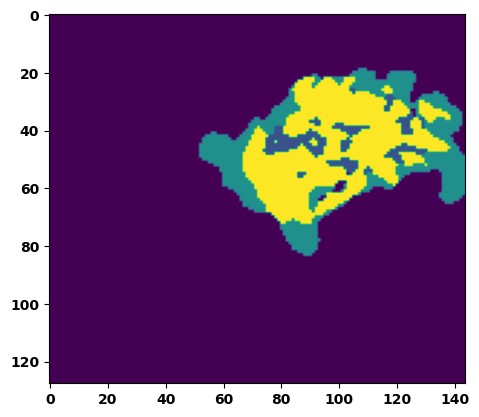

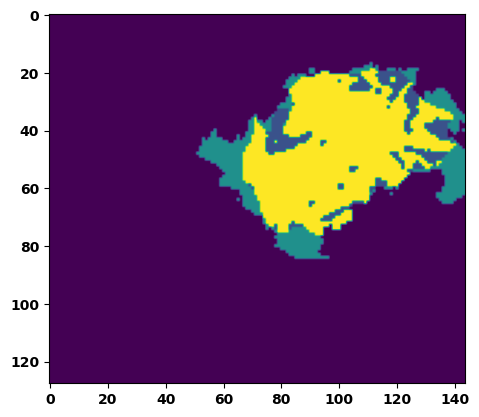

 33%|███▎      | 12/36 [00:18<00:36,  1.53s/it]

Batch_id:  11 Eval loss:  0.08664152026176453
Batch_id:  11 Eval IoU:  tensor(0.8577, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9965, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:35,  1.55s/it]

Batch_id:  12 Eval loss:  0.5193989276885986
Batch_id:  12 Eval IoU:  tensor(0.4199, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:33,  1.53s/it]

Batch_id:  13 Eval loss:  0.07814295589923859
Batch_id:  13 Eval IoU:  tensor(0.8732, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9861, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:32,  1.54s/it]

Batch_id:  14 Eval loss:  0.10014715790748596
Batch_id:  14 Eval IoU:  tensor(0.8385, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:30,  1.51s/it]

Batch_id:  15 Eval loss:  0.2703480124473572
Batch_id:  15 Eval IoU:  tensor(0.6839, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:28,  1.52s/it]

Batch_id:  16 Eval loss:  0.150665283203125
Batch_id:  16 Eval IoU:  tensor(0.7684, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 50%|█████     | 18/36 [00:27<00:28,  1.57s/it]

Batch_id:  17 Eval loss:  0.2533648908138275
Batch_id:  17 Eval IoU:  tensor(0.6567, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:25,  1.51s/it]

Batch_id:  18 Eval loss:  0.5280718803405762
Batch_id:  18 Eval IoU:  tensor(0.3988, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9333, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9314, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9281, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')


 56%|█████▌    | 20/36 [00:30<00:24,  1.53s/it]

Batch_id:  19 Eval loss:  0.20569708943367004
Batch_id:  19 Eval IoU:  tensor(0.6953, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  20 Eval loss:  0.14709311723709106
Batch_id:  20 Eval IoU:  tensor(0.7830, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


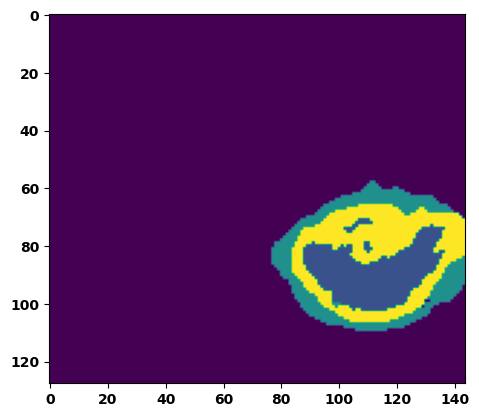

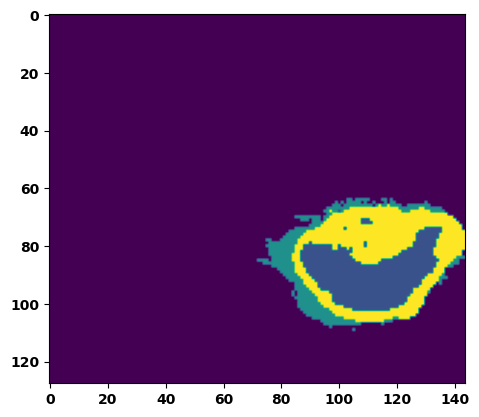

 61%|██████    | 22/36 [00:33<00:21,  1.57s/it]

Batch_id:  21 Eval loss:  0.07548289000988007
Batch_id:  21 Eval IoU:  tensor(0.8713, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


 64%|██████▍   | 23/36 [00:35<00:19,  1.51s/it]

Batch_id:  22 Eval loss:  0.2726571559906006
Batch_id:  22 Eval IoU:  tensor(0.5994, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9153, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9814, device='cuda:0')


 67%|██████▋   | 24/36 [00:36<00:18,  1.50s/it]

Batch_id:  23 Eval loss:  0.13481754064559937
Batch_id:  23 Eval IoU:  tensor(0.7886, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 69%|██████▉   | 25/36 [00:38<00:16,  1.53s/it]

Batch_id:  24 Eval loss:  0.24264688789844513
Batch_id:  24 Eval IoU:  tensor(0.6623, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9876, device='cuda:0')


 72%|███████▏  | 26/36 [00:39<00:14,  1.48s/it]

Batch_id:  25 Eval loss:  0.7199365496635437
Batch_id:  25 Eval IoU:  tensor(0.2522, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9237, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9250, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 75%|███████▌  | 27/36 [00:41<00:13,  1.54s/it]

Batch_id:  26 Eval loss:  0.40046215057373047
Batch_id:  26 Eval IoU:  tensor(0.5350, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9086, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.8641, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.8635, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 78%|███████▊  | 28/36 [00:42<00:12,  1.56s/it]

Batch_id:  27 Eval loss:  0.08542834222316742
Batch_id:  27 Eval IoU:  tensor(0.8586, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


 81%|████████  | 29/36 [00:44<00:10,  1.50s/it]

Batch_id:  28 Eval loss:  0.2859267592430115
Batch_id:  28 Eval IoU:  tensor(0.6304, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9452, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


 83%|████████▎ | 30/36 [00:45<00:08,  1.48s/it]

Batch_id:  29 Eval loss:  0.13342367112636566
Batch_id:  29 Eval IoU:  tensor(0.7983, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9435, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9410, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  30 Eval loss:  0.0644339919090271
Batch_id:  30 Eval IoU:  tensor(0.8912, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


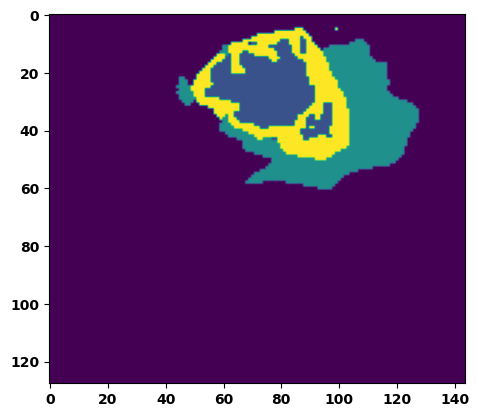

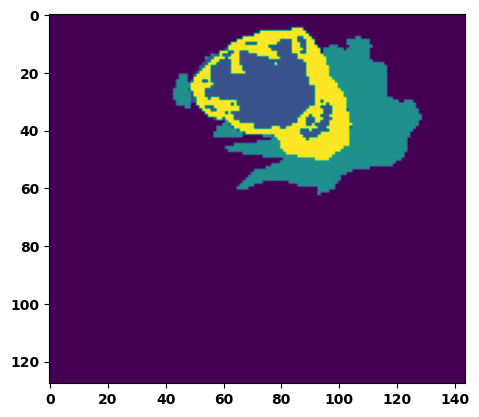

 89%|████████▉ | 32/36 [00:48<00:05,  1.49s/it]

Batch_id:  31 Eval loss:  0.09061798453330994
Batch_id:  31 Eval IoU:  tensor(0.8749, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


 92%|█████████▏| 33/36 [00:49<00:04,  1.39s/it]

Batch_id:  32 Eval loss:  0.35007357597351074
Batch_id:  32 Eval IoU:  tensor(0.5892, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 94%|█████████▍| 34/36 [00:51<00:02,  1.40s/it]

Batch_id:  33 Eval loss:  0.09909774363040924
Batch_id:  33 Eval IoU:  tensor(0.8317, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 97%|█████████▋| 35/36 [00:52<00:01,  1.40s/it]

Batch_id:  34 Eval loss:  0.28581225872039795
Batch_id:  34 Eval IoU:  tensor(0.6476, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9975, device='cuda:0')


100%|██████████| 36/36 [00:54<00:00,  1.50s/it]

Batch_id:  35 Eval loss:  0.4104146957397461
Batch_id:  35 Eval IoU:  tensor(0.4802, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9387, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9233, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9149, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9896, device='cuda:0')
Epoch  19 Training loss:  0.19654703641479665
Epoch  19 Evaluation loss:  0.22472146732939613
Epoch  19 Training accuracy :  tensor(0.7296)
Epoch  19 Evaluation accuracy :  tensor(0.7055)
Epoch  19 Training Mean Dice Score:  tensor(0.9776)
Epoch  19 Eval Mean Dice Score:  tensor(0.9728)
Epoch  19 Training Non-tumor Dice Score:  tensor(0.9797)
Epoch  19 Eval Non-tumor Dice Score:  tensor(0.9714)
Epoch  19 Training NCR/NET Dice Score:  tensor(0.9889)
Epoch  19 Eval NCR/NET Dice Score:  tensor(0.9875)
Epoch  19 Training ED Dice Score:  tensor(0.9

Epoch: 20
Training in session: 


  1%|          | 1/110 [00:01<02:33,  1.41s/it]

Batch_id:  0 Training loss:  0.23108507692813873
Batch_id:  0 Training IoU:  tensor(0.6565, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9254, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9656, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:32,  1.41s/it]

Batch_id:  1 Training loss:  0.16633549332618713
Batch_id:  1 Training IoU:  tensor(0.7843, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:28,  1.39s/it]

Batch_id:  2 Training loss:  0.13916592299938202
Batch_id:  2 Training IoU:  tensor(0.7950, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:26,  1.38s/it]

Batch_id:  3 Training loss:  0.36693137884140015
Batch_id:  3 Training IoU:  tensor(0.5313, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9498, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9443, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9803, device='cuda:0')


  5%|▍         | 5/110 [00:06<02:20,  1.34s/it]

Batch_id:  4 Training loss:  0.08495710790157318
Batch_id:  4 Training IoU:  tensor(0.8563, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:22,  1.37s/it]

Batch_id:  5 Training loss:  0.4105898141860962
Batch_id:  5 Training IoU:  tensor(0.5155, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


  6%|▋         | 7/110 [00:09<02:22,  1.39s/it]

Batch_id:  6 Training loss:  0.25168949365615845
Batch_id:  6 Training IoU:  tensor(0.7146, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:20,  1.38s/it]

Batch_id:  7 Training loss:  0.4782522916793823
Batch_id:  7 Training IoU:  tensor(0.4523, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


  8%|▊         | 9/110 [00:12<02:23,  1.42s/it]

Batch_id:  8 Training loss:  0.13469167053699493
Batch_id:  8 Training IoU:  tensor(0.7834, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


  9%|▉         | 10/110 [00:13<02:21,  1.42s/it]

Batch_id:  9 Training loss:  0.061175569891929626
Batch_id:  9 Training IoU:  tensor(0.9046, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 10%|█         | 11/110 [00:15<02:23,  1.45s/it]

Batch_id:  10 Training loss:  0.09953051805496216
Batch_id:  10 Training IoU:  tensor(0.8348, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 11%|█         | 12/110 [00:16<02:20,  1.44s/it]

Batch_id:  11 Training loss:  0.29286473989486694
Batch_id:  11 Training IoU:  tensor(0.6698, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:21,  1.45s/it]

Batch_id:  12 Training loss:  0.12603536248207092
Batch_id:  12 Training IoU:  tensor(0.7976, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 13%|█▎        | 14/110 [00:19<02:21,  1.48s/it]

Batch_id:  13 Training loss:  0.12823620438575745
Batch_id:  13 Training IoU:  tensor(0.8011, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:17,  1.45s/it]

Batch_id:  14 Training loss:  0.08722352981567383
Batch_id:  14 Training IoU:  tensor(0.8512, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 15%|█▍        | 16/110 [00:22<02:14,  1.43s/it]

Batch_id:  15 Training loss:  0.2601975202560425
Batch_id:  15 Training IoU:  tensor(0.6295, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:11,  1.41s/it]

Batch_id:  16 Training loss:  0.135793536901474
Batch_id:  16 Training IoU:  tensor(0.7967, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 16%|█▋        | 18/110 [00:25<02:13,  1.45s/it]

Batch_id:  17 Training loss:  0.1714283674955368
Batch_id:  17 Training IoU:  tensor(0.7269, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9787, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:12,  1.46s/it]

Batch_id:  18 Training loss:  0.05939434468746185
Batch_id:  18 Training IoU:  tensor(0.8988, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:15,  1.51s/it]

Batch_id:  19 Training loss:  0.14062505960464478
Batch_id:  19 Training IoU:  tensor(0.7763, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:14,  1.51s/it]

Batch_id:  20 Training loss:  0.116426482796669
Batch_id:  20 Training IoU:  tensor(0.8070, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 20%|██        | 22/110 [00:31<02:12,  1.51s/it]

Batch_id:  21 Training loss:  0.13396459817886353
Batch_id:  21 Training IoU:  tensor(0.7793, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9762, device='cuda:0')


 21%|██        | 23/110 [00:33<02:12,  1.53s/it]

Batch_id:  22 Training loss:  0.10070765018463135
Batch_id:  22 Training IoU:  tensor(0.8390, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:10,  1.52s/it]

Batch_id:  23 Training loss:  0.14958356320858002
Batch_id:  23 Training IoU:  tensor(0.7819, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:06,  1.49s/it]

Batch_id:  24 Training loss:  0.29147180914878845
Batch_id:  24 Training IoU:  tensor(0.6322, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:04,  1.48s/it]

Batch_id:  25 Training loss:  0.21097786724567413
Batch_id:  25 Training IoU:  tensor(0.7379, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 25%|██▍       | 27/110 [00:39<01:59,  1.45s/it]

Batch_id:  26 Training loss:  0.3500515818595886
Batch_id:  26 Training IoU:  tensor(0.5844, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9436, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 25%|██▌       | 28/110 [00:40<01:59,  1.46s/it]

Batch_id:  27 Training loss:  0.1495993286371231
Batch_id:  27 Training IoU:  tensor(0.7683, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


 26%|██▋       | 29/110 [00:41<01:56,  1.44s/it]

Batch_id:  28 Training loss:  0.2891356348991394
Batch_id:  28 Training IoU:  tensor(0.5914, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:59,  1.49s/it]

Batch_id:  29 Training loss:  0.1366364061832428
Batch_id:  29 Training IoU:  tensor(0.7995, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:56,  1.48s/it]

Batch_id:  30 Training loss:  0.21968790888786316
Batch_id:  30 Training IoU:  tensor(0.7565, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:56,  1.50s/it]

Batch_id:  31 Training loss:  0.22902801632881165
Batch_id:  31 Training IoU:  tensor(0.7550, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 30%|███       | 33/110 [00:47<01:53,  1.48s/it]

Batch_id:  32 Training loss:  0.26980292797088623
Batch_id:  32 Training IoU:  tensor(0.6925, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 31%|███       | 34/110 [00:49<01:51,  1.47s/it]

Batch_id:  33 Training loss:  0.1160561740398407
Batch_id:  33 Training IoU:  tensor(0.8082, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:51,  1.49s/it]

Batch_id:  34 Training loss:  0.14357800781726837
Batch_id:  34 Training IoU:  tensor(0.7997, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:50,  1.49s/it]

Batch_id:  35 Training loss:  0.12018929421901703
Batch_id:  35 Training IoU:  tensor(0.8115, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:44,  1.44s/it]

Batch_id:  36 Training loss:  0.22239284217357635
Batch_id:  36 Training IoU:  tensor(0.6792, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:45,  1.47s/it]

Batch_id:  37 Training loss:  0.045958876609802246
Batch_id:  37 Training IoU:  tensor(0.9257, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:43,  1.46s/it]

Batch_id:  38 Training loss:  0.17696960270404816
Batch_id:  38 Training IoU:  tensor(0.7298, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9797, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:42,  1.46s/it]

Batch_id:  39 Training loss:  0.2663733661174774
Batch_id:  39 Training IoU:  tensor(0.6161, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9323, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9281, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9729, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:41,  1.47s/it]

Batch_id:  40 Training loss:  0.23689018189907074
Batch_id:  40 Training IoU:  tensor(0.6542, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:37,  1.44s/it]

Batch_id:  41 Training loss:  0.23215226829051971
Batch_id:  41 Training IoU:  tensor(0.6496, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:40,  1.50s/it]

Batch_id:  42 Training loss:  0.09168358147144318
Batch_id:  42 Training IoU:  tensor(0.8466, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 40%|████      | 44/110 [01:04<01:35,  1.45s/it]

Batch_id:  43 Training loss:  0.33629292249679565
Batch_id:  43 Training IoU:  tensor(0.5487, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9298, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9346, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9319, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9674, device='cuda:0')


 41%|████      | 45/110 [01:05<01:38,  1.51s/it]

Batch_id:  44 Training loss:  0.1790689378976822
Batch_id:  44 Training IoU:  tensor(0.7485, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:37,  1.52s/it]

Batch_id:  45 Training loss:  0.2406490445137024
Batch_id:  45 Training IoU:  tensor(0.6408, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9315, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9292, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9125, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9833, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:34,  1.51s/it]

Batch_id:  46 Training loss:  0.08211848139762878
Batch_id:  46 Training IoU:  tensor(0.8692, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 44%|████▎     | 48/110 [01:10<01:33,  1.51s/it]

Batch_id:  47 Training loss:  0.107365682721138
Batch_id:  47 Training IoU:  tensor(0.8274, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:31,  1.50s/it]

Batch_id:  48 Training loss:  0.19673413038253784
Batch_id:  48 Training IoU:  tensor(0.7135, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:28,  1.48s/it]

Batch_id:  49 Training loss:  0.17495238780975342
Batch_id:  49 Training IoU:  tensor(0.7272, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9801, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:27,  1.48s/it]

Batch_id:  50 Training loss:  0.13618479669094086
Batch_id:  50 Training IoU:  tensor(0.7785, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:24,  1.46s/it]

Batch_id:  51 Training loss:  0.23379838466644287
Batch_id:  51 Training IoU:  tensor(0.6676, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9816, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:24,  1.49s/it]

Batch_id:  52 Training loss:  0.1647823303937912
Batch_id:  52 Training IoU:  tensor(0.7846, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:24,  1.50s/it]

Batch_id:  53 Training loss:  0.15889671444892883
Batch_id:  53 Training IoU:  tensor(0.7504, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9724, device='cuda:0')


 50%|█████     | 55/110 [01:20<01:21,  1.48s/it]

Batch_id:  54 Training loss:  0.11858963966369629
Batch_id:  54 Training IoU:  tensor(0.8061, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:19,  1.47s/it]

Batch_id:  55 Training loss:  0.17577332258224487
Batch_id:  55 Training IoU:  tensor(0.7296, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:18,  1.49s/it]

Batch_id:  56 Training loss:  0.5634716153144836
Batch_id:  56 Training IoU:  tensor(0.3659, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 53%|█████▎    | 58/110 [01:25<01:17,  1.50s/it]

Batch_id:  57 Training loss:  0.37815216183662415
Batch_id:  57 Training IoU:  tensor(0.5421, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 54%|█████▎    | 59/110 [01:26<01:15,  1.48s/it]

Batch_id:  58 Training loss:  0.10589021444320679
Batch_id:  58 Training IoU:  tensor(0.8268, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:17,  1.54s/it]

Batch_id:  59 Training loss:  0.09690937399864197
Batch_id:  59 Training IoU:  tensor(0.8386, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 55%|█████▌    | 61/110 [01:29<01:13,  1.51s/it]

Batch_id:  60 Training loss:  0.21439367532730103
Batch_id:  60 Training IoU:  tensor(0.6825, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:11,  1.49s/it]

Batch_id:  61 Training loss:  0.13585664331912994
Batch_id:  61 Training IoU:  tensor(0.7868, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 57%|█████▋    | 63/110 [01:32<01:08,  1.45s/it]

Batch_id:  62 Training loss:  0.0707007348537445
Batch_id:  62 Training IoU:  tensor(0.8851, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 58%|█████▊    | 64/110 [01:33<01:06,  1.45s/it]

Batch_id:  63 Training loss:  0.2043355256319046
Batch_id:  63 Training IoU:  tensor(0.6991, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 59%|█████▉    | 65/110 [01:35<01:03,  1.41s/it]

Batch_id:  64 Training loss:  0.09710094332695007
Batch_id:  64 Training IoU:  tensor(0.8491, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:03,  1.43s/it]

Batch_id:  65 Training loss:  0.1408122032880783
Batch_id:  65 Training IoU:  tensor(0.7844, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 61%|██████    | 67/110 [01:38<01:01,  1.42s/it]

Batch_id:  66 Training loss:  0.3057160973548889
Batch_id:  66 Training IoU:  tensor(0.5918, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9423, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9180, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 62%|██████▏   | 68/110 [01:39<01:00,  1.43s/it]

Batch_id:  67 Training loss:  0.27558934688568115
Batch_id:  67 Training IoU:  tensor(0.6294, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<00:58,  1.43s/it]

Batch_id:  68 Training loss:  0.10097309947013855
Batch_id:  68 Training IoU:  tensor(0.8419, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 64%|██████▎   | 70/110 [01:42<00:56,  1.42s/it]

Batch_id:  69 Training loss:  0.2810862064361572
Batch_id:  69 Training IoU:  tensor(0.6644, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 65%|██████▍   | 71/110 [01:43<00:56,  1.44s/it]

Batch_id:  70 Training loss:  0.09558983147144318
Batch_id:  70 Training IoU:  tensor(0.8418, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 65%|██████▌   | 72/110 [01:45<00:53,  1.42s/it]

Batch_id:  71 Training loss:  0.10935507714748383
Batch_id:  71 Training IoU:  tensor(0.8183, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 66%|██████▋   | 73/110 [01:46<00:53,  1.43s/it]

Batch_id:  72 Training loss:  0.23939228057861328
Batch_id:  72 Training IoU:  tensor(0.6658, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:51,  1.44s/it]

Batch_id:  73 Training loss:  0.23091891407966614
Batch_id:  73 Training IoU:  tensor(0.6640, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 68%|██████▊   | 75/110 [01:49<00:51,  1.46s/it]

Batch_id:  74 Training loss:  0.1340484619140625
Batch_id:  74 Training IoU:  tensor(0.7986, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 69%|██████▉   | 76/110 [01:51<00:50,  1.48s/it]

Batch_id:  75 Training loss:  0.1962248831987381
Batch_id:  75 Training IoU:  tensor(0.7125, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 70%|███████   | 77/110 [01:52<00:48,  1.47s/it]

Batch_id:  76 Training loss:  0.2047232687473297
Batch_id:  76 Training IoU:  tensor(0.7100, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:46,  1.46s/it]

Batch_id:  77 Training loss:  0.27661603689193726
Batch_id:  77 Training IoU:  tensor(0.6253, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9550, device='cuda:0')


 72%|███████▏  | 79/110 [01:55<00:45,  1.47s/it]

Batch_id:  78 Training loss:  0.25910717248916626
Batch_id:  78 Training IoU:  tensor(0.7044, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:44,  1.48s/it]

Batch_id:  79 Training loss:  0.4937472641468048
Batch_id:  79 Training IoU:  tensor(0.4186, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9295, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9174, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.8949, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 74%|███████▎  | 81/110 [01:58<00:42,  1.47s/it]

Batch_id:  80 Training loss:  0.3300068974494934
Batch_id:  80 Training IoU:  tensor(0.6150, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 75%|███████▍  | 82/110 [01:59<00:40,  1.44s/it]

Batch_id:  81 Training loss:  0.09459121525287628
Batch_id:  81 Training IoU:  tensor(0.8403, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:39,  1.45s/it]

Batch_id:  82 Training loss:  0.07368797063827515
Batch_id:  82 Training IoU:  tensor(0.8795, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 76%|███████▋  | 84/110 [02:02<00:36,  1.41s/it]

Batch_id:  83 Training loss:  0.1352377086877823
Batch_id:  83 Training IoU:  tensor(0.8021, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:35,  1.43s/it]

Batch_id:  84 Training loss:  0.18556246161460876
Batch_id:  84 Training IoU:  tensor(0.7399, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 78%|███████▊  | 86/110 [02:05<00:34,  1.46s/it]

Batch_id:  85 Training loss:  0.11562570929527283
Batch_id:  85 Training IoU:  tensor(0.8116, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9450, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:35,  1.54s/it]

Batch_id:  86 Training loss:  0.20257490873336792
Batch_id:  86 Training IoU:  tensor(0.6972, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 80%|████████  | 88/110 [02:08<00:33,  1.51s/it]

Batch_id:  87 Training loss:  0.1561797559261322
Batch_id:  87 Training IoU:  tensor(0.7775, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:30,  1.44s/it]

Batch_id:  88 Training loss:  0.14173415303230286
Batch_id:  88 Training IoU:  tensor(0.7750, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:28,  1.43s/it]

Batch_id:  89 Training loss:  0.1401239037513733
Batch_id:  89 Training IoU:  tensor(0.7830, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 83%|████████▎ | 91/110 [02:12<00:26,  1.42s/it]

Batch_id:  90 Training loss:  0.10403896868228912
Batch_id:  90 Training IoU:  tensor(0.8312, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:26,  1.46s/it]

Batch_id:  91 Training loss:  0.0991600751876831
Batch_id:  91 Training IoU:  tensor(0.8577, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 85%|████████▍ | 93/110 [02:15<00:24,  1.44s/it]

Batch_id:  92 Training loss:  0.07143796980381012
Batch_id:  92 Training IoU:  tensor(0.8808, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:23,  1.49s/it]

Batch_id:  93 Training loss:  0.21855631470680237
Batch_id:  93 Training IoU:  tensor(0.7233, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 86%|████████▋ | 95/110 [02:18<00:21,  1.45s/it]

Batch_id:  94 Training loss:  0.10049818456172943
Batch_id:  94 Training IoU:  tensor(0.8375, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:21,  1.52s/it]

Batch_id:  95 Training loss:  0.33440977334976196
Batch_id:  95 Training IoU:  tensor(0.5440, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9615, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:19,  1.50s/it]

Batch_id:  96 Training loss:  0.23895293474197388
Batch_id:  96 Training IoU:  tensor(0.6696, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:18,  1.51s/it]

Batch_id:  97 Training loss:  0.38733798265457153
Batch_id:  97 Training IoU:  tensor(0.6081, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9996, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:17,  1.55s/it]

Batch_id:  98 Training loss:  0.06889303028583527
Batch_id:  98 Training IoU:  tensor(0.8848, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:15,  1.53s/it]

Batch_id:  99 Training loss:  0.12243431806564331
Batch_id:  99 Training IoU:  tensor(0.8059, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9769, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:13,  1.51s/it]

Batch_id:  100 Training loss:  0.2589084208011627
Batch_id:  100 Training IoU:  tensor(0.6807, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:12,  1.52s/it]

Batch_id:  101 Training loss:  0.3634077310562134
Batch_id:  101 Training IoU:  tensor(0.5645, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9465, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9398, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.51s/it]

Batch_id:  102 Training loss:  0.13780392706394196
Batch_id:  102 Training IoU:  tensor(0.8161, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:08,  1.50s/it]

Batch_id:  103 Training loss:  0.04684321582317352
Batch_id:  103 Training IoU:  tensor(0.9226, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.50s/it]

Batch_id:  104 Training loss:  0.2018507719039917
Batch_id:  104 Training IoU:  tensor(0.6955, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:05,  1.48s/it]

Batch_id:  105 Training loss:  0.14416740834712982
Batch_id:  105 Training IoU:  tensor(0.8101, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.50s/it]

Batch_id:  106 Training loss:  0.1299026906490326
Batch_id:  106 Training IoU:  tensor(0.7960, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:03,  1.53s/it]

Batch_id:  107 Training loss:  0.42548662424087524
Batch_id:  107 Training IoU:  tensor(0.5143, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.50s/it]

Batch_id:  108 Training loss:  0.19720430672168732
Batch_id:  108 Training IoU:  tensor(0.7272, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.2075434923171997
Batch_id:  109 Training IoU:  tensor(0.6907, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9873, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.4122971296310425
Batch_id:  0 Eval IoU:  tensor(0.5268, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


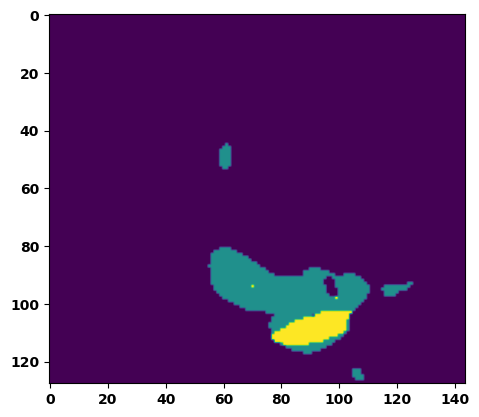

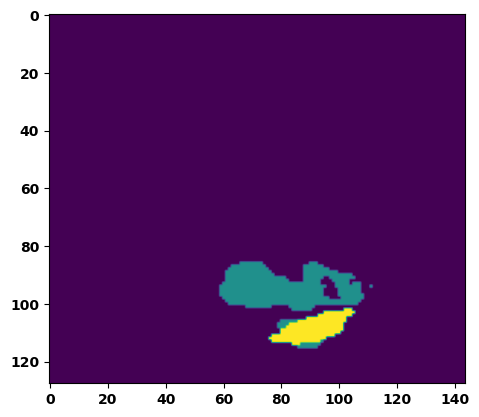

  6%|▌         | 2/36 [00:03<00:59,  1.75s/it]

Batch_id:  1 Eval loss:  0.4002000689506531
Batch_id:  1 Eval IoU:  tensor(0.5352, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9086, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.8640, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.8635, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:50,  1.53s/it]

Batch_id:  2 Eval loss:  0.4628547430038452
Batch_id:  2 Eval IoU:  tensor(0.4485, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9338, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9382, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


 11%|█         | 4/36 [00:06<00:48,  1.52s/it]

Batch_id:  3 Eval loss:  0.24353916943073273
Batch_id:  3 Eval IoU:  tensor(0.6608, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9876, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:46,  1.50s/it]

Batch_id:  4 Eval loss:  0.14862023293972015
Batch_id:  4 Eval IoU:  tensor(0.7635, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9852, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:47,  1.58s/it]

Batch_id:  5 Eval loss:  0.5264499187469482
Batch_id:  5 Eval IoU:  tensor(0.4097, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:43,  1.50s/it]

Batch_id:  6 Eval loss:  0.2610526978969574
Batch_id:  6 Eval IoU:  tensor(0.6638, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:43,  1.54s/it]

Batch_id:  7 Eval loss:  0.36286184191703796
Batch_id:  7 Eval IoU:  tensor(0.5706, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:41,  1.53s/it]

Batch_id:  8 Eval loss:  0.0946403443813324
Batch_id:  8 Eval IoU:  tensor(0.8465, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 28%|██▊       | 10/36 [00:15<00:38,  1.50s/it]

Batch_id:  9 Eval loss:  0.09363667666912079
Batch_id:  9 Eval IoU:  tensor(0.8729, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  10 Eval loss:  0.3800070583820343
Batch_id:  10 Eval IoU:  tensor(0.5049, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9282, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9212, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


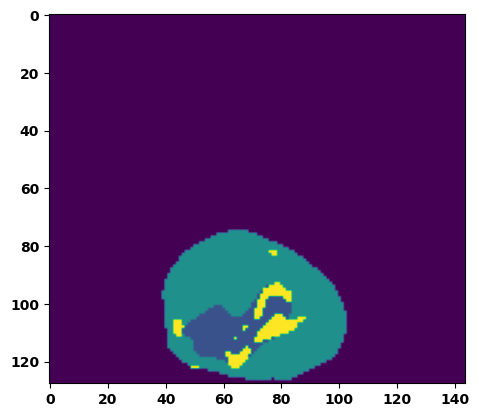

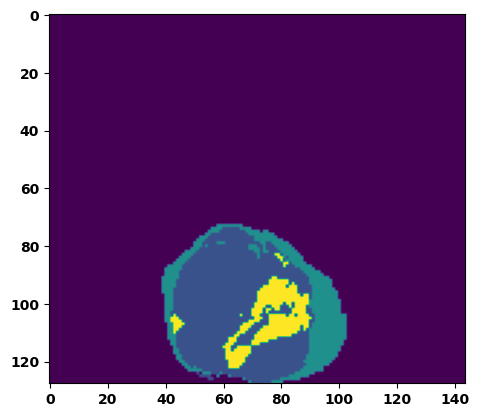

 33%|███▎      | 12/36 [00:18<00:35,  1.49s/it]

Batch_id:  11 Eval loss:  0.13333511352539062
Batch_id:  11 Eval IoU:  tensor(0.7913, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.51s/it]

Batch_id:  12 Eval loss:  0.10553494095802307
Batch_id:  12 Eval IoU:  tensor(0.8290, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9966, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:32,  1.48s/it]

Batch_id:  13 Eval loss:  0.2741275429725647
Batch_id:  13 Eval IoU:  tensor(0.6246, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9752, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:30,  1.46s/it]

Batch_id:  14 Eval loss:  0.28189903497695923
Batch_id:  14 Eval IoU:  tensor(0.6385, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9464, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:29,  1.46s/it]

Batch_id:  15 Eval loss:  0.0862262099981308
Batch_id:  15 Eval IoU:  tensor(0.8530, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:27,  1.45s/it]

Batch_id:  16 Eval loss:  0.20621749758720398
Batch_id:  16 Eval IoU:  tensor(0.7112, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 50%|█████     | 18/36 [00:27<00:26,  1.49s/it]

Batch_id:  17 Eval loss:  0.06595636904239655
Batch_id:  17 Eval IoU:  tensor(0.8886, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9932, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:25,  1.48s/it]

Batch_id:  18 Eval loss:  0.11392940580844879
Batch_id:  18 Eval IoU:  tensor(0.8749, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 56%|█████▌    | 20/36 [00:30<00:22,  1.42s/it]

Batch_id:  19 Eval loss:  0.2677501440048218
Batch_id:  19 Eval IoU:  tensor(0.6904, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  20 Eval loss:  0.18843601644039154
Batch_id:  20 Eval IoU:  tensor(0.7303, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


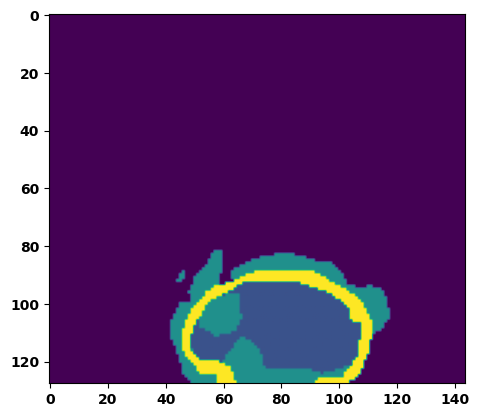

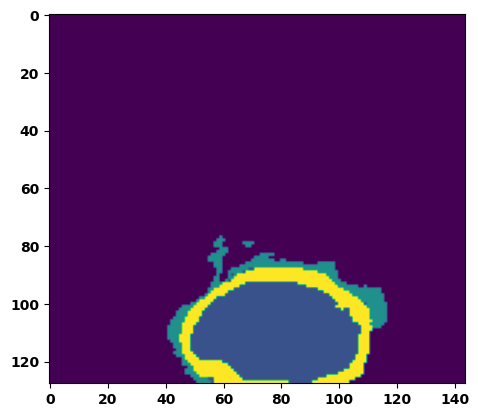

 61%|██████    | 22/36 [00:33<00:21,  1.53s/it]

Batch_id:  21 Eval loss:  0.07994303107261658
Batch_id:  21 Eval IoU:  tensor(0.8635, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9909, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.47s/it]

Batch_id:  22 Eval loss:  0.18082217872142792
Batch_id:  22 Eval IoU:  tensor(0.7267, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 67%|██████▋   | 24/36 [00:36<00:18,  1.57s/it]

Batch_id:  23 Eval loss:  0.26097410917282104
Batch_id:  23 Eval IoU:  tensor(0.6490, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:17,  1.55s/it]

Batch_id:  24 Eval loss:  0.18790505826473236
Batch_id:  24 Eval IoU:  tensor(0.7211, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')


 72%|███████▏  | 26/36 [00:39<00:15,  1.56s/it]

Batch_id:  25 Eval loss:  0.26444417238235474
Batch_id:  25 Eval IoU:  tensor(0.6084, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9236, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9806, device='cuda:0')


 75%|███████▌  | 27/36 [00:41<00:13,  1.55s/it]

Batch_id:  26 Eval loss:  0.10167102515697479
Batch_id:  26 Eval IoU:  tensor(0.8325, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9915, device='cuda:0')


 78%|███████▊  | 28/36 [00:42<00:12,  1.53s/it]

Batch_id:  27 Eval loss:  0.08019964396953583
Batch_id:  27 Eval IoU:  tensor(0.8671, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 81%|████████  | 29/36 [00:44<00:10,  1.52s/it]

Batch_id:  28 Eval loss:  0.21670201420783997
Batch_id:  28 Eval IoU:  tensor(0.6964, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


 83%|████████▎ | 30/36 [00:45<00:08,  1.47s/it]

Batch_id:  29 Eval loss:  0.15113992989063263
Batch_id:  29 Eval IoU:  tensor(0.7792, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  30 Eval loss:  0.08068029582500458
Batch_id:  30 Eval IoU:  tensor(0.8679, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9856, device='cuda:0')


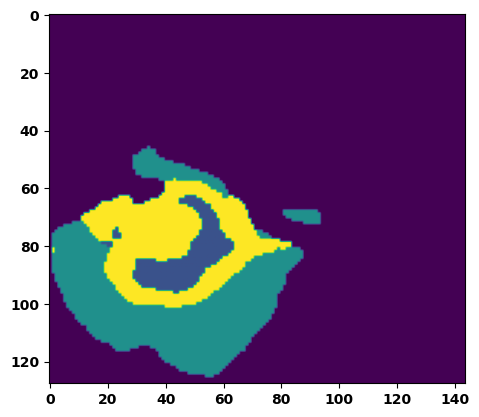

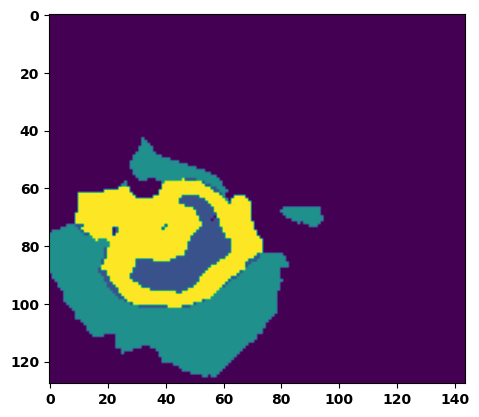

 89%|████████▉ | 32/36 [00:48<00:06,  1.58s/it]

Batch_id:  31 Eval loss:  0.10160423815250397
Batch_id:  31 Eval IoU:  tensor(0.8276, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


 92%|█████████▏| 33/36 [00:50<00:04,  1.53s/it]

Batch_id:  32 Eval loss:  0.7266151309013367
Batch_id:  32 Eval IoU:  tensor(0.2479, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9202, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9249, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9957, device='cuda:0')


 94%|█████████▍| 34/36 [00:51<00:03,  1.55s/it]

Batch_id:  33 Eval loss:  0.21202215552330017
Batch_id:  33 Eval IoU:  tensor(0.6871, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9869, device='cuda:0')


 97%|█████████▋| 35/36 [00:53<00:01,  1.48s/it]

Batch_id:  34 Eval loss:  0.12610730528831482
Batch_id:  34 Eval IoU:  tensor(0.8068, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9462, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


100%|██████████| 36/36 [00:54<00:00,  1.51s/it]

Batch_id:  35 Eval loss:  0.07188159227371216
Batch_id:  35 Eval IoU:  tensor(0.8949, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')
Epoch  20 Training loss:  0.19159637825055556
Epoch  20 Evaluation loss:  0.22089677883519065
Epoch  20 Training accuracy :  tensor(0.7358)
Epoch  20 Evaluation accuracy :  tensor(0.7086)
Epoch  20 Training Mean Dice Score:  tensor(0.9778)
Epoch  20 Eval Mean Dice Score:  tensor(0.9732)
Epoch  20 Training Non-tumor Dice Score:  tensor(0.9801)
Epoch  20 Eval Non-tumor Dice Score:  tensor(0.9717)
Epoch  20 Training NCR/NET Dice Score:  tensor(0.9888)
Epoch  20 Eval NCR/NET Dice Score:  tensor(0.9881)
Epoch  20 Training ED Dice Score:  tensor(0.

Best Model saved!
Epoch: 21
Training in session: 


  1%|          | 1/110 [00:01<03:17,  1.81s/it]

Batch_id:  0 Training loss:  0.2522956132888794
Batch_id:  0 Training IoU:  tensor(0.6930, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9979, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:57,  1.64s/it]

Batch_id:  1 Training loss:  0.1988859325647354
Batch_id:  1 Training IoU:  tensor(0.7150, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:53,  1.62s/it]

Batch_id:  2 Training loss:  0.24869729578495026
Batch_id:  2 Training IoU:  tensor(0.6320, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:46,  1.57s/it]

Batch_id:  3 Training loss:  0.15768271684646606
Batch_id:  3 Training IoU:  tensor(0.7860, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:37,  1.50s/it]

Batch_id:  4 Training loss:  0.13524189591407776
Batch_id:  4 Training IoU:  tensor(0.8007, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:36,  1.51s/it]

Batch_id:  5 Training loss:  0.1525736004114151
Batch_id:  5 Training IoU:  tensor(0.7858, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:33,  1.49s/it]

Batch_id:  6 Training loss:  0.27764439582824707
Batch_id:  6 Training IoU:  tensor(0.7080, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:33,  1.50s/it]

Batch_id:  7 Training loss:  0.5266507863998413
Batch_id:  7 Training IoU:  tensor(0.4212, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:31,  1.50s/it]

Batch_id:  8 Training loss:  0.12920419871807098
Batch_id:  8 Training IoU:  tensor(0.7912, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:30,  1.51s/it]

Batch_id:  9 Training loss:  0.2920898199081421
Batch_id:  9 Training IoU:  tensor(0.6615, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 10%|█         | 11/110 [00:16<02:28,  1.50s/it]

Batch_id:  10 Training loss:  0.2399263083934784
Batch_id:  10 Training IoU:  tensor(0.6458, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 11%|█         | 12/110 [00:18<02:21,  1.45s/it]

Batch_id:  11 Training loss:  0.26819542050361633
Batch_id:  11 Training IoU:  tensor(0.6434, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:24,  1.49s/it]

Batch_id:  12 Training loss:  0.1717388778924942
Batch_id:  12 Training IoU:  tensor(0.7253, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:21,  1.48s/it]

Batch_id:  13 Training loss:  0.11177191138267517
Batch_id:  13 Training IoU:  tensor(0.8120, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:19,  1.47s/it]

Batch_id:  14 Training loss:  0.24120081961154938
Batch_id:  14 Training IoU:  tensor(0.6917, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:14,  1.43s/it]

Batch_id:  15 Training loss:  0.10519486665725708
Batch_id:  15 Training IoU:  tensor(0.8286, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:13,  1.43s/it]

Batch_id:  16 Training loss:  0.19718649983406067
Batch_id:  16 Training IoU:  tensor(0.7074, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:13,  1.45s/it]

Batch_id:  17 Training loss:  0.11517104506492615
Batch_id:  17 Training IoU:  tensor(0.8235, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:09,  1.43s/it]

Batch_id:  18 Training loss:  0.17692111432552338
Batch_id:  18 Training IoU:  tensor(0.7518, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:09,  1.43s/it]

Batch_id:  19 Training loss:  0.14171314239501953
Batch_id:  19 Training IoU:  tensor(0.7741, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:08,  1.45s/it]

Batch_id:  20 Training loss:  0.3185257315635681
Batch_id:  20 Training IoU:  tensor(0.6255, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9547, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9993, device='cuda:0')


 20%|██        | 22/110 [00:32<02:05,  1.43s/it]

Batch_id:  21 Training loss:  0.23844268918037415
Batch_id:  21 Training IoU:  tensor(0.6589, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9809, device='cuda:0')


 21%|██        | 23/110 [00:34<02:05,  1.44s/it]

Batch_id:  22 Training loss:  0.22224941849708557
Batch_id:  22 Training IoU:  tensor(0.7365, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:06,  1.47s/it]

Batch_id:  23 Training loss:  0.10852207243442535
Batch_id:  23 Training IoU:  tensor(0.8316, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:04,  1.46s/it]

Batch_id:  24 Training loss:  0.26707690954208374
Batch_id:  24 Training IoU:  tensor(0.6885, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:00,  1.43s/it]

Batch_id:  25 Training loss:  0.17442826926708221
Batch_id:  25 Training IoU:  tensor(0.7361, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 25%|██▍       | 27/110 [00:39<01:57,  1.42s/it]

Batch_id:  26 Training loss:  0.09879986941814423
Batch_id:  26 Training IoU:  tensor(0.8398, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 25%|██▌       | 28/110 [00:41<01:56,  1.42s/it]

Batch_id:  27 Training loss:  0.2589274048805237
Batch_id:  27 Training IoU:  tensor(0.6845, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:56,  1.44s/it]

Batch_id:  28 Training loss:  0.10383015871047974
Batch_id:  28 Training IoU:  tensor(0.8304, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:53,  1.42s/it]

Batch_id:  29 Training loss:  0.12666501104831696
Batch_id:  29 Training IoU:  tensor(0.7964, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:52,  1.42s/it]

Batch_id:  30 Training loss:  0.09017865359783173
Batch_id:  30 Training IoU:  tensor(0.8488, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9839, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:48,  1.39s/it]

Batch_id:  31 Training loss:  0.21424560248851776
Batch_id:  31 Training IoU:  tensor(0.6897, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 30%|███       | 33/110 [00:48<01:46,  1.39s/it]

Batch_id:  32 Training loss:  0.1784685105085373
Batch_id:  32 Training IoU:  tensor(0.7305, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 31%|███       | 34/110 [00:49<01:47,  1.42s/it]

Batch_id:  33 Training loss:  0.2190960943698883
Batch_id:  33 Training IoU:  tensor(0.7270, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:47,  1.44s/it]

Batch_id:  34 Training loss:  0.279277503490448
Batch_id:  34 Training IoU:  tensor(0.6399, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:45,  1.43s/it]

Batch_id:  35 Training loss:  0.4436008334159851
Batch_id:  35 Training IoU:  tensor(0.4762, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:43,  1.42s/it]

Batch_id:  36 Training loss:  0.11469811201095581
Batch_id:  36 Training IoU:  tensor(0.8164, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:40,  1.40s/it]

Batch_id:  37 Training loss:  0.11836361885070801
Batch_id:  37 Training IoU:  tensor(0.8039, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:40,  1.41s/it]

Batch_id:  38 Training loss:  0.12493182718753815
Batch_id:  38 Training IoU:  tensor(0.7942, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:43,  1.47s/it]

Batch_id:  39 Training loss:  0.049488648772239685
Batch_id:  39 Training IoU:  tensor(0.9182, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:37,  1.41s/it]

Batch_id:  40 Training loss:  0.0635397732257843
Batch_id:  40 Training IoU:  tensor(0.8950, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:36,  1.42s/it]

Batch_id:  41 Training loss:  0.2967308759689331
Batch_id:  41 Training IoU:  tensor(0.6532, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:34,  1.41s/it]

Batch_id:  42 Training loss:  0.27345025539398193
Batch_id:  42 Training IoU:  tensor(0.6354, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 40%|████      | 44/110 [01:03<01:31,  1.38s/it]

Batch_id:  43 Training loss:  0.09293732047080994
Batch_id:  43 Training IoU:  tensor(0.8462, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 41%|████      | 45/110 [01:05<01:33,  1.44s/it]

Batch_id:  44 Training loss:  0.15345585346221924
Batch_id:  44 Training IoU:  tensor(0.7691, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:31,  1.42s/it]

Batch_id:  45 Training loss:  0.06671828031539917
Batch_id:  45 Training IoU:  tensor(0.8920, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:27,  1.40s/it]

Batch_id:  46 Training loss:  0.05578558146953583
Batch_id:  46 Training IoU:  tensor(0.9091, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:26,  1.39s/it]

Batch_id:  47 Training loss:  0.1484055370092392
Batch_id:  47 Training IoU:  tensor(0.7569, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9732, device='cuda:0')


 45%|████▍     | 49/110 [01:10<01:26,  1.42s/it]

Batch_id:  48 Training loss:  0.33345335721969604
Batch_id:  48 Training IoU:  tensor(0.6032, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:23,  1.39s/it]

Batch_id:  49 Training loss:  0.17630627751350403
Batch_id:  49 Training IoU:  tensor(0.7237, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 46%|████▋     | 51/110 [01:13<01:22,  1.39s/it]

Batch_id:  50 Training loss:  0.2061479538679123
Batch_id:  50 Training IoU:  tensor(0.6929, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:20,  1.39s/it]

Batch_id:  51 Training loss:  0.12572990357875824
Batch_id:  51 Training IoU:  tensor(0.8011, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9484, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:19,  1.39s/it]

Batch_id:  52 Training loss:  0.1493508368730545
Batch_id:  52 Training IoU:  tensor(0.7772, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 49%|████▉     | 54/110 [01:17<01:17,  1.39s/it]

Batch_id:  53 Training loss:  0.27481114864349365
Batch_id:  53 Training IoU:  tensor(0.6051, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9220, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9178, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.8971, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9847, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:15,  1.38s/it]

Batch_id:  54 Training loss:  0.08249779045581818
Batch_id:  54 Training IoU:  tensor(0.8592, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 51%|█████     | 56/110 [01:20<01:14,  1.38s/it]

Batch_id:  55 Training loss:  0.3372562825679779
Batch_id:  55 Training IoU:  tensor(0.5451, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9322, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9423, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9050, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 52%|█████▏    | 57/110 [01:21<01:11,  1.35s/it]

Batch_id:  56 Training loss:  0.3289385437965393
Batch_id:  56 Training IoU:  tensor(0.6171, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 53%|█████▎    | 58/110 [01:23<01:13,  1.41s/it]

Batch_id:  57 Training loss:  0.09533022344112396
Batch_id:  57 Training IoU:  tensor(0.8415, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 54%|█████▎    | 59/110 [01:24<01:11,  1.40s/it]

Batch_id:  58 Training loss:  0.38321834802627563
Batch_id:  58 Training IoU:  tensor(0.5944, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9996, device='cuda:0')


 55%|█████▍    | 60/110 [01:26<01:10,  1.41s/it]

Batch_id:  59 Training loss:  0.4834398627281189
Batch_id:  59 Training IoU:  tensor(0.4436, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 55%|█████▌    | 61/110 [01:27<01:11,  1.47s/it]

Batch_id:  60 Training loss:  0.05771350860595703
Batch_id:  60 Training IoU:  tensor(0.9079, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 56%|█████▋    | 62/110 [01:29<01:09,  1.45s/it]

Batch_id:  61 Training loss:  0.06980448961257935
Batch_id:  61 Training IoU:  tensor(0.8865, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 57%|█████▋    | 63/110 [01:30<01:07,  1.45s/it]

Batch_id:  62 Training loss:  0.13940992951393127
Batch_id:  62 Training IoU:  tensor(0.7827, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 58%|█████▊    | 64/110 [01:32<01:07,  1.46s/it]

Batch_id:  63 Training loss:  0.14848974347114563
Batch_id:  63 Training IoU:  tensor(0.7622, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 59%|█████▉    | 65/110 [01:33<01:03,  1.42s/it]

Batch_id:  64 Training loss:  0.2257273942232132
Batch_id:  64 Training IoU:  tensor(0.6753, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 60%|██████    | 66/110 [01:34<01:03,  1.44s/it]

Batch_id:  65 Training loss:  0.100150465965271
Batch_id:  65 Training IoU:  tensor(0.8316, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 61%|██████    | 67/110 [01:36<01:00,  1.40s/it]

Batch_id:  66 Training loss:  0.14475950598716736
Batch_id:  66 Training IoU:  tensor(0.7768, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 62%|██████▏   | 68/110 [01:37<01:00,  1.45s/it]

Batch_id:  67 Training loss:  0.14008185267448425
Batch_id:  67 Training IoU:  tensor(0.7953, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 63%|██████▎   | 69/110 [01:39<00:57,  1.40s/it]

Batch_id:  68 Training loss:  0.3043219745159149
Batch_id:  68 Training IoU:  tensor(0.5892, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9434, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9379, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9753, device='cuda:0')


 64%|██████▎   | 70/110 [01:40<00:56,  1.40s/it]

Batch_id:  69 Training loss:  0.1978689730167389
Batch_id:  69 Training IoU:  tensor(0.7096, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9821, device='cuda:0')


 65%|██████▍   | 71/110 [01:41<00:54,  1.39s/it]

Batch_id:  70 Training loss:  0.08242335915565491
Batch_id:  70 Training IoU:  tensor(0.8608, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 65%|██████▌   | 72/110 [01:43<00:52,  1.39s/it]

Batch_id:  71 Training loss:  0.3147770166397095
Batch_id:  71 Training IoU:  tensor(0.5846, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 66%|██████▋   | 73/110 [01:44<00:52,  1.41s/it]

Batch_id:  72 Training loss:  0.13631509244441986
Batch_id:  72 Training IoU:  tensor(0.7893, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 67%|██████▋   | 74/110 [01:46<00:52,  1.46s/it]

Batch_id:  73 Training loss:  0.3263663947582245
Batch_id:  73 Training IoU:  tensor(0.5539, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9638, device='cuda:0')


 68%|██████▊   | 75/110 [01:47<00:50,  1.45s/it]

Batch_id:  74 Training loss:  0.20610320568084717
Batch_id:  74 Training IoU:  tensor(0.7053, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 69%|██████▉   | 76/110 [01:49<00:49,  1.46s/it]

Batch_id:  75 Training loss:  0.1591034084558487
Batch_id:  75 Training IoU:  tensor(0.7535, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 70%|███████   | 77/110 [01:50<00:47,  1.45s/it]

Batch_id:  76 Training loss:  0.12539000809192657
Batch_id:  76 Training IoU:  tensor(0.7951, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 71%|███████   | 78/110 [01:52<00:46,  1.45s/it]

Batch_id:  77 Training loss:  0.12063711881637573
Batch_id:  77 Training IoU:  tensor(0.8121, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9769, device='cuda:0')


 72%|███████▏  | 79/110 [01:53<00:44,  1.44s/it]

Batch_id:  78 Training loss:  0.10469487309455872
Batch_id:  78 Training IoU:  tensor(0.8262, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 73%|███████▎  | 80/110 [01:54<00:43,  1.44s/it]

Batch_id:  79 Training loss:  0.11785687506198883
Batch_id:  79 Training IoU:  tensor(0.8104, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


 74%|███████▎  | 81/110 [01:56<00:42,  1.45s/it]

Batch_id:  80 Training loss:  0.16484537720680237
Batch_id:  80 Training IoU:  tensor(0.7602, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 75%|███████▍  | 82/110 [01:57<00:40,  1.46s/it]

Batch_id:  81 Training loss:  0.2111198902130127
Batch_id:  81 Training IoU:  tensor(0.6834, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9330, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9705, device='cuda:0')


 75%|███████▌  | 83/110 [01:59<00:39,  1.47s/it]

Batch_id:  82 Training loss:  0.2193983942270279
Batch_id:  82 Training IoU:  tensor(0.6784, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 76%|███████▋  | 84/110 [02:00<00:37,  1.44s/it]

Batch_id:  83 Training loss:  0.1902455985546112
Batch_id:  83 Training IoU:  tensor(0.7047, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9800, device='cuda:0')


 77%|███████▋  | 85/110 [02:02<00:37,  1.49s/it]

Batch_id:  84 Training loss:  0.16231033205986023
Batch_id:  84 Training IoU:  tensor(0.7884, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9987, device='cuda:0')


 78%|███████▊  | 86/110 [02:03<00:34,  1.45s/it]

Batch_id:  85 Training loss:  0.2384825050830841
Batch_id:  85 Training IoU:  tensor(0.6741, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 79%|███████▉  | 87/110 [02:05<00:33,  1.44s/it]

Batch_id:  86 Training loss:  0.40010255575180054
Batch_id:  86 Training IoU:  tensor(0.5257, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 80%|████████  | 88/110 [02:06<00:31,  1.45s/it]

Batch_id:  87 Training loss:  0.0935775488615036
Batch_id:  87 Training IoU:  tensor(0.8482, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 81%|████████  | 89/110 [02:07<00:29,  1.42s/it]

Batch_id:  88 Training loss:  0.25306227803230286
Batch_id:  88 Training IoU:  tensor(0.6833, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 82%|████████▏ | 90/110 [02:09<00:27,  1.40s/it]

Batch_id:  89 Training loss:  0.09213261306285858
Batch_id:  89 Training IoU:  tensor(0.8552, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 83%|████████▎ | 91/110 [02:10<00:25,  1.35s/it]

Batch_id:  90 Training loss:  0.2426195740699768
Batch_id:  90 Training IoU:  tensor(0.6451, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 84%|████████▎ | 92/110 [02:11<00:24,  1.36s/it]

Batch_id:  91 Training loss:  0.4255026578903198
Batch_id:  91 Training IoU:  tensor(0.5173, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 85%|████████▍ | 93/110 [02:13<00:23,  1.37s/it]

Batch_id:  92 Training loss:  0.1624622792005539
Batch_id:  92 Training IoU:  tensor(0.7474, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9794, device='cuda:0')


 85%|████████▌ | 94/110 [02:14<00:21,  1.35s/it]

Batch_id:  93 Training loss:  0.25293976068496704
Batch_id:  93 Training IoU:  tensor(0.6506, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 86%|████████▋ | 95/110 [02:16<00:20,  1.40s/it]

Batch_id:  94 Training loss:  0.12066732347011566
Batch_id:  94 Training IoU:  tensor(0.8380, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 87%|████████▋ | 96/110 [02:17<00:18,  1.35s/it]

Batch_id:  95 Training loss:  0.19366374611854553
Batch_id:  95 Training IoU:  tensor(0.7076, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 88%|████████▊ | 97/110 [02:18<00:17,  1.34s/it]

Batch_id:  96 Training loss:  0.2747933864593506
Batch_id:  96 Training IoU:  tensor(0.6066, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9276, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9386, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9498, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9205, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9739, device='cuda:0')


 89%|████████▉ | 98/110 [02:20<00:16,  1.36s/it]

Batch_id:  97 Training loss:  0.09082719683647156
Batch_id:  97 Training IoU:  tensor(0.8707, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 90%|█████████ | 99/110 [02:21<00:15,  1.40s/it]

Batch_id:  98 Training loss:  0.45861750841140747
Batch_id:  98 Training IoU:  tensor(0.4519, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9381, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9286, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9079, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 91%|█████████ | 100/110 [02:23<00:14,  1.42s/it]

Batch_id:  99 Training loss:  0.16496743261814117
Batch_id:  99 Training IoU:  tensor(0.7410, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9713, device='cuda:0')


 92%|█████████▏| 101/110 [02:24<00:12,  1.36s/it]

Batch_id:  100 Training loss:  0.11009439826011658
Batch_id:  100 Training IoU:  tensor(0.8159, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 93%|█████████▎| 102/110 [02:25<00:11,  1.40s/it]

Batch_id:  101 Training loss:  0.06929339468479156
Batch_id:  101 Training IoU:  tensor(0.8840, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 94%|█████████▎| 103/110 [02:27<00:09,  1.42s/it]

Batch_id:  102 Training loss:  0.10764387249946594
Batch_id:  102 Training IoU:  tensor(0.8197, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 95%|█████████▍| 104/110 [02:28<00:08,  1.41s/it]

Batch_id:  103 Training loss:  0.14595122635364532
Batch_id:  103 Training IoU:  tensor(0.7989, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 95%|█████████▌| 105/110 [02:30<00:07,  1.43s/it]

Batch_id:  104 Training loss:  0.10148188471794128
Batch_id:  104 Training IoU:  tensor(0.8377, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 96%|█████████▋| 106/110 [02:31<00:05,  1.45s/it]

Batch_id:  105 Training loss:  0.1451130360364914
Batch_id:  105 Training IoU:  tensor(0.7645, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 97%|█████████▋| 107/110 [02:32<00:04,  1.43s/it]

Batch_id:  106 Training loss:  0.27927154302597046
Batch_id:  106 Training IoU:  tensor(0.6225, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9549, device='cuda:0')


 98%|█████████▊| 108/110 [02:34<00:02,  1.43s/it]

Batch_id:  107 Training loss:  0.13796693086624146
Batch_id:  107 Training IoU:  tensor(0.8011, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 99%|█████████▉| 109/110 [02:36<00:01,  1.48s/it]

Batch_id:  108 Training loss:  0.04882873594760895
Batch_id:  108 Training IoU:  tensor(0.9163, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


100%|██████████| 110/110 [02:37<00:00,  1.43s/it]


Batch_id:  109 Training loss:  0.16815662384033203
Batch_id:  109 Training IoU:  tensor(0.7757, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9961, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.16962367296218872
Batch_id:  0 Eval IoU:  tensor(0.7424, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')


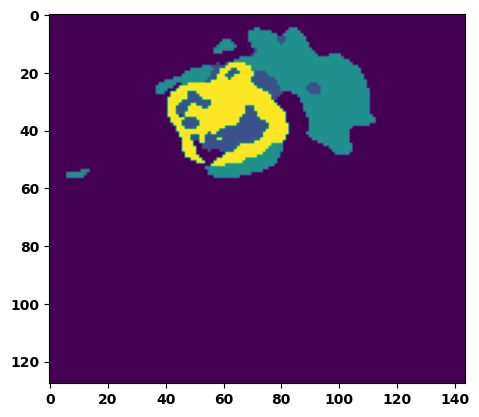

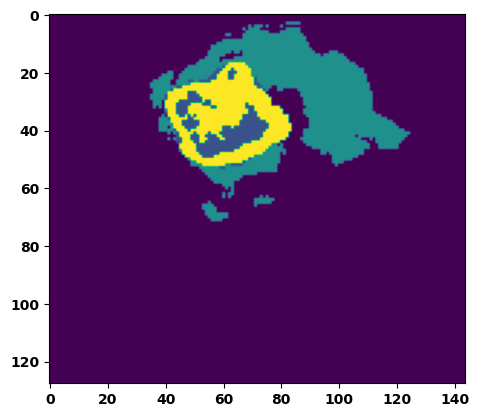

  6%|▌         | 2/36 [00:03<00:52,  1.55s/it]

Batch_id:  1 Eval loss:  0.06303282082080841
Batch_id:  1 Eval IoU:  tensor(0.8931, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.50s/it]

Batch_id:  2 Eval loss:  0.280362606048584
Batch_id:  2 Eval IoU:  tensor(0.5879, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9314, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9104, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9343, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9808, device='cuda:0')


 11%|█         | 4/36 [00:06<00:47,  1.48s/it]

Batch_id:  3 Eval loss:  0.10725969076156616
Batch_id:  3 Eval IoU:  tensor(0.8185, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9892, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:46,  1.50s/it]

Batch_id:  4 Eval loss:  0.3690972924232483
Batch_id:  4 Eval IoU:  tensor(0.5603, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:45,  1.50s/it]

Batch_id:  5 Eval loss:  0.102396160364151
Batch_id:  5 Eval IoU:  tensor(0.8303, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:43,  1.50s/it]

Batch_id:  6 Eval loss:  0.08520466089248657
Batch_id:  6 Eval IoU:  tensor(0.8571, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9895, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:41,  1.49s/it]

Batch_id:  7 Eval loss:  0.4111836552619934
Batch_id:  7 Eval IoU:  tensor(0.5267, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9041, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.8571, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.8565, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9988, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:39,  1.47s/it]

Batch_id:  8 Eval loss:  0.07803912460803986
Batch_id:  8 Eval IoU:  tensor(0.8672, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.47s/it]

Batch_id:  9 Eval loss:  0.1409372240304947
Batch_id:  9 Eval IoU:  tensor(0.7890, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9405, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9378, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  10 Eval loss:  0.2034825086593628
Batch_id:  10 Eval IoU:  tensor(0.6964, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')


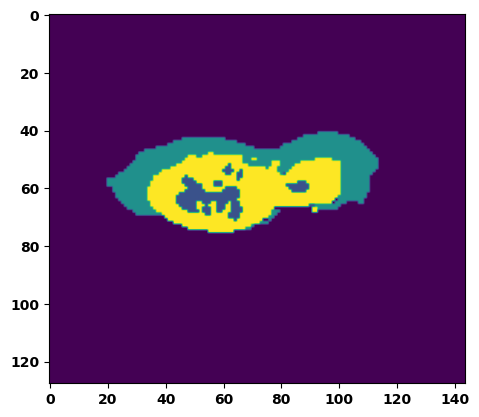

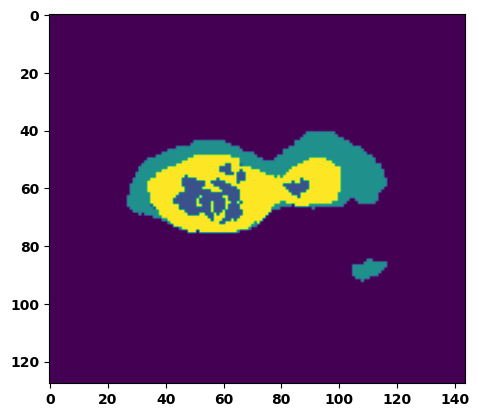

 33%|███▎      | 12/36 [00:18<00:36,  1.52s/it]

Batch_id:  11 Eval loss:  0.23429334163665771
Batch_id:  11 Eval IoU:  tensor(0.6722, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.49s/it]

Batch_id:  12 Eval loss:  0.23705622553825378
Batch_id:  12 Eval IoU:  tensor(0.6833, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9968, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:32,  1.49s/it]

Batch_id:  13 Eval loss:  0.3214564025402069
Batch_id:  13 Eval IoU:  tensor(0.6019, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9508, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9292, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9333, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:30,  1.47s/it]

Batch_id:  14 Eval loss:  0.15173161029815674
Batch_id:  14 Eval IoU:  tensor(0.7755, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.46s/it]

Batch_id:  15 Eval loss:  0.13874424993991852
Batch_id:  15 Eval IoU:  tensor(0.7731, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9865, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:28,  1.48s/it]

Batch_id:  16 Eval loss:  0.4012589454650879
Batch_id:  16 Eval IoU:  tensor(0.5339, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.48s/it]

Batch_id:  17 Eval loss:  0.7399160861968994
Batch_id:  17 Eval IoU:  tensor(0.2406, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9234, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9398, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9955, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:24,  1.43s/it]

Batch_id:  18 Eval loss:  0.09428423643112183
Batch_id:  18 Eval IoU:  tensor(0.8458, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:24,  1.52s/it]

Batch_id:  19 Eval loss:  0.19759519398212433
Batch_id:  19 Eval IoU:  tensor(0.7167, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  20 Eval loss:  0.07728207111358643
Batch_id:  20 Eval IoU:  tensor(0.8735, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9869, device='cuda:0')


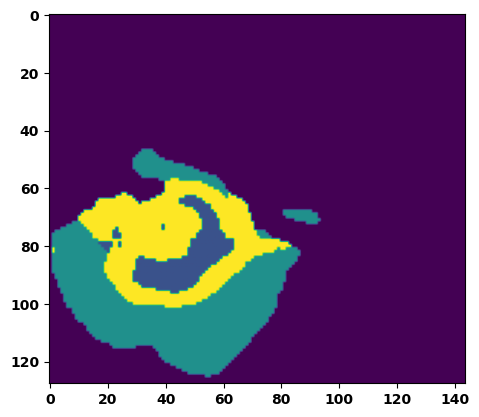

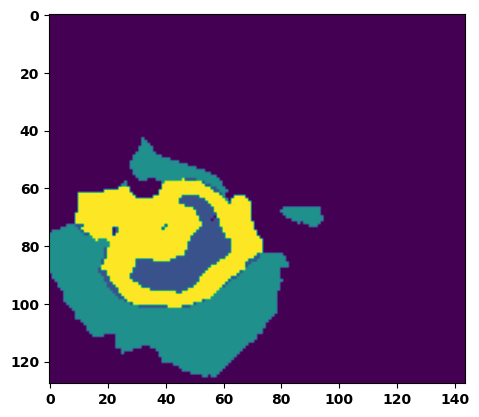

 61%|██████    | 22/36 [00:33<00:21,  1.52s/it]

Batch_id:  21 Eval loss:  0.2624186873435974
Batch_id:  21 Eval IoU:  tensor(0.6886, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9955, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.51s/it]

Batch_id:  22 Eval loss:  0.17950062453746796
Batch_id:  22 Eval IoU:  tensor(0.7297, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9889, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.48s/it]

Batch_id:  23 Eval loss:  0.08267797529697418
Batch_id:  23 Eval IoU:  tensor(0.8588, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9889, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:16,  1.50s/it]

Batch_id:  24 Eval loss:  0.38282275199890137
Batch_id:  24 Eval IoU:  tensor(0.5025, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9425, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9276, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9221, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 72%|███████▏  | 26/36 [00:39<00:15,  1.57s/it]

Batch_id:  25 Eval loss:  0.07707220315933228
Batch_id:  25 Eval IoU:  tensor(0.8859, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:14,  1.56s/it]

Batch_id:  26 Eval loss:  0.08051232993602753
Batch_id:  26 Eval IoU:  tensor(0.8888, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9980, device='cuda:0')


 78%|███████▊  | 28/36 [00:42<00:12,  1.55s/it]

Batch_id:  27 Eval loss:  0.17729578912258148
Batch_id:  27 Eval IoU:  tensor(0.7430, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:11,  1.58s/it]

Batch_id:  28 Eval loss:  0.21431858837604523
Batch_id:  28 Eval IoU:  tensor(0.6944, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9881, device='cuda:0')


 83%|████████▎ | 30/36 [00:45<00:09,  1.51s/it]

Batch_id:  29 Eval loss:  0.25238263607025146
Batch_id:  29 Eval IoU:  tensor(0.6459, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  30 Eval loss:  0.5258690118789673
Batch_id:  30 Eval IoU:  tensor(0.4063, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9982, device='cuda:0')


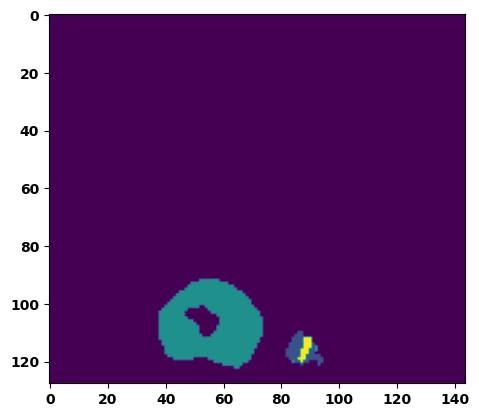

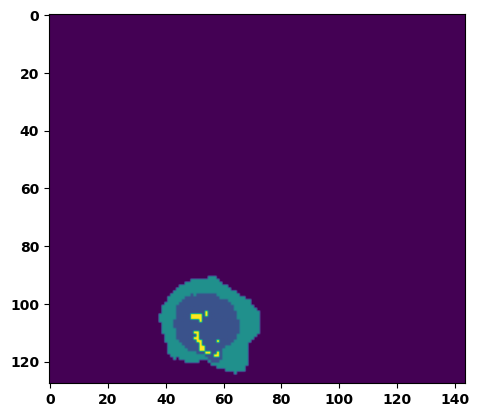

 89%|████████▉ | 32/36 [00:48<00:06,  1.56s/it]

Batch_id:  31 Eval loss:  0.5064133405685425
Batch_id:  31 Eval IoU:  tensor(0.4050, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9346, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9269, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9321, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


 92%|█████████▏| 33/36 [00:50<00:04,  1.56s/it]

Batch_id:  32 Eval loss:  0.2582457661628723
Batch_id:  32 Eval IoU:  tensor(0.6491, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9392, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 94%|█████████▍| 34/36 [00:51<00:03,  1.53s/it]

Batch_id:  33 Eval loss:  0.08938312530517578
Batch_id:  33 Eval IoU:  tensor(0.8522, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9965, device='cuda:0')


 97%|█████████▋| 35/36 [00:52<00:01,  1.49s/it]

Batch_id:  34 Eval loss:  0.14592823386192322
Batch_id:  34 Eval IoU:  tensor(0.7727, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


100%|██████████| 36/36 [00:54<00:00,  1.51s/it]

Batch_id:  35 Eval loss:  0.1409899890422821
Batch_id:  35 Eval IoU:  tensor(0.8127, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


Epoch  21 Training loss:  0.1905949272892692
Epoch  21 Evaluation loss:  0.22166857868433
Epoch  21 Training accuracy :  tensor(0.7359)
Epoch  21 Evaluation accuracy :  tensor(0.7061)
Epoch  21 Training Mean Dice Score:  tensor(0.9780)
Epoch  21 Eval Mean Dice Score:  tensor(0.9729)
Epoch  21 Training Non-tumor Dice Score:  tensor(0.9800)
Epoch  21 Eval Non-tumor Dice Score:  tensor(0.9707)
Epoch  21 Training NCR/NET Dice Score:  tensor(0.9892)
Epoch  21 Eval NCR/NET Dice Score:  tensor(0.9879)
Epoch  21 Training ED Dice Score:  tensor(0.9744)
Epoch  21 Eval ED Dice Score:  tensor(0.9680)
Epoch  21 Training ET Dice Score:  tensor(0.9905)
Epoch  21 Eval ET Dice Score:  tensor(0.9921)
Epoch completed and model successfully saved
Epoch: 22
Training in session: 


  1%|          | 1/110 [00:01<02:51,  1.57s/it]

Batch_id:  0 Training loss:  0.1642652302980423
Batch_id:  0 Training IoU:  tensor(0.7416, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9813, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:45,  1.53s/it]

Batch_id:  1 Training loss:  0.11191034317016602
Batch_id:  1 Training IoU:  tensor(0.8254, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:46,  1.55s/it]

Batch_id:  2 Training loss:  0.17601928114891052
Batch_id:  2 Training IoU:  tensor(0.7222, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:42,  1.53s/it]

Batch_id:  3 Training loss:  0.09355652332305908
Batch_id:  3 Training IoU:  tensor(0.8672, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:41,  1.54s/it]

Batch_id:  4 Training loss:  0.10406471788883209
Batch_id:  4 Training IoU:  tensor(0.8261, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:37,  1.52s/it]

Batch_id:  5 Training loss:  0.07517234981060028
Batch_id:  5 Training IoU:  tensor(0.8736, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:33,  1.49s/it]

Batch_id:  6 Training loss:  0.10122936964035034
Batch_id:  6 Training IoU:  tensor(0.8393, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:34,  1.51s/it]

Batch_id:  7 Training loss:  0.11846821010112762
Batch_id:  7 Training IoU:  tensor(0.8174, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:32,  1.51s/it]

Batch_id:  8 Training loss:  0.2563885450363159
Batch_id:  8 Training IoU:  tensor(0.6948, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:32,  1.52s/it]

Batch_id:  9 Training loss:  0.15641745924949646
Batch_id:  9 Training IoU:  tensor(0.7635, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 10%|█         | 11/110 [00:16<02:28,  1.50s/it]

Batch_id:  10 Training loss:  0.3309631943702698
Batch_id:  10 Training IoU:  tensor(0.6151, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 11%|█         | 12/110 [00:18<02:30,  1.54s/it]

Batch_id:  11 Training loss:  0.14948873221874237
Batch_id:  11 Training IoU:  tensor(0.7684, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:30,  1.55s/it]

Batch_id:  12 Training loss:  0.09216582775115967
Batch_id:  12 Training IoU:  tensor(0.8441, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:23,  1.49s/it]

Batch_id:  13 Training loss:  0.16656887531280518
Batch_id:  13 Training IoU:  tensor(0.7435, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:28,  1.56s/it]

Batch_id:  14 Training loss:  0.09361816942691803
Batch_id:  14 Training IoU:  tensor(0.8473, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:22,  1.51s/it]

Batch_id:  15 Training loss:  0.2626158893108368
Batch_id:  15 Training IoU:  tensor(0.6695, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:18,  1.49s/it]

Batch_id:  16 Training loss:  0.14753597974777222
Batch_id:  16 Training IoU:  tensor(0.7773, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:18,  1.50s/it]

Batch_id:  17 Training loss:  0.09623806178569794
Batch_id:  17 Training IoU:  tensor(0.8411, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:18,  1.52s/it]

Batch_id:  18 Training loss:  0.3937826454639435
Batch_id:  18 Training IoU:  tensor(0.5320, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:16,  1.52s/it]

Batch_id:  19 Training loss:  0.4482673108577728
Batch_id:  19 Training IoU:  tensor(0.4638, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9337, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9124, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:12,  1.49s/it]

Batch_id:  20 Training loss:  0.13403069972991943
Batch_id:  20 Training IoU:  tensor(0.8018, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 20%|██        | 22/110 [00:33<02:11,  1.50s/it]

Batch_id:  21 Training loss:  0.1368558406829834
Batch_id:  21 Training IoU:  tensor(0.7739, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9754, device='cuda:0')


 21%|██        | 23/110 [00:35<02:14,  1.55s/it]

Batch_id:  22 Training loss:  0.08209946751594543
Batch_id:  22 Training IoU:  tensor(0.8715, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:10,  1.52s/it]

Batch_id:  23 Training loss:  0.27022260427474976
Batch_id:  23 Training IoU:  tensor(0.6153, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 23%|██▎       | 25/110 [00:38<02:14,  1.58s/it]

Batch_id:  24 Training loss:  0.2183554768562317
Batch_id:  24 Training IoU:  tensor(0.7295, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:14,  1.60s/it]

Batch_id:  25 Training loss:  0.24079634249210358
Batch_id:  25 Training IoU:  tensor(0.7219, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 25%|██▍       | 27/110 [00:41<02:08,  1.55s/it]

Batch_id:  26 Training loss:  0.1443435698747635
Batch_id:  26 Training IoU:  tensor(0.8083, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 25%|██▌       | 28/110 [00:42<02:05,  1.53s/it]

Batch_id:  27 Training loss:  0.3593851327896118
Batch_id:  27 Training IoU:  tensor(0.5730, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9557, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9353, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 26%|██▋       | 29/110 [00:44<02:04,  1.54s/it]

Batch_id:  28 Training loss:  0.13312095403671265
Batch_id:  28 Training IoU:  tensor(0.8043, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 27%|██▋       | 30/110 [00:45<02:00,  1.51s/it]

Batch_id:  29 Training loss:  0.1807035356760025
Batch_id:  29 Training IoU:  tensor(0.7443, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 28%|██▊       | 31/110 [00:46<01:52,  1.43s/it]

Batch_id:  30 Training loss:  0.26120179891586304
Batch_id:  30 Training IoU:  tensor(0.6353, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 29%|██▉       | 32/110 [00:48<01:52,  1.44s/it]

Batch_id:  31 Training loss:  0.11097703874111176
Batch_id:  31 Training IoU:  tensor(0.8175, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 30%|███       | 33/110 [00:49<01:48,  1.40s/it]

Batch_id:  32 Training loss:  0.2810889482498169
Batch_id:  32 Training IoU:  tensor(0.6735, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 31%|███       | 34/110 [00:51<01:46,  1.40s/it]

Batch_id:  33 Training loss:  0.11736121773719788
Batch_id:  33 Training IoU:  tensor(0.8451, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:44,  1.40s/it]

Batch_id:  34 Training loss:  0.3334164619445801
Batch_id:  34 Training IoU:  tensor(0.5665, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:40,  1.36s/it]

Batch_id:  35 Training loss:  0.05512441694736481
Batch_id:  35 Training IoU:  tensor(0.9116, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 34%|███▎      | 37/110 [00:55<01:39,  1.36s/it]

Batch_id:  36 Training loss:  0.17102447152137756
Batch_id:  36 Training IoU:  tensor(0.7823, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:42,  1.42s/it]

Batch_id:  37 Training loss:  0.29517650604248047
Batch_id:  37 Training IoU:  tensor(0.6163, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 35%|███▌      | 39/110 [00:58<01:41,  1.43s/it]

Batch_id:  38 Training loss:  0.06534068286418915
Batch_id:  38 Training IoU:  tensor(0.8911, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 36%|███▋      | 40/110 [00:59<01:39,  1.43s/it]

Batch_id:  39 Training loss:  0.06787450611591339
Batch_id:  39 Training IoU:  tensor(0.8882, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:40,  1.45s/it]

Batch_id:  40 Training loss:  0.2793760299682617
Batch_id:  40 Training IoU:  tensor(0.6230, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9561, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:36,  1.42s/it]

Batch_id:  41 Training loss:  0.13157084584236145
Batch_id:  41 Training IoU:  tensor(0.7875, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 39%|███▉      | 43/110 [01:03<01:35,  1.42s/it]

Batch_id:  42 Training loss:  0.15920735895633698
Batch_id:  42 Training IoU:  tensor(0.7853, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 40%|████      | 44/110 [01:05<01:34,  1.44s/it]

Batch_id:  43 Training loss:  0.09996300935745239
Batch_id:  43 Training IoU:  tensor(0.8365, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 41%|████      | 45/110 [01:06<01:33,  1.44s/it]

Batch_id:  44 Training loss:  0.1397896409034729
Batch_id:  44 Training IoU:  tensor(0.7963, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:32,  1.45s/it]

Batch_id:  45 Training loss:  0.11787992715835571
Batch_id:  45 Training IoU:  tensor(0.8039, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:31,  1.45s/it]

Batch_id:  46 Training loss:  0.12082402408123016
Batch_id:  46 Training IoU:  tensor(0.7994, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:28,  1.44s/it]

Batch_id:  47 Training loss:  0.2659493088722229
Batch_id:  47 Training IoU:  tensor(0.6176, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9323, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9281, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9742, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:27,  1.43s/it]

Batch_id:  48 Training loss:  0.22149579226970673
Batch_id:  48 Training IoU:  tensor(0.6830, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:24,  1.42s/it]

Batch_id:  49 Training loss:  0.13562417030334473
Batch_id:  49 Training IoU:  tensor(0.7907, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 46%|████▋     | 51/110 [01:15<01:28,  1.50s/it]

Batch_id:  50 Training loss:  0.22062085568904877
Batch_id:  50 Training IoU:  tensor(0.6739, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:24,  1.45s/it]

Batch_id:  51 Training loss:  0.12007693946361542
Batch_id:  51 Training IoU:  tensor(0.8132, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 48%|████▊     | 53/110 [01:18<01:23,  1.47s/it]

Batch_id:  52 Training loss:  0.08840851485729218
Batch_id:  52 Training IoU:  tensor(0.8500, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:21,  1.45s/it]

Batch_id:  53 Training loss:  0.08435460925102234
Batch_id:  53 Training IoU:  tensor(0.8557, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:20,  1.46s/it]

Batch_id:  54 Training loss:  0.23240281641483307
Batch_id:  54 Training IoU:  tensor(0.6533, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9355, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9345, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9235, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9658, device='cuda:0')


 51%|█████     | 56/110 [01:22<01:18,  1.45s/it]

Batch_id:  55 Training loss:  0.5367987155914307
Batch_id:  55 Training IoU:  tensor(0.4089, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 52%|█████▏    | 57/110 [01:24<01:14,  1.41s/it]

Batch_id:  56 Training loss:  0.1002797931432724
Batch_id:  56 Training IoU:  tensor(0.8343, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 53%|█████▎    | 58/110 [01:25<01:13,  1.42s/it]

Batch_id:  57 Training loss:  0.27717918157577515
Batch_id:  57 Training IoU:  tensor(0.6027, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9767, device='cuda:0')


 54%|█████▎    | 59/110 [01:26<01:12,  1.42s/it]

Batch_id:  58 Training loss:  0.16715246438980103
Batch_id:  58 Training IoU:  tensor(0.7388, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9712, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:10,  1.41s/it]

Batch_id:  59 Training loss:  0.28851133584976196
Batch_id:  59 Training IoU:  tensor(0.6668, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 55%|█████▌    | 61/110 [01:29<01:10,  1.43s/it]

Batch_id:  60 Training loss:  0.2609744071960449
Batch_id:  60 Training IoU:  tensor(0.6713, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:08,  1.43s/it]

Batch_id:  61 Training loss:  0.1678173989057541
Batch_id:  61 Training IoU:  tensor(0.7394, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9797, device='cuda:0')


 57%|█████▋    | 63/110 [01:32<01:08,  1.45s/it]

Batch_id:  62 Training loss:  0.13651445508003235
Batch_id:  62 Training IoU:  tensor(0.7788, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:06,  1.44s/it]

Batch_id:  63 Training loss:  0.21562092006206512
Batch_id:  63 Training IoU:  tensor(0.6820, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 59%|█████▉    | 65/110 [01:35<01:04,  1.42s/it]

Batch_id:  64 Training loss:  0.2000178098678589
Batch_id:  64 Training IoU:  tensor(0.7076, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:03,  1.45s/it]

Batch_id:  65 Training loss:  0.24040642380714417
Batch_id:  65 Training IoU:  tensor(0.6418, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9304, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9285, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9097, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9843, device='cuda:0')


 61%|██████    | 67/110 [01:38<01:01,  1.43s/it]

Batch_id:  66 Training loss:  0.164784237742424
Batch_id:  66 Training IoU:  tensor(0.7644, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 62%|██████▏   | 68/110 [01:40<01:01,  1.46s/it]

Batch_id:  67 Training loss:  0.23862092196941376
Batch_id:  67 Training IoU:  tensor(0.6945, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 63%|██████▎   | 69/110 [01:41<01:01,  1.49s/it]

Batch_id:  68 Training loss:  0.12437015771865845
Batch_id:  68 Training IoU:  tensor(0.7994, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9749, device='cuda:0')


 64%|██████▎   | 70/110 [01:42<00:58,  1.45s/it]

Batch_id:  69 Training loss:  0.16534405946731567
Batch_id:  69 Training IoU:  tensor(0.7393, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 65%|██████▍   | 71/110 [01:44<00:57,  1.47s/it]

Batch_id:  70 Training loss:  0.19991251826286316
Batch_id:  70 Training IoU:  tensor(0.6994, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 65%|██████▌   | 72/110 [01:45<00:56,  1.49s/it]

Batch_id:  71 Training loss:  0.09932617843151093
Batch_id:  71 Training IoU:  tensor(0.8305, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:54,  1.46s/it]

Batch_id:  72 Training loss:  0.06124076247215271
Batch_id:  72 Training IoU:  tensor(0.9015, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:51,  1.43s/it]

Batch_id:  73 Training loss:  0.15828588604927063
Batch_id:  73 Training IoU:  tensor(0.7467, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 68%|██████▊   | 75/110 [01:50<00:50,  1.44s/it]

Batch_id:  74 Training loss:  0.2708852291107178
Batch_id:  74 Training IoU:  tensor(0.6654, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 69%|██████▉   | 76/110 [01:51<00:48,  1.43s/it]

Batch_id:  75 Training loss:  0.4310590624809265
Batch_id:  75 Training IoU:  tensor(0.5078, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 70%|███████   | 77/110 [01:52<00:46,  1.41s/it]

Batch_id:  76 Training loss:  0.15761850774288177
Batch_id:  76 Training IoU:  tensor(0.7522, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:45,  1.43s/it]

Batch_id:  77 Training loss:  0.18667127192020416
Batch_id:  77 Training IoU:  tensor(0.7201, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 72%|███████▏  | 79/110 [01:55<00:43,  1.42s/it]

Batch_id:  78 Training loss:  0.2812553644180298
Batch_id:  78 Training IoU:  tensor(0.6217, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:42,  1.42s/it]

Batch_id:  79 Training loss:  0.09762082993984222
Batch_id:  79 Training IoU:  tensor(0.8384, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 74%|███████▎  | 81/110 [01:58<00:41,  1.42s/it]

Batch_id:  80 Training loss:  0.15305769443511963
Batch_id:  80 Training IoU:  tensor(0.7857, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:39,  1.43s/it]

Batch_id:  81 Training loss:  0.17067062854766846
Batch_id:  81 Training IoU:  tensor(0.7263, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:38,  1.44s/it]

Batch_id:  82 Training loss:  0.1419105976819992
Batch_id:  82 Training IoU:  tensor(0.7688, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:37,  1.45s/it]

Batch_id:  83 Training loss:  0.17073875665664673
Batch_id:  83 Training IoU:  tensor(0.7516, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:36,  1.46s/it]

Batch_id:  84 Training loss:  0.09517204761505127
Batch_id:  84 Training IoU:  tensor(0.8476, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:35,  1.46s/it]

Batch_id:  85 Training loss:  0.2162768691778183
Batch_id:  85 Training IoU:  tensor(0.6848, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:34,  1.49s/it]

Batch_id:  86 Training loss:  0.10954801738262177
Batch_id:  86 Training IoU:  tensor(0.8204, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 80%|████████  | 88/110 [02:09<00:32,  1.50s/it]

Batch_id:  87 Training loss:  0.3109431266784668
Batch_id:  87 Training IoU:  tensor(0.6329, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:31,  1.50s/it]

Batch_id:  88 Training loss:  0.09147769212722778
Batch_id:  88 Training IoU:  tensor(0.8465, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:28,  1.43s/it]

Batch_id:  89 Training loss:  0.05431646108627319
Batch_id:  89 Training IoU:  tensor(0.9095, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:26,  1.39s/it]

Batch_id:  90 Training loss:  0.5023657083511353
Batch_id:  90 Training IoU:  tensor(0.4293, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:26,  1.45s/it]

Batch_id:  91 Training loss:  0.1622740477323532
Batch_id:  91 Training IoU:  tensor(0.7711, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:24,  1.46s/it]

Batch_id:  92 Training loss:  0.04569709300994873
Batch_id:  92 Training IoU:  tensor(0.9232, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:22,  1.44s/it]

Batch_id:  93 Training loss:  0.3006298542022705
Batch_id:  93 Training IoU:  tensor(0.5912, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9187, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:21,  1.45s/it]

Batch_id:  94 Training loss:  0.21381404995918274
Batch_id:  94 Training IoU:  tensor(0.7480, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:19,  1.41s/it]

Batch_id:  95 Training loss:  0.13262899219989777
Batch_id:  95 Training IoU:  tensor(0.7879, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:18,  1.43s/it]

Batch_id:  96 Training loss:  0.38194739818573
Batch_id:  96 Training IoU:  tensor(0.6070, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9997, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:17,  1.42s/it]

Batch_id:  97 Training loss:  0.14498378336429596
Batch_id:  97 Training IoU:  tensor(0.7865, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 90%|█████████ | 99/110 [02:24<00:16,  1.46s/it]

Batch_id:  98 Training loss:  0.11150246858596802
Batch_id:  98 Training IoU:  tensor(0.8208, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:14,  1.43s/it]

Batch_id:  99 Training loss:  0.13734737038612366
Batch_id:  99 Training IoU:  tensor(0.7849, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 92%|█████████▏| 101/110 [02:27<00:12,  1.44s/it]

Batch_id:  100 Training loss:  0.22706595063209534
Batch_id:  100 Training IoU:  tensor(0.6553, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:11,  1.43s/it]

Batch_id:  101 Training loss:  0.31244421005249023
Batch_id:  101 Training IoU:  tensor(0.5803, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9372, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9742, device='cuda:0')


 94%|█████████▎| 103/110 [02:30<00:10,  1.48s/it]

Batch_id:  102 Training loss:  0.3942546248435974
Batch_id:  102 Training IoU:  tensor(0.5342, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:08,  1.46s/it]

Batch_id:  103 Training loss:  0.18885327875614166
Batch_id:  103 Training IoU:  tensor(0.7225, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 95%|█████████▌| 105/110 [02:33<00:07,  1.47s/it]

Batch_id:  104 Training loss:  0.19533994793891907
Batch_id:  104 Training IoU:  tensor(0.7213, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:06,  1.56s/it]

Batch_id:  105 Training loss:  0.2115435004234314
Batch_id:  105 Training IoU:  tensor(0.6864, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 97%|█████████▋| 107/110 [02:36<00:04,  1.49s/it]

Batch_id:  106 Training loss:  0.09471200406551361
Batch_id:  106 Training IoU:  tensor(0.8416, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:02,  1.48s/it]

Batch_id:  107 Training loss:  0.13085919618606567
Batch_id:  107 Training IoU:  tensor(0.8037, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 99%|█████████▉| 109/110 [02:39<00:01,  1.47s/it]

Batch_id:  108 Training loss:  0.06578496098518372
Batch_id:  108 Training IoU:  tensor(0.8944, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.047137752175331116
Batch_id:  109 Training IoU:  tensor(0.9208, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9969, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.14303354918956757
Batch_id:  0 Eval IoU:  tensor(0.7870, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


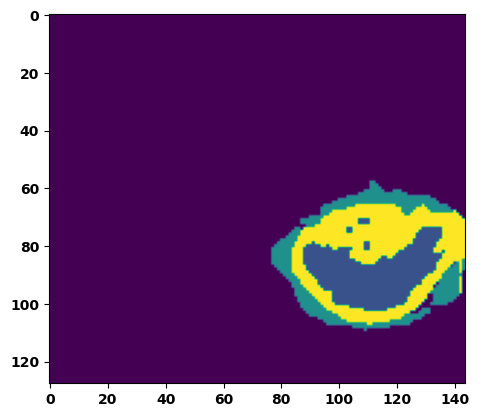

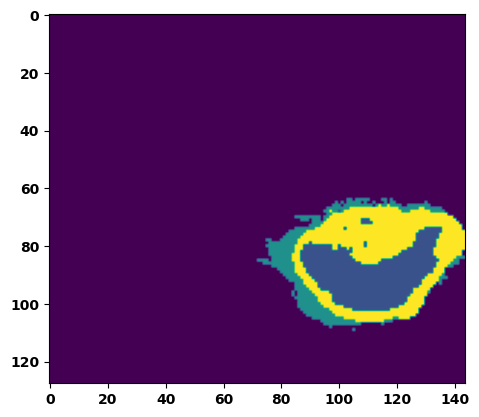

  6%|▌         | 2/36 [00:03<00:51,  1.50s/it]

Batch_id:  1 Eval loss:  0.07499705255031586
Batch_id:  1 Eval IoU:  tensor(0.8714, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:51,  1.56s/it]

Batch_id:  2 Eval loss:  0.5859511494636536
Batch_id:  2 Eval IoU:  tensor(0.3607, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 11%|█         | 4/36 [00:06<00:48,  1.50s/it]

Batch_id:  3 Eval loss:  0.08050885796546936
Batch_id:  3 Eval IoU:  tensor(0.8689, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9863, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:46,  1.49s/it]

Batch_id:  4 Eval loss:  0.09663306176662445
Batch_id:  4 Eval IoU:  tensor(0.8408, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9964, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:43,  1.46s/it]

Batch_id:  5 Eval loss:  0.1480121612548828
Batch_id:  5 Eval IoU:  tensor(0.7706, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:41,  1.42s/it]

Batch_id:  6 Eval loss:  0.22011782228946686
Batch_id:  6 Eval IoU:  tensor(0.6626, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9417, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9814, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.44s/it]

Batch_id:  7 Eval loss:  0.061928778886795044
Batch_id:  7 Eval IoU:  tensor(0.8958, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:40,  1.51s/it]

Batch_id:  8 Eval loss:  0.22578664124011993
Batch_id:  8 Eval IoU:  tensor(0.6808, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9881, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.48s/it]

Batch_id:  9 Eval loss:  0.3821462392807007
Batch_id:  9 Eval IoU:  tensor(0.5434, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  10 Eval loss:  0.21773448586463928
Batch_id:  10 Eval IoU:  tensor(0.6921, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9928, device='cuda:0')


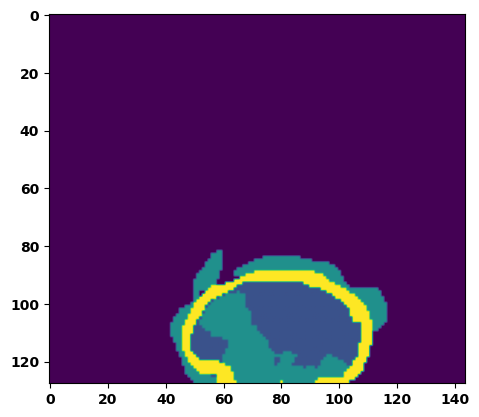

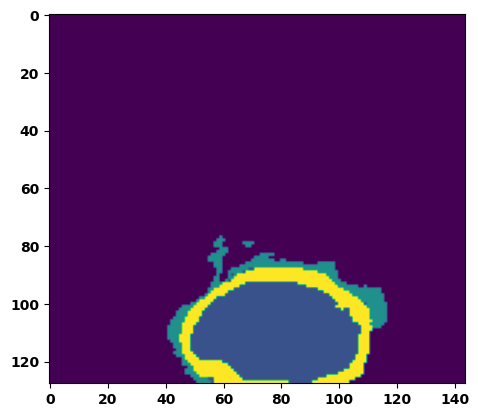

 33%|███▎      | 12/36 [00:18<00:37,  1.55s/it]

Batch_id:  11 Eval loss:  0.18984928727149963
Batch_id:  11 Eval IoU:  tensor(0.7239, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9888, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.48s/it]

Batch_id:  12 Eval loss:  0.09221124649047852
Batch_id:  12 Eval IoU:  tensor(0.8489, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:34,  1.55s/it]

Batch_id:  13 Eval loss:  0.20008154213428497
Batch_id:  13 Eval IoU:  tensor(0.6990, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9863, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:32,  1.53s/it]

Batch_id:  14 Eval loss:  0.12332947552204132
Batch_id:  14 Eval IoU:  tensor(0.7976, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9895, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:30,  1.54s/it]

Batch_id:  15 Eval loss:  0.3773075342178345
Batch_id:  15 Eval IoU:  tensor(0.5072, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9434, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9288, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9231, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:27,  1.47s/it]

Batch_id:  16 Eval loss:  0.08140067756175995
Batch_id:  16 Eval IoU:  tensor(0.8878, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:25,  1.44s/it]

Batch_id:  17 Eval loss:  0.08122819662094116
Batch_id:  17 Eval IoU:  tensor(0.8639, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:24,  1.47s/it]

Batch_id:  18 Eval loss:  0.4160580039024353
Batch_id:  18 Eval IoU:  tensor(0.5088, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9970, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.45s/it]

Batch_id:  19 Eval loss:  0.17137865722179413
Batch_id:  19 Eval IoU:  tensor(0.7436, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  20 Eval loss:  0.2005946785211563
Batch_id:  20 Eval IoU:  tensor(0.7131, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


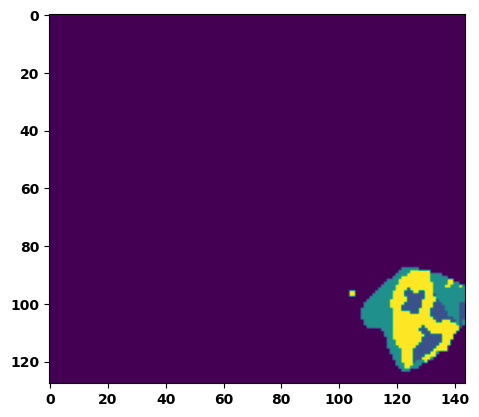

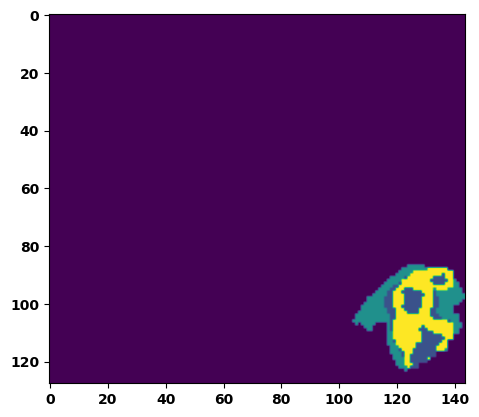

 61%|██████    | 22/36 [00:32<00:20,  1.50s/it]

Batch_id:  21 Eval loss:  0.7383597493171692
Batch_id:  21 Eval IoU:  tensor(0.2408, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9213, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.48s/it]

Batch_id:  22 Eval loss:  0.10875999927520752
Batch_id:  22 Eval IoU:  tensor(0.8196, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9909, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.45s/it]

Batch_id:  23 Eval loss:  0.22185543179512024
Batch_id:  23 Eval IoU:  tensor(0.6939, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:15,  1.45s/it]

Batch_id:  24 Eval loss:  0.23488843441009521
Batch_id:  24 Eval IoU:  tensor(0.6866, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9968, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.49s/it]

Batch_id:  25 Eval loss:  0.2589409351348877
Batch_id:  25 Eval IoU:  tensor(0.6480, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9455, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9918, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:13,  1.46s/it]

Batch_id:  26 Eval loss:  0.06845781207084656
Batch_id:  26 Eval IoU:  tensor(0.8992, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.42s/it]

Batch_id:  27 Eval loss:  0.10760486125946045
Batch_id:  27 Eval IoU:  tensor(0.8189, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:10,  1.46s/it]

Batch_id:  28 Eval loss:  0.4121134877204895
Batch_id:  28 Eval IoU:  tensor(0.5249, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9039, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.8570, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.8562, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.43s/it]

Batch_id:  29 Eval loss:  0.13559478521347046
Batch_id:  29 Eval IoU:  tensor(0.7948, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  30 Eval loss:  0.2653379440307617
Batch_id:  30 Eval IoU:  tensor(0.6852, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


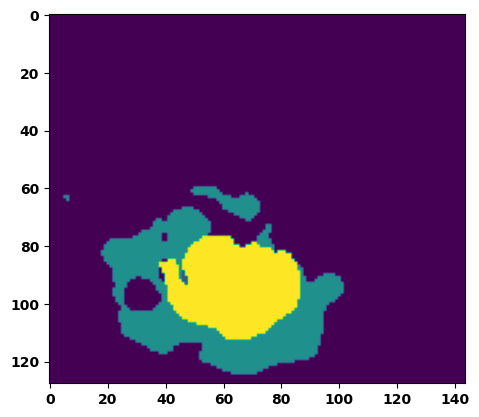

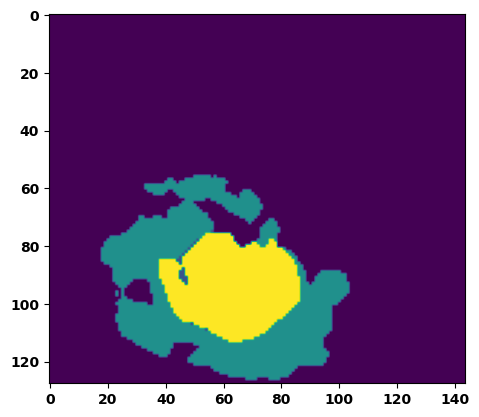

 89%|████████▉ | 32/36 [00:47<00:05,  1.47s/it]

Batch_id:  31 Eval loss:  0.1296466886997223
Batch_id:  31 Eval IoU:  tensor(0.8328, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.43s/it]

Batch_id:  32 Eval loss:  0.18541496992111206
Batch_id:  32 Eval IoU:  tensor(0.7241, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9887, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:02,  1.42s/it]

Batch_id:  33 Eval loss:  0.22855181992053986
Batch_id:  33 Eval IoU:  tensor(0.6764, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9795, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.42s/it]

Batch_id:  34 Eval loss:  0.08247765898704529
Batch_id:  34 Eval IoU:  tensor(0.8596, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.47s/it]

Batch_id:  35 Eval loss:  0.4260912537574768
Batch_id:  35 Eval IoU:  tensor(0.4622, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9382, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9385, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')
Epoch  22 Training loss:  0.1850758746266365
Epoch  22 Evaluation loss:  0.2159551369647185
Epoch  22 Training accuracy :  tensor(0.7423)
Epoch  22 Evaluation accuracy :  tensor(0.7121)
Epoch  22 Training Mean Dice Score:  tensor(0.9788)
Epoch  22 Eval Mean Dice Score:  tensor(0.9739)
Epoch  22 Training Non-tumor Dice Score:  tensor(0.9806)
Epoch  22 Eval Non-tumor Dice Score:  tensor(0.9727)
Epoch  22 Training NCR/NET Dice Score:  tensor(0.9896)
Epoch  22 Eval NCR/NET Dice Score:  tensor(0.9879)
Epoch  22 Training ED Dice Score:  tensor(0.975

Best Model saved!
Epoch: 23
Training in session: 


  1%|          | 1/110 [00:01<02:37,  1.44s/it]

Batch_id:  0 Training loss:  0.25129979848861694
Batch_id:  0 Training IoU:  tensor(0.6512, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:31,  1.40s/it]

Batch_id:  1 Training loss:  0.18652665615081787
Batch_id:  1 Training IoU:  tensor(0.7040, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9522, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9808, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:34,  1.44s/it]

Batch_id:  2 Training loss:  0.07545021176338196
Batch_id:  2 Training IoU:  tensor(0.8760, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:34,  1.46s/it]

Batch_id:  3 Training loss:  0.11501847207546234
Batch_id:  3 Training IoU:  tensor(0.8144, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9774, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:35,  1.48s/it]

Batch_id:  4 Training loss:  0.13349467515945435
Batch_id:  4 Training IoU:  tensor(0.8021, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:30,  1.45s/it]

Batch_id:  5 Training loss:  0.2609559893608093
Batch_id:  5 Training IoU:  tensor(0.6721, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:31,  1.47s/it]

Batch_id:  6 Training loss:  0.19852414727210999
Batch_id:  6 Training IoU:  tensor(0.7026, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:29,  1.47s/it]

Batch_id:  7 Training loss:  0.10125941038131714
Batch_id:  7 Training IoU:  tensor(0.8394, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:24,  1.43s/it]

Batch_id:  8 Training loss:  0.08013737201690674
Batch_id:  8 Training IoU:  tensor(0.8630, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:26,  1.46s/it]

Batch_id:  9 Training loss:  0.25787094235420227
Batch_id:  9 Training IoU:  tensor(0.6377, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 10%|█         | 11/110 [00:16<02:24,  1.46s/it]

Batch_id:  10 Training loss:  0.1947828233242035
Batch_id:  10 Training IoU:  tensor(0.7138, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9818, device='cuda:0')


 11%|█         | 12/110 [00:17<02:19,  1.43s/it]

Batch_id:  11 Training loss:  0.29002296924591064
Batch_id:  11 Training IoU:  tensor(0.6021, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9231, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:23,  1.48s/it]

Batch_id:  12 Training loss:  0.3205195665359497
Batch_id:  12 Training IoU:  tensor(0.6215, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9540, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:21,  1.48s/it]

Batch_id:  13 Training loss:  0.16181625425815582
Batch_id:  13 Training IoU:  tensor(0.7835, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:21,  1.49s/it]

Batch_id:  14 Training loss:  0.10766573250293732
Batch_id:  14 Training IoU:  tensor(0.8620, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:26,  1.56s/it]

Batch_id:  15 Training loss:  0.24055762588977814
Batch_id:  15 Training IoU:  tensor(0.7093, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:21,  1.52s/it]

Batch_id:  16 Training loss:  0.44319844245910645
Batch_id:  16 Training IoU:  tensor(0.4817, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:15,  1.47s/it]

Batch_id:  17 Training loss:  0.33791595697402954
Batch_id:  17 Training IoU:  tensor(0.5569, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9793, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:16,  1.50s/it]

Batch_id:  18 Training loss:  0.0468171089887619
Batch_id:  18 Training IoU:  tensor(0.9210, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:15,  1.51s/it]

Batch_id:  19 Training loss:  0.1297944188117981
Batch_id:  19 Training IoU:  tensor(0.8119, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:14,  1.51s/it]

Batch_id:  20 Training loss:  0.15814904868602753
Batch_id:  20 Training IoU:  tensor(0.7634, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 20%|██        | 22/110 [00:32<02:14,  1.53s/it]

Batch_id:  21 Training loss:  0.10335679352283478
Batch_id:  21 Training IoU:  tensor(0.8275, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 21%|██        | 23/110 [00:34<02:13,  1.53s/it]

Batch_id:  22 Training loss:  0.19936341047286987
Batch_id:  22 Training IoU:  tensor(0.6982, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:10,  1.51s/it]

Batch_id:  23 Training loss:  0.242241770029068
Batch_id:  23 Training IoU:  tensor(0.6925, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:05,  1.48s/it]

Batch_id:  24 Training loss:  0.2687048614025116
Batch_id:  24 Training IoU:  tensor(0.6203, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9382, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:02,  1.46s/it]

Batch_id:  25 Training loss:  0.1286776214838028
Batch_id:  25 Training IoU:  tensor(0.8070, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:02,  1.47s/it]

Batch_id:  26 Training loss:  0.10149230062961578
Batch_id:  26 Training IoU:  tensor(0.8290, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 25%|██▌       | 28/110 [00:41<02:04,  1.52s/it]

Batch_id:  27 Training loss:  0.21122507750988007
Batch_id:  27 Training IoU:  tensor(0.6740, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 26%|██▋       | 29/110 [00:43<02:05,  1.55s/it]

Batch_id:  28 Training loss:  0.19554376602172852
Batch_id:  28 Training IoU:  tensor(0.7250, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 27%|██▋       | 30/110 [00:44<02:07,  1.59s/it]

Batch_id:  29 Training loss:  0.2798214554786682
Batch_id:  29 Training IoU:  tensor(0.6212, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9548, device='cuda:0')


 28%|██▊       | 31/110 [00:46<02:06,  1.60s/it]

Batch_id:  30 Training loss:  0.0853157639503479
Batch_id:  30 Training IoU:  tensor(0.8610, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 29%|██▉       | 32/110 [00:48<02:03,  1.58s/it]

Batch_id:  31 Training loss:  0.10061542689800262
Batch_id:  31 Training IoU:  tensor(0.8370, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 30%|███       | 33/110 [00:49<02:03,  1.60s/it]

Batch_id:  32 Training loss:  0.04606930911540985
Batch_id:  32 Training IoU:  tensor(0.9250, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 31%|███       | 34/110 [00:51<02:00,  1.59s/it]

Batch_id:  33 Training loss:  0.2078181356191635
Batch_id:  33 Training IoU:  tensor(0.6874, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9342, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9710, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:57,  1.56s/it]

Batch_id:  34 Training loss:  0.08699792623519897
Batch_id:  34 Training IoU:  tensor(0.8744, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:55,  1.56s/it]

Batch_id:  35 Training loss:  0.27919280529022217
Batch_id:  35 Training IoU:  tensor(0.6035, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9687, device='cuda:0')


 34%|███▎      | 37/110 [00:55<01:51,  1.52s/it]

Batch_id:  36 Training loss:  0.24241404235363007
Batch_id:  36 Training IoU:  tensor(0.7190, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 35%|███▍      | 38/110 [00:57<01:46,  1.48s/it]

Batch_id:  37 Training loss:  0.057944923639297485
Batch_id:  37 Training IoU:  tensor(0.9068, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 35%|███▌      | 39/110 [00:58<01:47,  1.51s/it]

Batch_id:  38 Training loss:  0.16591741144657135
Batch_id:  38 Training IoU:  tensor(0.7649, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 36%|███▋      | 40/110 [01:00<01:44,  1.50s/it]

Batch_id:  39 Training loss:  0.26189276576042175
Batch_id:  39 Training IoU:  tensor(0.6237, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9325, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9276, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9750, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:44,  1.52s/it]

Batch_id:  40 Training loss:  0.10846669971942902
Batch_id:  40 Training IoU:  tensor(0.8229, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 38%|███▊      | 42/110 [01:03<01:43,  1.53s/it]

Batch_id:  41 Training loss:  0.1439042091369629
Batch_id:  41 Training IoU:  tensor(0.7739, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:42,  1.52s/it]

Batch_id:  42 Training loss:  0.13999755680561066
Batch_id:  42 Training IoU:  tensor(0.7838, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 40%|████      | 44/110 [01:06<01:42,  1.55s/it]

Batch_id:  43 Training loss:  0.48135411739349365
Batch_id:  43 Training IoU:  tensor(0.4477, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 41%|████      | 45/110 [01:07<01:40,  1.54s/it]

Batch_id:  44 Training loss:  0.06244306266307831
Batch_id:  44 Training IoU:  tensor(0.8955, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 42%|████▏     | 46/110 [01:09<01:35,  1.49s/it]

Batch_id:  45 Training loss:  0.31850874423980713
Batch_id:  45 Training IoU:  tensor(0.6312, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 43%|████▎     | 47/110 [01:10<01:35,  1.52s/it]

Batch_id:  46 Training loss:  0.2391413450241089
Batch_id:  46 Training IoU:  tensor(0.6953, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 44%|████▎     | 48/110 [01:12<01:31,  1.48s/it]

Batch_id:  47 Training loss:  0.5181765556335449
Batch_id:  47 Training IoU:  tensor(0.3975, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9235, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9083, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.8860, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 45%|████▍     | 49/110 [01:13<01:27,  1.43s/it]

Batch_id:  48 Training loss:  0.11396688222885132
Batch_id:  48 Training IoU:  tensor(0.8174, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 45%|████▌     | 50/110 [01:15<01:26,  1.44s/it]

Batch_id:  49 Training loss:  0.10485382378101349
Batch_id:  49 Training IoU:  tensor(0.8288, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9795, device='cuda:0')


 46%|████▋     | 51/110 [01:16<01:26,  1.47s/it]

Batch_id:  50 Training loss:  0.10269944369792938
Batch_id:  50 Training IoU:  tensor(0.8287, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 47%|████▋     | 52/110 [01:17<01:23,  1.44s/it]

Batch_id:  51 Training loss:  0.12599046528339386
Batch_id:  51 Training IoU:  tensor(0.7992, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 48%|████▊     | 53/110 [01:19<01:22,  1.45s/it]

Batch_id:  52 Training loss:  0.5481750965118408
Batch_id:  52 Training IoU:  tensor(0.3873, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 49%|████▉     | 54/110 [01:20<01:21,  1.45s/it]

Batch_id:  53 Training loss:  0.3635062277317047
Batch_id:  53 Training IoU:  tensor(0.6145, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 50%|█████     | 55/110 [01:22<01:19,  1.44s/it]

Batch_id:  54 Training loss:  0.12655630707740784
Batch_id:  54 Training IoU:  tensor(0.7941, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 51%|█████     | 56/110 [01:23<01:18,  1.45s/it]

Batch_id:  55 Training loss:  0.2034531682729721
Batch_id:  55 Training IoU:  tensor(0.6903, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 52%|█████▏    | 57/110 [01:25<01:16,  1.44s/it]

Batch_id:  56 Training loss:  0.1277914047241211
Batch_id:  56 Training IoU:  tensor(0.7995, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 53%|█████▎    | 58/110 [01:26<01:14,  1.43s/it]

Batch_id:  57 Training loss:  0.11069993674755096
Batch_id:  57 Training IoU:  tensor(0.8183, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 54%|█████▎    | 59/110 [01:28<01:12,  1.42s/it]

Batch_id:  58 Training loss:  0.09763416647911072
Batch_id:  58 Training IoU:  tensor(0.8373, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 55%|█████▍    | 60/110 [01:29<01:12,  1.44s/it]

Batch_id:  59 Training loss:  0.26799196004867554
Batch_id:  59 Training IoU:  tensor(0.6293, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 55%|█████▌    | 61/110 [01:30<01:10,  1.45s/it]

Batch_id:  60 Training loss:  0.14262272417545319
Batch_id:  60 Training IoU:  tensor(0.7677, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 56%|█████▋    | 62/110 [01:32<01:08,  1.42s/it]

Batch_id:  61 Training loss:  0.2432268261909485
Batch_id:  61 Training IoU:  tensor(0.7212, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 57%|█████▋    | 63/110 [01:33<01:05,  1.40s/it]

Batch_id:  62 Training loss:  0.08739134669303894
Batch_id:  62 Training IoU:  tensor(0.8519, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 58%|█████▊    | 64/110 [01:35<01:04,  1.41s/it]

Batch_id:  63 Training loss:  0.21244126558303833
Batch_id:  63 Training IoU:  tensor(0.6847, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 59%|█████▉    | 65/110 [01:36<01:03,  1.40s/it]

Batch_id:  64 Training loss:  0.39075422286987305
Batch_id:  64 Training IoU:  tensor(0.5382, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:00,  1.37s/it]

Batch_id:  65 Training loss:  0.4144333302974701
Batch_id:  65 Training IoU:  tensor(0.5307, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 61%|██████    | 67/110 [01:39<01:02,  1.45s/it]

Batch_id:  66 Training loss:  0.16243284940719604
Batch_id:  66 Training IoU:  tensor(0.7448, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 62%|██████▏   | 68/110 [01:41<01:02,  1.48s/it]

Batch_id:  67 Training loss:  0.10797297954559326
Batch_id:  67 Training IoU:  tensor(0.8168, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 63%|██████▎   | 69/110 [01:42<01:00,  1.47s/it]

Batch_id:  68 Training loss:  0.15547069907188416
Batch_id:  68 Training IoU:  tensor(0.7804, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 64%|██████▎   | 70/110 [01:44<01:00,  1.52s/it]

Batch_id:  69 Training loss:  0.23305633664131165
Batch_id:  69 Training IoU:  tensor(0.7127, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 65%|██████▍   | 71/110 [01:45<00:58,  1.50s/it]

Batch_id:  70 Training loss:  0.21600113809108734
Batch_id:  70 Training IoU:  tensor(0.6786, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 65%|██████▌   | 72/110 [01:47<00:56,  1.50s/it]

Batch_id:  71 Training loss:  0.2116604894399643
Batch_id:  71 Training IoU:  tensor(0.7469, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 66%|██████▋   | 73/110 [01:48<00:55,  1.50s/it]

Batch_id:  72 Training loss:  0.29599738121032715
Batch_id:  72 Training IoU:  tensor(0.6217, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 67%|██████▋   | 74/110 [01:50<00:54,  1.51s/it]

Batch_id:  73 Training loss:  0.10500769317150116
Batch_id:  73 Training IoU:  tensor(0.8319, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 68%|██████▊   | 75/110 [01:51<00:52,  1.50s/it]

Batch_id:  74 Training loss:  0.30002787709236145
Batch_id:  74 Training IoU:  tensor(0.6490, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:49,  1.46s/it]

Batch_id:  75 Training loss:  0.2861069440841675
Batch_id:  75 Training IoU:  tensor(0.6047, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9739, device='cuda:0')


 70%|███████   | 77/110 [01:54<00:47,  1.44s/it]

Batch_id:  76 Training loss:  0.16058939695358276
Batch_id:  76 Training IoU:  tensor(0.7471, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9722, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:45,  1.42s/it]

Batch_id:  77 Training loss:  0.2742592692375183
Batch_id:  77 Training IoU:  tensor(0.6791, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:44,  1.44s/it]

Batch_id:  78 Training loss:  0.1955219954252243
Batch_id:  78 Training IoU:  tensor(0.7195, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 73%|███████▎  | 80/110 [01:58<00:43,  1.44s/it]

Batch_id:  79 Training loss:  0.167610302567482
Batch_id:  79 Training IoU:  tensor(0.7462, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


 74%|███████▎  | 81/110 [02:00<00:43,  1.49s/it]

Batch_id:  80 Training loss:  0.14328113198280334
Batch_id:  80 Training IoU:  tensor(0.7675, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 75%|███████▍  | 82/110 [02:01<00:41,  1.48s/it]

Batch_id:  81 Training loss:  0.23567217588424683
Batch_id:  81 Training IoU:  tensor(0.6478, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9320, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9312, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9114, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9844, device='cuda:0')


 75%|███████▌  | 83/110 [02:03<00:39,  1.45s/it]

Batch_id:  82 Training loss:  0.1321951001882553
Batch_id:  82 Training IoU:  tensor(0.8023, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 76%|███████▋  | 84/110 [02:04<00:37,  1.46s/it]

Batch_id:  83 Training loss:  0.17321883141994476
Batch_id:  83 Training IoU:  tensor(0.7798, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 77%|███████▋  | 85/110 [02:05<00:35,  1.43s/it]

Batch_id:  84 Training loss:  0.04919712245464325
Batch_id:  84 Training IoU:  tensor(0.9186, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 78%|███████▊  | 86/110 [02:07<00:34,  1.43s/it]

Batch_id:  85 Training loss:  0.14829197525978088
Batch_id:  85 Training IoU:  tensor(0.7702, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 79%|███████▉  | 87/110 [02:08<00:33,  1.46s/it]

Batch_id:  86 Training loss:  0.09515048563480377
Batch_id:  86 Training IoU:  tensor(0.8423, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 80%|████████  | 88/110 [02:10<00:32,  1.46s/it]

Batch_id:  87 Training loss:  0.21397027373313904
Batch_id:  87 Training IoU:  tensor(0.6821, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 81%|████████  | 89/110 [02:11<00:30,  1.44s/it]

Batch_id:  88 Training loss:  0.12577076256275177
Batch_id:  88 Training IoU:  tensor(0.8136, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 82%|████████▏ | 90/110 [02:13<00:28,  1.44s/it]

Batch_id:  89 Training loss:  0.07562276721000671
Batch_id:  89 Training IoU:  tensor(0.8713, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 83%|████████▎ | 91/110 [02:14<00:27,  1.44s/it]

Batch_id:  90 Training loss:  0.11050775647163391
Batch_id:  90 Training IoU:  tensor(0.8307, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 84%|████████▎ | 92/110 [02:16<00:25,  1.44s/it]

Batch_id:  91 Training loss:  0.1856055110692978
Batch_id:  91 Training IoU:  tensor(0.7367, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 85%|████████▍ | 93/110 [02:17<00:24,  1.46s/it]

Batch_id:  92 Training loss:  0.06523722410202026
Batch_id:  92 Training IoU:  tensor(0.8959, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 85%|████████▌ | 94/110 [02:18<00:22,  1.43s/it]

Batch_id:  93 Training loss:  0.08956238627433777
Batch_id:  93 Training IoU:  tensor(0.8570, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 86%|████████▋ | 95/110 [02:20<00:21,  1.44s/it]

Batch_id:  94 Training loss:  0.3502988815307617
Batch_id:  94 Training IoU:  tensor(0.5841, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9376, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 87%|████████▋ | 96/110 [02:21<00:20,  1.43s/it]

Batch_id:  95 Training loss:  0.26477450132369995
Batch_id:  95 Training IoU:  tensor(0.6413, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 88%|████████▊ | 97/110 [02:23<00:18,  1.45s/it]

Batch_id:  96 Training loss:  0.16505379974842072
Batch_id:  96 Training IoU:  tensor(0.7339, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9738, device='cuda:0')


 89%|████████▉ | 98/110 [02:24<00:17,  1.43s/it]

Batch_id:  97 Training loss:  0.10604192316532135
Batch_id:  97 Training IoU:  tensor(0.8217, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 90%|█████████ | 99/110 [02:26<00:15,  1.44s/it]

Batch_id:  98 Training loss:  0.16583357751369476
Batch_id:  98 Training IoU:  tensor(0.7427, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9790, device='cuda:0')


 91%|█████████ | 100/110 [02:27<00:14,  1.46s/it]

Batch_id:  99 Training loss:  0.132049560546875
Batch_id:  99 Training IoU:  tensor(0.7857, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 92%|█████████▏| 101/110 [02:29<00:13,  1.46s/it]

Batch_id:  100 Training loss:  0.19182376563549042
Batch_id:  100 Training IoU:  tensor(0.7096, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 93%|█████████▎| 102/110 [02:30<00:11,  1.45s/it]

Batch_id:  101 Training loss:  0.056928783655166626
Batch_id:  101 Training IoU:  tensor(0.9068, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:10,  1.44s/it]

Batch_id:  102 Training loss:  0.1835230141878128
Batch_id:  102 Training IoU:  tensor(0.7148, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9801, device='cuda:0')


 95%|█████████▍| 104/110 [02:33<00:08,  1.45s/it]

Batch_id:  103 Training loss:  0.1958366185426712
Batch_id:  103 Training IoU:  tensor(0.6965, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.46s/it]

Batch_id:  104 Training loss:  0.14557024836540222
Batch_id:  104 Training IoU:  tensor(0.7656, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 96%|█████████▋| 106/110 [02:36<00:05,  1.48s/it]

Batch_id:  105 Training loss:  0.10104596614837646
Batch_id:  105 Training IoU:  tensor(0.8300, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.47s/it]

Batch_id:  106 Training loss:  0.1391337513923645
Batch_id:  106 Training IoU:  tensor(0.8085, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 98%|█████████▊| 108/110 [02:39<00:02,  1.44s/it]

Batch_id:  107 Training loss:  0.13998647034168243
Batch_id:  107 Training IoU:  tensor(0.7815, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.49s/it]

Batch_id:  108 Training loss:  0.14835050702095032
Batch_id:  108 Training IoU:  tensor(0.7633, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


100%|██████████| 110/110 [02:42<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.19630593061447144
Batch_id:  109 Training IoU:  tensor(0.7169, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9951, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.1062295138835907
Batch_id:  0 Eval IoU:  tensor(0.8190, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9886, device='cuda:0')


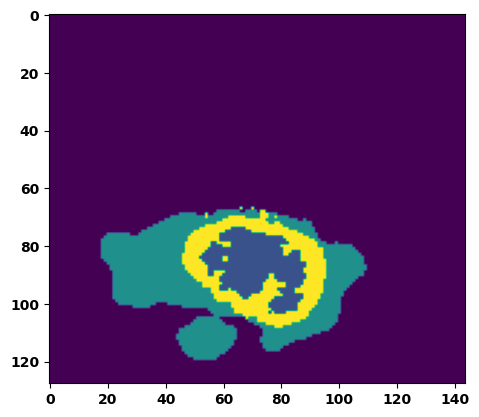

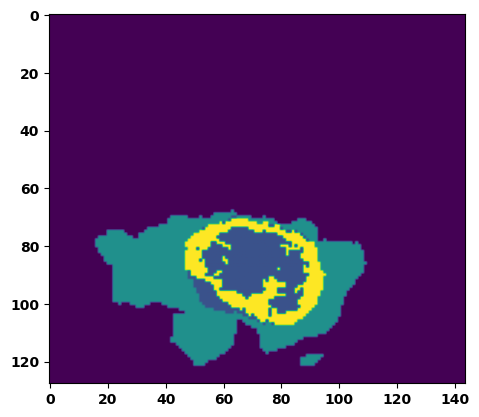

  6%|▌         | 2/36 [00:03<00:52,  1.54s/it]

Batch_id:  1 Eval loss:  0.06913700699806213
Batch_id:  1 Eval IoU:  tensor(0.8963, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.50s/it]

Batch_id:  2 Eval loss:  0.12499231100082397
Batch_id:  2 Eval IoU:  tensor(0.8057, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9933, device='cuda:0')


 11%|█         | 4/36 [00:05<00:47,  1.47s/it]

Batch_id:  3 Eval loss:  0.10511910915374756
Batch_id:  3 Eval IoU:  tensor(0.8239, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9914, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:46,  1.50s/it]

Batch_id:  4 Eval loss:  0.2547193765640259
Batch_id:  4 Eval IoU:  tensor(0.6532, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9459, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:45,  1.51s/it]

Batch_id:  5 Eval loss:  0.38141825795173645
Batch_id:  5 Eval IoU:  tensor(0.5035, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9280, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9217, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.46s/it]

Batch_id:  6 Eval loss:  0.2585206627845764
Batch_id:  6 Eval IoU:  tensor(0.6972, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:43,  1.54s/it]

Batch_id:  7 Eval loss:  0.20599330961704254
Batch_id:  7 Eval IoU:  tensor(0.7065, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:41,  1.53s/it]

Batch_id:  8 Eval loss:  0.08516903221607208
Batch_id:  8 Eval IoU:  tensor(0.8568, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9964, device='cuda:0')


 28%|██▊       | 10/36 [00:15<00:38,  1.49s/it]

Batch_id:  9 Eval loss:  0.7286732792854309
Batch_id:  9 Eval IoU:  tensor(0.2472, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9245, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9329, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  10 Eval loss:  0.07963171601295471
Batch_id:  10 Eval IoU:  tensor(0.8624, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


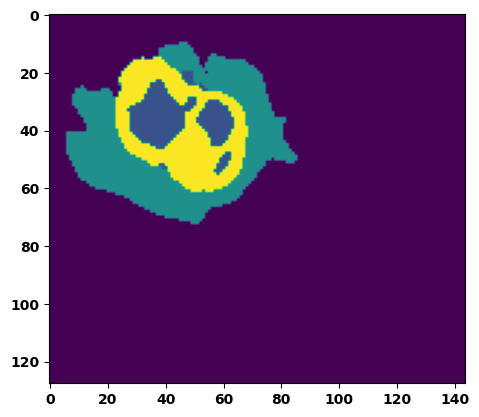

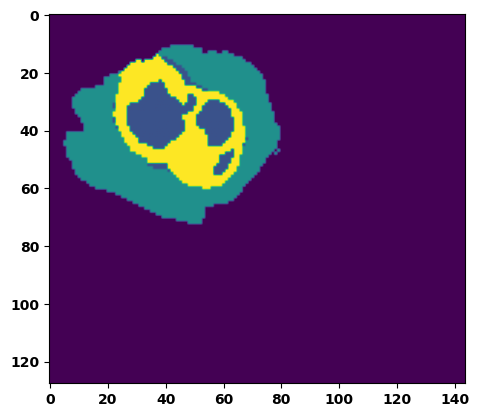

 33%|███▎      | 12/36 [00:18<00:35,  1.50s/it]

Batch_id:  11 Eval loss:  0.08026780188083649
Batch_id:  11 Eval IoU:  tensor(0.8625, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.50s/it]

Batch_id:  12 Eval loss:  0.4066006541252136
Batch_id:  12 Eval IoU:  tensor(0.5300, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9058, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.8598, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.8591, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9987, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:32,  1.47s/it]

Batch_id:  13 Eval loss:  0.25082141160964966
Batch_id:  13 Eval IoU:  tensor(0.6678, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9967, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.51s/it]

Batch_id:  14 Eval loss:  0.20668543875217438
Batch_id:  14 Eval IoU:  tensor(0.6910, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9863, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:29,  1.49s/it]

Batch_id:  15 Eval loss:  0.2358788102865219
Batch_id:  15 Eval IoU:  tensor(0.6663, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9790, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:29,  1.54s/it]

Batch_id:  16 Eval loss:  0.22846724092960358
Batch_id:  16 Eval IoU:  tensor(0.6772, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9875, device='cuda:0')


 50%|█████     | 18/36 [00:27<00:26,  1.49s/it]

Batch_id:  17 Eval loss:  0.1551281362771988
Batch_id:  17 Eval IoU:  tensor(0.7715, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:24,  1.42s/it]

Batch_id:  18 Eval loss:  0.07427982985973358
Batch_id:  18 Eval IoU:  tensor(0.8741, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:22,  1.43s/it]

Batch_id:  19 Eval loss:  0.14048956334590912
Batch_id:  19 Eval IoU:  tensor(0.7796, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  20 Eval loss:  0.07925014197826385
Batch_id:  20 Eval IoU:  tensor(0.8705, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9871, device='cuda:0')


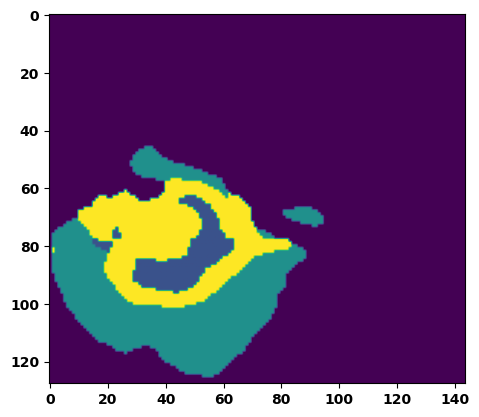

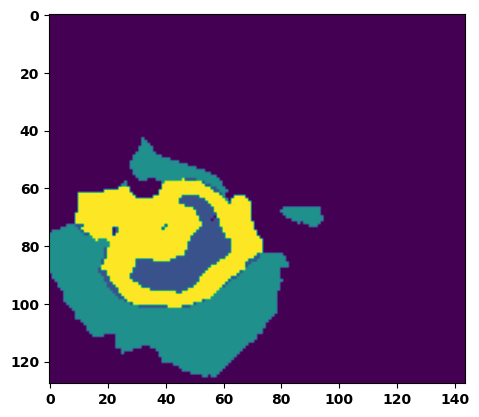

 61%|██████    | 22/36 [00:32<00:20,  1.45s/it]

Batch_id:  21 Eval loss:  0.4189404845237732
Batch_id:  21 Eval IoU:  tensor(0.5054, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:18,  1.43s/it]

Batch_id:  22 Eval loss:  0.08796490728855133
Batch_id:  22 Eval IoU:  tensor(0.8726, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:16,  1.41s/it]

Batch_id:  23 Eval loss:  0.21183280646800995
Batch_id:  23 Eval IoU:  tensor(0.7013, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.41s/it]

Batch_id:  24 Eval loss:  0.5895591974258423
Batch_id:  24 Eval IoU:  tensor(0.3596, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9928, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.41s/it]

Batch_id:  25 Eval loss:  0.24115383625030518
Batch_id:  25 Eval IoU:  tensor(0.6640, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:12,  1.40s/it]

Batch_id:  26 Eval loss:  0.4467102885246277
Batch_id:  26 Eval IoU:  tensor(0.4485, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9342, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  27 Eval loss:  0.11844596266746521
Batch_id:  27 Eval IoU:  tensor(0.8447, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:12,  1.53s/it]

Batch_id:  27 Eval Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9949, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.48s/it]

Batch_id:  28 Eval loss:  0.1872234344482422
Batch_id:  28 Eval IoU:  tensor(0.7277, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.43s/it]

Batch_id:  29 Eval loss:  0.2129410356283188
Batch_id:  29 Eval IoU:  tensor(0.6726, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9428, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  30 Eval loss:  0.1581835299730301
Batch_id:  30 Eval IoU:  tensor(0.7600, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


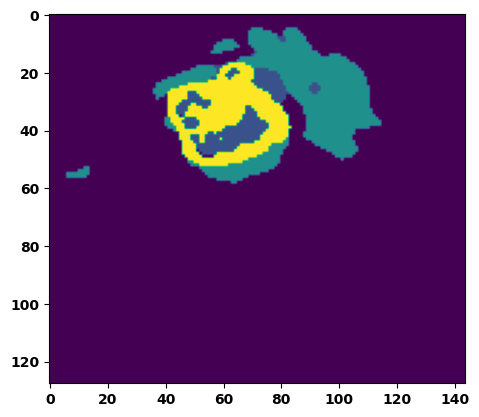

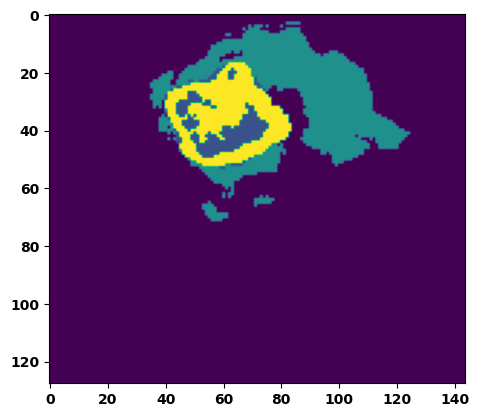

 89%|████████▉ | 32/36 [00:47<00:06,  1.53s/it]

Batch_id:  31 Eval loss:  0.37550610303878784
Batch_id:  31 Eval IoU:  tensor(0.5532, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.47s/it]

Batch_id:  32 Eval loss:  0.09678852558135986
Batch_id:  32 Eval IoU:  tensor(0.8395, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:02,  1.49s/it]

Batch_id:  33 Eval loss:  0.11674131453037262
Batch_id:  33 Eval IoU:  tensor(0.8046, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9895, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.44s/it]

Batch_id:  34 Eval loss:  0.17648370563983917
Batch_id:  34 Eval IoU:  tensor(0.7320, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9887, device='cuda:0')


100%|██████████| 36/36 [00:53<00:00,  1.48s/it]

Batch_id:  35 Eval loss:  0.06206496059894562
Batch_id:  35 Eval IoU:  tensor(0.8935, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')
Epoch  23 Training loss:  0.1868192748589949
Epoch  23 Evaluation loss:  0.21550035269724
Epoch  23 Training accuracy :  tensor(0.7397)
Epoch  23 Evaluation accuracy :  tensor(0.7123)
Epoch  23 Training Mean Dice Score:  tensor(0.9786)
Epoch  23 Eval Mean Dice Score:  tensor(0.9737)
Epoch  23 Training Non-tumor Dice Score:  tensor(0.9808)
Epoch  23 Eval Non-tumor Dice Score:  tensor(0.9725)
Epoch  23 Training NCR/NET Dice Score:  tensor(0.9894)
Epoch  23 Eval NCR/NET Dice Score:  tensor(0.9879)
Epoch  23 Training ED Dice Score:  tensor(0.9752

Best Model saved!
Epoch: 24
Training in session: 


  1%|          | 1/110 [00:01<03:06,  1.71s/it]

Batch_id:  0 Training loss:  0.13779298961162567
Batch_id:  0 Training IoU:  tensor(0.7971, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:37,  1.46s/it]

Batch_id:  1 Training loss:  0.22472812235355377
Batch_id:  1 Training IoU:  tensor(0.6711, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:42,  1.52s/it]

Batch_id:  2 Training loss:  0.06495901942253113
Batch_id:  2 Training IoU:  tensor(0.8910, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:44,  1.55s/it]

Batch_id:  3 Training loss:  0.20554639399051666
Batch_id:  3 Training IoU:  tensor(0.7380, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:36,  1.49s/it]

Batch_id:  4 Training loss:  0.18158124387264252
Batch_id:  4 Training IoU:  tensor(0.7227, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:36,  1.50s/it]

Batch_id:  5 Training loss:  0.15816329419612885
Batch_id:  5 Training IoU:  tensor(0.7530, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9795, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:36,  1.52s/it]

Batch_id:  6 Training loss:  0.12257495522499084
Batch_id:  6 Training IoU:  tensor(0.8016, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9753, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:33,  1.51s/it]

Batch_id:  7 Training loss:  0.23254916071891785
Batch_id:  7 Training IoU:  tensor(0.6662, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9831, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:40,  1.59s/it]

Batch_id:  8 Training loss:  0.17744219303131104
Batch_id:  8 Training IoU:  tensor(0.7147, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9817, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:36,  1.57s/it]

Batch_id:  9 Training loss:  0.06400889158248901
Batch_id:  9 Training IoU:  tensor(0.8940, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 10%|█         | 11/110 [00:16<02:30,  1.52s/it]

Batch_id:  10 Training loss:  0.2925207018852234
Batch_id:  10 Training IoU:  tensor(0.5981, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9423, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9734, device='cuda:0')


 11%|█         | 12/110 [00:18<02:26,  1.50s/it]

Batch_id:  11 Training loss:  0.39399588108062744
Batch_id:  11 Training IoU:  tensor(0.5503, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:27,  1.52s/it]

Batch_id:  12 Training loss:  0.14130908250808716
Batch_id:  12 Training IoU:  tensor(0.7972, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:23,  1.50s/it]

Batch_id:  13 Training loss:  0.1054629236459732
Batch_id:  13 Training IoU:  tensor(0.8320, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:26,  1.54s/it]

Batch_id:  14 Training loss:  0.1889035850763321
Batch_id:  14 Training IoU:  tensor(0.7271, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:21,  1.50s/it]

Batch_id:  15 Training loss:  0.34334588050842285
Batch_id:  15 Training IoU:  tensor(0.5924, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9386, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:17,  1.48s/it]

Batch_id:  16 Training loss:  0.09692704677581787
Batch_id:  16 Training IoU:  tensor(0.8346, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:19,  1.52s/it]

Batch_id:  17 Training loss:  0.15344376862049103
Batch_id:  17 Training IoU:  tensor(0.7555, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:18,  1.52s/it]

Batch_id:  18 Training loss:  0.20305660367012024
Batch_id:  18 Training IoU:  tensor(0.7584, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:16,  1.52s/it]

Batch_id:  19 Training loss:  0.04404798150062561
Batch_id:  19 Training IoU:  tensor(0.9265, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:14,  1.51s/it]

Batch_id:  20 Training loss:  0.24620553851127625
Batch_id:  20 Training IoU:  tensor(0.6859, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 20%|██        | 22/110 [00:33<02:12,  1.51s/it]

Batch_id:  21 Training loss:  0.15851835906505585
Batch_id:  21 Training IoU:  tensor(0.7502, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9717, device='cuda:0')


 21%|██        | 23/110 [00:34<02:12,  1.52s/it]

Batch_id:  22 Training loss:  0.09026375412940979
Batch_id:  22 Training IoU:  tensor(0.8471, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:09,  1.50s/it]

Batch_id:  23 Training loss:  0.14998938143253326
Batch_id:  23 Training IoU:  tensor(0.7829, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:07,  1.50s/it]

Batch_id:  24 Training loss:  0.10329000651836395
Batch_id:  24 Training IoU:  tensor(0.8295, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9810, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:04,  1.48s/it]

Batch_id:  25 Training loss:  0.15880613029003143
Batch_id:  25 Training IoU:  tensor(0.7441, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 25%|██▍       | 27/110 [00:40<02:03,  1.49s/it]

Batch_id:  26 Training loss:  0.15201996266841888
Batch_id:  26 Training IoU:  tensor(0.7507, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9736, device='cuda:0')


 25%|██▌       | 28/110 [00:42<02:04,  1.52s/it]

Batch_id:  27 Training loss:  0.13763275742530823
Batch_id:  27 Training IoU:  tensor(0.7850, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 26%|██▋       | 29/110 [00:44<02:04,  1.54s/it]

Batch_id:  28 Training loss:  0.0980289876461029
Batch_id:  28 Training IoU:  tensor(0.8367, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 27%|██▋       | 30/110 [00:45<01:59,  1.50s/it]

Batch_id:  29 Training loss:  0.17980855703353882
Batch_id:  29 Training IoU:  tensor(0.7464, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 28%|██▊       | 31/110 [00:46<01:56,  1.48s/it]

Batch_id:  30 Training loss:  0.29220831394195557
Batch_id:  30 Training IoU:  tensor(0.5875, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9705, device='cuda:0')


 29%|██▉       | 32/110 [00:48<01:57,  1.51s/it]

Batch_id:  31 Training loss:  0.10116462409496307
Batch_id:  31 Training IoU:  tensor(0.8364, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 30%|███       | 33/110 [00:50<02:01,  1.58s/it]

Batch_id:  32 Training loss:  0.08151218295097351
Batch_id:  32 Training IoU:  tensor(0.8604, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 31%|███       | 34/110 [00:51<02:01,  1.59s/it]

Batch_id:  33 Training loss:  0.09090308845043182
Batch_id:  33 Training IoU:  tensor(0.8503, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 32%|███▏      | 35/110 [00:53<01:58,  1.57s/it]

Batch_id:  34 Training loss:  0.23563545942306519
Batch_id:  34 Training IoU:  tensor(0.6475, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9313, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9315, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9111, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:53,  1.53s/it]

Batch_id:  35 Training loss:  0.14040833711624146
Batch_id:  35 Training IoU:  tensor(0.7744, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 34%|███▎      | 37/110 [00:56<01:52,  1.54s/it]

Batch_id:  36 Training loss:  0.09431292116641998
Batch_id:  36 Training IoU:  tensor(0.8429, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 35%|███▍      | 38/110 [00:57<01:52,  1.57s/it]

Batch_id:  37 Training loss:  0.27559688687324524
Batch_id:  37 Training IoU:  tensor(0.6399, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 35%|███▌      | 39/110 [00:59<01:50,  1.56s/it]

Batch_id:  38 Training loss:  0.15182822942733765
Batch_id:  38 Training IoU:  tensor(0.7847, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 36%|███▋      | 40/110 [01:01<01:52,  1.61s/it]

Batch_id:  39 Training loss:  0.09404845535755157
Batch_id:  39 Training IoU:  tensor(0.8455, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 37%|███▋      | 41/110 [01:02<01:45,  1.53s/it]

Batch_id:  40 Training loss:  0.25406384468078613
Batch_id:  40 Training IoU:  tensor(0.7099, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 38%|███▊      | 42/110 [01:04<01:45,  1.55s/it]

Batch_id:  41 Training loss:  0.1265811324119568
Batch_id:  41 Training IoU:  tensor(0.8078, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 39%|███▉      | 43/110 [01:05<01:42,  1.52s/it]

Batch_id:  42 Training loss:  0.13912634551525116
Batch_id:  42 Training IoU:  tensor(0.7936, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 40%|████      | 44/110 [01:07<01:40,  1.52s/it]

Batch_id:  43 Training loss:  0.363588809967041
Batch_id:  43 Training IoU:  tensor(0.5310, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9784, device='cuda:0')


 41%|████      | 45/110 [01:08<01:43,  1.59s/it]

Batch_id:  44 Training loss:  0.10058806836605072
Batch_id:  44 Training IoU:  tensor(0.8314, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 42%|████▏     | 46/110 [01:10<01:41,  1.58s/it]

Batch_id:  45 Training loss:  0.3857422471046448
Batch_id:  45 Training IoU:  tensor(0.5464, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 43%|████▎     | 47/110 [01:12<01:39,  1.58s/it]

Batch_id:  46 Training loss:  0.09800499677658081
Batch_id:  46 Training IoU:  tensor(0.8356, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 44%|████▎     | 48/110 [01:13<01:38,  1.58s/it]

Batch_id:  47 Training loss:  0.22382810711860657
Batch_id:  47 Training IoU:  tensor(0.6819, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 45%|████▍     | 49/110 [01:15<01:35,  1.56s/it]

Batch_id:  48 Training loss:  0.14050357043743134
Batch_id:  48 Training IoU:  tensor(0.7832, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 45%|████▌     | 50/110 [01:16<01:34,  1.57s/it]

Batch_id:  49 Training loss:  0.11256566643714905
Batch_id:  49 Training IoU:  tensor(0.8139, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9494, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


 46%|████▋     | 51/110 [01:18<01:32,  1.56s/it]

Batch_id:  50 Training loss:  0.2627495229244232
Batch_id:  50 Training IoU:  tensor(0.6200, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9278, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9193, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9747, device='cuda:0')


 47%|████▋     | 52/110 [01:19<01:28,  1.52s/it]

Batch_id:  51 Training loss:  0.1502116322517395
Batch_id:  51 Training IoU:  tensor(0.7747, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 48%|████▊     | 53/110 [01:21<01:28,  1.54s/it]

Batch_id:  52 Training loss:  0.04530914127826691
Batch_id:  52 Training IoU:  tensor(0.9235, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 49%|████▉     | 54/110 [01:22<01:26,  1.55s/it]

Batch_id:  53 Training loss:  0.05361071228981018
Batch_id:  53 Training IoU:  tensor(0.9072, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 50%|█████     | 55/110 [01:24<01:22,  1.51s/it]

Batch_id:  54 Training loss:  0.5498485565185547
Batch_id:  54 Training IoU:  tensor(0.3940, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 51%|█████     | 56/110 [01:25<01:19,  1.48s/it]

Batch_id:  55 Training loss:  0.2708682119846344
Batch_id:  55 Training IoU:  tensor(0.6187, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 52%|█████▏    | 57/110 [01:27<01:18,  1.48s/it]

Batch_id:  56 Training loss:  0.1765376478433609
Batch_id:  56 Training IoU:  tensor(0.7803, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 53%|█████▎    | 58/110 [01:28<01:19,  1.53s/it]

Batch_id:  57 Training loss:  0.20086422562599182
Batch_id:  57 Training IoU:  tensor(0.7129, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 54%|█████▎    | 59/110 [01:30<01:16,  1.51s/it]

Batch_id:  58 Training loss:  0.15092138946056366
Batch_id:  58 Training IoU:  tensor(0.7586, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 55%|█████▍    | 60/110 [01:31<01:14,  1.49s/it]

Batch_id:  59 Training loss:  0.154693603515625
Batch_id:  59 Training IoU:  tensor(0.7881, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 55%|█████▌    | 61/110 [01:33<01:14,  1.52s/it]

Batch_id:  60 Training loss:  0.13806022703647614
Batch_id:  60 Training IoU:  tensor(0.8106, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 56%|█████▋    | 62/110 [01:34<01:12,  1.52s/it]

Batch_id:  61 Training loss:  0.13859185576438904
Batch_id:  61 Training IoU:  tensor(0.7955, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 57%|█████▋    | 63/110 [01:36<01:10,  1.49s/it]

Batch_id:  62 Training loss:  0.27791541814804077
Batch_id:  62 Training IoU:  tensor(0.6259, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9576, device='cuda:0')


 58%|█████▊    | 64/110 [01:37<01:06,  1.46s/it]

Batch_id:  63 Training loss:  0.08088614046573639
Batch_id:  63 Training IoU:  tensor(0.8609, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 59%|█████▉    | 65/110 [01:38<01:03,  1.42s/it]

Batch_id:  64 Training loss:  0.3168231248855591
Batch_id:  64 Training IoU:  tensor(0.6350, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 60%|██████    | 66/110 [01:40<01:03,  1.45s/it]

Batch_id:  65 Training loss:  0.06939390301704407
Batch_id:  65 Training IoU:  tensor(0.8843, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 61%|██████    | 67/110 [01:41<01:00,  1.41s/it]

Batch_id:  66 Training loss:  0.05882832407951355
Batch_id:  66 Training IoU:  tensor(0.9039, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 62%|██████▏   | 68/110 [01:43<00:59,  1.41s/it]

Batch_id:  67 Training loss:  0.2547314763069153
Batch_id:  67 Training IoU:  tensor(0.6397, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 63%|██████▎   | 69/110 [01:44<00:57,  1.41s/it]

Batch_id:  68 Training loss:  0.13337194919586182
Batch_id:  68 Training IoU:  tensor(0.7910, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 64%|██████▎   | 70/110 [01:46<00:56,  1.41s/it]

Batch_id:  69 Training loss:  0.1990501582622528
Batch_id:  69 Training IoU:  tensor(0.7013, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 65%|██████▍   | 71/110 [01:47<00:54,  1.41s/it]

Batch_id:  70 Training loss:  0.08876027166843414
Batch_id:  70 Training IoU:  tensor(0.8478, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9831, device='cuda:0')


 65%|██████▌   | 72/110 [01:48<00:52,  1.39s/it]

Batch_id:  71 Training loss:  0.12629243731498718
Batch_id:  71 Training IoU:  tensor(0.7932, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 66%|██████▋   | 73/110 [01:50<00:53,  1.44s/it]

Batch_id:  72 Training loss:  0.10644063353538513
Batch_id:  72 Training IoU:  tensor(0.8228, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 67%|██████▋   | 74/110 [01:51<00:50,  1.40s/it]

Batch_id:  73 Training loss:  0.2416124790906906
Batch_id:  73 Training IoU:  tensor(0.6526, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 68%|██████▊   | 75/110 [01:53<00:51,  1.48s/it]

Batch_id:  74 Training loss:  0.21154391765594482
Batch_id:  74 Training IoU:  tensor(0.6845, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 69%|██████▉   | 76/110 [01:54<00:49,  1.46s/it]

Batch_id:  75 Training loss:  0.08753691613674164
Batch_id:  75 Training IoU:  tensor(0.8495, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 70%|███████   | 77/110 [01:56<00:46,  1.42s/it]

Batch_id:  76 Training loss:  0.10916174948215485
Batch_id:  76 Training IoU:  tensor(0.8215, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 71%|███████   | 78/110 [01:57<00:46,  1.45s/it]

Batch_id:  77 Training loss:  0.24286355078220367
Batch_id:  77 Training IoU:  tensor(0.7299, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 72%|███████▏  | 79/110 [01:58<00:44,  1.43s/it]

Batch_id:  78 Training loss:  0.17706181108951569
Batch_id:  78 Training IoU:  tensor(0.7200, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


 73%|███████▎  | 80/110 [02:00<00:41,  1.38s/it]

Batch_id:  79 Training loss:  0.11351509392261505
Batch_id:  79 Training IoU:  tensor(0.8172, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 74%|███████▎  | 81/110 [02:01<00:40,  1.41s/it]

Batch_id:  80 Training loss:  0.20739400386810303
Batch_id:  80 Training IoU:  tensor(0.6791, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 75%|███████▍  | 82/110 [02:02<00:38,  1.38s/it]

Batch_id:  81 Training loss:  0.05573628842830658
Batch_id:  81 Training IoU:  tensor(0.9083, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 75%|███████▌  | 83/110 [02:04<00:36,  1.36s/it]

Batch_id:  82 Training loss:  0.15357646346092224
Batch_id:  82 Training IoU:  tensor(0.7548, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 76%|███████▋  | 84/110 [02:05<00:35,  1.37s/it]

Batch_id:  83 Training loss:  0.3146917521953583
Batch_id:  83 Training IoU:  tensor(0.5778, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9408, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9172, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 77%|███████▋  | 85/110 [02:07<00:35,  1.43s/it]

Batch_id:  84 Training loss:  0.13992717862129211
Batch_id:  84 Training IoU:  tensor(0.7793, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


 78%|███████▊  | 86/110 [02:08<00:34,  1.43s/it]

Batch_id:  85 Training loss:  0.3223140239715576
Batch_id:  85 Training IoU:  tensor(0.6121, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 79%|███████▉  | 87/110 [02:10<00:33,  1.44s/it]

Batch_id:  86 Training loss:  0.49840208888053894
Batch_id:  86 Training IoU:  tensor(0.4225, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 80%|████████  | 88/110 [02:11<00:31,  1.45s/it]

Batch_id:  87 Training loss:  0.2259840965270996
Batch_id:  87 Training IoU:  tensor(0.7072, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 81%|████████  | 89/110 [02:13<00:30,  1.43s/it]

Batch_id:  88 Training loss:  0.09761318564414978
Batch_id:  88 Training IoU:  tensor(0.8440, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 82%|████████▏ | 90/110 [02:14<00:28,  1.42s/it]

Batch_id:  89 Training loss:  0.15016111731529236
Batch_id:  89 Training IoU:  tensor(0.7577, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


 83%|████████▎ | 91/110 [02:15<00:26,  1.42s/it]

Batch_id:  90 Training loss:  0.21009211242198944
Batch_id:  90 Training IoU:  tensor(0.7512, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 84%|████████▎ | 92/110 [02:17<00:25,  1.44s/it]

Batch_id:  91 Training loss:  0.39384883642196655
Batch_id:  91 Training IoU:  tensor(0.5280, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 85%|████████▍ | 93/110 [02:18<00:23,  1.39s/it]

Batch_id:  92 Training loss:  0.2865939736366272
Batch_id:  92 Training IoU:  tensor(0.6584, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 85%|████████▌ | 94/110 [02:19<00:22,  1.38s/it]

Batch_id:  93 Training loss:  0.4577330946922302
Batch_id:  93 Training IoU:  tensor(0.4555, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9310, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9102, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 86%|████████▋ | 95/110 [02:21<00:20,  1.40s/it]

Batch_id:  94 Training loss:  0.19071519374847412
Batch_id:  94 Training IoU:  tensor(0.7189, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9821, device='cuda:0')


 87%|████████▋ | 96/110 [02:22<00:19,  1.41s/it]

Batch_id:  95 Training loss:  0.1148868054151535
Batch_id:  95 Training IoU:  tensor(0.8210, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 88%|████████▊ | 97/110 [02:24<00:18,  1.40s/it]

Batch_id:  96 Training loss:  0.10989727079868317
Batch_id:  96 Training IoU:  tensor(0.8290, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 89%|████████▉ | 98/110 [02:25<00:17,  1.43s/it]

Batch_id:  97 Training loss:  0.08289080858230591
Batch_id:  97 Training IoU:  tensor(0.8792, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 90%|█████████ | 99/110 [02:27<00:15,  1.43s/it]

Batch_id:  98 Training loss:  0.0950063019990921
Batch_id:  98 Training IoU:  tensor(0.8401, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:13,  1.38s/it]

Batch_id:  99 Training loss:  0.2984743118286133
Batch_id:  99 Training IoU:  tensor(0.6502, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 92%|█████████▏| 101/110 [02:29<00:12,  1.35s/it]

Batch_id:  100 Training loss:  0.09872797131538391
Batch_id:  100 Training IoU:  tensor(0.8430, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 93%|█████████▎| 102/110 [02:30<00:10,  1.33s/it]

Batch_id:  101 Training loss:  0.1375323235988617
Batch_id:  101 Training IoU:  tensor(0.7941, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 94%|█████████▎| 103/110 [02:32<00:09,  1.42s/it]

Batch_id:  102 Training loss:  0.3736450970172882
Batch_id:  102 Training IoU:  tensor(0.6034, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 95%|█████████▍| 104/110 [02:34<00:08,  1.42s/it]

Batch_id:  103 Training loss:  0.2709549069404602
Batch_id:  103 Training IoU:  tensor(0.6340, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 95%|█████████▌| 105/110 [02:35<00:07,  1.41s/it]

Batch_id:  104 Training loss:  0.20122291147708893
Batch_id:  104 Training IoU:  tensor(0.6979, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 96%|█████████▋| 106/110 [02:36<00:05,  1.40s/it]

Batch_id:  105 Training loss:  0.20697730779647827
Batch_id:  105 Training IoU:  tensor(0.6891, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9482, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9331, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9720, device='cuda:0')


 97%|█████████▋| 107/110 [02:38<00:04,  1.49s/it]

Batch_id:  106 Training loss:  0.09417325258255005
Batch_id:  106 Training IoU:  tensor(0.8429, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 98%|█████████▊| 108/110 [02:39<00:02,  1.47s/it]

Batch_id:  107 Training loss:  0.13805843889713287
Batch_id:  107 Training IoU:  tensor(0.7774, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 99%|█████████▉| 109/110 [02:41<00:01,  1.50s/it]

Batch_id:  108 Training loss:  0.22405391931533813
Batch_id:  108 Training IoU:  tensor(0.7343, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


100%|██████████| 110/110 [02:43<00:00,  1.48s/it]


Batch_id:  109 Training loss:  0.10018177330493927
Batch_id:  109 Training IoU:  tensor(0.8684, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9985, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.08366994559764862
Batch_id:  0 Eval IoU:  tensor(0.8575, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9889, device='cuda:0')


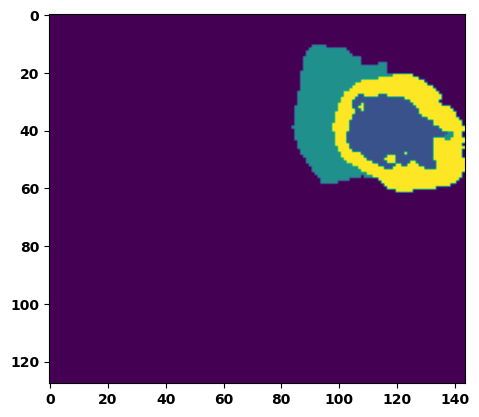

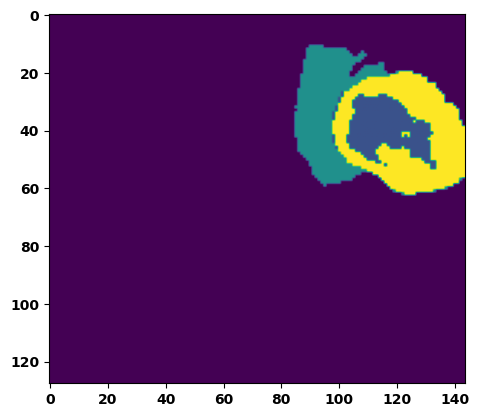

  6%|▌         | 2/36 [00:03<00:53,  1.57s/it]

Batch_id:  1 Eval loss:  0.4005155563354492
Batch_id:  1 Eval IoU:  tensor(0.4858, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9405, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9256, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9186, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9892, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:50,  1.53s/it]

Batch_id:  2 Eval loss:  0.08885699510574341
Batch_id:  2 Eval IoU:  tensor(0.8504, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9887, device='cuda:0')


 11%|█         | 4/36 [00:06<00:47,  1.49s/it]

Batch_id:  3 Eval loss:  0.09274929761886597
Batch_id:  3 Eval IoU:  tensor(0.8446, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:44,  1.44s/it]

Batch_id:  4 Eval loss:  0.19933058321475983
Batch_id:  4 Eval IoU:  tensor(0.7034, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:44,  1.48s/it]

Batch_id:  5 Eval loss:  0.09837274253368378
Batch_id:  5 Eval IoU:  tensor(0.8313, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9915, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:41,  1.44s/it]

Batch_id:  6 Eval loss:  0.09781026840209961
Batch_id:  6 Eval IoU:  tensor(0.8393, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:39,  1.41s/it]

Batch_id:  7 Eval loss:  0.1321651041507721
Batch_id:  7 Eval IoU:  tensor(0.7994, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9915, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:38,  1.42s/it]

Batch_id:  8 Eval loss:  0.21431614458560944
Batch_id:  8 Eval IoU:  tensor(0.6912, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9933, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.47s/it]

Batch_id:  9 Eval loss:  0.4031241834163666
Batch_id:  9 Eval IoU:  tensor(0.5265, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  10 Eval loss:  0.21646378934383392
Batch_id:  10 Eval IoU:  tensor(0.6663, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9442, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9529, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9825, device='cuda:0')


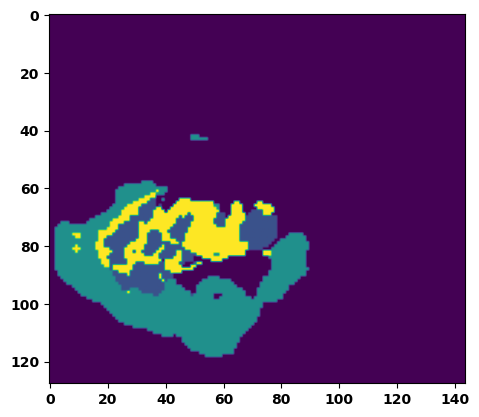

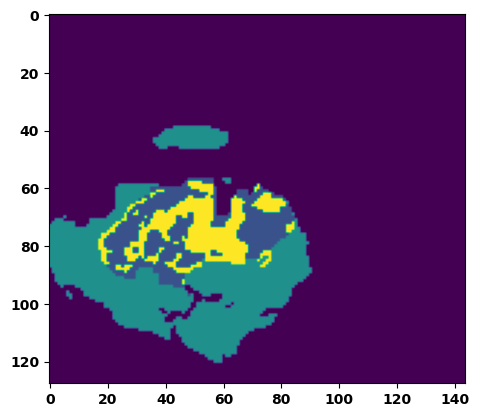

 33%|███▎      | 12/36 [00:18<00:37,  1.57s/it]

Batch_id:  11 Eval loss:  0.2604171335697174
Batch_id:  11 Eval IoU:  tensor(0.6408, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9919, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:33,  1.47s/it]

Batch_id:  12 Eval loss:  0.24590621888637543
Batch_id:  12 Eval IoU:  tensor(0.6535, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9760, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:32,  1.47s/it]

Batch_id:  13 Eval loss:  0.728830099105835
Batch_id:  13 Eval IoU:  tensor(0.2477, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9436, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9253, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9303, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:30,  1.44s/it]

Batch_id:  14 Eval loss:  0.2559189796447754
Batch_id:  14 Eval IoU:  tensor(0.6440, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9919, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:31,  1.58s/it]

Batch_id:  15 Eval loss:  0.41367942094802856
Batch_id:  15 Eval IoU:  tensor(0.5199, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9036, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.8569, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.8562, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:28,  1.52s/it]

Batch_id:  16 Eval loss:  0.2484760880470276
Batch_id:  16 Eval IoU:  tensor(0.6586, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9446, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:27,  1.53s/it]

Batch_id:  17 Eval loss:  0.1974935084581375
Batch_id:  17 Eval IoU:  tensor(0.7182, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9966, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:24,  1.46s/it]

Batch_id:  18 Eval loss:  0.16168412566184998
Batch_id:  18 Eval IoU:  tensor(0.7470, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:24,  1.55s/it]

Batch_id:  19 Eval loss:  0.25109291076660156
Batch_id:  19 Eval IoU:  tensor(0.6498, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  20 Eval loss:  0.09952504932880402
Batch_id:  20 Eval IoU:  tensor(0.8358, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9916, device='cuda:0')


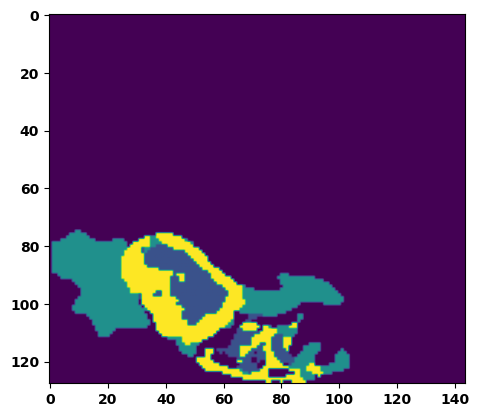

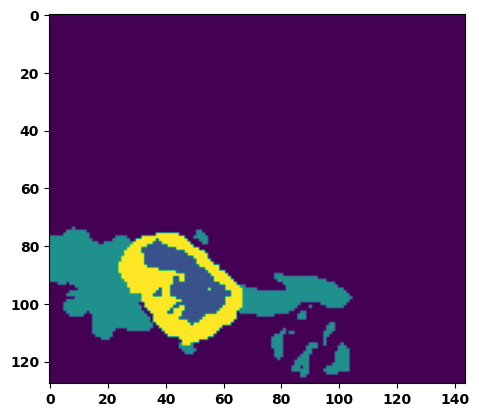

 61%|██████    | 22/36 [00:33<00:21,  1.55s/it]

Batch_id:  21 Eval loss:  0.1388120800256729
Batch_id:  21 Eval IoU:  tensor(0.7912, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9382, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.51s/it]

Batch_id:  22 Eval loss:  0.06867539882659912
Batch_id:  22 Eval IoU:  tensor(0.8954, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 67%|██████▋   | 24/36 [00:36<00:18,  1.53s/it]

Batch_id:  23 Eval loss:  0.2027379870414734
Batch_id:  23 Eval IoU:  tensor(0.7071, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:16,  1.48s/it]

Batch_id:  24 Eval loss:  0.2629616856575012
Batch_id:  24 Eval IoU:  tensor(0.6847, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.42s/it]

Batch_id:  25 Eval loss:  0.07754924893379211
Batch_id:  25 Eval IoU:  tensor(0.8711, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9859, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:12,  1.44s/it]

Batch_id:  26 Eval loss:  0.3783942461013794
Batch_id:  26 Eval IoU:  tensor(0.5507, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.43s/it]

Batch_id:  27 Eval loss:  0.07567751407623291
Batch_id:  27 Eval IoU:  tensor(0.8690, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9917, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:09,  1.42s/it]

Batch_id:  28 Eval loss:  0.10546106100082397
Batch_id:  28 Eval IoU:  tensor(0.8615, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.40s/it]

Batch_id:  29 Eval loss:  0.0753755122423172
Batch_id:  29 Eval IoU:  tensor(0.8912, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  30 Eval loss:  0.26647910475730896
Batch_id:  30 Eval IoU:  tensor(0.6694, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


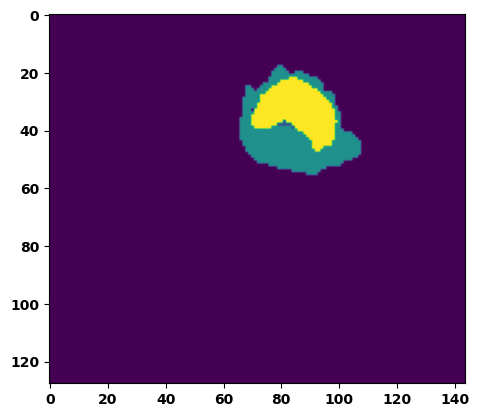

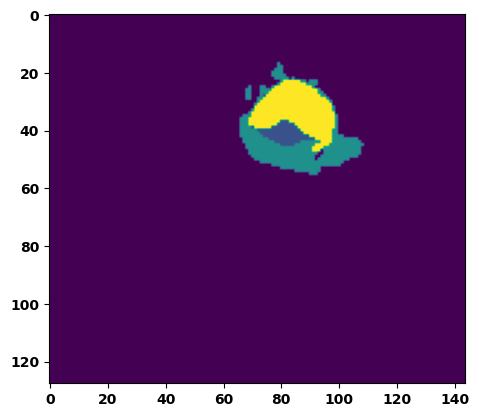

 89%|████████▉ | 32/36 [00:47<00:05,  1.43s/it]

Batch_id:  31 Eval loss:  0.5821875333786011
Batch_id:  31 Eval IoU:  tensor(0.3650, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.43s/it]

Batch_id:  32 Eval loss:  0.14939571917057037
Batch_id:  32 Eval IoU:  tensor(0.7610, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9851, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:02,  1.41s/it]

Batch_id:  33 Eval loss:  0.06341341137886047
Batch_id:  33 Eval IoU:  tensor(0.8928, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.41s/it]

Batch_id:  34 Eval loss:  0.1785876601934433
Batch_id:  34 Eval IoU:  tensor(0.7265, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9879, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.47s/it]

Batch_id:  35 Eval loss:  0.4419816732406616
Batch_id:  35 Eval IoU:  tensor(0.4547, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9347, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9982, device='cuda:0')
Epoch 00025: reducing learning rate of group 0 to 6.2500e-05.
Epoch  24 Training loss:  0.1813514303077351
Epoch  24 Evaluation loss:  0.22105799946520063
Epoch  24 Training accuracy :  tensor(0.7464)
Epoch  24 Evaluation accuracy :  tensor(0.7056)
Epoch  24 Training Mean Dice Score:  tensor(0.9792)
Epoch  24 Eval Mean Dice Score:  tensor(0.9733)
Epoch  24 Training Non-tumor Dice Score:  tensor(0.9812)
Epoch  24 Eval Non-tumor Dice Score:  tensor(0.9726)
Epoch  24 Training NCR/NET Dice Score:  tensor(0.9898)
Epoch  24 Eval NCR/NET Dice Score: 

Epoch: 25
Training in session: 


  1%|          | 1/110 [00:01<03:29,  1.92s/it]

Batch_id:  0 Training loss:  0.27355247735977173
Batch_id:  0 Training IoU:  tensor(0.6270, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9540, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:52,  1.60s/it]

Batch_id:  1 Training loss:  0.17843343317508698
Batch_id:  1 Training IoU:  tensor(0.7201, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:47,  1.57s/it]

Batch_id:  2 Training loss:  0.10753963887691498
Batch_id:  2 Training IoU:  tensor(0.8168, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:37,  1.48s/it]

Batch_id:  3 Training loss:  0.15165816247463226
Batch_id:  3 Training IoU:  tensor(0.7516, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9716, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:35,  1.48s/it]

Batch_id:  4 Training loss:  0.16794297099113464
Batch_id:  4 Training IoU:  tensor(0.7405, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9800, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:33,  1.48s/it]

Batch_id:  5 Training loss:  0.11180518567562103
Batch_id:  5 Training IoU:  tensor(0.8116, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:33,  1.49s/it]

Batch_id:  6 Training loss:  0.15813617408275604
Batch_id:  6 Training IoU:  tensor(0.7689, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:33,  1.50s/it]

Batch_id:  7 Training loss:  0.10724839568138123
Batch_id:  7 Training IoU:  tensor(0.8309, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:31,  1.50s/it]

Batch_id:  8 Training loss:  0.06280489265918732
Batch_id:  8 Training IoU:  tensor(0.8958, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:29,  1.50s/it]

Batch_id:  9 Training loss:  0.04569779336452484
Batch_id:  9 Training IoU:  tensor(0.9217, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 10%|█         | 11/110 [00:16<02:30,  1.52s/it]

Batch_id:  10 Training loss:  0.272153377532959
Batch_id:  10 Training IoU:  tensor(0.6089, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9729, device='cuda:0')


 11%|█         | 12/110 [00:17<02:21,  1.44s/it]

Batch_id:  11 Training loss:  0.09603932499885559
Batch_id:  11 Training IoU:  tensor(0.8446, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:17,  1.42s/it]

Batch_id:  12 Training loss:  0.12727437913417816
Batch_id:  12 Training IoU:  tensor(0.8093, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:13,  1.39s/it]

Batch_id:  13 Training loss:  0.15537969768047333
Batch_id:  13 Training IoU:  tensor(0.7516, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:13,  1.41s/it]

Batch_id:  14 Training loss:  0.11144037544727325
Batch_id:  14 Training IoU:  tensor(0.8236, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:13,  1.42s/it]

Batch_id:  15 Training loss:  0.16409443318843842
Batch_id:  15 Training IoU:  tensor(0.7426, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9714, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:08,  1.38s/it]

Batch_id:  16 Training loss:  0.23497365415096283
Batch_id:  16 Training IoU:  tensor(0.7265, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:10,  1.42s/it]

Batch_id:  17 Training loss:  0.20711523294448853
Batch_id:  17 Training IoU:  tensor(0.6920, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:06,  1.39s/it]

Batch_id:  18 Training loss:  0.10243821144104004
Batch_id:  18 Training IoU:  tensor(0.8282, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:08,  1.43s/it]

Batch_id:  19 Training loss:  0.09927597641944885
Batch_id:  19 Training IoU:  tensor(0.8327, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:07,  1.43s/it]

Batch_id:  20 Training loss:  0.26700884103775024
Batch_id:  20 Training IoU:  tensor(0.6374, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 20%|██        | 22/110 [00:32<02:05,  1.43s/it]

Batch_id:  21 Training loss:  0.11213250458240509
Batch_id:  21 Training IoU:  tensor(0.8188, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 21%|██        | 23/110 [00:33<02:02,  1.41s/it]

Batch_id:  22 Training loss:  0.1013251394033432
Batch_id:  22 Training IoU:  tensor(0.8294, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:05,  1.46s/it]

Batch_id:  23 Training loss:  0.12939119338989258
Batch_id:  23 Training IoU:  tensor(0.8086, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:05,  1.48s/it]

Batch_id:  24 Training loss:  0.10296502709388733
Batch_id:  24 Training IoU:  tensor(0.8286, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:10,  1.55s/it]

Batch_id:  25 Training loss:  0.1864757388830185
Batch_id:  25 Training IoU:  tensor(0.7860, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:07,  1.53s/it]

Batch_id:  26 Training loss:  0.1893778145313263
Batch_id:  26 Training IoU:  tensor(0.7262, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 25%|██▌       | 28/110 [00:41<02:06,  1.54s/it]

Batch_id:  27 Training loss:  0.22081832587718964
Batch_id:  27 Training IoU:  tensor(0.6801, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 26%|██▋       | 29/110 [00:42<02:03,  1.52s/it]

Batch_id:  28 Training loss:  0.1061445027589798
Batch_id:  28 Training IoU:  tensor(0.8275, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 27%|██▋       | 30/110 [00:44<02:00,  1.50s/it]

Batch_id:  29 Training loss:  0.15987329185009003
Batch_id:  29 Training IoU:  tensor(0.7810, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:58,  1.50s/it]

Batch_id:  30 Training loss:  0.18407444655895233
Batch_id:  30 Training IoU:  tensor(0.7323, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 29%|██▉       | 32/110 [00:47<01:56,  1.50s/it]

Batch_id:  31 Training loss:  0.22552390396595
Batch_id:  31 Training IoU:  tensor(0.7032, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 30%|███       | 33/110 [00:48<01:52,  1.46s/it]

Batch_id:  32 Training loss:  0.2014991044998169
Batch_id:  32 Training IoU:  tensor(0.6985, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 31%|███       | 34/110 [00:50<01:49,  1.45s/it]

Batch_id:  33 Training loss:  0.14643822610378265
Batch_id:  33 Training IoU:  tensor(0.7652, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:49,  1.46s/it]

Batch_id:  34 Training loss:  0.08170245587825775
Batch_id:  34 Training IoU:  tensor(0.8805, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:49,  1.48s/it]

Batch_id:  35 Training loss:  0.1805034577846527
Batch_id:  35 Training IoU:  tensor(0.7691, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:46,  1.46s/it]

Batch_id:  36 Training loss:  0.12055408954620361
Batch_id:  36 Training IoU:  tensor(0.8052, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9847, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:49,  1.52s/it]

Batch_id:  37 Training loss:  0.20204253494739532
Batch_id:  37 Training IoU:  tensor(0.7934, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:44,  1.47s/it]

Batch_id:  38 Training loss:  0.33582574129104614
Batch_id:  38 Training IoU:  tensor(0.6068, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:42,  1.46s/it]

Batch_id:  39 Training loss:  0.2622516453266144
Batch_id:  39 Training IoU:  tensor(0.6951, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 37%|███▋      | 41/110 [01:00<01:38,  1.42s/it]

Batch_id:  40 Training loss:  0.10229110717773438
Batch_id:  40 Training IoU:  tensor(0.8307, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:38,  1.45s/it]

Batch_id:  41 Training loss:  0.13745924830436707
Batch_id:  41 Training IoU:  tensor(0.7775, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 39%|███▉      | 43/110 [01:03<01:38,  1.48s/it]

Batch_id:  42 Training loss:  0.13372279703617096
Batch_id:  42 Training IoU:  tensor(0.7886, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 40%|████      | 44/110 [01:04<01:37,  1.47s/it]

Batch_id:  43 Training loss:  0.38735824823379517
Batch_id:  43 Training IoU:  tensor(0.5396, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 41%|████      | 45/110 [01:06<01:33,  1.45s/it]

Batch_id:  44 Training loss:  0.21480056643486023
Batch_id:  44 Training IoU:  tensor(0.6765, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9447, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9297, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9692, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:32,  1.44s/it]

Batch_id:  45 Training loss:  0.38348478078842163
Batch_id:  45 Training IoU:  tensor(0.5468, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:32,  1.47s/it]

Batch_id:  46 Training loss:  0.08541396260261536
Batch_id:  46 Training IoU:  tensor(0.8556, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 44%|████▎     | 48/110 [01:10<01:32,  1.50s/it]

Batch_id:  47 Training loss:  0.10237966477870941
Batch_id:  47 Training IoU:  tensor(0.8261, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:29,  1.47s/it]

Batch_id:  48 Training loss:  0.13654014468193054
Batch_id:  48 Training IoU:  tensor(0.7783, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:29,  1.49s/it]

Batch_id:  49 Training loss:  0.1429084986448288
Batch_id:  49 Training IoU:  tensor(0.7962, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 46%|████▋     | 51/110 [01:15<01:28,  1.50s/it]

Batch_id:  50 Training loss:  0.15659476816654205
Batch_id:  50 Training IoU:  tensor(0.7596, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:32,  1.60s/it]

Batch_id:  51 Training loss:  0.14441032707691193
Batch_id:  51 Training IoU:  tensor(0.7918, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 48%|████▊     | 53/110 [01:18<01:31,  1.60s/it]

Batch_id:  52 Training loss:  0.15022708475589752
Batch_id:  52 Training IoU:  tensor(0.7732, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:26,  1.54s/it]

Batch_id:  53 Training loss:  0.21527044475078583
Batch_id:  53 Training IoU:  tensor(0.6883, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:23,  1.52s/it]

Batch_id:  54 Training loss:  0.1498183161020279
Batch_id:  54 Training IoU:  tensor(0.7888, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 51%|█████     | 56/110 [01:23<01:26,  1.60s/it]

Batch_id:  55 Training loss:  0.12326163053512573
Batch_id:  55 Training IoU:  tensor(0.8124, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 52%|█████▏    | 57/110 [01:24<01:21,  1.53s/it]

Batch_id:  56 Training loss:  0.19046704471111298
Batch_id:  56 Training IoU:  tensor(0.7202, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 53%|█████▎    | 58/110 [01:26<01:19,  1.53s/it]

Batch_id:  57 Training loss:  0.29731667041778564
Batch_id:  57 Training IoU:  tensor(0.5921, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9198, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 54%|█████▎    | 59/110 [01:27<01:17,  1.52s/it]

Batch_id:  58 Training loss:  0.0992659479379654
Batch_id:  58 Training IoU:  tensor(0.8379, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 55%|█████▍    | 60/110 [01:29<01:16,  1.54s/it]

Batch_id:  59 Training loss:  0.23335173726081848
Batch_id:  59 Training IoU:  tensor(0.7267, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9979, device='cuda:0')


 55%|█████▌    | 61/110 [01:30<01:14,  1.52s/it]

Batch_id:  60 Training loss:  0.0885157436132431
Batch_id:  60 Training IoU:  tensor(0.8497, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 56%|█████▋    | 62/110 [01:32<01:12,  1.52s/it]

Batch_id:  61 Training loss:  0.540693998336792
Batch_id:  61 Training IoU:  tensor(0.4051, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


 57%|█████▋    | 63/110 [01:33<01:15,  1.61s/it]

Batch_id:  62 Training loss:  0.1343815177679062
Batch_id:  62 Training IoU:  tensor(0.7989, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 58%|█████▊    | 64/110 [01:35<01:12,  1.57s/it]

Batch_id:  63 Training loss:  0.16265450417995453
Batch_id:  63 Training IoU:  tensor(0.7365, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9814, device='cuda:0')


 59%|█████▉    | 65/110 [01:36<01:09,  1.54s/it]

Batch_id:  64 Training loss:  0.184496209025383
Batch_id:  64 Training IoU:  tensor(0.7194, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 60%|██████    | 66/110 [01:38<01:07,  1.53s/it]

Batch_id:  65 Training loss:  0.31438350677490234
Batch_id:  65 Training IoU:  tensor(0.5873, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9557, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 61%|██████    | 67/110 [01:39<01:05,  1.53s/it]

Batch_id:  66 Training loss:  0.23517321050167084
Batch_id:  66 Training IoU:  tensor(0.6607, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 62%|██████▏   | 68/110 [01:41<01:03,  1.51s/it]

Batch_id:  67 Training loss:  0.07237477600574493
Batch_id:  67 Training IoU:  tensor(0.8763, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 63%|██████▎   | 69/110 [01:42<01:01,  1.49s/it]

Batch_id:  68 Training loss:  0.33915314078330994
Batch_id:  68 Training IoU:  tensor(0.5953, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 64%|██████▎   | 70/110 [01:44<01:00,  1.51s/it]

Batch_id:  69 Training loss:  0.2883286476135254
Batch_id:  69 Training IoU:  tensor(0.6600, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 65%|██████▍   | 71/110 [01:45<00:58,  1.50s/it]

Batch_id:  70 Training loss:  0.09021002054214478
Batch_id:  70 Training IoU:  tensor(0.8478, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 65%|██████▌   | 72/110 [01:47<00:58,  1.53s/it]

Batch_id:  71 Training loss:  0.1940869241952896
Batch_id:  71 Training IoU:  tensor(0.7067, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 66%|██████▋   | 73/110 [01:49<00:57,  1.55s/it]

Batch_id:  72 Training loss:  0.276898592710495
Batch_id:  72 Training IoU:  tensor(0.6363, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 67%|██████▋   | 74/110 [01:50<00:57,  1.59s/it]

Batch_id:  73 Training loss:  0.0644296258687973
Batch_id:  73 Training IoU:  tensor(0.8903, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 68%|██████▊   | 75/110 [01:52<00:54,  1.56s/it]

Batch_id:  74 Training loss:  0.05589717626571655
Batch_id:  74 Training IoU:  tensor(0.9087, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 69%|██████▉   | 76/110 [01:53<00:54,  1.59s/it]

Batch_id:  75 Training loss:  0.04619629681110382
Batch_id:  75 Training IoU:  tensor(0.9215, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 70%|███████   | 77/110 [01:55<00:52,  1.59s/it]

Batch_id:  76 Training loss:  0.25413447618484497
Batch_id:  76 Training IoU:  tensor(0.6315, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9345, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9512, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9289, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9763, device='cuda:0')


 71%|███████   | 78/110 [01:57<00:50,  1.58s/it]

Batch_id:  77 Training loss:  0.08704398572444916
Batch_id:  77 Training IoU:  tensor(0.8571, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 72%|███████▏  | 79/110 [01:58<00:48,  1.56s/it]

Batch_id:  78 Training loss:  0.30863142013549805
Batch_id:  78 Training IoU:  tensor(0.6339, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9989, device='cuda:0')


 73%|███████▎  | 80/110 [01:59<00:43,  1.46s/it]

Batch_id:  79 Training loss:  0.13108637928962708
Batch_id:  79 Training IoU:  tensor(0.7938, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 74%|███████▎  | 81/110 [02:01<00:42,  1.45s/it]

Batch_id:  80 Training loss:  0.1282917857170105
Batch_id:  80 Training IoU:  tensor(0.8007, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 75%|███████▍  | 82/110 [02:02<00:41,  1.47s/it]

Batch_id:  81 Training loss:  0.11132429540157318
Batch_id:  81 Training IoU:  tensor(0.8158, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 75%|███████▌  | 83/110 [02:04<00:39,  1.45s/it]

Batch_id:  82 Training loss:  0.1362750381231308
Batch_id:  82 Training IoU:  tensor(0.7854, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 76%|███████▋  | 84/110 [02:05<00:36,  1.42s/it]

Batch_id:  83 Training loss:  0.17493146657943726
Batch_id:  83 Training IoU:  tensor(0.7243, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9806, device='cuda:0')


 77%|███████▋  | 85/110 [02:07<00:36,  1.45s/it]

Batch_id:  84 Training loss:  0.06713148951530457
Batch_id:  84 Training IoU:  tensor(0.8883, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 78%|███████▊  | 86/110 [02:08<00:33,  1.40s/it]

Batch_id:  85 Training loss:  0.07925955951213837
Batch_id:  85 Training IoU:  tensor(0.8639, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 79%|███████▉  | 87/110 [02:09<00:33,  1.44s/it]

Batch_id:  86 Training loss:  0.1985122263431549
Batch_id:  86 Training IoU:  tensor(0.6884, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 80%|████████  | 88/110 [02:11<00:31,  1.43s/it]

Batch_id:  87 Training loss:  0.3939385414123535
Batch_id:  87 Training IoU:  tensor(0.5536, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 81%|████████  | 89/110 [02:12<00:29,  1.39s/it]

Batch_id:  88 Training loss:  0.2515547275543213
Batch_id:  88 Training IoU:  tensor(0.6471, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9831, device='cuda:0')


 82%|████████▏ | 90/110 [02:13<00:27,  1.38s/it]

Batch_id:  89 Training loss:  0.2248404175043106
Batch_id:  89 Training IoU:  tensor(0.6612, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9346, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9345, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9151, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 83%|████████▎ | 91/110 [02:15<00:26,  1.39s/it]

Batch_id:  90 Training loss:  0.18730616569519043
Batch_id:  90 Training IoU:  tensor(0.7789, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


 84%|████████▎ | 92/110 [02:16<00:25,  1.42s/it]

Batch_id:  91 Training loss:  0.20743809640407562
Batch_id:  91 Training IoU:  tensor(0.6909, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 85%|████████▍ | 93/110 [02:18<00:24,  1.43s/it]

Batch_id:  92 Training loss:  0.24872590601444244
Batch_id:  92 Training IoU:  tensor(0.6374, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9490, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 85%|████████▌ | 94/110 [02:19<00:23,  1.44s/it]

Batch_id:  93 Training loss:  0.056088030338287354
Batch_id:  93 Training IoU:  tensor(0.9107, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 86%|████████▋ | 95/110 [02:21<00:21,  1.42s/it]

Batch_id:  94 Training loss:  0.3653596341609955
Batch_id:  94 Training IoU:  tensor(0.6247, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9997, device='cuda:0')


 87%|████████▋ | 96/110 [02:22<00:19,  1.42s/it]

Batch_id:  95 Training loss:  0.25369489192962646
Batch_id:  95 Training IoU:  tensor(0.6432, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 88%|████████▊ | 97/110 [02:24<00:18,  1.45s/it]

Batch_id:  96 Training loss:  0.18086248636245728
Batch_id:  96 Training IoU:  tensor(0.7414, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9623, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 89%|████████▉ | 98/110 [02:25<00:17,  1.43s/it]

Batch_id:  97 Training loss:  0.12046413123607635
Batch_id:  97 Training IoU:  tensor(0.8023, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 90%|█████████ | 99/110 [02:26<00:15,  1.42s/it]

Batch_id:  98 Training loss:  0.42871928215026855
Batch_id:  98 Training IoU:  tensor(0.4845, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9462, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9203, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:14,  1.43s/it]

Batch_id:  99 Training loss:  0.10423466563224792
Batch_id:  99 Training IoU:  tensor(0.8565, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 92%|█████████▏| 101/110 [02:29<00:13,  1.48s/it]

Batch_id:  100 Training loss:  0.08978226780891418
Batch_id:  100 Training IoU:  tensor(0.8559, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 93%|█████████▎| 102/110 [02:31<00:11,  1.45s/it]

Batch_id:  101 Training loss:  0.15405189990997314
Batch_id:  101 Training IoU:  tensor(0.7931, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9987, device='cuda:0')


 94%|█████████▎| 103/110 [02:32<00:10,  1.43s/it]

Batch_id:  102 Training loss:  0.19855529069900513
Batch_id:  102 Training IoU:  tensor(0.6928, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9844, device='cuda:0')


 95%|█████████▍| 104/110 [02:34<00:08,  1.50s/it]

Batch_id:  103 Training loss:  0.15078848600387573
Batch_id:  103 Training IoU:  tensor(0.7586, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 95%|█████████▌| 105/110 [02:35<00:07,  1.49s/it]

Batch_id:  104 Training loss:  0.2510231137275696
Batch_id:  104 Training IoU:  tensor(0.6804, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 96%|█████████▋| 106/110 [02:37<00:05,  1.48s/it]

Batch_id:  105 Training loss:  0.12711802124977112
Batch_id:  105 Training IoU:  tensor(0.7984, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9762, device='cuda:0')


 97%|█████████▋| 107/110 [02:38<00:04,  1.43s/it]

Batch_id:  106 Training loss:  0.04739578068256378
Batch_id:  106 Training IoU:  tensor(0.9204, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 98%|█████████▊| 108/110 [02:40<00:02,  1.47s/it]

Batch_id:  107 Training loss:  0.49109745025634766
Batch_id:  107 Training IoU:  tensor(0.4294, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 99%|█████████▉| 109/110 [02:41<00:01,  1.45s/it]

Batch_id:  108 Training loss:  0.10495530068874359
Batch_id:  108 Training IoU:  tensor(0.8334, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


100%|██████████| 110/110 [02:43<00:00,  1.48s/it]


Batch_id:  109 Training loss:  0.10197767615318298
Batch_id:  109 Training IoU:  tensor(0.8330, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9873, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.4282318353652954
Batch_id:  0 Eval IoU:  tensor(0.4592, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9376, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9417, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


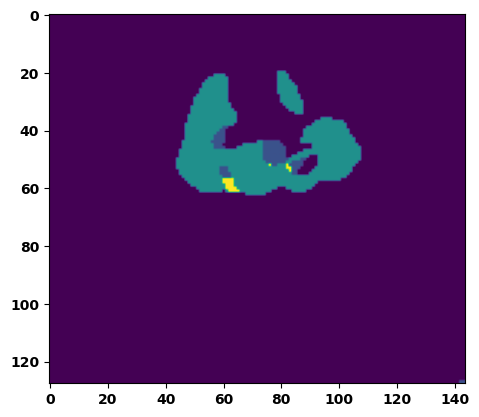

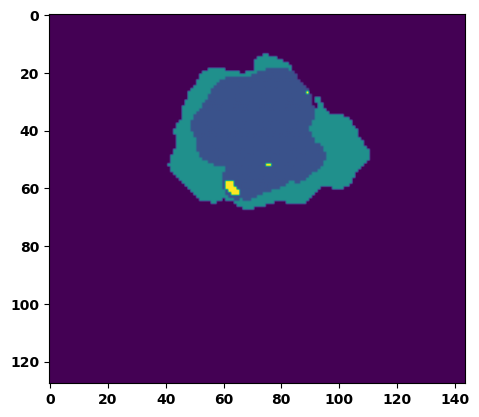

  6%|▌         | 2/36 [00:03<00:51,  1.51s/it]

Batch_id:  1 Eval loss:  0.1029498428106308
Batch_id:  1 Eval IoU:  tensor(0.8254, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9896, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:45,  1.39s/it]

Batch_id:  2 Eval loss:  0.09582605957984924
Batch_id:  2 Eval IoU:  tensor(0.8415, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 11%|█         | 4/36 [00:05<00:44,  1.38s/it]

Batch_id:  3 Eval loss:  0.17303763329982758
Batch_id:  3 Eval IoU:  tensor(0.7609, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9948, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.46s/it]

Batch_id:  4 Eval loss:  0.11584901809692383
Batch_id:  4 Eval IoU:  tensor(0.8126, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:42,  1.43s/it]

Batch_id:  5 Eval loss:  0.7392619252204895
Batch_id:  5 Eval IoU:  tensor(0.2412, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9235, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9960, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:41,  1.43s/it]

Batch_id:  6 Eval loss:  0.21971432864665985
Batch_id:  6 Eval IoU:  tensor(0.6839, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9785, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.44s/it]

Batch_id:  7 Eval loss:  0.08474862575531006
Batch_id:  7 Eval IoU:  tensor(0.8555, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


 25%|██▌       | 9/36 [00:12<00:38,  1.43s/it]

Batch_id:  8 Eval loss:  0.1849341094493866
Batch_id:  8 Eval IoU:  tensor(0.7274, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9960, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:37,  1.45s/it]

Batch_id:  9 Eval loss:  0.07713441550731659
Batch_id:  9 Eval IoU:  tensor(0.8859, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  10 Eval loss:  0.2785015106201172
Batch_id:  10 Eval IoU:  tensor(0.6291, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9553, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


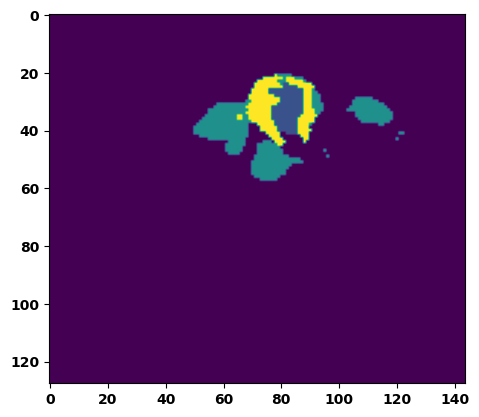

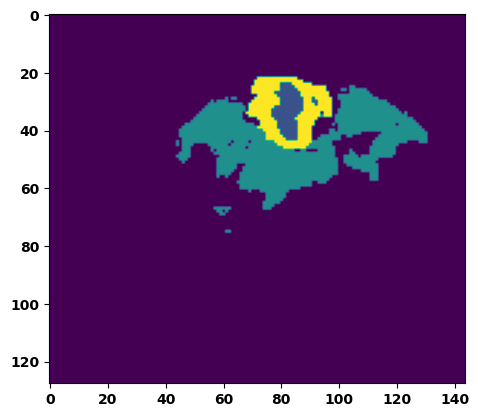

 33%|███▎      | 12/36 [00:17<00:36,  1.52s/it]

Batch_id:  11 Eval loss:  0.2006559520959854
Batch_id:  11 Eval IoU:  tensor(0.6992, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9872, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.52s/it]

Batch_id:  12 Eval loss:  0.22799016535282135
Batch_id:  12 Eval IoU:  tensor(0.6518, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9457, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9441, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9822, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.44s/it]

Batch_id:  13 Eval loss:  0.07497306168079376
Batch_id:  13 Eval IoU:  tensor(0.8872, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:31,  1.48s/it]

Batch_id:  14 Eval loss:  0.19423657655715942
Batch_id:  14 Eval IoU:  tensor(0.7208, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9886, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.48s/it]

Batch_id:  15 Eval loss:  0.17187662422657013
Batch_id:  15 Eval IoU:  tensor(0.7370, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:28,  1.50s/it]

Batch_id:  16 Eval loss:  0.5794245004653931
Batch_id:  16 Eval IoU:  tensor(0.3654, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.45s/it]

Batch_id:  17 Eval loss:  0.08326002955436707
Batch_id:  17 Eval IoU:  tensor(0.8595, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.44s/it]

Batch_id:  18 Eval loss:  0.06151968240737915
Batch_id:  18 Eval IoU:  tensor(0.8957, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:22,  1.39s/it]

Batch_id:  19 Eval loss:  0.24708040058612823
Batch_id:  19 Eval IoU:  tensor(0.7091, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  20 Eval loss:  0.13468436896800995
Batch_id:  20 Eval IoU:  tensor(0.7783, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9871, device='cuda:0')


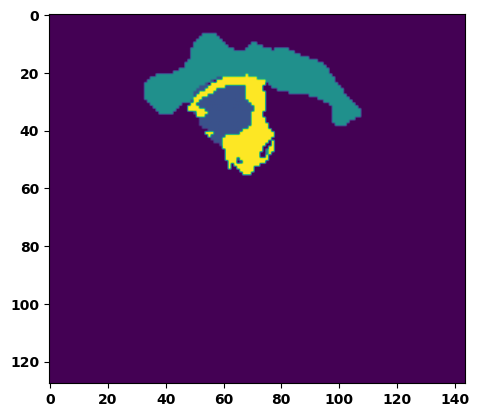

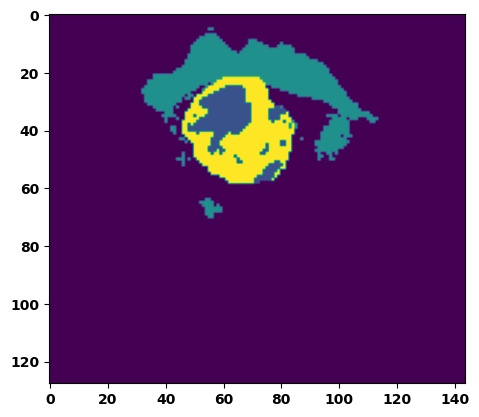

 61%|██████    | 22/36 [00:31<00:19,  1.42s/it]

Batch_id:  21 Eval loss:  0.12084729969501495
Batch_id:  21 Eval IoU:  tensor(0.8008, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.47s/it]

Batch_id:  22 Eval loss:  0.21771779656410217
Batch_id:  22 Eval IoU:  tensor(0.6913, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9881, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:17,  1.44s/it]

Batch_id:  23 Eval loss:  0.25236111879348755
Batch_id:  23 Eval IoU:  tensor(0.6533, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.44s/it]

Batch_id:  24 Eval loss:  0.12660662829875946
Batch_id:  24 Eval IoU:  tensor(0.8045, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 72%|███████▏  | 26/36 [00:37<00:13,  1.40s/it]

Batch_id:  25 Eval loss:  0.18119016289710999
Batch_id:  25 Eval IoU:  tensor(0.7264, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:12,  1.43s/it]

Batch_id:  26 Eval loss:  0.40940070152282715
Batch_id:  26 Eval IoU:  tensor(0.5275, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9049, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.8588, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.8578, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.44s/it]

Batch_id:  27 Eval loss:  0.15001344680786133
Batch_id:  27 Eval IoU:  tensor(0.7781, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 81%|████████  | 29/36 [00:41<00:09,  1.40s/it]

Batch_id:  28 Eval loss:  0.2147904336452484
Batch_id:  28 Eval IoU:  tensor(0.6917, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.44s/it]

Batch_id:  29 Eval loss:  0.35932236909866333
Batch_id:  29 Eval IoU:  tensor(0.5199, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9466, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9329, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9288, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  30 Eval loss:  0.2091129869222641
Batch_id:  30 Eval IoU:  tensor(0.7087, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9974, device='cuda:0')


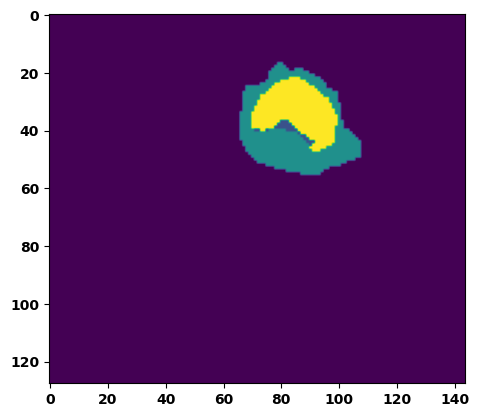

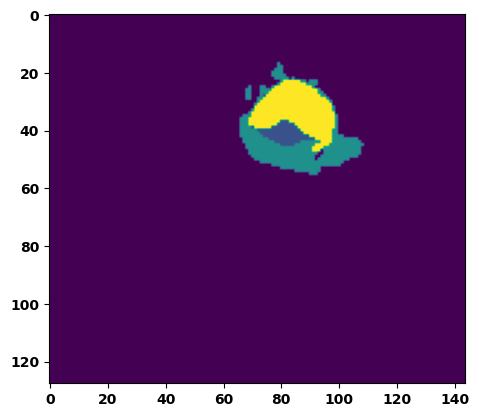

 86%|████████▌ | 31/36 [00:45<00:07,  1.49s/it]

Batch_id:  31 Eval loss:  0.08232545852661133
Batch_id:  31 Eval IoU:  

 89%|████████▉ | 32/36 [00:46<00:06,  1.58s/it]

tensor(0.8573, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9895, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.50s/it]

Batch_id:  32 Eval loss:  0.38132885098457336
Batch_id:  32 Eval IoU:  tensor(0.5451, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.42s/it]

Batch_id:  33 Eval loss:  0.08254726231098175
Batch_id:  33 Eval IoU:  tensor(0.8652, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9872, device='cuda:0')


 97%|█████████▋| 35/36 [00:50<00:01,  1.44s/it]

Batch_id:  34 Eval loss:  0.399616539478302
Batch_id:  34 Eval IoU:  tensor(0.5284, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.45s/it]

Batch_id:  35 Eval loss:  0.17037688195705414
Batch_id:  35 Eval IoU:  tensor(0.7525, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')
Epoch  25 Training loss:  0.1776522094553167
Epoch  25 Evaluation loss:  0.217595794548591
Epoch  25 Training accuracy :  tensor(0.7503)
Epoch  25 Evaluation accuracy :  tensor(0.7077)
Epoch  25 Training Mean Dice Score:  tensor(0.9797)
Epoch  25 Eval Mean Dice Score:  tensor(0.9734)
Epoch  25 Training Non-tumor Dice Score:  tensor(0.9814)
Epoch  25 Eval Non-tumor Dice Score:  tensor(0.9720)
Epoch  25 Training NCR/NET Dice Score:  tensor(0.9905)
Epoch  25 Eval NCR/NET Dice Score:  tensor(0.9875)
Epoch  25 Training ED Dice Score:  tensor(0.976

Epoch: 26
Training in session: 


  1%|          | 1/110 [00:01<03:17,  1.82s/it]

Batch_id:  0 Training loss:  0.10431694984436035
Batch_id:  0 Training IoU:  tensor(0.8250, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:46,  1.54s/it]

Batch_id:  1 Training loss:  0.10651831328868866
Batch_id:  1 Training IoU:  tensor(0.8216, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:45,  1.55s/it]

Batch_id:  2 Training loss:  0.20419715344905853
Batch_id:  2 Training IoU:  tensor(0.7104, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:37,  1.49s/it]

Batch_id:  3 Training loss:  0.48854777216911316
Batch_id:  3 Training IoU:  tensor(0.4331, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:38,  1.50s/it]

Batch_id:  4 Training loss:  0.15932637453079224
Batch_id:  4 Training IoU:  tensor(0.7486, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9716, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:36,  1.50s/it]

Batch_id:  5 Training loss:  0.10804647207260132
Batch_id:  5 Training IoU:  tensor(0.8342, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:31,  1.47s/it]

Batch_id:  6 Training loss:  0.1316746473312378
Batch_id:  6 Training IoU:  tensor(0.7922, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:30,  1.47s/it]

Batch_id:  7 Training loss:  0.22568227350711823
Batch_id:  7 Training IoU:  tensor(0.6713, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:30,  1.49s/it]

Batch_id:  8 Training loss:  0.18495234847068787
Batch_id:  8 Training IoU:  tensor(0.7104, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:29,  1.49s/it]

Batch_id:  9 Training loss:  0.3550042510032654
Batch_id:  9 Training IoU:  tensor(0.6325, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 10%|█         | 11/110 [00:16<02:27,  1.49s/it]

Batch_id:  10 Training loss:  0.09373387694358826
Batch_id:  10 Training IoU:  tensor(0.8445, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 11%|█         | 12/110 [00:18<02:27,  1.50s/it]

Batch_id:  11 Training loss:  0.24025265872478485
Batch_id:  11 Training IoU:  tensor(0.6627, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:26,  1.51s/it]

Batch_id:  12 Training loss:  0.10716143250465393
Batch_id:  12 Training IoU:  tensor(0.8209, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:18,  1.44s/it]

Batch_id:  13 Training loss:  0.1597229689359665
Batch_id:  13 Training IoU:  tensor(0.7446, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:18,  1.46s/it]

Batch_id:  14 Training loss:  0.08220583200454712
Batch_id:  14 Training IoU:  tensor(0.8789, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:16,  1.46s/it]

Batch_id:  15 Training loss:  0.09955330193042755
Batch_id:  15 Training IoU:  tensor(0.8647, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:12,  1.42s/it]

Batch_id:  16 Training loss:  0.30846309661865234
Batch_id:  16 Training IoU:  tensor(0.6331, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:10,  1.42s/it]

Batch_id:  17 Training loss:  0.11986348032951355
Batch_id:  17 Training IoU:  tensor(0.8029, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:11,  1.44s/it]

Batch_id:  18 Training loss:  0.16168834269046783
Batch_id:  18 Training IoU:  tensor(0.7890, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9987, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:12,  1.48s/it]

Batch_id:  19 Training loss:  0.2773479223251343
Batch_id:  19 Training IoU:  tensor(0.6381, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:09,  1.46s/it]

Batch_id:  20 Training loss:  0.059026673436164856
Batch_id:  20 Training IoU:  tensor(0.9032, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 20%|██        | 22/110 [00:32<02:08,  1.46s/it]

Batch_id:  21 Training loss:  0.25007450580596924
Batch_id:  21 Training IoU:  tensor(0.6337, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9360, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9321, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9751, device='cuda:0')


 21%|██        | 23/110 [00:34<02:10,  1.50s/it]

Batch_id:  22 Training loss:  0.12130796909332275
Batch_id:  22 Training IoU:  tensor(0.7971, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9522, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:03,  1.44s/it]

Batch_id:  23 Training loss:  0.07776610553264618
Batch_id:  23 Training IoU:  tensor(0.8669, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:00,  1.42s/it]

Batch_id:  24 Training loss:  0.1000790148973465
Batch_id:  24 Training IoU:  tensor(0.8381, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 24%|██▎       | 26/110 [00:38<01:56,  1.39s/it]

Batch_id:  25 Training loss:  0.04976798593997955
Batch_id:  25 Training IoU:  tensor(0.9162, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 25%|██▍       | 27/110 [00:39<01:54,  1.37s/it]

Batch_id:  26 Training loss:  0.19389227032661438
Batch_id:  26 Training IoU:  tensor(0.7095, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 25%|██▌       | 28/110 [00:40<01:54,  1.39s/it]

Batch_id:  27 Training loss:  0.23795485496520996
Batch_id:  27 Training IoU:  tensor(0.6499, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:52,  1.39s/it]

Batch_id:  28 Training loss:  0.09256851673126221
Batch_id:  28 Training IoU:  tensor(0.8434, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:50,  1.39s/it]

Batch_id:  29 Training loss:  0.26650235056877136
Batch_id:  29 Training IoU:  tensor(0.6367, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:47,  1.36s/it]

Batch_id:  30 Training loss:  0.20186397433280945
Batch_id:  30 Training IoU:  tensor(0.7017, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:50,  1.41s/it]

Batch_id:  31 Training loss:  0.1607627421617508
Batch_id:  31 Training IoU:  tensor(0.7795, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 30%|███       | 33/110 [00:47<01:50,  1.43s/it]

Batch_id:  32 Training loss:  0.08720304071903229
Batch_id:  32 Training IoU:  tensor(0.8516, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 31%|███       | 34/110 [00:49<01:50,  1.45s/it]

Batch_id:  33 Training loss:  0.1429833322763443
Batch_id:  33 Training IoU:  tensor(0.7673, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:50,  1.47s/it]

Batch_id:  34 Training loss:  0.04483877122402191
Batch_id:  34 Training IoU:  tensor(0.9237, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:51,  1.51s/it]

Batch_id:  35 Training loss:  0.15123440325260162
Batch_id:  35 Training IoU:  tensor(0.7818, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:48,  1.49s/it]

Batch_id:  36 Training loss:  0.15357957780361176
Batch_id:  36 Training IoU:  tensor(0.7680, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:48,  1.51s/it]

Batch_id:  37 Training loss:  0.09257589280605316
Batch_id:  37 Training IoU:  tensor(0.8512, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:46,  1.50s/it]

Batch_id:  38 Training loss:  0.10200877487659454
Batch_id:  38 Training IoU:  tensor(0.8259, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:42,  1.47s/it]

Batch_id:  39 Training loss:  0.1706286519765854
Batch_id:  39 Training IoU:  tensor(0.7307, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9809, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:40,  1.46s/it]

Batch_id:  40 Training loss:  0.24001874029636383
Batch_id:  40 Training IoU:  tensor(0.6560, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9820, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:38,  1.44s/it]

Batch_id:  41 Training loss:  0.15144842863082886
Batch_id:  41 Training IoU:  tensor(0.7525, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9720, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:38,  1.48s/it]

Batch_id:  42 Training loss:  0.22475816309452057
Batch_id:  42 Training IoU:  tensor(0.6603, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9352, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9341, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9176, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 40%|████      | 44/110 [01:04<01:38,  1.49s/it]

Batch_id:  43 Training loss:  0.1567915827035904
Batch_id:  43 Training IoU:  tensor(0.7698, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 41%|████      | 45/110 [01:05<01:38,  1.52s/it]

Batch_id:  44 Training loss:  0.14358019828796387
Batch_id:  44 Training IoU:  tensor(0.7781, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:38,  1.53s/it]

Batch_id:  45 Training loss:  0.1374179869890213
Batch_id:  45 Training IoU:  tensor(0.7958, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:36,  1.53s/it]

Batch_id:  46 Training loss:  0.2704482078552246
Batch_id:  46 Training IoU:  tensor(0.6232, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9447, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9476, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9754, device='cuda:0')


 44%|████▎     | 48/110 [01:10<01:30,  1.47s/it]

Batch_id:  47 Training loss:  0.10050886869430542
Batch_id:  47 Training IoU:  tensor(0.8328, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:33,  1.53s/it]

Batch_id:  48 Training loss:  0.238639697432518
Batch_id:  48 Training IoU:  tensor(0.7081, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:29,  1.49s/it]

Batch_id:  49 Training loss:  0.14598694443702698
Batch_id:  49 Training IoU:  tensor(0.7659, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:25,  1.45s/it]

Batch_id:  50 Training loss:  0.18863612413406372
Batch_id:  50 Training IoU:  tensor(0.7205, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:24,  1.46s/it]

Batch_id:  51 Training loss:  0.27534109354019165
Batch_id:  51 Training IoU:  tensor(0.6682, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:25,  1.49s/it]

Batch_id:  52 Training loss:  0.28273749351501465
Batch_id:  52 Training IoU:  tensor(0.6163, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:24,  1.51s/it]

Batch_id:  53 Training loss:  0.33826786279678345
Batch_id:  53 Training IoU:  tensor(0.5969, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 50%|█████     | 55/110 [01:20<01:22,  1.51s/it]

Batch_id:  54 Training loss:  0.11518052220344543
Batch_id:  54 Training IoU:  tensor(0.8122, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 51%|█████     | 56/110 [01:22<01:21,  1.52s/it]

Batch_id:  55 Training loss:  0.13351662456989288
Batch_id:  55 Training IoU:  tensor(0.8026, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:21,  1.53s/it]

Batch_id:  56 Training loss:  0.1914500743150711
Batch_id:  56 Training IoU:  tensor(0.7118, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 53%|█████▎    | 58/110 [01:25<01:20,  1.55s/it]

Batch_id:  57 Training loss:  0.18026413023471832
Batch_id:  57 Training IoU:  tensor(0.7688, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 54%|█████▎    | 59/110 [01:27<01:18,  1.54s/it]

Batch_id:  58 Training loss:  0.12889160215854645
Batch_id:  58 Training IoU:  tensor(0.7906, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:14,  1.49s/it]

Batch_id:  59 Training loss:  0.2136622965335846
Batch_id:  59 Training IoU:  tensor(0.6817, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 55%|█████▌    | 61/110 [01:30<01:14,  1.52s/it]

Batch_id:  60 Training loss:  0.20394113659858704
Batch_id:  60 Training IoU:  tensor(0.7603, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:13,  1.52s/it]

Batch_id:  61 Training loss:  0.046374619007110596
Batch_id:  61 Training IoU:  tensor(0.9210, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 57%|█████▋    | 63/110 [01:33<01:11,  1.51s/it]

Batch_id:  62 Training loss:  0.37657812237739563
Batch_id:  62 Training IoU:  tensor(0.5718, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:09,  1.51s/it]

Batch_id:  63 Training loss:  0.17363837361335754
Batch_id:  63 Training IoU:  tensor(0.7331, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 59%|█████▉    | 65/110 [01:36<01:08,  1.52s/it]

Batch_id:  64 Training loss:  0.08721312880516052
Batch_id:  64 Training IoU:  tensor(0.8589, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:06,  1.51s/it]

Batch_id:  65 Training loss:  0.17622582614421844
Batch_id:  65 Training IoU:  tensor(0.7172, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9810, device='cuda:0')


 61%|██████    | 67/110 [01:39<01:05,  1.52s/it]

Batch_id:  66 Training loss:  0.06070151925086975
Batch_id:  66 Training IoU:  tensor(0.9005, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 62%|██████▏   | 68/110 [01:40<01:04,  1.52s/it]

Batch_id:  67 Training loss:  0.09342847764492035
Batch_id:  67 Training IoU:  tensor(0.8421, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 63%|██████▎   | 69/110 [01:42<01:03,  1.55s/it]

Batch_id:  68 Training loss:  0.1340848207473755
Batch_id:  68 Training IoU:  tensor(0.8073, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 64%|██████▎   | 70/110 [01:43<01:03,  1.58s/it]

Batch_id:  69 Training loss:  0.12032140791416168
Batch_id:  69 Training IoU:  tensor(0.8085, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 65%|██████▍   | 71/110 [01:45<01:00,  1.55s/it]

Batch_id:  70 Training loss:  0.2227831482887268
Batch_id:  70 Training IoU:  tensor(0.7071, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 65%|██████▌   | 72/110 [01:46<00:57,  1.51s/it]

Batch_id:  71 Training loss:  0.2559995651245117
Batch_id:  71 Training IoU:  tensor(0.6747, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 66%|██████▋   | 73/110 [01:48<00:55,  1.49s/it]

Batch_id:  72 Training loss:  0.11422494053840637
Batch_id:  72 Training IoU:  tensor(0.8278, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:55,  1.53s/it]

Batch_id:  73 Training loss:  0.4005008637905121
Batch_id:  73 Training IoU:  tensor(0.5239, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 68%|██████▊   | 75/110 [01:51<00:53,  1.53s/it]

Batch_id:  74 Training loss:  0.2848079204559326
Batch_id:  74 Training IoU:  tensor(0.6709, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:50,  1.50s/it]

Batch_id:  75 Training loss:  0.052095815539360046
Batch_id:  75 Training IoU:  tensor(0.9133, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 70%|███████   | 77/110 [01:54<00:49,  1.51s/it]

Batch_id:  76 Training loss:  0.28874534368515015
Batch_id:  76 Training IoU:  tensor(0.5915, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9684, device='cuda:0')


 71%|███████   | 78/110 [01:56<00:49,  1.56s/it]

Batch_id:  77 Training loss:  0.0839555561542511
Batch_id:  77 Training IoU:  tensor(0.8615, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:46,  1.51s/it]

Batch_id:  78 Training loss:  0.3749370574951172
Batch_id:  78 Training IoU:  tensor(0.5544, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 73%|███████▎  | 80/110 [01:59<00:45,  1.53s/it]

Batch_id:  79 Training loss:  0.17341305315494537
Batch_id:  79 Training IoU:  tensor(0.7318, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9785, device='cuda:0')


 74%|███████▎  | 81/110 [02:00<00:43,  1.49s/it]

Batch_id:  80 Training loss:  0.0783957839012146
Batch_id:  80 Training IoU:  tensor(0.8644, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 75%|███████▍  | 82/110 [02:01<00:41,  1.49s/it]

Batch_id:  81 Training loss:  0.11165882647037506
Batch_id:  81 Training IoU:  tensor(0.8187, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 75%|███████▌  | 83/110 [02:03<00:40,  1.51s/it]

Batch_id:  82 Training loss:  0.10487465560436249
Batch_id:  82 Training IoU:  tensor(0.8225, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 76%|███████▋  | 84/110 [02:05<00:40,  1.55s/it]

Batch_id:  83 Training loss:  0.15612579882144928
Batch_id:  83 Training IoU:  tensor(0.7588, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 77%|███████▋  | 85/110 [02:06<00:39,  1.58s/it]

Batch_id:  84 Training loss:  0.06914468109607697
Batch_id:  84 Training IoU:  tensor(0.8837, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 78%|███████▊  | 86/110 [02:08<00:37,  1.58s/it]

Batch_id:  85 Training loss:  0.09233260154724121
Batch_id:  85 Training IoU:  tensor(0.8437, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 79%|███████▉  | 87/110 [02:09<00:36,  1.57s/it]

Batch_id:  86 Training loss:  0.212752565741539
Batch_id:  86 Training IoU:  tensor(0.6713, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 80%|████████  | 88/110 [02:11<00:33,  1.54s/it]

Batch_id:  87 Training loss:  0.11491124331951141
Batch_id:  87 Training IoU:  tensor(0.8112, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9766, device='cuda:0')


 81%|████████  | 89/110 [02:12<00:32,  1.55s/it]

Batch_id:  88 Training loss:  0.32816141843795776
Batch_id:  88 Training IoU:  tensor(0.6182, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 82%|████████▏ | 90/110 [02:14<00:30,  1.52s/it]

Batch_id:  89 Training loss:  0.1760956346988678
Batch_id:  89 Training IoU:  tensor(0.7436, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 83%|████████▎ | 91/110 [02:16<00:30,  1.60s/it]

Batch_id:  90 Training loss:  0.2743401527404785
Batch_id:  90 Training IoU:  tensor(0.6265, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9560, device='cuda:0')


 84%|████████▎ | 92/110 [02:17<00:28,  1.56s/it]

Batch_id:  91 Training loss:  0.18988357484340668
Batch_id:  91 Training IoU:  tensor(0.7126, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 85%|████████▍ | 93/110 [02:19<00:25,  1.52s/it]

Batch_id:  92 Training loss:  0.13659775257110596
Batch_id:  92 Training IoU:  tensor(0.7778, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 85%|████████▌ | 94/110 [02:20<00:24,  1.51s/it]

Batch_id:  93 Training loss:  0.5110060572624207
Batch_id:  93 Training IoU:  tensor(0.4026, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9253, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9102, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.8885, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 86%|████████▋ | 95/110 [02:22<00:22,  1.53s/it]

Batch_id:  94 Training loss:  0.1099715381860733
Batch_id:  94 Training IoU:  tensor(0.8181, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 87%|████████▋ | 96/110 [02:23<00:21,  1.51s/it]

Batch_id:  95 Training loss:  0.1101384162902832
Batch_id:  95 Training IoU:  tensor(0.8152, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 88%|████████▊ | 97/110 [02:24<00:19,  1.47s/it]

Batch_id:  96 Training loss:  0.11074814200401306
Batch_id:  96 Training IoU:  tensor(0.8227, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 89%|████████▉ | 98/110 [02:26<00:17,  1.47s/it]

Batch_id:  97 Training loss:  0.10337240993976593
Batch_id:  97 Training IoU:  tensor(0.8249, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 90%|█████████ | 99/110 [02:27<00:16,  1.46s/it]

Batch_id:  98 Training loss:  0.2943577766418457
Batch_id:  98 Training IoU:  tensor(0.5903, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9186, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 91%|█████████ | 100/110 [02:29<00:14,  1.42s/it]

Batch_id:  99 Training loss:  0.24105188250541687
Batch_id:  99 Training IoU:  tensor(0.7172, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 92%|█████████▏| 101/110 [02:30<00:12,  1.37s/it]

Batch_id:  100 Training loss:  0.14046141505241394
Batch_id:  100 Training IoU:  tensor(0.8044, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 93%|█████████▎| 102/110 [02:31<00:10,  1.37s/it]

Batch_id:  101 Training loss:  0.12721170485019684
Batch_id:  101 Training IoU:  tensor(0.8054, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 94%|█████████▎| 103/110 [02:33<00:10,  1.45s/it]

Batch_id:  102 Training loss:  0.22637306153774261
Batch_id:  102 Training IoU:  tensor(0.7384, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 95%|█████████▍| 104/110 [02:35<00:08,  1.48s/it]

Batch_id:  103 Training loss:  0.1892876774072647
Batch_id:  103 Training IoU:  tensor(0.7785, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 95%|█████████▌| 105/110 [02:36<00:07,  1.48s/it]

Batch_id:  104 Training loss:  0.14548596739768982
Batch_id:  104 Training IoU:  tensor(0.7746, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 96%|█████████▋| 106/110 [02:37<00:05,  1.46s/it]

Batch_id:  105 Training loss:  0.1962098479270935
Batch_id:  105 Training IoU:  tensor(0.7114, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9818, device='cuda:0')


 97%|█████████▋| 107/110 [02:39<00:04,  1.47s/it]

Batch_id:  106 Training loss:  0.5377445220947266
Batch_id:  106 Training IoU:  tensor(0.4060, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 98%|█████████▊| 108/110 [02:40<00:02,  1.44s/it]

Batch_id:  107 Training loss:  0.1938818246126175
Batch_id:  107 Training IoU:  tensor(0.7058, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9391, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9739, device='cuda:0')


 99%|█████████▉| 109/110 [02:42<00:01,  1.45s/it]

Batch_id:  108 Training loss:  0.14481987059116364
Batch_id:  108 Training IoU:  tensor(0.7842, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


100%|██████████| 110/110 [02:44<00:00,  1.49s/it]


Batch_id:  109 Training loss:  0.06200931966304779
Batch_id:  109 Training IoU:  tensor(0.8954, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9929, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.39792853593826294
Batch_id:  0 Eval IoU:  tensor(0.5376, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9091, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.8647, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.8640, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9987, device='cuda:0')


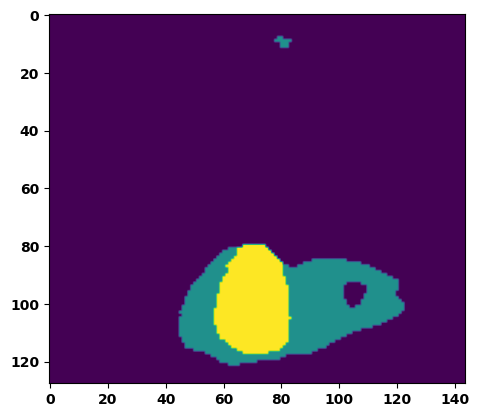

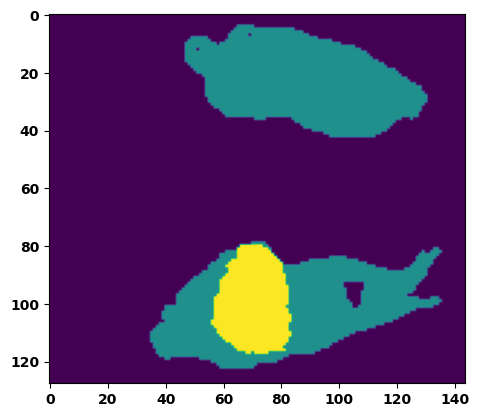

  6%|▌         | 2/36 [00:03<00:52,  1.54s/it]

Batch_id:  1 Eval loss:  0.11589276790618896
Batch_id:  1 Eval IoU:  tensor(0.8066, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:46,  1.42s/it]

Batch_id:  2 Eval loss:  0.16926151514053345
Batch_id:  2 Eval IoU:  tensor(0.7402, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9888, device='cuda:0')


 11%|█         | 4/36 [00:05<00:47,  1.48s/it]

Batch_id:  3 Eval loss:  0.11783009767532349
Batch_id:  3 Eval IoU:  tensor(0.8425, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9948, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.45s/it]

Batch_id:  4 Eval loss:  0.1590161919593811
Batch_id:  4 Eval IoU:  tensor(0.7579, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:43,  1.44s/it]

Batch_id:  5 Eval loss:  0.06468109786510468
Batch_id:  5 Eval IoU:  tensor(0.9006, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.46s/it]

Batch_id:  6 Eval loss:  0.38033586740493774
Batch_id:  6 Eval IoU:  tensor(0.5040, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9280, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9212, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.46s/it]

Batch_id:  7 Eval loss:  0.2034568190574646
Batch_id:  7 Eval IoU:  tensor(0.7099, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9887, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:38,  1.42s/it]

Batch_id:  8 Eval loss:  0.19708508253097534
Batch_id:  8 Eval IoU:  tensor(0.7152, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9960, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.46s/it]

Batch_id:  9 Eval loss:  0.09294579923152924
Batch_id:  9 Eval IoU:  tensor(0.8457, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  10 Eval loss:  0.08254848420619965
Batch_id:  10 Eval IoU:  tensor(0.8639, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')


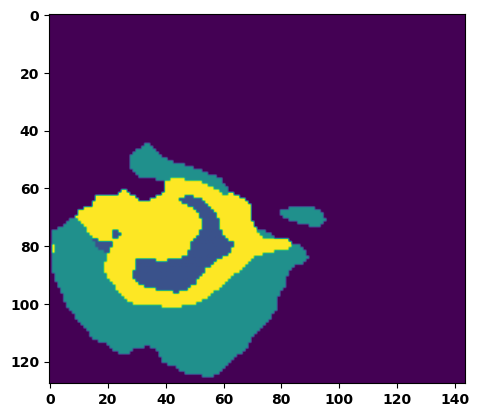

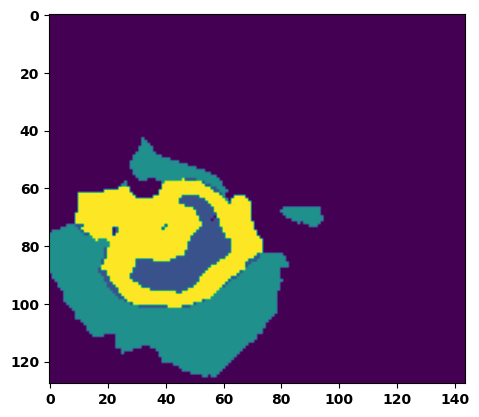

 33%|███▎      | 12/36 [00:17<00:36,  1.51s/it]

Batch_id:  11 Eval loss:  0.48618996143341064
Batch_id:  11 Eval IoU:  tensor(0.4172, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9382, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9436, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9318, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:33,  1.45s/it]

Batch_id:  12 Eval loss:  0.14397519826889038
Batch_id:  12 Eval IoU:  tensor(0.7721, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9948, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:32,  1.47s/it]

Batch_id:  13 Eval loss:  0.40659821033477783
Batch_id:  13 Eval IoU:  tensor(0.5222, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.48s/it]

Batch_id:  14 Eval loss:  0.25930070877075195
Batch_id:  14 Eval IoU:  tensor(0.6499, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9469, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9919, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:31,  1.56s/it]

Batch_id:  15 Eval loss:  0.06125767529010773
Batch_id:  15 Eval IoU:  tensor(0.8957, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9933, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:27,  1.47s/it]

Batch_id:  16 Eval loss:  0.08571986854076385
Batch_id:  16 Eval IoU:  tensor(0.8754, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:25,  1.41s/it]

Batch_id:  17 Eval loss:  0.23026902973651886
Batch_id:  17 Eval IoU:  tensor(0.6735, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9807, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:25,  1.49s/it]

Batch_id:  18 Eval loss:  0.23079951107501984
Batch_id:  18 Eval IoU:  tensor(0.6756, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:22,  1.40s/it]

Batch_id:  19 Eval loss:  0.1540328413248062
Batch_id:  19 Eval IoU:  tensor(0.7752, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  20 Eval loss:  0.21363526582717896
Batch_id:  20 Eval IoU:  tensor(0.6814, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9859, device='cuda:0')


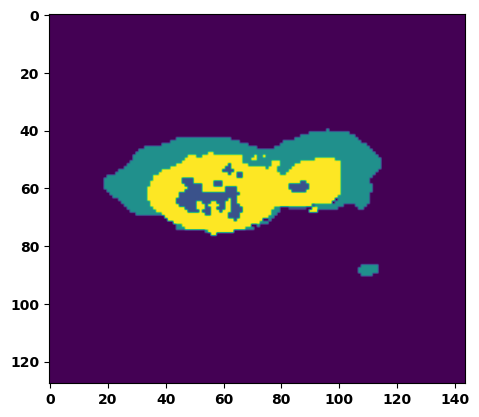

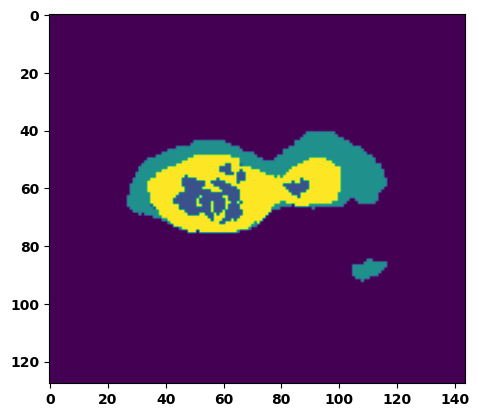

 61%|██████    | 22/36 [00:32<00:20,  1.43s/it]

Batch_id:  21 Eval loss:  0.5797159671783447
Batch_id:  21 Eval IoU:  tensor(0.3662, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.49s/it]

Batch_id:  22 Eval loss:  0.3729400634765625
Batch_id:  22 Eval IoU:  tensor(0.5582, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.45s/it]

Batch_id:  23 Eval loss:  0.2828356623649597
Batch_id:  23 Eval IoU:  tensor(0.6418, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.44s/it]

Batch_id:  24 Eval loss:  0.0778588354587555
Batch_id:  24 Eval IoU:  tensor(0.8647, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.50s/it]

Batch_id:  25 Eval loss:  0.231172576546669
Batch_id:  25 Eval IoU:  tensor(0.6782, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:12,  1.43s/it]

Batch_id:  26 Eval loss:  0.11883839964866638
Batch_id:  26 Eval IoU:  tensor(0.8124, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9473, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.43s/it]

Batch_id:  27 Eval loss:  0.08353835344314575
Batch_id:  27 Eval IoU:  tensor(0.8607, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:09,  1.41s/it]

Batch_id:  28 Eval loss:  0.2587243616580963
Batch_id:  28 Eval IoU:  tensor(0.6994, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.40s/it]

Batch_id:  29 Eval loss:  0.22249990701675415
Batch_id:  29 Eval IoU:  tensor(0.6583, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  30 Eval loss:  0.7188363671302795
Batch_id:  30 Eval IoU:  tensor(0.2533, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9275, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9339, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


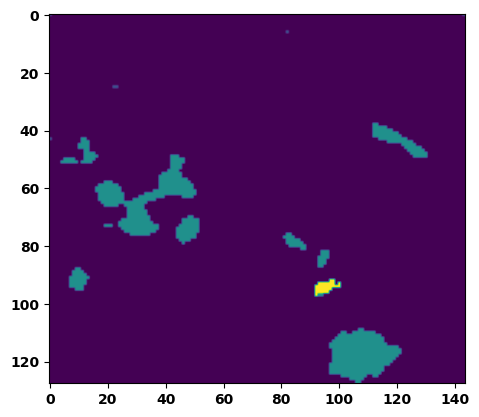

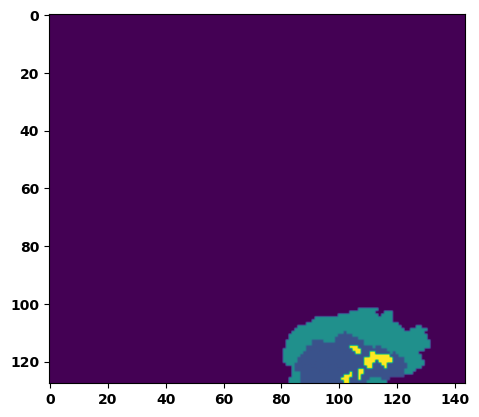

 89%|████████▉ | 32/36 [00:46<00:05,  1.46s/it]

Batch_id:  31 Eval loss:  0.11439099907875061
Batch_id:  31 Eval IoU:  tensor(0.8097, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.46s/it]

Batch_id:  32 Eval loss:  0.10644806921482086
Batch_id:  32 Eval IoU:  tensor(0.8190, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:03,  1.50s/it]

Batch_id:  33 Eval loss:  0.08391621708869934
Batch_id:  33 Eval IoU:  tensor(0.8567, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.43s/it]

Batch_id:  34 Eval loss:  0.2439882904291153
Batch_id:  34 Eval IoU:  tensor(0.6610, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9932, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.45s/it]

Batch_id:  35 Eval loss:  0.07007408142089844
Batch_id:  35 Eval IoU:  tensor(0.8801, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')
Epoch  26 Training loss:  0.17768911218101327
Epoch  26 Evaluation loss:  0.2171816300186846
Epoch  26 Training accuracy :  tensor(0.7497)
Epoch  26 Evaluation accuracy :  tensor(0.7106)
Epoch  26 Training Mean Dice Score:  tensor(0.9796)
Epoch  26 Eval Mean Dice Score:  tensor(0.9738)
Epoch  26 Training Non-tumor Dice Score:  tensor(0.9816)
Epoch  26 Eval Non-tumor Dice Score:  tensor(0.9726)
Epoch  26 Training NCR/NET Dice Score:  tensor(0.9900)
Epoch  26 Eval NCR/NET Dice Score:  tensor(0.9880)
Epoch  26 Training ED Dice Score:  tensor(0.9

Epoch: 27
Training in session: 


  1%|          | 1/110 [00:01<02:48,  1.54s/it]

Batch_id:  0 Training loss:  0.13318847119808197
Batch_id:  0 Training IoU:  tensor(0.8089, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:34,  1.43s/it]

Batch_id:  1 Training loss:  0.18017424643039703
Batch_id:  1 Training IoU:  tensor(0.7372, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:40,  1.50s/it]

Batch_id:  2 Training loss:  0.19072140753269196
Batch_id:  2 Training IoU:  tensor(0.7564, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:34,  1.46s/it]

Batch_id:  3 Training loss:  0.058344706892967224
Batch_id:  3 Training IoU:  tensor(0.9051, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:40,  1.52s/it]

Batch_id:  4 Training loss:  0.1437840759754181
Batch_id:  4 Training IoU:  tensor(0.7808, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:39,  1.54s/it]

Batch_id:  5 Training loss:  0.05398169159889221
Batch_id:  5 Training IoU:  tensor(0.9144, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:43,  1.59s/it]

Batch_id:  6 Training loss:  0.22218139469623566
Batch_id:  6 Training IoU:  tensor(0.6651, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9351, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9358, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9160, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:37,  1.54s/it]

Batch_id:  7 Training loss:  0.26043039560317993
Batch_id:  7 Training IoU:  tensor(0.6451, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:37,  1.56s/it]

Batch_id:  8 Training loss:  0.20931819081306458
Batch_id:  8 Training IoU:  tensor(0.7800, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9980, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:35,  1.55s/it]

Batch_id:  9 Training loss:  0.18998046219348907
Batch_id:  9 Training IoU:  tensor(0.7879, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 10%|█         | 11/110 [00:16<02:25,  1.47s/it]

Batch_id:  10 Training loss:  0.1507095843553543
Batch_id:  10 Training IoU:  tensor(0.7596, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 11%|█         | 12/110 [00:18<02:28,  1.51s/it]

Batch_id:  11 Training loss:  0.171925887465477
Batch_id:  11 Training IoU:  tensor(0.8157, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:24,  1.49s/it]

Batch_id:  12 Training loss:  0.36951902508735657
Batch_id:  12 Training IoU:  tensor(0.6136, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9997, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:27,  1.53s/it]

Batch_id:  13 Training loss:  0.2744101583957672
Batch_id:  13 Training IoU:  tensor(0.6414, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:26,  1.55s/it]

Batch_id:  14 Training loss:  0.18076325953006744
Batch_id:  14 Training IoU:  tensor(0.7349, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:24,  1.54s/it]

Batch_id:  15 Training loss:  0.10695236921310425
Batch_id:  15 Training IoU:  tensor(0.8221, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:21,  1.52s/it]

Batch_id:  16 Training loss:  0.2877139449119568
Batch_id:  16 Training IoU:  tensor(0.6643, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:14,  1.46s/it]

Batch_id:  17 Training loss:  0.18477915227413177
Batch_id:  17 Training IoU:  tensor(0.7109, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:10,  1.43s/it]

Batch_id:  18 Training loss:  0.28978583216667175
Batch_id:  18 Training IoU:  tensor(0.6146, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:05,  1.40s/it]

Batch_id:  19 Training loss:  0.12522456049919128
Batch_id:  19 Training IoU:  tensor(0.8025, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:05,  1.41s/it]

Batch_id:  20 Training loss:  0.3965393900871277
Batch_id:  20 Training IoU:  tensor(0.5290, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 20%|██        | 22/110 [00:32<02:04,  1.42s/it]

Batch_id:  21 Training loss:  0.12739501893520355
Batch_id:  21 Training IoU:  tensor(0.8024, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 21%|██        | 23/110 [00:34<02:06,  1.46s/it]

Batch_id:  22 Training loss:  0.10997599363327026
Batch_id:  22 Training IoU:  tensor(0.8366, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:01,  1.41s/it]

Batch_id:  23 Training loss:  0.37967827916145325
Batch_id:  23 Training IoU:  tensor(0.5697, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9989, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:00,  1.42s/it]

Batch_id:  24 Training loss:  0.30553245544433594
Batch_id:  24 Training IoU:  tensor(0.6394, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9989, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:03,  1.47s/it]

Batch_id:  25 Training loss:  0.04626584053039551
Batch_id:  25 Training IoU:  tensor(0.9215, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 25%|██▍       | 27/110 [00:40<01:59,  1.44s/it]

Batch_id:  26 Training loss:  0.2632824182510376
Batch_id:  26 Training IoU:  tensor(0.6338, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 25%|██▌       | 28/110 [00:41<01:56,  1.42s/it]

Batch_id:  27 Training loss:  0.06772249937057495
Batch_id:  27 Training IoU:  tensor(0.8869, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:54,  1.42s/it]

Batch_id:  28 Training loss:  0.24100714921951294
Batch_id:  28 Training IoU:  tensor(0.6572, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:51,  1.40s/it]

Batch_id:  29 Training loss:  0.14127479493618011
Batch_id:  29 Training IoU:  tensor(0.7796, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:48,  1.37s/it]

Batch_id:  30 Training loss:  0.235718235373497
Batch_id:  30 Training IoU:  tensor(0.7257, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:49,  1.40s/it]

Batch_id:  31 Training loss:  0.18327654898166656
Batch_id:  31 Training IoU:  tensor(0.7126, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 30%|███       | 33/110 [00:48<01:49,  1.42s/it]

Batch_id:  32 Training loss:  0.0820126086473465
Batch_id:  32 Training IoU:  tensor(0.8793, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 31%|███       | 34/110 [00:49<01:47,  1.42s/it]

Batch_id:  33 Training loss:  0.07341642677783966
Batch_id:  33 Training IoU:  tensor(0.8734, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:45,  1.41s/it]

Batch_id:  34 Training loss:  0.5256079435348511
Batch_id:  34 Training IoU:  tensor(0.4221, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:44,  1.41s/it]

Batch_id:  35 Training loss:  0.19187825918197632
Batch_id:  35 Training IoU:  tensor(0.7093, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:43,  1.42s/it]

Batch_id:  36 Training loss:  0.13781967759132385
Batch_id:  36 Training IoU:  tensor(0.7837, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:39,  1.39s/it]

Batch_id:  37 Training loss:  0.1659659594297409
Batch_id:  37 Training IoU:  tensor(0.7844, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9987, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:39,  1.40s/it]

Batch_id:  38 Training loss:  0.22129672765731812
Batch_id:  38 Training IoU:  tensor(0.7076, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:40,  1.44s/it]

Batch_id:  39 Training loss:  0.33272701501846313
Batch_id:  39 Training IoU:  tensor(0.6047, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:38,  1.42s/it]

Batch_id:  40 Training loss:  0.16052037477493286
Batch_id:  40 Training IoU:  tensor(0.7471, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9712, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:36,  1.41s/it]

Batch_id:  41 Training loss:  0.07802891731262207
Batch_id:  41 Training IoU:  tensor(0.8664, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:32,  1.38s/it]

Batch_id:  42 Training loss:  0.10321277379989624
Batch_id:  42 Training IoU:  tensor(0.8272, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 40%|████      | 44/110 [01:03<01:34,  1.44s/it]

Batch_id:  43 Training loss:  0.32135045528411865
Batch_id:  43 Training IoU:  tensor(0.6264, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 41%|████      | 45/110 [01:05<01:32,  1.42s/it]

Batch_id:  44 Training loss:  0.20695586502552032
Batch_id:  44 Training IoU:  tensor(0.6926, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:35,  1.49s/it]

Batch_id:  45 Training loss:  0.1316881626844406
Batch_id:  45 Training IoU:  tensor(0.7858, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:29,  1.42s/it]

Batch_id:  46 Training loss:  0.27471691370010376
Batch_id:  46 Training IoU:  tensor(0.6159, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9260, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:28,  1.43s/it]

Batch_id:  47 Training loss:  0.477518230676651
Batch_id:  47 Training IoU:  tensor(0.4462, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:27,  1.43s/it]

Batch_id:  48 Training loss:  0.102853924036026
Batch_id:  48 Training IoU:  tensor(0.8593, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:25,  1.43s/it]

Batch_id:  49 Training loss:  0.09617350995540619
Batch_id:  49 Training IoU:  tensor(0.8370, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:25,  1.46s/it]

Batch_id:  50 Training loss:  0.11908571422100067
Batch_id:  50 Training IoU:  tensor(0.8116, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:22,  1.43s/it]

Batch_id:  51 Training loss:  0.16209760308265686
Batch_id:  51 Training IoU:  tensor(0.7469, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9788, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:20,  1.41s/it]

Batch_id:  52 Training loss:  0.1381162703037262
Batch_id:  52 Training IoU:  tensor(0.7750, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:19,  1.42s/it]

Batch_id:  53 Training loss:  0.2827225923538208
Batch_id:  53 Training IoU:  tensor(0.6665, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:22,  1.50s/it]

Batch_id:  54 Training loss:  0.11114779114723206
Batch_id:  54 Training IoU:  tensor(0.8157, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:20,  1.48s/it]

Batch_id:  55 Training loss:  0.15894140303134918
Batch_id:  55 Training IoU:  tensor(0.7701, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 52%|█████▏    | 57/110 [01:22<01:15,  1.43s/it]

Batch_id:  56 Training loss:  0.2210739403963089
Batch_id:  56 Training IoU:  tensor(0.6789, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:18,  1.51s/it]

Batch_id:  57 Training loss:  0.10400252044200897
Batch_id:  57 Training IoU:  tensor(0.8244, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 54%|█████▎    | 59/110 [01:25<01:15,  1.48s/it]

Batch_id:  58 Training loss:  0.0996510237455368
Batch_id:  58 Training IoU:  tensor(0.8298, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 55%|█████▍    | 60/110 [01:27<01:13,  1.48s/it]

Batch_id:  59 Training loss:  0.1657712757587433
Batch_id:  59 Training IoU:  tensor(0.7368, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:14,  1.51s/it]

Batch_id:  60 Training loss:  0.09568101167678833
Batch_id:  60 Training IoU:  tensor(0.8380, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 56%|█████▋    | 62/110 [01:30<01:09,  1.45s/it]

Batch_id:  61 Training loss:  0.2071589082479477
Batch_id:  61 Training IoU:  tensor(0.6913, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:07,  1.44s/it]

Batch_id:  62 Training loss:  0.13155940175056458
Batch_id:  62 Training IoU:  tensor(0.7925, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 58%|█████▊    | 64/110 [01:33<01:08,  1.49s/it]

Batch_id:  63 Training loss:  0.2892768383026123
Batch_id:  63 Training IoU:  tensor(0.6124, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9543, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:10,  1.57s/it]

Batch_id:  64 Training loss:  0.13886915147304535
Batch_id:  64 Training IoU:  tensor(0.7939, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:08,  1.56s/it]

Batch_id:  65 Training loss:  0.23569683730602264
Batch_id:  65 Training IoU:  tensor(0.7114, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 61%|██████    | 67/110 [01:38<01:06,  1.55s/it]

Batch_id:  66 Training loss:  0.12707465887069702
Batch_id:  66 Training IoU:  tensor(0.8135, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 62%|██████▏   | 68/110 [01:39<01:03,  1.52s/it]

Batch_id:  67 Training loss:  0.23551064729690552
Batch_id:  67 Training IoU:  tensor(0.6524, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<01:01,  1.50s/it]

Batch_id:  68 Training loss:  0.4600883722305298
Batch_id:  68 Training IoU:  tensor(0.4509, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9381, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9275, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9078, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 64%|██████▎   | 70/110 [01:42<01:00,  1.51s/it]

Batch_id:  69 Training loss:  0.04423926770687103
Batch_id:  69 Training IoU:  tensor(0.9238, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 65%|██████▍   | 71/110 [01:43<00:58,  1.49s/it]

Batch_id:  70 Training loss:  0.18852749466896057
Batch_id:  70 Training IoU:  tensor(0.7192, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9817, device='cuda:0')


 65%|██████▌   | 72/110 [01:45<00:56,  1.49s/it]

Batch_id:  71 Training loss:  0.16197608411312103
Batch_id:  71 Training IoU:  tensor(0.7418, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:58,  1.57s/it]

Batch_id:  72 Training loss:  0.09709784388542175
Batch_id:  72 Training IoU:  tensor(0.8473, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:54,  1.52s/it]

Batch_id:  73 Training loss:  0.11103229224681854
Batch_id:  73 Training IoU:  tensor(0.8248, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 68%|██████▊   | 75/110 [01:50<00:52,  1.50s/it]

Batch_id:  74 Training loss:  0.24815212190151215
Batch_id:  74 Training IoU:  tensor(0.6825, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 69%|██████▉   | 76/110 [01:51<00:50,  1.48s/it]

Batch_id:  75 Training loss:  0.10295043885707855
Batch_id:  75 Training IoU:  tensor(0.8279, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9815, device='cuda:0')


 70%|███████   | 77/110 [01:53<00:49,  1.51s/it]

Batch_id:  76 Training loss:  0.18464545905590057
Batch_id:  76 Training IoU:  tensor(0.7082, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:47,  1.49s/it]

Batch_id:  77 Training loss:  0.13369393348693848
Batch_id:  77 Training IoU:  tensor(0.7934, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 72%|███████▏  | 79/110 [01:56<00:47,  1.52s/it]

Batch_id:  78 Training loss:  0.09843392670154572
Batch_id:  78 Training IoU:  tensor(0.8327, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:44,  1.49s/it]

Batch_id:  79 Training loss:  0.12433774769306183
Batch_id:  79 Training IoU:  tensor(0.7991, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9843, device='cuda:0')


 74%|███████▎  | 81/110 [01:59<00:43,  1.50s/it]

Batch_id:  80 Training loss:  0.1455330103635788
Batch_id:  80 Training IoU:  tensor(0.7649, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:42,  1.53s/it]

Batch_id:  81 Training loss:  0.09242042899131775
Batch_id:  81 Training IoU:  tensor(0.8458, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 75%|███████▌  | 83/110 [02:02<00:43,  1.61s/it]

Batch_id:  82 Training loss:  0.2801015377044678
Batch_id:  82 Training IoU:  tensor(0.6002, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9715, device='cuda:0')


 76%|███████▋  | 84/110 [02:04<00:41,  1.61s/it]

Batch_id:  83 Training loss:  0.14655464887619019
Batch_id:  83 Training IoU:  tensor(0.7840, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 77%|███████▋  | 85/110 [02:05<00:39,  1.57s/it]

Batch_id:  84 Training loss:  0.20717287063598633
Batch_id:  84 Training IoU:  tensor(0.6872, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9473, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9334, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9717, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:36,  1.54s/it]

Batch_id:  85 Training loss:  0.16070060431957245
Batch_id:  85 Training IoU:  tensor(0.7775, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 79%|███████▉  | 87/110 [02:08<00:34,  1.52s/it]

Batch_id:  86 Training loss:  0.2559836804866791
Batch_id:  86 Training IoU:  tensor(0.6280, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9340, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9297, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9753, device='cuda:0')


 80%|████████  | 88/110 [02:09<00:33,  1.53s/it]

Batch_id:  87 Training loss:  0.166665181517601
Batch_id:  87 Training IoU:  tensor(0.7298, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9820, device='cuda:0')


 81%|████████  | 89/110 [02:11<00:31,  1.48s/it]

Batch_id:  88 Training loss:  0.38124820590019226
Batch_id:  88 Training IoU:  tensor(0.5476, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 82%|████████▏ | 90/110 [02:12<00:29,  1.50s/it]

Batch_id:  89 Training loss:  0.08735407888889313
Batch_id:  89 Training IoU:  tensor(0.8545, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 83%|████████▎ | 91/110 [02:14<00:28,  1.50s/it]

Batch_id:  90 Training loss:  0.14335447549819946
Batch_id:  90 Training IoU:  tensor(0.7621, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9738, device='cuda:0')


 84%|████████▎ | 92/110 [02:15<00:26,  1.47s/it]

Batch_id:  91 Training loss:  0.1085841953754425
Batch_id:  91 Training IoU:  tensor(0.8217, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 85%|████████▍ | 93/110 [02:17<00:25,  1.49s/it]

Batch_id:  92 Training loss:  0.08714836835861206
Batch_id:  92 Training IoU:  tensor(0.8511, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 85%|████████▌ | 94/110 [02:18<00:23,  1.49s/it]

Batch_id:  93 Training loss:  0.0980565994977951
Batch_id:  93 Training IoU:  tensor(0.8334, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 86%|████████▋ | 95/110 [02:20<00:22,  1.50s/it]

Batch_id:  94 Training loss:  0.09144948422908783
Batch_id:  94 Training IoU:  tensor(0.8479, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 87%|████████▋ | 96/110 [02:21<00:21,  1.51s/it]

Batch_id:  95 Training loss:  0.28619107604026794
Batch_id:  95 Training IoU:  tensor(0.6086, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9423, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9423, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9765, device='cuda:0')


 88%|████████▊ | 97/110 [02:23<00:19,  1.48s/it]

Batch_id:  96 Training loss:  0.045864835381507874
Batch_id:  96 Training IoU:  tensor(0.9228, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 89%|████████▉ | 98/110 [02:24<00:17,  1.47s/it]

Batch_id:  97 Training loss:  0.1351497620344162
Batch_id:  97 Training IoU:  tensor(0.7809, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 90%|█████████ | 99/110 [02:26<00:16,  1.48s/it]

Batch_id:  98 Training loss:  0.05596493184566498
Batch_id:  98 Training IoU:  tensor(0.9073, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 91%|█████████ | 100/110 [02:27<00:14,  1.48s/it]

Batch_id:  99 Training loss:  0.21682201325893402
Batch_id:  99 Training IoU:  tensor(0.6815, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 92%|█████████▏| 101/110 [02:29<00:13,  1.48s/it]

Batch_id:  100 Training loss:  0.1740606427192688
Batch_id:  100 Training IoU:  tensor(0.7497, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 93%|█████████▎| 102/110 [02:30<00:11,  1.46s/it]

Batch_id:  101 Training loss:  0.08754034340381622
Batch_id:  101 Training IoU:  tensor(0.8574, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 94%|█████████▎| 103/110 [02:32<00:11,  1.58s/it]

Batch_id:  102 Training loss:  0.06128530204296112
Batch_id:  102 Training IoU:  tensor(0.8961, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 95%|█████████▍| 104/110 [02:33<00:09,  1.54s/it]

Batch_id:  103 Training loss:  0.21824118494987488
Batch_id:  103 Training IoU:  tensor(0.6857, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 95%|█████████▌| 105/110 [02:35<00:07,  1.55s/it]

Batch_id:  104 Training loss:  0.10619576275348663
Batch_id:  104 Training IoU:  tensor(0.8312, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 96%|█████████▋| 106/110 [02:37<00:06,  1.55s/it]

Batch_id:  105 Training loss:  0.11410288512706757
Batch_id:  105 Training IoU:  tensor(0.8135, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9769, device='cuda:0')


 97%|█████████▋| 107/110 [02:38<00:04,  1.56s/it]

Batch_id:  106 Training loss:  0.0961599349975586
Batch_id:  106 Training IoU:  tensor(0.8437, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 98%|█████████▊| 108/110 [02:40<00:03,  1.59s/it]

Batch_id:  107 Training loss:  0.09371323883533478
Batch_id:  107 Training IoU:  tensor(0.8421, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 99%|█████████▉| 109/110 [02:41<00:01,  1.52s/it]

Batch_id:  108 Training loss:  0.1426626592874527
Batch_id:  108 Training IoU:  tensor(0.7966, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


100%|██████████| 110/110 [02:43<00:00,  1.49s/it]


Batch_id:  109 Training loss:  0.21666882932186127
Batch_id:  109 Training IoU:  tensor(0.6792, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9952, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.13090075552463531
Batch_id:  0 Eval IoU:  tensor(0.7896, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9949, device='cuda:0')


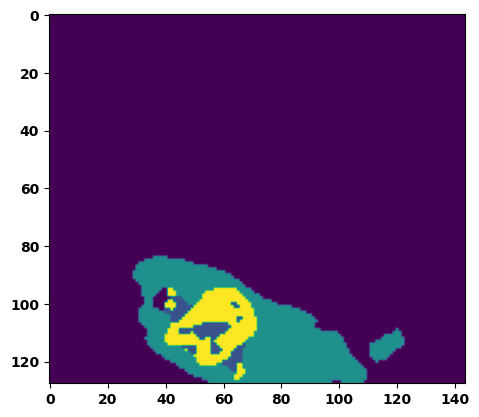

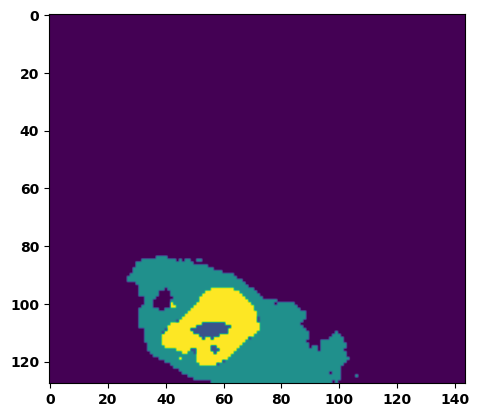

  6%|▌         | 2/36 [00:03<00:52,  1.53s/it]

Batch_id:  1 Eval loss:  0.22803081572055817
Batch_id:  1 Eval IoU:  tensor(0.6511, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9376, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9818, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:45,  1.39s/it]

Batch_id:  2 Eval loss:  0.39817607402801514
Batch_id:  2 Eval IoU:  tensor(0.4911, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9247, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9176, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 11%|█         | 4/36 [00:05<00:43,  1.37s/it]

Batch_id:  3 Eval loss:  0.07942622900009155
Batch_id:  3 Eval IoU:  tensor(0.8661, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:43,  1.42s/it]

Batch_id:  4 Eval loss:  0.25976961851119995
Batch_id:  4 Eval IoU:  tensor(0.6438, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9459, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:43,  1.44s/it]

Batch_id:  5 Eval loss:  0.08044680953025818
Batch_id:  5 Eval IoU:  tensor(0.8606, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 19%|█▉        | 7/36 [00:09<00:40,  1.38s/it]

Batch_id:  6 Eval loss:  0.07749314606189728
Batch_id:  6 Eval IoU:  tensor(0.8707, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:39,  1.42s/it]

Batch_id:  7 Eval loss:  0.23522327840328217
Batch_id:  7 Eval IoU:  tensor(0.6687, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9878, device='cuda:0')


 25%|██▌       | 9/36 [00:12<00:37,  1.41s/it]

Batch_id:  8 Eval loss:  0.19530168175697327
Batch_id:  8 Eval IoU:  tensor(0.7163, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:36,  1.41s/it]

Batch_id:  9 Eval loss:  0.5231294631958008
Batch_id:  9 Eval IoU:  tensor(0.3945, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9340, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9339, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9276, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  10 Eval loss:  0.3985806405544281
Batch_id:  10 Eval IoU:  tensor(0.5340, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


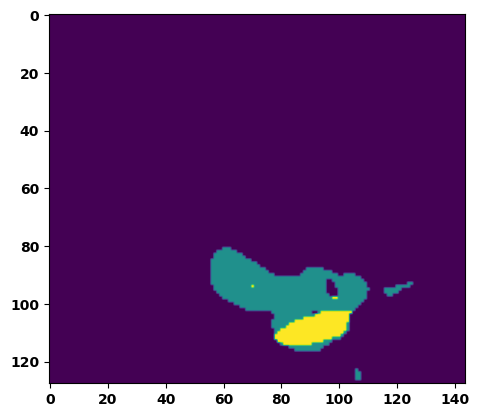

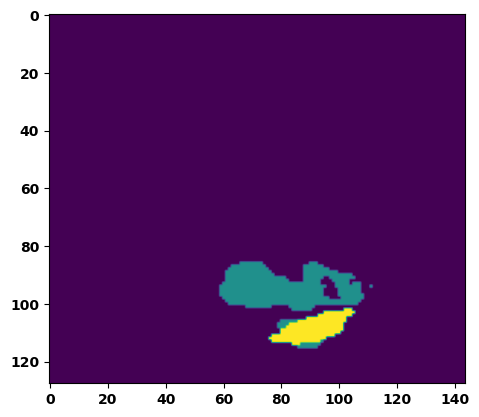

 33%|███▎      | 12/36 [00:17<00:35,  1.46s/it]

Batch_id:  11 Eval loss:  0.25583982467651367
Batch_id:  11 Eval IoU:  tensor(0.6521, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:33,  1.45s/it]

Batch_id:  12 Eval loss:  0.070157989859581
Batch_id:  12 Eval IoU:  tensor(0.8796, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.43s/it]

Batch_id:  13 Eval loss:  0.08771733939647675
Batch_id:  13 Eval IoU:  tensor(0.8485, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:29,  1.41s/it]

Batch_id:  14 Eval loss:  0.06063154339790344
Batch_id:  14 Eval IoU:  tensor(0.8958, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  15 Eval loss:  0.20302176475524902
Batch_id:  15 Eval IoU:  tensor(0.6927, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  

 44%|████▍     | 16/36 [00:23<00:29,  1.50s/it]

tensor(0.9679, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9865, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:26,  1.42s/it]

Batch_id:  16 Eval loss:  0.14926081895828247
Batch_id:  16 Eval IoU:  tensor(0.7677, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 50%|█████     | 18/36 [00:25<00:26,  1.46s/it]

Batch_id:  17 Eval loss:  0.10270518064498901
Batch_id:  17 Eval IoU:  tensor(0.8242, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:23,  1.41s/it]

Batch_id:  18 Eval loss:  0.08246490359306335
Batch_id:  18 Eval IoU:  tensor(0.8784, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 56%|█████▌    | 20/36 [00:28<00:22,  1.40s/it]

Batch_id:  19 Eval loss:  0.09310883283615112
Batch_id:  19 Eval IoU:  tensor(0.8459, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  20 Eval loss:  0.7184322476387024
Batch_id:  20 Eval IoU:  tensor(0.2539, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9465, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9292, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9344, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9964, device='cuda:0')


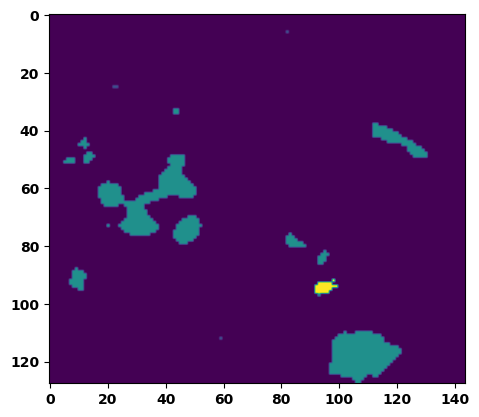

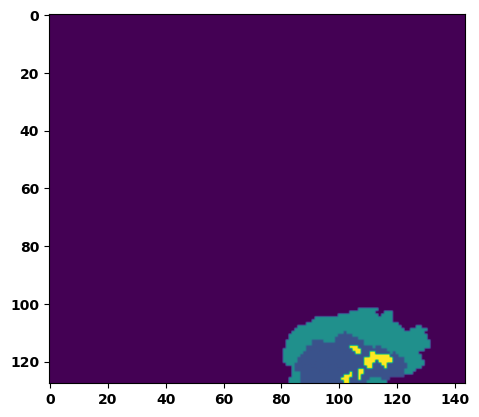

 61%|██████    | 22/36 [00:31<00:21,  1.50s/it]

Batch_id:  21 Eval loss:  0.0640435665845871
Batch_id:  21 Eval IoU:  tensor(0.8996, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.47s/it]

Batch_id:  22 Eval loss:  0.28551116585731506
Batch_id:  22 Eval IoU:  tensor(0.6440, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9972, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:17,  1.47s/it]

Batch_id:  23 Eval loss:  0.4014260172843933
Batch_id:  23 Eval IoU:  tensor(0.5338, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9077, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.8625, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.8619, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.43s/it]

Batch_id:  24 Eval loss:  0.5932396650314331
Batch_id:  24 Eval IoU:  tensor(0.3593, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


 72%|███████▏  | 26/36 [00:37<00:13,  1.38s/it]

Batch_id:  25 Eval loss:  0.1482861042022705
Batch_id:  25 Eval IoU:  tensor(0.7802, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 75%|███████▌  | 27/36 [00:38<00:12,  1.44s/it]

Batch_id:  26 Eval loss:  0.10449615120887756
Batch_id:  26 Eval IoU:  tensor(0.8237, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.41s/it]

Batch_id:  27 Eval loss:  0.13236021995544434
Batch_id:  27 Eval IoU:  tensor(0.7821, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')


 81%|████████  | 29/36 [00:41<00:09,  1.36s/it]

Batch_id:  28 Eval loss:  0.23911546170711517
Batch_id:  28 Eval IoU:  tensor(0.6642, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9798, device='cuda:0')


 83%|████████▎ | 30/36 [00:42<00:07,  1.32s/it]

Batch_id:  29 Eval loss:  0.25719621777534485
Batch_id:  29 Eval IoU:  tensor(0.6988, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  30 Eval loss:  0.12494756281375885
Batch_id:  30 Eval IoU:  tensor(0.8052, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9446, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')


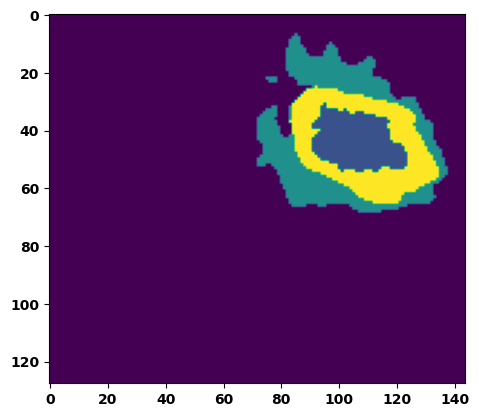

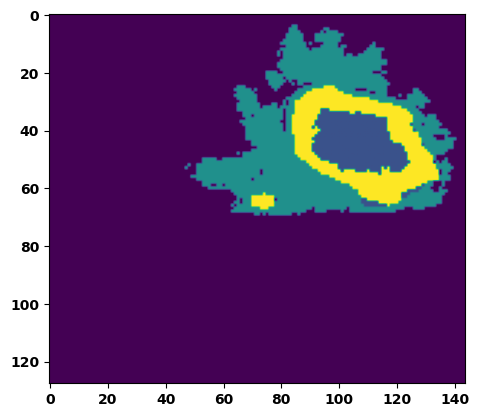

 89%|████████▉ | 32/36 [00:45<00:05,  1.37s/it]

Batch_id:  31 Eval loss:  0.10396614670753479
Batch_id:  31 Eval IoU:  tensor(0.8660, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9955, device='cuda:0')


 92%|█████████▏| 33/36 [00:47<00:04,  1.40s/it]

Batch_id:  32 Eval loss:  0.20336849987506866
Batch_id:  32 Eval IoU:  tensor(0.7074, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


 94%|█████████▍| 34/36 [00:48<00:02,  1.32s/it]

Batch_id:  33 Eval loss:  0.29861539602279663
Batch_id:  33 Eval IoU:  tensor(0.6040, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9361, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')


 97%|█████████▋| 35/36 [00:49<00:01,  1.31s/it]

Batch_id:  34 Eval loss:  0.17640608549118042
Batch_id:  34 Eval IoU:  tensor(0.7300, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9892, device='cuda:0')


100%|██████████| 36/36 [00:50<00:00,  1.41s/it]

Batch_id:  35 Eval loss:  0.37242791056632996
Batch_id:  35 Eval IoU:  tensor(0.5589, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')
Epoch  27 Training loss:  0.17678967754949224
Epoch  27 Evaluation loss:  0.22042292025354174
Epoch  27 Training accuracy :  tensor(0.7515)
Epoch  27 Evaluation accuracy :  tensor(0.7078)
Epoch  27 Training Mean Dice Score:  tensor(0.9798)
Epoch  27 Eval Mean Dice Score:  tensor(0.9735)
Epoch  27 Training Non-tumor Dice Score:  tensor(0.9814)
Epoch  27 Eval Non-tumor Dice Score:  tensor(0.9724)
Epoch  27 Training NCR/NET Dice Score:  tensor(0.9905)
Epoch  27 Eval NCR/NET Dice Score:  tensor(0.9875)
Epoch  27 Training ED Dice Score:  tensor(0.

Epoch: 28
Training in session: 


  1%|          | 1/110 [00:01<02:38,  1.45s/it]

Batch_id:  0 Training loss:  0.131901353597641
Batch_id:  0 Training IoU:  tensor(0.8043, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:29,  1.39s/it]

Batch_id:  1 Training loss:  0.16527299582958221
Batch_id:  1 Training IoU:  tensor(0.7389, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9817, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:32,  1.42s/it]

Batch_id:  2 Training loss:  0.04823532700538635
Batch_id:  2 Training IoU:  tensor(0.9160, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:34,  1.46s/it]

Batch_id:  3 Training loss:  0.13388459384441376
Batch_id:  3 Training IoU:  tensor(0.8020, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:38,  1.51s/it]

Batch_id:  4 Training loss:  0.20372842252254486
Batch_id:  4 Training IoU:  tensor(0.7747, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:35,  1.50s/it]

Batch_id:  5 Training loss:  0.04676368832588196
Batch_id:  5 Training IoU:  tensor(0.9212, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:33,  1.49s/it]

Batch_id:  6 Training loss:  0.18820533156394958
Batch_id:  6 Training IoU:  tensor(0.7224, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:27,  1.44s/it]

Batch_id:  7 Training loss:  0.08828409016132355
Batch_id:  7 Training IoU:  tensor(0.8561, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:31,  1.50s/it]

Batch_id:  8 Training loss:  0.1461106240749359
Batch_id:  8 Training IoU:  tensor(0.7904, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:31,  1.52s/it]

Batch_id:  9 Training loss:  0.10248321294784546
Batch_id:  9 Training IoU:  tensor(0.8287, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 10%|█         | 11/110 [00:16<02:28,  1.50s/it]

Batch_id:  10 Training loss:  0.06936551630496979
Batch_id:  10 Training IoU:  tensor(0.8846, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 11%|█         | 12/110 [00:17<02:25,  1.48s/it]

Batch_id:  11 Training loss:  0.22132162749767303
Batch_id:  11 Training IoU:  tensor(0.6816, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:22,  1.47s/it]

Batch_id:  12 Training loss:  0.09433551132678986
Batch_id:  12 Training IoU:  tensor(0.8483, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:22,  1.48s/it]

Batch_id:  13 Training loss:  0.11438807845115662
Batch_id:  13 Training IoU:  tensor(0.8099, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:22,  1.50s/it]

Batch_id:  14 Training loss:  0.0890018492937088
Batch_id:  14 Training IoU:  tensor(0.8495, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:21,  1.51s/it]

Batch_id:  15 Training loss:  0.19373467564582825
Batch_id:  15 Training IoU:  tensor(0.7067, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:23,  1.55s/it]

Batch_id:  16 Training loss:  0.20859375596046448
Batch_id:  16 Training IoU:  tensor(0.6881, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:19,  1.51s/it]

Batch_id:  17 Training loss:  0.16559341549873352
Batch_id:  17 Training IoU:  tensor(0.7312, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:17,  1.51s/it]

Batch_id:  18 Training loss:  0.26145005226135254
Batch_id:  18 Training IoU:  tensor(0.6353, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9771, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:16,  1.52s/it]

Batch_id:  19 Training loss:  0.17758820950984955
Batch_id:  19 Training IoU:  tensor(0.7409, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:12,  1.49s/it]

Batch_id:  20 Training loss:  0.25586384534835815
Batch_id:  20 Training IoU:  tensor(0.6408, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9482, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 20%|██        | 22/110 [00:32<02:09,  1.47s/it]

Batch_id:  21 Training loss:  0.17315590381622314
Batch_id:  21 Training IoU:  tensor(0.7997, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 21%|██        | 23/110 [00:34<02:08,  1.47s/it]

Batch_id:  22 Training loss:  0.2521747350692749
Batch_id:  22 Training IoU:  tensor(0.6804, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:08,  1.49s/it]

Batch_id:  23 Training loss:  0.28469347953796387
Batch_id:  23 Training IoU:  tensor(0.6041, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9223, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:07,  1.50s/it]

Batch_id:  24 Training loss:  0.14304275810718536
Batch_id:  24 Training IoU:  tensor(0.7628, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9741, device='cuda:0')


 24%|██▎       | 26/110 [00:38<01:58,  1.41s/it]

Batch_id:  25 Training loss:  0.23444993793964386
Batch_id:  25 Training IoU:  tensor(0.7243, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 25%|██▍       | 27/110 [00:39<01:59,  1.44s/it]

Batch_id:  26 Training loss:  0.43182745575904846
Batch_id:  26 Training IoU:  tensor(0.4755, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9345, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9149, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 25%|██▌       | 28/110 [00:41<01:58,  1.44s/it]

Batch_id:  27 Training loss:  0.19880710542201996
Batch_id:  27 Training IoU:  tensor(0.6978, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9479, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9372, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9723, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:58,  1.46s/it]

Batch_id:  28 Training loss:  0.10800576210021973
Batch_id:  28 Training IoU:  tensor(0.8314, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:58,  1.49s/it]

Batch_id:  29 Training loss:  0.36266160011291504
Batch_id:  29 Training IoU:  tensor(0.6193, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9997, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:50,  1.40s/it]

Batch_id:  30 Training loss:  0.21182550489902496
Batch_id:  30 Training IoU:  tensor(0.6887, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 29%|██▉       | 32/110 [00:47<01:54,  1.47s/it]

Batch_id:  31 Training loss:  0.09895047545433044
Batch_id:  31 Training IoU:  tensor(0.8630, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 30%|███       | 33/110 [00:48<01:53,  1.47s/it]

Batch_id:  32 Training loss:  0.2513933777809143
Batch_id:  32 Training IoU:  tensor(0.6320, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9318, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9252, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9754, device='cuda:0')


 31%|███       | 34/110 [00:50<01:52,  1.48s/it]

Batch_id:  33 Training loss:  0.19209374487400055
Batch_id:  33 Training IoU:  tensor(0.7110, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:50,  1.48s/it]

Batch_id:  34 Training loss:  0.3214680850505829
Batch_id:  34 Training IoU:  tensor(0.6266, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:51,  1.51s/it]

Batch_id:  35 Training loss:  0.18997755646705627
Batch_id:  35 Training IoU:  tensor(0.7122, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:47,  1.48s/it]

Batch_id:  36 Training loss:  0.15224029123783112
Batch_id:  36 Training IoU:  tensor(0.7695, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:49,  1.51s/it]

Batch_id:  37 Training loss:  0.19689522683620453
Batch_id:  37 Training IoU:  tensor(0.7650, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:43,  1.45s/it]

Batch_id:  38 Training loss:  0.15954652428627014
Batch_id:  38 Training IoU:  tensor(0.7775, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 36%|███▋      | 40/110 [00:59<01:40,  1.44s/it]

Batch_id:  39 Training loss:  0.12419752776622772
Batch_id:  39 Training IoU:  tensor(0.8154, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 37%|███▋      | 41/110 [01:00<01:36,  1.41s/it]

Batch_id:  40 Training loss:  0.11801423132419586
Batch_id:  40 Training IoU:  tensor(0.8163, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:37,  1.44s/it]

Batch_id:  41 Training loss:  0.26114290952682495
Batch_id:  41 Training IoU:  tensor(0.6431, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 39%|███▉      | 43/110 [01:03<01:41,  1.51s/it]

Batch_id:  42 Training loss:  0.08117122948169708
Batch_id:  42 Training IoU:  tensor(0.8798, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 40%|████      | 44/110 [01:05<01:40,  1.52s/it]

Batch_id:  43 Training loss:  0.21853668987751007
Batch_id:  43 Training IoU:  tensor(0.7100, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 41%|████      | 45/110 [01:06<01:35,  1.47s/it]

Batch_id:  44 Training loss:  0.08844882249832153
Batch_id:  44 Training IoU:  tensor(0.8623, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:35,  1.49s/it]

Batch_id:  45 Training loss:  0.16175390779972076
Batch_id:  45 Training IoU:  tensor(0.7521, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:36,  1.52s/it]

Batch_id:  46 Training loss:  0.13513952493667603
Batch_id:  46 Training IoU:  tensor(0.7807, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:33,  1.52s/it]

Batch_id:  47 Training loss:  0.2847261428833008
Batch_id:  47 Training IoU:  tensor(0.6191, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9564, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:32,  1.52s/it]

Batch_id:  48 Training loss:  0.21935653686523438
Batch_id:  48 Training IoU:  tensor(0.6688, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9356, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9171, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 45%|████▌     | 50/110 [01:14<01:28,  1.48s/it]

Batch_id:  49 Training loss:  0.11709901690483093
Batch_id:  49 Training IoU:  tensor(0.8100, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9773, device='cuda:0')


 46%|████▋     | 51/110 [01:15<01:26,  1.47s/it]

Batch_id:  50 Training loss:  0.2822937071323395
Batch_id:  50 Training IoU:  tensor(0.6642, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 47%|████▋     | 52/110 [01:17<01:28,  1.53s/it]

Batch_id:  51 Training loss:  0.1281212568283081
Batch_id:  51 Training IoU:  tensor(0.7977, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 48%|████▊     | 53/110 [01:18<01:23,  1.46s/it]

Batch_id:  52 Training loss:  0.16550035774707794
Batch_id:  52 Training IoU:  tensor(0.7363, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9847, device='cuda:0')


 49%|████▉     | 54/110 [01:20<01:24,  1.50s/it]

Batch_id:  53 Training loss:  0.24941731989383698
Batch_id:  53 Training IoU:  tensor(0.6357, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9479, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:22,  1.50s/it]

Batch_id:  54 Training loss:  0.07460032403469086
Batch_id:  54 Training IoU:  tensor(0.8713, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 51%|█████     | 56/110 [01:22<01:17,  1.44s/it]

Batch_id:  55 Training loss:  0.2983160614967346
Batch_id:  55 Training IoU:  tensor(0.5815, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9673, device='cuda:0')


 52%|█████▏    | 57/110 [01:24<01:21,  1.53s/it]

Batch_id:  56 Training loss:  0.22906333208084106
Batch_id:  56 Training IoU:  tensor(0.7295, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 53%|█████▎    | 58/110 [01:26<01:20,  1.54s/it]

Batch_id:  57 Training loss:  0.1345767229795456
Batch_id:  57 Training IoU:  tensor(0.8063, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 54%|█████▎    | 59/110 [01:27<01:16,  1.51s/it]

Batch_id:  58 Training loss:  0.2565780282020569
Batch_id:  58 Training IoU:  tensor(0.6486, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 55%|█████▍    | 60/110 [01:29<01:16,  1.52s/it]

Batch_id:  59 Training loss:  0.1729123443365097
Batch_id:  59 Training IoU:  tensor(0.7766, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 55%|█████▌    | 61/110 [01:30<01:13,  1.50s/it]

Batch_id:  60 Training loss:  0.5257276892662048
Batch_id:  60 Training IoU:  tensor(0.4200, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 56%|█████▋    | 62/110 [01:32<01:12,  1.50s/it]

Batch_id:  61 Training loss:  0.18290026485919952
Batch_id:  61 Training IoU:  tensor(0.7135, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 57%|█████▋    | 63/110 [01:33<01:10,  1.50s/it]

Batch_id:  62 Training loss:  0.282990038394928
Batch_id:  62 Training IoU:  tensor(0.6282, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:07,  1.46s/it]

Batch_id:  63 Training loss:  0.47364306449890137
Batch_id:  63 Training IoU:  tensor(0.4485, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 59%|█████▉    | 65/110 [01:36<01:03,  1.41s/it]

Batch_id:  64 Training loss:  0.06764034926891327
Batch_id:  64 Training IoU:  tensor(0.8838, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:03,  1.45s/it]

Batch_id:  65 Training loss:  0.1341836303472519
Batch_id:  65 Training IoU:  tensor(0.8004, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 61%|██████    | 67/110 [01:39<01:02,  1.46s/it]

Batch_id:  66 Training loss:  0.09677495062351227
Batch_id:  66 Training IoU:  tensor(0.8418, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 62%|██████▏   | 68/110 [01:40<01:01,  1.46s/it]

Batch_id:  67 Training loss:  0.3113899827003479
Batch_id:  67 Training IoU:  tensor(0.6289, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9987, device='cuda:0')


 63%|██████▎   | 69/110 [01:42<01:00,  1.49s/it]

Batch_id:  68 Training loss:  0.0842859297990799
Batch_id:  68 Training IoU:  tensor(0.8553, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 64%|██████▎   | 70/110 [01:43<00:59,  1.48s/it]

Batch_id:  69 Training loss:  0.15208488702774048
Batch_id:  69 Training IoU:  tensor(0.7561, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 65%|██████▍   | 71/110 [01:45<00:56,  1.46s/it]

Batch_id:  70 Training loss:  0.08712597191333771
Batch_id:  70 Training IoU:  tensor(0.8512, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 65%|██████▌   | 72/110 [01:46<00:54,  1.43s/it]

Batch_id:  71 Training loss:  0.1761324554681778
Batch_id:  71 Training IoU:  tensor(0.7748, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:52,  1.42s/it]

Batch_id:  72 Training loss:  0.11315348744392395
Batch_id:  72 Training IoU:  tensor(0.8100, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:53,  1.49s/it]

Batch_id:  73 Training loss:  0.14946438372135162
Batch_id:  73 Training IoU:  tensor(0.7607, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 68%|██████▊   | 75/110 [01:51<00:52,  1.49s/it]

Batch_id:  74 Training loss:  0.06160423159599304
Batch_id:  74 Training IoU:  tensor(0.8949, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:50,  1.50s/it]

Batch_id:  75 Training loss:  0.10359422862529755
Batch_id:  75 Training IoU:  tensor(0.8247, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 70%|███████   | 77/110 [01:54<00:49,  1.50s/it]

Batch_id:  76 Training loss:  0.15217477083206177
Batch_id:  76 Training IoU:  tensor(0.7558, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:49,  1.54s/it]

Batch_id:  77 Training loss:  0.37350648641586304
Batch_id:  77 Training IoU:  tensor(0.5773, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:48,  1.56s/it]

Batch_id:  78 Training loss:  0.09366746246814728
Batch_id:  78 Training IoU:  tensor(0.8380, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 73%|███████▎  | 80/110 [01:59<00:47,  1.60s/it]

Batch_id:  79 Training loss:  0.10951007902622223
Batch_id:  79 Training IoU:  tensor(0.8153, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 74%|███████▎  | 81/110 [02:00<00:46,  1.59s/it]

Batch_id:  80 Training loss:  0.22866180539131165
Batch_id:  80 Training IoU:  tensor(0.6681, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 75%|███████▍  | 82/110 [02:02<00:44,  1.59s/it]

Batch_id:  81 Training loss:  0.10491159558296204
Batch_id:  81 Training IoU:  tensor(0.8267, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 75%|███████▌  | 83/110 [02:03<00:41,  1.55s/it]

Batch_id:  82 Training loss:  0.13143470883369446
Batch_id:  82 Training IoU:  tensor(0.7917, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 76%|███████▋  | 84/110 [02:05<00:40,  1.54s/it]

Batch_id:  83 Training loss:  0.13958676159381866
Batch_id:  83 Training IoU:  tensor(0.7803, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 77%|███████▋  | 85/110 [02:06<00:39,  1.58s/it]

Batch_id:  84 Training loss:  0.04339015483856201
Batch_id:  84 Training IoU:  tensor(0.9270, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 78%|███████▊  | 86/110 [02:08<00:37,  1.57s/it]

Batch_id:  85 Training loss:  0.1202995777130127
Batch_id:  85 Training IoU:  tensor(0.8019, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 79%|███████▉  | 87/110 [02:09<00:35,  1.56s/it]

Batch_id:  86 Training loss:  0.08992576599121094
Batch_id:  86 Training IoU:  tensor(0.8475, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 80%|████████  | 88/110 [02:11<00:33,  1.52s/it]

Batch_id:  87 Training loss:  0.06234577298164368
Batch_id:  87 Training IoU:  tensor(0.8948, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 81%|████████  | 89/110 [02:12<00:31,  1.49s/it]

Batch_id:  88 Training loss:  0.12916170060634613
Batch_id:  88 Training IoU:  tensor(0.8000, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 82%|████████▏ | 90/110 [02:14<00:29,  1.47s/it]

Batch_id:  89 Training loss:  0.10250835120677948
Batch_id:  89 Training IoU:  tensor(0.8254, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 83%|████████▎ | 91/110 [02:15<00:28,  1.48s/it]

Batch_id:  90 Training loss:  0.15215818583965302
Batch_id:  90 Training IoU:  tensor(0.7742, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 84%|████████▎ | 92/110 [02:17<00:26,  1.46s/it]

Batch_id:  91 Training loss:  0.1925971955060959
Batch_id:  91 Training IoU:  tensor(0.7095, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 85%|████████▍ | 93/110 [02:18<00:24,  1.46s/it]

Batch_id:  92 Training loss:  0.057851582765579224
Batch_id:  92 Training IoU:  tensor(0.9036, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 85%|████████▌ | 94/110 [02:19<00:22,  1.43s/it]

Batch_id:  93 Training loss:  0.15866118669509888
Batch_id:  93 Training IoU:  tensor(0.7494, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9722, device='cuda:0')


 86%|████████▋ | 95/110 [02:21<00:21,  1.42s/it]

Batch_id:  94 Training loss:  0.27761656045913696
Batch_id:  94 Training IoU:  tensor(0.6699, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 87%|████████▋ | 96/110 [02:23<00:21,  1.50s/it]

Batch_id:  95 Training loss:  0.15334731340408325
Batch_id:  95 Training IoU:  tensor(0.7784, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 88%|████████▊ | 97/110 [02:24<00:19,  1.48s/it]

Batch_id:  96 Training loss:  0.3713191747665405
Batch_id:  96 Training IoU:  tensor(0.5482, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 89%|████████▉ | 98/110 [02:26<00:18,  1.53s/it]

Batch_id:  97 Training loss:  0.09083805978298187
Batch_id:  97 Training IoU:  tensor(0.8474, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 90%|█████████ | 99/110 [02:27<00:16,  1.50s/it]

Batch_id:  98 Training loss:  0.4028847813606262
Batch_id:  98 Training IoU:  tensor(0.5245, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:14,  1.45s/it]

Batch_id:  99 Training loss:  0.12980791926383972
Batch_id:  99 Training IoU:  tensor(0.7900, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 92%|█████████▏| 101/110 [02:30<00:13,  1.47s/it]

Batch_id:  100 Training loss:  0.32948583364486694
Batch_id:  100 Training IoU:  tensor(0.6068, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9442, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 93%|█████████▎| 102/110 [02:32<00:12,  1.53s/it]

Batch_id:  101 Training loss:  0.11479157209396362
Batch_id:  101 Training IoU:  tensor(0.8159, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 94%|█████████▎| 103/110 [02:33<00:10,  1.52s/it]

Batch_id:  102 Training loss:  0.09675461053848267
Batch_id:  102 Training IoU:  tensor(0.8389, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 95%|█████████▍| 104/110 [02:35<00:09,  1.54s/it]

Batch_id:  103 Training loss:  0.10179746150970459
Batch_id:  103 Training IoU:  tensor(0.8294, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 95%|█████████▌| 105/110 [02:36<00:07,  1.56s/it]

Batch_id:  104 Training loss:  0.19043615460395813
Batch_id:  104 Training IoU:  tensor(0.6997, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 96%|█████████▋| 106/110 [02:38<00:06,  1.62s/it]

Batch_id:  105 Training loss:  0.059090301394462585
Batch_id:  105 Training IoU:  tensor(0.9029, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 97%|█████████▋| 107/110 [02:40<00:04,  1.59s/it]

Batch_id:  106 Training loss:  0.15739178657531738
Batch_id:  106 Training IoU:  tensor(0.7530, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9798, device='cuda:0')


 98%|█████████▊| 108/110 [02:41<00:03,  1.66s/it]

Batch_id:  107 Training loss:  0.19049642980098724
Batch_id:  107 Training IoU:  tensor(0.7217, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 99%|█████████▉| 109/110 [02:43<00:01,  1.60s/it]

Batch_id:  108 Training loss:  0.155463308095932
Batch_id:  108 Training IoU:  tensor(0.7505, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


100%|██████████| 110/110 [02:45<00:00,  1.50s/it]


Batch_id:  109 Training loss:  0.08643195033073425
Batch_id:  109 Training IoU:  tensor(0.8562, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9899, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.19727392494678497
Batch_id:  0 Eval IoU:  tensor(0.7128, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9883, device='cuda:0')


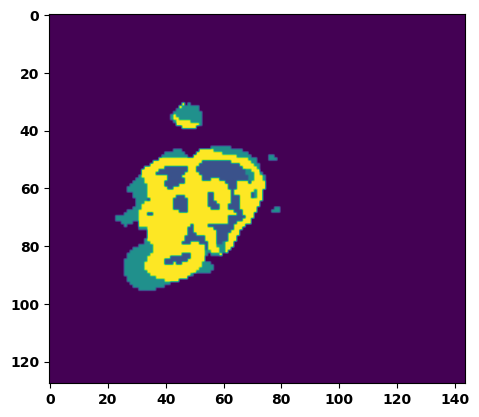

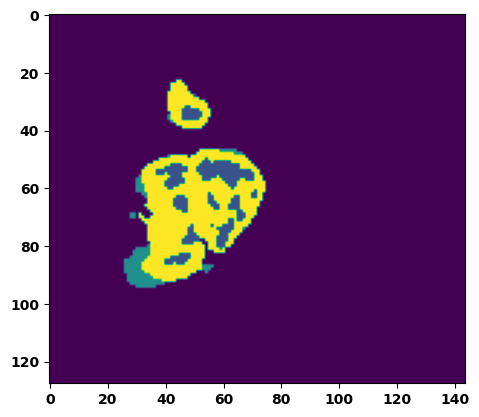

  6%|▌         | 2/36 [00:03<00:52,  1.56s/it]

Batch_id:  1 Eval loss:  0.29975903034210205
Batch_id:  1 Eval IoU:  tensor(0.6017, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:50,  1.54s/it]

Batch_id:  2 Eval loss:  0.5890685319900513
Batch_id:  2 Eval IoU:  tensor(0.3624, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9965, device='cuda:0')


 11%|█         | 4/36 [00:06<00:50,  1.56s/it]

Batch_id:  3 Eval loss:  0.18825861811637878
Batch_id:  3 Eval IoU:  tensor(0.7131, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:48,  1.55s/it]

Batch_id:  4 Eval loss:  0.07532733678817749
Batch_id:  4 Eval IoU:  tensor(0.8744, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:47,  1.59s/it]

Batch_id:  5 Eval loss:  0.1406191736459732
Batch_id:  5 Eval IoU:  tensor(0.7872, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:45,  1.56s/it]

Batch_id:  6 Eval loss:  0.3920058310031891
Batch_id:  6 Eval IoU:  tensor(0.5417, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:43,  1.57s/it]

Batch_id:  7 Eval loss:  0.15211369097232819
Batch_id:  7 Eval IoU:  tensor(0.7560, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9844, device='cuda:0')


 25%|██▌       | 9/36 [00:14<00:41,  1.54s/it]

Batch_id:  8 Eval loss:  0.24325332045555115
Batch_id:  8 Eval IoU:  tensor(0.6589, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 28%|██▊       | 10/36 [00:15<00:40,  1.55s/it]

Batch_id:  9 Eval loss:  0.27986449003219604
Batch_id:  9 Eval IoU:  tensor(0.6539, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  10 Eval loss:  0.09946313500404358
Batch_id:  10 Eval IoU:  tensor(0.8296, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


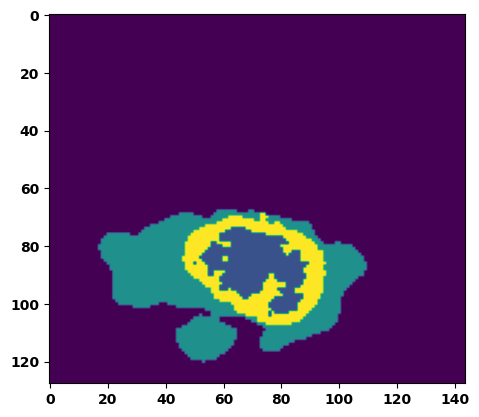

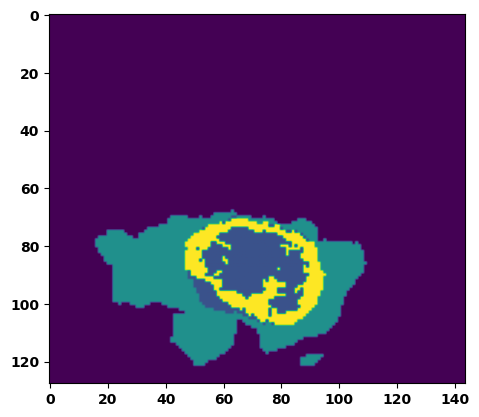

 33%|███▎      | 12/36 [00:18<00:37,  1.55s/it]

Batch_id:  11 Eval loss:  0.22148363292217255
Batch_id:  11 Eval IoU:  tensor(0.6584, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9351, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9498, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9827, device='cuda:0')


 36%|███▌      | 13/36 [00:20<00:35,  1.52s/it]

Batch_id:  12 Eval loss:  0.07584379613399506
Batch_id:  12 Eval IoU:  tensor(0.8677, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9913, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:33,  1.52s/it]

Batch_id:  13 Eval loss:  0.10037103295326233
Batch_id:  13 Eval IoU:  tensor(0.8315, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


 42%|████▏     | 15/36 [00:23<00:31,  1.51s/it]

Batch_id:  14 Eval loss:  0.07410478591918945
Batch_id:  14 Eval IoU:  tensor(0.8732, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9896, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:29,  1.50s/it]

Batch_id:  15 Eval loss:  0.3751899003982544
Batch_id:  15 Eval IoU:  tensor(0.5551, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 47%|████▋     | 17/36 [00:26<00:28,  1.47s/it]

Batch_id:  16 Eval loss:  0.06667304039001465
Batch_id:  16 Eval IoU:  tensor(0.8956, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 50%|█████     | 18/36 [00:27<00:26,  1.48s/it]

Batch_id:  17 Eval loss:  0.18353834748268127
Batch_id:  17 Eval IoU:  tensor(0.7204, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 53%|█████▎    | 19/36 [00:29<00:24,  1.46s/it]

Batch_id:  18 Eval loss:  0.1795889288187027
Batch_id:  18 Eval IoU:  tensor(0.7262, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


 56%|█████▌    | 20/36 [00:30<00:23,  1.45s/it]

Batch_id:  19 Eval loss:  0.23591536283493042
Batch_id:  19 Eval IoU:  tensor(0.6653, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  20 Eval loss:  0.19513416290283203
Batch_id:  20 Eval IoU:  tensor(0.7163, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


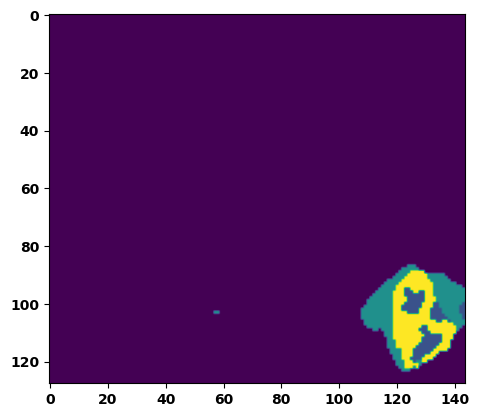

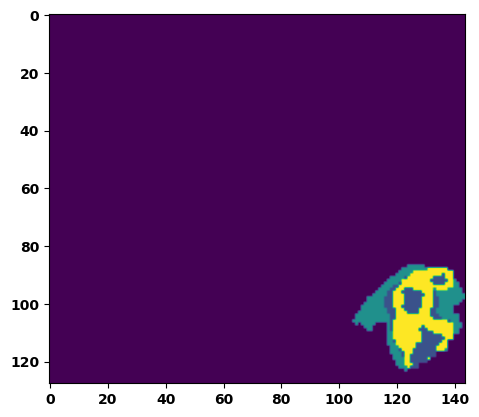

 61%|██████    | 22/36 [00:33<00:21,  1.52s/it]

Batch_id:  21 Eval loss:  0.2496190220117569
Batch_id:  21 Eval IoU:  tensor(0.6578, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9454, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


 64%|██████▍   | 23/36 [00:35<00:19,  1.51s/it]

Batch_id:  22 Eval loss:  0.40602028369903564
Batch_id:  22 Eval IoU:  tensor(0.5287, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9059, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.8600, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.8595, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 67%|██████▋   | 24/36 [00:36<00:17,  1.49s/it]

Batch_id:  23 Eval loss:  0.09781740605831146
Batch_id:  23 Eval IoU:  tensor(0.8389, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:16,  1.47s/it]

Batch_id:  24 Eval loss:  0.13390704989433289
Batch_id:  24 Eval IoU:  tensor(0.7949, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9405, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 72%|███████▏  | 26/36 [00:39<00:14,  1.44s/it]

Batch_id:  25 Eval loss:  0.14524458348751068
Batch_id:  25 Eval IoU:  tensor(0.7680, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:12,  1.42s/it]

Batch_id:  26 Eval loss:  0.4052336812019348
Batch_id:  26 Eval IoU:  tensor(0.4831, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9241, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9172, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


 78%|███████▊  | 28/36 [00:42<00:11,  1.40s/it]

Batch_id:  27 Eval loss:  0.5101255774497986
Batch_id:  27 Eval IoU:  tensor(0.4016, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9349, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9377, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9290, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:09,  1.42s/it]

Batch_id:  28 Eval loss:  0.09520447254180908
Batch_id:  28 Eval IoU:  tensor(0.8367, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


 83%|████████▎ | 30/36 [00:45<00:08,  1.46s/it]

Batch_id:  29 Eval loss:  0.10432255268096924
Batch_id:  29 Eval IoU:  tensor(0.8610, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  30 Eval loss:  0.7220264077186584
Batch_id:  30 Eval IoU:  tensor(0.2525, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9480, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9310, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9371, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9966, device='cuda:0')


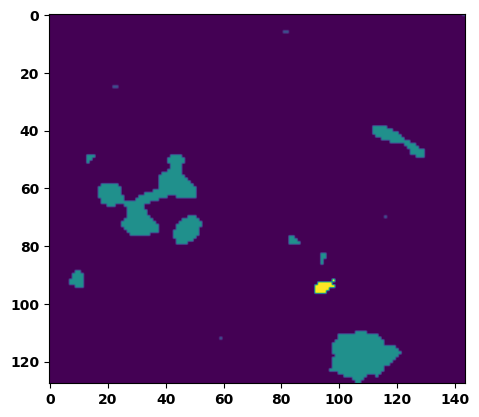

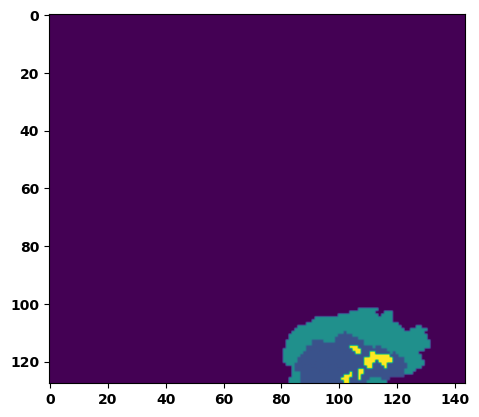

 89%|████████▉ | 32/36 [00:48<00:06,  1.51s/it]

Batch_id:  31 Eval loss:  0.06046634912490845
Batch_id:  31 Eval IoU:  tensor(0.8961, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')


 92%|█████████▏| 33/36 [00:49<00:04,  1.48s/it]

Batch_id:  32 Eval loss:  0.2551158368587494
Batch_id:  32 Eval IoU:  tensor(0.6992, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 94%|█████████▍| 34/36 [00:51<00:02,  1.49s/it]

Batch_id:  33 Eval loss:  0.0817953497171402
Batch_id:  33 Eval IoU:  tensor(0.8631, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9966, device='cuda:0')


 97%|█████████▋| 35/36 [00:52<00:01,  1.46s/it]

Batch_id:  34 Eval loss:  0.3014035224914551
Batch_id:  34 Eval IoU:  tensor(0.6003, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9355, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9910, device='cuda:0')


100%|██████████| 36/36 [00:53<00:00,  1.50s/it]

Batch_id:  35 Eval loss:  0.07697641849517822
Batch_id:  35 Eval IoU:  tensor(0.8844, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')
Epoch  28 Training loss:  0.17475712367079474
Epoch  28 Evaluation loss:  0.22250357187456554
Epoch  28 Training accuracy :  tensor(0.7530)
Epoch  28 Evaluation accuracy :  tensor(0.7047)
Epoch  28 Training Mean Dice Score:  tensor(0.9800)
Epoch  28 Eval Mean Dice Score:  tensor(0.9734)
Epoch  28 Training Non-tumor Dice Score:  tensor(0.9816)
Epoch  28 Eval Non-tumor Dice Score:  tensor(0.9724)
Epoch  28 Training NCR/NET Dice Score:  tensor(0.9906)
Epoch  28 Eval NCR/NET Dice Score:  tensor(0.9872)
Epoch  28 Training ED Dice Score:  tensor(0.

Epoch: 29
Training in session: 


  1%|          | 1/110 [00:01<02:32,  1.40s/it]

Batch_id:  0 Training loss:  0.14314734935760498
Batch_id:  0 Training IoU:  tensor(0.7774, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:41,  1.50s/it]

Batch_id:  1 Training loss:  0.11668726801872253
Batch_id:  1 Training IoU:  tensor(0.8042, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9524, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:36,  1.46s/it]

Batch_id:  2 Training loss:  0.14169679582118988
Batch_id:  2 Training IoU:  tensor(0.7968, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:35,  1.47s/it]

Batch_id:  3 Training loss:  0.2197514921426773
Batch_id:  3 Training IoU:  tensor(0.6744, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:33,  1.46s/it]

Batch_id:  4 Training loss:  0.16108201444149017
Batch_id:  4 Training IoU:  tensor(0.7382, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:37,  1.52s/it]

Batch_id:  5 Training loss:  0.08036868274211884
Batch_id:  5 Training IoU:  tensor(0.8800, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:36,  1.52s/it]

Batch_id:  6 Training loss:  0.2487066388130188
Batch_id:  6 Training IoU:  tensor(0.6848, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:30,  1.48s/it]

Batch_id:  7 Training loss:  0.17795270681381226
Batch_id:  7 Training IoU:  tensor(0.7265, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:26,  1.45s/it]

Batch_id:  8 Training loss:  0.11145135760307312
Batch_id:  8 Training IoU:  tensor(0.8166, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9770, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:20,  1.41s/it]

Batch_id:  9 Training loss:  0.06929399073123932
Batch_id:  9 Training IoU:  tensor(0.8803, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 10%|█         | 11/110 [00:16<02:22,  1.44s/it]

Batch_id:  10 Training loss:  0.13118281960487366
Batch_id:  10 Training IoU:  tensor(0.7933, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 11%|█         | 12/110 [00:17<02:20,  1.44s/it]

Batch_id:  11 Training loss:  0.09256350994110107
Batch_id:  11 Training IoU:  tensor(0.8487, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:19,  1.43s/it]

Batch_id:  12 Training loss:  0.09832292795181274
Batch_id:  12 Training IoU:  tensor(0.8330, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:16,  1.42s/it]

Batch_id:  13 Training loss:  0.26437151432037354
Batch_id:  13 Training IoU:  tensor(0.6318, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9773, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:14,  1.42s/it]

Batch_id:  14 Training loss:  0.08833922445774078
Batch_id:  14 Training IoU:  tensor(0.8491, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:13,  1.42s/it]

Batch_id:  15 Training loss:  0.28593066334724426
Batch_id:  15 Training IoU:  tensor(0.6030, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9240, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:11,  1.41s/it]

Batch_id:  16 Training loss:  0.3975161015987396
Batch_id:  16 Training IoU:  tensor(0.5231, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:11,  1.43s/it]

Batch_id:  17 Training loss:  0.13843511044979095
Batch_id:  17 Training IoU:  tensor(0.7879, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:09,  1.42s/it]

Batch_id:  18 Training loss:  0.1870899349451065
Batch_id:  18 Training IoU:  tensor(0.7865, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:10,  1.45s/it]

Batch_id:  19 Training loss:  0.1928582787513733
Batch_id:  19 Training IoU:  tensor(0.7067, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9547, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9744, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:09,  1.45s/it]

Batch_id:  20 Training loss:  0.08295406401157379
Batch_id:  20 Training IoU:  tensor(0.8572, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 20%|██        | 22/110 [00:31<02:07,  1.45s/it]

Batch_id:  21 Training loss:  0.17765188217163086
Batch_id:  21 Training IoU:  tensor(0.7166, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 21%|██        | 23/110 [00:33<02:08,  1.48s/it]

Batch_id:  22 Training loss:  0.18568281829357147
Batch_id:  22 Training IoU:  tensor(0.7096, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:04,  1.45s/it]

Batch_id:  23 Training loss:  0.14380879700183868
Batch_id:  23 Training IoU:  tensor(0.7665, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 23%|██▎       | 25/110 [00:36<01:58,  1.39s/it]

Batch_id:  24 Training loss:  0.2332122027873993
Batch_id:  24 Training IoU:  tensor(0.7203, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:03,  1.47s/it]

Batch_id:  25 Training loss:  0.2723138928413391
Batch_id:  25 Training IoU:  tensor(0.6328, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9582, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:01,  1.46s/it]

Batch_id:  26 Training loss:  0.22406259179115295
Batch_id:  26 Training IoU:  tensor(0.7313, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9979, device='cuda:0')


 25%|██▌       | 28/110 [00:40<01:59,  1.46s/it]

Batch_id:  27 Training loss:  0.22987277805805206
Batch_id:  27 Training IoU:  tensor(0.6608, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 26%|██▋       | 29/110 [00:41<01:56,  1.44s/it]

Batch_id:  28 Training loss:  0.23959346115589142
Batch_id:  28 Training IoU:  tensor(0.6558, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:51,  1.40s/it]

Batch_id:  29 Training loss:  0.12135772407054901
Batch_id:  29 Training IoU:  tensor(0.8125, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:56,  1.47s/it]

Batch_id:  30 Training loss:  0.3043416738510132
Batch_id:  30 Training IoU:  tensor(0.6389, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9987, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:53,  1.46s/it]

Batch_id:  31 Training loss:  0.16598330438137054
Batch_id:  31 Training IoU:  tensor(0.7415, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 30%|███       | 33/110 [00:47<01:51,  1.45s/it]

Batch_id:  32 Training loss:  0.08982576429843903
Batch_id:  32 Training IoU:  tensor(0.8592, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 31%|███       | 34/110 [00:49<01:51,  1.47s/it]

Batch_id:  33 Training loss:  0.17934150993824005
Batch_id:  33 Training IoU:  tensor(0.7378, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:49,  1.46s/it]

Batch_id:  34 Training loss:  0.12317489087581635
Batch_id:  34 Training IoU:  tensor(0.7974, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:48,  1.47s/it]

Batch_id:  35 Training loss:  0.09047256410121918
Batch_id:  35 Training IoU:  tensor(0.8467, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:46,  1.46s/it]

Batch_id:  36 Training loss:  0.2451581358909607
Batch_id:  36 Training IoU:  tensor(0.6395, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9374, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9512, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9345, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9759, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:48,  1.51s/it]

Batch_id:  37 Training loss:  0.12992653250694275
Batch_id:  37 Training IoU:  tensor(0.8038, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:47,  1.51s/it]

Batch_id:  38 Training loss:  0.14485467970371246
Batch_id:  38 Training IoU:  tensor(0.7851, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:42,  1.47s/it]

Batch_id:  39 Training loss:  0.10448949038982391
Batch_id:  39 Training IoU:  tensor(0.8271, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9817, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:40,  1.46s/it]

Batch_id:  40 Training loss:  0.09341268241405487
Batch_id:  40 Training IoU:  tensor(0.8445, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:39,  1.47s/it]

Batch_id:  41 Training loss:  0.23364515602588654
Batch_id:  41 Training IoU:  tensor(0.6670, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:36,  1.44s/it]

Batch_id:  42 Training loss:  0.19015415012836456
Batch_id:  42 Training IoU:  tensor(0.7187, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9819, device='cuda:0')


 40%|████      | 44/110 [01:03<01:33,  1.41s/it]

Batch_id:  43 Training loss:  0.3311804533004761
Batch_id:  43 Training IoU:  tensor(0.6045, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9617, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9441, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 41%|████      | 45/110 [01:05<01:32,  1.42s/it]

Batch_id:  44 Training loss:  0.09147050976753235
Batch_id:  44 Training IoU:  tensor(0.8502, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:30,  1.41s/it]

Batch_id:  45 Training loss:  0.24573445320129395
Batch_id:  45 Training IoU:  tensor(0.6391, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9537, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9387, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 43%|████▎     | 47/110 [01:07<01:27,  1.39s/it]

Batch_id:  46 Training loss:  0.15537813305854797
Batch_id:  46 Training IoU:  tensor(0.7610, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:24,  1.37s/it]

Batch_id:  47 Training loss:  0.10375665128231049
Batch_id:  47 Training IoU:  tensor(0.8243, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 45%|████▍     | 49/110 [01:10<01:23,  1.37s/it]

Batch_id:  48 Training loss:  0.11213541030883789
Batch_id:  48 Training IoU:  tensor(0.8211, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9842, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:23,  1.39s/it]

Batch_id:  49 Training loss:  0.12449716031551361
Batch_id:  49 Training IoU:  tensor(0.8045, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 46%|████▋     | 51/110 [01:13<01:23,  1.41s/it]

Batch_id:  50 Training loss:  0.30499130487442017
Batch_id:  50 Training IoU:  tensor(0.5914, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9811, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:29,  1.55s/it]

Batch_id:  51 Training loss:  0.06831401586532593
Batch_id:  51 Training IoU:  tensor(0.8854, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:26,  1.52s/it]

Batch_id:  52 Training loss:  0.04858388006687164
Batch_id:  52 Training IoU:  tensor(0.9177, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:23,  1.49s/it]

Batch_id:  53 Training loss:  0.221155047416687
Batch_id:  53 Training IoU:  tensor(0.7069, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:24,  1.53s/it]

Batch_id:  54 Training loss:  0.08397804200649261
Batch_id:  54 Training IoU:  tensor(0.8601, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:20,  1.49s/it]

Batch_id:  55 Training loss:  0.36175525188446045
Batch_id:  55 Training IoU:  tensor(0.6206, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9997, device='cuda:0')


 52%|█████▏    | 57/110 [01:22<01:20,  1.51s/it]

Batch_id:  56 Training loss:  0.05462336540222168
Batch_id:  56 Training IoU:  tensor(0.9108, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:16,  1.47s/it]

Batch_id:  57 Training loss:  0.10598181188106537
Batch_id:  57 Training IoU:  tensor(0.8254, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 54%|█████▎    | 59/110 [01:25<01:13,  1.45s/it]

Batch_id:  58 Training loss:  0.09760868549346924
Batch_id:  58 Training IoU:  tensor(0.8649, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 55%|█████▍    | 60/110 [01:27<01:13,  1.47s/it]

Batch_id:  59 Training loss:  0.14997591078281403
Batch_id:  59 Training IoU:  tensor(0.8069, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:11,  1.45s/it]

Batch_id:  60 Training loss:  0.16060231626033783
Batch_id:  60 Training IoU:  tensor(0.7917, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 56%|█████▋    | 62/110 [01:29<01:07,  1.41s/it]

Batch_id:  61 Training loss:  0.46839284896850586
Batch_id:  61 Training IoU:  tensor(0.4546, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:05,  1.39s/it]

Batch_id:  62 Training loss:  0.1652020663022995
Batch_id:  62 Training IoU:  tensor(0.7364, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 58%|█████▊    | 64/110 [01:32<01:04,  1.40s/it]

Batch_id:  63 Training loss:  0.1523098200559616
Batch_id:  63 Training IoU:  tensor(0.7786, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:04,  1.44s/it]

Batch_id:  64 Training loss:  0.07752597332000732
Batch_id:  64 Training IoU:  tensor(0.8658, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 60%|██████    | 66/110 [01:35<01:02,  1.43s/it]

Batch_id:  65 Training loss:  0.10587342083454132
Batch_id:  65 Training IoU:  tensor(0.8219, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 61%|██████    | 67/110 [01:36<01:00,  1.42s/it]

Batch_id:  66 Training loss:  0.2778400182723999
Batch_id:  66 Training IoU:  tensor(0.6727, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 62%|██████▏   | 68/110 [01:38<00:58,  1.40s/it]

Batch_id:  67 Training loss:  0.05868558585643768
Batch_id:  67 Training IoU:  tensor(0.9006, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 63%|██████▎   | 69/110 [01:39<00:58,  1.42s/it]

Batch_id:  68 Training loss:  0.10037915408611298
Batch_id:  68 Training IoU:  tensor(0.8386, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 64%|██████▎   | 70/110 [01:41<00:56,  1.41s/it]

Batch_id:  69 Training loss:  0.20437179505825043
Batch_id:  69 Training IoU:  tensor(0.6959, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 65%|██████▍   | 71/110 [01:42<00:55,  1.42s/it]

Batch_id:  70 Training loss:  0.2808798551559448
Batch_id:  70 Training IoU:  tensor(0.6635, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 65%|██████▌   | 72/110 [01:44<00:54,  1.44s/it]

Batch_id:  71 Training loss:  0.1501670479774475
Batch_id:  71 Training IoU:  tensor(0.7586, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


 66%|██████▋   | 73/110 [01:45<00:54,  1.46s/it]

Batch_id:  72 Training loss:  0.13247187435626984
Batch_id:  72 Training IoU:  tensor(0.7904, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 67%|██████▋   | 74/110 [01:47<00:51,  1.43s/it]

Batch_id:  73 Training loss:  0.5364697575569153
Batch_id:  73 Training IoU:  tensor(0.4080, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 68%|██████▊   | 75/110 [01:48<00:49,  1.41s/it]

Batch_id:  74 Training loss:  0.11805789172649384
Batch_id:  74 Training IoU:  tensor(0.8080, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 69%|██████▉   | 76/110 [01:49<00:47,  1.40s/it]

Batch_id:  75 Training loss:  0.3785772919654846
Batch_id:  75 Training IoU:  tensor(0.5715, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 70%|███████   | 77/110 [01:51<00:46,  1.42s/it]

Batch_id:  76 Training loss:  0.17949871718883514
Batch_id:  76 Training IoU:  tensor(0.7821, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 71%|███████   | 78/110 [01:52<00:46,  1.46s/it]

Batch_id:  77 Training loss:  0.19354470074176788
Batch_id:  77 Training IoU:  tensor(0.7069, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 72%|███████▏  | 79/110 [01:54<00:45,  1.47s/it]

Batch_id:  78 Training loss:  0.12775342166423798
Batch_id:  78 Training IoU:  tensor(0.8106, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 73%|███████▎  | 80/110 [01:56<00:47,  1.59s/it]

Batch_id:  79 Training loss:  0.19066669046878815
Batch_id:  79 Training IoU:  tensor(0.7997, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 74%|███████▎  | 81/110 [01:57<00:45,  1.57s/it]

Batch_id:  80 Training loss:  0.1855676770210266
Batch_id:  80 Training IoU:  tensor(0.7271, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 75%|███████▍  | 82/110 [01:59<00:42,  1.51s/it]

Batch_id:  81 Training loss:  0.08858543634414673
Batch_id:  81 Training IoU:  tensor(0.8489, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 75%|███████▌  | 83/110 [02:00<00:39,  1.46s/it]

Batch_id:  82 Training loss:  0.1652652621269226
Batch_id:  82 Training IoU:  tensor(0.7391, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9814, device='cuda:0')


 76%|███████▋  | 84/110 [02:02<00:40,  1.55s/it]

Batch_id:  83 Training loss:  0.04514399170875549
Batch_id:  83 Training IoU:  tensor(0.9215, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 77%|███████▋  | 85/110 [02:03<00:38,  1.53s/it]

Batch_id:  84 Training loss:  0.16124366223812103
Batch_id:  84 Training IoU:  tensor(0.7450, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9715, device='cuda:0')


 78%|███████▊  | 86/110 [02:05<00:35,  1.49s/it]

Batch_id:  85 Training loss:  0.25772958993911743
Batch_id:  85 Training IoU:  tensor(0.6456, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 79%|███████▉  | 87/110 [02:06<00:35,  1.54s/it]

Batch_id:  86 Training loss:  0.33718448877334595
Batch_id:  86 Training IoU:  tensor(0.6048, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 80%|████████  | 88/110 [02:08<00:32,  1.49s/it]

Batch_id:  87 Training loss:  0.14327619969844818
Batch_id:  87 Training IoU:  tensor(0.7628, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9732, device='cuda:0')


 81%|████████  | 89/110 [02:09<00:32,  1.57s/it]

Batch_id:  88 Training loss:  0.2657510042190552
Batch_id:  88 Training IoU:  tensor(0.6519, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:30,  1.55s/it]

Batch_id:  89 Training loss:  0.1127539724111557
Batch_id:  89 Training IoU:  tensor(0.8282, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 83%|████████▎ | 91/110 [02:12<00:28,  1.52s/it]

Batch_id:  90 Training loss:  0.06243102252483368
Batch_id:  90 Training IoU:  tensor(0.8938, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:27,  1.53s/it]

Batch_id:  91 Training loss:  0.1638699620962143
Batch_id:  91 Training IoU:  tensor(0.7570, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 85%|████████▍ | 93/110 [02:15<00:25,  1.50s/it]

Batch_id:  92 Training loss:  0.21143774688243866
Batch_id:  92 Training IoU:  tensor(0.6862, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:24,  1.54s/it]

Batch_id:  93 Training loss:  0.10927306115627289
Batch_id:  93 Training IoU:  tensor(0.8266, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 86%|████████▋ | 95/110 [02:18<00:22,  1.53s/it]

Batch_id:  94 Training loss:  0.08803588151931763
Batch_id:  94 Training IoU:  tensor(0.8493, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:21,  1.52s/it]

Batch_id:  95 Training loss:  0.22512786090373993
Batch_id:  95 Training IoU:  tensor(0.6603, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9352, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9339, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9174, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:19,  1.51s/it]

Batch_id:  96 Training loss:  0.25838369131088257
Batch_id:  96 Training IoU:  tensor(0.6370, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:17,  1.44s/it]

Batch_id:  97 Training loss:  0.14818350970745087
Batch_id:  97 Training IoU:  tensor(0.7610, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 90%|█████████ | 99/110 [02:24<00:16,  1.46s/it]

Batch_id:  98 Training loss:  0.13908764719963074
Batch_id:  98 Training IoU:  tensor(0.7969, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:14,  1.46s/it]

Batch_id:  99 Training loss:  0.36206984519958496
Batch_id:  99 Training IoU:  tensor(0.5729, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 92%|█████████▏| 101/110 [02:27<00:14,  1.57s/it]

Batch_id:  100 Training loss:  0.042685896158218384
Batch_id:  100 Training IoU:  tensor(0.9286, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:12,  1.56s/it]

Batch_id:  101 Training loss:  0.056718409061431885
Batch_id:  101 Training IoU:  tensor(0.9052, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 94%|█████████▎| 103/110 [02:30<00:10,  1.53s/it]

Batch_id:  102 Training loss:  0.14801664650440216
Batch_id:  102 Training IoU:  tensor(0.7605, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:09,  1.52s/it]

Batch_id:  103 Training loss:  0.09379260241985321
Batch_id:  103 Training IoU:  tensor(0.8442, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 95%|█████████▌| 105/110 [02:34<00:07,  1.54s/it]

Batch_id:  104 Training loss:  0.10365502536296844
Batch_id:  104 Training IoU:  tensor(0.8264, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:06,  1.54s/it]

Batch_id:  105 Training loss:  0.2696809470653534
Batch_id:  105 Training IoU:  tensor(0.6107, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9737, device='cuda:0')


 97%|█████████▋| 107/110 [02:37<00:04,  1.55s/it]

Batch_id:  106 Training loss:  0.15899647772312164
Batch_id:  106 Training IoU:  tensor(0.7778, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:03,  1.52s/it]

Batch_id:  107 Training loss:  0.09767821431159973
Batch_id:  107 Training IoU:  tensor(0.8320, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.57s/it]

Batch_id:  108 Training loss:  0.1333889216184616
Batch_id:  108 Training IoU:  tensor(0.7820, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.4446534514427185
Batch_id:  109 Training IoU:  tensor(0.4647, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9408, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9312, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9120, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9948, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.37393441796302795
Batch_id:  0 Eval IoU:  tensor(0.5550, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


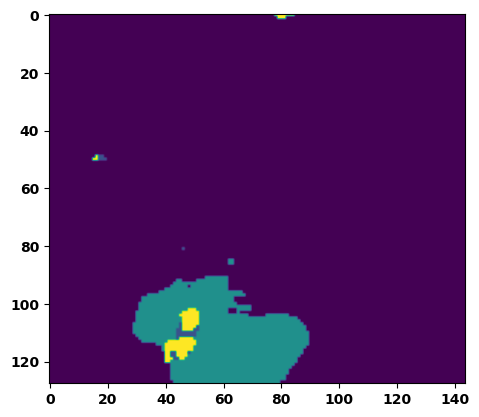

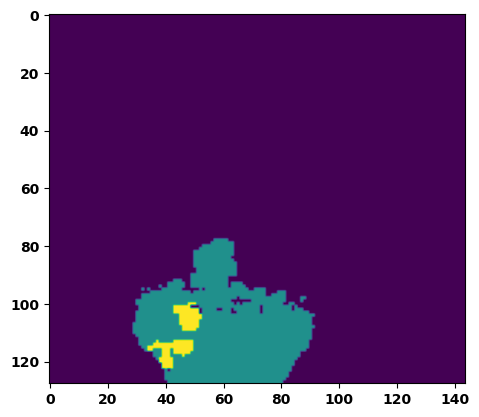

  6%|▌         | 2/36 [00:03<01:01,  1.81s/it]

Batch_id:  1 Eval loss:  0.2504948377609253
Batch_id:  1 Eval IoU:  tensor(0.6575, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


  8%|▊         | 3/36 [00:05<00:54,  1.66s/it]

Batch_id:  2 Eval loss:  0.07785217463970184
Batch_id:  2 Eval IoU:  tensor(0.8650, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9910, device='cuda:0')


 11%|█         | 4/36 [00:06<00:53,  1.66s/it]

Batch_id:  3 Eval loss:  0.24160008132457733
Batch_id:  3 Eval IoU:  tensor(0.6610, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9876, device='cuda:0')


 14%|█▍        | 5/36 [00:08<00:49,  1.60s/it]

Batch_id:  4 Eval loss:  0.06686447560787201
Batch_id:  4 Eval IoU:  tensor(0.8962, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:47,  1.58s/it]

Batch_id:  5 Eval loss:  0.1548776775598526
Batch_id:  5 Eval IoU:  tensor(0.7565, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


 19%|█▉        | 7/36 [00:11<00:43,  1.51s/it]

Batch_id:  6 Eval loss:  0.4995112717151642
Batch_id:  6 Eval IoU:  tensor(0.4057, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9304, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9398, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9982, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:43,  1.56s/it]

Batch_id:  7 Eval loss:  0.0773547887802124
Batch_id:  7 Eval IoU:  tensor(0.8716, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')


 25%|██▌       | 9/36 [00:14<00:40,  1.52s/it]

Batch_id:  8 Eval loss:  0.0846736878156662
Batch_id:  8 Eval IoU:  tensor(0.8573, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9965, device='cuda:0')


 28%|██▊       | 10/36 [00:15<00:41,  1.59s/it]

Batch_id:  9 Eval loss:  0.10055428743362427
Batch_id:  9 Eval IoU:  tensor(0.8274, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  10 Eval loss:  0.2508760690689087
Batch_id:  10 Eval IoU:  tensor(0.7047, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


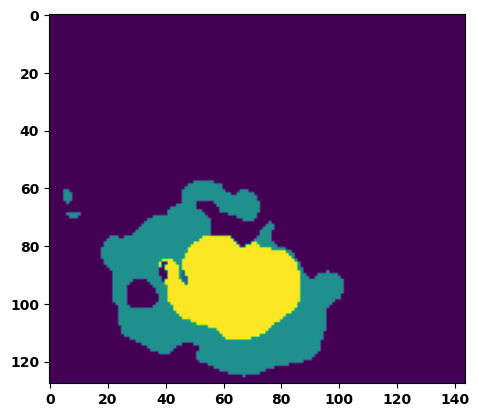

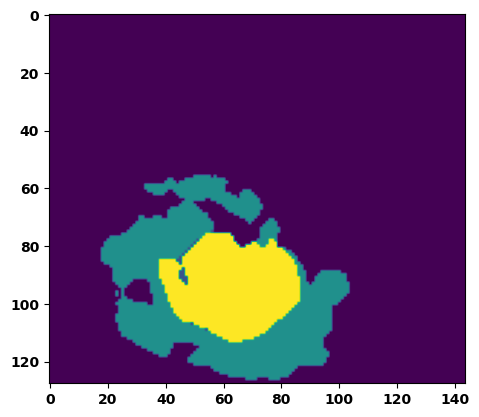

 33%|███▎      | 12/36 [00:19<00:37,  1.58s/it]

Batch_id:  11 Eval loss:  0.5859354734420776
Batch_id:  11 Eval IoU:  tensor(0.3623, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 36%|███▌      | 13/36 [00:20<00:35,  1.55s/it]

Batch_id:  12 Eval loss:  0.7202017903327942
Batch_id:  12 Eval IoU:  tensor(0.2528, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9303, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9370, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9968, device='cuda:0')


 39%|███▉      | 14/36 [00:22<00:33,  1.52s/it]

Batch_id:  13 Eval loss:  0.06030963361263275
Batch_id:  13 Eval IoU:  tensor(0.8964, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9935, device='cuda:0')


 42%|████▏     | 15/36 [00:23<00:32,  1.53s/it]

Batch_id:  14 Eval loss:  0.403319776058197
Batch_id:  14 Eval IoU:  tensor(0.5319, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9071, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.8618, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.8611, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')


 44%|████▍     | 16/36 [00:25<00:30,  1.50s/it]

Batch_id:  15 Eval loss:  0.1952216923236847
Batch_id:  15 Eval IoU:  tensor(0.7152, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 47%|████▋     | 17/36 [00:26<00:28,  1.52s/it]

Batch_id:  16 Eval loss:  0.11590185761451721
Batch_id:  16 Eval IoU:  tensor(0.8401, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 50%|█████     | 18/36 [00:28<00:27,  1.52s/it]

Batch_id:  17 Eval loss:  0.0786866843700409
Batch_id:  17 Eval IoU:  tensor(0.8819, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 53%|█████▎    | 19/36 [00:29<00:24,  1.45s/it]

Batch_id:  18 Eval loss:  0.22781488299369812
Batch_id:  18 Eval IoU:  tensor(0.6757, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9792, device='cuda:0')


 56%|█████▌    | 20/36 [00:30<00:23,  1.45s/it]

Batch_id:  19 Eval loss:  0.1510787457227707
Batch_id:  19 Eval IoU:  tensor(0.7570, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  20 Eval loss:  0.39322078227996826
Batch_id:  20 Eval IoU:  tensor(0.4925, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9259, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9201, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


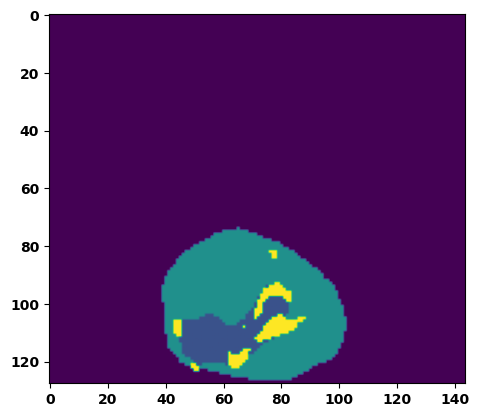

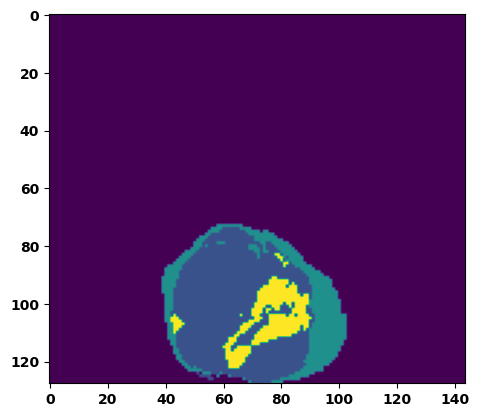

 61%|██████    | 22/36 [00:34<00:21,  1.55s/it]

Batch_id:  21 Eval loss:  0.14725400507450104
Batch_id:  21 Eval IoU:  tensor(0.7798, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


 64%|██████▍   | 23/36 [00:35<00:19,  1.50s/it]

Batch_id:  22 Eval loss:  0.17914772033691406
Batch_id:  22 Eval IoU:  tensor(0.7251, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9892, device='cuda:0')


 67%|██████▋   | 24/36 [00:37<00:17,  1.47s/it]

Batch_id:  23 Eval loss:  0.20982857048511505
Batch_id:  23 Eval IoU:  tensor(0.6755, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9827, device='cuda:0')


 69%|██████▉   | 25/36 [00:38<00:15,  1.45s/it]

Batch_id:  24 Eval loss:  0.19403943419456482
Batch_id:  24 Eval IoU:  tensor(0.7096, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 72%|███████▏  | 26/36 [00:39<00:14,  1.48s/it]

Batch_id:  25 Eval loss:  0.1945701390504837
Batch_id:  25 Eval IoU:  tensor(0.7043, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9872, device='cuda:0')


 75%|███████▌  | 27/36 [00:41<00:13,  1.49s/it]

Batch_id:  26 Eval loss:  0.2676869332790375
Batch_id:  26 Eval IoU:  tensor(0.6595, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9974, device='cuda:0')


 78%|███████▊  | 28/36 [00:42<00:11,  1.46s/it]

Batch_id:  27 Eval loss:  0.07203604280948639
Batch_id:  27 Eval IoU:  tensor(0.8768, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 81%|████████  | 29/36 [00:44<00:10,  1.45s/it]

Batch_id:  28 Eval loss:  0.2939682602882385
Batch_id:  28 Eval IoU:  tensor(0.6058, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


 83%|████████▎ | 30/36 [00:45<00:08,  1.49s/it]

Batch_id:  29 Eval loss:  0.10501138865947723
Batch_id:  29 Eval IoU:  tensor(0.8229, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  30 Eval loss:  0.1274126023054123
Batch_id:  30 Eval IoU:  tensor(0.8018, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9462, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9435, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')


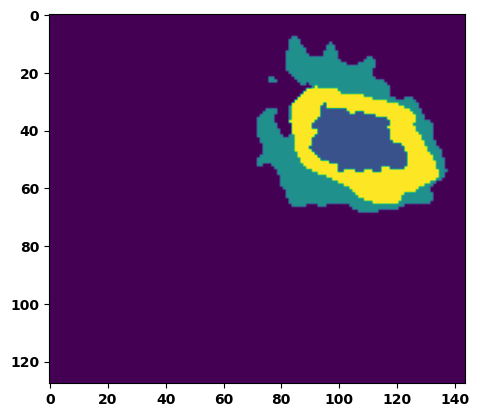

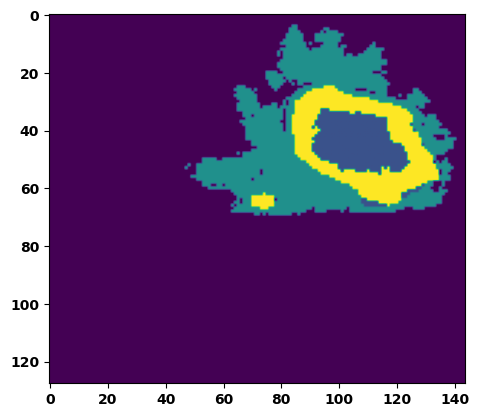

 89%|████████▉ | 32/36 [00:49<00:06,  1.60s/it]

Batch_id:  31 Eval loss:  0.1969304382801056
Batch_id:  31 Eval IoU:  tensor(0.7145, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 92%|█████████▏| 33/36 [00:50<00:04,  1.57s/it]

Batch_id:  32 Eval loss:  0.39618784189224243
Batch_id:  32 Eval IoU:  tensor(0.5332, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9978, device='cuda:0')


 94%|█████████▍| 34/36 [00:52<00:03,  1.51s/it]

Batch_id:  33 Eval loss:  0.08221814036369324
Batch_id:  33 Eval IoU:  tensor(0.8580, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


 97%|█████████▋| 35/36 [00:53<00:01,  1.45s/it]

Batch_id:  34 Eval loss:  0.0975562185049057
Batch_id:  34 Eval IoU:  tensor(0.8385, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  35 Eval loss:  0.2727818489074707
Batch_id:  35 Eval IoU:  tensor(0.6289, device='cuda:0')


100%|██████████| 36/36 [00:55<00:00,  1.53s/it]

Batch_id:  35 Eval Mean Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9435, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')
Epoch  29 Training loss:  0.1741099778901447
Epoch  29 Evaluation loss:  0.22074762980143228
Epoch  29 Training accuracy :  tensor(0.7537)
Epoch  29 Evaluation accuracy :  tensor(0.7055)
Epoch  29 Training Mean Dice Score:  tensor(0.9800)
Epoch  29 Eval Mean Dice Score:  tensor(0.9735)
Epoch  29 Training Non-tumor Dice Score:  tensor(0.9815)
Epoch  29 Eval Non-tumor Dice Score:  tensor(0.9725)
Epoch  29 Training NCR/NET Dice Score:  tensor(0.9907)
Epoch  29 Eval NCR/NET Dice Score:  tensor(0.9874)
Epoch  29 Training ED Dice Score:  tensor(0.9770)
Epoch  29 Eval ED Dice Score:  tensor(0.9685)
Epoch  29 Training ET Dice Score:  tensor(0.9908)
Ep

Epoch: 30
Training in session: 


  1%|          | 1/110 [00:01<02:37,  1.45s/it]

Batch_id:  0 Training loss:  0.18955177068710327
Batch_id:  0 Training IoU:  tensor(0.7043, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:34,  1.43s/it]

Batch_id:  1 Training loss:  0.14904648065567017
Batch_id:  1 Training IoU:  tensor(0.7546, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9737, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:35,  1.45s/it]

Batch_id:  2 Training loss:  0.35943639278411865
Batch_id:  2 Training IoU:  tensor(0.5750, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:33,  1.45s/it]

Batch_id:  3 Training loss:  0.09092944860458374
Batch_id:  3 Training IoU:  tensor(0.8514, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:30,  1.43s/it]

Batch_id:  4 Training loss:  0.15866222977638245
Batch_id:  4 Training IoU:  tensor(0.7671, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:26,  1.41s/it]

Batch_id:  5 Training loss:  0.1977161169052124
Batch_id:  5 Training IoU:  tensor(0.7027, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:30,  1.46s/it]

Batch_id:  6 Training loss:  0.27955856919288635
Batch_id:  6 Training IoU:  tensor(0.6640, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:31,  1.49s/it]

Batch_id:  7 Training loss:  0.0918920636177063
Batch_id:  7 Training IoU:  tensor(0.8740, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:28,  1.47s/it]

Batch_id:  8 Training loss:  0.32903122901916504
Batch_id:  8 Training IoU:  tensor(0.6086, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9473, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:26,  1.46s/it]

Batch_id:  9 Training loss:  0.16285693645477295
Batch_id:  9 Training IoU:  tensor(0.7427, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9821, device='cuda:0')


 10%|█         | 11/110 [00:16<02:27,  1.48s/it]

Batch_id:  10 Training loss:  0.06135760247707367
Batch_id:  10 Training IoU:  tensor(0.8959, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 11%|█         | 12/110 [00:17<02:20,  1.44s/it]

Batch_id:  11 Training loss:  0.09256254136562347
Batch_id:  11 Training IoU:  tensor(0.8475, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:19,  1.44s/it]

Batch_id:  12 Training loss:  0.0620272159576416
Batch_id:  12 Training IoU:  tensor(0.8951, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:16,  1.43s/it]

Batch_id:  13 Training loss:  0.2518738806247711
Batch_id:  13 Training IoU:  tensor(0.6310, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9764, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:16,  1.44s/it]

Batch_id:  14 Training loss:  0.09399592876434326
Batch_id:  14 Training IoU:  tensor(0.8485, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:14,  1.43s/it]

Batch_id:  15 Training loss:  0.11805669963359833
Batch_id:  15 Training IoU:  tensor(0.8071, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:09,  1.39s/it]

Batch_id:  16 Training loss:  0.15697920322418213
Batch_id:  16 Training IoU:  tensor(0.7824, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 16%|█▋        | 18/110 [00:25<02:11,  1.43s/it]

Batch_id:  17 Training loss:  0.15780287981033325
Batch_id:  17 Training IoU:  tensor(0.7512, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9720, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:11,  1.44s/it]

Batch_id:  18 Training loss:  0.09379179775714874
Batch_id:  18 Training IoU:  tensor(0.8413, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:09,  1.44s/it]

Batch_id:  19 Training loss:  0.11749401688575745
Batch_id:  19 Training IoU:  tensor(0.8078, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9760, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:07,  1.43s/it]

Batch_id:  20 Training loss:  0.2167784869670868
Batch_id:  20 Training IoU:  tensor(0.6814, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 20%|██        | 22/110 [00:31<02:03,  1.40s/it]

Batch_id:  21 Training loss:  0.18084968626499176
Batch_id:  21 Training IoU:  tensor(0.7357, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 21%|██        | 23/110 [00:32<02:00,  1.39s/it]

Batch_id:  22 Training loss:  0.13067734241485596
Batch_id:  22 Training IoU:  tensor(0.7939, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 22%|██▏       | 24/110 [00:34<01:57,  1.36s/it]

Batch_id:  23 Training loss:  0.24257348477840424
Batch_id:  23 Training IoU:  tensor(0.6445, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9547, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 23%|██▎       | 25/110 [00:35<01:57,  1.38s/it]

Batch_id:  24 Training loss:  0.5237482786178589
Batch_id:  24 Training IoU:  tensor(0.4251, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:03,  1.47s/it]

Batch_id:  25 Training loss:  0.1198158860206604
Batch_id:  25 Training IoU:  tensor(0.7994, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9513, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 25%|██▍       | 27/110 [00:38<02:04,  1.50s/it]

Batch_id:  26 Training loss:  0.04536166787147522
Batch_id:  26 Training IoU:  tensor(0.9220, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 25%|██▌       | 28/110 [00:40<02:02,  1.49s/it]

Batch_id:  27 Training loss:  0.12373813986778259
Batch_id:  27 Training IoU:  tensor(0.8076, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 26%|██▋       | 29/110 [00:41<01:59,  1.47s/it]

Batch_id:  28 Training loss:  0.25285351276397705
Batch_id:  28 Training IoU:  tensor(0.6422, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9760, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:54,  1.43s/it]

Batch_id:  29 Training loss:  0.0985865592956543
Batch_id:  29 Training IoU:  tensor(0.8356, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:53,  1.43s/it]

Batch_id:  30 Training loss:  0.1792326420545578
Batch_id:  30 Training IoU:  tensor(0.7243, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:52,  1.44s/it]

Batch_id:  31 Training loss:  0.20741285383701324
Batch_id:  31 Training IoU:  tensor(0.6900, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 30%|███       | 33/110 [00:47<01:54,  1.48s/it]

Batch_id:  32 Training loss:  0.12441007792949677
Batch_id:  32 Training IoU:  tensor(0.8160, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 31%|███       | 34/110 [00:49<01:52,  1.48s/it]

Batch_id:  33 Training loss:  0.04183885455131531
Batch_id:  33 Training IoU:  tensor(0.9285, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:49,  1.46s/it]

Batch_id:  34 Training loss:  0.08601458370685577
Batch_id:  34 Training IoU:  tensor(0.8532, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:50,  1.49s/it]

Batch_id:  35 Training loss:  0.05445285141468048
Batch_id:  35 Training IoU:  tensor(0.9115, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:44,  1.43s/it]

Batch_id:  36 Training loss:  0.27712714672088623
Batch_id:  36 Training IoU:  tensor(0.6151, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9473, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9529, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9253, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 35%|███▍      | 38/110 [00:54<01:42,  1.42s/it]

Batch_id:  37 Training loss:  0.20268268883228302
Batch_id:  37 Training IoU:  tensor(0.6943, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:42,  1.44s/it]

Batch_id:  38 Training loss:  0.23390156030654907
Batch_id:  38 Training IoU:  tensor(0.6675, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 36%|███▋      | 40/110 [00:57<01:36,  1.37s/it]

Batch_id:  39 Training loss:  0.093308225274086
Batch_id:  39 Training IoU:  tensor(0.8442, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:46,  1.55s/it]

Batch_id:  40 Training loss:  0.1636320799589157
Batch_id:  40 Training IoU:  tensor(0.7348, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 38%|███▊      | 42/110 [01:00<01:42,  1.50s/it]

Batch_id:  41 Training loss:  0.09706418216228485
Batch_id:  41 Training IoU:  tensor(0.8359, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:39,  1.49s/it]

Batch_id:  42 Training loss:  0.11114706099033356
Batch_id:  42 Training IoU:  tensor(0.8234, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 40%|████      | 44/110 [01:03<01:34,  1.44s/it]

Batch_id:  43 Training loss:  0.37909647822380066
Batch_id:  43 Training IoU:  tensor(0.5425, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 41%|████      | 45/110 [01:05<01:35,  1.47s/it]

Batch_id:  44 Training loss:  0.08466342091560364
Batch_id:  44 Training IoU:  tensor(0.8597, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:38,  1.55s/it]

Batch_id:  45 Training loss:  0.2775956392288208
Batch_id:  45 Training IoU:  tensor(0.6714, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9993, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:33,  1.48s/it]

Batch_id:  46 Training loss:  0.22926966845989227
Batch_id:  46 Training IoU:  tensor(0.7260, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:29,  1.45s/it]

Batch_id:  47 Training loss:  0.14686927199363708
Batch_id:  47 Training IoU:  tensor(0.7630, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:30,  1.48s/it]

Batch_id:  48 Training loss:  0.19098122417926788
Batch_id:  48 Training IoU:  tensor(0.7098, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:26,  1.44s/it]

Batch_id:  49 Training loss:  0.4272209405899048
Batch_id:  49 Training IoU:  tensor(0.4750, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9304, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9129, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 46%|████▋     | 51/110 [01:13<01:26,  1.46s/it]

Batch_id:  50 Training loss:  0.2834469974040985
Batch_id:  50 Training IoU:  tensor(0.6181, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9562, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9550, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:21,  1.40s/it]

Batch_id:  51 Training loss:  0.1279027909040451
Batch_id:  51 Training IoU:  tensor(0.7897, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:22,  1.44s/it]

Batch_id:  52 Training loss:  0.18384826183319092
Batch_id:  52 Training IoU:  tensor(0.7792, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:18,  1.40s/it]

Batch_id:  53 Training loss:  0.16460490226745605
Batch_id:  53 Training IoU:  tensor(0.7485, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:18,  1.42s/it]

Batch_id:  54 Training loss:  0.10151512920856476
Batch_id:  54 Training IoU:  tensor(0.8266, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 51%|█████     | 56/110 [01:20<01:16,  1.42s/it]

Batch_id:  55 Training loss:  0.10073956847190857
Batch_id:  55 Training IoU:  tensor(0.8298, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 52%|█████▏    | 57/110 [01:22<01:16,  1.45s/it]

Batch_id:  56 Training loss:  0.15405893325805664
Batch_id:  56 Training IoU:  tensor(0.7999, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:18,  1.52s/it]

Batch_id:  57 Training loss:  0.06577126681804657
Batch_id:  57 Training IoU:  tensor(0.8910, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 54%|█████▎    | 59/110 [01:25<01:15,  1.47s/it]

Batch_id:  58 Training loss:  0.492095410823822
Batch_id:  58 Training IoU:  tensor(0.4343, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 55%|█████▍    | 60/110 [01:27<01:14,  1.48s/it]

Batch_id:  59 Training loss:  0.23725983500480652
Batch_id:  59 Training IoU:  tensor(0.6581, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9513, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9813, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:10,  1.44s/it]

Batch_id:  60 Training loss:  0.1358867883682251
Batch_id:  60 Training IoU:  tensor(0.7968, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 56%|█████▋    | 62/110 [01:29<01:08,  1.43s/it]

Batch_id:  61 Training loss:  0.12454412877559662
Batch_id:  61 Training IoU:  tensor(0.8065, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:09,  1.47s/it]

Batch_id:  62 Training loss:  0.08586163818836212
Batch_id:  62 Training IoU:  tensor(0.8645, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 58%|█████▊    | 64/110 [01:32<01:07,  1.46s/it]

Batch_id:  63 Training loss:  0.2151249647140503
Batch_id:  63 Training IoU:  tensor(0.6732, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9360, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9383, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9177, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:05,  1.47s/it]

Batch_id:  64 Training loss:  0.11253474652767181
Batch_id:  64 Training IoU:  tensor(0.8197, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 60%|██████    | 66/110 [01:35<01:05,  1.49s/it]

Batch_id:  65 Training loss:  0.19051861763000488
Batch_id:  65 Training IoU:  tensor(0.7974, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 61%|██████    | 67/110 [01:37<01:06,  1.54s/it]

Batch_id:  66 Training loss:  0.1788407862186432
Batch_id:  66 Training IoU:  tensor(0.7844, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 62%|██████▏   | 68/110 [01:38<01:02,  1.48s/it]

Batch_id:  67 Training loss:  0.16055037081241608
Batch_id:  67 Training IoU:  tensor(0.7441, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<00:59,  1.45s/it]

Batch_id:  68 Training loss:  0.16493476927280426
Batch_id:  68 Training IoU:  tensor(0.7857, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 64%|██████▎   | 70/110 [01:41<00:58,  1.45s/it]

Batch_id:  69 Training loss:  0.08671388030052185
Batch_id:  69 Training IoU:  tensor(0.8519, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 65%|██████▍   | 71/110 [01:42<00:54,  1.40s/it]

Batch_id:  70 Training loss:  0.10518132150173187
Batch_id:  70 Training IoU:  tensor(0.8263, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 65%|██████▌   | 72/110 [01:44<00:55,  1.46s/it]

Batch_id:  71 Training loss:  0.15396417677402496
Batch_id:  71 Training IoU:  tensor(0.7766, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 66%|██████▋   | 73/110 [01:46<00:54,  1.47s/it]

Batch_id:  72 Training loss:  0.2317783087491989
Batch_id:  72 Training IoU:  tensor(0.6611, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 67%|██████▋   | 74/110 [01:47<00:51,  1.44s/it]

Batch_id:  73 Training loss:  0.19339989125728607
Batch_id:  73 Training IoU:  tensor(0.7139, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9821, device='cuda:0')


 68%|██████▊   | 75/110 [01:48<00:50,  1.43s/it]

Batch_id:  74 Training loss:  0.0703577846288681
Batch_id:  74 Training IoU:  tensor(0.8777, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 69%|██████▉   | 76/110 [01:50<00:51,  1.50s/it]

Batch_id:  75 Training loss:  0.183862566947937
Batch_id:  75 Training IoU:  tensor(0.7076, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 70%|███████   | 77/110 [01:52<00:51,  1.56s/it]

Batch_id:  76 Training loss:  0.13365419209003448
Batch_id:  76 Training IoU:  tensor(0.7820, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 71%|███████   | 78/110 [01:53<00:48,  1.50s/it]

Batch_id:  77 Training loss:  0.24376118183135986
Batch_id:  77 Training IoU:  tensor(0.6910, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 72%|███████▏  | 79/110 [01:54<00:46,  1.48s/it]

Batch_id:  78 Training loss:  0.14160408079624176
Batch_id:  78 Training IoU:  tensor(0.7827, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 73%|███████▎  | 80/110 [01:56<00:43,  1.47s/it]

Batch_id:  79 Training loss:  0.14325469732284546
Batch_id:  79 Training IoU:  tensor(0.7850, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 74%|███████▎  | 81/110 [01:57<00:42,  1.46s/it]

Batch_id:  80 Training loss:  0.12266258895397186
Batch_id:  80 Training IoU:  tensor(0.8058, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 75%|███████▍  | 82/110 [01:59<00:40,  1.46s/it]

Batch_id:  81 Training loss:  0.05648982524871826
Batch_id:  81 Training IoU:  tensor(0.9053, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 75%|███████▌  | 83/110 [02:00<00:39,  1.46s/it]

Batch_id:  82 Training loss:  0.04605117440223694
Batch_id:  82 Training IoU:  tensor(0.9209, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 76%|███████▋  | 84/110 [02:02<00:39,  1.50s/it]

Batch_id:  83 Training loss:  0.16905248165130615
Batch_id:  83 Training IoU:  tensor(0.7313, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9847, device='cuda:0')


 77%|███████▋  | 85/110 [02:03<00:36,  1.45s/it]

Batch_id:  84 Training loss:  0.09423969686031342
Batch_id:  84 Training IoU:  tensor(0.8406, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 78%|███████▊  | 86/110 [02:05<00:36,  1.50s/it]

Batch_id:  85 Training loss:  0.19262796640396118
Batch_id:  85 Training IoU:  tensor(0.7206, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 79%|███████▉  | 87/110 [02:06<00:34,  1.51s/it]

Batch_id:  86 Training loss:  0.08929294347763062
Batch_id:  86 Training IoU:  tensor(0.8480, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 80%|████████  | 88/110 [02:08<00:32,  1.50s/it]

Batch_id:  87 Training loss:  0.3273467421531677
Batch_id:  87 Training IoU:  tensor(0.6186, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 81%|████████  | 89/110 [02:09<00:31,  1.51s/it]

Batch_id:  88 Training loss:  0.07941745221614838
Batch_id:  88 Training IoU:  tensor(0.8806, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:30,  1.51s/it]

Batch_id:  89 Training loss:  0.12976329028606415
Batch_id:  89 Training IoU:  tensor(0.8116, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 83%|████████▎ | 91/110 [02:12<00:28,  1.52s/it]

Batch_id:  90 Training loss:  0.214267298579216
Batch_id:  90 Training IoU:  tensor(0.7138, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:27,  1.51s/it]

Batch_id:  91 Training loss:  0.09493547677993774
Batch_id:  91 Training IoU:  tensor(0.8419, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 85%|████████▍ | 93/110 [02:15<00:25,  1.47s/it]

Batch_id:  92 Training loss:  0.2463134527206421
Batch_id:  92 Training IoU:  tensor(0.6393, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9351, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9482, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9303, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9762, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:23,  1.49s/it]

Batch_id:  93 Training loss:  0.27695131301879883
Batch_id:  93 Training IoU:  tensor(0.6773, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 86%|████████▋ | 95/110 [02:18<00:22,  1.47s/it]

Batch_id:  94 Training loss:  0.12463974952697754
Batch_id:  94 Training IoU:  tensor(0.7951, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:20,  1.48s/it]

Batch_id:  95 Training loss:  0.1673741638660431
Batch_id:  95 Training IoU:  tensor(0.7399, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:19,  1.52s/it]

Batch_id:  96 Training loss:  0.2590125799179077
Batch_id:  96 Training IoU:  tensor(0.6438, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:18,  1.52s/it]

Batch_id:  97 Training loss:  0.13255086541175842
Batch_id:  97 Training IoU:  tensor(0.7911, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 90%|█████████ | 99/110 [02:24<00:16,  1.51s/it]

Batch_id:  98 Training loss:  0.14608441293239594
Batch_id:  98 Training IoU:  tensor(0.7647, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:14,  1.45s/it]

Batch_id:  99 Training loss:  0.13461357355117798
Batch_id:  99 Training IoU:  tensor(0.8054, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 92%|█████████▏| 101/110 [02:27<00:13,  1.47s/it]

Batch_id:  100 Training loss:  0.0863107293844223
Batch_id:  100 Training IoU:  tensor(0.8507, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:11,  1.46s/it]

Batch_id:  101 Training loss:  0.10944999754428864
Batch_id:  101 Training IoU:  tensor(0.8350, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 94%|█████████▎| 103/110 [02:31<00:11,  1.59s/it]

Batch_id:  102 Training loss:  0.22420141100883484
Batch_id:  102 Training IoU:  tensor(0.7355, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9979, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:09,  1.55s/it]

Batch_id:  103 Training loss:  0.2726367115974426
Batch_id:  103 Training IoU:  tensor(0.6288, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 95%|█████████▌| 105/110 [02:33<00:07,  1.53s/it]

Batch_id:  104 Training loss:  0.10387443006038666
Batch_id:  104 Training IoU:  tensor(0.8263, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:06,  1.51s/it]

Batch_id:  105 Training loss:  0.3513590693473816
Batch_id:  105 Training IoU:  tensor(0.6301, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 97%|█████████▋| 107/110 [02:36<00:04,  1.50s/it]

Batch_id:  106 Training loss:  0.3658410906791687
Batch_id:  106 Training IoU:  tensor(0.5890, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:03,  1.58s/it]

Batch_id:  107 Training loss:  0.27532702684402466
Batch_id:  107 Training IoU:  tensor(0.6354, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.52s/it]

Batch_id:  108 Training loss:  0.07454091310501099
Batch_id:  108 Training IoU:  tensor(0.8704, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.20073485374450684
Batch_id:  109 Training IoU:  tensor(0.6949, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9726, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.10551291704177856
Batch_id:  0 Eval IoU:  tensor(0.8195, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9886, device='cuda:0')


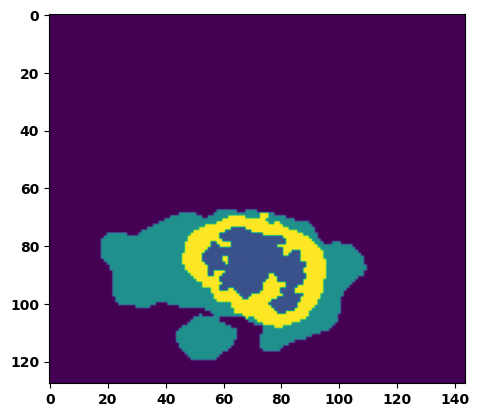

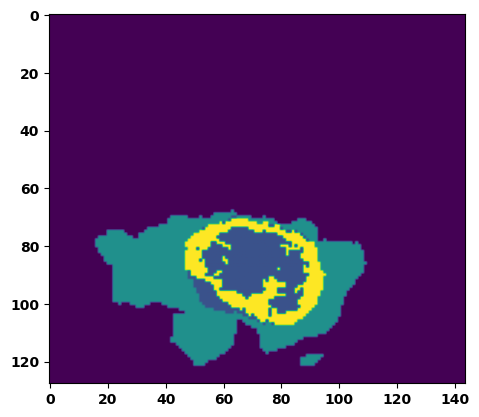

  6%|▌         | 2/36 [00:03<00:50,  1.49s/it]

Batch_id:  1 Eval loss:  0.2600459158420563
Batch_id:  1 Eval IoU:  tensor(0.6442, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:50,  1.52s/it]

Batch_id:  2 Eval loss:  0.26164764165878296
Batch_id:  2 Eval IoU:  tensor(0.6909, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 11%|█         | 4/36 [00:06<00:48,  1.50s/it]

Batch_id:  3 Eval loss:  0.11429570615291595
Batch_id:  3 Eval IoU:  tensor(0.8068, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.46s/it]

Batch_id:  4 Eval loss:  0.4901590645313263
Batch_id:  4 Eval IoU:  tensor(0.4124, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9423, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9324, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:44,  1.47s/it]

Batch_id:  5 Eval loss:  0.07956273853778839
Batch_id:  5 Eval IoU:  tensor(0.8663, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9864, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:44,  1.52s/it]

Batch_id:  6 Eval loss:  0.08022341132164001
Batch_id:  6 Eval IoU:  tensor(0.8652, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9971, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:42,  1.53s/it]

Batch_id:  7 Eval loss:  0.38298457860946655
Batch_id:  7 Eval IoU:  tensor(0.5444, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:40,  1.51s/it]

Batch_id:  8 Eval loss:  0.27390122413635254
Batch_id:  8 Eval IoU:  tensor(0.6512, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9967, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.46s/it]

Batch_id:  9 Eval loss:  0.2546796202659607
Batch_id:  9 Eval IoU:  tensor(0.6519, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  10 Eval loss:  0.05948196351528168
Batch_id:  10 Eval IoU:  tensor(0.9076, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9955, device='cuda:0')


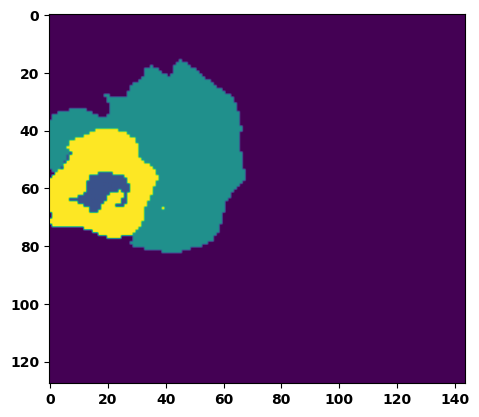

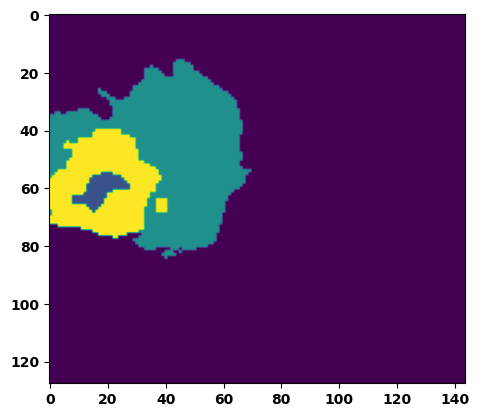

 33%|███▎      | 12/36 [00:18<00:36,  1.51s/it]

Batch_id:  11 Eval loss:  0.07771643996238708
Batch_id:  11 Eval IoU:  tensor(0.8835, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9982, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.51s/it]

Batch_id:  12 Eval loss:  0.14650095999240875
Batch_id:  12 Eval IoU:  tensor(0.7819, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:33,  1.52s/it]

Batch_id:  13 Eval loss:  0.38111793994903564
Batch_id:  13 Eval IoU:  tensor(0.5051, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9273, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9215, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.52s/it]

Batch_id:  14 Eval loss:  0.07522270083427429
Batch_id:  14 Eval IoU:  tensor(0.8685, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:30,  1.50s/it]

Batch_id:  15 Eval loss:  0.14618514478206635
Batch_id:  15 Eval IoU:  tensor(0.7688, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:28,  1.48s/it]

Batch_id:  16 Eval loss:  0.40914496779441833
Batch_id:  16 Eval IoU:  tensor(0.5271, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9046, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.8578, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.8573, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9987, device='cuda:0')


 50%|█████     | 18/36 [00:27<00:28,  1.57s/it]

Batch_id:  17 Eval loss:  0.26135364174842834
Batch_id:  17 Eval IoU:  tensor(0.6463, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9455, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9919, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:25,  1.49s/it]

Batch_id:  18 Eval loss:  0.19160352647304535
Batch_id:  18 Eval IoU:  tensor(0.7199, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 56%|█████▌    | 20/36 [00:30<00:23,  1.49s/it]

Batch_id:  19 Eval loss:  0.2249944657087326
Batch_id:  19 Eval IoU:  tensor(0.6798, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  20 Eval loss:  0.19283175468444824
Batch_id:  20 Eval IoU:  tensor(0.7182, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


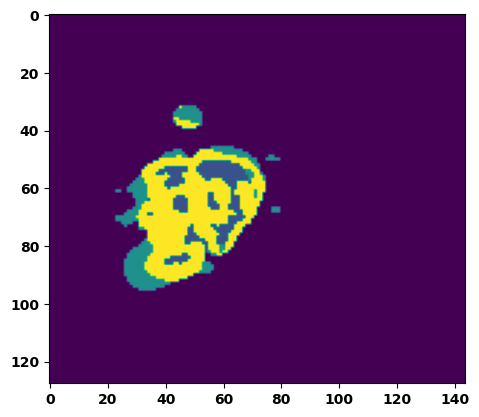

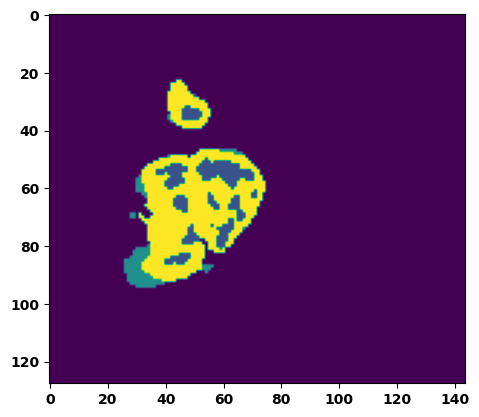

 61%|██████    | 22/36 [00:33<00:21,  1.54s/it]

Batch_id:  21 Eval loss:  0.2203630656003952
Batch_id:  21 Eval IoU:  tensor(0.6606, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9494, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9445, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9800, device='cuda:0')


 64%|██████▍   | 23/36 [00:35<00:21,  1.68s/it]

Batch_id:  22 Eval loss:  0.5837818384170532
Batch_id:  22 Eval IoU:  tensor(0.3635, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 67%|██████▋   | 24/36 [00:36<00:19,  1.66s/it]

Batch_id:  23 Eval loss:  0.10293862223625183
Batch_id:  23 Eval IoU:  tensor(0.8623, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 69%|██████▉   | 25/36 [00:38<00:17,  1.59s/it]

Batch_id:  24 Eval loss:  0.06147018074989319
Batch_id:  24 Eval IoU:  tensor(0.8943, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')


 72%|███████▏  | 26/36 [00:40<00:16,  1.61s/it]

Batch_id:  25 Eval loss:  0.23307974636554718
Batch_id:  25 Eval IoU:  tensor(0.6691, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9876, device='cuda:0')


 75%|███████▌  | 27/36 [00:41<00:14,  1.56s/it]

Batch_id:  26 Eval loss:  0.08502697944641113
Batch_id:  26 Eval IoU:  tensor(0.8536, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


 78%|███████▊  | 28/36 [00:42<00:12,  1.54s/it]

Batch_id:  27 Eval loss:  0.1220349371433258
Batch_id:  27 Eval IoU:  tensor(0.7967, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9886, device='cuda:0')


 81%|████████  | 29/36 [00:44<00:10,  1.52s/it]

Batch_id:  28 Eval loss:  0.08911055326461792
Batch_id:  28 Eval IoU:  tensor(0.8515, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 83%|████████▎ | 30/36 [00:45<00:09,  1.52s/it]

Batch_id:  29 Eval loss:  0.2009889930486679
Batch_id:  29 Eval IoU:  tensor(0.6960, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  30 Eval loss:  0.06876318156719208
Batch_id:  30 Eval IoU:  tensor(0.8831, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


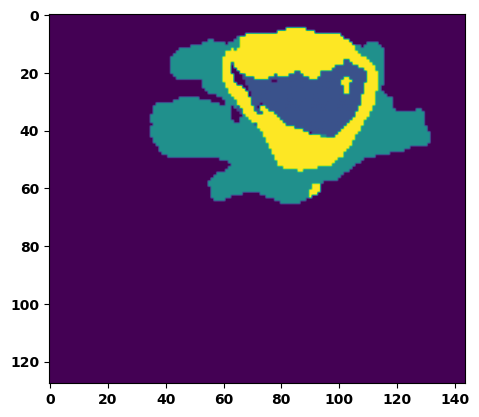

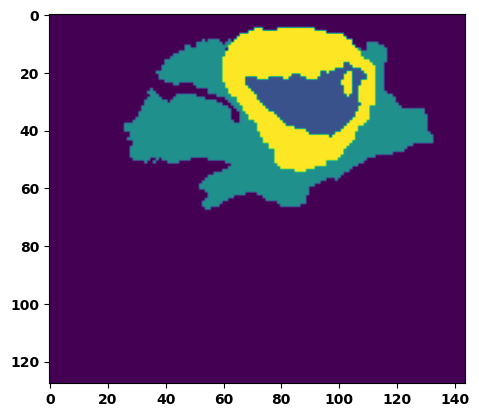

 89%|████████▉ | 32/36 [00:49<00:06,  1.55s/it]

Batch_id:  31 Eval loss:  0.7280145287513733
Batch_id:  31 Eval IoU:  tensor(0.2488, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9300, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9423, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9963, device='cuda:0')


 92%|█████████▏| 33/36 [00:50<00:04,  1.58s/it]

Batch_id:  32 Eval loss:  0.13337600231170654
Batch_id:  32 Eval IoU:  tensor(0.7940, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9446, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')


 94%|█████████▍| 34/36 [00:52<00:03,  1.51s/it]

Batch_id:  33 Eval loss:  0.18060532212257385
Batch_id:  33 Eval IoU:  tensor(0.7283, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')


 97%|█████████▋| 35/36 [00:53<00:01,  1.53s/it]

Batch_id:  34 Eval loss:  0.39964166283607483
Batch_id:  34 Eval IoU:  tensor(0.5268, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')


100%|██████████| 36/36 [00:55<00:00,  1.53s/it]

Batch_id:  35 Eval loss:  0.18147194385528564
Batch_id:  35 Eval IoU:  tensor(0.7238, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9888, device='cuda:0')
Epoch 00031: reducing learning rate of group 0 to 3.1250e-05.
Epoch  30 Training loss:  0.17175511609424243
Epoch  30 Evaluation loss:  0.21832871892386013
Epoch  30 Training accuracy :  tensor(0.7566)
Epoch  30 Evaluation accuracy :  tensor(0.7087)
Epoch  30 Training Mean Dice Score:  tensor(0.9804)
Epoch  30 Eval Mean Dice Score:  tensor(0.9738)
Epoch  30 Training Non-tumor Dice Score:  tensor(0.9819)
Epoch  30 Eval Non-tumor Dice Score:  tensor(0.9728)
Epoch  30 Training NCR/NET Dice Score:  tensor(0.9908)
Epoch  30 Eval NCR/NET Dice Score

Epoch: 31
Training in session: 


  1%|          | 1/110 [00:01<02:45,  1.52s/it]

Batch_id:  0 Training loss:  0.23027640581130981
Batch_id:  0 Training IoU:  tensor(0.7284, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:48,  1.56s/it]

Batch_id:  1 Training loss:  0.17238590121269226
Batch_id:  1 Training IoU:  tensor(0.7969, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9979, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:42,  1.52s/it]

Batch_id:  2 Training loss:  0.1721421480178833
Batch_id:  2 Training IoU:  tensor(0.7461, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:36,  1.48s/it]

Batch_id:  3 Training loss:  0.2710878849029541
Batch_id:  3 Training IoU:  tensor(0.6729, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:37,  1.50s/it]

Batch_id:  4 Training loss:  0.13114890456199646
Batch_id:  4 Training IoU:  tensor(0.7925, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:35,  1.49s/it]

Batch_id:  5 Training loss:  0.12082494795322418
Batch_id:  5 Training IoU:  tensor(0.7986, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:37,  1.53s/it]

Batch_id:  6 Training loss:  0.1324881613254547
Batch_id:  6 Training IoU:  tensor(0.8015, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:36,  1.54s/it]

Batch_id:  7 Training loss:  0.11424075067043304
Batch_id:  7 Training IoU:  tensor(0.8163, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:31,  1.50s/it]

Batch_id:  8 Training loss:  0.1177072525024414
Batch_id:  8 Training IoU:  tensor(0.8031, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:26,  1.47s/it]

Batch_id:  9 Training loss:  0.08861285448074341
Batch_id:  9 Training IoU:  tensor(0.8512, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 10%|█         | 11/110 [00:16<02:28,  1.50s/it]

Batch_id:  10 Training loss:  0.2464296966791153
Batch_id:  10 Training IoU:  tensor(0.6364, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9465, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 11%|█         | 12/110 [00:18<02:25,  1.49s/it]

Batch_id:  11 Training loss:  0.24804355204105377
Batch_id:  11 Training IoU:  tensor(0.6498, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:24,  1.49s/it]

Batch_id:  12 Training loss:  0.1300549954175949
Batch_id:  12 Training IoU:  tensor(0.8054, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:21,  1.48s/it]

Batch_id:  13 Training loss:  0.24697403609752655
Batch_id:  13 Training IoU:  tensor(0.6380, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9348, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9477, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9508, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9301, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9757, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:25,  1.54s/it]

Batch_id:  14 Training loss:  0.1761036217212677
Batch_id:  14 Training IoU:  tensor(0.7184, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:18,  1.47s/it]

Batch_id:  15 Training loss:  0.2157832235097885
Batch_id:  15 Training IoU:  tensor(0.7130, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:14,  1.44s/it]

Batch_id:  16 Training loss:  0.1594095379114151
Batch_id:  16 Training IoU:  tensor(0.7492, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9785, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:11,  1.43s/it]

Batch_id:  17 Training loss:  0.1047707349061966
Batch_id:  17 Training IoU:  tensor(0.8241, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:09,  1.42s/it]

Batch_id:  18 Training loss:  0.17845188081264496
Batch_id:  18 Training IoU:  tensor(0.7257, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:12,  1.47s/it]

Batch_id:  19 Training loss:  0.09716884791851044
Batch_id:  19 Training IoU:  tensor(0.8435, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:10,  1.47s/it]

Batch_id:  20 Training loss:  0.09655986726284027
Batch_id:  20 Training IoU:  tensor(0.8368, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 20%|██        | 22/110 [00:32<02:04,  1.42s/it]

Batch_id:  21 Training loss:  0.32876378297805786
Batch_id:  21 Training IoU:  tensor(0.6163, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 21%|██        | 23/110 [00:33<02:04,  1.43s/it]

Batch_id:  22 Training loss:  0.2200833112001419
Batch_id:  22 Training IoU:  tensor(0.7313, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:01,  1.41s/it]

Batch_id:  23 Training loss:  0.14596103131771088
Batch_id:  23 Training IoU:  tensor(0.7587, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9737, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:00,  1.42s/it]

Batch_id:  24 Training loss:  0.09188365936279297
Batch_id:  24 Training IoU:  tensor(0.8427, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:01,  1.44s/it]

Batch_id:  25 Training loss:  0.2321210652589798
Batch_id:  25 Training IoU:  tensor(0.6698, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 25%|██▍       | 27/110 [00:39<01:59,  1.44s/it]

Batch_id:  26 Training loss:  0.09142310917377472
Batch_id:  26 Training IoU:  tensor(0.8721, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 25%|██▌       | 28/110 [00:41<01:56,  1.42s/it]

Batch_id:  27 Training loss:  0.1575615108013153
Batch_id:  27 Training IoU:  tensor(0.7923, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:54,  1.42s/it]

Batch_id:  28 Training loss:  0.200065478682518
Batch_id:  28 Training IoU:  tensor(0.6966, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9475, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9359, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9730, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:53,  1.42s/it]

Batch_id:  29 Training loss:  0.08938807249069214
Batch_id:  29 Training IoU:  tensor(0.8485, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:53,  1.43s/it]

Batch_id:  30 Training loss:  0.14874817430973053
Batch_id:  30 Training IoU:  tensor(0.7734, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:52,  1.44s/it]

Batch_id:  31 Training loss:  0.08821476995944977
Batch_id:  31 Training IoU:  tensor(0.8551, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 30%|███       | 33/110 [00:48<01:50,  1.44s/it]

Batch_id:  32 Training loss:  0.20124760270118713
Batch_id:  32 Training IoU:  tensor(0.6963, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 31%|███       | 34/110 [00:49<01:54,  1.50s/it]

Batch_id:  33 Training loss:  0.148467555642128
Batch_id:  33 Training IoU:  tensor(0.8059, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:49,  1.46s/it]

Batch_id:  34 Training loss:  0.08991503715515137
Batch_id:  34 Training IoU:  tensor(0.8477, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:48,  1.47s/it]

Batch_id:  35 Training loss:  0.3520454168319702
Batch_id:  35 Training IoU:  tensor(0.6272, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9997, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:46,  1.46s/it]

Batch_id:  36 Training loss:  0.09001854062080383
Batch_id:  36 Training IoU:  tensor(0.8520, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:46,  1.47s/it]

Batch_id:  37 Training loss:  0.26904743909835815
Batch_id:  37 Training IoU:  tensor(0.6330, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9567, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:43,  1.45s/it]

Batch_id:  38 Training loss:  0.5297076106071472
Batch_id:  38 Training IoU:  tensor(0.4177, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:39,  1.42s/it]

Batch_id:  39 Training loss:  0.1141434907913208
Batch_id:  39 Training IoU:  tensor(0.8276, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:39,  1.44s/it]

Batch_id:  40 Training loss:  0.09214605391025543
Batch_id:  40 Training IoU:  tensor(0.8461, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:36,  1.42s/it]

Batch_id:  41 Training loss:  0.09413991868495941
Batch_id:  41 Training IoU:  tensor(0.8370, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:36,  1.43s/it]

Batch_id:  42 Training loss:  0.17756019532680511
Batch_id:  42 Training IoU:  tensor(0.7374, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 40%|████      | 44/110 [01:04<01:34,  1.43s/it]

Batch_id:  43 Training loss:  0.1948871910572052
Batch_id:  43 Training IoU:  tensor(0.7057, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 41%|████      | 45/110 [01:05<01:30,  1.39s/it]

Batch_id:  44 Training loss:  0.14767485857009888
Batch_id:  44 Training IoU:  tensor(0.7612, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:28,  1.38s/it]

Batch_id:  45 Training loss:  0.1448812037706375
Batch_id:  45 Training IoU:  tensor(0.7748, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:26,  1.38s/it]

Batch_id:  46 Training loss:  0.11079128086566925
Batch_id:  46 Training IoU:  tensor(0.8233, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9847, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:26,  1.40s/it]

Batch_id:  47 Training loss:  0.4267822504043579
Batch_id:  47 Training IoU:  tensor(0.4816, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9171, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:26,  1.41s/it]

Batch_id:  48 Training loss:  0.2420813888311386
Batch_id:  48 Training IoU:  tensor(0.6555, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9775, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:22,  1.37s/it]

Batch_id:  49 Training loss:  0.0921141505241394
Batch_id:  49 Training IoU:  tensor(0.8559, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 46%|████▋     | 51/110 [01:13<01:21,  1.38s/it]

Batch_id:  50 Training loss:  0.16477976739406586
Batch_id:  50 Training IoU:  tensor(0.7367, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:20,  1.38s/it]

Batch_id:  51 Training loss:  0.18698370456695557
Batch_id:  51 Training IoU:  tensor(0.7228, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:18,  1.37s/it]

Batch_id:  52 Training loss:  0.12730911374092102
Batch_id:  52 Training IoU:  tensor(0.7996, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 49%|████▉     | 54/110 [01:17<01:16,  1.37s/it]

Batch_id:  53 Training loss:  0.10492344200611115
Batch_id:  53 Training IoU:  tensor(0.8261, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:17,  1.41s/it]

Batch_id:  54 Training loss:  0.04792982339859009
Batch_id:  54 Training IoU:  tensor(0.9156, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 51%|█████     | 56/110 [01:20<01:15,  1.40s/it]

Batch_id:  55 Training loss:  0.2612212896347046
Batch_id:  55 Training IoU:  tensor(0.6426, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 52%|█████▏    | 57/110 [01:22<01:15,  1.42s/it]

Batch_id:  56 Training loss:  0.21269838511943817
Batch_id:  56 Training IoU:  tensor(0.6765, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9220, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 53%|█████▎    | 58/110 [01:23<01:12,  1.40s/it]

Batch_id:  57 Training loss:  0.1548701822757721
Batch_id:  57 Training IoU:  tensor(0.7534, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 54%|█████▎    | 59/110 [01:24<01:10,  1.38s/it]

Batch_id:  58 Training loss:  0.05456501245498657
Batch_id:  58 Training IoU:  tensor(0.9095, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 55%|█████▍    | 60/110 [01:26<01:10,  1.42s/it]

Batch_id:  59 Training loss:  0.047060057520866394
Batch_id:  59 Training IoU:  tensor(0.9199, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 55%|█████▌    | 61/110 [01:27<01:09,  1.42s/it]

Batch_id:  60 Training loss:  0.22435344755649567
Batch_id:  60 Training IoU:  tensor(0.6700, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 56%|█████▋    | 62/110 [01:29<01:08,  1.42s/it]

Batch_id:  61 Training loss:  0.056087926030159
Batch_id:  61 Training IoU:  tensor(0.9087, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 57%|█████▋    | 63/110 [01:30<01:06,  1.41s/it]

Batch_id:  62 Training loss:  0.34424781799316406
Batch_id:  62 Training IoU:  tensor(0.5889, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 58%|█████▊    | 64/110 [01:32<01:05,  1.42s/it]

Batch_id:  63 Training loss:  0.07472103834152222
Batch_id:  63 Training IoU:  tensor(0.8704, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 59%|█████▉    | 65/110 [01:33<01:05,  1.45s/it]

Batch_id:  64 Training loss:  0.16808973252773285
Batch_id:  64 Training IoU:  tensor(0.7282, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9819, device='cuda:0')


 60%|██████    | 66/110 [01:35<01:03,  1.44s/it]

Batch_id:  65 Training loss:  0.2761685848236084
Batch_id:  65 Training IoU:  tensor(0.6156, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9490, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9283, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 61%|██████    | 67/110 [01:36<01:00,  1.42s/it]

Batch_id:  66 Training loss:  0.06787154078483582
Batch_id:  66 Training IoU:  tensor(0.8827, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 62%|██████▏   | 68/110 [01:37<00:59,  1.41s/it]

Batch_id:  67 Training loss:  0.26901984214782715
Batch_id:  67 Training IoU:  tensor(0.6842, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 63%|██████▎   | 69/110 [01:39<00:56,  1.37s/it]

Batch_id:  68 Training loss:  0.21122251451015472
Batch_id:  68 Training IoU:  tensor(0.6882, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 64%|██████▎   | 70/110 [01:40<00:55,  1.38s/it]

Batch_id:  69 Training loss:  0.10432364046573639
Batch_id:  69 Training IoU:  tensor(0.8276, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 65%|██████▍   | 71/110 [01:41<00:54,  1.40s/it]

Batch_id:  70 Training loss:  0.15253174304962158
Batch_id:  70 Training IoU:  tensor(0.7560, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


 65%|██████▌   | 72/110 [01:43<00:55,  1.47s/it]

Batch_id:  71 Training loss:  0.2989530861377716
Batch_id:  71 Training IoU:  tensor(0.6452, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 66%|██████▋   | 73/110 [01:45<00:54,  1.47s/it]

Batch_id:  72 Training loss:  0.17805354297161102
Batch_id:  72 Training IoU:  tensor(0.7939, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 67%|██████▋   | 74/110 [01:46<00:54,  1.50s/it]

Batch_id:  73 Training loss:  0.15631772577762604
Batch_id:  73 Training IoU:  tensor(0.7517, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9717, device='cuda:0')


 68%|██████▊   | 75/110 [01:47<00:51,  1.46s/it]

Batch_id:  74 Training loss:  0.3632269501686096
Batch_id:  74 Training IoU:  tensor(0.5707, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 69%|██████▉   | 76/110 [01:49<00:48,  1.43s/it]

Batch_id:  75 Training loss:  0.1555567979812622
Batch_id:  75 Training IoU:  tensor(0.7819, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 70%|███████   | 77/110 [01:50<00:46,  1.41s/it]

Batch_id:  76 Training loss:  0.13451430201530457
Batch_id:  76 Training IoU:  tensor(0.7813, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 71%|███████   | 78/110 [01:52<00:45,  1.43s/it]

Batch_id:  77 Training loss:  0.13774164021015167
Batch_id:  77 Training IoU:  tensor(0.7922, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 72%|███████▏  | 79/110 [01:53<00:43,  1.41s/it]

Batch_id:  78 Training loss:  0.06082265079021454
Batch_id:  78 Training IoU:  tensor(0.8962, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 73%|███████▎  | 80/110 [01:54<00:42,  1.42s/it]

Batch_id:  79 Training loss:  0.25447702407836914
Batch_id:  79 Training IoU:  tensor(0.6287, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9759, device='cuda:0')


 74%|███████▎  | 81/110 [01:56<00:40,  1.41s/it]

Batch_id:  80 Training loss:  0.17848381400108337
Batch_id:  80 Training IoU:  tensor(0.7377, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 75%|███████▍  | 82/110 [01:57<00:40,  1.44s/it]

Batch_id:  81 Training loss:  0.11609619855880737
Batch_id:  81 Training IoU:  tensor(0.8097, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9762, device='cuda:0')


 75%|███████▌  | 83/110 [01:59<00:38,  1.42s/it]

Batch_id:  82 Training loss:  0.08501748740673065
Batch_id:  82 Training IoU:  tensor(0.8545, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 76%|███████▋  | 84/110 [02:00<00:37,  1.46s/it]

Batch_id:  83 Training loss:  0.18105188012123108
Batch_id:  83 Training IoU:  tensor(0.7144, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 77%|███████▋  | 85/110 [02:02<00:37,  1.50s/it]

Batch_id:  84 Training loss:  0.1171489953994751
Batch_id:  84 Training IoU:  tensor(0.8159, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 78%|███████▊  | 86/110 [02:03<00:35,  1.48s/it]

Batch_id:  85 Training loss:  0.04137606918811798
Batch_id:  85 Training IoU:  tensor(0.9295, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 79%|███████▉  | 87/110 [02:05<00:32,  1.42s/it]

Batch_id:  86 Training loss:  0.3641156554222107
Batch_id:  86 Training IoU:  tensor(0.5863, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 80%|████████  | 88/110 [02:06<00:30,  1.40s/it]

Batch_id:  87 Training loss:  0.118804931640625
Batch_id:  87 Training IoU:  tensor(0.8059, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 81%|████████  | 89/110 [02:08<00:30,  1.46s/it]

Batch_id:  88 Training loss:  0.1385532021522522
Batch_id:  88 Training IoU:  tensor(0.7829, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 82%|████████▏ | 90/110 [02:09<00:29,  1.46s/it]

Batch_id:  89 Training loss:  0.11453460156917572
Batch_id:  89 Training IoU:  tensor(0.8081, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9625, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9474, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 83%|████████▎ | 91/110 [02:10<00:27,  1.45s/it]

Batch_id:  90 Training loss:  0.12714414298534393
Batch_id:  90 Training IoU:  tensor(0.7917, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 84%|████████▎ | 92/110 [02:12<00:26,  1.50s/it]

Batch_id:  91 Training loss:  0.06104382872581482
Batch_id:  91 Training IoU:  tensor(0.8962, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 85%|████████▍ | 93/110 [02:14<00:25,  1.49s/it]

Batch_id:  92 Training loss:  0.13440975546836853
Batch_id:  92 Training IoU:  tensor(0.8034, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 85%|████████▌ | 94/110 [02:15<00:23,  1.46s/it]

Batch_id:  93 Training loss:  0.14498558640480042
Batch_id:  93 Training IoU:  tensor(0.7646, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 86%|████████▋ | 95/110 [02:16<00:21,  1.46s/it]

Batch_id:  94 Training loss:  0.0991201102733612
Batch_id:  94 Training IoU:  tensor(0.8306, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 87%|████████▋ | 96/110 [02:18<00:21,  1.51s/it]

Batch_id:  95 Training loss:  0.26325327157974243
Batch_id:  95 Training IoU:  tensor(0.6544, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 88%|████████▊ | 97/110 [02:19<00:18,  1.45s/it]

Batch_id:  96 Training loss:  0.14162738621234894
Batch_id:  96 Training IoU:  tensor(0.7967, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 89%|████████▉ | 98/110 [02:21<00:17,  1.49s/it]

Batch_id:  97 Training loss:  0.13111740350723267
Batch_id:  97 Training IoU:  tensor(0.7924, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 90%|█████████ | 99/110 [02:22<00:16,  1.48s/it]

Batch_id:  98 Training loss:  0.2571367025375366
Batch_id:  98 Training IoU:  tensor(0.6441, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 91%|█████████ | 100/110 [02:24<00:15,  1.50s/it]

Batch_id:  99 Training loss:  0.18048831820487976
Batch_id:  99 Training IoU:  tensor(0.8226, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 92%|█████████▏| 101/110 [02:25<00:13,  1.49s/it]

Batch_id:  100 Training loss:  0.24402984976768494
Batch_id:  100 Training IoU:  tensor(0.6886, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 93%|█████████▎| 102/110 [02:27<00:11,  1.47s/it]

Batch_id:  101 Training loss:  0.06574788689613342
Batch_id:  101 Training IoU:  tensor(0.8898, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 94%|█████████▎| 103/110 [02:28<00:10,  1.46s/it]

Batch_id:  102 Training loss:  0.09682302176952362
Batch_id:  102 Training IoU:  tensor(0.8392, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 95%|█████████▍| 104/110 [02:30<00:08,  1.50s/it]

Batch_id:  103 Training loss:  0.1411641389131546
Batch_id:  103 Training IoU:  tensor(0.7942, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 95%|█████████▌| 105/110 [02:31<00:07,  1.47s/it]

Batch_id:  104 Training loss:  0.21689660847187042
Batch_id:  104 Training IoU:  tensor(0.6819, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 96%|█████████▋| 106/110 [02:33<00:05,  1.46s/it]

Batch_id:  105 Training loss:  0.3919069170951843
Batch_id:  105 Training IoU:  tensor(0.5318, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 97%|█████████▋| 107/110 [02:34<00:04,  1.46s/it]

Batch_id:  106 Training loss:  0.07933790981769562
Batch_id:  106 Training IoU:  tensor(0.8791, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 98%|█████████▊| 108/110 [02:36<00:02,  1.45s/it]

Batch_id:  107 Training loss:  0.22560419142246246
Batch_id:  107 Training IoU:  tensor(0.6669, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 99%|█████████▉| 109/110 [02:37<00:01,  1.45s/it]

Batch_id:  108 Training loss:  0.47303536534309387
Batch_id:  108 Training IoU:  tensor(0.4496, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


100%|██████████| 110/110 [02:39<00:00,  1.45s/it]


Batch_id:  109 Training loss:  0.08200863003730774
Batch_id:  109 Training IoU:  tensor(0.8635, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9907, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.5897136330604553
Batch_id:  0 Eval IoU:  tensor(0.3601, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9960, device='cuda:0')


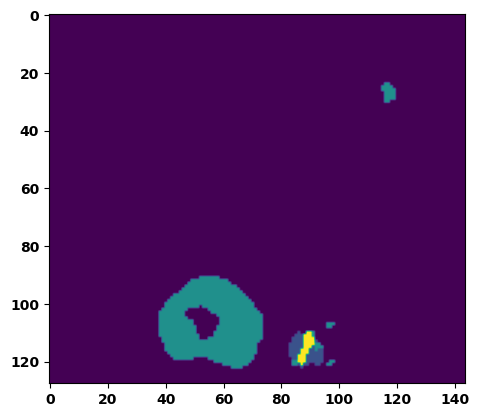

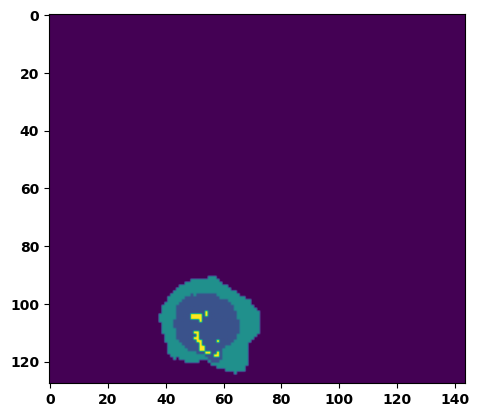

  6%|▌         | 2/36 [00:03<00:50,  1.48s/it]

Batch_id:  1 Eval loss:  0.18049758672714233
Batch_id:  1 Eval IoU:  tensor(0.7239, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.50s/it]

Batch_id:  2 Eval loss:  0.4050552546977997
Batch_id:  2 Eval IoU:  tensor(0.5293, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9060, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.8602, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.8596, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 11%|█         | 4/36 [00:06<00:48,  1.51s/it]

Batch_id:  3 Eval loss:  0.06985768675804138
Batch_id:  3 Eval IoU:  tensor(0.8796, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.47s/it]

Batch_id:  4 Eval loss:  0.3994472026824951
Batch_id:  4 Eval IoU:  tensor(0.4889, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9247, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9178, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:45,  1.53s/it]

Batch_id:  5 Eval loss:  0.10030239820480347
Batch_id:  5 Eval IoU:  tensor(0.8274, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:43,  1.50s/it]

Batch_id:  6 Eval loss:  0.379589706659317
Batch_id:  6 Eval IoU:  tensor(0.5499, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:42,  1.51s/it]

Batch_id:  7 Eval loss:  0.2555885314941406
Batch_id:  7 Eval IoU:  tensor(0.6518, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:40,  1.49s/it]

Batch_id:  8 Eval loss:  0.506352424621582
Batch_id:  8 Eval IoU:  tensor(0.4044, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9355, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9293, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9387, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  9 Eval loss:  0.1960853487253189
Batch_id:  9 Eval IoU:  tensor(0.7016, device='cuda:0')


 28%|██▊       | 10/36 [00:15<00:41,  1.58s/it]

Batch_id:  9 Eval Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  10 Eval loss:  0.0798630565404892
Batch_id:  10 Eval IoU:  tensor(0.8608, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


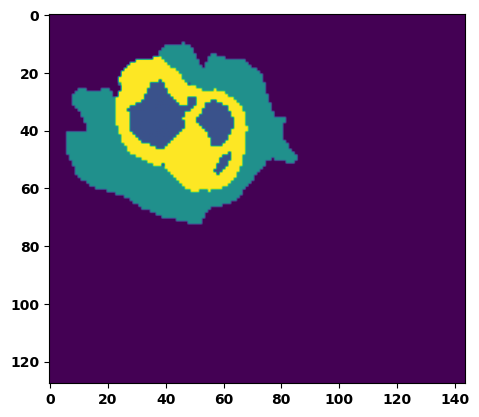

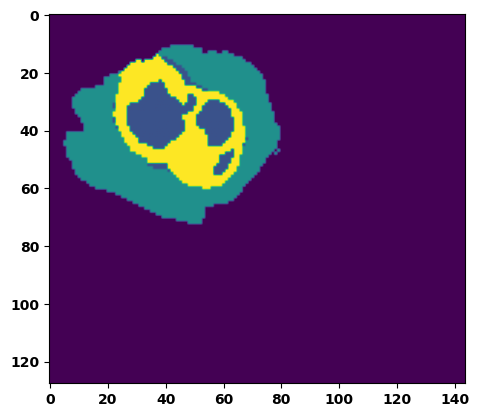

 33%|███▎      | 12/36 [00:18<00:36,  1.54s/it]

Batch_id:  11 Eval loss:  0.0932515412569046
Batch_id:  11 Eval IoU:  tensor(0.8449, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:35,  1.55s/it]

Batch_id:  12 Eval loss:  0.7201334834098816
Batch_id:  12 Eval IoU:  tensor(0.2541, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9323, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9395, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:33,  1.51s/it]

Batch_id:  13 Eval loss:  0.061452046036720276
Batch_id:  13 Eval IoU:  tensor(0.9025, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:32,  1.52s/it]

Batch_id:  14 Eval loss:  0.0957772433757782
Batch_id:  14 Eval IoU:  tensor(0.8735, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:31,  1.56s/it]

Batch_id:  15 Eval loss:  0.07704795897006989
Batch_id:  15 Eval IoU:  tensor(0.8851, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:28,  1.49s/it]

Batch_id:  16 Eval loss:  0.07712821662425995
Batch_id:  16 Eval IoU:  tensor(0.8703, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


 50%|█████     | 18/36 [00:27<00:27,  1.52s/it]

Batch_id:  17 Eval loss:  0.2857683598995209
Batch_id:  17 Eval IoU:  tensor(0.6160, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9399, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:24,  1.43s/it]

Batch_id:  18 Eval loss:  0.14501018822193146
Batch_id:  18 Eval IoU:  tensor(0.7829, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 56%|█████▌    | 20/36 [00:30<00:23,  1.47s/it]

Batch_id:  19 Eval loss:  0.12921738624572754
Batch_id:  19 Eval IoU:  tensor(0.7997, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9452, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  20 Eval loss:  0.14279434084892273
Batch_id:  20 Eval IoU:  tensor(0.7723, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


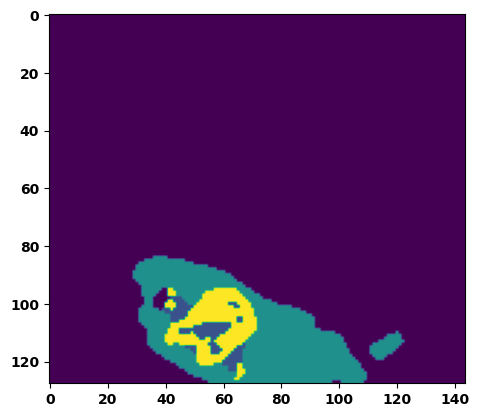

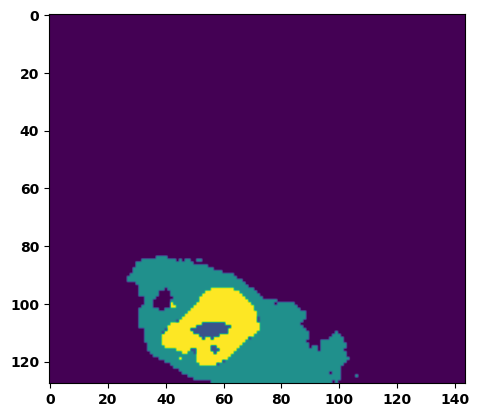

 61%|██████    | 22/36 [00:33<00:21,  1.54s/it]

Batch_id:  21 Eval loss:  0.39230960607528687
Batch_id:  21 Eval IoU:  tensor(0.5383, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 64%|██████▍   | 23/36 [00:35<00:21,  1.62s/it]

Batch_id:  22 Eval loss:  0.1936091184616089
Batch_id:  22 Eval IoU:  tensor(0.7114, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


 67%|██████▋   | 24/36 [00:36<00:18,  1.56s/it]

Batch_id:  23 Eval loss:  0.23406976461410522
Batch_id:  23 Eval IoU:  tensor(0.6695, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9799, device='cuda:0')


 69%|██████▉   | 25/36 [00:38<00:16,  1.53s/it]

Batch_id:  24 Eval loss:  0.21473492681980133
Batch_id:  24 Eval IoU:  tensor(0.6678, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9500, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9820, device='cuda:0')


 72%|███████▏  | 26/36 [00:39<00:15,  1.52s/it]

Batch_id:  25 Eval loss:  0.25895583629608154
Batch_id:  25 Eval IoU:  tensor(0.6951, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9957, device='cuda:0')


 75%|███████▌  | 27/36 [00:41<00:13,  1.55s/it]

Batch_id:  26 Eval loss:  0.07961657643318176
Batch_id:  26 Eval IoU:  tensor(0.8651, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 78%|███████▊  | 28/36 [00:42<00:12,  1.50s/it]

Batch_id:  27 Eval loss:  0.2948979139328003
Batch_id:  27 Eval IoU:  tensor(0.6056, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9370, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


 81%|████████  | 29/36 [00:44<00:10,  1.47s/it]

Batch_id:  28 Eval loss:  0.29274076223373413
Batch_id:  28 Eval IoU:  tensor(0.6421, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 83%|████████▎ | 30/36 [00:45<00:08,  1.43s/it]

Batch_id:  29 Eval loss:  0.14692962169647217
Batch_id:  29 Eval IoU:  tensor(0.7631, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  30 Eval loss:  0.24974465370178223
Batch_id:  30 Eval IoU:  tensor(0.6501, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9875, device='cuda:0')


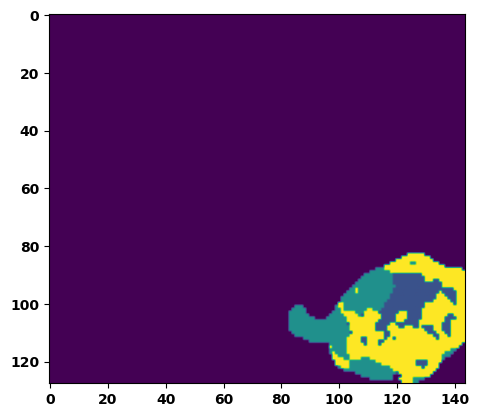

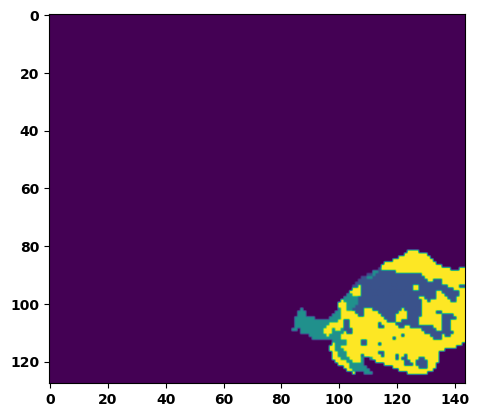

 89%|████████▉ | 32/36 [00:48<00:06,  1.52s/it]

Batch_id:  31 Eval loss:  0.09493193030357361
Batch_id:  31 Eval IoU:  tensor(0.8362, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 92%|█████████▏| 33/36 [00:50<00:04,  1.49s/it]

Batch_id:  32 Eval loss:  0.19446305930614471
Batch_id:  32 Eval IoU:  tensor(0.7163, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 94%|█████████▍| 34/36 [00:51<00:03,  1.52s/it]

Batch_id:  33 Eval loss:  0.19970805943012238
Batch_id:  33 Eval IoU:  tensor(0.7103, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 97%|█████████▋| 35/36 [00:53<00:01,  1.50s/it]

Batch_id:  34 Eval loss:  0.10464951395988464
Batch_id:  34 Eval IoU:  tensor(0.8226, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


100%|██████████| 36/36 [00:54<00:00,  1.52s/it]

Batch_id:  35 Eval loss:  0.05992090702056885
Batch_id:  35 Eval IoU:  tensor(0.8965, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')
Epoch  31 Training loss:  0.17113851403648203
Epoch  31 Evaluation loss:  0.22225599570406807
Epoch  31 Training accuracy :  tensor(0.7571)
Epoch  31 Evaluation accuracy :  tensor(0.7047)
Epoch  31 Training Mean Dice Score:  tensor(0.9806)
Epoch  31 Eval Mean Dice Score:  tensor(0.9734)
Epoch  31 Training Non-tumor Dice Score:  tensor(0.9822)
Epoch  31 Eval Non-tumor Dice Score:  tensor(0.9726)
Epoch  31 Training NCR/NET Dice Score:  tensor(0.9909)
Epoch  31 Eval NCR/NET Dice Score:  tensor(0.9873)
Epoch  31 Training ED Dice Score:  tensor(0.

Epoch: 32
Training in session: 


  1%|          | 1/110 [00:01<03:03,  1.68s/it]

Batch_id:  0 Training loss:  0.04268275201320648
Batch_id:  0 Training IoU:  tensor(0.9265, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:52,  1.60s/it]

Batch_id:  1 Training loss:  0.2742142677307129
Batch_id:  1 Training IoU:  tensor(0.6793, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:46,  1.56s/it]

Batch_id:  2 Training loss:  0.24286875128746033
Batch_id:  2 Training IoU:  tensor(0.6429, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9370, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9331, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9763, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:42,  1.53s/it]

Batch_id:  3 Training loss:  0.14850342273712158
Batch_id:  3 Training IoU:  tensor(0.7609, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:42,  1.55s/it]

Batch_id:  4 Training loss:  0.09216107428073883
Batch_id:  4 Training IoU:  tensor(0.8710, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:35,  1.49s/it]

Batch_id:  5 Training loss:  0.15332555770874023
Batch_id:  5 Training IoU:  tensor(0.7845, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:37,  1.52s/it]

Batch_id:  6 Training loss:  0.21902243793010712
Batch_id:  6 Training IoU:  tensor(0.6749, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:35,  1.52s/it]

Batch_id:  7 Training loss:  0.16050975024700165
Batch_id:  7 Training IoU:  tensor(0.7443, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:31,  1.50s/it]

Batch_id:  8 Training loss:  0.12201669812202454
Batch_id:  8 Training IoU:  tensor(0.7986, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:29,  1.49s/it]

Batch_id:  9 Training loss:  0.11696957051753998
Batch_id:  9 Training IoU:  tensor(0.8168, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 10%|█         | 11/110 [00:16<02:30,  1.52s/it]

Batch_id:  10 Training loss:  0.1271803379058838
Batch_id:  10 Training IoU:  tensor(0.8100, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 11%|█         | 12/110 [00:18<02:31,  1.55s/it]

Batch_id:  11 Training loss:  0.04655902087688446
Batch_id:  11 Training IoU:  tensor(0.9191, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 12%|█▏        | 13/110 [00:20<02:34,  1.59s/it]

Batch_id:  12 Training loss:  0.08950617909431458
Batch_id:  12 Training IoU:  tensor(0.8482, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:27,  1.54s/it]

Batch_id:  13 Training loss:  0.23506374657154083
Batch_id:  13 Training IoU:  tensor(0.6632, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9603, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9557, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:23,  1.51s/it]

Batch_id:  14 Training loss:  0.24487130343914032
Batch_id:  14 Training IoU:  tensor(0.6870, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:21,  1.50s/it]

Batch_id:  15 Training loss:  0.25683528184890747
Batch_id:  15 Training IoU:  tensor(0.6948, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 15%|█▌        | 17/110 [00:26<02:21,  1.52s/it]

Batch_id:  16 Training loss:  0.09082753956317902
Batch_id:  16 Training IoU:  tensor(0.8454, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:16,  1.48s/it]

Batch_id:  17 Training loss:  0.2694440484046936
Batch_id:  17 Training IoU:  tensor(0.6214, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9537, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9276, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:15,  1.49s/it]

Batch_id:  18 Training loss:  0.09545044600963593
Batch_id:  18 Training IoU:  tensor(0.8376, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:16,  1.51s/it]

Batch_id:  19 Training loss:  0.10139480233192444
Batch_id:  19 Training IoU:  tensor(0.8301, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 19%|█▉        | 21/110 [00:32<02:14,  1.52s/it]

Batch_id:  20 Training loss:  0.11519588530063629
Batch_id:  20 Training IoU:  tensor(0.8117, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 20%|██        | 22/110 [00:33<02:13,  1.51s/it]

Batch_id:  21 Training loss:  0.09801807999610901
Batch_id:  21 Training IoU:  tensor(0.8369, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9821, device='cuda:0')


 21%|██        | 23/110 [00:34<02:09,  1.48s/it]

Batch_id:  22 Training loss:  0.13249051570892334
Batch_id:  22 Training IoU:  tensor(0.7830, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:07,  1.48s/it]

Batch_id:  23 Training loss:  0.07879535853862762
Batch_id:  23 Training IoU:  tensor(0.8811, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:04,  1.47s/it]

Batch_id:  24 Training loss:  0.20317165553569794
Batch_id:  24 Training IoU:  tensor(0.6946, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:06,  1.50s/it]

Batch_id:  25 Training loss:  0.21697527170181274
Batch_id:  25 Training IoU:  tensor(0.7102, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 25%|██▍       | 27/110 [00:40<02:03,  1.48s/it]

Batch_id:  26 Training loss:  0.28036442399024963
Batch_id:  26 Training IoU:  tensor(0.6633, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 25%|██▌       | 28/110 [00:42<02:02,  1.49s/it]

Batch_id:  27 Training loss:  0.10630050301551819
Batch_id:  27 Training IoU:  tensor(0.8326, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


 26%|██▋       | 29/110 [00:43<02:03,  1.53s/it]

Batch_id:  28 Training loss:  0.18290436267852783
Batch_id:  28 Training IoU:  tensor(0.7314, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 27%|██▋       | 30/110 [00:45<01:58,  1.48s/it]

Batch_id:  29 Training loss:  0.15671095252037048
Batch_id:  29 Training IoU:  tensor(0.7680, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 28%|██▊       | 31/110 [00:46<01:56,  1.47s/it]

Batch_id:  30 Training loss:  0.17918618023395538
Batch_id:  30 Training IoU:  tensor(0.7358, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 29%|██▉       | 32/110 [00:48<01:54,  1.47s/it]

Batch_id:  31 Training loss:  0.16616636514663696
Batch_id:  31 Training IoU:  tensor(0.8047, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 30%|███       | 33/110 [00:49<01:53,  1.48s/it]

Batch_id:  32 Training loss:  0.1809408962726593
Batch_id:  32 Training IoU:  tensor(0.7140, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 31%|███       | 34/110 [00:51<01:50,  1.45s/it]

Batch_id:  33 Training loss:  0.10229334235191345
Batch_id:  33 Training IoU:  tensor(0.8277, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:51,  1.48s/it]

Batch_id:  34 Training loss:  0.08833128213882446
Batch_id:  34 Training IoU:  tensor(0.8495, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:49,  1.48s/it]

Batch_id:  35 Training loss:  0.22514672577381134
Batch_id:  35 Training IoU:  tensor(0.7275, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 34%|███▎      | 37/110 [00:55<01:48,  1.48s/it]

Batch_id:  36 Training loss:  0.3319967985153198
Batch_id:  36 Training IoU:  tensor(0.6112, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 35%|███▍      | 38/110 [00:57<01:47,  1.50s/it]

Batch_id:  37 Training loss:  0.35343632102012634
Batch_id:  37 Training IoU:  tensor(0.6274, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9997, device='cuda:0')


 35%|███▌      | 39/110 [00:58<01:44,  1.46s/it]

Batch_id:  38 Training loss:  0.11582687497138977
Batch_id:  38 Training IoU:  tensor(0.8066, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9522, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 36%|███▋      | 40/110 [01:00<01:42,  1.47s/it]

Batch_id:  39 Training loss:  0.17803436517715454
Batch_id:  39 Training IoU:  tensor(0.7156, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:41,  1.47s/it]

Batch_id:  40 Training loss:  0.1330997496843338
Batch_id:  40 Training IoU:  tensor(0.8059, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 38%|███▊      | 42/110 [01:03<01:39,  1.46s/it]

Batch_id:  41 Training loss:  0.14990784227848053
Batch_id:  41 Training IoU:  tensor(0.7588, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:36,  1.45s/it]

Batch_id:  42 Training loss:  0.13980035483837128
Batch_id:  42 Training IoU:  tensor(0.7992, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 40%|████      | 44/110 [01:05<01:34,  1.43s/it]

Batch_id:  43 Training loss:  0.09535069763660431
Batch_id:  43 Training IoU:  tensor(0.8461, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 41%|████      | 45/110 [01:07<01:35,  1.47s/it]

Batch_id:  44 Training loss:  0.13257846236228943
Batch_id:  44 Training IoU:  tensor(0.7996, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:34,  1.47s/it]

Batch_id:  45 Training loss:  0.21425160765647888
Batch_id:  45 Training IoU:  tensor(0.6744, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9375, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9385, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9207, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


 43%|████▎     | 47/110 [01:10<01:35,  1.52s/it]

Batch_id:  46 Training loss:  0.2707623243331909
Batch_id:  46 Training IoU:  tensor(0.6317, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9570, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:34,  1.52s/it]

Batch_id:  47 Training loss:  0.1766822785139084
Batch_id:  47 Training IoU:  tensor(0.7276, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 45%|████▍     | 49/110 [01:13<01:30,  1.49s/it]

Batch_id:  48 Training loss:  0.08835873007774353
Batch_id:  48 Training IoU:  tensor(0.8616, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 45%|████▌     | 50/110 [01:14<01:29,  1.49s/it]

Batch_id:  49 Training loss:  0.14083954691886902
Batch_id:  49 Training IoU:  tensor(0.7660, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9744, device='cuda:0')


 46%|████▋     | 51/110 [01:16<01:27,  1.48s/it]

Batch_id:  50 Training loss:  0.14621277153491974
Batch_id:  50 Training IoU:  tensor(0.7723, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 47%|████▋     | 52/110 [01:17<01:24,  1.46s/it]

Batch_id:  51 Training loss:  0.1043245792388916
Batch_id:  51 Training IoU:  tensor(0.8242, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 48%|████▊     | 53/110 [01:19<01:23,  1.47s/it]

Batch_id:  52 Training loss:  0.08761562407016754
Batch_id:  52 Training IoU:  tensor(0.8567, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 49%|████▉     | 54/110 [01:20<01:23,  1.48s/it]

Batch_id:  53 Training loss:  0.06029346585273743
Batch_id:  53 Training IoU:  tensor(0.8971, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 50%|█████     | 55/110 [01:22<01:19,  1.45s/it]

Batch_id:  54 Training loss:  0.26348876953125
Batch_id:  54 Training IoU:  tensor(0.6390, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9841, device='cuda:0')


 51%|█████     | 56/110 [01:24<01:25,  1.57s/it]

Batch_id:  55 Training loss:  0.1299014687538147
Batch_id:  55 Training IoU:  tensor(0.8048, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 52%|█████▏    | 57/110 [01:25<01:22,  1.56s/it]

Batch_id:  56 Training loss:  0.06914018094539642
Batch_id:  56 Training IoU:  tensor(0.8850, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 53%|█████▎    | 58/110 [01:27<01:19,  1.53s/it]

Batch_id:  57 Training loss:  0.4194853603839874
Batch_id:  57 Training IoU:  tensor(0.4891, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9391, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9201, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 54%|█████▎    | 59/110 [01:28<01:15,  1.48s/it]

Batch_id:  58 Training loss:  0.13995376229286194
Batch_id:  58 Training IoU:  tensor(0.7855, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 55%|█████▍    | 60/110 [01:29<01:14,  1.49s/it]

Batch_id:  59 Training loss:  0.4594728350639343
Batch_id:  59 Training IoU:  tensor(0.4603, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 55%|█████▌    | 61/110 [01:31<01:13,  1.49s/it]

Batch_id:  60 Training loss:  0.12769027054309845
Batch_id:  60 Training IoU:  tensor(0.7967, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 56%|█████▋    | 62/110 [01:32<01:09,  1.46s/it]

Batch_id:  61 Training loss:  0.06576915085315704
Batch_id:  61 Training IoU:  tensor(0.8860, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 57%|█████▋    | 63/110 [01:34<01:06,  1.41s/it]

Batch_id:  62 Training loss:  0.09048794209957123
Batch_id:  62 Training IoU:  tensor(0.8427, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 58%|█████▊    | 64/110 [01:35<01:07,  1.47s/it]

Batch_id:  63 Training loss:  0.052723705768585205
Batch_id:  63 Training IoU:  tensor(0.9119, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 59%|█████▉    | 65/110 [01:37<01:06,  1.48s/it]

Batch_id:  64 Training loss:  0.258905827999115
Batch_id:  64 Training IoU:  tensor(0.6381, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9513, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 60%|██████    | 66/110 [01:38<01:06,  1.50s/it]

Batch_id:  65 Training loss:  0.11441251635551453
Batch_id:  65 Training IoU:  tensor(0.8163, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 61%|██████    | 67/110 [01:40<01:03,  1.47s/it]

Batch_id:  66 Training loss:  0.0875055342912674
Batch_id:  66 Training IoU:  tensor(0.8501, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 62%|██████▏   | 68/110 [01:41<01:00,  1.44s/it]

Batch_id:  67 Training loss:  0.353804349899292
Batch_id:  67 Training IoU:  tensor(0.5981, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 63%|██████▎   | 69/110 [01:43<01:00,  1.47s/it]

Batch_id:  68 Training loss:  0.10370850563049316
Batch_id:  68 Training IoU:  tensor(0.8432, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 64%|██████▎   | 70/110 [01:44<00:57,  1.43s/it]

Batch_id:  69 Training loss:  0.16004131734371185
Batch_id:  69 Training IoU:  tensor(0.7876, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 65%|██████▍   | 71/110 [01:45<00:55,  1.41s/it]

Batch_id:  70 Training loss:  0.08370596170425415
Batch_id:  70 Training IoU:  tensor(0.8551, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 65%|██████▌   | 72/110 [01:47<00:54,  1.42s/it]

Batch_id:  71 Training loss:  0.22422818839550018
Batch_id:  71 Training IoU:  tensor(0.6694, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 66%|██████▋   | 73/110 [01:48<00:52,  1.43s/it]

Batch_id:  72 Training loss:  0.054068952798843384
Batch_id:  72 Training IoU:  tensor(0.9137, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:49,  1.38s/it]

Batch_id:  73 Training loss:  0.1282755583524704
Batch_id:  73 Training IoU:  tensor(0.7963, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 68%|██████▊   | 75/110 [01:51<00:48,  1.37s/it]

Batch_id:  74 Training loss:  0.22881372272968292
Batch_id:  74 Training IoU:  tensor(0.7242, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:46,  1.37s/it]

Batch_id:  75 Training loss:  0.08494262397289276
Batch_id:  75 Training IoU:  tensor(0.8614, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 70%|███████   | 77/110 [01:53<00:45,  1.38s/it]

Batch_id:  76 Training loss:  0.16515643894672394
Batch_id:  76 Training IoU:  tensor(0.7425, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:44,  1.38s/it]

Batch_id:  77 Training loss:  0.2799984812736511
Batch_id:  77 Training IoU:  tensor(0.6006, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9692, device='cuda:0')


 72%|███████▏  | 79/110 [01:56<00:42,  1.38s/it]

Batch_id:  78 Training loss:  0.16229256987571716
Batch_id:  78 Training IoU:  tensor(0.7412, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


 73%|███████▎  | 80/110 [01:58<00:41,  1.38s/it]

Batch_id:  79 Training loss:  0.19851697981357574
Batch_id:  79 Training IoU:  tensor(0.6985, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9482, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9735, device='cuda:0')


 74%|███████▎  | 81/110 [01:59<00:40,  1.41s/it]

Batch_id:  80 Training loss:  0.2834271788597107
Batch_id:  80 Training IoU:  tensor(0.6284, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 75%|███████▍  | 82/110 [02:01<00:40,  1.46s/it]

Batch_id:  81 Training loss:  0.05523940920829773
Batch_id:  81 Training IoU:  tensor(0.9082, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 75%|███████▌  | 83/110 [02:02<00:38,  1.41s/it]

Batch_id:  82 Training loss:  0.23969106376171112
Batch_id:  82 Training IoU:  tensor(0.6455, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9425, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:35,  1.36s/it]

Batch_id:  83 Training loss:  0.07467365264892578
Batch_id:  83 Training IoU:  tensor(0.8709, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 77%|███████▋  | 85/110 [02:05<00:33,  1.34s/it]

Batch_id:  84 Training loss:  0.1879601627588272
Batch_id:  84 Training IoU:  tensor(0.7217, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:32,  1.34s/it]

Batch_id:  85 Training loss:  0.20648714900016785
Batch_id:  85 Training IoU:  tensor(0.6929, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:31,  1.38s/it]

Batch_id:  86 Training loss:  0.17804387211799622
Batch_id:  86 Training IoU:  tensor(0.7926, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 80%|████████  | 88/110 [02:09<00:30,  1.39s/it]

Batch_id:  87 Training loss:  0.5305527448654175
Batch_id:  87 Training IoU:  tensor(0.4148, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:29,  1.41s/it]

Batch_id:  88 Training loss:  0.09222282469272614
Batch_id:  88 Training IoU:  tensor(0.8453, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 82%|████████▏ | 90/110 [02:12<00:27,  1.39s/it]

Batch_id:  89 Training loss:  0.08917859196662903
Batch_id:  89 Training IoU:  tensor(0.8503, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:26,  1.38s/it]

Batch_id:  90 Training loss:  0.12458598613739014
Batch_id:  90 Training IoU:  tensor(0.8021, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:24,  1.38s/it]

Batch_id:  91 Training loss:  0.2302187979221344
Batch_id:  91 Training IoU:  tensor(0.6703, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 85%|████████▍ | 93/110 [02:16<00:23,  1.38s/it]

Batch_id:  92 Training loss:  0.16301138699054718
Batch_id:  92 Training IoU:  tensor(0.7355, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9606, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:21,  1.36s/it]

Batch_id:  93 Training loss:  0.1438366025686264
Batch_id:  93 Training IoU:  tensor(0.7890, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 86%|████████▋ | 95/110 [02:18<00:20,  1.39s/it]

Batch_id:  94 Training loss:  0.04542060196399689
Batch_id:  94 Training IoU:  tensor(0.9222, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:19,  1.42s/it]

Batch_id:  95 Training loss:  0.19472284615039825
Batch_id:  95 Training IoU:  tensor(0.7052, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:18,  1.44s/it]

Batch_id:  96 Training loss:  0.19190964102745056
Batch_id:  96 Training IoU:  tensor(0.7092, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:17,  1.45s/it]

Batch_id:  97 Training loss:  0.09977346658706665
Batch_id:  97 Training IoU:  tensor(0.8344, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 90%|█████████ | 99/110 [02:24<00:15,  1.44s/it]

Batch_id:  98 Training loss:  0.3566663861274719
Batch_id:  98 Training IoU:  tensor(0.5789, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:15,  1.52s/it]

Batch_id:  99 Training loss:  0.38341039419174194
Batch_id:  99 Training IoU:  tensor(0.5383, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 92%|█████████▏| 101/110 [02:27<00:13,  1.49s/it]

Batch_id:  100 Training loss:  0.11541689932346344
Batch_id:  100 Training IoU:  tensor(0.8111, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9766, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:11,  1.43s/it]

Batch_id:  101 Training loss:  0.1207154393196106
Batch_id:  101 Training IoU:  tensor(0.7987, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 94%|█████████▎| 103/110 [02:30<00:10,  1.45s/it]

Batch_id:  102 Training loss:  0.17899803817272186
Batch_id:  102 Training IoU:  tensor(0.8139, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:08,  1.45s/it]

Batch_id:  103 Training loss:  0.08343277871608734
Batch_id:  103 Training IoU:  tensor(0.8614, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 95%|█████████▌| 105/110 [02:33<00:07,  1.45s/it]

Batch_id:  104 Training loss:  0.1573895663022995
Batch_id:  104 Training IoU:  tensor(0.7507, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9716, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:05,  1.45s/it]

Batch_id:  105 Training loss:  0.25892502069473267
Batch_id:  105 Training IoU:  tensor(0.6414, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 97%|█████████▋| 107/110 [02:36<00:04,  1.45s/it]

Batch_id:  106 Training loss:  0.14143364131450653
Batch_id:  106 Training IoU:  tensor(0.7703, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:02,  1.48s/it]

Batch_id:  107 Training loss:  0.12578150629997253
Batch_id:  107 Training IoU:  tensor(0.8035, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 99%|█████████▉| 109/110 [02:39<00:01,  1.50s/it]

Batch_id:  108 Training loss:  0.14812476933002472
Batch_id:  108 Training IoU:  tensor(0.8043, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.3210175931453705
Batch_id:  109 Training IoU:  tensor(0.6184, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9973, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.07759611308574677
Batch_id:  0 Eval IoU:  tensor(0.8825, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


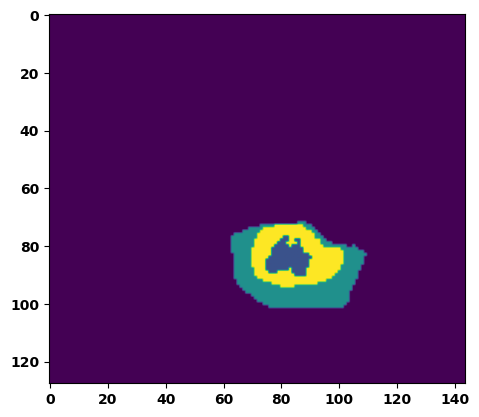

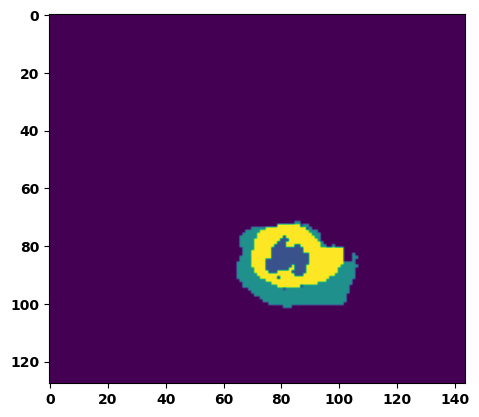

  6%|▌         | 2/36 [00:03<00:51,  1.52s/it]

Batch_id:  1 Eval loss:  0.10108299553394318
Batch_id:  1 Eval IoU:  tensor(0.8292, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9909, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.49s/it]

Batch_id:  2 Eval loss:  0.09758424758911133
Batch_id:  2 Eval IoU:  tensor(0.8379, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 11%|█         | 4/36 [00:05<00:46,  1.44s/it]

Batch_id:  3 Eval loss:  0.15241938829421997
Batch_id:  3 Eval IoU:  tensor(0.7580, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.47s/it]

Batch_id:  4 Eval loss:  0.20005275309085846
Batch_id:  4 Eval IoU:  tensor(0.7103, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9883, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:44,  1.48s/it]

Batch_id:  5 Eval loss:  0.0978030264377594
Batch_id:  5 Eval IoU:  tensor(0.8320, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:40,  1.41s/it]

Batch_id:  6 Eval loss:  0.2835657000541687
Batch_id:  6 Eval IoU:  tensor(0.6160, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.45s/it]

Batch_id:  7 Eval loss:  0.25122207403182983
Batch_id:  7 Eval IoU:  tensor(0.6569, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:38,  1.42s/it]

Batch_id:  8 Eval loss:  0.50190669298172
Batch_id:  8 Eval IoU:  tensor(0.4089, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9297, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9382, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:37,  1.45s/it]

Batch_id:  9 Eval loss:  0.09687106311321259
Batch_id:  9 Eval IoU:  tensor(0.8343, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  10 Eval loss:  0.15931318700313568
Batch_id:  10 Eval IoU:  tensor(0.7458, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9837, device='cuda:0')


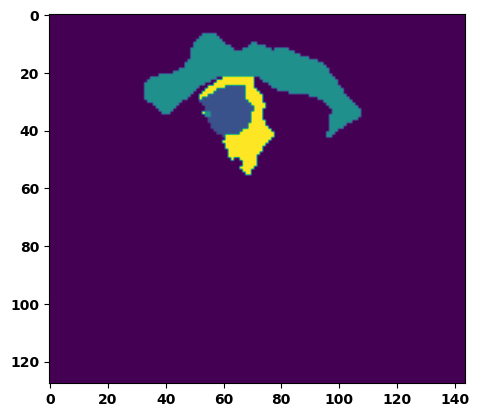

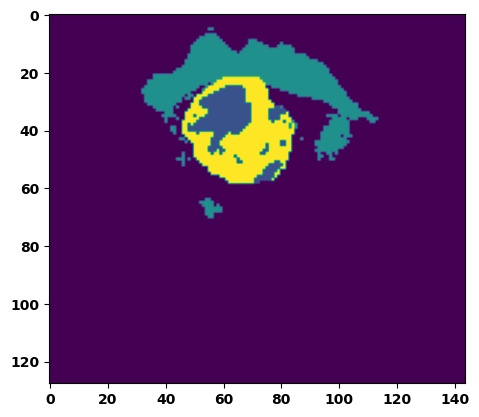

 33%|███▎      | 12/36 [00:17<00:34,  1.45s/it]

Batch_id:  11 Eval loss:  0.06393642723560333
Batch_id:  11 Eval IoU:  tensor(0.8996, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:33,  1.44s/it]

Batch_id:  12 Eval loss:  0.14413462579250336
Batch_id:  12 Eval IoU:  tensor(0.7839, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:32,  1.47s/it]

Batch_id:  13 Eval loss:  0.059772372245788574
Batch_id:  13 Eval IoU:  tensor(0.8977, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.49s/it]

Batch_id:  14 Eval loss:  0.5888224840164185
Batch_id:  14 Eval IoU:  tensor(0.3595, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9967, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.42s/it]

Batch_id:  15 Eval loss:  0.23617002367973328
Batch_id:  15 Eval IoU:  tensor(0.6659, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9785, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:27,  1.44s/it]

Batch_id:  16 Eval loss:  0.07211773097515106
Batch_id:  16 Eval IoU:  tensor(0.8762, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:25,  1.42s/it]

Batch_id:  17 Eval loss:  0.07671497762203217
Batch_id:  17 Eval IoU:  tensor(0.8713, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.43s/it]

Batch_id:  18 Eval loss:  0.1262965351343155
Batch_id:  18 Eval IoU:  tensor(0.8037, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9434, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 56%|█████▌    | 20/36 [00:28<00:22,  1.42s/it]

Batch_id:  19 Eval loss:  0.7186566591262817
Batch_id:  19 Eval IoU:  tensor(0.2543, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9320, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9385, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  20 Eval loss:  0.40330207347869873
Batch_id:  20 Eval IoU:  tensor(0.4845, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9400, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9246, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9177, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


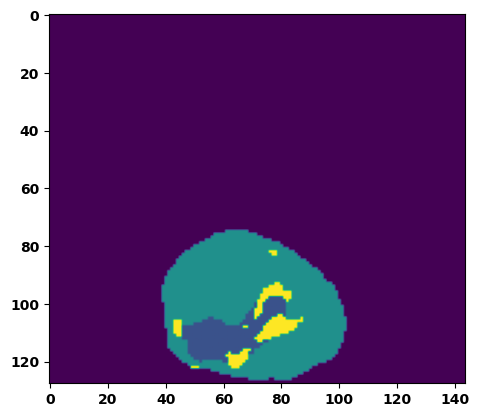

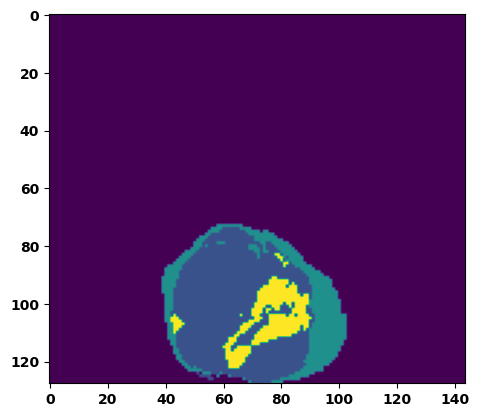

 61%|██████    | 22/36 [00:32<00:21,  1.50s/it]

Batch_id:  21 Eval loss:  0.09730534255504608
Batch_id:  21 Eval IoU:  tensor(0.8663, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.52s/it]

Batch_id:  22 Eval loss:  0.2907635569572449
Batch_id:  22 Eval IoU:  tensor(0.6465, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:18,  1.53s/it]

Batch_id:  23 Eval loss:  0.19246657192707062
Batch_id:  23 Eval IoU:  tensor(0.7073, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9874, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:16,  1.50s/it]

Batch_id:  24 Eval loss:  0.390484094619751
Batch_id:  24 Eval IoU:  tensor(0.5420, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.48s/it]

Batch_id:  25 Eval loss:  0.38321712613105774
Batch_id:  25 Eval IoU:  tensor(0.5460, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:13,  1.46s/it]

Batch_id:  26 Eval loss:  0.2568310499191284
Batch_id:  26 Eval IoU:  tensor(0.6957, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9954, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.41s/it]

Batch_id:  27 Eval loss:  0.3120240867137909
Batch_id:  27 Eval IoU:  tensor(0.5834, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:09,  1.39s/it]

Batch_id:  28 Eval loss:  0.20769643783569336
Batch_id:  28 Eval IoU:  tensor(0.6779, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9452, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9828, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.39s/it]

Batch_id:  29 Eval loss:  0.1806851029396057
Batch_id:  29 Eval IoU:  tensor(0.7228, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  30 Eval loss:  0.40429842472076416
Batch_id:  30 Eval IoU:  tensor(0.5293, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9066, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.8612, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.8606, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


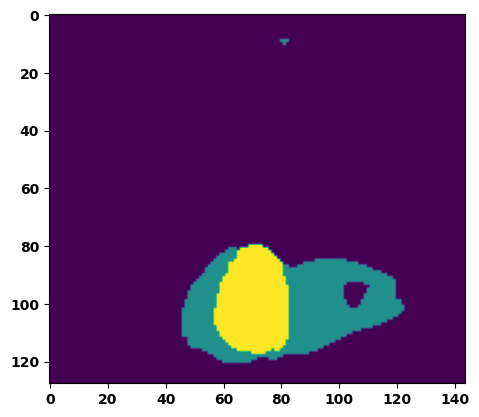

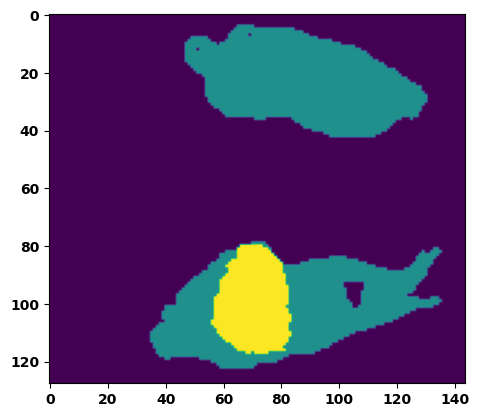

 89%|████████▉ | 32/36 [00:46<00:06,  1.50s/it]

Batch_id:  31 Eval loss:  0.07755661010742188
Batch_id:  31 Eval IoU:  tensor(0.8649, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9913, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.47s/it]

Batch_id:  32 Eval loss:  0.08178620040416718
Batch_id:  32 Eval IoU:  tensor(0.8617, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9967, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:03,  1.52s/it]

Batch_id:  33 Eval loss:  0.2516821026802063
Batch_id:  33 Eval IoU:  tensor(0.6488, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9875, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.46s/it]

Batch_id:  34 Eval loss:  0.20860594511032104
Batch_id:  34 Eval IoU:  tensor(0.6923, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9915, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.47s/it]

Batch_id:  35 Eval loss:  0.19610357284545898
Batch_id:  35 Eval IoU:  tensor(0.7147, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9964, device='cuda:0')
Epoch  32 Training loss:  0.1690048197453672
Epoch  32 Evaluation loss:  0.2233568715552489
Epoch  32 Training accuracy :  tensor(0.7598)
Epoch  32 Evaluation accuracy :  tensor(0.7030)
Epoch  32 Training Mean Dice Score:  tensor(0.9809)
Epoch  32 Eval Mean Dice Score:  tensor(0.9734)
Epoch  32 Training Non-tumor Dice Score:  tensor(0.9824)
Epoch  32 Eval Non-tumor Dice Score:  tensor(0.9726)
Epoch  32 Training NCR/NET Dice Score:  tensor(0.9912)
Epoch  32 Eval NCR/NET Dice Score:  tensor(0.9872)
Epoch  32 Training ED Dice Score:  tensor(0.97

Epoch: 33
Training in session: 


  1%|          | 1/110 [00:01<02:51,  1.57s/it]

Batch_id:  0 Training loss:  0.1666012704372406
Batch_id:  0 Training IoU:  tensor(0.7998, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:40,  1.48s/it]

Batch_id:  1 Training loss:  0.1370878964662552
Batch_id:  1 Training IoU:  tensor(0.7852, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:39,  1.49s/it]

Batch_id:  2 Training loss:  0.09596723318099976
Batch_id:  2 Training IoU:  tensor(0.8393, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:36,  1.47s/it]

Batch_id:  3 Training loss:  0.11423741281032562
Batch_id:  3 Training IoU:  tensor(0.8118, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9766, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:31,  1.44s/it]

Batch_id:  4 Training loss:  0.15252985060214996
Batch_id:  4 Training IoU:  tensor(0.7528, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:32,  1.47s/it]

Batch_id:  5 Training loss:  0.32374751567840576
Batch_id:  5 Training IoU:  tensor(0.6229, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:35,  1.51s/it]

Batch_id:  6 Training loss:  0.224105566740036
Batch_id:  6 Training IoU:  tensor(0.7246, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:32,  1.50s/it]

Batch_id:  7 Training loss:  0.14839065074920654
Batch_id:  7 Training IoU:  tensor(0.7603, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:31,  1.50s/it]

Batch_id:  8 Training loss:  0.21428853273391724
Batch_id:  8 Training IoU:  tensor(0.7143, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:31,  1.51s/it]

Batch_id:  9 Training loss:  0.1296786516904831
Batch_id:  9 Training IoU:  tensor(0.7944, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 10%|█         | 11/110 [00:16<02:30,  1.52s/it]

Batch_id:  10 Training loss:  0.1792171150445938
Batch_id:  10 Training IoU:  tensor(0.7174, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 11%|█         | 12/110 [00:17<02:27,  1.50s/it]

Batch_id:  11 Training loss:  0.16624701023101807
Batch_id:  11 Training IoU:  tensor(0.7828, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:26,  1.51s/it]

Batch_id:  12 Training loss:  0.23616956174373627
Batch_id:  12 Training IoU:  tensor(0.6611, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9774, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:23,  1.50s/it]

Batch_id:  13 Training loss:  0.2219243198633194
Batch_id:  13 Training IoU:  tensor(0.7332, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:22,  1.50s/it]

Batch_id:  14 Training loss:  0.24316242337226868
Batch_id:  14 Training IoU:  tensor(0.7190, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:20,  1.49s/it]

Batch_id:  15 Training loss:  0.09382888674736023
Batch_id:  15 Training IoU:  tensor(0.8403, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:17,  1.48s/it]

Batch_id:  16 Training loss:  0.09127597510814667
Batch_id:  16 Training IoU:  tensor(0.8492, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:17,  1.50s/it]

Batch_id:  17 Training loss:  0.45840543508529663
Batch_id:  17 Training IoU:  tensor(0.4671, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:16,  1.50s/it]

Batch_id:  18 Training loss:  0.2869068384170532
Batch_id:  18 Training IoU:  tensor(0.6579, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:16,  1.52s/it]

Batch_id:  19 Training loss:  0.09210878610610962
Batch_id:  19 Training IoU:  tensor(0.8729, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:14,  1.51s/it]

Batch_id:  20 Training loss:  0.19144921004772186
Batch_id:  20 Training IoU:  tensor(0.7101, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9616, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 20%|██        | 22/110 [00:33<02:14,  1.53s/it]

Batch_id:  21 Training loss:  0.05222122371196747
Batch_id:  21 Training IoU:  tensor(0.9156, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 21%|██        | 23/110 [00:34<02:12,  1.52s/it]

Batch_id:  22 Training loss:  0.059561192989349365
Batch_id:  22 Training IoU:  tensor(0.8972, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:11,  1.53s/it]

Batch_id:  23 Training loss:  0.15753911435604095
Batch_id:  23 Training IoU:  tensor(0.7502, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9712, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:08,  1.51s/it]

Batch_id:  24 Training loss:  0.20097683370113373
Batch_id:  24 Training IoU:  tensor(0.7005, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:04,  1.48s/it]

Batch_id:  25 Training loss:  0.3532359302043915
Batch_id:  25 Training IoU:  tensor(0.5829, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 25%|██▍       | 27/110 [00:40<02:02,  1.48s/it]

Batch_id:  26 Training loss:  0.2555675506591797
Batch_id:  26 Training IoU:  tensor(0.6278, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9756, device='cuda:0')


 25%|██▌       | 28/110 [00:42<02:04,  1.52s/it]

Batch_id:  27 Training loss:  0.09127171337604523
Batch_id:  27 Training IoU:  tensor(0.8469, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 26%|██▋       | 29/110 [00:43<02:06,  1.56s/it]

Batch_id:  28 Training loss:  0.08081004023551941
Batch_id:  28 Training IoU:  tensor(0.8660, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 27%|██▋       | 30/110 [00:45<02:03,  1.55s/it]

Batch_id:  29 Training loss:  0.12461091578006744
Batch_id:  29 Training IoU:  tensor(0.8031, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 28%|██▊       | 31/110 [00:46<02:01,  1.54s/it]

Batch_id:  30 Training loss:  0.1852266788482666
Batch_id:  30 Training IoU:  tensor(0.7170, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 29%|██▉       | 32/110 [00:48<01:59,  1.53s/it]

Batch_id:  31 Training loss:  0.21261729300022125
Batch_id:  31 Training IoU:  tensor(0.6855, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 30%|███       | 33/110 [00:49<02:01,  1.58s/it]

Batch_id:  32 Training loss:  0.1442575305700302
Batch_id:  32 Training IoU:  tensor(0.7884, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 31%|███       | 34/110 [00:51<01:58,  1.56s/it]

Batch_id:  33 Training loss:  0.1426476687192917
Batch_id:  33 Training IoU:  tensor(0.7814, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 32%|███▏      | 35/110 [00:53<01:58,  1.58s/it]

Batch_id:  34 Training loss:  0.17012609541416168
Batch_id:  34 Training IoU:  tensor(0.8033, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:55,  1.56s/it]

Batch_id:  35 Training loss:  0.16256870329380035
Batch_id:  35 Training IoU:  tensor(0.7624, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 34%|███▎      | 37/110 [00:56<01:51,  1.53s/it]

Batch_id:  36 Training loss:  0.25652748346328735
Batch_id:  36 Training IoU:  tensor(0.6440, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 35%|███▍      | 38/110 [00:57<01:47,  1.49s/it]

Batch_id:  37 Training loss:  0.20175059139728546
Batch_id:  37 Training IoU:  tensor(0.6999, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 35%|███▌      | 39/110 [00:58<01:43,  1.46s/it]

Batch_id:  38 Training loss:  0.11103290319442749
Batch_id:  38 Training IoU:  tensor(0.8181, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 36%|███▋      | 40/110 [01:00<01:42,  1.46s/it]

Batch_id:  39 Training loss:  0.05612631142139435
Batch_id:  39 Training IoU:  tensor(0.9063, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:41,  1.47s/it]

Batch_id:  40 Training loss:  0.1068343073129654
Batch_id:  40 Training IoU:  tensor(0.8296, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 38%|███▊      | 42/110 [01:03<01:40,  1.48s/it]

Batch_id:  41 Training loss:  0.1514853537082672
Batch_id:  41 Training IoU:  tensor(0.7560, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:42,  1.53s/it]

Batch_id:  42 Training loss:  0.08518093824386597
Batch_id:  42 Training IoU:  tensor(0.8536, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9839, device='cuda:0')


 40%|████      | 44/110 [01:06<01:42,  1.55s/it]

Batch_id:  43 Training loss:  0.21629756689071655
Batch_id:  43 Training IoU:  tensor(0.6720, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9377, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9182, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 41%|████      | 45/110 [01:08<01:44,  1.61s/it]

Batch_id:  44 Training loss:  0.17460733652114868
Batch_id:  44 Training IoU:  tensor(0.7388, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 42%|████▏     | 46/110 [01:09<01:39,  1.55s/it]

Batch_id:  45 Training loss:  0.11026337742805481
Batch_id:  45 Training IoU:  tensor(0.8251, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 43%|████▎     | 47/110 [01:11<01:37,  1.54s/it]

Batch_id:  46 Training loss:  0.42513370513916016
Batch_id:  46 Training IoU:  tensor(0.4792, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9325, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9141, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 44%|████▎     | 48/110 [01:12<01:33,  1.51s/it]

Batch_id:  47 Training loss:  0.0965668261051178
Batch_id:  47 Training IoU:  tensor(0.8343, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 45%|████▍     | 49/110 [01:14<01:30,  1.48s/it]

Batch_id:  48 Training loss:  0.1431693732738495
Batch_id:  48 Training IoU:  tensor(0.8112, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 45%|████▌     | 50/110 [01:15<01:29,  1.49s/it]

Batch_id:  49 Training loss:  0.27333319187164307
Batch_id:  49 Training IoU:  tensor(0.6301, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9571, device='cuda:0')


 46%|████▋     | 51/110 [01:16<01:24,  1.44s/it]

Batch_id:  50 Training loss:  0.07494357228279114
Batch_id:  50 Training IoU:  tensor(0.8698, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 47%|████▋     | 52/110 [01:18<01:27,  1.52s/it]

Batch_id:  51 Training loss:  0.38424068689346313
Batch_id:  51 Training IoU:  tensor(0.5374, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 48%|████▊     | 53/110 [01:20<01:26,  1.51s/it]

Batch_id:  52 Training loss:  0.12440796196460724
Batch_id:  52 Training IoU:  tensor(0.8134, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 49%|████▉     | 54/110 [01:21<01:23,  1.49s/it]

Batch_id:  53 Training loss:  0.12329423427581787
Batch_id:  53 Training IoU:  tensor(0.8037, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 50%|█████     | 55/110 [01:23<01:25,  1.55s/it]

Batch_id:  54 Training loss:  0.10285681486129761
Batch_id:  54 Training IoU:  tensor(0.8286, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 51%|█████     | 56/110 [01:24<01:22,  1.53s/it]

Batch_id:  55 Training loss:  0.1272333562374115
Batch_id:  55 Training IoU:  tensor(0.8014, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 52%|█████▏    | 57/110 [01:26<01:17,  1.46s/it]

Batch_id:  56 Training loss:  0.12533199787139893
Batch_id:  56 Training IoU:  tensor(0.7918, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 53%|█████▎    | 58/110 [01:27<01:13,  1.41s/it]

Batch_id:  57 Training loss:  0.13924913108348846
Batch_id:  57 Training IoU:  tensor(0.7683, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9748, device='cuda:0')


 54%|█████▎    | 59/110 [01:28<01:14,  1.46s/it]

Batch_id:  58 Training loss:  0.20972338318824768
Batch_id:  58 Training IoU:  tensor(0.6854, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 55%|█████▍    | 60/110 [01:30<01:13,  1.47s/it]

Batch_id:  59 Training loss:  0.12987031042575836
Batch_id:  59 Training IoU:  tensor(0.7872, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 55%|█████▌    | 61/110 [01:31<01:11,  1.47s/it]

Batch_id:  60 Training loss:  0.06874191761016846
Batch_id:  60 Training IoU:  tensor(0.8806, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 56%|█████▋    | 62/110 [01:33<01:11,  1.49s/it]

Batch_id:  61 Training loss:  0.07864208519458771
Batch_id:  61 Training IoU:  tensor(0.8806, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 57%|█████▋    | 63/110 [01:34<01:08,  1.45s/it]

Batch_id:  62 Training loss:  0.08945484459400177
Batch_id:  62 Training IoU:  tensor(0.8477, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 58%|█████▊    | 64/110 [01:36<01:05,  1.43s/it]

Batch_id:  63 Training loss:  0.13610708713531494
Batch_id:  63 Training IoU:  tensor(0.8019, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 59%|█████▉    | 65/110 [01:37<01:03,  1.42s/it]

Batch_id:  64 Training loss:  0.10221026837825775
Batch_id:  64 Training IoU:  tensor(0.8261, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 60%|██████    | 66/110 [01:39<01:04,  1.47s/it]

Batch_id:  65 Training loss:  0.060288459062576294
Batch_id:  65 Training IoU:  tensor(0.8972, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 61%|██████    | 67/110 [01:40<01:04,  1.51s/it]

Batch_id:  66 Training loss:  0.11001390218734741
Batch_id:  66 Training IoU:  tensor(0.8166, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9484, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 62%|██████▏   | 68/110 [01:42<01:02,  1.50s/it]

Batch_id:  67 Training loss:  0.15122024714946747
Batch_id:  67 Training IoU:  tensor(0.7878, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 63%|██████▎   | 69/110 [01:43<01:00,  1.46s/it]

Batch_id:  68 Training loss:  0.09237319231033325
Batch_id:  68 Training IoU:  tensor(0.8430, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 64%|██████▎   | 70/110 [01:45<00:58,  1.47s/it]

Batch_id:  69 Training loss:  0.1297237128019333
Batch_id:  69 Training IoU:  tensor(0.8094, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 65%|██████▍   | 71/110 [01:46<00:58,  1.50s/it]

Batch_id:  70 Training loss:  0.23601111769676208
Batch_id:  70 Training IoU:  tensor(0.6496, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9464, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 65%|██████▌   | 72/110 [01:48<00:58,  1.54s/it]

Batch_id:  71 Training loss:  0.17332234978675842
Batch_id:  71 Training IoU:  tensor(0.7217, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 66%|██████▋   | 73/110 [01:49<00:56,  1.52s/it]

Batch_id:  72 Training loss:  0.19139717519283295
Batch_id:  72 Training IoU:  tensor(0.7911, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 67%|██████▋   | 74/110 [01:51<00:53,  1.48s/it]

Batch_id:  73 Training loss:  0.1405380368232727
Batch_id:  73 Training IoU:  tensor(0.7804, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 68%|██████▊   | 75/110 [01:52<00:51,  1.48s/it]

Batch_id:  74 Training loss:  0.5250672101974487
Batch_id:  74 Training IoU:  tensor(0.4204, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 69%|██████▉   | 76/110 [01:54<00:50,  1.48s/it]

Batch_id:  75 Training loss:  0.3562360405921936
Batch_id:  75 Training IoU:  tensor(0.5998, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9989, device='cuda:0')


 70%|███████   | 77/110 [01:55<00:48,  1.45s/it]

Batch_id:  76 Training loss:  0.13147670030593872
Batch_id:  76 Training IoU:  tensor(0.8035, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 71%|███████   | 78/110 [01:57<00:47,  1.49s/it]

Batch_id:  77 Training loss:  0.353264182806015
Batch_id:  77 Training IoU:  tensor(0.6306, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 72%|███████▏  | 79/110 [01:58<00:45,  1.46s/it]

Batch_id:  78 Training loss:  0.19664864242076874
Batch_id:  78 Training IoU:  tensor(0.6999, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9387, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9729, device='cuda:0')


 73%|███████▎  | 80/110 [02:00<00:44,  1.50s/it]

Batch_id:  79 Training loss:  0.09188130497932434
Batch_id:  79 Training IoU:  tensor(0.8405, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 74%|███████▎  | 81/110 [02:01<00:42,  1.47s/it]

Batch_id:  80 Training loss:  0.09691314399242401
Batch_id:  80 Training IoU:  tensor(0.8432, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 75%|███████▍  | 82/110 [02:03<00:42,  1.52s/it]

Batch_id:  81 Training loss:  0.25276684761047363
Batch_id:  81 Training IoU:  tensor(0.6789, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 75%|███████▌  | 83/110 [02:04<00:40,  1.51s/it]

Batch_id:  82 Training loss:  0.1322159618139267
Batch_id:  82 Training IoU:  tensor(0.8006, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 76%|███████▋  | 84/110 [02:05<00:38,  1.48s/it]

Batch_id:  83 Training loss:  0.24627479910850525
Batch_id:  83 Training IoU:  tensor(0.6404, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9324, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9767, device='cuda:0')


 77%|███████▋  | 85/110 [02:07<00:36,  1.45s/it]

Batch_id:  84 Training loss:  0.17491471767425537
Batch_id:  84 Training IoU:  tensor(0.7300, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9771, device='cuda:0')


 78%|███████▊  | 86/110 [02:08<00:34,  1.43s/it]

Batch_id:  85 Training loss:  0.3341347277164459
Batch_id:  85 Training IoU:  tensor(0.6014, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9440, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 79%|███████▉  | 87/110 [02:10<00:33,  1.44s/it]

Batch_id:  86 Training loss:  0.22168713808059692
Batch_id:  86 Training IoU:  tensor(0.6810, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 80%|████████  | 88/110 [02:11<00:31,  1.42s/it]

Batch_id:  87 Training loss:  0.0925106555223465
Batch_id:  87 Training IoU:  tensor(0.8439, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 81%|████████  | 89/110 [02:13<00:29,  1.42s/it]

Batch_id:  88 Training loss:  0.21809294819831848
Batch_id:  88 Training IoU:  tensor(0.6749, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 82%|████████▏ | 90/110 [02:14<00:28,  1.41s/it]

Batch_id:  89 Training loss:  0.2558704614639282
Batch_id:  89 Training IoU:  tensor(0.6471, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9844, device='cuda:0')


 83%|████████▎ | 91/110 [02:15<00:26,  1.38s/it]

Batch_id:  90 Training loss:  0.12341620028018951
Batch_id:  90 Training IoU:  tensor(0.7971, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


 84%|████████▎ | 92/110 [02:17<00:24,  1.36s/it]

Batch_id:  91 Training loss:  0.1644393503665924
Batch_id:  91 Training IoU:  tensor(0.7334, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9812, device='cuda:0')


 85%|████████▍ | 93/110 [02:18<00:24,  1.47s/it]

Batch_id:  92 Training loss:  0.06843200325965881
Batch_id:  92 Training IoU:  tensor(0.8858, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 85%|████████▌ | 94/110 [02:20<00:23,  1.47s/it]

Batch_id:  93 Training loss:  0.10152862966060638
Batch_id:  93 Training IoU:  tensor(0.8315, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 86%|████████▋ | 95/110 [02:21<00:22,  1.48s/it]

Batch_id:  94 Training loss:  0.042992547154426575
Batch_id:  94 Training IoU:  tensor(0.9265, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 87%|████████▋ | 96/110 [02:23<00:20,  1.48s/it]

Batch_id:  95 Training loss:  0.2710660994052887
Batch_id:  95 Training IoU:  tensor(0.6426, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 88%|████████▊ | 97/110 [02:24<00:19,  1.49s/it]

Batch_id:  96 Training loss:  0.04809318482875824
Batch_id:  96 Training IoU:  tensor(0.9157, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 89%|████████▉ | 98/110 [02:26<00:17,  1.46s/it]

Batch_id:  97 Training loss:  0.08723413944244385
Batch_id:  97 Training IoU:  tensor(0.8639, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 90%|█████████ | 99/110 [02:27<00:15,  1.43s/it]

Batch_id:  98 Training loss:  0.10421743988990784
Batch_id:  98 Training IoU:  tensor(0.8418, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:14,  1.42s/it]

Batch_id:  99 Training loss:  0.16269397735595703
Batch_id:  99 Training IoU:  tensor(0.7413, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9819, device='cuda:0')


 92%|█████████▏| 101/110 [02:30<00:13,  1.47s/it]

Batch_id:  100 Training loss:  0.09079647064208984
Batch_id:  100 Training IoU:  tensor(0.8511, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 93%|█████████▎| 102/110 [02:31<00:11,  1.43s/it]

Batch_id:  101 Training loss:  0.19041720032691956
Batch_id:  101 Training IoU:  tensor(0.7193, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 94%|█████████▎| 103/110 [02:33<00:10,  1.48s/it]

Batch_id:  102 Training loss:  0.2859322428703308
Batch_id:  102 Training IoU:  tensor(0.6614, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 95%|█████████▍| 104/110 [02:34<00:08,  1.48s/it]

Batch_id:  103 Training loss:  0.10701873898506165
Batch_id:  103 Training IoU:  tensor(0.8189, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 95%|█████████▌| 105/110 [02:36<00:07,  1.50s/it]

Batch_id:  104 Training loss:  0.2524201571941376
Batch_id:  104 Training IoU:  tensor(0.6438, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 96%|█████████▋| 106/110 [02:37<00:05,  1.47s/it]

Batch_id:  105 Training loss:  0.1461060643196106
Batch_id:  105 Training IoU:  tensor(0.7650, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 97%|█████████▋| 107/110 [02:39<00:04,  1.48s/it]

Batch_id:  106 Training loss:  0.04765726625919342
Batch_id:  106 Training IoU:  tensor(0.9174, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 98%|█████████▊| 108/110 [02:40<00:02,  1.46s/it]

Batch_id:  107 Training loss:  0.17864979803562164
Batch_id:  107 Training IoU:  tensor(0.7363, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 99%|█████████▉| 109/110 [02:42<00:01,  1.40s/it]

Batch_id:  108 Training loss:  0.2704527974128723
Batch_id:  108 Training IoU:  tensor(0.6204, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9270, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


100%|██████████| 110/110 [02:43<00:00,  1.49s/it]


Batch_id:  109 Training loss:  0.09141997992992401
Batch_id:  109 Training IoU:  tensor(0.8437, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9928, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.1908441036939621
Batch_id:  0 Eval IoU:  tensor(0.7196, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


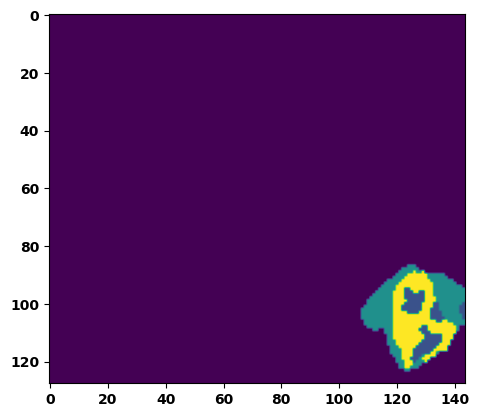

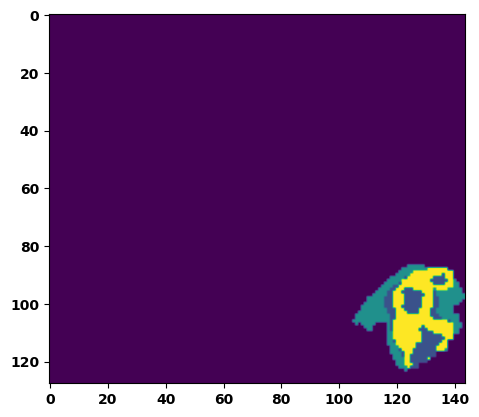

  6%|▌         | 2/36 [00:02<00:50,  1.47s/it]

Batch_id:  1 Eval loss:  0.20795969665050507
Batch_id:  1 Eval IoU:  tensor(0.6766, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9513, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9434, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9828, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:46,  1.42s/it]

Batch_id:  2 Eval loss:  0.2553839087486267
Batch_id:  2 Eval IoU:  tensor(0.6971, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


 11%|█         | 4/36 [00:05<00:46,  1.44s/it]

Batch_id:  3 Eval loss:  0.07515017688274384
Batch_id:  3 Eval IoU:  tensor(0.8869, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.45s/it]

Batch_id:  4 Eval loss:  0.09524258971214294
Batch_id:  4 Eval IoU:  tensor(0.8416, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:42,  1.42s/it]

Batch_id:  5 Eval loss:  0.38817164301872253
Batch_id:  5 Eval IoU:  tensor(0.5395, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 19%|█▉        | 7/36 [00:09<00:39,  1.37s/it]

Batch_id:  6 Eval loss:  0.28569361567497253
Batch_id:  6 Eval IoU:  tensor(0.6498, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9978, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:39,  1.40s/it]

Batch_id:  7 Eval loss:  0.3881169557571411
Batch_id:  7 Eval IoU:  tensor(0.5440, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9980, device='cuda:0')


 25%|██▌       | 9/36 [00:12<00:37,  1.38s/it]

Batch_id:  8 Eval loss:  0.2932448387145996
Batch_id:  8 Eval IoU:  tensor(0.6068, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9910, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.46s/it]

Batch_id:  9 Eval loss:  0.192843496799469
Batch_id:  9 Eval IoU:  tensor(0.7183, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  10 Eval loss:  0.1449764221906662
Batch_id:  10 Eval IoU:  tensor(0.7643, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9854, device='cuda:0')


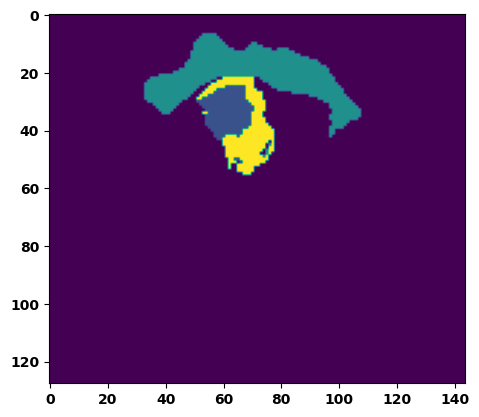

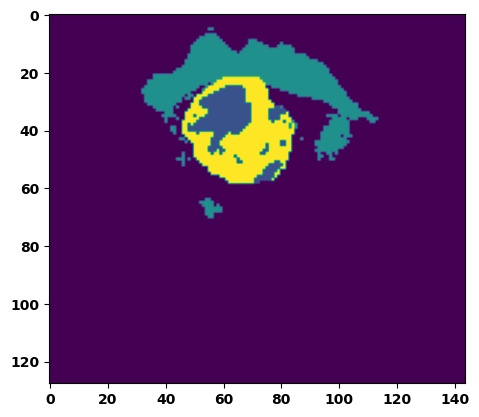

 33%|███▎      | 12/36 [00:17<00:34,  1.46s/it]

Batch_id:  11 Eval loss:  0.18497879803180695
Batch_id:  11 Eval IoU:  tensor(0.7204, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:32,  1.42s/it]

Batch_id:  12 Eval loss:  0.07643775641918182
Batch_id:  12 Eval IoU:  tensor(0.8716, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9871, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.43s/it]

Batch_id:  13 Eval loss:  0.09261158108711243
Batch_id:  13 Eval IoU:  tensor(0.8414, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:30,  1.46s/it]

Batch_id:  14 Eval loss:  0.506386399269104
Batch_id:  14 Eval IoU:  tensor(0.4052, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9356, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9379, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9298, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9405, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:30,  1.51s/it]

Batch_id:  15 Eval loss:  0.09879264235496521
Batch_id:  15 Eval IoU:  tensor(0.8652, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:28,  1.48s/it]

Batch_id:  16 Eval loss:  0.4060397744178772
Batch_id:  16 Eval IoU:  tensor(0.5286, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9059, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.8600, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.8594, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:28,  1.57s/it]

Batch_id:  17 Eval loss:  0.07799574732780457
Batch_id:  17 Eval IoU:  tensor(0.8639, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:26,  1.56s/it]

Batch_id:  18 Eval loss:  0.2394411265850067
Batch_id:  18 Eval IoU:  tensor(0.6631, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.49s/it]

Batch_id:  19 Eval loss:  0.1523408144712448
Batch_id:  19 Eval IoU:  tensor(0.7585, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  20 Eval loss:  0.5958917140960693
Batch_id:  20 Eval IoU:  tensor(0.3571, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9955, device='cuda:0')


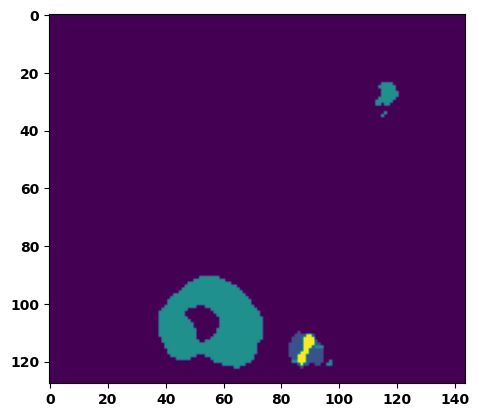

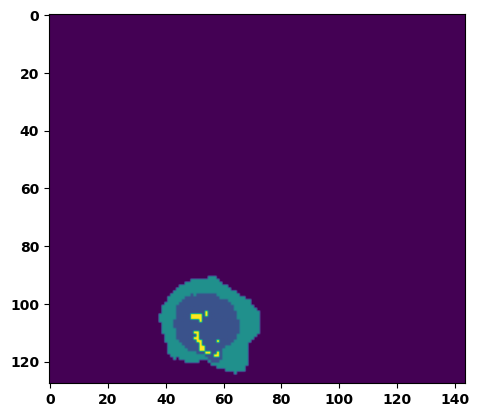

 61%|██████    | 22/36 [00:32<00:21,  1.55s/it]

Batch_id:  21 Eval loss:  0.10552173852920532
Batch_id:  21 Eval IoU:  tensor(0.8218, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.50s/it]

Batch_id:  22 Eval loss:  0.2877880930900574
Batch_id:  22 Eval IoU:  tensor(0.6127, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:18,  1.56s/it]

Batch_id:  23 Eval loss:  0.09956233203411102
Batch_id:  23 Eval IoU:  tensor(0.8287, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9901, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:16,  1.50s/it]

Batch_id:  24 Eval loss:  0.08139795064926147
Batch_id:  24 Eval IoU:  tensor(0.8620, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9968, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.48s/it]

Batch_id:  25 Eval loss:  0.07053753733634949
Batch_id:  25 Eval IoU:  tensor(0.8786, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:13,  1.46s/it]

Batch_id:  26 Eval loss:  0.40192365646362305
Batch_id:  26 Eval IoU:  tensor(0.4847, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9248, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9184, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9892, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.46s/it]

Batch_id:  27 Eval loss:  0.22887776792049408
Batch_id:  27 Eval IoU:  tensor(0.6756, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9794, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.47s/it]

Batch_id:  28 Eval loss:  0.05893094837665558
Batch_id:  28 Eval IoU:  tensor(0.8985, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.44s/it]

Batch_id:  29 Eval loss:  0.06430715322494507
Batch_id:  29 Eval IoU:  tensor(0.8988, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  30 Eval loss:  0.1930333971977234
Batch_id:  30 Eval IoU:  tensor(0.7055, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9871, device='cuda:0')


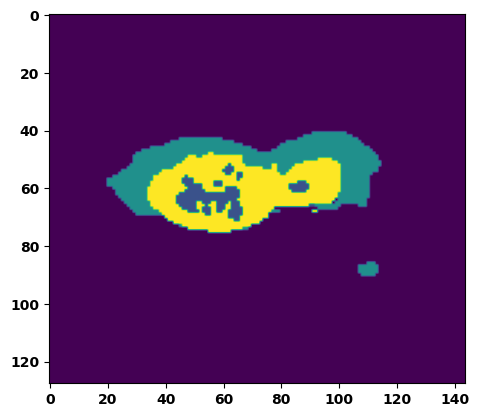

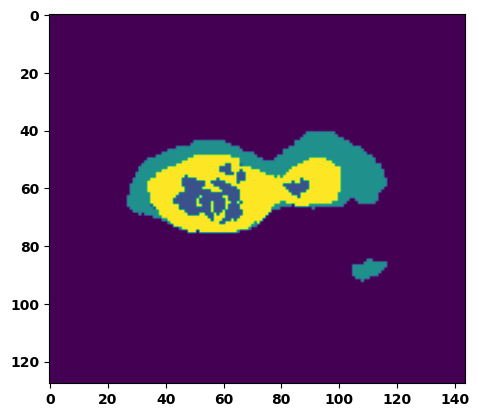

 89%|████████▉ | 32/36 [00:47<00:05,  1.46s/it]

Batch_id:  31 Eval loss:  0.12964673340320587
Batch_id:  31 Eval IoU:  tensor(0.7998, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.47s/it]

Batch_id:  32 Eval loss:  0.2524394392967224
Batch_id:  32 Eval IoU:  tensor(0.6553, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9457, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9925, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:02,  1.45s/it]

Batch_id:  33 Eval loss:  0.1409987062215805
Batch_id:  33 Eval IoU:  tensor(0.7872, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9909, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.41s/it]

Batch_id:  34 Eval loss:  0.17859117686748505
Batch_id:  34 Eval IoU:  tensor(0.7264, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.47s/it]

Batch_id:  35 Eval loss:  0.7217104434967041
Batch_id:  35 Eval IoU:  tensor(0.2529, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9326, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9425, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9972, device='cuda:0')
Epoch  33 Training loss:  0.16895466826178812
Epoch  33 Evaluation loss:  0.2212169687781069
Epoch  33 Training accuracy :  tensor(0.7596)
Epoch  33 Evaluation accuracy :  tensor(0.7058)
Epoch  33 Training Mean Dice Score:  tensor(0.9808)
Epoch  33 Eval Mean Dice Score:  tensor(0.9736)
Epoch  33 Training Non-tumor Dice Score:  tensor(0.9824)
Epoch  33 Eval Non-tumor Dice Score:  tensor(0.9726)
Epoch  33 Training NCR/NET Dice Score:  tensor(0.9911)
Epoch  33 Eval NCR/NET Dice Score:  tensor(0.9873)
Epoch  33 Training ED Dice Score:  tensor(0.97

Epoch: 34
Training in session: 


  1%|          | 1/110 [00:01<02:34,  1.41s/it]

Batch_id:  0 Training loss:  0.15543217957019806
Batch_id:  0 Training IoU:  tensor(0.7817, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:27,  1.36s/it]

Batch_id:  1 Training loss:  0.22280645370483398
Batch_id:  1 Training IoU:  tensor(0.7305, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:38,  1.48s/it]

Batch_id:  2 Training loss:  0.17334000766277313
Batch_id:  2 Training IoU:  tensor(0.7221, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:43,  1.54s/it]

Batch_id:  3 Training loss:  0.05997997522354126
Batch_id:  3 Training IoU:  tensor(0.8982, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:41,  1.54s/it]

Batch_id:  4 Training loss:  0.24385446310043335
Batch_id:  4 Training IoU:  tensor(0.6874, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:43,  1.57s/it]

Batch_id:  5 Training loss:  0.14248301088809967
Batch_id:  5 Training IoU:  tensor(0.7914, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:37,  1.53s/it]

Batch_id:  6 Training loss:  0.06019410490989685
Batch_id:  6 Training IoU:  tensor(0.8970, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:36,  1.53s/it]

Batch_id:  7 Training loss:  0.24106992781162262
Batch_id:  7 Training IoU:  tensor(0.6446, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9372, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9512, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9342, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9760, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:27,  1.46s/it]

Batch_id:  8 Training loss:  0.08866189420223236
Batch_id:  8 Training IoU:  tensor(0.8777, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:27,  1.47s/it]

Batch_id:  9 Training loss:  0.2066197395324707
Batch_id:  9 Training IoU:  tensor(0.6923, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 10%|█         | 11/110 [00:16<02:25,  1.47s/it]

Batch_id:  10 Training loss:  0.10654649138450623
Batch_id:  10 Training IoU:  tensor(0.8307, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 11%|█         | 12/110 [00:18<02:27,  1.51s/it]

Batch_id:  11 Training loss:  0.2612091898918152
Batch_id:  11 Training IoU:  tensor(0.6946, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9993, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:27,  1.52s/it]

Batch_id:  12 Training loss:  0.05650152266025543
Batch_id:  12 Training IoU:  tensor(0.9059, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:23,  1.49s/it]

Batch_id:  13 Training loss:  0.22185000777244568
Batch_id:  13 Training IoU:  tensor(0.6800, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:24,  1.52s/it]

Batch_id:  14 Training loss:  0.09014008939266205
Batch_id:  14 Training IoU:  tensor(0.8498, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:20,  1.50s/it]

Batch_id:  15 Training loss:  0.12672162055969238
Batch_id:  15 Training IoU:  tensor(0.7979, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:19,  1.50s/it]

Batch_id:  16 Training loss:  0.17960292100906372
Batch_id:  16 Training IoU:  tensor(0.7346, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:22,  1.55s/it]

Batch_id:  17 Training loss:  0.04532681405544281
Batch_id:  17 Training IoU:  tensor(0.9209, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:22,  1.56s/it]

Batch_id:  18 Training loss:  0.4791973829269409
Batch_id:  18 Training IoU:  tensor(0.4441, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:20,  1.56s/it]

Batch_id:  19 Training loss:  0.15315701067447662
Batch_id:  19 Training IoU:  tensor(0.7626, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:12,  1.49s/it]

Batch_id:  20 Training loss:  0.1572025716304779
Batch_id:  20 Training IoU:  tensor(0.7694, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 20%|██        | 22/110 [00:33<02:18,  1.58s/it]

Batch_id:  21 Training loss:  0.053341642022132874
Batch_id:  21 Training IoU:  tensor(0.9132, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 21%|██        | 23/110 [00:34<02:16,  1.56s/it]

Batch_id:  22 Training loss:  0.2800503373146057
Batch_id:  22 Training IoU:  tensor(0.6180, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:15,  1.57s/it]

Batch_id:  23 Training loss:  0.08916282653808594
Batch_id:  23 Training IoU:  tensor(0.8485, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 23%|██▎       | 25/110 [00:38<02:11,  1.55s/it]

Batch_id:  24 Training loss:  0.09710876643657684
Batch_id:  24 Training IoU:  tensor(0.8379, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:11,  1.56s/it]

Batch_id:  25 Training loss:  0.1145440936088562
Batch_id:  25 Training IoU:  tensor(0.8087, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 25%|██▍       | 27/110 [00:41<02:06,  1.53s/it]

Batch_id:  26 Training loss:  0.3244023323059082
Batch_id:  26 Training IoU:  tensor(0.6223, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 25%|██▌       | 28/110 [00:42<02:06,  1.54s/it]

Batch_id:  27 Training loss:  0.15672187507152557
Batch_id:  27 Training IoU:  tensor(0.7512, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9714, device='cuda:0')


 26%|██▋       | 29/110 [00:44<02:03,  1.53s/it]

Batch_id:  28 Training loss:  0.20908844470977783
Batch_id:  28 Training IoU:  tensor(0.6871, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 27%|██▋       | 30/110 [00:45<02:03,  1.54s/it]

Batch_id:  29 Training loss:  0.2671850919723511
Batch_id:  29 Training IoU:  tensor(0.6475, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 28%|██▊       | 31/110 [00:47<02:00,  1.52s/it]

Batch_id:  30 Training loss:  0.17628636956214905
Batch_id:  30 Training IoU:  tensor(0.8167, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 29%|██▉       | 32/110 [00:48<01:56,  1.49s/it]

Batch_id:  31 Training loss:  0.09366130828857422
Batch_id:  31 Training IoU:  tensor(0.8411, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 30%|███       | 33/110 [00:50<01:53,  1.47s/it]

Batch_id:  32 Training loss:  0.12319491803646088
Batch_id:  32 Training IoU:  tensor(0.8069, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 31%|███       | 34/110 [00:51<01:52,  1.48s/it]

Batch_id:  33 Training loss:  0.1149386614561081
Batch_id:  33 Training IoU:  tensor(0.8196, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 32%|███▏      | 35/110 [00:53<01:53,  1.52s/it]

Batch_id:  34 Training loss:  0.16116531193256378
Batch_id:  34 Training IoU:  tensor(0.7468, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9789, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:50,  1.50s/it]

Batch_id:  35 Training loss:  0.2509668171405792
Batch_id:  35 Training IoU:  tensor(0.6328, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9761, device='cuda:0')


 34%|███▎      | 37/110 [00:55<01:46,  1.46s/it]

Batch_id:  36 Training loss:  0.10101887583732605
Batch_id:  36 Training IoU:  tensor(0.8291, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 35%|███▍      | 38/110 [00:57<01:47,  1.49s/it]

Batch_id:  37 Training loss:  0.18899543583393097
Batch_id:  37 Training IoU:  tensor(0.7126, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 35%|███▌      | 39/110 [00:59<01:45,  1.49s/it]

Batch_id:  38 Training loss:  0.5272743701934814
Batch_id:  38 Training IoU:  tensor(0.4189, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 36%|███▋      | 40/110 [01:00<01:43,  1.47s/it]

Batch_id:  39 Training loss:  0.15145929157733917
Batch_id:  39 Training IoU:  tensor(0.7521, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9842, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:42,  1.48s/it]

Batch_id:  40 Training loss:  0.15803682804107666
Batch_id:  40 Training IoU:  tensor(0.7478, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 38%|███▊      | 42/110 [01:03<01:41,  1.49s/it]

Batch_id:  41 Training loss:  0.13975167274475098
Batch_id:  41 Training IoU:  tensor(0.7880, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 39%|███▉      | 43/110 [01:05<01:41,  1.52s/it]

Batch_id:  42 Training loss:  0.1609513908624649
Batch_id:  42 Training IoU:  tensor(0.8118, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 40%|████      | 44/110 [01:06<01:37,  1.48s/it]

Batch_id:  43 Training loss:  0.1464499980211258
Batch_id:  43 Training IoU:  tensor(0.7579, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9729, device='cuda:0')


 41%|████      | 45/110 [01:08<01:37,  1.50s/it]

Batch_id:  44 Training loss:  0.36048829555511475
Batch_id:  44 Training IoU:  tensor(0.5736, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 42%|████▏     | 46/110 [01:09<01:35,  1.49s/it]

Batch_id:  45 Training loss:  0.2342808097600937
Batch_id:  45 Training IoU:  tensor(0.6619, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9819, device='cuda:0')


 43%|████▎     | 47/110 [01:11<01:37,  1.55s/it]

Batch_id:  46 Training loss:  0.10324941575527191
Batch_id:  46 Training IoU:  tensor(0.8268, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 44%|████▎     | 48/110 [01:12<01:38,  1.59s/it]

Batch_id:  47 Training loss:  0.06519286334514618
Batch_id:  47 Training IoU:  tensor(0.8907, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 45%|████▍     | 49/110 [01:14<01:36,  1.59s/it]

Batch_id:  48 Training loss:  0.21693198382854462
Batch_id:  48 Training IoU:  tensor(0.7083, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 45%|████▌     | 50/110 [01:16<01:35,  1.60s/it]

Batch_id:  49 Training loss:  0.08894871175289154
Batch_id:  49 Training IoU:  tensor(0.8519, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 46%|████▋     | 51/110 [01:17<01:31,  1.55s/it]

Batch_id:  50 Training loss:  0.11610767245292664
Batch_id:  50 Training IoU:  tensor(0.8094, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9762, device='cuda:0')


 47%|████▋     | 52/110 [01:19<01:31,  1.57s/it]

Batch_id:  51 Training loss:  0.1360599845647812
Batch_id:  51 Training IoU:  tensor(0.8027, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 48%|████▊     | 53/110 [01:20<01:26,  1.52s/it]

Batch_id:  52 Training loss:  0.13723987340927124
Batch_id:  52 Training IoU:  tensor(0.7849, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 49%|████▉     | 54/110 [01:22<01:25,  1.53s/it]

Batch_id:  53 Training loss:  0.13205035030841827
Batch_id:  53 Training IoU:  tensor(0.7910, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 50%|█████     | 55/110 [01:23<01:22,  1.50s/it]

Batch_id:  54 Training loss:  0.07868468761444092
Batch_id:  54 Training IoU:  tensor(0.8636, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 51%|█████     | 56/110 [01:25<01:22,  1.53s/it]

Batch_id:  55 Training loss:  0.18423862755298615
Batch_id:  55 Training IoU:  tensor(0.7111, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 52%|█████▏    | 57/110 [01:26<01:20,  1.52s/it]

Batch_id:  56 Training loss:  0.20291142165660858
Batch_id:  56 Training IoU:  tensor(0.6969, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 53%|█████▎    | 58/110 [01:28<01:19,  1.52s/it]

Batch_id:  57 Training loss:  0.09699408710002899
Batch_id:  57 Training IoU:  tensor(0.8438, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 54%|█████▎    | 59/110 [01:29<01:17,  1.51s/it]

Batch_id:  58 Training loss:  0.19768719375133514
Batch_id:  58 Training IoU:  tensor(0.7056, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 55%|█████▍    | 60/110 [01:30<01:13,  1.47s/it]

Batch_id:  59 Training loss:  0.09076143801212311
Batch_id:  59 Training IoU:  tensor(0.8495, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 55%|█████▌    | 61/110 [01:32<01:12,  1.48s/it]

Batch_id:  60 Training loss:  0.42274826765060425
Batch_id:  60 Training IoU:  tensor(0.4801, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9320, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9141, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 56%|█████▋    | 62/110 [01:33<01:10,  1.48s/it]

Batch_id:  61 Training loss:  0.08917663991451263
Batch_id:  61 Training IoU:  tensor(0.8473, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 57%|█████▋    | 63/110 [01:35<01:09,  1.47s/it]

Batch_id:  62 Training loss:  0.09152930974960327
Batch_id:  62 Training IoU:  tensor(0.8427, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 58%|█████▊    | 64/110 [01:36<01:07,  1.46s/it]

Batch_id:  63 Training loss:  0.09844231605529785
Batch_id:  63 Training IoU:  tensor(0.8369, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 59%|█████▉    | 65/110 [01:38<01:06,  1.48s/it]

Batch_id:  64 Training loss:  0.1323864609003067
Batch_id:  64 Training IoU:  tensor(0.7845, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 60%|██████    | 66/110 [01:39<01:03,  1.44s/it]

Batch_id:  65 Training loss:  0.18831004202365875
Batch_id:  65 Training IoU:  tensor(0.7149, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9632, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 61%|██████    | 67/110 [01:41<01:01,  1.44s/it]

Batch_id:  66 Training loss:  0.10991509258747101
Batch_id:  66 Training IoU:  tensor(0.8175, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9498, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9922, device='cuda:0')


 62%|██████▏   | 68/110 [01:42<01:02,  1.49s/it]

Batch_id:  67 Training loss:  0.1325524002313614
Batch_id:  67 Training IoU:  tensor(0.7998, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 63%|██████▎   | 69/110 [01:44<01:00,  1.47s/it]

Batch_id:  68 Training loss:  0.10884517431259155
Batch_id:  68 Training IoU:  tensor(0.8359, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 64%|██████▎   | 70/110 [01:45<00:57,  1.44s/it]

Batch_id:  69 Training loss:  0.1933119297027588
Batch_id:  69 Training IoU:  tensor(0.7041, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9392, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9726, device='cuda:0')


 65%|██████▍   | 71/110 [01:47<00:56,  1.44s/it]

Batch_id:  70 Training loss:  0.08436182141304016
Batch_id:  70 Training IoU:  tensor(0.8543, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 65%|██████▌   | 72/110 [01:48<00:56,  1.47s/it]

Batch_id:  71 Training loss:  0.07963091135025024
Batch_id:  71 Training IoU:  tensor(0.8673, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 66%|██████▋   | 73/110 [01:50<00:55,  1.49s/it]

Batch_id:  72 Training loss:  0.04208487272262573
Batch_id:  72 Training IoU:  tensor(0.9273, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 67%|██████▋   | 74/110 [01:51<00:53,  1.48s/it]

Batch_id:  73 Training loss:  0.06755895912647247
Batch_id:  73 Training IoU:  tensor(0.8824, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 68%|██████▊   | 75/110 [01:53<00:52,  1.49s/it]

Batch_id:  74 Training loss:  0.20971238613128662
Batch_id:  74 Training IoU:  tensor(0.6810, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9385, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9404, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9216, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 69%|██████▉   | 76/110 [01:54<00:51,  1.52s/it]

Batch_id:  75 Training loss:  0.12672321498394012
Batch_id:  75 Training IoU:  tensor(0.8099, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 70%|███████   | 77/110 [01:56<00:51,  1.55s/it]

Batch_id:  76 Training loss:  0.07845784723758698
Batch_id:  76 Training IoU:  tensor(0.8812, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 71%|███████   | 78/110 [01:57<00:47,  1.49s/it]

Batch_id:  77 Training loss:  0.10852356255054474
Batch_id:  77 Training IoU:  tensor(0.8206, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 72%|███████▏  | 79/110 [01:59<00:45,  1.46s/it]

Batch_id:  78 Training loss:  0.2511024475097656
Batch_id:  78 Training IoU:  tensor(0.6518, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 73%|███████▎  | 80/110 [02:00<00:43,  1.44s/it]

Batch_id:  79 Training loss:  0.09233053028583527
Batch_id:  79 Training IoU:  tensor(0.8401, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 74%|███████▎  | 81/110 [02:02<00:44,  1.53s/it]

Batch_id:  80 Training loss:  0.266437292098999
Batch_id:  80 Training IoU:  tensor(0.6241, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9291, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 75%|███████▍  | 82/110 [02:03<00:42,  1.51s/it]

Batch_id:  81 Training loss:  0.09091708064079285
Batch_id:  81 Training IoU:  tensor(0.8451, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 75%|███████▌  | 83/110 [02:05<00:40,  1.50s/it]

Batch_id:  82 Training loss:  0.19147560000419617
Batch_id:  82 Training IoU:  tensor(0.7173, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 76%|███████▋  | 84/110 [02:06<00:36,  1.42s/it]

Batch_id:  83 Training loss:  0.16486015915870667
Batch_id:  83 Training IoU:  tensor(0.7371, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


 77%|███████▋  | 85/110 [02:07<00:35,  1.42s/it]

Batch_id:  84 Training loss:  0.27488821744918823
Batch_id:  84 Training IoU:  tensor(0.6705, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 78%|███████▊  | 86/110 [02:09<00:34,  1.43s/it]

Batch_id:  85 Training loss:  0.2211674451828003
Batch_id:  85 Training IoU:  tensor(0.6785, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 79%|███████▉  | 87/110 [02:10<00:33,  1.46s/it]

Batch_id:  86 Training loss:  0.08484210073947906
Batch_id:  86 Training IoU:  tensor(0.8668, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 80%|████████  | 88/110 [02:12<00:33,  1.52s/it]

Batch_id:  87 Training loss:  0.27292850613594055
Batch_id:  87 Training IoU:  tensor(0.6314, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9579, device='cuda:0')


 81%|████████  | 89/110 [02:13<00:31,  1.50s/it]

Batch_id:  88 Training loss:  0.2196776121854782
Batch_id:  88 Training IoU:  tensor(0.7307, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 82%|████████▏ | 90/110 [02:15<00:30,  1.51s/it]

Batch_id:  89 Training loss:  0.38831213116645813
Batch_id:  89 Training IoU:  tensor(0.5320, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9956, device='cuda:0')


 83%|████████▎ | 91/110 [02:16<00:28,  1.50s/it]

Batch_id:  90 Training loss:  0.1722588986158371
Batch_id:  90 Training IoU:  tensor(0.8027, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 84%|████████▎ | 92/110 [02:18<00:26,  1.45s/it]

Batch_id:  91 Training loss:  0.3349931240081787
Batch_id:  91 Training IoU:  tensor(0.6011, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9452, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 85%|████████▍ | 93/110 [02:19<00:23,  1.40s/it]

Batch_id:  92 Training loss:  0.2807164788246155
Batch_id:  92 Training IoU:  tensor(0.6688, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 85%|████████▌ | 94/110 [02:20<00:22,  1.44s/it]

Batch_id:  93 Training loss:  0.12067903578281403
Batch_id:  93 Training IoU:  tensor(0.8007, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 86%|████████▋ | 95/110 [02:22<00:20,  1.39s/it]

Batch_id:  94 Training loss:  0.24013271927833557
Batch_id:  94 Training IoU:  tensor(0.6465, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 87%|████████▋ | 96/110 [02:23<00:20,  1.43s/it]

Batch_id:  95 Training loss:  0.20137450098991394
Batch_id:  95 Training IoU:  tensor(0.6977, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 88%|████████▊ | 97/110 [02:25<00:18,  1.45s/it]

Batch_id:  96 Training loss:  0.09271024167537689
Batch_id:  96 Training IoU:  tensor(0.8431, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 89%|████████▉ | 98/110 [02:26<00:17,  1.44s/it]

Batch_id:  97 Training loss:  0.15694905817508698
Batch_id:  97 Training IoU:  tensor(0.7487, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 90%|█████████ | 99/110 [02:28<00:15,  1.45s/it]

Batch_id:  98 Training loss:  0.3438321352005005
Batch_id:  98 Training IoU:  tensor(0.6129, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 91%|█████████ | 100/110 [02:29<00:14,  1.45s/it]

Batch_id:  99 Training loss:  0.15645325183868408
Batch_id:  99 Training IoU:  tensor(0.7920, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 92%|█████████▏| 101/110 [02:31<00:12,  1.43s/it]

Batch_id:  100 Training loss:  0.14225038886070251
Batch_id:  100 Training IoU:  tensor(0.7818, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 93%|█████████▎| 102/110 [02:32<00:11,  1.45s/it]

Batch_id:  101 Training loss:  0.1486651599407196
Batch_id:  101 Training IoU:  tensor(0.8047, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 94%|█████████▎| 103/110 [02:33<00:10,  1.45s/it]

Batch_id:  102 Training loss:  0.04567980766296387
Batch_id:  102 Training IoU:  tensor(0.9221, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 95%|█████████▍| 104/110 [02:35<00:08,  1.48s/it]

Batch_id:  103 Training loss:  0.11416350305080414
Batch_id:  103 Training IoU:  tensor(0.8160, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 95%|█████████▌| 105/110 [02:36<00:07,  1.46s/it]

Batch_id:  104 Training loss:  0.1534574329853058
Batch_id:  104 Training IoU:  tensor(0.7552, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


 96%|█████████▋| 106/110 [02:38<00:06,  1.54s/it]

Batch_id:  105 Training loss:  0.18265049159526825
Batch_id:  105 Training IoU:  tensor(0.7320, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 97%|█████████▋| 107/110 [02:39<00:04,  1.46s/it]

Batch_id:  106 Training loss:  0.14125703275203705
Batch_id:  106 Training IoU:  tensor(0.7955, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 98%|█████████▊| 108/110 [02:41<00:02,  1.45s/it]

Batch_id:  107 Training loss:  0.35415151715278625
Batch_id:  107 Training IoU:  tensor(0.6231, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9997, device='cuda:0')


 99%|█████████▉| 109/110 [02:42<00:01,  1.44s/it]

Batch_id:  108 Training loss:  0.14449577033519745
Batch_id:  108 Training IoU:  tensor(0.7673, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


100%|██████████| 110/110 [02:44<00:00,  1.49s/it]


Batch_id:  109 Training loss:  0.0871029794216156
Batch_id:  109 Training IoU:  tensor(0.8581, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9903, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.7258930206298828
Batch_id:  0 Eval IoU:  tensor(0.2503, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9512, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9319, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9455, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')


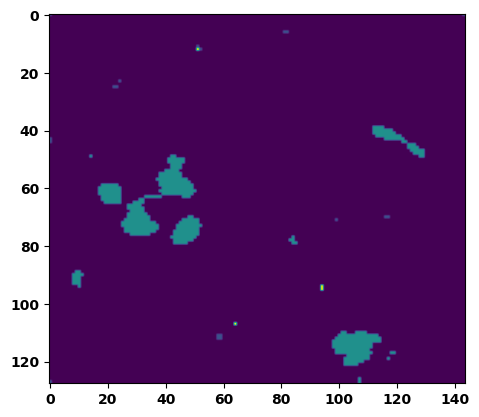

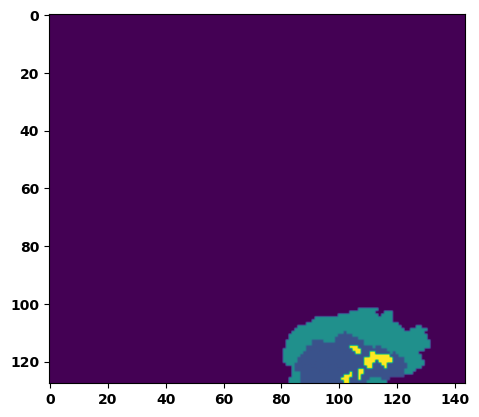

  6%|▌         | 2/36 [00:02<00:50,  1.48s/it]

Batch_id:  1 Eval loss:  0.22206613421440125
Batch_id:  1 Eval IoU:  tensor(0.6832, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9809, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:51,  1.56s/it]

Batch_id:  2 Eval loss:  0.187807098031044
Batch_id:  2 Eval IoU:  tensor(0.7241, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


 11%|█         | 4/36 [00:06<00:49,  1.56s/it]

Batch_id:  3 Eval loss:  0.5952327251434326
Batch_id:  3 Eval IoU:  tensor(0.3575, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.47s/it]

Batch_id:  4 Eval loss:  0.0816221833229065
Batch_id:  4 Eval IoU:  tensor(0.8585, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:42,  1.43s/it]

Batch_id:  5 Eval loss:  0.27396488189697266
Batch_id:  5 Eval IoU:  tensor(0.6554, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:41,  1.44s/it]

Batch_id:  6 Eval loss:  0.18798036873340607
Batch_id:  6 Eval IoU:  tensor(0.7228, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9960, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.44s/it]

Batch_id:  7 Eval loss:  0.10501517355442047
Batch_id:  7 Eval IoU:  tensor(0.8556, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9955, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:38,  1.44s/it]

Batch_id:  8 Eval loss:  0.39033958315849304
Batch_id:  8 Eval IoU:  tensor(0.5356, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:37,  1.45s/it]

Batch_id:  9 Eval loss:  0.5082939863204956
Batch_id:  9 Eval IoU:  tensor(0.3994, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9354, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9303, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  10 Eval loss:  0.23092752695083618
Batch_id:  10 Eval IoU:  tensor(0.6717, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9876, device='cuda:0')


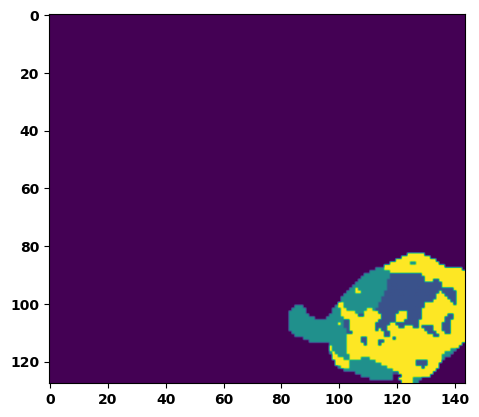

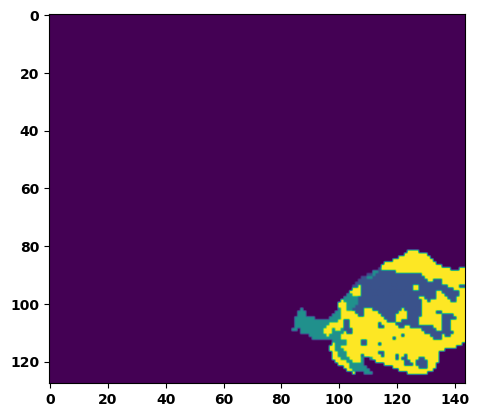

 33%|███▎      | 12/36 [00:18<00:38,  1.59s/it]

Batch_id:  11 Eval loss:  0.19757550954818726
Batch_id:  11 Eval IoU:  tensor(0.6992, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9865, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:35,  1.54s/it]

Batch_id:  12 Eval loss:  0.40817683935165405
Batch_id:  12 Eval IoU:  tensor(0.5273, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9049, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.8583, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.8578, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:33,  1.52s/it]

Batch_id:  13 Eval loss:  0.25616949796676636
Batch_id:  13 Eval IoU:  tensor(0.6963, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.50s/it]

Batch_id:  14 Eval loss:  0.39002475142478943
Batch_id:  14 Eval IoU:  tensor(0.5395, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9978, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:30,  1.50s/it]

Batch_id:  15 Eval loss:  0.08103232085704803
Batch_id:  15 Eval IoU:  tensor(0.8635, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9970, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:28,  1.48s/it]

Batch_id:  16 Eval loss:  0.13150867819786072
Batch_id:  16 Eval IoU:  tensor(0.7964, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9446, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:25,  1.42s/it]

Batch_id:  17 Eval loss:  0.1765398234128952
Batch_id:  17 Eval IoU:  tensor(0.7316, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  18 Eval loss:  0.21560807526111603
Batch_id:  18 Eval IoU:  tensor(0.6667, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  

 53%|█████▎    | 19/36 [00:28<00:24,  1.45s/it]

tensor(0.9495, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9816, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.45s/it]

Batch_id:  19 Eval loss:  0.25759202241897583
Batch_id:  19 Eval IoU:  tensor(0.6491, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  20 Eval loss:  0.10772572457790375
Batch_id:  20 Eval IoU:  tensor(0.8181, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


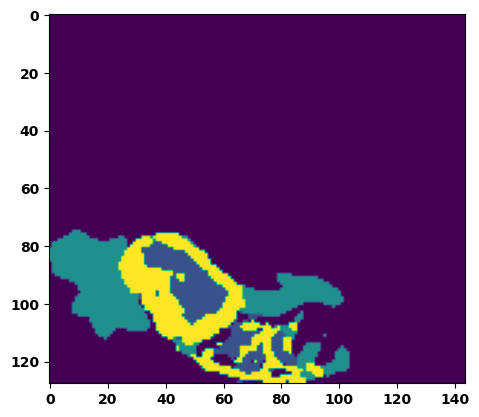

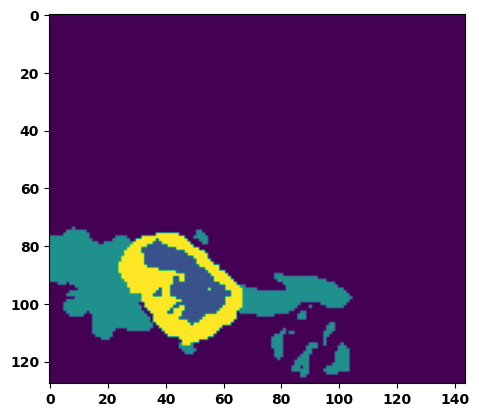

 61%|██████    | 22/36 [00:32<00:21,  1.52s/it]

Batch_id:  21 Eval loss:  0.05936986207962036
Batch_id:  21 Eval IoU:  tensor(0.8985, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.48s/it]

Batch_id:  22 Eval loss:  0.15183377265930176
Batch_id:  22 Eval IoU:  tensor(0.7599, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.45s/it]

Batch_id:  23 Eval loss:  0.1031312495470047
Batch_id:  23 Eval IoU:  tensor(0.8235, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:15,  1.42s/it]

Batch_id:  24 Eval loss:  0.06916503608226776
Batch_id:  24 Eval IoU:  tensor(0.8808, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.45s/it]

Batch_id:  25 Eval loss:  0.07952162623405457
Batch_id:  25 Eval IoU:  tensor(0.8617, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:12,  1.40s/it]

Batch_id:  26 Eval loss:  0.07393494248390198
Batch_id:  26 Eval IoU:  tensor(0.8889, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.38s/it]

Batch_id:  27 Eval loss:  0.09110613167285919
Batch_id:  27 Eval IoU:  tensor(0.8482, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:09,  1.35s/it]

Batch_id:  28 Eval loss:  0.1868959218263626
Batch_id:  28 Eval IoU:  tensor(0.7188, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.35s/it]

Batch_id:  29 Eval loss:  0.06249421834945679
Batch_id:  29 Eval IoU:  tensor(0.9010, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  30 Eval loss:  0.29648205637931824
Batch_id:  30 Eval IoU:  tensor(0.6064, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9538, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9338, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9387, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9915, device='cuda:0')


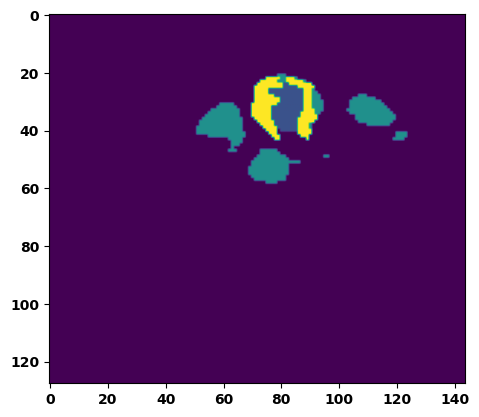

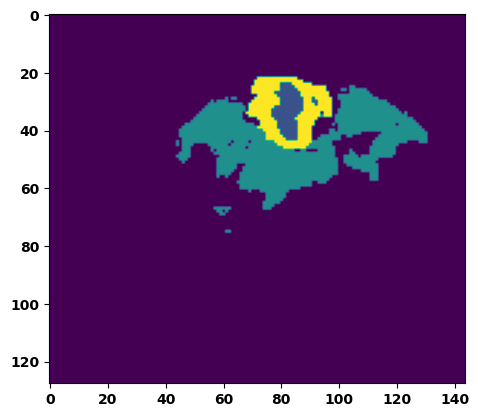

 89%|████████▉ | 32/36 [00:46<00:05,  1.46s/it]

Batch_id:  31 Eval loss:  0.13920141756534576
Batch_id:  31 Eval IoU:  tensor(0.7714, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9862, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.40s/it]

Batch_id:  32 Eval loss:  0.27638545632362366
Batch_id:  32 Eval IoU:  tensor(0.6257, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9428, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.40s/it]

Batch_id:  33 Eval loss:  0.1435047835111618
Batch_id:  33 Eval IoU:  tensor(0.7849, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.42s/it]

Batch_id:  34 Eval loss:  0.07835210859775543
Batch_id:  34 Eval IoU:  tensor(0.8686, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9869, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.46s/it]

Batch_id:  35 Eval loss:  0.3908562660217285
Batch_id:  35 Eval IoU:  tensor(0.4950, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9262, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9205, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9896, device='cuda:0')
Epoch  34 Training loss:  0.1681515028530901
Epoch  34 Evaluation loss:  0.22037029928631252
Epoch  34 Training accuracy :  tensor(0.7608)
Epoch  34 Evaluation accuracy :  tensor(0.7065)
Epoch  34 Training Mean Dice Score:  tensor(0.9809)
Epoch  34 Eval Mean Dice Score:  tensor(0.9736)
Epoch  34 Training Non-tumor Dice Score:  tensor(0.9825)
Epoch  34 Eval Non-tumor Dice Score:  tensor(0.9723)
Epoch  34 Training NCR/NET Dice Score:  tensor(0.9911)
Epoch  34 Eval NCR/NET Dice Score:  tensor(0.9875)
Epoch  34 Training ED Dice Score:  tensor(0.97

Epoch: 35
Training in session: 


  1%|          | 1/110 [00:01<02:50,  1.56s/it]

Batch_id:  0 Training loss:  0.14163830876350403
Batch_id:  0 Training IoU:  tensor(0.7809, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:41,  1.50s/it]

Batch_id:  1 Training loss:  0.1711149513721466
Batch_id:  1 Training IoU:  tensor(0.7244, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:47,  1.56s/it]

Batch_id:  2 Training loss:  0.26778846979141235
Batch_id:  2 Training IoU:  tensor(0.6355, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9577, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:38,  1.50s/it]

Batch_id:  3 Training loss:  0.25109896063804626
Batch_id:  3 Training IoU:  tensor(0.6522, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9845, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:35,  1.48s/it]

Batch_id:  4 Training loss:  0.24915044009685516
Batch_id:  4 Training IoU:  tensor(0.6480, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9833, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:31,  1.46s/it]

Batch_id:  5 Training loss:  0.0546925812959671
Batch_id:  5 Training IoU:  tensor(0.9082, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:30,  1.46s/it]

Batch_id:  6 Training loss:  0.10237275063991547
Batch_id:  6 Training IoU:  tensor(0.8299, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:29,  1.47s/it]

Batch_id:  7 Training loss:  0.24042227864265442
Batch_id:  7 Training IoU:  tensor(0.6462, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9345, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9764, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:23,  1.42s/it]

Batch_id:  8 Training loss:  0.15953293442726135
Batch_id:  8 Training IoU:  tensor(0.7478, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9706, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:18,  1.38s/it]

Batch_id:  9 Training loss:  0.17316702008247375
Batch_id:  9 Training IoU:  tensor(0.7428, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 10%|█         | 11/110 [00:15<02:18,  1.40s/it]

Batch_id:  10 Training loss:  0.2690710723400116
Batch_id:  10 Training IoU:  tensor(0.6763, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 11%|█         | 12/110 [00:17<02:21,  1.44s/it]

Batch_id:  11 Training loss:  0.10981160402297974
Batch_id:  11 Training IoU:  tensor(0.8167, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:21,  1.45s/it]

Batch_id:  12 Training loss:  0.06618800759315491
Batch_id:  12 Training IoU:  tensor(0.8845, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:20,  1.47s/it]

Batch_id:  13 Training loss:  0.5284861922264099
Batch_id:  13 Training IoU:  tensor(0.4194, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:17,  1.45s/it]

Batch_id:  14 Training loss:  0.2145957201719284
Batch_id:  14 Training IoU:  tensor(0.6841, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:19,  1.49s/it]

Batch_id:  15 Training loss:  0.05321432650089264
Batch_id:  15 Training IoU:  tensor(0.9109, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:18,  1.49s/it]

Batch_id:  16 Training loss:  0.09920841455459595
Batch_id:  16 Training IoU:  tensor(0.8349, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9819, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:19,  1.52s/it]

Batch_id:  17 Training loss:  0.13978582620620728
Batch_id:  17 Training IoU:  tensor(0.7818, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:13,  1.47s/it]

Batch_id:  18 Training loss:  0.12943007051944733
Batch_id:  18 Training IoU:  tensor(0.7872, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:16,  1.51s/it]

Batch_id:  19 Training loss:  0.09349717199802399
Batch_id:  19 Training IoU:  tensor(0.8434, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:14,  1.51s/it]

Batch_id:  20 Training loss:  0.14296047389507294
Batch_id:  20 Training IoU:  tensor(0.7911, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 20%|██        | 22/110 [00:32<02:14,  1.53s/it]

Batch_id:  21 Training loss:  0.0846063494682312
Batch_id:  21 Training IoU:  tensor(0.8611, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 21%|██        | 23/110 [00:33<02:09,  1.48s/it]

Batch_id:  22 Training loss:  0.19007757306098938
Batch_id:  22 Training IoU:  tensor(0.7195, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:10,  1.51s/it]

Batch_id:  23 Training loss:  0.07899133861064911
Batch_id:  23 Training IoU:  tensor(0.8686, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:07,  1.50s/it]

Batch_id:  24 Training loss:  0.15635883808135986
Batch_id:  24 Training IoU:  tensor(0.7492, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:04,  1.48s/it]

Batch_id:  25 Training loss:  0.10353980958461761
Batch_id:  25 Training IoU:  tensor(0.8424, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:04,  1.51s/it]

Batch_id:  26 Training loss:  0.34172356128692627
Batch_id:  26 Training IoU:  tensor(0.6388, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 25%|██▌       | 28/110 [00:41<02:05,  1.53s/it]

Batch_id:  27 Training loss:  0.11521308124065399
Batch_id:  27 Training IoU:  tensor(0.8128, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 26%|██▋       | 29/110 [00:43<02:02,  1.52s/it]

Batch_id:  28 Training loss:  0.13509616255760193
Batch_id:  28 Training IoU:  tensor(0.7738, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9752, device='cuda:0')


 27%|██▋       | 30/110 [00:44<02:00,  1.51s/it]

Batch_id:  29 Training loss:  0.06780409812927246
Batch_id:  29 Training IoU:  tensor(0.8871, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 28%|██▊       | 31/110 [00:46<02:02,  1.55s/it]

Batch_id:  30 Training loss:  0.14391054213047028
Batch_id:  30 Training IoU:  tensor(0.7662, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 29%|██▉       | 32/110 [00:47<02:01,  1.56s/it]

Batch_id:  31 Training loss:  0.04503902792930603
Batch_id:  31 Training IoU:  tensor(0.9219, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 30%|███       | 33/110 [00:49<02:00,  1.56s/it]

Batch_id:  32 Training loss:  0.41864508390426636
Batch_id:  32 Training IoU:  tensor(0.4873, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9373, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9182, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 31%|███       | 34/110 [00:50<01:56,  1.54s/it]

Batch_id:  33 Training loss:  0.1674090325832367
Batch_id:  33 Training IoU:  tensor(0.7395, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:52,  1.49s/it]

Batch_id:  34 Training loss:  0.08458253741264343
Batch_id:  34 Training IoU:  tensor(0.8615, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:47,  1.45s/it]

Batch_id:  35 Training loss:  0.21073076128959656
Batch_id:  35 Training IoU:  tensor(0.6854, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:44,  1.43s/it]

Batch_id:  36 Training loss:  0.25325891375541687
Batch_id:  36 Training IoU:  tensor(0.6761, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:43,  1.44s/it]

Batch_id:  37 Training loss:  0.04661060869693756
Batch_id:  37 Training IoU:  tensor(0.9208, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:44,  1.47s/it]

Batch_id:  38 Training loss:  0.17305749654769897
Batch_id:  38 Training IoU:  tensor(0.7429, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 36%|███▋      | 40/110 [00:59<01:45,  1.50s/it]

Batch_id:  39 Training loss:  0.09670689702033997
Batch_id:  39 Training IoU:  tensor(0.8354, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:43,  1.49s/it]

Batch_id:  40 Training loss:  0.09146995842456818
Batch_id:  40 Training IoU:  tensor(0.8442, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:42,  1.50s/it]

Batch_id:  41 Training loss:  0.21131888031959534
Batch_id:  41 Training IoU:  tensor(0.7179, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:42,  1.53s/it]

Batch_id:  42 Training loss:  0.08499257266521454
Batch_id:  42 Training IoU:  tensor(0.8535, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 40%|████      | 44/110 [01:05<01:39,  1.51s/it]

Batch_id:  43 Training loss:  0.17587384581565857
Batch_id:  43 Training IoU:  tensor(0.7306, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 41%|████      | 45/110 [01:06<01:36,  1.48s/it]

Batch_id:  44 Training loss:  0.09520773589611053
Batch_id:  44 Training IoU:  tensor(0.8450, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:31,  1.44s/it]

Batch_id:  45 Training loss:  0.1346980780363083
Batch_id:  45 Training IoU:  tensor(0.8043, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:33,  1.49s/it]

Batch_id:  46 Training loss:  0.047766923904418945
Batch_id:  46 Training IoU:  tensor(0.9155, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:31,  1.47s/it]

Batch_id:  47 Training loss:  0.10945220291614532
Batch_id:  47 Training IoU:  tensor(0.8262, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:31,  1.50s/it]

Batch_id:  48 Training loss:  0.15239153802394867
Batch_id:  48 Training IoU:  tensor(0.7558, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 45%|████▌     | 50/110 [01:14<01:31,  1.53s/it]

Batch_id:  49 Training loss:  0.2471039891242981
Batch_id:  49 Training IoU:  tensor(0.6549, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 46%|████▋     | 51/110 [01:15<01:28,  1.51s/it]

Batch_id:  50 Training loss:  0.18809831142425537
Batch_id:  50 Training IoU:  tensor(0.7133, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 47%|████▋     | 52/110 [01:17<01:27,  1.50s/it]

Batch_id:  51 Training loss:  0.2604040503501892
Batch_id:  51 Training IoU:  tensor(0.6211, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9735, device='cuda:0')


 48%|████▊     | 53/110 [01:18<01:25,  1.49s/it]

Batch_id:  52 Training loss:  0.11857561767101288
Batch_id:  52 Training IoU:  tensor(0.8038, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


 49%|████▉     | 54/110 [01:20<01:25,  1.52s/it]

Batch_id:  53 Training loss:  0.05332024395465851
Batch_id:  53 Training IoU:  tensor(0.9129, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 50%|█████     | 55/110 [01:22<01:24,  1.54s/it]

Batch_id:  54 Training loss:  0.12988083064556122
Batch_id:  54 Training IoU:  tensor(0.7949, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 51%|█████     | 56/110 [01:23<01:20,  1.48s/it]

Batch_id:  55 Training loss:  0.08968625962734222
Batch_id:  55 Training IoU:  tensor(0.8486, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 52%|█████▏    | 57/110 [01:25<01:19,  1.50s/it]

Batch_id:  56 Training loss:  0.21831391751766205
Batch_id:  56 Training IoU:  tensor(0.6822, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 53%|█████▎    | 58/110 [01:26<01:17,  1.50s/it]

Batch_id:  57 Training loss:  0.11236213147640228
Batch_id:  57 Training IoU:  tensor(0.8147, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9772, device='cuda:0')


 54%|█████▎    | 59/110 [01:28<01:17,  1.51s/it]

Batch_id:  58 Training loss:  0.10670250654220581
Batch_id:  58 Training IoU:  tensor(0.8237, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 55%|█████▍    | 60/110 [01:29<01:15,  1.51s/it]

Batch_id:  59 Training loss:  0.3559037744998932
Batch_id:  59 Training IoU:  tensor(0.5799, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 55%|█████▌    | 61/110 [01:31<01:14,  1.52s/it]

Batch_id:  60 Training loss:  0.1436644196510315
Batch_id:  60 Training IoU:  tensor(0.7679, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 56%|█████▋    | 62/110 [01:32<01:11,  1.49s/it]

Batch_id:  61 Training loss:  0.12562091648578644
Batch_id:  61 Training IoU:  tensor(0.7994, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 57%|█████▋    | 63/110 [01:34<01:10,  1.50s/it]

Batch_id:  62 Training loss:  0.20014943182468414
Batch_id:  62 Training IoU:  tensor(0.6978, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 58%|█████▊    | 64/110 [01:35<01:09,  1.52s/it]

Batch_id:  63 Training loss:  0.10235124826431274
Batch_id:  63 Training IoU:  tensor(0.8268, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 59%|█████▉    | 65/110 [01:37<01:08,  1.52s/it]

Batch_id:  64 Training loss:  0.20439743995666504
Batch_id:  64 Training IoU:  tensor(0.6904, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 60%|██████    | 66/110 [01:38<01:05,  1.50s/it]

Batch_id:  65 Training loss:  0.26336103677749634
Batch_id:  65 Training IoU:  tensor(0.6906, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 61%|██████    | 67/110 [01:40<01:06,  1.54s/it]

Batch_id:  66 Training loss:  0.14227434992790222
Batch_id:  66 Training IoU:  tensor(0.8101, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 62%|██████▏   | 68/110 [01:41<01:02,  1.50s/it]

Batch_id:  67 Training loss:  0.38835009932518005
Batch_id:  67 Training IoU:  tensor(0.5335, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 63%|██████▎   | 69/110 [01:43<01:01,  1.51s/it]

Batch_id:  68 Training loss:  0.08503048121929169
Batch_id:  68 Training IoU:  tensor(0.8801, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 64%|██████▎   | 70/110 [01:44<01:00,  1.51s/it]

Batch_id:  69 Training loss:  0.0939665287733078
Batch_id:  69 Training IoU:  tensor(0.8371, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


 65%|██████▍   | 71/110 [01:46<01:00,  1.56s/it]

Batch_id:  70 Training loss:  0.10681094229221344
Batch_id:  70 Training IoU:  tensor(0.8195, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 65%|██████▌   | 72/110 [01:47<00:57,  1.51s/it]

Batch_id:  71 Training loss:  0.07491154968738556
Batch_id:  71 Training IoU:  tensor(0.8704, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 66%|██████▋   | 73/110 [01:49<00:54,  1.48s/it]

Batch_id:  72 Training loss:  0.16972659528255463
Batch_id:  72 Training IoU:  tensor(0.7282, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 67%|██████▋   | 74/110 [01:50<00:52,  1.46s/it]

Batch_id:  73 Training loss:  0.1622818410396576
Batch_id:  73 Training IoU:  tensor(0.7571, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9605, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 68%|██████▊   | 75/110 [01:52<00:51,  1.46s/it]

Batch_id:  74 Training loss:  0.0962173342704773
Batch_id:  74 Training IoU:  tensor(0.8352, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 69%|██████▉   | 76/110 [01:53<00:49,  1.46s/it]

Batch_id:  75 Training loss:  0.1215464174747467
Batch_id:  75 Training IoU:  tensor(0.8094, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 70%|███████   | 77/110 [01:55<00:51,  1.55s/it]

Batch_id:  76 Training loss:  0.21321269869804382
Batch_id:  76 Training IoU:  tensor(0.6751, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9382, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9219, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


 71%|███████   | 78/110 [01:56<00:48,  1.51s/it]

Batch_id:  77 Training loss:  0.2101254016160965
Batch_id:  77 Training IoU:  tensor(0.6864, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:44,  1.44s/it]

Batch_id:  78 Training loss:  0.1659058779478073
Batch_id:  78 Training IoU:  tensor(0.7350, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 73%|███████▎  | 80/110 [01:59<00:43,  1.44s/it]

Batch_id:  79 Training loss:  0.08812578022480011
Batch_id:  79 Training IoU:  tensor(0.8489, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 74%|███████▎  | 81/110 [02:00<00:42,  1.46s/it]

Batch_id:  80 Training loss:  0.3253719210624695
Batch_id:  80 Training IoU:  tensor(0.6102, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 75%|███████▍  | 82/110 [02:02<00:42,  1.51s/it]

Batch_id:  81 Training loss:  0.2652183771133423
Batch_id:  81 Training IoU:  tensor(0.6859, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 75%|███████▌  | 83/110 [02:03<00:38,  1.44s/it]

Batch_id:  82 Training loss:  0.15417668223381042
Batch_id:  82 Training IoU:  tensor(0.7843, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 76%|███████▋  | 84/110 [02:05<00:38,  1.49s/it]

Batch_id:  83 Training loss:  0.17156849801540375
Batch_id:  83 Training IoU:  tensor(0.7990, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 77%|███████▋  | 85/110 [02:06<00:37,  1.49s/it]

Batch_id:  84 Training loss:  0.13415473699569702
Batch_id:  84 Training IoU:  tensor(0.7981, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 78%|███████▊  | 86/110 [02:08<00:35,  1.47s/it]

Batch_id:  85 Training loss:  0.14057934284210205
Batch_id:  85 Training IoU:  tensor(0.7801, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 79%|███████▉  | 87/110 [02:09<00:33,  1.44s/it]

Batch_id:  86 Training loss:  0.08971187472343445
Batch_id:  86 Training IoU:  tensor(0.8585, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 80%|████████  | 88/110 [02:11<00:32,  1.49s/it]

Batch_id:  87 Training loss:  0.0601603239774704
Batch_id:  87 Training IoU:  tensor(0.8972, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 81%|████████  | 89/110 [02:12<00:30,  1.46s/it]

Batch_id:  88 Training loss:  0.07830066978931427
Batch_id:  88 Training IoU:  tensor(0.8808, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 82%|████████▏ | 90/110 [02:14<00:28,  1.43s/it]

Batch_id:  89 Training loss:  0.08598479628562927
Batch_id:  89 Training IoU:  tensor(0.8528, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 83%|████████▎ | 91/110 [02:15<00:27,  1.42s/it]

Batch_id:  90 Training loss:  0.2228037416934967
Batch_id:  90 Training IoU:  tensor(0.7305, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 84%|████████▎ | 92/110 [02:16<00:25,  1.44s/it]

Batch_id:  91 Training loss:  0.17374269664287567
Batch_id:  91 Training IoU:  tensor(0.8154, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 85%|████████▍ | 93/110 [02:18<00:24,  1.45s/it]

Batch_id:  92 Training loss:  0.126919224858284
Batch_id:  92 Training IoU:  tensor(0.7996, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 85%|████████▌ | 94/110 [02:19<00:22,  1.41s/it]

Batch_id:  93 Training loss:  0.33504682779312134
Batch_id:  93 Training IoU:  tensor(0.6281, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9989, device='cuda:0')


 86%|████████▋ | 95/110 [02:21<00:21,  1.46s/it]

Batch_id:  94 Training loss:  0.2636263072490692
Batch_id:  94 Training IoU:  tensor(0.6521, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 87%|████████▋ | 96/110 [02:22<00:20,  1.49s/it]

Batch_id:  95 Training loss:  0.10265709459781647
Batch_id:  95 Training IoU:  tensor(0.8274, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 88%|████████▊ | 97/110 [02:24<00:19,  1.50s/it]

Batch_id:  96 Training loss:  0.22577330470085144
Batch_id:  96 Training IoU:  tensor(0.7230, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 89%|████████▉ | 98/110 [02:25<00:18,  1.51s/it]

Batch_id:  97 Training loss:  0.3285309374332428
Batch_id:  97 Training IoU:  tensor(0.6160, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 90%|█████████ | 99/110 [02:27<00:15,  1.44s/it]

Batch_id:  98 Training loss:  0.12118414044380188
Batch_id:  98 Training IoU:  tensor(0.7980, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:14,  1.43s/it]

Batch_id:  99 Training loss:  0.16259635984897614
Batch_id:  99 Training IoU:  tensor(0.7865, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9987, device='cuda:0')


 92%|█████████▏| 101/110 [02:30<00:13,  1.45s/it]

Batch_id:  100 Training loss:  0.163153737783432
Batch_id:  100 Training IoU:  tensor(0.8042, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 93%|█████████▎| 102/110 [02:31<00:12,  1.51s/it]

Batch_id:  101 Training loss:  0.13135786354541779
Batch_id:  101 Training IoU:  tensor(0.8017, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 94%|█████████▎| 103/110 [02:33<00:10,  1.48s/it]

Batch_id:  102 Training loss:  0.23404629528522491
Batch_id:  102 Training IoU:  tensor(0.6522, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9561, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9477, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 95%|█████████▍| 104/110 [02:34<00:09,  1.51s/it]

Batch_id:  103 Training loss:  0.13231900334358215
Batch_id:  103 Training IoU:  tensor(0.8065, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 95%|█████████▌| 105/110 [02:36<00:07,  1.51s/it]

Batch_id:  104 Training loss:  0.12538625299930573
Batch_id:  104 Training IoU:  tensor(0.8132, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 96%|█████████▋| 106/110 [02:37<00:06,  1.57s/it]

Batch_id:  105 Training loss:  0.15667155385017395
Batch_id:  105 Training IoU:  tensor(0.7446, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 97%|█████████▋| 107/110 [02:39<00:04,  1.49s/it]

Batch_id:  106 Training loss:  0.19109804928302765
Batch_id:  106 Training IoU:  tensor(0.7075, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9560, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9732, device='cuda:0')


 98%|█████████▊| 108/110 [02:40<00:02,  1.46s/it]

Batch_id:  107 Training loss:  0.4665985703468323
Batch_id:  107 Training IoU:  tensor(0.4562, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 99%|█████████▉| 109/110 [02:42<00:01,  1.43s/it]

Batch_id:  108 Training loss:  0.26651597023010254
Batch_id:  108 Training IoU:  tensor(0.6249, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9288, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


100%|██████████| 110/110 [02:43<00:00,  1.49s/it]


Batch_id:  109 Training loss:  0.22778131067752838
Batch_id:  109 Training IoU:  tensor(0.6707, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9773, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.1469474732875824
Batch_id:  0 Eval IoU:  tensor(0.7805, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


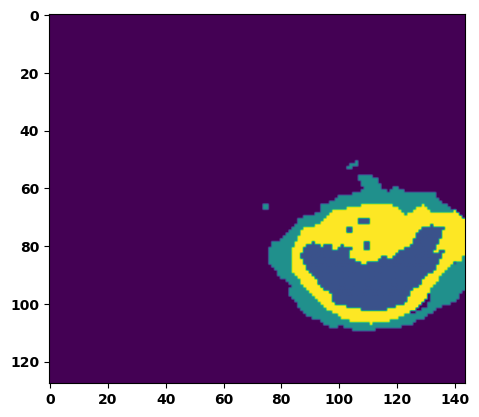

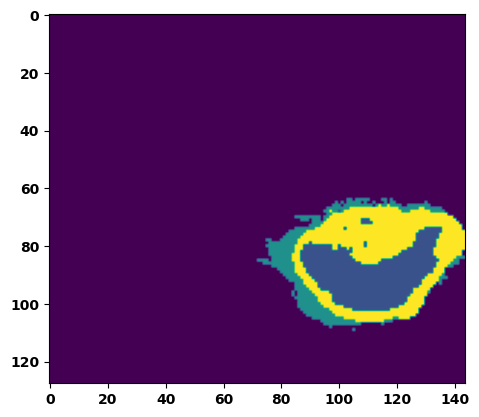

  6%|▌         | 2/36 [00:03<00:53,  1.56s/it]

Batch_id:  1 Eval loss:  0.08566392958164215
Batch_id:  1 Eval IoU:  tensor(0.8515, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.49s/it]

Batch_id:  2 Eval loss:  0.07068286836147308
Batch_id:  2 Eval IoU:  tensor(0.8786, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9901, device='cuda:0')


 11%|█         | 4/36 [00:06<00:48,  1.50s/it]

Batch_id:  3 Eval loss:  0.1736844927072525
Batch_id:  3 Eval IoU:  tensor(0.7322, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:46,  1.49s/it]

Batch_id:  4 Eval loss:  0.12320388853549957
Batch_id:  4 Eval IoU:  tensor(0.8071, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9477, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:44,  1.49s/it]

Batch_id:  5 Eval loss:  0.13577218353748322
Batch_id:  5 Eval IoU:  tensor(0.7761, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:43,  1.51s/it]

Batch_id:  6 Eval loss:  0.1946079134941101
Batch_id:  6 Eval IoU:  tensor(0.7176, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9886, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:42,  1.52s/it]

Batch_id:  7 Eval loss:  0.2527441680431366
Batch_id:  7 Eval IoU:  tensor(0.6557, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9470, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9423, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:40,  1.48s/it]

Batch_id:  8 Eval loss:  0.15754207968711853
Batch_id:  8 Eval IoU:  tensor(0.7511, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:37,  1.44s/it]

Batch_id:  9 Eval loss:  0.3933843970298767
Batch_id:  9 Eval IoU:  tensor(0.4914, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9260, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9200, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  10 Eval loss:  0.38114631175994873
Batch_id:  10 Eval IoU:  tensor(0.5474, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


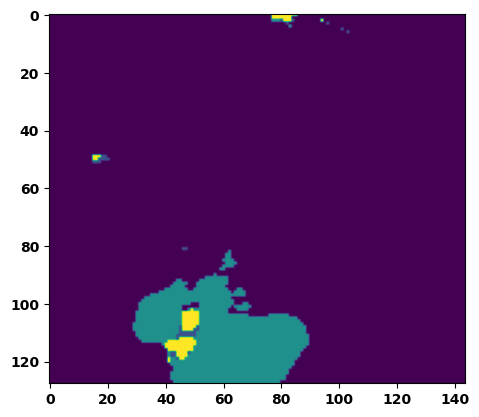

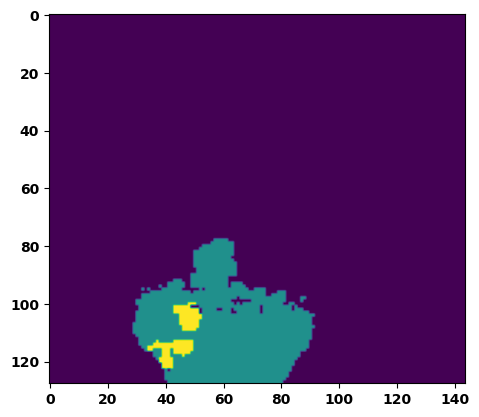

 33%|███▎      | 12/36 [00:18<00:36,  1.53s/it]

Batch_id:  11 Eval loss:  0.23844832181930542
Batch_id:  11 Eval IoU:  tensor(0.6646, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9876, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.51s/it]

Batch_id:  12 Eval loss:  0.0792282223701477
Batch_id:  12 Eval IoU:  tensor(0.8798, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:32,  1.49s/it]

Batch_id:  13 Eval loss:  0.09621724486351013
Batch_id:  13 Eval IoU:  tensor(0.8396, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.52s/it]

Batch_id:  14 Eval loss:  0.39771515130996704
Batch_id:  14 Eval IoU:  tensor(0.5294, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.42s/it]

Batch_id:  15 Eval loss:  0.18888595700263977
Batch_id:  15 Eval IoU:  tensor(0.7223, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:26,  1.39s/it]

Batch_id:  16 Eval loss:  0.40012219548225403
Batch_id:  16 Eval IoU:  tensor(0.5352, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9082, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.8634, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.8628, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:25,  1.40s/it]

Batch_id:  17 Eval loss:  0.07825063169002533
Batch_id:  17 Eval IoU:  tensor(0.8692, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:23,  1.39s/it]

Batch_id:  18 Eval loss:  0.47950929403305054
Batch_id:  18 Eval IoU:  tensor(0.4171, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9325, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9367, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9980, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:22,  1.39s/it]

Batch_id:  19 Eval loss:  0.20337137579917908
Batch_id:  19 Eval IoU:  tensor(0.6837, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9484, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  20 Eval loss:  0.25737613439559937
Batch_id:  20 Eval IoU:  tensor(0.6427, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9464, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


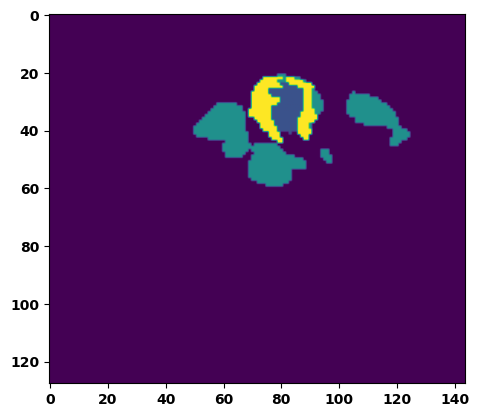

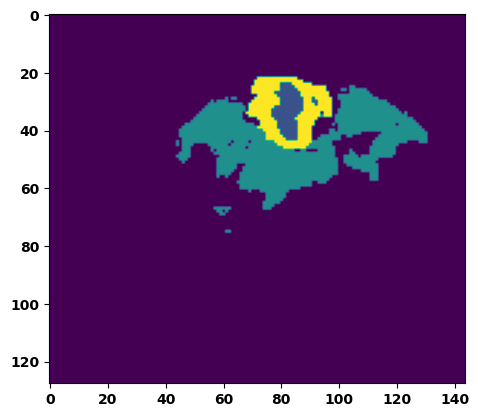

 61%|██████    | 22/36 [00:32<00:19,  1.40s/it]

Batch_id:  21 Eval loss:  0.2274419069290161
Batch_id:  21 Eval IoU:  tensor(0.6767, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9800, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:17,  1.36s/it]

Batch_id:  22 Eval loss:  0.2796257436275482
Batch_id:  22 Eval IoU:  tensor(0.6508, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:16,  1.39s/it]

Batch_id:  23 Eval loss:  0.06441259384155273
Batch_id:  23 Eval IoU:  tensor(0.8979, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.41s/it]

Batch_id:  24 Eval loss:  0.1004629135131836
Batch_id:  24 Eval IoU:  tensor(0.8280, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 72%|███████▏  | 26/36 [00:37<00:14,  1.40s/it]

Batch_id:  25 Eval loss:  0.2519545555114746
Batch_id:  25 Eval IoU:  tensor(0.7038, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:12,  1.41s/it]

Batch_id:  26 Eval loss:  0.08249761164188385
Batch_id:  26 Eval IoU:  tensor(0.8610, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9968, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:10,  1.34s/it]

Batch_id:  27 Eval loss:  0.18682391941547394
Batch_id:  27 Eval IoU:  tensor(0.7217, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 81%|████████  | 29/36 [00:41<00:09,  1.37s/it]

Batch_id:  28 Eval loss:  0.05886915326118469
Batch_id:  28 Eval IoU:  tensor(0.8985, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.38s/it]

Batch_id:  29 Eval loss:  0.10441341996192932
Batch_id:  29 Eval IoU:  tensor(0.8235, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  30 Eval loss:  0.7178679704666138
Batch_id:  30 Eval IoU:  tensor(0.2546, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9498, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9322, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9410, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9972, device='cuda:0')


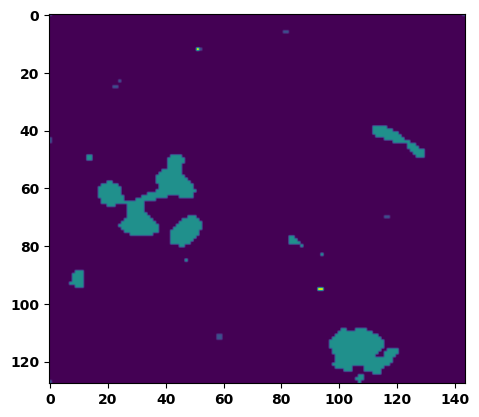

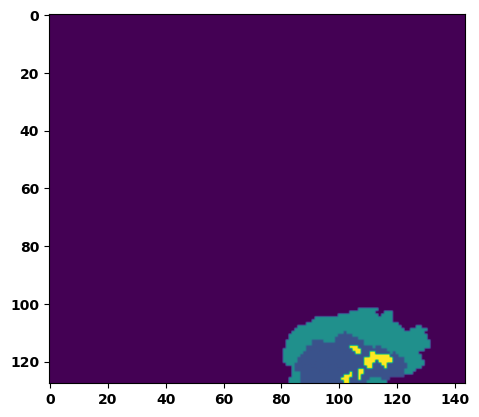

 89%|████████▉ | 32/36 [00:46<00:05,  1.44s/it]

Batch_id:  31 Eval loss:  0.07840797305107117
Batch_id:  31 Eval IoU:  tensor(0.8631, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9910, device='cuda:0')


 92%|█████████▏| 33/36 [00:47<00:04,  1.39s/it]

Batch_id:  32 Eval loss:  0.27446791529655457
Batch_id:  32 Eval IoU:  tensor(0.6261, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


 94%|█████████▍| 34/36 [00:48<00:02,  1.40s/it]

Batch_id:  33 Eval loss:  0.19738523662090302
Batch_id:  33 Eval IoU:  tensor(0.7006, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9871, device='cuda:0')


 97%|█████████▋| 35/36 [00:50<00:01,  1.39s/it]

Batch_id:  34 Eval loss:  0.5948743224143982
Batch_id:  34 Eval IoU:  tensor(0.3545, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9948, device='cuda:0')


100%|██████████| 36/36 [00:51<00:00,  1.43s/it]

Batch_id:  35 Eval loss:  0.10809125006198883
Batch_id:  35 Eval IoU:  tensor(0.8514, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9954, device='cuda:0')
Epoch  35 Training loss:  0.16704708649353547
Epoch  35 Evaluation loss:  0.21839168667793274
Epoch  35 Training accuracy :  tensor(0.7617)
Epoch  35 Evaluation accuracy :  tensor(0.7079)
Epoch  35 Training Mean Dice Score:  tensor(0.9811)
Epoch  35 Eval Mean Dice Score:  tensor(0.9738)
Epoch  35 Training Non-tumor Dice Score:  tensor(0.9825)
Epoch  35 Eval Non-tumor Dice Score:  tensor(0.9731)
Epoch  35 Training NCR/NET Dice Score:  tensor(0.9912)
Epoch  35 Eval NCR/NET Dice Score:  tensor(0.9874)
Epoch  35 Training ED Dice Score:  tensor(0.

Epoch: 36
Training in session: 


  1%|          | 1/110 [00:01<02:32,  1.40s/it]

Batch_id:  0 Training loss:  0.13085885345935822
Batch_id:  0 Training IoU:  tensor(0.7856, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:33,  1.42s/it]

Batch_id:  1 Training loss:  0.09065939486026764
Batch_id:  1 Training IoU:  tensor(0.8445, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:33,  1.43s/it]

Batch_id:  2 Training loss:  0.1479954570531845
Batch_id:  2 Training IoU:  tensor(0.7599, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9862, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:34,  1.46s/it]

Batch_id:  3 Training loss:  0.1892808973789215
Batch_id:  3 Training IoU:  tensor(0.7117, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:32,  1.46s/it]

Batch_id:  4 Training loss:  0.3616267442703247
Batch_id:  4 Training IoU:  tensor(0.5700, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:29,  1.44s/it]

Batch_id:  5 Training loss:  0.09176596999168396
Batch_id:  5 Training IoU:  tensor(0.8438, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


  6%|▋         | 7/110 [00:09<02:24,  1.40s/it]

Batch_id:  6 Training loss:  0.1996791660785675
Batch_id:  6 Training IoU:  tensor(0.7007, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:23,  1.41s/it]

Batch_id:  7 Training loss:  0.10181379318237305
Batch_id:  7 Training IoU:  tensor(0.8286, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


  8%|▊         | 9/110 [00:12<02:22,  1.41s/it]

Batch_id:  8 Training loss:  0.16152653098106384
Batch_id:  8 Training IoU:  tensor(0.7468, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9786, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:19,  1.40s/it]

Batch_id:  9 Training loss:  0.19019290804862976
Batch_id:  9 Training IoU:  tensor(0.7172, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 10%|█         | 11/110 [00:15<02:20,  1.42s/it]

Batch_id:  10 Training loss:  0.08431932330131531
Batch_id:  10 Training IoU:  tensor(0.8560, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9839, device='cuda:0')


 11%|█         | 12/110 [00:17<02:18,  1.42s/it]

Batch_id:  11 Training loss:  0.2552531659603119
Batch_id:  11 Training IoU:  tensor(0.6376, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9309, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:18,  1.43s/it]

Batch_id:  12 Training loss:  0.09124858677387238
Batch_id:  12 Training IoU:  tensor(0.8505, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 13%|█▎        | 14/110 [00:19<02:17,  1.44s/it]

Batch_id:  13 Training loss:  0.09747257828712463
Batch_id:  13 Training IoU:  tensor(0.8333, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:19,  1.47s/it]

Batch_id:  14 Training loss:  0.08153678476810455
Batch_id:  14 Training IoU:  tensor(0.8645, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:21,  1.51s/it]

Batch_id:  15 Training loss:  0.12696713209152222
Batch_id:  15 Training IoU:  tensor(0.7978, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:18,  1.49s/it]

Batch_id:  16 Training loss:  0.06442628800868988
Batch_id:  16 Training IoU:  tensor(0.8904, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 16%|█▋        | 18/110 [00:25<02:15,  1.47s/it]

Batch_id:  17 Training loss:  0.15940086543560028
Batch_id:  17 Training IoU:  tensor(0.7898, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9987, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:16,  1.50s/it]

Batch_id:  18 Training loss:  0.03790214657783508
Batch_id:  18 Training IoU:  tensor(0.9368, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9975, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:10,  1.45s/it]

Batch_id:  19 Training loss:  0.11521174013614655
Batch_id:  19 Training IoU:  tensor(0.8265, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:12,  1.49s/it]

Batch_id:  20 Training loss:  0.21560417115688324
Batch_id:  20 Training IoU:  tensor(0.7109, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 20%|██        | 22/110 [00:32<02:12,  1.50s/it]

Batch_id:  21 Training loss:  0.24121935665607452
Batch_id:  21 Training IoU:  tensor(0.6434, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9343, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9289, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9757, device='cuda:0')


 21%|██        | 23/110 [00:33<02:10,  1.50s/it]

Batch_id:  22 Training loss:  0.09705013036727905
Batch_id:  22 Training IoU:  tensor(0.8374, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9818, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:07,  1.49s/it]

Batch_id:  23 Training loss:  0.10283829271793365
Batch_id:  23 Training IoU:  tensor(0.8289, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:10,  1.53s/it]

Batch_id:  24 Training loss:  0.046117424964904785
Batch_id:  24 Training IoU:  tensor(0.9197, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:06,  1.50s/it]

Batch_id:  25 Training loss:  0.11747731268405914
Batch_id:  25 Training IoU:  tensor(0.8081, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9766, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:05,  1.52s/it]

Batch_id:  26 Training loss:  0.10250182449817657
Batch_id:  26 Training IoU:  tensor(0.8371, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 25%|██▌       | 28/110 [00:41<02:05,  1.54s/it]

Batch_id:  27 Training loss:  0.0891956239938736
Batch_id:  27 Training IoU:  tensor(0.8512, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 26%|██▋       | 29/110 [00:42<02:00,  1.49s/it]

Batch_id:  28 Training loss:  0.08992898464202881
Batch_id:  28 Training IoU:  tensor(0.8492, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:58,  1.48s/it]

Batch_id:  29 Training loss:  0.21226252615451813
Batch_id:  29 Training IoU:  tensor(0.6861, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 28%|██▊       | 31/110 [00:45<02:00,  1.53s/it]

Batch_id:  30 Training loss:  0.09121467173099518
Batch_id:  30 Training IoU:  tensor(0.8450, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 29%|██▉       | 32/110 [00:47<01:57,  1.51s/it]

Batch_id:  31 Training loss:  0.09960928559303284
Batch_id:  31 Training IoU:  tensor(0.8343, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 30%|███       | 33/110 [00:48<01:55,  1.50s/it]

Batch_id:  32 Training loss:  0.10407102108001709
Batch_id:  32 Training IoU:  tensor(0.8364, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 31%|███       | 34/110 [00:50<01:52,  1.48s/it]

Batch_id:  33 Training loss:  0.3294309377670288
Batch_id:  33 Training IoU:  tensor(0.6322, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:50,  1.47s/it]

Batch_id:  34 Training loss:  0.16186539828777313
Batch_id:  34 Training IoU:  tensor(0.8030, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:48,  1.47s/it]

Batch_id:  35 Training loss:  0.14678485691547394
Batch_id:  35 Training IoU:  tensor(0.8070, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:45,  1.45s/it]

Batch_id:  36 Training loss:  0.1545286774635315
Batch_id:  36 Training IoU:  tensor(0.7823, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:44,  1.45s/it]

Batch_id:  37 Training loss:  0.24804314970970154
Batch_id:  37 Training IoU:  tensor(0.6349, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9765, device='cuda:0')


 35%|███▌      | 39/110 [00:57<01:42,  1.44s/it]

Batch_id:  38 Training loss:  0.09274005889892578
Batch_id:  38 Training IoU:  tensor(0.8419, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:41,  1.45s/it]

Batch_id:  39 Training loss:  0.22226187586784363
Batch_id:  39 Training IoU:  tensor(0.6769, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 37%|███▋      | 41/110 [01:00<01:42,  1.48s/it]

Batch_id:  40 Training loss:  0.12435793876647949
Batch_id:  40 Training IoU:  tensor(0.8157, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:40,  1.48s/it]

Batch_id:  41 Training loss:  0.26794469356536865
Batch_id:  41 Training IoU:  tensor(0.6292, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 39%|███▉      | 43/110 [01:03<01:37,  1.46s/it]

Batch_id:  42 Training loss:  0.14207547903060913
Batch_id:  42 Training IoU:  tensor(0.7928, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 40%|████      | 44/110 [01:04<01:38,  1.49s/it]

Batch_id:  43 Training loss:  0.17812207341194153
Batch_id:  43 Training IoU:  tensor(0.7168, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 41%|████      | 45/110 [01:06<01:38,  1.52s/it]

Batch_id:  44 Training loss:  0.14030775427818298
Batch_id:  44 Training IoU:  tensor(0.7926, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:36,  1.51s/it]

Batch_id:  45 Training loss:  0.11261489987373352
Batch_id:  45 Training IoU:  tensor(0.8125, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:33,  1.49s/it]

Batch_id:  46 Training loss:  0.08525589108467102
Batch_id:  46 Training IoU:  tensor(0.8817, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 44%|████▎     | 48/110 [01:10<01:31,  1.47s/it]

Batch_id:  47 Training loss:  0.12371589243412018
Batch_id:  47 Training IoU:  tensor(0.8042, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:29,  1.47s/it]

Batch_id:  48 Training loss:  0.0764627605676651
Batch_id:  48 Training IoU:  tensor(0.8674, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:29,  1.50s/it]

Batch_id:  49 Training loss:  0.164283886551857
Batch_id:  49 Training IoU:  tensor(0.8141, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 46%|████▋     | 51/110 [01:15<01:29,  1.52s/it]

Batch_id:  50 Training loss:  0.38488703966140747
Batch_id:  50 Training IoU:  tensor(0.5368, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:26,  1.50s/it]

Batch_id:  51 Training loss:  0.2801148295402527
Batch_id:  51 Training IoU:  tensor(0.6656, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 48%|████▊     | 53/110 [01:18<01:26,  1.52s/it]

Batch_id:  52 Training loss:  0.13313771784305573
Batch_id:  52 Training IoU:  tensor(0.8049, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 49%|████▉     | 54/110 [01:19<01:25,  1.53s/it]

Batch_id:  53 Training loss:  0.07734096050262451
Batch_id:  53 Training IoU:  tensor(0.8841, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:23,  1.51s/it]

Batch_id:  54 Training loss:  0.24162276089191437
Batch_id:  54 Training IoU:  tensor(0.6438, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 51%|█████     | 56/110 [01:22<01:20,  1.50s/it]

Batch_id:  55 Training loss:  0.2579196095466614
Batch_id:  55 Training IoU:  tensor(0.6979, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 52%|█████▏    | 57/110 [01:24<01:19,  1.50s/it]

Batch_id:  56 Training loss:  0.17455823719501495
Batch_id:  56 Training IoU:  tensor(0.7401, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 53%|█████▎    | 58/110 [01:25<01:15,  1.46s/it]

Batch_id:  57 Training loss:  0.25308796763420105
Batch_id:  57 Training IoU:  tensor(0.6422, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 54%|█████▎    | 59/110 [01:27<01:15,  1.47s/it]

Batch_id:  58 Training loss:  0.04738503694534302
Batch_id:  58 Training IoU:  tensor(0.9184, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:13,  1.46s/it]

Batch_id:  59 Training loss:  0.2625851035118103
Batch_id:  59 Training IoU:  tensor(0.6516, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 55%|█████▌    | 61/110 [01:29<01:11,  1.45s/it]

Batch_id:  60 Training loss:  0.47320303320884705
Batch_id:  60 Training IoU:  tensor(0.4495, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:08,  1.44s/it]

Batch_id:  61 Training loss:  0.05591940879821777
Batch_id:  61 Training IoU:  tensor(0.9062, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 57%|█████▋    | 63/110 [01:32<01:09,  1.48s/it]

Batch_id:  62 Training loss:  0.13211315870285034
Batch_id:  62 Training IoU:  tensor(0.8003, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:08,  1.50s/it]

Batch_id:  63 Training loss:  0.06623423099517822
Batch_id:  63 Training IoU:  tensor(0.8890, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 59%|█████▉    | 65/110 [01:35<01:07,  1.49s/it]

Batch_id:  64 Training loss:  0.1816476434469223
Batch_id:  64 Training IoU:  tensor(0.7210, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:04,  1.47s/it]

Batch_id:  65 Training loss:  0.19704513251781464
Batch_id:  65 Training IoU:  tensor(0.6985, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9375, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9719, device='cuda:0')


 61%|██████    | 67/110 [01:38<01:03,  1.47s/it]

Batch_id:  66 Training loss:  0.32576698064804077
Batch_id:  66 Training IoU:  tensor(0.6105, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9578, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9479, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 62%|██████▏   | 68/110 [01:40<01:00,  1.45s/it]

Batch_id:  67 Training loss:  0.11670257151126862
Batch_id:  67 Training IoU:  tensor(0.8155, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 63%|██████▎   | 69/110 [01:41<00:58,  1.43s/it]

Batch_id:  68 Training loss:  0.18861861526966095
Batch_id:  68 Training IoU:  tensor(0.7123, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 64%|██████▎   | 70/110 [01:43<00:59,  1.48s/it]

Batch_id:  69 Training loss:  0.2641640305519104
Batch_id:  69 Training IoU:  tensor(0.6901, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 65%|██████▍   | 71/110 [01:44<00:56,  1.44s/it]

Batch_id:  70 Training loss:  0.14037184417247772
Batch_id:  70 Training IoU:  tensor(0.7661, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9742, device='cuda:0')


 65%|██████▌   | 72/110 [01:46<00:55,  1.46s/it]

Batch_id:  71 Training loss:  0.14791473746299744
Batch_id:  71 Training IoU:  tensor(0.7692, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 66%|██████▋   | 73/110 [01:47<00:54,  1.47s/it]

Batch_id:  72 Training loss:  0.1226736456155777
Batch_id:  72 Training IoU:  tensor(0.7972, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:55,  1.55s/it]

Batch_id:  73 Training loss:  0.0515812486410141
Batch_id:  73 Training IoU:  tensor(0.9166, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 68%|██████▊   | 75/110 [01:50<00:52,  1.51s/it]

Batch_id:  74 Training loss:  0.15804725885391235
Batch_id:  74 Training IoU:  tensor(0.7494, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9710, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:49,  1.46s/it]

Batch_id:  75 Training loss:  0.15955786406993866
Batch_id:  75 Training IoU:  tensor(0.7453, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9821, device='cuda:0')


 70%|███████   | 77/110 [01:53<00:48,  1.48s/it]

Batch_id:  76 Training loss:  0.08688081800937653
Batch_id:  76 Training IoU:  tensor(0.8627, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:48,  1.50s/it]

Batch_id:  77 Training loss:  0.2144012153148651
Batch_id:  77 Training IoU:  tensor(0.6869, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 72%|███████▏  | 79/110 [01:56<00:47,  1.54s/it]

Batch_id:  78 Training loss:  0.22175216674804688
Batch_id:  78 Training IoU:  tensor(0.6711, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 73%|███████▎  | 80/110 [01:58<00:45,  1.52s/it]

Batch_id:  79 Training loss:  0.11380365490913391
Batch_id:  79 Training IoU:  tensor(0.8100, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 74%|███████▎  | 81/110 [01:59<00:45,  1.56s/it]

Batch_id:  80 Training loss:  0.13327129185199738
Batch_id:  80 Training IoU:  tensor(0.7984, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 75%|███████▍  | 82/110 [02:01<00:44,  1.60s/it]

Batch_id:  81 Training loss:  0.1262066513299942
Batch_id:  81 Training IoU:  tensor(0.7981, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 75%|███████▌  | 83/110 [02:03<00:42,  1.58s/it]

Batch_id:  82 Training loss:  0.5267449021339417
Batch_id:  82 Training IoU:  tensor(0.4203, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 76%|███████▋  | 84/110 [02:04<00:40,  1.58s/it]

Batch_id:  83 Training loss:  0.10790795087814331
Batch_id:  83 Training IoU:  tensor(0.8221, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 77%|███████▋  | 85/110 [02:06<00:39,  1.57s/it]

Batch_id:  84 Training loss:  0.25218868255615234
Batch_id:  84 Training IoU:  tensor(0.6490, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 78%|███████▊  | 86/110 [02:07<00:37,  1.54s/it]

Batch_id:  85 Training loss:  0.13081637024879456
Batch_id:  85 Training IoU:  tensor(0.7926, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 79%|███████▉  | 87/110 [02:09<00:36,  1.57s/it]

Batch_id:  86 Training loss:  0.05793002247810364
Batch_id:  86 Training IoU:  tensor(0.9002, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 80%|████████  | 88/110 [02:10<00:33,  1.52s/it]

Batch_id:  87 Training loss:  0.1516040414571762
Batch_id:  87 Training IoU:  tensor(0.7561, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 81%|████████  | 89/110 [02:12<00:31,  1.49s/it]

Batch_id:  88 Training loss:  0.08660992980003357
Batch_id:  88 Training IoU:  tensor(0.8577, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 82%|████████▏ | 90/110 [02:13<00:29,  1.46s/it]

Batch_id:  89 Training loss:  0.22167988121509552
Batch_id:  89 Training IoU:  tensor(0.6756, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 83%|████████▎ | 91/110 [02:15<00:28,  1.52s/it]

Batch_id:  90 Training loss:  0.3266991674900055
Batch_id:  90 Training IoU:  tensor(0.6192, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 84%|████████▎ | 92/110 [02:16<00:27,  1.55s/it]

Batch_id:  91 Training loss:  0.2507123351097107
Batch_id:  91 Training IoU:  tensor(0.6799, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 85%|████████▍ | 93/110 [02:18<00:26,  1.55s/it]

Batch_id:  92 Training loss:  0.11045891046524048
Batch_id:  92 Training IoU:  tensor(0.8215, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 85%|████████▌ | 94/110 [02:19<00:24,  1.53s/it]

Batch_id:  93 Training loss:  0.1393425464630127
Batch_id:  93 Training IoU:  tensor(0.7856, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 86%|████████▋ | 95/110 [02:21<00:22,  1.51s/it]

Batch_id:  94 Training loss:  0.08916166424751282
Batch_id:  94 Training IoU:  tensor(0.8469, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 87%|████████▋ | 96/110 [02:22<00:20,  1.48s/it]

Batch_id:  95 Training loss:  0.21897225081920624
Batch_id:  95 Training IoU:  tensor(0.7305, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 88%|████████▊ | 97/110 [02:24<00:18,  1.45s/it]

Batch_id:  96 Training loss:  0.06593501567840576
Batch_id:  96 Training IoU:  tensor(0.8863, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 89%|████████▉ | 98/110 [02:25<00:17,  1.46s/it]

Batch_id:  97 Training loss:  0.1666012555360794
Batch_id:  97 Training IoU:  tensor(0.7533, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 90%|█████████ | 99/110 [02:27<00:16,  1.47s/it]

Batch_id:  98 Training loss:  0.1459098756313324
Batch_id:  98 Training IoU:  tensor(0.7641, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:14,  1.44s/it]

Batch_id:  99 Training loss:  0.3505189120769501
Batch_id:  99 Training IoU:  tensor(0.6241, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 92%|█████████▏| 101/110 [02:29<00:12,  1.42s/it]

Batch_id:  100 Training loss:  0.15429195761680603
Batch_id:  100 Training IoU:  tensor(0.7522, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 93%|█████████▎| 102/110 [02:31<00:11,  1.44s/it]

Batch_id:  101 Training loss:  0.16039282083511353
Batch_id:  101 Training IoU:  tensor(0.7394, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9633, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9814, device='cuda:0')


 94%|█████████▎| 103/110 [02:32<00:10,  1.49s/it]

Batch_id:  102 Training loss:  0.40913599729537964
Batch_id:  102 Training IoU:  tensor(0.4966, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9397, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9213, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 95%|█████████▍| 104/110 [02:34<00:08,  1.44s/it]

Batch_id:  103 Training loss:  0.219378262758255
Batch_id:  103 Training IoU:  tensor(0.7319, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 95%|█████████▌| 105/110 [02:35<00:07,  1.52s/it]

Batch_id:  104 Training loss:  0.18236418068408966
Batch_id:  104 Training IoU:  tensor(0.8021, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 96%|█████████▋| 106/110 [02:37<00:06,  1.55s/it]

Batch_id:  105 Training loss:  0.20633137226104736
Batch_id:  105 Training IoU:  tensor(0.6861, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9392, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9226, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 97%|█████████▋| 107/110 [02:39<00:04,  1.56s/it]

Batch_id:  106 Training loss:  0.27474245429039
Batch_id:  106 Training IoU:  tensor(0.6291, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9575, device='cuda:0')


 98%|█████████▊| 108/110 [02:40<00:03,  1.53s/it]

Batch_id:  107 Training loss:  0.17894065380096436
Batch_id:  107 Training IoU:  tensor(0.7364, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 99%|█████████▉| 109/110 [02:42<00:01,  1.53s/it]

Batch_id:  108 Training loss:  0.17632856965065002
Batch_id:  108 Training IoU:  tensor(0.7178, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9913, device='cuda:0')


100%|██████████| 110/110 [02:43<00:00,  1.49s/it]


Batch_id:  109 Training loss:  0.09213685989379883
Batch_id:  109 Training IoU:  tensor(0.8397, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9918, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.4043125510215759
Batch_id:  0 Eval IoU:  tensor(0.5308, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9064, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.8607, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.8601, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')


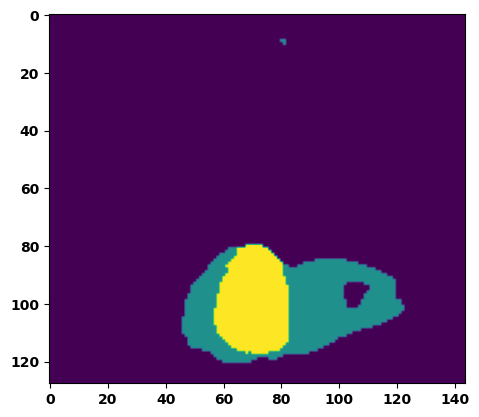

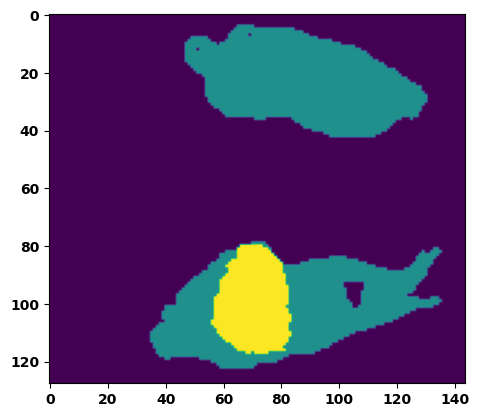

  6%|▌         | 2/36 [00:03<00:53,  1.57s/it]

Batch_id:  1 Eval loss:  0.2574187219142914
Batch_id:  1 Eval IoU:  tensor(0.6500, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9921, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.50s/it]

Batch_id:  2 Eval loss:  0.0827171802520752
Batch_id:  2 Eval IoU:  tensor(0.8560, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 11%|█         | 4/36 [00:06<00:48,  1.51s/it]

Batch_id:  3 Eval loss:  0.39620664715766907
Batch_id:  3 Eval IoU:  tensor(0.5317, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.47s/it]

Batch_id:  4 Eval loss:  0.07939513027667999
Batch_id:  4 Eval IoU:  tensor(0.8669, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9866, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:45,  1.50s/it]

Batch_id:  5 Eval loss:  0.12487360835075378
Batch_id:  5 Eval IoU:  tensor(0.8044, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9446, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.47s/it]

Batch_id:  6 Eval loss:  0.5967555046081543
Batch_id:  6 Eval IoU:  tensor(0.3547, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:41,  1.49s/it]

Batch_id:  7 Eval loss:  0.27900758385658264
Batch_id:  7 Eval IoU:  tensor(0.6527, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9975, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:40,  1.50s/it]

Batch_id:  8 Eval loss:  0.39264166355133057
Batch_id:  8 Eval IoU:  tensor(0.5321, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.47s/it]

Batch_id:  9 Eval loss:  0.08124090731143951
Batch_id:  9 Eval IoU:  tensor(0.8592, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  10 Eval loss:  0.1037905365228653
Batch_id:  10 Eval IoU:  tensor(0.8242, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


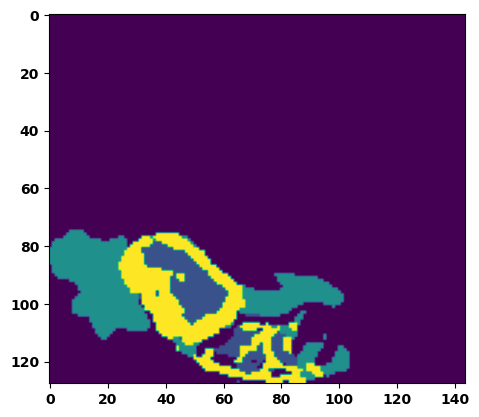

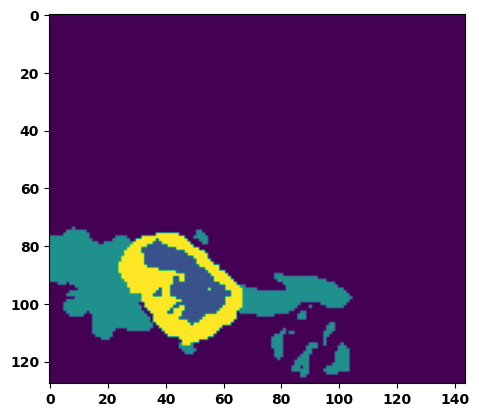

 33%|███▎      | 12/36 [00:18<00:36,  1.51s/it]

Batch_id:  11 Eval loss:  0.06245549023151398
Batch_id:  11 Eval IoU:  tensor(0.9009, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.50s/it]

Batch_id:  12 Eval loss:  0.2542369067668915
Batch_id:  12 Eval IoU:  tensor(0.7006, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:33,  1.53s/it]

Batch_id:  13 Eval loss:  0.19314008951187134
Batch_id:  13 Eval IoU:  tensor(0.7188, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:30,  1.45s/it]

Batch_id:  14 Eval loss:  0.17675276100635529
Batch_id:  14 Eval IoU:  tensor(0.7296, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.45s/it]

Batch_id:  15 Eval loss:  0.49218806624412537
Batch_id:  15 Eval IoU:  tensor(0.4091, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9382, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9317, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9980, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:26,  1.41s/it]

Batch_id:  16 Eval loss:  0.0770532488822937
Batch_id:  16 Eval IoU:  tensor(0.8826, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.45s/it]

Batch_id:  17 Eval loss:  0.05907292664051056
Batch_id:  17 Eval IoU:  tensor(0.8986, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:23,  1.40s/it]

Batch_id:  18 Eval loss:  0.14559154212474823
Batch_id:  18 Eval IoU:  tensor(0.7834, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:23,  1.45s/it]

Batch_id:  19 Eval loss:  0.10212461650371552
Batch_id:  19 Eval IoU:  tensor(0.8249, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  20 Eval loss:  0.19669300317764282
Batch_id:  20 Eval IoU:  tensor(0.7080, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9928, device='cuda:0')


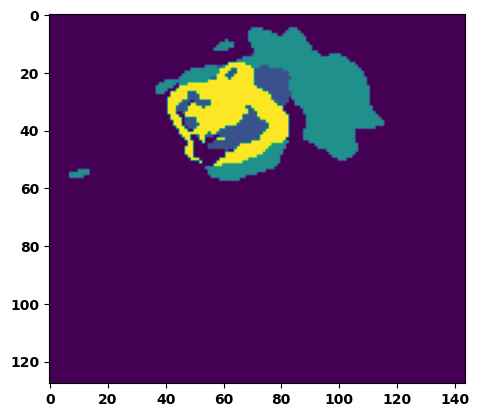

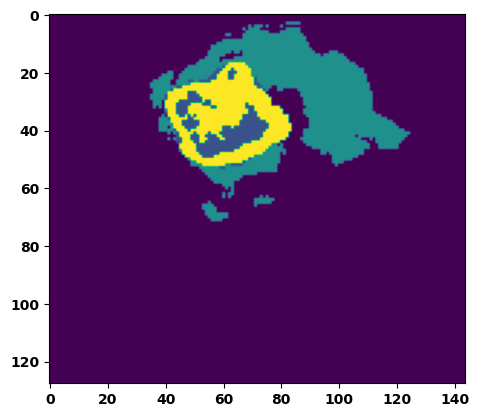

 61%|██████    | 22/36 [00:32<00:20,  1.50s/it]

Batch_id:  21 Eval loss:  0.3896024227142334
Batch_id:  21 Eval IoU:  tensor(0.4953, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9266, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9207, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:18,  1.45s/it]

Batch_id:  22 Eval loss:  0.7199926376342773
Batch_id:  22 Eval IoU:  tensor(0.2539, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9508, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9320, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9974, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.48s/it]

Batch_id:  23 Eval loss:  0.1996172070503235
Batch_id:  23 Eval IoU:  tensor(0.6975, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.44s/it]

Batch_id:  24 Eval loss:  0.14298899471759796
Batch_id:  24 Eval IoU:  tensor(0.7657, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9856, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.44s/it]

Batch_id:  25 Eval loss:  0.1579699069261551
Batch_id:  25 Eval IoU:  tensor(0.7517, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:12,  1.41s/it]

Batch_id:  26 Eval loss:  0.09183444082736969
Batch_id:  26 Eval IoU:  tensor(0.8474, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.38s/it]

Batch_id:  27 Eval loss:  0.08211426436901093
Batch_id:  27 Eval IoU:  tensor(0.8615, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:09,  1.42s/it]

Batch_id:  28 Eval loss:  0.10457725822925568
Batch_id:  28 Eval IoU:  tensor(0.8556, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9954, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.40s/it]

Batch_id:  29 Eval loss:  0.2746800184249878
Batch_id:  29 Eval IoU:  tensor(0.6239, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9441, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  30 Eval loss:  0.2367631047964096
Batch_id:  30 Eval IoU:  tensor(0.6655, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


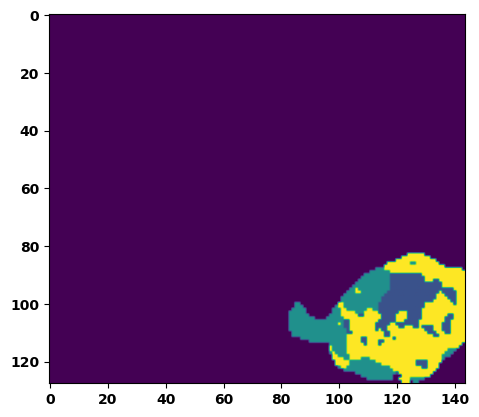

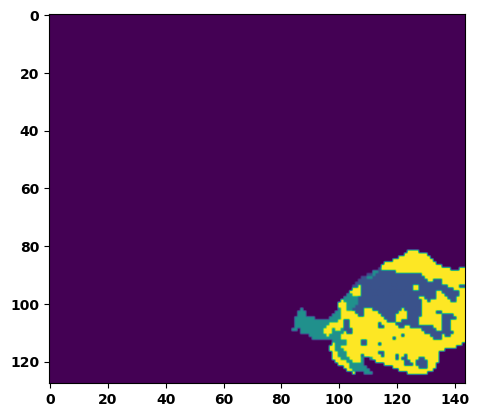

 89%|████████▉ | 32/36 [00:47<00:05,  1.49s/it]

Batch_id:  31 Eval loss:  0.2084479033946991
Batch_id:  31 Eval IoU:  tensor(0.6768, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9812, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.45s/it]

Batch_id:  32 Eval loss:  0.22809568047523499
Batch_id:  32 Eval IoU:  tensor(0.6757, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9812, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.42s/it]

Batch_id:  33 Eval loss:  0.18773776292800903
Batch_id:  33 Eval IoU:  tensor(0.7232, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.43s/it]

Batch_id:  34 Eval loss:  0.06935054063796997
Batch_id:  34 Eval IoU:  tensor(0.8811, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.46s/it]

Batch_id:  35 Eval loss:  0.27463579177856445
Batch_id:  35 Eval IoU:  tensor(0.6270, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9928, device='cuda:0')
Epoch 00037: reducing learning rate of group 0 to 1.5625e-05.
Epoch  36 Training loss:  0.16730344078757547
Epoch  36 Evaluation loss:  0.22016879502269956
Epoch  36 Training accuracy :  tensor(0.7614)
Epoch  36 Evaluation accuracy :  tensor(0.7061)
Epoch  36 Training Mean Dice Score:  tensor(0.9810)
Epoch  36 Eval Mean Dice Score:  tensor(0.9737)
Epoch  36 Training Non-tumor Dice Score:  tensor(0.9824)
Epoch  36 Eval Non-tumor Dice Score:  tensor(0.9728)
Epoch  36 Training NCR/NET Dice Score:  tensor(0.9913)
Epoch  36 Eval NCR/NET Dice Score

Epoch: 37
Training in session: 


  1%|          | 1/110 [00:01<02:26,  1.35s/it]

Batch_id:  0 Training loss:  0.10458624362945557
Batch_id:  0 Training IoU:  tensor(0.8230, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:33,  1.43s/it]

Batch_id:  1 Training loss:  0.23273861408233643
Batch_id:  1 Training IoU:  tensor(0.6536, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:31,  1.42s/it]

Batch_id:  2 Training loss:  0.27453553676605225
Batch_id:  2 Training IoU:  tensor(0.6685, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:29,  1.41s/it]

Batch_id:  3 Training loss:  0.5259453058242798
Batch_id:  3 Training IoU:  tensor(0.4215, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:30,  1.43s/it]

Batch_id:  4 Training loss:  0.19589459896087646
Batch_id:  4 Training IoU:  tensor(0.7037, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:34,  1.48s/it]

Batch_id:  5 Training loss:  0.1769961267709732
Batch_id:  5 Training IoU:  tensor(0.8114, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:31,  1.47s/it]

Batch_id:  6 Training loss:  0.14297476410865784
Batch_id:  6 Training IoU:  tensor(0.7687, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:23,  1.41s/it]

Batch_id:  7 Training loss:  0.06829200685024261
Batch_id:  7 Training IoU:  tensor(0.8811, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


  8%|▊         | 9/110 [00:12<02:24,  1.43s/it]

Batch_id:  8 Training loss:  0.0858619213104248
Batch_id:  8 Training IoU:  tensor(0.8528, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:25,  1.46s/it]

Batch_id:  9 Training loss:  0.210954487323761
Batch_id:  9 Training IoU:  tensor(0.6913, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9781, device='cuda:0')


 10%|█         | 11/110 [00:15<02:26,  1.48s/it]

Batch_id:  10 Training loss:  0.10167403519153595
Batch_id:  10 Training IoU:  tensor(0.8309, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 11%|█         | 12/110 [00:17<02:26,  1.49s/it]

Batch_id:  11 Training loss:  0.3447920083999634
Batch_id:  11 Training IoU:  tensor(0.6299, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:23,  1.48s/it]

Batch_id:  12 Training loss:  0.21243275701999664
Batch_id:  12 Training IoU:  tensor(0.7153, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:18,  1.44s/it]

Batch_id:  13 Training loss:  0.3967609107494354
Batch_id:  13 Training IoU:  tensor(0.5090, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9251, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:21,  1.49s/it]

Batch_id:  14 Training loss:  0.20187649130821228
Batch_id:  14 Training IoU:  tensor(0.6961, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:18,  1.47s/it]

Batch_id:  15 Training loss:  0.04507538676261902
Batch_id:  15 Training IoU:  tensor(0.9218, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:14,  1.44s/it]

Batch_id:  16 Training loss:  0.2180197387933731
Batch_id:  16 Training IoU:  tensor(0.7328, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:13,  1.45s/it]

Batch_id:  17 Training loss:  0.1238519698381424
Batch_id:  17 Training IoU:  tensor(0.8042, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:13,  1.46s/it]

Batch_id:  18 Training loss:  0.2711944580078125
Batch_id:  18 Training IoU:  tensor(0.6423, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:16,  1.52s/it]

Batch_id:  19 Training loss:  0.1315740942955017
Batch_id:  19 Training IoU:  tensor(0.8019, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:14,  1.51s/it]

Batch_id:  20 Training loss:  0.08890087902545929
Batch_id:  20 Training IoU:  tensor(0.8542, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 20%|██        | 22/110 [00:32<02:06,  1.44s/it]

Batch_id:  21 Training loss:  0.10919061303138733
Batch_id:  21 Training IoU:  tensor(0.8200, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 21%|██        | 23/110 [00:33<02:04,  1.43s/it]

Batch_id:  22 Training loss:  0.11820846796035767
Batch_id:  22 Training IoU:  tensor(0.8048, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:02,  1.43s/it]

Batch_id:  23 Training loss:  0.2087167203426361
Batch_id:  23 Training IoU:  tensor(0.6864, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:00,  1.42s/it]

Batch_id:  24 Training loss:  0.22560133039951324
Batch_id:  24 Training IoU:  tensor(0.6758, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:01,  1.44s/it]

Batch_id:  25 Training loss:  0.0854463130235672
Batch_id:  25 Training IoU:  tensor(0.8526, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:02,  1.48s/it]

Batch_id:  26 Training loss:  0.04635590314865112
Batch_id:  26 Training IoU:  tensor(0.9192, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 25%|██▌       | 28/110 [00:40<02:02,  1.49s/it]

Batch_id:  27 Training loss:  0.05778636038303375
Batch_id:  27 Training IoU:  tensor(0.9011, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 26%|██▋       | 29/110 [00:42<02:02,  1.51s/it]

Batch_id:  28 Training loss:  0.11047467589378357
Batch_id:  28 Training IoU:  tensor(0.8227, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:59,  1.50s/it]

Batch_id:  29 Training loss:  0.2548620104789734
Batch_id:  29 Training IoU:  tensor(0.6972, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:54,  1.45s/it]

Batch_id:  30 Training loss:  0.3290746808052063
Batch_id:  30 Training IoU:  tensor(0.6077, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:52,  1.44s/it]

Batch_id:  31 Training loss:  0.15914331376552582
Batch_id:  31 Training IoU:  tensor(0.7636, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 30%|███       | 33/110 [00:48<01:49,  1.42s/it]

Batch_id:  32 Training loss:  0.15817804634571075
Batch_id:  32 Training IoU:  tensor(0.7491, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9711, device='cuda:0')


 31%|███       | 34/110 [00:49<01:47,  1.41s/it]

Batch_id:  33 Training loss:  0.09544815123081207
Batch_id:  33 Training IoU:  tensor(0.8376, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:46,  1.42s/it]

Batch_id:  34 Training loss:  0.2047165483236313
Batch_id:  34 Training IoU:  tensor(0.6874, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9399, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9425, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9240, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:48,  1.46s/it]

Batch_id:  35 Training loss:  0.1592554748058319
Batch_id:  35 Training IoU:  tensor(0.8085, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:46,  1.45s/it]

Batch_id:  36 Training loss:  0.12315216660499573
Batch_id:  36 Training IoU:  tensor(0.8028, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:45,  1.46s/it]

Batch_id:  37 Training loss:  0.24105702340602875
Batch_id:  37 Training IoU:  tensor(0.6453, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9378, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9509, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9340, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9765, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:45,  1.48s/it]

Batch_id:  38 Training loss:  0.15202054381370544
Batch_id:  38 Training IoU:  tensor(0.7544, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9863, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:41,  1.46s/it]

Batch_id:  39 Training loss:  0.32938307523727417
Batch_id:  39 Training IoU:  tensor(0.6152, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:41,  1.47s/it]

Batch_id:  40 Training loss:  0.17971065640449524
Batch_id:  40 Training IoU:  tensor(0.7156, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:41,  1.49s/it]

Batch_id:  41 Training loss:  0.0908021330833435
Batch_id:  41 Training IoU:  tensor(0.8442, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:39,  1.49s/it]

Batch_id:  42 Training loss:  0.09093828499317169
Batch_id:  42 Training IoU:  tensor(0.8467, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 40%|████      | 44/110 [01:04<01:37,  1.48s/it]

Batch_id:  43 Training loss:  0.191579669713974
Batch_id:  43 Training IoU:  tensor(0.7074, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9734, device='cuda:0')


 41%|████      | 45/110 [01:05<01:33,  1.44s/it]

Batch_id:  44 Training loss:  0.17862606048583984
Batch_id:  44 Training IoU:  tensor(0.7342, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:34,  1.47s/it]

Batch_id:  45 Training loss:  0.08308568596839905
Batch_id:  45 Training IoU:  tensor(0.8619, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:33,  1.48s/it]

Batch_id:  46 Training loss:  0.16185800731182098
Batch_id:  46 Training IoU:  tensor(0.7857, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 44%|████▎     | 48/110 [01:10<01:33,  1.50s/it]

Batch_id:  47 Training loss:  0.1632886677980423
Batch_id:  47 Training IoU:  tensor(0.7448, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9784, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:32,  1.51s/it]

Batch_id:  48 Training loss:  0.15337076783180237
Batch_id:  48 Training IoU:  tensor(0.7830, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 45%|████▌     | 50/110 [01:13<01:29,  1.49s/it]

Batch_id:  49 Training loss:  0.14895400404930115
Batch_id:  49 Training IoU:  tensor(0.7593, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:30,  1.53s/it]

Batch_id:  50 Training loss:  0.10658681392669678
Batch_id:  50 Training IoU:  tensor(0.8378, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 47%|████▋     | 52/110 [01:16<01:25,  1.47s/it]

Batch_id:  51 Training loss:  0.3539602756500244
Batch_id:  51 Training IoU:  tensor(0.5829, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:22,  1.44s/it]

Batch_id:  52 Training loss:  0.37870466709136963
Batch_id:  52 Training IoU:  tensor(0.5424, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:19,  1.42s/it]

Batch_id:  53 Training loss:  0.2477991133928299
Batch_id:  53 Training IoU:  tensor(0.6349, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9766, device='cuda:0')


 50%|█████     | 55/110 [01:20<01:18,  1.44s/it]

Batch_id:  54 Training loss:  0.11445656418800354
Batch_id:  54 Training IoU:  tensor(0.8116, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9770, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:18,  1.45s/it]

Batch_id:  55 Training loss:  0.07445742189884186
Batch_id:  55 Training IoU:  tensor(0.8712, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:16,  1.44s/it]

Batch_id:  56 Training loss:  0.14995022118091583
Batch_id:  56 Training IoU:  tensor(0.7659, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:13,  1.40s/it]

Batch_id:  57 Training loss:  0.18048377335071564
Batch_id:  57 Training IoU:  tensor(0.7232, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 54%|█████▎    | 59/110 [01:25<01:12,  1.43s/it]

Batch_id:  58 Training loss:  0.13899275660514832
Batch_id:  58 Training IoU:  tensor(0.7997, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 55%|█████▍    | 60/110 [01:27<01:10,  1.41s/it]

Batch_id:  59 Training loss:  0.09856286644935608
Batch_id:  59 Training IoU:  tensor(0.8350, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:10,  1.43s/it]

Batch_id:  60 Training loss:  0.0511128306388855
Batch_id:  60 Training IoU:  tensor(0.9173, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 56%|█████▋    | 62/110 [01:30<01:12,  1.50s/it]

Batch_id:  61 Training loss:  0.0920129269361496
Batch_id:  61 Training IoU:  tensor(0.8448, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:09,  1.47s/it]

Batch_id:  62 Training loss:  0.12588439881801605
Batch_id:  62 Training IoU:  tensor(0.7985, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 58%|█████▊    | 64/110 [01:33<01:06,  1.45s/it]

Batch_id:  63 Training loss:  0.09411300718784332
Batch_id:  63 Training IoU:  tensor(0.8475, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:05,  1.46s/it]

Batch_id:  64 Training loss:  0.14112843573093414
Batch_id:  64 Training IoU:  tensor(0.7825, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:04,  1.46s/it]

Batch_id:  65 Training loss:  0.26732853055000305
Batch_id:  65 Training IoU:  tensor(0.6851, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 61%|██████    | 67/110 [01:37<01:04,  1.50s/it]

Batch_id:  66 Training loss:  0.13048632442951202
Batch_id:  66 Training IoU:  tensor(0.8100, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 62%|██████▏   | 68/110 [01:39<01:02,  1.49s/it]

Batch_id:  67 Training loss:  0.08546343445777893
Batch_id:  67 Training IoU:  tensor(0.8799, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<01:00,  1.47s/it]

Batch_id:  68 Training loss:  0.06578679382801056
Batch_id:  68 Training IoU:  tensor(0.8899, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 64%|██████▎   | 70/110 [01:42<00:59,  1.50s/it]

Batch_id:  69 Training loss:  0.32403630018234253
Batch_id:  69 Training IoU:  tensor(0.6432, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 65%|██████▍   | 71/110 [01:43<00:58,  1.50s/it]

Batch_id:  70 Training loss:  0.24672898650169373
Batch_id:  70 Training IoU:  tensor(0.6860, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 65%|██████▌   | 72/110 [01:45<00:55,  1.46s/it]

Batch_id:  71 Training loss:  0.26183581352233887
Batch_id:  71 Training IoU:  tensor(0.6379, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 66%|██████▋   | 73/110 [01:46<00:53,  1.45s/it]

Batch_id:  72 Training loss:  0.13914740085601807
Batch_id:  72 Training IoU:  tensor(0.7676, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9745, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:52,  1.46s/it]

Batch_id:  73 Training loss:  0.08602149784564972
Batch_id:  73 Training IoU:  tensor(0.8644, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 68%|██████▊   | 75/110 [01:49<00:51,  1.48s/it]

Batch_id:  74 Training loss:  0.09285050630569458
Batch_id:  74 Training IoU:  tensor(0.8421, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 69%|██████▉   | 76/110 [01:51<00:50,  1.48s/it]

Batch_id:  75 Training loss:  0.20871078968048096
Batch_id:  75 Training IoU:  tensor(0.6909, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 70%|███████   | 77/110 [01:52<00:50,  1.53s/it]

Batch_id:  76 Training loss:  0.10962492227554321
Batch_id:  76 Training IoU:  tensor(0.8171, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:48,  1.50s/it]

Batch_id:  77 Training loss:  0.11279508471488953
Batch_id:  77 Training IoU:  tensor(0.8110, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 72%|███████▏  | 79/110 [01:55<00:46,  1.51s/it]

Batch_id:  78 Training loss:  0.15945594012737274
Batch_id:  78 Training IoU:  tensor(0.7455, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:46,  1.53s/it]

Batch_id:  79 Training loss:  0.14691554009914398
Batch_id:  79 Training IoU:  tensor(0.7626, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 74%|███████▎  | 81/110 [01:58<00:43,  1.52s/it]

Batch_id:  80 Training loss:  0.13215956091880798
Batch_id:  80 Training IoU:  tensor(0.7910, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:42,  1.52s/it]

Batch_id:  81 Training loss:  0.1416274458169937
Batch_id:  81 Training IoU:  tensor(0.8109, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:41,  1.53s/it]

Batch_id:  82 Training loss:  0.2100842446088791
Batch_id:  82 Training IoU:  tensor(0.6889, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:40,  1.54s/it]

Batch_id:  83 Training loss:  0.14058303833007812
Batch_id:  83 Training IoU:  tensor(0.7930, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:38,  1.55s/it]

Batch_id:  84 Training loss:  0.17317400872707367
Batch_id:  84 Training IoU:  tensor(0.7219, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:37,  1.56s/it]

Batch_id:  85 Training loss:  0.21955808997154236
Batch_id:  85 Training IoU:  tensor(0.7291, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 79%|███████▉  | 87/110 [02:08<00:35,  1.55s/it]

Batch_id:  86 Training loss:  0.05566376447677612
Batch_id:  86 Training IoU:  tensor(0.9065, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 80%|████████  | 88/110 [02:09<00:33,  1.54s/it]

Batch_id:  87 Training loss:  0.10840636491775513
Batch_id:  87 Training IoU:  tensor(0.8272, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 81%|████████  | 89/110 [02:11<00:32,  1.55s/it]

Batch_id:  88 Training loss:  0.12473183870315552
Batch_id:  88 Training IoU:  tensor(0.8133, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 82%|████████▏ | 90/110 [02:12<00:30,  1.53s/it]

Batch_id:  89 Training loss:  0.1580958068370819
Batch_id:  89 Training IoU:  tensor(0.7420, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9629, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 83%|████████▎ | 91/110 [02:14<00:28,  1.53s/it]

Batch_id:  90 Training loss:  0.17379304766654968
Batch_id:  90 Training IoU:  tensor(0.7406, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 84%|████████▎ | 92/110 [02:15<00:28,  1.56s/it]

Batch_id:  91 Training loss:  0.16602790355682373
Batch_id:  91 Training IoU:  tensor(0.8073, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 85%|████████▍ | 93/110 [02:17<00:25,  1.52s/it]

Batch_id:  92 Training loss:  0.2512087821960449
Batch_id:  92 Training IoU:  tensor(0.6449, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9613, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 85%|████████▌ | 94/110 [02:18<00:23,  1.47s/it]

Batch_id:  93 Training loss:  0.11722171306610107
Batch_id:  93 Training IoU:  tensor(0.8144, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 86%|████████▋ | 95/110 [02:20<00:22,  1.52s/it]

Batch_id:  94 Training loss:  0.05908966064453125
Batch_id:  94 Training IoU:  tensor(0.8982, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 87%|████████▋ | 96/110 [02:21<00:20,  1.46s/it]

Batch_id:  95 Training loss:  0.26540887355804443
Batch_id:  95 Training IoU:  tensor(0.6261, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9287, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 88%|████████▊ | 97/110 [02:23<00:18,  1.46s/it]

Batch_id:  96 Training loss:  0.2708094120025635
Batch_id:  96 Training IoU:  tensor(0.6330, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9576, device='cuda:0')


 89%|████████▉ | 98/110 [02:24<00:17,  1.47s/it]

Batch_id:  97 Training loss:  0.08858120441436768
Batch_id:  97 Training IoU:  tensor(0.8478, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 90%|█████████ | 99/110 [02:26<00:16,  1.49s/it]

Batch_id:  98 Training loss:  0.08784507215023041
Batch_id:  98 Training IoU:  tensor(0.8549, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 91%|█████████ | 100/110 [02:27<00:14,  1.49s/it]

Batch_id:  99 Training loss:  0.18301761150360107
Batch_id:  99 Training IoU:  tensor(0.7193, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 92%|█████████▏| 101/110 [02:29<00:13,  1.50s/it]

Batch_id:  100 Training loss:  0.09708006680011749
Batch_id:  100 Training IoU:  tensor(0.8381, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 93%|█████████▎| 102/110 [02:30<00:12,  1.52s/it]

Batch_id:  101 Training loss:  0.07755285501480103
Batch_id:  101 Training IoU:  tensor(0.8827, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 94%|█████████▎| 103/110 [02:32<00:10,  1.52s/it]

Batch_id:  102 Training loss:  0.13075093924999237
Batch_id:  102 Training IoU:  tensor(0.7862, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 95%|█████████▍| 104/110 [02:33<00:09,  1.53s/it]

Batch_id:  103 Training loss:  0.0927353948354721
Batch_id:  103 Training IoU:  tensor(0.8387, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 95%|█████████▌| 105/110 [02:35<00:07,  1.52s/it]

Batch_id:  104 Training loss:  0.09071443974971771
Batch_id:  104 Training IoU:  tensor(0.8456, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 96%|█████████▋| 106/110 [02:36<00:06,  1.54s/it]

Batch_id:  105 Training loss:  0.041747286915779114
Batch_id:  105 Training IoU:  tensor(0.9282, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 97%|█████████▋| 107/110 [02:38<00:04,  1.54s/it]

Batch_id:  106 Training loss:  0.13019117712974548
Batch_id:  106 Training IoU:  tensor(0.8019, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 98%|█████████▊| 108/110 [02:39<00:03,  1.55s/it]

Batch_id:  107 Training loss:  0.4673064947128296
Batch_id:  107 Training IoU:  tensor(0.4562, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9635, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 99%|█████████▉| 109/110 [02:41<00:01,  1.54s/it]

Batch_id:  108 Training loss:  0.19030804932117462
Batch_id:  108 Training IoU:  tensor(0.7200, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


100%|██████████| 110/110 [02:42<00:00,  1.48s/it]


Batch_id:  109 Training loss:  0.25173234939575195
Batch_id:  109 Training IoU:  tensor(0.6488, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9952, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.1429867148399353
Batch_id:  0 Eval IoU:  tensor(0.7860, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


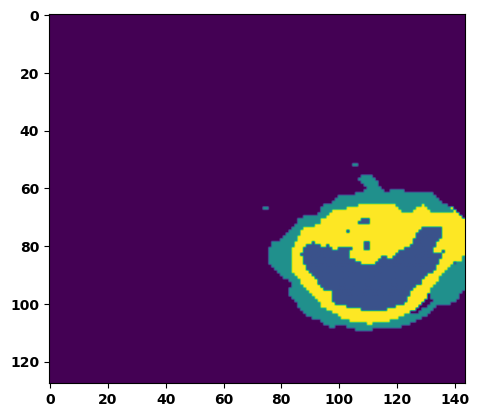

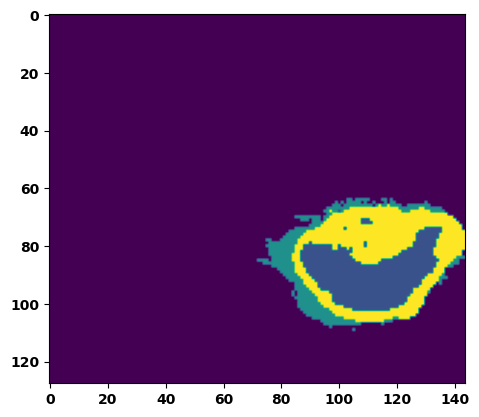

  6%|▌         | 2/36 [00:02<00:46,  1.36s/it]

Batch_id:  1 Eval loss:  0.06136627495288849
Batch_id:  1 Eval IoU:  tensor(0.9019, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:48,  1.47s/it]

Batch_id:  2 Eval loss:  0.23912763595581055
Batch_id:  2 Eval IoU:  tensor(0.6626, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 11%|█         | 4/36 [00:05<00:44,  1.39s/it]

Batch_id:  3 Eval loss:  0.25713470578193665
Batch_id:  3 Eval IoU:  tensor(0.6962, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:44,  1.43s/it]

Batch_id:  4 Eval loss:  0.4051802456378937
Batch_id:  4 Eval IoU:  tensor(0.5295, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9060, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.8601, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.8595, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:42,  1.40s/it]

Batch_id:  5 Eval loss:  0.08580192923545837
Batch_id:  5 Eval IoU:  tensor(0.8511, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 19%|█▉        | 7/36 [00:09<00:40,  1.38s/it]

Batch_id:  6 Eval loss:  0.28984731435775757
Batch_id:  6 Eval IoU:  tensor(0.6082, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9557, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9419, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9911, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.44s/it]

Batch_id:  7 Eval loss:  0.25784415006637573
Batch_id:  7 Eval IoU:  tensor(0.6498, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9459, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 25%|██▌       | 9/36 [00:12<00:38,  1.42s/it]

Batch_id:  8 Eval loss:  0.08093239367008209
Batch_id:  8 Eval IoU:  tensor(0.8594, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:36,  1.39s/it]

Batch_id:  9 Eval loss:  0.15414001047611237
Batch_id:  9 Eval IoU:  tensor(0.7560, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  10 Eval loss:  0.10182954370975494
Batch_id:  10 Eval IoU:  tensor(0.8253, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9896, device='cuda:0')


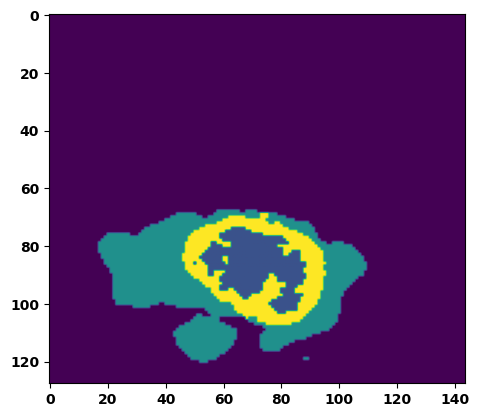

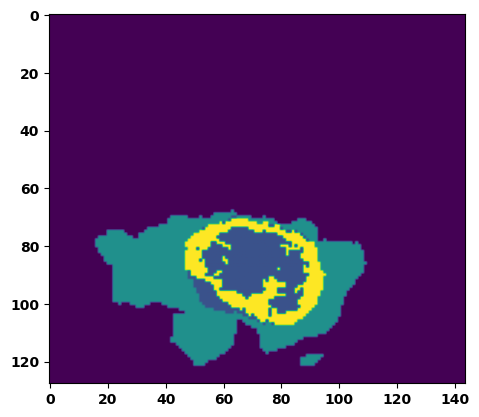

 33%|███▎      | 12/36 [00:16<00:32,  1.37s/it]

Batch_id:  11 Eval loss:  0.7195889949798584
Batch_id:  11 Eval IoU:  tensor(0.2543, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9513, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9329, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9442, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9974, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:30,  1.33s/it]

Batch_id:  12 Eval loss:  0.501666784286499
Batch_id:  12 Eval IoU:  tensor(0.4050, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9426, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9302, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9381, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 39%|███▉      | 14/36 [00:19<00:29,  1.35s/it]

Batch_id:  13 Eval loss:  0.21028488874435425
Batch_id:  13 Eval IoU:  tensor(0.6746, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9543, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9814, device='cuda:0')


 42%|████▏     | 15/36 [00:20<00:29,  1.39s/it]

Batch_id:  14 Eval loss:  0.09682609140872955
Batch_id:  14 Eval IoU:  tensor(0.8689, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


 44%|████▍     | 16/36 [00:22<00:28,  1.40s/it]

Batch_id:  15 Eval loss:  0.5965640544891357
Batch_id:  15 Eval IoU:  tensor(0.3553, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 47%|████▋     | 17/36 [00:23<00:26,  1.41s/it]

Batch_id:  16 Eval loss:  0.19168059527873993
Batch_id:  16 Eval IoU:  tensor(0.7194, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


 50%|█████     | 18/36 [00:25<00:25,  1.40s/it]

Batch_id:  17 Eval loss:  0.05899474024772644
Batch_id:  17 Eval IoU:  tensor(0.8989, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 53%|█████▎    | 19/36 [00:26<00:24,  1.43s/it]

Batch_id:  18 Eval loss:  0.3919225037097931
Batch_id:  18 Eval IoU:  tensor(0.5371, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9978, device='cuda:0')


 56%|█████▌    | 20/36 [00:27<00:22,  1.38s/it]

Batch_id:  19 Eval loss:  0.3943551480770111
Batch_id:  19 Eval IoU:  tensor(0.5317, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  20 Eval loss:  0.17870837450027466
Batch_id:  20 Eval IoU:  tensor(0.7265, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


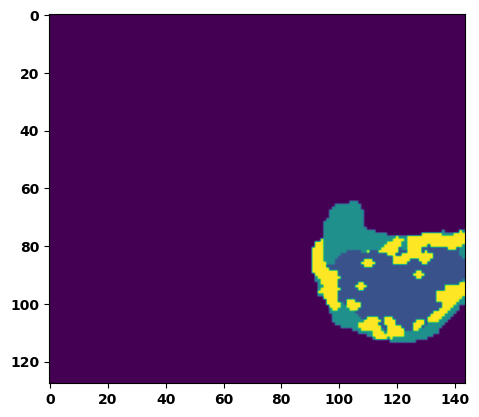

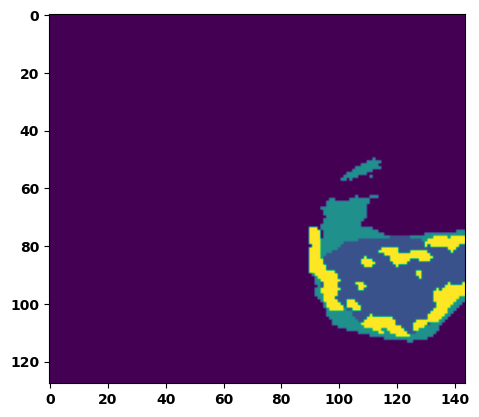

 61%|██████    | 22/36 [00:30<00:18,  1.34s/it]

Batch_id:  21 Eval loss:  0.07515047490596771
Batch_id:  21 Eval IoU:  tensor(0.8855, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 64%|██████▍   | 23/36 [00:31<00:17,  1.32s/it]

Batch_id:  22 Eval loss:  0.09093056619167328
Batch_id:  22 Eval IoU:  tensor(0.8486, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


 67%|██████▋   | 24/36 [00:33<00:15,  1.29s/it]

Batch_id:  23 Eval loss:  0.12824663519859314
Batch_id:  23 Eval IoU:  tensor(0.8007, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9457, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')


 69%|██████▉   | 25/36 [00:34<00:14,  1.32s/it]

Batch_id:  24 Eval loss:  0.28858813643455505
Batch_id:  24 Eval IoU:  tensor(0.6460, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9975, device='cuda:0')


 72%|███████▏  | 26/36 [00:35<00:13,  1.30s/it]

Batch_id:  25 Eval loss:  0.1447194516658783
Batch_id:  25 Eval IoU:  tensor(0.7646, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9855, device='cuda:0')


 75%|███████▌  | 27/36 [00:37<00:12,  1.37s/it]

Batch_id:  26 Eval loss:  0.1980259269475937
Batch_id:  26 Eval IoU:  tensor(0.6998, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


 78%|███████▊  | 28/36 [00:38<00:10,  1.37s/it]

Batch_id:  27 Eval loss:  0.1951378732919693
Batch_id:  27 Eval IoU:  tensor(0.7096, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


 81%|████████  | 29/36 [00:39<00:09,  1.35s/it]

Batch_id:  28 Eval loss:  0.07851825654506683
Batch_id:  28 Eval IoU:  tensor(0.8682, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


 83%|████████▎ | 30/36 [00:41<00:07,  1.31s/it]

Batch_id:  29 Eval loss:  0.28118371963500977
Batch_id:  29 Eval IoU:  tensor(0.6204, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  30 Eval loss:  0.06869861483573914
Batch_id:  30 Eval IoU:  tensor(0.8819, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


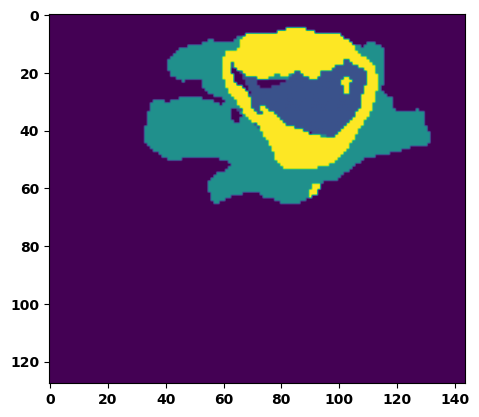

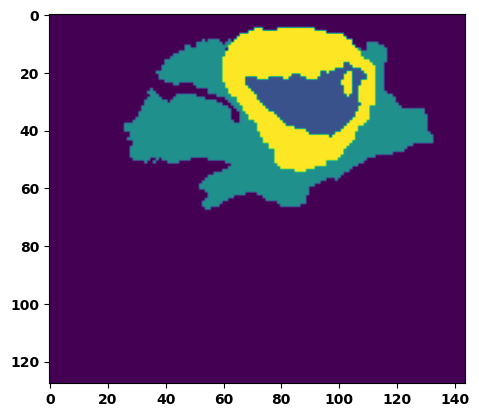

 89%|████████▉ | 32/36 [00:43<00:05,  1.36s/it]

Batch_id:  31 Eval loss:  0.18949906527996063
Batch_id:  31 Eval IoU:  tensor(0.7212, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 92%|█████████▏| 33/36 [00:45<00:04,  1.34s/it]

Batch_id:  32 Eval loss:  0.39452433586120605
Batch_id:  32 Eval IoU:  tensor(0.4916, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9258, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9196, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9895, device='cuda:0')


 94%|█████████▍| 34/36 [00:46<00:02,  1.31s/it]

Batch_id:  33 Eval loss:  0.10364358127117157
Batch_id:  33 Eval IoU:  tensor(0.8242, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 97%|█████████▋| 35/36 [00:47<00:01,  1.32s/it]

Batch_id:  34 Eval loss:  0.2296868860721588
Batch_id:  34 Eval IoU:  tensor(0.6734, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9810, device='cuda:0')


100%|██████████| 36/36 [00:49<00:00,  1.36s/it]

Batch_id:  35 Eval loss:  0.08058221638202667
Batch_id:  35 Eval IoU:  tensor(0.8629, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')
Epoch  37 Training loss:  0.16588925570249557
Epoch  37 Evaluation loss:  0.22121996763679716
Epoch  37 Training accuracy :  tensor(0.7630)
Epoch  37 Evaluation accuracy :  tensor(0.7054)
Epoch  37 Training Mean Dice Score:  tensor(0.9812)
Epoch  37 Eval Mean Dice Score:  tensor(0.9736)
Epoch  37 Training Non-tumor Dice Score:  tensor(0.9827)
Epoch  37 Eval Non-tumor Dice Score:  tensor(0.9727)
Epoch  37 Training NCR/NET Dice Score:  tensor(0.9914)
Epoch  37 Eval NCR/NET Dice Score:  tensor(0.9873)
Epoch  37 Training ED Dice Score:  tensor(0.

Epoch: 38
Training in session: 


  1%|          | 1/110 [00:01<02:34,  1.41s/it]

Batch_id:  0 Training loss:  0.38159626722335815
Batch_id:  0 Training IoU:  tensor(0.5385, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:28,  1.38s/it]

Batch_id:  1 Training loss:  0.2628532648086548
Batch_id:  1 Training IoU:  tensor(0.6907, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:28,  1.38s/it]

Batch_id:  2 Training loss:  0.12470777332782745
Batch_id:  2 Training IoU:  tensor(0.8133, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:37,  1.49s/it]

Batch_id:  3 Training loss:  0.2708721160888672
Batch_id:  3 Training IoU:  tensor(0.6330, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9577, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:37,  1.50s/it]

Batch_id:  4 Training loss:  0.1815113127231598
Batch_id:  4 Training IoU:  tensor(0.7212, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:31,  1.46s/it]

Batch_id:  5 Training loss:  0.32323789596557617
Batch_id:  5 Training IoU:  tensor(0.6140, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:30,  1.46s/it]

Batch_id:  6 Training loss:  0.17592570185661316
Batch_id:  6 Training IoU:  tensor(0.7210, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:26,  1.43s/it]

Batch_id:  7 Training loss:  0.25183364748954773
Batch_id:  7 Training IoU:  tensor(0.6504, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


  8%|▊         | 9/110 [00:12<02:21,  1.40s/it]

Batch_id:  8 Training loss:  0.09616784751415253
Batch_id:  8 Training IoU:  tensor(0.8398, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:27,  1.47s/it]

Batch_id:  9 Training loss:  0.1707567721605301
Batch_id:  9 Training IoU:  tensor(0.7249, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 10%|█         | 11/110 [00:15<02:26,  1.48s/it]

Batch_id:  10 Training loss:  0.1691511571407318
Batch_id:  10 Training IoU:  tensor(0.8337, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 11%|█         | 12/110 [00:17<02:24,  1.48s/it]

Batch_id:  11 Training loss:  0.0930122435092926
Batch_id:  11 Training IoU:  tensor(0.8379, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:26,  1.51s/it]

Batch_id:  12 Training loss:  0.06545494496822357
Batch_id:  12 Training IoU:  tensor(0.8910, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:29,  1.56s/it]

Batch_id:  13 Training loss:  0.0769466906785965
Batch_id:  13 Training IoU:  tensor(0.8832, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:26,  1.54s/it]

Batch_id:  14 Training loss:  0.10841427743434906
Batch_id:  14 Training IoU:  tensor(0.8258, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:19,  1.49s/it]

Batch_id:  15 Training loss:  0.349836140871048
Batch_id:  15 Training IoU:  tensor(0.5888, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:19,  1.50s/it]

Batch_id:  16 Training loss:  0.26598048210144043
Batch_id:  16 Training IoU:  tensor(0.6462, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:16,  1.49s/it]

Batch_id:  17 Training loss:  0.1404142826795578
Batch_id:  17 Training IoU:  tensor(0.7921, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:13,  1.47s/it]

Batch_id:  18 Training loss:  0.24758780002593994
Batch_id:  18 Training IoU:  tensor(0.6857, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:13,  1.48s/it]

Batch_id:  19 Training loss:  0.08613552153110504
Batch_id:  19 Training IoU:  tensor(0.8522, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:11,  1.47s/it]

Batch_id:  20 Training loss:  0.08525657653808594
Batch_id:  20 Training IoU:  tensor(0.8655, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 20%|██        | 22/110 [00:32<02:06,  1.44s/it]

Batch_id:  21 Training loss:  0.1304854303598404
Batch_id:  21 Training IoU:  tensor(0.7866, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 21%|██        | 23/110 [00:33<02:06,  1.45s/it]

Batch_id:  22 Training loss:  0.2202489972114563
Batch_id:  22 Training IoU:  tensor(0.7292, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:03,  1.44s/it]

Batch_id:  23 Training loss:  0.09359049797058105
Batch_id:  23 Training IoU:  tensor(0.8486, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:06,  1.49s/it]

Batch_id:  24 Training loss:  0.08976781368255615
Batch_id:  24 Training IoU:  tensor(0.8468, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:02,  1.46s/it]

Batch_id:  25 Training loss:  0.27805936336517334
Batch_id:  25 Training IoU:  tensor(0.6680, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:01,  1.47s/it]

Batch_id:  26 Training loss:  0.11478576064109802
Batch_id:  26 Training IoU:  tensor(0.8176, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 25%|██▌       | 28/110 [00:41<01:59,  1.45s/it]

Batch_id:  27 Training loss:  0.34876278042793274
Batch_id:  27 Training IoU:  tensor(0.6269, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:56,  1.43s/it]

Batch_id:  28 Training loss:  0.0942872017621994
Batch_id:  28 Training IoU:  tensor(0.8399, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:52,  1.41s/it]

Batch_id:  29 Training loss:  0.2534591555595398
Batch_id:  29 Training IoU:  tensor(0.6414, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:52,  1.42s/it]

Batch_id:  30 Training loss:  0.04200237989425659
Batch_id:  30 Training IoU:  tensor(0.9272, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:52,  1.44s/it]

Batch_id:  31 Training loss:  0.1080908477306366
Batch_id:  31 Training IoU:  tensor(0.8280, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9851, device='cuda:0')


 30%|███       | 33/110 [00:48<01:48,  1.42s/it]

Batch_id:  32 Training loss:  0.21099773049354553
Batch_id:  32 Training IoU:  tensor(0.6837, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 31%|███       | 34/110 [00:49<01:49,  1.44s/it]

Batch_id:  33 Training loss:  0.21029940247535706
Batch_id:  33 Training IoU:  tensor(0.6884, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 32%|███▏      | 35/110 [00:51<01:46,  1.42s/it]

Batch_id:  34 Training loss:  0.18917213380336761
Batch_id:  34 Training IoU:  tensor(0.7099, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9513, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9737, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:45,  1.42s/it]

Batch_id:  35 Training loss:  0.14940184354782104
Batch_id:  35 Training IoU:  tensor(0.7587, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:43,  1.41s/it]

Batch_id:  36 Training loss:  0.09685768187046051
Batch_id:  36 Training IoU:  tensor(0.8384, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:40,  1.40s/it]

Batch_id:  37 Training loss:  0.24331483244895935
Batch_id:  37 Training IoU:  tensor(0.7139, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:38,  1.39s/it]

Batch_id:  38 Training loss:  0.12336644530296326
Batch_id:  38 Training IoU:  tensor(0.8053, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 36%|███▋      | 40/110 [00:57<01:35,  1.37s/it]

Batch_id:  39 Training loss:  0.32862016558647156
Batch_id:  39 Training IoU:  tensor(0.6336, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:38,  1.43s/it]

Batch_id:  40 Training loss:  0.24528273940086365
Batch_id:  40 Training IoU:  tensor(0.6385, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9768, device='cuda:0')


 38%|███▊      | 42/110 [01:00<01:38,  1.45s/it]

Batch_id:  41 Training loss:  0.17754578590393066
Batch_id:  41 Training IoU:  tensor(0.7360, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:37,  1.45s/it]

Batch_id:  42 Training loss:  0.1590588539838791
Batch_id:  42 Training IoU:  tensor(0.7454, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 40%|████      | 44/110 [01:03<01:34,  1.42s/it]

Batch_id:  43 Training loss:  0.21634440124034882
Batch_id:  43 Training IoU:  tensor(0.6848, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 41%|████      | 45/110 [01:05<01:35,  1.46s/it]

Batch_id:  44 Training loss:  0.18237349390983582
Batch_id:  44 Training IoU:  tensor(0.7205, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:31,  1.43s/it]

Batch_id:  45 Training loss:  0.12159472703933716
Batch_id:  45 Training IoU:  tensor(0.7992, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:31,  1.46s/it]

Batch_id:  46 Training loss:  0.10156229138374329
Batch_id:  46 Training IoU:  tensor(0.8283, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:30,  1.45s/it]

Batch_id:  47 Training loss:  0.14372122287750244
Batch_id:  47 Training IoU:  tensor(0.7795, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9890, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:30,  1.48s/it]

Batch_id:  48 Training loss:  0.11121033132076263
Batch_id:  48 Training IoU:  tensor(0.8150, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9919, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:29,  1.49s/it]

Batch_id:  49 Training loss:  0.253864586353302
Batch_id:  49 Training IoU:  tensor(0.6462, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:27,  1.49s/it]

Batch_id:  50 Training loss:  0.1605256050825119
Batch_id:  50 Training IoU:  tensor(0.8064, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:26,  1.49s/it]

Batch_id:  51 Training loss:  0.1782376766204834
Batch_id:  51 Training IoU:  tensor(0.7348, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:23,  1.46s/it]

Batch_id:  52 Training loss:  0.2639243006706238
Batch_id:  52 Training IoU:  tensor(0.6278, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9537, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9288, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:21,  1.45s/it]

Batch_id:  53 Training loss:  0.09081919491291046
Batch_id:  53 Training IoU:  tensor(0.8487, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:19,  1.45s/it]

Batch_id:  54 Training loss:  0.46473637223243713
Batch_id:  54 Training IoU:  tensor(0.4600, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:17,  1.44s/it]

Batch_id:  55 Training loss:  0.13179528713226318
Batch_id:  55 Training IoU:  tensor(0.8065, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 52%|█████▏    | 57/110 [01:22<01:18,  1.48s/it]

Batch_id:  56 Training loss:  0.04508867859840393
Batch_id:  56 Training IoU:  tensor(0.9205, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:17,  1.48s/it]

Batch_id:  57 Training loss:  0.1238381415605545
Batch_id:  57 Training IoU:  tensor(0.8019, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 54%|█████▎    | 59/110 [01:26<01:16,  1.51s/it]

Batch_id:  58 Training loss:  0.051077425479888916
Batch_id:  58 Training IoU:  tensor(0.9168, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 55%|█████▍    | 60/110 [01:27<01:13,  1.48s/it]

Batch_id:  59 Training loss:  0.08576233685016632
Batch_id:  59 Training IoU:  tensor(0.8522, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:10,  1.45s/it]

Batch_id:  60 Training loss:  0.04640953242778778
Batch_id:  60 Training IoU:  tensor(0.9195, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 56%|█████▋    | 62/110 [01:30<01:08,  1.42s/it]

Batch_id:  61 Training loss:  0.1402846872806549
Batch_id:  61 Training IoU:  tensor(0.7969, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:08,  1.45s/it]

Batch_id:  62 Training loss:  0.21591778099536896
Batch_id:  62 Training IoU:  tensor(0.6787, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 58%|█████▊    | 64/110 [01:33<01:05,  1.43s/it]

Batch_id:  63 Training loss:  0.1655045449733734
Batch_id:  63 Training IoU:  tensor(0.7415, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9783, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:05,  1.46s/it]

Batch_id:  64 Training loss:  0.18754266202449799
Batch_id:  64 Training IoU:  tensor(0.7223, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:04,  1.46s/it]

Batch_id:  65 Training loss:  0.12962879240512848
Batch_id:  65 Training IoU:  tensor(0.8026, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 61%|██████    | 67/110 [01:37<01:03,  1.48s/it]

Batch_id:  66 Training loss:  0.13343161344528198
Batch_id:  66 Training IoU:  tensor(0.7892, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 62%|██████▏   | 68/110 [01:38<01:01,  1.45s/it]

Batch_id:  67 Training loss:  0.21096180379390717
Batch_id:  67 Training IoU:  tensor(0.7173, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<01:01,  1.49s/it]

Batch_id:  68 Training loss:  0.0883791446685791
Batch_id:  68 Training IoU:  tensor(0.8472, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 64%|██████▎   | 70/110 [01:41<00:58,  1.46s/it]

Batch_id:  69 Training loss:  0.10745306313037872
Batch_id:  69 Training IoU:  tensor(0.8221, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 65%|██████▍   | 71/110 [01:43<00:55,  1.42s/it]

Batch_id:  70 Training loss:  0.1449079066514969
Batch_id:  70 Training IoU:  tensor(0.7735, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 65%|██████▌   | 72/110 [01:44<00:52,  1.39s/it]

Batch_id:  71 Training loss:  0.32750412821769714
Batch_id:  71 Training IoU:  tensor(0.6182, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 66%|██████▋   | 73/110 [01:46<00:52,  1.43s/it]

Batch_id:  72 Training loss:  0.08768056333065033
Batch_id:  72 Training IoU:  tensor(0.8558, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 67%|██████▋   | 74/110 [01:47<00:50,  1.41s/it]

Batch_id:  73 Training loss:  0.08823743462562561
Batch_id:  73 Training IoU:  tensor(0.8489, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 68%|██████▊   | 75/110 [01:48<00:48,  1.39s/it]

Batch_id:  74 Training loss:  0.0716538280248642
Batch_id:  74 Training IoU:  tensor(0.8750, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 69%|██████▉   | 76/110 [01:50<00:46,  1.36s/it]

Batch_id:  75 Training loss:  0.1106475293636322
Batch_id:  75 Training IoU:  tensor(0.8147, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 70%|███████   | 77/110 [01:51<00:45,  1.36s/it]

Batch_id:  76 Training loss:  0.13067160546779633
Batch_id:  76 Training IoU:  tensor(0.8029, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 71%|███████   | 78/110 [01:52<00:44,  1.40s/it]

Batch_id:  77 Training loss:  0.0541890412569046
Batch_id:  77 Training IoU:  tensor(0.9082, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 72%|███████▏  | 79/110 [01:54<00:43,  1.41s/it]

Batch_id:  78 Training loss:  0.15898945927619934
Batch_id:  78 Training IoU:  tensor(0.7452, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 73%|███████▎  | 80/110 [01:55<00:43,  1.45s/it]

Batch_id:  79 Training loss:  0.4061048924922943
Batch_id:  79 Training IoU:  tensor(0.4999, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9471, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9400, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9217, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 74%|███████▎  | 81/110 [01:57<00:40,  1.39s/it]

Batch_id:  80 Training loss:  0.20911310613155365
Batch_id:  80 Training IoU:  tensor(0.6917, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9912, device='cuda:0')


 75%|███████▍  | 82/110 [01:58<00:39,  1.41s/it]

Batch_id:  81 Training loss:  0.20638933777809143
Batch_id:  81 Training IoU:  tensor(0.6908, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 75%|███████▌  | 83/110 [02:00<00:39,  1.45s/it]

Batch_id:  82 Training loss:  0.08987857401371002
Batch_id:  82 Training IoU:  tensor(0.8480, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 76%|███████▋  | 84/110 [02:01<00:38,  1.49s/it]

Batch_id:  83 Training loss:  0.08871482312679291
Batch_id:  83 Training IoU:  tensor(0.8745, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 77%|███████▋  | 85/110 [02:03<00:37,  1.49s/it]

Batch_id:  84 Training loss:  0.16481132805347443
Batch_id:  84 Training IoU:  tensor(0.7566, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 78%|███████▊  | 86/110 [02:04<00:36,  1.52s/it]

Batch_id:  85 Training loss:  0.05916896462440491
Batch_id:  85 Training IoU:  tensor(0.8981, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 79%|███████▉  | 87/110 [02:06<00:35,  1.54s/it]

Batch_id:  86 Training loss:  0.09296292066574097
Batch_id:  86 Training IoU:  tensor(0.8442, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 80%|████████  | 88/110 [02:07<00:33,  1.54s/it]

Batch_id:  87 Training loss:  0.24101336300373077
Batch_id:  87 Training IoU:  tensor(0.6454, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9375, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9335, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9764, device='cuda:0')


 81%|████████  | 89/110 [02:09<00:31,  1.51s/it]

Batch_id:  88 Training loss:  0.5289855599403381
Batch_id:  88 Training IoU:  tensor(0.4175, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:30,  1.54s/it]

Batch_id:  89 Training loss:  0.1031198650598526
Batch_id:  89 Training IoU:  tensor(0.8278, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 83%|████████▎ | 91/110 [02:12<00:28,  1.51s/it]

Batch_id:  90 Training loss:  0.1595819592475891
Batch_id:  90 Training IoU:  tensor(0.7911, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 84%|████████▎ | 92/110 [02:13<00:27,  1.51s/it]

Batch_id:  91 Training loss:  0.10331018269062042
Batch_id:  91 Training IoU:  tensor(0.8425, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 85%|████████▍ | 93/110 [02:15<00:25,  1.51s/it]

Batch_id:  92 Training loss:  0.07896380126476288
Batch_id:  92 Training IoU:  tensor(0.8689, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 85%|████████▌ | 94/110 [02:16<00:24,  1.51s/it]

Batch_id:  93 Training loss:  0.21740862727165222
Batch_id:  93 Training IoU:  tensor(0.7321, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 86%|████████▋ | 95/110 [02:18<00:23,  1.54s/it]

Batch_id:  94 Training loss:  0.15144915878772736
Batch_id:  94 Training IoU:  tensor(0.7856, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:21,  1.52s/it]

Batch_id:  95 Training loss:  0.0558914840221405
Batch_id:  95 Training IoU:  tensor(0.9062, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:19,  1.51s/it]

Batch_id:  96 Training loss:  0.14276345074176788
Batch_id:  96 Training IoU:  tensor(0.7690, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:18,  1.51s/it]

Batch_id:  97 Training loss:  0.14413832128047943
Batch_id:  97 Training IoU:  tensor(0.8082, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 90%|█████████ | 99/110 [02:24<00:16,  1.51s/it]

Batch_id:  98 Training loss:  0.1586824506521225
Batch_id:  98 Training IoU:  tensor(0.7409, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:15,  1.52s/it]

Batch_id:  99 Training loss:  0.1545734703540802
Batch_id:  99 Training IoU:  tensor(0.7520, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 92%|█████████▏| 101/110 [02:27<00:13,  1.54s/it]

Batch_id:  100 Training loss:  0.12166133522987366
Batch_id:  100 Training IoU:  tensor(0.8052, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9874, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:12,  1.51s/it]

Batch_id:  101 Training loss:  0.06768627464771271
Batch_id:  101 Training IoU:  tensor(0.8819, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 94%|█████████▎| 103/110 [02:30<00:10,  1.53s/it]

Batch_id:  102 Training loss:  0.15785497426986694
Batch_id:  102 Training IoU:  tensor(0.7500, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9709, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:08,  1.49s/it]

Batch_id:  103 Training loss:  0.13885283470153809
Batch_id:  103 Training IoU:  tensor(0.7684, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9747, device='cuda:0')


 95%|█████████▌| 105/110 [02:33<00:07,  1.51s/it]

Batch_id:  104 Training loss:  0.09500081837177277
Batch_id:  104 Training IoU:  tensor(0.8385, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:05,  1.47s/it]

Batch_id:  105 Training loss:  0.11183786392211914
Batch_id:  105 Training IoU:  tensor(0.8161, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 97%|█████████▋| 107/110 [02:36<00:04,  1.58s/it]

Batch_id:  106 Training loss:  0.20521271228790283
Batch_id:  106 Training IoU:  tensor(0.6869, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9398, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9238, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:03,  1.55s/it]

Batch_id:  107 Training loss:  0.23291881382465363
Batch_id:  107 Training IoU:  tensor(0.6537, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9434, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 99%|█████████▉| 109/110 [02:39<00:01,  1.49s/it]

Batch_id:  108 Training loss:  0.2105601280927658
Batch_id:  108 Training IoU:  tensor(0.6913, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.16834883391857147
Batch_id:  109 Training IoU:  tensor(0.8014, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9966, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.5971972346305847
Batch_id:  0 Eval IoU:  tensor(0.3536, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


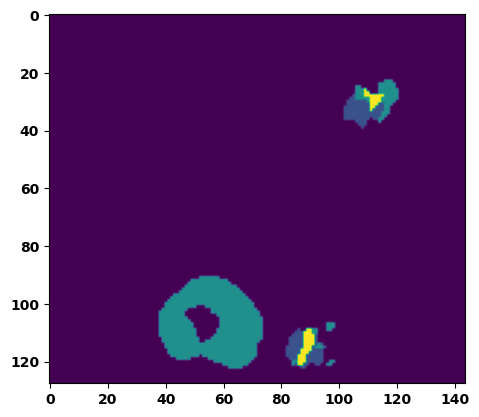

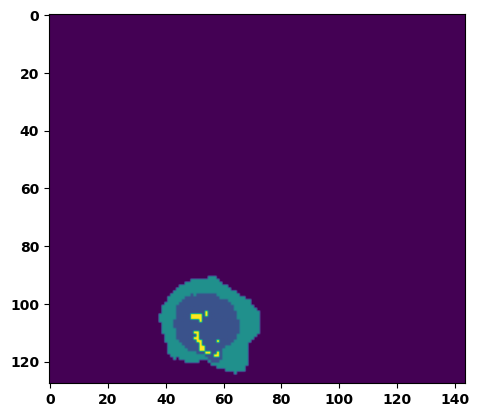

  6%|▌         | 2/36 [00:03<00:53,  1.57s/it]

Batch_id:  1 Eval loss:  0.48079875111579895
Batch_id:  1 Eval IoU:  tensor(0.4170, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9390, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9325, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9361, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:53,  1.64s/it]

Batch_id:  2 Eval loss:  0.06889455020427704
Batch_id:  2 Eval IoU:  tensor(0.8819, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 11%|█         | 4/36 [00:06<00:48,  1.50s/it]

Batch_id:  3 Eval loss:  0.7198883891105652
Batch_id:  3 Eval IoU:  tensor(0.2536, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9324, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9442, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9973, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.47s/it]

Batch_id:  4 Eval loss:  0.07614882290363312
Batch_id:  4 Eval IoU:  tensor(0.8840, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:42,  1.43s/it]

Batch_id:  5 Eval loss:  0.09257598221302032
Batch_id:  5 Eval IoU:  tensor(0.8457, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.47s/it]

Batch_id:  6 Eval loss:  0.26312369108200073
Batch_id:  6 Eval IoU:  tensor(0.6364, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9404, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9446, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9921, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:41,  1.47s/it]

Batch_id:  7 Eval loss:  0.1379675716161728
Batch_id:  7 Eval IoU:  tensor(0.7725, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9863, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:39,  1.45s/it]

Batch_id:  8 Eval loss:  0.22265136241912842
Batch_id:  8 Eval IoU:  tensor(0.6826, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9810, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:37,  1.46s/it]

Batch_id:  9 Eval loss:  0.3958231508731842
Batch_id:  9 Eval IoU:  tensor(0.5312, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  10 Eval loss:  0.25612789392471313
Batch_id:  10 Eval IoU:  tensor(0.6511, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


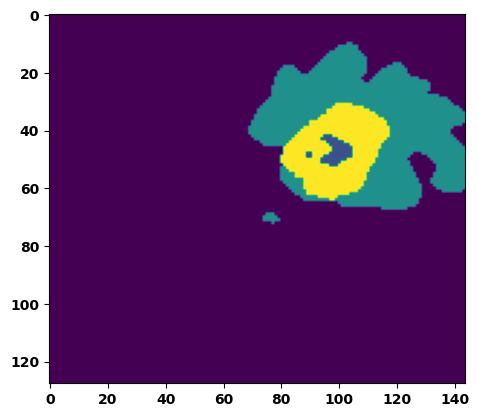

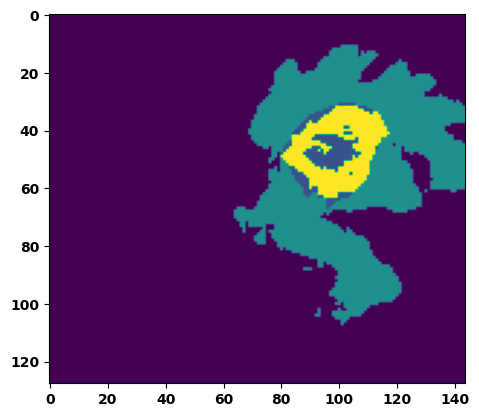

 33%|███▎      | 12/36 [00:18<00:36,  1.53s/it]

Batch_id:  11 Eval loss:  0.39081260561943054
Batch_id:  11 Eval IoU:  tensor(0.5348, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9935, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:33,  1.46s/it]

Batch_id:  12 Eval loss:  0.07826769351959229
Batch_id:  12 Eval IoU:  tensor(0.8686, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:32,  1.47s/it]

Batch_id:  13 Eval loss:  0.05888357758522034
Batch_id:  13 Eval IoU:  tensor(0.8988, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.50s/it]

Batch_id:  14 Eval loss:  0.2530558705329895
Batch_id:  14 Eval IoU:  tensor(0.7006, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.46s/it]

Batch_id:  15 Eval loss:  0.2811521291732788
Batch_id:  15 Eval IoU:  tensor(0.6508, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9974, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:27,  1.47s/it]

Batch_id:  16 Eval loss:  0.1894911527633667
Batch_id:  16 Eval IoU:  tensor(0.7224, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9886, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.47s/it]

Batch_id:  17 Eval loss:  0.08203297853469849
Batch_id:  17 Eval IoU:  tensor(0.8612, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:24,  1.45s/it]

Batch_id:  18 Eval loss:  0.18806681036949158
Batch_id:  18 Eval IoU:  tensor(0.7229, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9960, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:22,  1.43s/it]

Batch_id:  19 Eval loss:  0.17709003388881683
Batch_id:  19 Eval IoU:  tensor(0.7287, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  20 Eval loss:  0.12761273980140686
Batch_id:  20 Eval IoU:  tensor(0.8012, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9434, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9935, device='cuda:0')


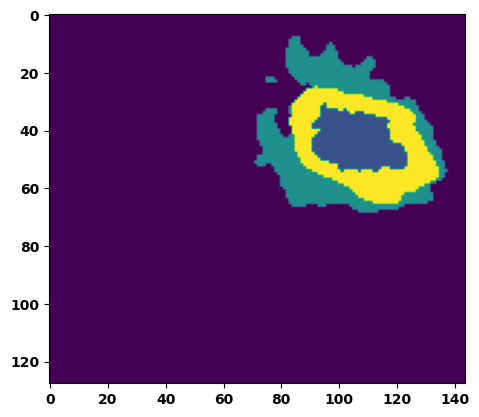

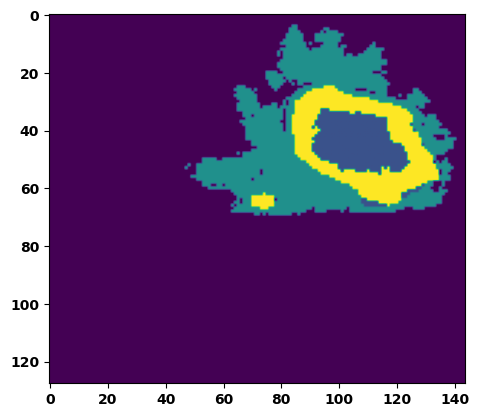

 61%|██████    | 22/36 [00:32<00:20,  1.50s/it]

Batch_id:  21 Eval loss:  0.10336443781852722
Batch_id:  21 Eval IoU:  tensor(0.8568, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9954, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.52s/it]

Batch_id:  22 Eval loss:  0.3915891647338867
Batch_id:  22 Eval IoU:  tensor(0.4938, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9261, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9203, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9895, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:18,  1.52s/it]

Batch_id:  23 Eval loss:  0.08110378682613373
Batch_id:  23 Eval IoU:  tensor(0.8588, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9901, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:16,  1.52s/it]

Batch_id:  24 Eval loss:  0.10583962500095367
Batch_id:  24 Eval IoU:  tensor(0.8217, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:15,  1.52s/it]

Batch_id:  25 Eval loss:  0.10212425887584686
Batch_id:  25 Eval IoU:  tensor(0.8247, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:13,  1.53s/it]

Batch_id:  26 Eval loss:  0.23607774078845978
Batch_id:  26 Eval IoU:  tensor(0.6668, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9878, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:12,  1.50s/it]

Batch_id:  27 Eval loss:  0.40437501668930054
Batch_id:  27 Eval IoU:  tensor(0.5309, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9064, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.8606, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.8600, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9986, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:10,  1.44s/it]

Batch_id:  28 Eval loss:  0.1578570008277893
Batch_id:  28 Eval IoU:  tensor(0.7516, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.43s/it]

Batch_id:  29 Eval loss:  0.08074171841144562
Batch_id:  29 Eval IoU:  tensor(0.8597, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  30 Eval loss:  0.27264404296875
Batch_id:  30 Eval IoU:  tensor(0.6292, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')


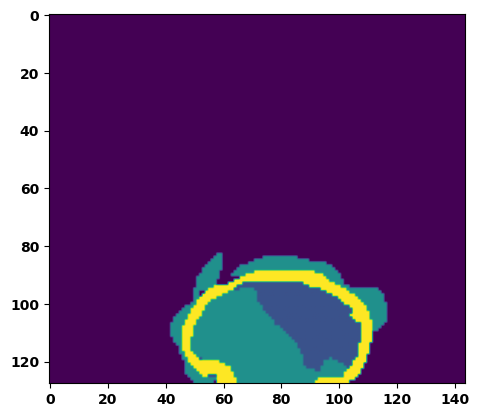

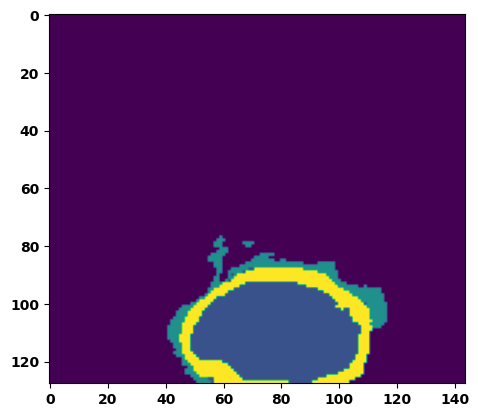

 89%|████████▉ | 32/36 [00:47<00:05,  1.39s/it]

Batch_id:  31 Eval loss:  0.19404089450836182
Batch_id:  31 Eval IoU:  tensor(0.7116, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9932, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.41s/it]

Batch_id:  32 Eval loss:  0.06259992718696594
Batch_id:  32 Eval IoU:  tensor(0.9003, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:02,  1.43s/it]

Batch_id:  33 Eval loss:  0.14510264992713928
Batch_id:  33 Eval IoU:  tensor(0.7833, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.40s/it]

Batch_id:  34 Eval loss:  0.20679402351379395
Batch_id:  34 Eval IoU:  tensor(0.6787, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9528, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9816, device='cuda:0')


100%|██████████| 36/36 [00:53<00:00,  1.47s/it]

Batch_id:  35 Eval loss:  0.19734862446784973
Batch_id:  35 Eval IoU:  tensor(0.6989, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')
Epoch  38 Training loss:  0.16571401804685593
Epoch  38 Evaluation loss:  0.21886849734518263
Epoch  38 Training accuracy :  tensor(0.7634)
Epoch  38 Evaluation accuracy :  tensor(0.7074)
Epoch  38 Training Mean Dice Score:  tensor(0.9813)
Epoch  38 Eval Mean Dice Score:  tensor(0.9738)
Epoch  38 Training Non-tumor Dice Score:  tensor(0.9827)
Epoch  38 Eval Non-tumor Dice Score:  tensor(0.9730)
Epoch  38 Training NCR/NET Dice Score:  tensor(0.9914)
Epoch  38 Eval NCR/NET Dice Score:  tensor(0.9874)
Epoch  38 Training ED Dice Score:  tensor(0.

Epoch: 39
Training in session: 


  1%|          | 1/110 [00:01<02:28,  1.36s/it]

Batch_id:  0 Training loss:  0.2167534977197647
Batch_id:  0 Training IoU:  tensor(0.7322, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:30,  1.40s/it]

Batch_id:  1 Training loss:  0.13872620463371277
Batch_id:  1 Training IoU:  tensor(0.7688, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9747, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:33,  1.44s/it]

Batch_id:  2 Training loss:  0.23688219487667084
Batch_id:  2 Training IoU:  tensor(0.6494, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9524, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9346, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9765, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:34,  1.46s/it]

Batch_id:  3 Training loss:  0.12442472577095032
Batch_id:  3 Training IoU:  tensor(0.8096, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:32,  1.45s/it]

Batch_id:  4 Training loss:  0.08570525050163269
Batch_id:  4 Training IoU:  tensor(0.8526, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:24,  1.39s/it]

Batch_id:  5 Training loss:  0.3245600461959839
Batch_id:  5 Training IoU:  tensor(0.6220, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


  6%|▋         | 7/110 [00:09<02:23,  1.40s/it]

Batch_id:  6 Training loss:  0.14601637423038483
Batch_id:  6 Training IoU:  tensor(0.7716, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:23,  1.41s/it]

Batch_id:  7 Training loss:  0.0507311075925827
Batch_id:  7 Training IoU:  tensor(0.9187, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


  8%|▊         | 9/110 [00:12<02:24,  1.44s/it]

Batch_id:  8 Training loss:  0.1574966013431549
Batch_id:  8 Training IoU:  tensor(0.7432, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9820, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:21,  1.41s/it]

Batch_id:  9 Training loss:  0.2092442363500595
Batch_id:  9 Training IoU:  tensor(0.6900, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 10%|█         | 11/110 [00:15<02:20,  1.42s/it]

Batch_id:  10 Training loss:  0.2060426026582718
Batch_id:  10 Training IoU:  tensor(0.6966, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9628, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 11%|█         | 12/110 [00:17<02:20,  1.44s/it]

Batch_id:  11 Training loss:  0.1968211680650711
Batch_id:  11 Training IoU:  tensor(0.7021, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:15,  1.40s/it]

Batch_id:  12 Training loss:  0.15316623449325562
Batch_id:  12 Training IoU:  tensor(0.7538, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 13%|█▎        | 14/110 [00:19<02:19,  1.45s/it]

Batch_id:  13 Training loss:  0.1895318627357483
Batch_id:  13 Training IoU:  tensor(0.7202, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:17,  1.45s/it]

Batch_id:  14 Training loss:  0.1251659095287323
Batch_id:  14 Training IoU:  tensor(0.8126, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 15%|█▍        | 16/110 [00:22<02:15,  1.45s/it]

Batch_id:  15 Training loss:  0.21347442269325256
Batch_id:  15 Training IoU:  tensor(0.6811, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:19,  1.50s/it]

Batch_id:  16 Training loss:  0.09704576432704926
Batch_id:  16 Training IoU:  tensor(0.8380, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 16%|█▋        | 18/110 [00:25<02:16,  1.48s/it]

Batch_id:  17 Training loss:  0.11218339204788208
Batch_id:  17 Training IoU:  tensor(0.8155, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:17,  1.51s/it]

Batch_id:  18 Training loss:  0.13253925740718842
Batch_id:  18 Training IoU:  tensor(0.8059, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:16,  1.51s/it]

Batch_id:  19 Training loss:  0.07886114716529846
Batch_id:  19 Training IoU:  tensor(0.8690, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:12,  1.49s/it]

Batch_id:  20 Training loss:  0.07732394337654114
Batch_id:  20 Training IoU:  tensor(0.8814, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 20%|██        | 22/110 [00:31<02:12,  1.51s/it]

Batch_id:  21 Training loss:  0.17849883437156677
Batch_id:  21 Training IoU:  tensor(0.7371, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 21%|██        | 23/110 [00:33<02:13,  1.53s/it]

Batch_id:  22 Training loss:  0.2510242462158203
Batch_id:  22 Training IoU:  tensor(0.6496, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:07,  1.49s/it]

Batch_id:  23 Training loss:  0.158394917845726
Batch_id:  23 Training IoU:  tensor(0.7649, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:04,  1.46s/it]

Batch_id:  24 Training loss:  0.158516064286232
Batch_id:  24 Training IoU:  tensor(0.8066, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:04,  1.49s/it]

Batch_id:  25 Training loss:  0.1304212510585785
Batch_id:  25 Training IoU:  tensor(0.8028, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:02,  1.47s/it]

Batch_id:  26 Training loss:  0.1321176439523697
Batch_id:  26 Training IoU:  tensor(0.7906, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 25%|██▌       | 28/110 [00:40<02:03,  1.50s/it]

Batch_id:  27 Training loss:  0.12342964112758636
Batch_id:  27 Training IoU:  tensor(0.8015, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 26%|██▋       | 29/110 [00:42<02:01,  1.50s/it]

Batch_id:  28 Training loss:  0.17226648330688477
Batch_id:  28 Training IoU:  tensor(0.7230, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:57,  1.46s/it]

Batch_id:  29 Training loss:  0.08888919651508331
Batch_id:  29 Training IoU:  tensor(0.8529, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:57,  1.49s/it]

Batch_id:  30 Training loss:  0.08783835172653198
Batch_id:  30 Training IoU:  tensor(0.8484, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:51,  1.43s/it]

Batch_id:  31 Training loss:  0.15138685703277588
Batch_id:  31 Training IoU:  tensor(0.7864, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 30%|███       | 33/110 [00:48<01:50,  1.44s/it]

Batch_id:  32 Training loss:  0.23394858837127686
Batch_id:  32 Training IoU:  tensor(0.6540, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 31%|███       | 34/110 [00:49<01:49,  1.44s/it]

Batch_id:  33 Training loss:  0.08838887512683868
Batch_id:  33 Training IoU:  tensor(0.8480, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:46,  1.42s/it]

Batch_id:  34 Training loss:  0.1441955715417862
Batch_id:  34 Training IoU:  tensor(0.7661, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:47,  1.46s/it]

Batch_id:  35 Training loss:  0.1755591183900833
Batch_id:  35 Training IoU:  tensor(0.7210, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:46,  1.45s/it]

Batch_id:  36 Training loss:  0.5240908861160278
Batch_id:  36 Training IoU:  tensor(0.4236, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:43,  1.44s/it]

Batch_id:  37 Training loss:  0.10751461982727051
Batch_id:  37 Training IoU:  tensor(0.8190, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:42,  1.44s/it]

Batch_id:  38 Training loss:  0.2742101848125458
Batch_id:  38 Training IoU:  tensor(0.6685, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:42,  1.47s/it]

Batch_id:  39 Training loss:  0.11014790832996368
Batch_id:  39 Training IoU:  tensor(0.8228, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:41,  1.47s/it]

Batch_id:  40 Training loss:  0.2666352391242981
Batch_id:  40 Training IoU:  tensor(0.6817, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:43,  1.52s/it]

Batch_id:  41 Training loss:  0.26783859729766846
Batch_id:  41 Training IoU:  tensor(0.6353, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9575, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:38,  1.47s/it]

Batch_id:  42 Training loss:  0.09573136270046234
Batch_id:  42 Training IoU:  tensor(0.8374, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 40%|████      | 44/110 [01:04<01:38,  1.49s/it]

Batch_id:  43 Training loss:  0.2165513038635254
Batch_id:  43 Training IoU:  tensor(0.6843, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 41%|████      | 45/110 [01:05<01:35,  1.47s/it]

Batch_id:  44 Training loss:  0.26653993129730225
Batch_id:  44 Training IoU:  tensor(0.6254, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9536, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9286, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 42%|████▏     | 46/110 [01:07<01:32,  1.45s/it]

Batch_id:  45 Training loss:  0.17507855594158173
Batch_id:  45 Training IoU:  tensor(0.7390, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:29,  1.43s/it]

Batch_id:  46 Training loss:  0.1506783813238144
Batch_id:  46 Training IoU:  tensor(0.7578, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:29,  1.44s/it]

Batch_id:  47 Training loss:  0.08784902095794678
Batch_id:  47 Training IoU:  tensor(0.8559, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:30,  1.48s/it]

Batch_id:  48 Training loss:  0.2070533186197281
Batch_id:  48 Training IoU:  tensor(0.6839, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9410, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9234, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:28,  1.47s/it]

Batch_id:  49 Training loss:  0.06579585373401642
Batch_id:  49 Training IoU:  tensor(0.8896, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:27,  1.48s/it]

Batch_id:  50 Training loss:  0.10257931053638458
Batch_id:  50 Training IoU:  tensor(0.8426, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:24,  1.45s/it]

Batch_id:  51 Training loss:  0.08647318184375763
Batch_id:  51 Training IoU:  tensor(0.8635, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:25,  1.51s/it]

Batch_id:  52 Training loss:  0.264411598443985
Batch_id:  52 Training IoU:  tensor(0.6486, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:22,  1.48s/it]

Batch_id:  53 Training loss:  0.3467748761177063
Batch_id:  53 Training IoU:  tensor(0.6343, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 50%|█████     | 55/110 [01:20<01:19,  1.45s/it]

Batch_id:  54 Training loss:  0.08968356251716614
Batch_id:  54 Training IoU:  tensor(0.8541, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:19,  1.47s/it]

Batch_id:  55 Training loss:  0.40457862615585327
Batch_id:  55 Training IoU:  tensor(0.4988, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9464, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9383, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9206, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:18,  1.49s/it]

Batch_id:  56 Training loss:  0.042150408029556274
Batch_id:  56 Training IoU:  tensor(0.9272, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:15,  1.46s/it]

Batch_id:  57 Training loss:  0.1194750964641571
Batch_id:  57 Training IoU:  tensor(0.8031, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 54%|█████▎    | 59/110 [01:26<01:13,  1.45s/it]

Batch_id:  58 Training loss:  0.16127058863639832
Batch_id:  58 Training IoU:  tensor(0.7408, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 55%|█████▍    | 60/110 [01:27<01:13,  1.47s/it]

Batch_id:  59 Training loss:  0.13864928483963013
Batch_id:  59 Training IoU:  tensor(0.8142, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:08,  1.39s/it]

Batch_id:  60 Training loss:  0.32348400354385376
Batch_id:  60 Training IoU:  tensor(0.6449, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 56%|█████▋    | 62/110 [01:30<01:07,  1.41s/it]

Batch_id:  61 Training loss:  0.10836939513683319
Batch_id:  61 Training IoU:  tensor(0.8186, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:06,  1.42s/it]

Batch_id:  62 Training loss:  0.05536873638629913
Batch_id:  62 Training IoU:  tensor(0.9064, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 58%|█████▊    | 64/110 [01:33<01:07,  1.47s/it]

Batch_id:  63 Training loss:  0.04612882435321808
Batch_id:  63 Training IoU:  tensor(0.9187, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:05,  1.45s/it]

Batch_id:  64 Training loss:  0.3516567349433899
Batch_id:  64 Training IoU:  tensor(0.5848, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:03,  1.45s/it]

Batch_id:  65 Training loss:  0.32418784499168396
Batch_id:  65 Training IoU:  tensor(0.6126, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 61%|██████    | 67/110 [01:37<01:02,  1.45s/it]

Batch_id:  66 Training loss:  0.25066667795181274
Batch_id:  66 Training IoU:  tensor(0.7025, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 62%|██████▏   | 68/110 [01:39<01:01,  1.46s/it]

Batch_id:  67 Training loss:  0.18551434576511383
Batch_id:  67 Training IoU:  tensor(0.7161, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<00:58,  1.42s/it]

Batch_id:  68 Training loss:  0.09692518413066864
Batch_id:  68 Training IoU:  tensor(0.8388, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 64%|██████▎   | 70/110 [01:41<00:57,  1.44s/it]

Batch_id:  69 Training loss:  0.16378271579742432
Batch_id:  69 Training IoU:  tensor(0.8104, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 65%|██████▍   | 71/110 [01:43<00:55,  1.42s/it]

Batch_id:  70 Training loss:  0.38296258449554443
Batch_id:  70 Training IoU:  tensor(0.5374, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 65%|██████▌   | 72/110 [01:44<00:54,  1.42s/it]

Batch_id:  71 Training loss:  0.0890914648771286
Batch_id:  71 Training IoU:  tensor(0.8501, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 66%|██████▋   | 73/110 [01:46<00:53,  1.44s/it]

Batch_id:  72 Training loss:  0.16237150132656097
Batch_id:  72 Training IoU:  tensor(0.7868, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 67%|██████▋   | 74/110 [01:47<00:51,  1.43s/it]

Batch_id:  73 Training loss:  0.14007924497127533
Batch_id:  73 Training IoU:  tensor(0.7834, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 68%|██████▊   | 75/110 [01:49<00:50,  1.45s/it]

Batch_id:  74 Training loss:  0.19133421778678894
Batch_id:  74 Training IoU:  tensor(0.7067, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9735, device='cuda:0')


 69%|██████▉   | 76/110 [01:50<00:49,  1.47s/it]

Batch_id:  75 Training loss:  0.06883494555950165
Batch_id:  75 Training IoU:  tensor(0.8791, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 70%|███████   | 77/110 [01:52<00:49,  1.50s/it]

Batch_id:  76 Training loss:  0.0841926634311676
Batch_id:  76 Training IoU:  tensor(0.8823, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 71%|███████   | 78/110 [01:53<00:47,  1.48s/it]

Batch_id:  77 Training loss:  0.2433641403913498
Batch_id:  77 Training IoU:  tensor(0.6409, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9770, device='cuda:0')


 72%|███████▏  | 79/110 [01:55<00:45,  1.48s/it]

Batch_id:  78 Training loss:  0.046594515442848206
Batch_id:  78 Training IoU:  tensor(0.9202, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 73%|███████▎  | 80/110 [01:56<00:45,  1.51s/it]

Batch_id:  79 Training loss:  0.13877061009407043
Batch_id:  79 Training IoU:  tensor(0.7957, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 74%|███████▎  | 81/110 [01:58<00:43,  1.48s/it]

Batch_id:  80 Training loss:  0.0563846230506897
Batch_id:  80 Training IoU:  tensor(0.9030, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 75%|███████▍  | 82/110 [01:59<00:42,  1.50s/it]

Batch_id:  81 Training loss:  0.09530459344387054
Batch_id:  81 Training IoU:  tensor(0.8344, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:41,  1.52s/it]

Batch_id:  82 Training loss:  0.0912504643201828
Batch_id:  82 Training IoU:  tensor(0.8459, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9872, device='cuda:0')


 76%|███████▋  | 84/110 [02:02<00:39,  1.52s/it]

Batch_id:  83 Training loss:  0.18019375205039978
Batch_id:  83 Training IoU:  tensor(0.7238, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:36,  1.46s/it]

Batch_id:  84 Training loss:  0.2051822990179062
Batch_id:  84 Training IoU:  tensor(0.6955, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 78%|███████▊  | 86/110 [02:05<00:36,  1.51s/it]

Batch_id:  85 Training loss:  0.2459680587053299
Batch_id:  85 Training IoU:  tensor(0.6867, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:34,  1.51s/it]

Batch_id:  86 Training loss:  0.08814375102519989
Batch_id:  86 Training IoU:  tensor(0.8489, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 80%|████████  | 88/110 [02:08<00:33,  1.51s/it]

Batch_id:  87 Training loss:  0.10974131524562836
Batch_id:  87 Training IoU:  tensor(0.8237, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9842, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:30,  1.47s/it]

Batch_id:  88 Training loss:  0.09013310074806213
Batch_id:  88 Training IoU:  tensor(0.8470, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:29,  1.46s/it]

Batch_id:  89 Training loss:  0.16341954469680786
Batch_id:  89 Training IoU:  tensor(0.7405, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 83%|████████▎ | 91/110 [02:12<00:27,  1.44s/it]

Batch_id:  90 Training loss:  0.1301814764738083
Batch_id:  90 Training IoU:  tensor(0.7860, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:25,  1.44s/it]

Batch_id:  91 Training loss:  0.15856164693832397
Batch_id:  91 Training IoU:  tensor(0.7483, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9711, device='cuda:0')


 85%|████████▍ | 93/110 [02:15<00:25,  1.48s/it]

Batch_id:  92 Training loss:  0.2173670381307602
Batch_id:  92 Training IoU:  tensor(0.6758, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:23,  1.45s/it]

Batch_id:  93 Training loss:  0.14071939885616302
Batch_id:  93 Training IoU:  tensor(0.7955, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 86%|████████▋ | 95/110 [02:18<00:22,  1.48s/it]

Batch_id:  94 Training loss:  0.10046440362930298
Batch_id:  94 Training IoU:  tensor(0.8307, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:21,  1.53s/it]

Batch_id:  95 Training loss:  0.16559040546417236
Batch_id:  95 Training IoU:  tensor(0.8387, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:19,  1.49s/it]

Batch_id:  96 Training loss:  0.11604580283164978
Batch_id:  96 Training IoU:  tensor(0.8168, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:18,  1.54s/it]

Batch_id:  97 Training loss:  0.1091693788766861
Batch_id:  97 Training IoU:  tensor(0.8198, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 90%|█████████ | 99/110 [02:25<00:16,  1.51s/it]

Batch_id:  98 Training loss:  0.4649733901023865
Batch_id:  98 Training IoU:  tensor(0.4592, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:15,  1.51s/it]

Batch_id:  99 Training loss:  0.16640609502792358
Batch_id:  99 Training IoU:  tensor(0.7403, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9783, device='cuda:0')


 92%|█████████▏| 101/110 [02:28<00:13,  1.50s/it]

Batch_id:  100 Training loss:  0.05881334841251373
Batch_id:  100 Training IoU:  tensor(0.8989, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:12,  1.51s/it]

Batch_id:  101 Training loss:  0.09230944514274597
Batch_id:  101 Training IoU:  tensor(0.8418, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 94%|█████████▎| 103/110 [02:30<00:10,  1.45s/it]

Batch_id:  102 Training loss:  0.2623099088668823
Batch_id:  102 Training IoU:  tensor(0.6377, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:08,  1.44s/it]

Batch_id:  103 Training loss:  0.2466445416212082
Batch_id:  103 Training IoU:  tensor(0.6503, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9611, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9584, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 95%|█████████▌| 105/110 [02:33<00:07,  1.45s/it]

Batch_id:  104 Training loss:  0.07392065227031708
Batch_id:  104 Training IoU:  tensor(0.8716, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:05,  1.47s/it]

Batch_id:  105 Training loss:  0.2117040753364563
Batch_id:  105 Training IoU:  tensor(0.7153, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 97%|█████████▋| 107/110 [02:36<00:04,  1.49s/it]

Batch_id:  106 Training loss:  0.1043749451637268
Batch_id:  106 Training IoU:  tensor(0.8232, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:03,  1.51s/it]

Batch_id:  107 Training loss:  0.12143965065479279
Batch_id:  107 Training IoU:  tensor(0.8053, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 99%|█████████▉| 109/110 [02:40<00:01,  1.58s/it]

Batch_id:  108 Training loss:  0.12257397174835205
Batch_id:  108 Training IoU:  tensor(0.8057, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.47s/it]


Batch_id:  109 Training loss:  0.21585217118263245
Batch_id:  109 Training IoU:  tensor(0.7342, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9978, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.10118640959262848
Batch_id:  0 Eval IoU:  tensor(0.8263, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9897, device='cuda:0')


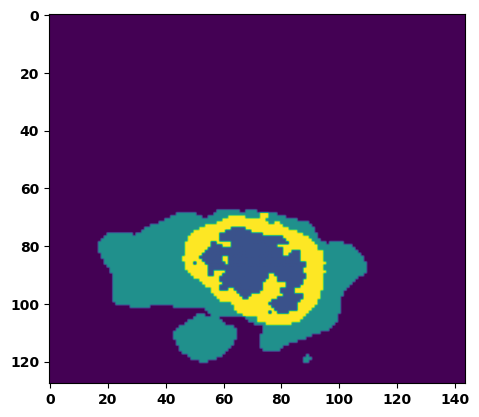

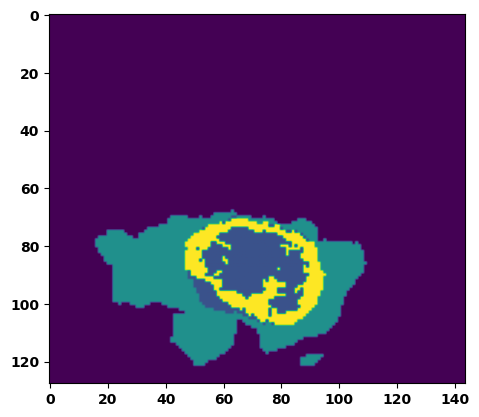

  6%|▌         | 2/36 [00:03<00:57,  1.70s/it]

Batch_id:  1 Eval loss:  0.09797690808773041
Batch_id:  1 Eval IoU:  tensor(0.8671, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9957, device='cuda:0')


  8%|▊         | 3/36 [00:05<00:54,  1.66s/it]

Batch_id:  2 Eval loss:  0.19769851863384247
Batch_id:  2 Eval IoU:  tensor(0.6996, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')


 11%|█         | 4/36 [00:06<00:50,  1.59s/it]

Batch_id:  3 Eval loss:  0.2549383342266083
Batch_id:  3 Eval IoU:  tensor(0.6988, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:47,  1.52s/it]

Batch_id:  4 Eval loss:  0.2238602191209793
Batch_id:  4 Eval IoU:  tensor(0.6810, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9808, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:45,  1.50s/it]

Batch_id:  5 Eval loss:  0.14435340464115143
Batch_id:  5 Eval IoU:  tensor(0.7845, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:43,  1.49s/it]

Batch_id:  6 Eval loss:  0.3944714069366455
Batch_id:  6 Eval IoU:  tensor(0.5338, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:40,  1.45s/it]

Batch_id:  7 Eval loss:  0.3942559063434601
Batch_id:  7 Eval IoU:  tensor(0.5323, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9933, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:39,  1.48s/it]

Batch_id:  8 Eval loss:  0.08130334317684174
Batch_id:  8 Eval IoU:  tensor(0.8619, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 28%|██▊       | 10/36 [00:15<00:37,  1.45s/it]

Batch_id:  9 Eval loss:  0.07819655537605286
Batch_id:  9 Eval IoU:  tensor(0.8688, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  10 Eval loss:  0.19073645770549774
Batch_id:  10 Eval IoU:  tensor(0.7211, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


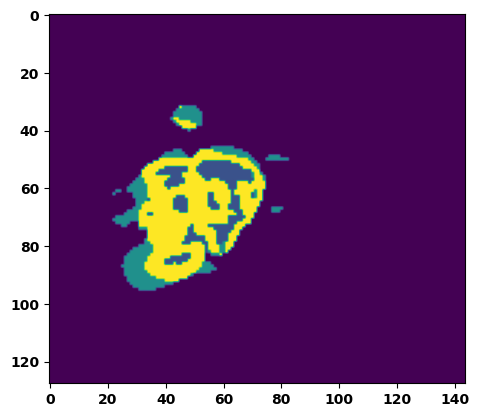

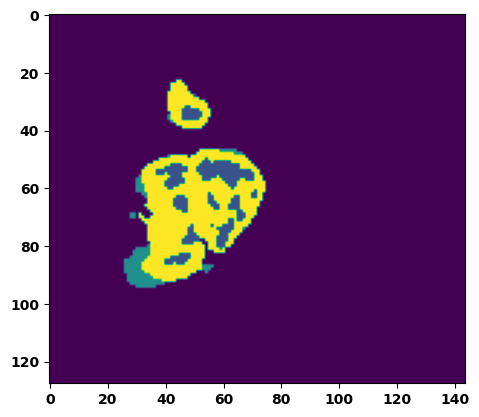

 33%|███▎      | 12/36 [00:18<00:36,  1.51s/it]

Batch_id:  11 Eval loss:  0.06735280156135559
Batch_id:  11 Eval IoU:  tensor(0.8844, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:33,  1.47s/it]

Batch_id:  12 Eval loss:  0.28696951270103455
Batch_id:  12 Eval IoU:  tensor(0.6465, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:31,  1.45s/it]

Batch_id:  13 Eval loss:  0.2691393494606018
Batch_id:  13 Eval IoU:  tensor(0.6287, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9915, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:29,  1.43s/it]

Batch_id:  14 Eval loss:  0.09287796914577484
Batch_id:  14 Eval IoU:  tensor(0.8453, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.45s/it]

Batch_id:  15 Eval loss:  0.1903197020292282
Batch_id:  15 Eval IoU:  tensor(0.7202, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:26,  1.42s/it]

Batch_id:  16 Eval loss:  0.20447790622711182
Batch_id:  16 Eval IoU:  tensor(0.6813, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9555, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9816, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:25,  1.40s/it]

Batch_id:  17 Eval loss:  0.07640878856182098
Batch_id:  17 Eval IoU:  tensor(0.8833, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:23,  1.38s/it]

Batch_id:  18 Eval loss:  0.0844460129737854
Batch_id:  18 Eval IoU:  tensor(0.8530, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9901, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:22,  1.44s/it]

Batch_id:  19 Eval loss:  0.40314197540283203
Batch_id:  19 Eval IoU:  tensor(0.5317, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9069, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.8615, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.8609, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  20 Eval loss:  0.12692423164844513
Batch_id:  20 Eval IoU:  tensor(0.8021, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9462, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9435, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9936, device='cuda:0')


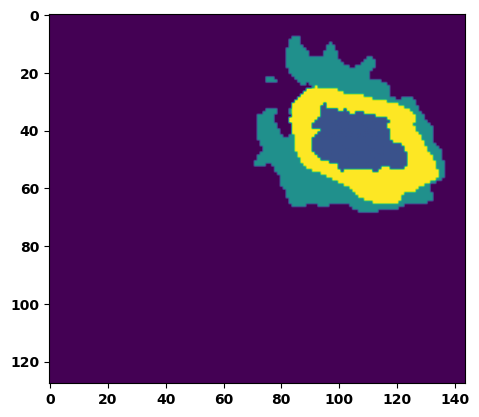

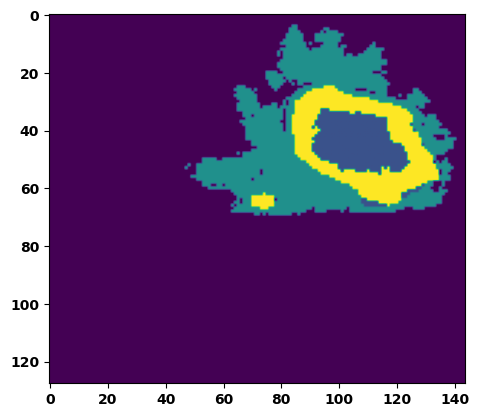

 61%|██████    | 22/36 [00:32<00:21,  1.51s/it]

Batch_id:  21 Eval loss:  0.10550247132778168
Batch_id:  21 Eval IoU:  tensor(0.8215, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:18,  1.42s/it]

Batch_id:  22 Eval loss:  0.27694860100746155
Batch_id:  22 Eval IoU:  tensor(0.6241, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.42s/it]

Batch_id:  23 Eval loss:  0.24048687517642975
Batch_id:  23 Eval IoU:  tensor(0.6612, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.41s/it]

Batch_id:  24 Eval loss:  0.15833133459091187
Batch_id:  24 Eval IoU:  tensor(0.7499, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.45s/it]

Batch_id:  25 Eval loss:  0.05862167477607727
Batch_id:  25 Eval IoU:  tensor(0.8987, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:13,  1.47s/it]

Batch_id:  26 Eval loss:  0.080609992146492
Batch_id:  26 Eval IoU:  tensor(0.8605, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.47s/it]

Batch_id:  27 Eval loss:  0.7165200114250183
Batch_id:  27 Eval IoU:  tensor(0.2553, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9508, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9327, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9975, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.53s/it]

Batch_id:  28 Eval loss:  0.4867475628852844
Batch_id:  28 Eval IoU:  tensor(0.4108, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9386, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9320, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9356, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9980, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:09,  1.52s/it]

Batch_id:  29 Eval loss:  0.39553338289260864
Batch_id:  29 Eval IoU:  tensor(0.4904, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9257, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9196, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  30 Eval loss:  0.19845128059387207
Batch_id:  30 Eval IoU:  tensor(0.7060, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


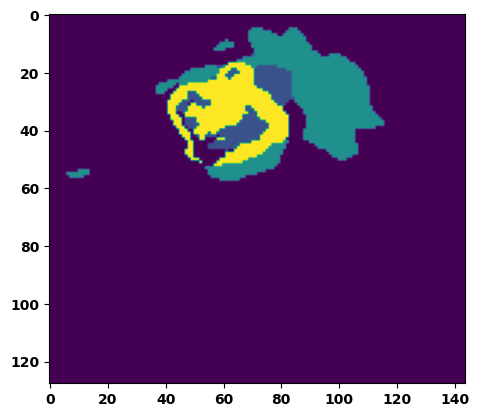

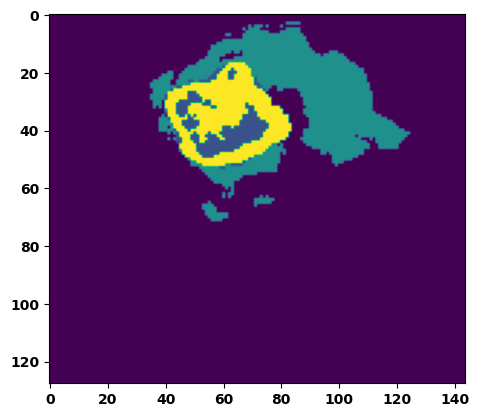

 89%|████████▉ | 32/36 [00:47<00:05,  1.49s/it]

Batch_id:  31 Eval loss:  0.17831481993198395
Batch_id:  31 Eval IoU:  tensor(0.7261, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.48s/it]

Batch_id:  32 Eval loss:  0.06235009431838989
Batch_id:  32 Eval IoU:  tensor(0.9001, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:03,  1.53s/it]

Batch_id:  33 Eval loss:  0.5976933836936951
Batch_id:  33 Eval IoU:  tensor(0.3536, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


 97%|█████████▋| 35/36 [00:52<00:01,  1.52s/it]

Batch_id:  34 Eval loss:  0.2556615471839905
Batch_id:  34 Eval IoU:  tensor(0.6518, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


100%|██████████| 36/36 [00:53<00:00,  1.49s/it]

Batch_id:  35 Eval loss:  0.14219166338443756
Batch_id:  35 Eval IoU:  tensor(0.7675, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9858, device='cuda:0')
Epoch  39 Training loss:  0.16525597165931355
Epoch  39 Evaluation loss:  0.2198611224691073
Epoch  39 Training accuracy :  tensor(0.7638)
Epoch  39 Evaluation accuracy :  tensor(0.7064)
Epoch  39 Training Mean Dice Score:  tensor(0.9813)
Epoch  39 Eval Mean Dice Score:  tensor(0.9737)
Epoch  39 Training Non-tumor Dice Score:  tensor(0.9827)
Epoch  39 Eval Non-tumor Dice Score:  tensor(0.9730)
Epoch  39 Training NCR/NET Dice Score:  tensor(0.9914)
Epoch  39 Eval NCR/NET Dice Score:  tensor(0.9873)
Epoch  39 Training ED Dice Score:  tensor(0.9

Epoch completed and model successfully saved
Epoch: 40
Training in session: 


  1%|          | 1/110 [00:01<02:46,  1.53s/it]

Batch_id:  0 Training loss:  0.17594017088413239
Batch_id:  0 Training IoU:  tensor(0.7393, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:33,  1.42s/it]

Batch_id:  1 Training loss:  0.09011401236057281
Batch_id:  1 Training IoU:  tensor(0.8475, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:30,  1.40s/it]

Batch_id:  2 Training loss:  0.1977168321609497
Batch_id:  2 Training IoU:  tensor(0.7027, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:30,  1.42s/it]

Batch_id:  3 Training loss:  0.2637086808681488
Batch_id:  3 Training IoU:  tensor(0.6895, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:29,  1.42s/it]

Batch_id:  4 Training loss:  0.2493819296360016
Batch_id:  4 Training IoU:  tensor(0.6344, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9756, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:33,  1.47s/it]

Batch_id:  5 Training loss:  0.1990606039762497
Batch_id:  5 Training IoU:  tensor(0.7019, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:33,  1.49s/it]

Batch_id:  6 Training loss:  0.12536801397800446
Batch_id:  6 Training IoU:  tensor(0.7991, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:32,  1.49s/it]

Batch_id:  7 Training loss:  0.34617936611175537
Batch_id:  7 Training IoU:  tensor(0.6259, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


  8%|▊         | 9/110 [00:12<02:23,  1.42s/it]

Batch_id:  8 Training loss:  0.04459187388420105
Batch_id:  8 Training IoU:  tensor(0.9230, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:24,  1.44s/it]

Batch_id:  9 Training loss:  0.13022716343402863
Batch_id:  9 Training IoU:  tensor(0.8096, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 10%|█         | 11/110 [00:15<02:18,  1.40s/it]

Batch_id:  10 Training loss:  0.14150719344615936
Batch_id:  10 Training IoU:  tensor(0.7820, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9893, device='cuda:0')


 11%|█         | 12/110 [00:17<02:16,  1.39s/it]

Batch_id:  11 Training loss:  0.24510253965854645
Batch_id:  11 Training IoU:  tensor(0.7112, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:15,  1.40s/it]

Batch_id:  12 Training loss:  0.23186767101287842
Batch_id:  12 Training IoU:  tensor(0.6555, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:15,  1.41s/it]

Batch_id:  13 Training loss:  0.25933003425598145
Batch_id:  13 Training IoU:  tensor(0.6330, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9509, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9305, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:17,  1.45s/it]

Batch_id:  14 Training loss:  0.20334112644195557
Batch_id:  14 Training IoU:  tensor(0.6996, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:19,  1.48s/it]

Batch_id:  15 Training loss:  0.21011503040790558
Batch_id:  15 Training IoU:  tensor(0.7183, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:17,  1.47s/it]

Batch_id:  16 Training loss:  0.18796679377555847
Batch_id:  16 Training IoU:  tensor(0.7221, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:15,  1.47s/it]

Batch_id:  17 Training loss:  0.16546493768692017
Batch_id:  17 Training IoU:  tensor(0.7418, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9782, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:12,  1.46s/it]

Batch_id:  18 Training loss:  0.06943851709365845
Batch_id:  18 Training IoU:  tensor(0.8792, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:09,  1.44s/it]

Batch_id:  19 Training loss:  0.1401345282793045
Batch_id:  19 Training IoU:  tensor(0.7667, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9744, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:09,  1.45s/it]

Batch_id:  20 Training loss:  0.18094763159751892
Batch_id:  20 Training IoU:  tensor(0.7146, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 20%|██        | 22/110 [00:31<02:06,  1.43s/it]

Batch_id:  21 Training loss:  0.20651289820671082
Batch_id:  21 Training IoU:  tensor(0.6914, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 21%|██        | 23/110 [00:32<01:59,  1.37s/it]

Batch_id:  22 Training loss:  0.2162981927394867
Batch_id:  22 Training IoU:  tensor(0.7331, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:03,  1.44s/it]

Batch_id:  23 Training loss:  0.08690808713436127
Batch_id:  23 Training IoU:  tensor(0.8492, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:05,  1.48s/it]

Batch_id:  24 Training loss:  0.15822166204452515
Batch_id:  24 Training IoU:  tensor(0.8092, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:04,  1.49s/it]

Batch_id:  25 Training loss:  0.1297137588262558
Batch_id:  25 Training IoU:  tensor(0.8011, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:03,  1.49s/it]

Batch_id:  26 Training loss:  0.08960765600204468
Batch_id:  26 Training IoU:  tensor(0.8463, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 25%|██▌       | 28/110 [00:40<02:01,  1.48s/it]

Batch_id:  27 Training loss:  0.3202543556690216
Batch_id:  27 Training IoU:  tensor(0.6181, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 26%|██▋       | 29/110 [00:41<01:56,  1.44s/it]

Batch_id:  28 Training loss:  0.15474294126033783
Batch_id:  28 Training IoU:  tensor(0.7711, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:55,  1.45s/it]

Batch_id:  29 Training loss:  0.15475872159004211
Batch_id:  29 Training IoU:  tensor(0.7508, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:55,  1.46s/it]

Batch_id:  30 Training loss:  0.06467100977897644
Batch_id:  30 Training IoU:  tensor(0.8920, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:49,  1.40s/it]

Batch_id:  31 Training loss:  0.23942513763904572
Batch_id:  31 Training IoU:  tensor(0.6597, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9624, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9604, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 30%|███       | 33/110 [00:47<01:51,  1.44s/it]

Batch_id:  32 Training loss:  0.11008954048156738
Batch_id:  32 Training IoU:  tensor(0.8162, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 31%|███       | 34/110 [00:49<01:50,  1.45s/it]

Batch_id:  33 Training loss:  0.21805323660373688
Batch_id:  33 Training IoU:  tensor(0.7299, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:47,  1.43s/it]

Batch_id:  34 Training loss:  0.1539226919412613
Batch_id:  34 Training IoU:  tensor(0.7482, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 33%|███▎      | 36/110 [00:51<01:44,  1.42s/it]

Batch_id:  35 Training loss:  0.21114687621593475
Batch_id:  35 Training IoU:  tensor(0.6839, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9911, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:48,  1.48s/it]

Batch_id:  36 Training loss:  0.04578070342540741
Batch_id:  36 Training IoU:  tensor(0.9198, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 35%|███▍      | 38/110 [00:54<01:46,  1.47s/it]

Batch_id:  37 Training loss:  0.1510949283838272
Batch_id:  37 Training IoU:  tensor(0.7641, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:48,  1.53s/it]

Batch_id:  38 Training loss:  0.16507044434547424
Batch_id:  38 Training IoU:  tensor(0.8085, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:43,  1.49s/it]

Batch_id:  39 Training loss:  0.13972723484039307
Batch_id:  39 Training IoU:  tensor(0.7961, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:41,  1.47s/it]

Batch_id:  40 Training loss:  0.07684323191642761
Batch_id:  40 Training IoU:  tensor(0.8722, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 38%|███▊      | 42/110 [01:00<01:38,  1.44s/it]

Batch_id:  41 Training loss:  0.08485622704029083
Batch_id:  41 Training IoU:  tensor(0.8541, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:35,  1.43s/it]

Batch_id:  42 Training loss:  0.21518674492835999
Batch_id:  42 Training IoU:  tensor(0.6866, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 40%|████      | 44/110 [01:03<01:31,  1.38s/it]

Batch_id:  43 Training loss:  0.12129203975200653
Batch_id:  43 Training IoU:  tensor(0.7998, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 41%|████      | 45/110 [01:05<01:32,  1.42s/it]

Batch_id:  44 Training loss:  0.12493735551834106
Batch_id:  44 Training IoU:  tensor(0.8138, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:34,  1.47s/it]

Batch_id:  45 Training loss:  0.13101397454738617
Batch_id:  45 Training IoU:  tensor(0.8021, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:32,  1.46s/it]

Batch_id:  46 Training loss:  0.09906426072120667
Batch_id:  46 Training IoU:  tensor(0.8323, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:31,  1.48s/it]

Batch_id:  47 Training loss:  0.45597782731056213
Batch_id:  47 Training IoU:  tensor(0.4685, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 45%|████▍     | 49/110 [01:11<01:30,  1.49s/it]

Batch_id:  48 Training loss:  0.32873666286468506
Batch_id:  48 Training IoU:  tensor(0.6348, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:30,  1.51s/it]

Batch_id:  49 Training loss:  0.20771563053131104
Batch_id:  49 Training IoU:  tensor(0.6824, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9386, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9408, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9220, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 46%|████▋     | 51/110 [01:14<01:30,  1.53s/it]

Batch_id:  50 Training loss:  0.058332011103630066
Batch_id:  50 Training IoU:  tensor(0.8996, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:25,  1.48s/it]

Batch_id:  51 Training loss:  0.13031773269176483
Batch_id:  51 Training IoU:  tensor(0.7862, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 48%|████▊     | 53/110 [01:17<01:23,  1.46s/it]

Batch_id:  52 Training loss:  0.1518355906009674
Batch_id:  52 Training IoU:  tensor(0.7856, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:22,  1.48s/it]

Batch_id:  53 Training loss:  0.13188309967517853
Batch_id:  53 Training IoU:  tensor(0.7916, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:19,  1.45s/it]

Batch_id:  54 Training loss:  0.1844920516014099
Batch_id:  54 Training IoU:  tensor(0.7197, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:20,  1.48s/it]

Batch_id:  55 Training loss:  0.09130910038948059
Batch_id:  55 Training IoU:  tensor(0.8442, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 52%|█████▏    | 57/110 [01:22<01:16,  1.45s/it]

Batch_id:  56 Training loss:  0.18871326744556427
Batch_id:  56 Training IoU:  tensor(0.7101, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9514, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9734, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:14,  1.43s/it]

Batch_id:  57 Training loss:  0.0902889221906662
Batch_id:  57 Training IoU:  tensor(0.8481, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 54%|█████▎    | 59/110 [01:25<01:13,  1.44s/it]

Batch_id:  58 Training loss:  0.09816080331802368
Batch_id:  58 Training IoU:  tensor(0.8359, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 55%|█████▍    | 60/110 [01:27<01:12,  1.46s/it]

Batch_id:  59 Training loss:  0.17373283207416534
Batch_id:  59 Training IoU:  tensor(0.7412, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:14,  1.51s/it]

Batch_id:  60 Training loss:  0.1847984939813614
Batch_id:  60 Training IoU:  tensor(0.7175, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 56%|█████▋    | 62/110 [01:30<01:11,  1.48s/it]

Batch_id:  61 Training loss:  0.056600913405418396
Batch_id:  61 Training IoU:  tensor(0.9026, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:12,  1.55s/it]

Batch_id:  62 Training loss:  0.17275205254554749
Batch_id:  62 Training IoU:  tensor(0.7226, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 58%|█████▊    | 64/110 [01:33<01:10,  1.54s/it]

Batch_id:  63 Training loss:  0.3486233949661255
Batch_id:  63 Training IoU:  tensor(0.5890, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 59%|█████▉    | 65/110 [01:35<01:09,  1.54s/it]

Batch_id:  64 Training loss:  0.141028493642807
Batch_id:  64 Training IoU:  tensor(0.7906, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:09,  1.58s/it]

Batch_id:  65 Training loss:  0.21250471472740173
Batch_id:  65 Training IoU:  tensor(0.6821, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 61%|██████    | 67/110 [01:38<01:06,  1.54s/it]

Batch_id:  66 Training loss:  0.08538423478603363
Batch_id:  66 Training IoU:  tensor(0.8661, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 62%|██████▏   | 68/110 [01:39<01:02,  1.49s/it]

Batch_id:  67 Training loss:  0.11360469460487366
Batch_id:  67 Training IoU:  tensor(0.8205, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<00:59,  1.46s/it]

Batch_id:  68 Training loss:  0.38506999611854553
Batch_id:  68 Training IoU:  tensor(0.5365, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 64%|██████▎   | 70/110 [01:42<00:56,  1.41s/it]

Batch_id:  69 Training loss:  0.09151165187358856
Batch_id:  69 Training IoU:  tensor(0.8408, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


 65%|██████▍   | 71/110 [01:43<00:57,  1.47s/it]

Batch_id:  70 Training loss:  0.049873605370521545
Batch_id:  70 Training IoU:  tensor(0.9198, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 65%|██████▌   | 72/110 [01:45<00:56,  1.50s/it]

Batch_id:  71 Training loss:  0.08644571900367737
Batch_id:  71 Training IoU:  tensor(0.8497, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 66%|██████▋   | 73/110 [01:46<00:53,  1.45s/it]

Batch_id:  72 Training loss:  0.2454719990491867
Batch_id:  72 Training IoU:  tensor(0.6870, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:51,  1.44s/it]

Batch_id:  73 Training loss:  0.1521674543619156
Batch_id:  73 Training IoU:  tensor(0.7557, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 68%|██████▊   | 75/110 [01:49<00:50,  1.44s/it]

Batch_id:  74 Training loss:  0.10865090787410736
Batch_id:  74 Training IoU:  tensor(0.8242, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 69%|██████▉   | 76/110 [01:50<00:47,  1.41s/it]

Batch_id:  75 Training loss:  0.05567203462123871
Batch_id:  75 Training IoU:  tensor(0.9062, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 70%|███████   | 77/110 [01:52<00:50,  1.53s/it]

Batch_id:  76 Training loss:  0.10828195512294769
Batch_id:  76 Training IoU:  tensor(0.8280, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9630, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9848, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:47,  1.48s/it]

Batch_id:  77 Training loss:  0.07255783677101135
Batch_id:  77 Training IoU:  tensor(0.8743, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 72%|███████▏  | 79/110 [01:55<00:45,  1.47s/it]

Batch_id:  78 Training loss:  0.04244428873062134
Batch_id:  78 Training IoU:  tensor(0.9263, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:44,  1.48s/it]

Batch_id:  79 Training loss:  0.1209896057844162
Batch_id:  79 Training IoU:  tensor(0.8065, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 74%|███████▎  | 81/110 [01:58<00:42,  1.48s/it]

Batch_id:  80 Training loss:  0.15884408354759216
Batch_id:  80 Training IoU:  tensor(0.7493, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9708, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:41,  1.49s/it]

Batch_id:  81 Training loss:  0.096891850233078
Batch_id:  81 Training IoU:  tensor(0.8384, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 75%|███████▌  | 83/110 [02:01<00:40,  1.49s/it]

Batch_id:  82 Training loss:  0.2365690916776657
Batch_id:  82 Training IoU:  tensor(0.6508, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9528, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9361, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9768, device='cuda:0')


 76%|███████▋  | 84/110 [02:02<00:38,  1.47s/it]

Batch_id:  83 Training loss:  0.10506612062454224
Batch_id:  83 Training IoU:  tensor(0.8251, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 77%|███████▋  | 85/110 [02:04<00:37,  1.50s/it]

Batch_id:  84 Training loss:  0.17152102291584015
Batch_id:  84 Training IoU:  tensor(0.8249, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 78%|███████▊  | 86/110 [02:05<00:34,  1.45s/it]

Batch_id:  85 Training loss:  0.09465256333351135
Batch_id:  85 Training IoU:  tensor(0.8393, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 79%|███████▉  | 87/110 [02:07<00:33,  1.45s/it]

Batch_id:  86 Training loss:  0.27181127667427063
Batch_id:  86 Training IoU:  tensor(0.6324, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9578, device='cuda:0')


 80%|████████  | 88/110 [02:08<00:31,  1.45s/it]

Batch_id:  87 Training loss:  0.13897459208965302
Batch_id:  87 Training IoU:  tensor(0.8136, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 81%|████████  | 89/110 [02:10<00:30,  1.43s/it]

Batch_id:  88 Training loss:  0.1575121283531189
Batch_id:  88 Training IoU:  tensor(0.7470, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 82%|████████▏ | 90/110 [02:11<00:28,  1.44s/it]

Batch_id:  89 Training loss:  0.24613499641418457
Batch_id:  89 Training IoU:  tensor(0.6567, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9842, device='cuda:0')


 83%|████████▎ | 91/110 [02:13<00:27,  1.45s/it]

Batch_id:  90 Training loss:  0.2651405334472656
Batch_id:  90 Training IoU:  tensor(0.6485, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 84%|████████▎ | 92/110 [02:14<00:26,  1.45s/it]

Batch_id:  91 Training loss:  0.10544158518314362
Batch_id:  91 Training IoU:  tensor(0.8214, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 85%|████████▍ | 93/110 [02:15<00:24,  1.45s/it]

Batch_id:  92 Training loss:  0.09139794111251831
Batch_id:  92 Training IoU:  tensor(0.8441, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 85%|████████▌ | 94/110 [02:17<00:24,  1.53s/it]

Batch_id:  93 Training loss:  0.16277676820755005
Batch_id:  93 Training IoU:  tensor(0.7885, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 86%|████████▋ | 95/110 [02:19<00:22,  1.49s/it]

Batch_id:  94 Training loss:  0.27507370710372925
Batch_id:  94 Training IoU:  tensor(0.6697, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 87%|████████▋ | 96/110 [02:20<00:20,  1.44s/it]

Batch_id:  95 Training loss:  0.1581437885761261
Batch_id:  95 Training IoU:  tensor(0.7472, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 88%|████████▊ | 97/110 [02:21<00:18,  1.44s/it]

Batch_id:  96 Training loss:  0.07704868912696838
Batch_id:  96 Training IoU:  tensor(0.8826, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 89%|████████▉ | 98/110 [02:23<00:17,  1.47s/it]

Batch_id:  97 Training loss:  0.14386826753616333
Batch_id:  97 Training IoU:  tensor(0.7672, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 90%|█████████ | 99/110 [02:24<00:15,  1.45s/it]

Batch_id:  98 Training loss:  0.32701247930526733
Batch_id:  98 Training IoU:  tensor(0.6185, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 91%|█████████ | 100/110 [02:26<00:14,  1.46s/it]

Batch_id:  99 Training loss:  0.11075146496295929
Batch_id:  99 Training IoU:  tensor(0.8184, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


 92%|█████████▏| 101/110 [02:27<00:13,  1.49s/it]

Batch_id:  100 Training loss:  0.10151839256286621
Batch_id:  100 Training IoU:  tensor(0.8458, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 93%|█████████▎| 102/110 [02:29<00:11,  1.48s/it]

Batch_id:  101 Training loss:  0.08753514289855957
Batch_id:  101 Training IoU:  tensor(0.8551, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 94%|█████████▎| 103/110 [02:30<00:10,  1.48s/it]

Batch_id:  102 Training loss:  0.5250081419944763
Batch_id:  102 Training IoU:  tensor(0.4227, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 95%|█████████▍| 104/110 [02:32<00:09,  1.52s/it]

Batch_id:  103 Training loss:  0.0868009477853775
Batch_id:  103 Training IoU:  tensor(0.8771, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 95%|█████████▌| 105/110 [02:33<00:07,  1.47s/it]

Batch_id:  104 Training loss:  0.10724666714668274
Batch_id:  104 Training IoU:  tensor(0.8194, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 96%|█████████▋| 106/110 [02:35<00:05,  1.47s/it]

Batch_id:  105 Training loss:  0.3984444737434387
Batch_id:  105 Training IoU:  tensor(0.5064, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9483, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9236, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 97%|█████████▋| 107/110 [02:36<00:04,  1.50s/it]

Batch_id:  106 Training loss:  0.09564661979675293
Batch_id:  106 Training IoU:  tensor(0.8453, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 98%|█████████▊| 108/110 [02:38<00:02,  1.48s/it]

Batch_id:  107 Training loss:  0.08743081986904144
Batch_id:  107 Training IoU:  tensor(0.8559, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 99%|█████████▉| 109/110 [02:39<00:01,  1.46s/it]

Batch_id:  108 Training loss:  0.24997617304325104
Batch_id:  108 Training IoU:  tensor(0.6503, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


100%|██████████| 110/110 [02:41<00:00,  1.46s/it]


Batch_id:  109 Training loss:  0.12368004024028778
Batch_id:  109 Training IoU:  tensor(0.8027, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9952, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.18928050994873047
Batch_id:  0 Eval IoU:  tensor(0.7222, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


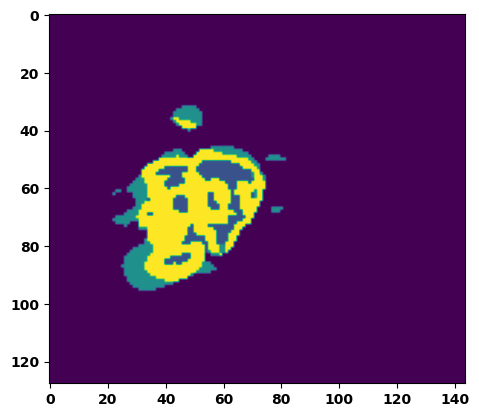

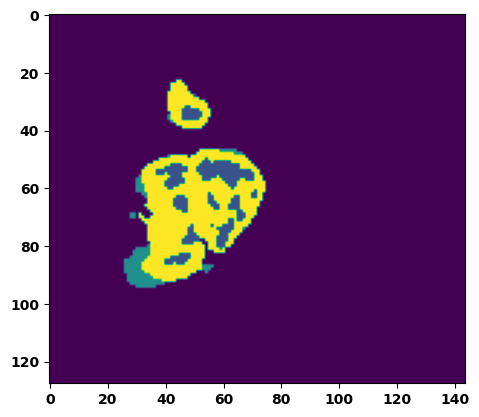

  6%|▌         | 2/36 [00:03<00:50,  1.47s/it]

Batch_id:  1 Eval loss:  0.2815295457839966
Batch_id:  1 Eval IoU:  tensor(0.6500, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9975, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.49s/it]

Batch_id:  2 Eval loss:  0.25740957260131836
Batch_id:  2 Eval IoU:  tensor(0.6499, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 11%|█         | 4/36 [00:05<00:46,  1.47s/it]

Batch_id:  3 Eval loss:  0.27018243074417114
Batch_id:  3 Eval IoU:  tensor(0.6318, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9436, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:44,  1.44s/it]

Batch_id:  4 Eval loss:  0.23598258197307587
Batch_id:  4 Eval IoU:  tensor(0.6666, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:44,  1.48s/it]

Batch_id:  5 Eval loss:  0.406522274017334
Batch_id:  5 Eval IoU:  tensor(0.5285, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9055, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.8594, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.8588, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:41,  1.42s/it]

Batch_id:  6 Eval loss:  0.06182838976383209
Batch_id:  6 Eval IoU:  tensor(0.9014, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:39,  1.42s/it]

Batch_id:  7 Eval loss:  0.285591185092926
Batch_id:  7 Eval IoU:  tensor(0.6131, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9558, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9417, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9913, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:39,  1.45s/it]

Batch_id:  8 Eval loss:  0.10209089517593384
Batch_id:  8 Eval IoU:  tensor(0.8247, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9895, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:36,  1.41s/it]

Batch_id:  9 Eval loss:  0.1602051854133606
Batch_id:  9 Eval IoU:  tensor(0.7483, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  10 Eval loss:  0.2091194987297058
Batch_id:  10 Eval IoU:  tensor(0.6758, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9524, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9488, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9541, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9814, device='cuda:0')


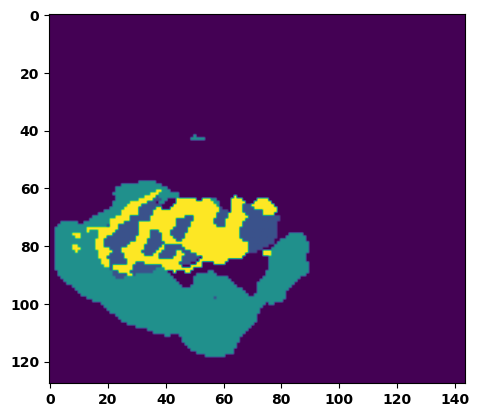

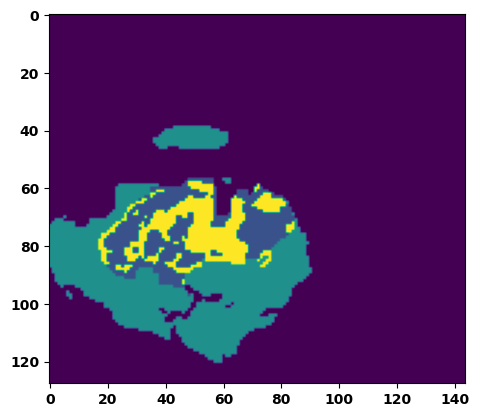

 33%|███▎      | 12/36 [00:17<00:35,  1.46s/it]

Batch_id:  11 Eval loss:  0.5959752798080444
Batch_id:  11 Eval IoU:  tensor(0.3555, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:32,  1.43s/it]

Batch_id:  12 Eval loss:  0.1783519834280014
Batch_id:  12 Eval IoU:  tensor(0.7272, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.43s/it]

Batch_id:  13 Eval loss:  0.067617267370224
Batch_id:  13 Eval IoU:  tensor(0.8840, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.51s/it]

Batch_id:  14 Eval loss:  0.7218313813209534
Batch_id:  14 Eval IoU:  tensor(0.2529, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9326, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.47s/it]

Batch_id:  15 Eval loss:  0.1283634752035141
Batch_id:  15 Eval IoU:  tensor(0.8001, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9935, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:27,  1.44s/it]

Batch_id:  16 Eval loss:  0.22182707488536835
Batch_id:  16 Eval IoU:  tensor(0.6833, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9812, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:25,  1.44s/it]

Batch_id:  17 Eval loss:  0.09805281460285187
Batch_id:  17 Eval IoU:  tensor(0.8670, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.46s/it]

Batch_id:  18 Eval loss:  0.14244306087493896
Batch_id:  18 Eval IoU:  tensor(0.7664, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9857, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:22,  1.41s/it]

Batch_id:  19 Eval loss:  0.08180069923400879
Batch_id:  19 Eval IoU:  tensor(0.8584, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  20 Eval loss:  0.09130436182022095
Batch_id:  20 Eval IoU:  tensor(0.8478, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


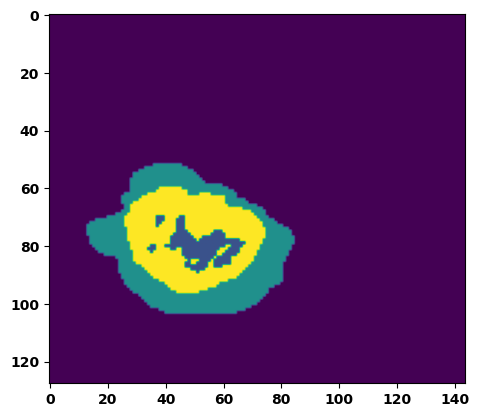

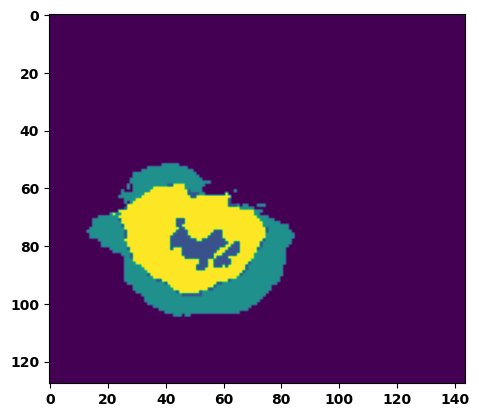

 61%|██████    | 22/36 [00:31<00:19,  1.39s/it]

Batch_id:  21 Eval loss:  0.2559795379638672
Batch_id:  21 Eval IoU:  tensor(0.6963, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:18,  1.41s/it]

Batch_id:  22 Eval loss:  0.14423757791519165
Batch_id:  22 Eval IoU:  tensor(0.7844, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:16,  1.41s/it]

Batch_id:  23 Eval loss:  0.18876367807388306
Batch_id:  23 Eval IoU:  tensor(0.7210, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.40s/it]

Batch_id:  24 Eval loss:  0.39145398139953613
Batch_id:  24 Eval IoU:  tensor(0.4935, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9262, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9204, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


 72%|███████▏  | 26/36 [00:37<00:14,  1.42s/it]

Batch_id:  25 Eval loss:  0.08186417818069458
Batch_id:  25 Eval IoU:  tensor(0.8608, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 75%|███████▌  | 27/36 [00:38<00:12,  1.42s/it]

Batch_id:  26 Eval loss:  0.1067458987236023
Batch_id:  26 Eval IoU:  tensor(0.8197, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.44s/it]

Batch_id:  27 Eval loss:  0.19811755418777466
Batch_id:  27 Eval IoU:  tensor(0.6981, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9865, device='cuda:0')


 81%|████████  | 29/36 [00:41<00:09,  1.42s/it]

Batch_id:  28 Eval loss:  0.058770403265953064
Batch_id:  28 Eval IoU:  tensor(0.8993, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.40s/it]

Batch_id:  29 Eval loss:  0.39871156215667725
Batch_id:  29 Eval IoU:  tensor(0.5266, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  30 Eval loss:  0.07874983549118042
Batch_id:  30 Eval IoU:  tensor(0.8676, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


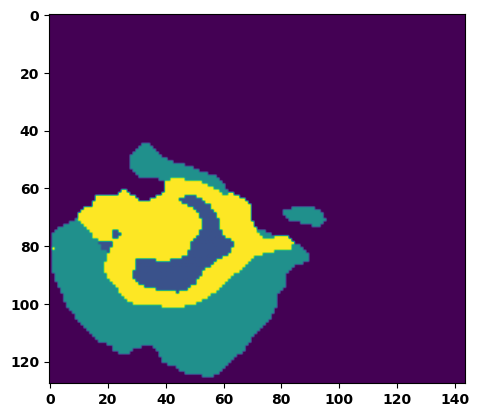

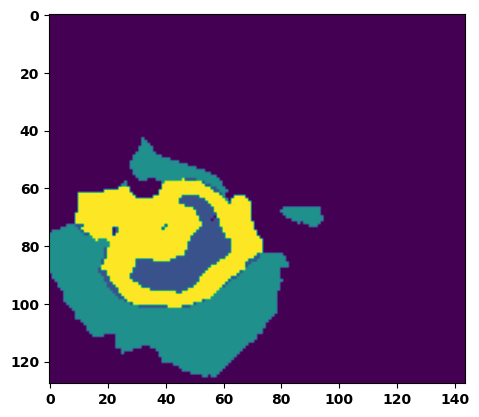

 89%|████████▉ | 32/36 [00:46<00:06,  1.56s/it]

Batch_id:  31 Eval loss:  0.39207324385643005
Batch_id:  31 Eval IoU:  tensor(0.5363, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.51s/it]

Batch_id:  32 Eval loss:  0.4937859773635864
Batch_id:  32 Eval IoU:  tensor(0.4090, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9376, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9447, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9316, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.50s/it]

Batch_id:  33 Eval loss:  0.19931142032146454
Batch_id:  33 Eval IoU:  tensor(0.7050, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


 97%|█████████▋| 35/36 [00:50<00:01,  1.46s/it]

Batch_id:  34 Eval loss:  0.08010782301425934
Batch_id:  34 Eval IoU:  tensor(0.8602, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.45s/it]

Batch_id:  35 Eval loss:  0.07444287836551666
Batch_id:  35 Eval IoU:  tensor(0.8857, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')
Epoch  40 Training loss:  0.1646413501013409
Epoch  40 Evaluation loss:  0.2202895838353369
Epoch  40 Training accuracy :  tensor(0.7646)
Epoch  40 Evaluation accuracy :  tensor(0.7061)
Epoch  40 Training Mean Dice Score:  tensor(0.9813)
Epoch  40 Eval Mean Dice Score:  tensor(0.9737)
Epoch  40 Training Non-tumor Dice Score:  tensor(0.9828)
Epoch  40 Eval Non-tumor Dice Score:  tensor(0.9727)
Epoch  40 Training NCR/NET Dice Score:  tensor(0.9915)
Epoch  40 Eval NCR/NET Dice Score:  tensor(0.9874)
Epoch  40 Training ED Dice Score:  tensor(0.97

Epoch: 41
Training in session: 


  1%|          | 1/110 [00:01<02:38,  1.46s/it]

Batch_id:  0 Training loss:  0.3819049000740051
Batch_id:  0 Training IoU:  tensor(0.5381, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:48,  1.56s/it]

Batch_id:  1 Training loss:  0.10024313628673553
Batch_id:  1 Training IoU:  tensor(0.8326, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:46,  1.55s/it]

Batch_id:  2 Training loss:  0.09777848422527313
Batch_id:  2 Training IoU:  tensor(0.8366, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:50,  1.61s/it]

Batch_id:  3 Training loss:  0.04657156765460968
Batch_id:  3 Training IoU:  tensor(0.9184, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:45,  1.57s/it]

Batch_id:  4 Training loss:  0.5250566005706787
Batch_id:  4 Training IoU:  tensor(0.4222, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:42,  1.57s/it]

Batch_id:  5 Training loss:  0.08880746364593506
Batch_id:  5 Training IoU:  tensor(0.8529, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:37,  1.52s/it]

Batch_id:  6 Training loss:  0.10288050770759583
Batch_id:  6 Training IoU:  tensor(0.8435, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:35,  1.53s/it]

Batch_id:  7 Training loss:  0.16600564122200012
Batch_id:  7 Training IoU:  tensor(0.7402, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9778, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:30,  1.49s/it]

Batch_id:  8 Training loss:  0.20284560322761536
Batch_id:  8 Training IoU:  tensor(0.6973, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:26,  1.46s/it]

Batch_id:  9 Training loss:  0.27507829666137695
Batch_id:  9 Training IoU:  tensor(0.6671, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 10%|█         | 11/110 [00:16<02:26,  1.48s/it]

Batch_id:  10 Training loss:  0.09235785901546478
Batch_id:  10 Training IoU:  tensor(0.8453, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 11%|█         | 12/110 [00:18<02:26,  1.50s/it]

Batch_id:  11 Training loss:  0.1651916801929474
Batch_id:  11 Training IoU:  tensor(0.8051, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:22,  1.47s/it]

Batch_id:  12 Training loss:  0.056661754846572876
Batch_id:  12 Training IoU:  tensor(0.9030, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:20,  1.47s/it]

Batch_id:  13 Training loss:  0.17746601998806
Batch_id:  13 Training IoU:  tensor(0.7267, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:22,  1.50s/it]

Batch_id:  14 Training loss:  0.12414650619029999
Batch_id:  14 Training IoU:  tensor(0.8096, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:21,  1.50s/it]

Batch_id:  15 Training loss:  0.19643427431583405
Batch_id:  15 Training IoU:  tensor(0.7094, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9599, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9782, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:19,  1.50s/it]

Batch_id:  16 Training loss:  0.20545725524425507
Batch_id:  16 Training IoU:  tensor(0.6925, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:18,  1.50s/it]

Batch_id:  17 Training loss:  0.15317285060882568
Batch_id:  17 Training IoU:  tensor(0.7542, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:19,  1.53s/it]

Batch_id:  18 Training loss:  0.09736013412475586
Batch_id:  18 Training IoU:  tensor(0.8377, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:16,  1.52s/it]

Batch_id:  19 Training loss:  0.055184051394462585
Batch_id:  19 Training IoU:  tensor(0.9074, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:11,  1.47s/it]

Batch_id:  20 Training loss:  0.11242985725402832
Batch_id:  20 Training IoU:  tensor(0.8150, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 20%|██        | 22/110 [00:32<02:06,  1.43s/it]

Batch_id:  21 Training loss:  0.15507251024246216
Batch_id:  21 Training IoU:  tensor(0.7757, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 21%|██        | 23/110 [00:34<02:04,  1.44s/it]

Batch_id:  22 Training loss:  0.12900176644325256
Batch_id:  22 Training IoU:  tensor(0.7877, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:05,  1.46s/it]

Batch_id:  23 Training loss:  0.11043484508991241
Batch_id:  23 Training IoU:  tensor(0.8151, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:02,  1.45s/it]

Batch_id:  24 Training loss:  0.15401165187358856
Batch_id:  24 Training IoU:  tensor(0.7510, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:08,  1.53s/it]

Batch_id:  25 Training loss:  0.2155732959508896
Batch_id:  25 Training IoU:  tensor(0.6847, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 25%|██▍       | 27/110 [00:40<02:05,  1.52s/it]

Batch_id:  26 Training loss:  0.15779656171798706
Batch_id:  26 Training IoU:  tensor(0.7498, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9709, device='cuda:0')


 25%|██▌       | 28/110 [00:42<02:03,  1.50s/it]

Batch_id:  27 Training loss:  0.24735334515571594
Batch_id:  27 Training IoU:  tensor(0.6539, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 26%|██▋       | 29/110 [00:43<01:59,  1.47s/it]

Batch_id:  28 Training loss:  0.08940082788467407
Batch_id:  28 Training IoU:  tensor(0.8495, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 27%|██▋       | 30/110 [00:44<01:56,  1.45s/it]

Batch_id:  29 Training loss:  0.12325678765773773
Batch_id:  29 Training IoU:  tensor(0.8032, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 28%|██▊       | 31/110 [00:46<01:52,  1.43s/it]

Batch_id:  30 Training loss:  0.1887834221124649
Batch_id:  30 Training IoU:  tensor(0.7217, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 29%|██▉       | 32/110 [00:47<01:51,  1.43s/it]

Batch_id:  31 Training loss:  0.47054174542427063
Batch_id:  31 Training IoU:  tensor(0.4515, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 30%|███       | 33/110 [00:49<01:53,  1.47s/it]

Batch_id:  32 Training loss:  0.11728596687316895
Batch_id:  32 Training IoU:  tensor(0.8059, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 31%|███       | 34/110 [00:50<01:52,  1.48s/it]

Batch_id:  33 Training loss:  0.14397315680980682
Batch_id:  33 Training IoU:  tensor(0.7743, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:47,  1.44s/it]

Batch_id:  34 Training loss:  0.15161018073558807
Batch_id:  34 Training IoU:  tensor(0.7572, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:45,  1.42s/it]

Batch_id:  35 Training loss:  0.13794006407260895
Batch_id:  35 Training IoU:  tensor(0.7692, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9747, device='cuda:0')


 34%|███▎      | 37/110 [00:54<01:46,  1.46s/it]

Batch_id:  36 Training loss:  0.16064946353435516
Batch_id:  36 Training IoU:  tensor(0.7884, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:46,  1.48s/it]

Batch_id:  37 Training loss:  0.15009504556655884
Batch_id:  37 Training IoU:  tensor(0.7860, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 35%|███▌      | 39/110 [00:58<01:46,  1.50s/it]

Batch_id:  38 Training loss:  0.2020769566297531
Batch_id:  38 Training IoU:  tensor(0.6972, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 36%|███▋      | 40/110 [00:59<01:43,  1.47s/it]

Batch_id:  39 Training loss:  0.12954869866371155
Batch_id:  39 Training IoU:  tensor(0.7938, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:44,  1.51s/it]

Batch_id:  40 Training loss:  0.17850854992866516
Batch_id:  40 Training IoU:  tensor(0.7177, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9857, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:40,  1.49s/it]

Batch_id:  41 Training loss:  0.1228267252445221
Batch_id:  41 Training IoU:  tensor(0.8044, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:44,  1.56s/it]

Batch_id:  42 Training loss:  0.08570738136768341
Batch_id:  42 Training IoU:  tensor(0.8520, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 40%|████      | 44/110 [01:05<01:41,  1.54s/it]

Batch_id:  43 Training loss:  0.0452517569065094
Batch_id:  43 Training IoU:  tensor(0.9227, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 41%|████      | 45/110 [01:07<01:37,  1.50s/it]

Batch_id:  44 Training loss:  0.15697354078292847
Batch_id:  44 Training IoU:  tensor(0.8100, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:33,  1.46s/it]

Batch_id:  45 Training loss:  0.25527337193489075
Batch_id:  45 Training IoU:  tensor(0.6271, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9746, device='cuda:0')


 43%|████▎     | 47/110 [01:09<01:28,  1.40s/it]

Batch_id:  46 Training loss:  0.09094303846359253
Batch_id:  46 Training IoU:  tensor(0.8418, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9921, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:26,  1.40s/it]

Batch_id:  47 Training loss:  0.10700614750385284
Batch_id:  47 Training IoU:  tensor(0.8300, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 45%|████▍     | 49/110 [01:12<01:27,  1.44s/it]

Batch_id:  48 Training loss:  0.18527226150035858
Batch_id:  48 Training IoU:  tensor(0.7165, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 45%|████▌     | 50/110 [01:14<01:26,  1.44s/it]

Batch_id:  49 Training loss:  0.05007445812225342
Batch_id:  49 Training IoU:  tensor(0.9192, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 46%|████▋     | 51/110 [01:15<01:24,  1.43s/it]

Batch_id:  50 Training loss:  0.35179898142814636
Batch_id:  50 Training IoU:  tensor(0.5849, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 47%|████▋     | 52/110 [01:17<01:24,  1.46s/it]

Batch_id:  51 Training loss:  0.11014001071453094
Batch_id:  51 Training IoU:  tensor(0.8203, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 48%|████▊     | 53/110 [01:18<01:22,  1.46s/it]

Batch_id:  52 Training loss:  0.06515726447105408
Batch_id:  52 Training IoU:  tensor(0.8903, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 49%|████▉     | 54/110 [01:20<01:23,  1.50s/it]

Batch_id:  53 Training loss:  0.07767130434513092
Batch_id:  53 Training IoU:  tensor(0.8817, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:21,  1.48s/it]

Batch_id:  54 Training loss:  0.15728501975536346
Batch_id:  54 Training IoU:  tensor(0.7432, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9813, device='cuda:0')


 51%|█████     | 56/110 [01:22<01:19,  1.47s/it]

Batch_id:  55 Training loss:  0.13780659437179565
Batch_id:  55 Training IoU:  tensor(0.7866, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 52%|█████▏    | 57/110 [01:24<01:17,  1.47s/it]

Batch_id:  56 Training loss:  0.08661489188671112
Batch_id:  56 Training IoU:  tensor(0.8763, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 53%|█████▎    | 58/110 [01:25<01:15,  1.46s/it]

Batch_id:  57 Training loss:  0.26433050632476807
Batch_id:  57 Training IoU:  tensor(0.6895, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 54%|█████▎    | 59/110 [01:27<01:12,  1.42s/it]

Batch_id:  58 Training loss:  0.10345794260501862
Batch_id:  58 Training IoU:  tensor(0.8271, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:11,  1.43s/it]

Batch_id:  59 Training loss:  0.12389117479324341
Batch_id:  59 Training IoU:  tensor(0.8126, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 55%|█████▌    | 61/110 [01:30<01:13,  1.49s/it]

Batch_id:  60 Training loss:  0.17065943777561188
Batch_id:  60 Training IoU:  tensor(0.8273, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:12,  1.51s/it]

Batch_id:  61 Training loss:  0.14575695991516113
Batch_id:  61 Training IoU:  tensor(0.7643, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9891, device='cuda:0')


 57%|█████▋    | 63/110 [01:33<01:10,  1.51s/it]

Batch_id:  62 Training loss:  0.2365579754114151
Batch_id:  62 Training IoU:  tensor(0.6512, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9404, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9540, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9770, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:09,  1.51s/it]

Batch_id:  63 Training loss:  0.13863453269004822
Batch_id:  63 Training IoU:  tensor(0.7952, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 59%|█████▉    | 65/110 [01:36<01:08,  1.51s/it]

Batch_id:  64 Training loss:  0.3284432291984558
Batch_id:  64 Training IoU:  tensor(0.6373, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:05,  1.50s/it]

Batch_id:  65 Training loss:  0.09059438109397888
Batch_id:  65 Training IoU:  tensor(0.8442, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 61%|██████    | 67/110 [01:39<01:02,  1.45s/it]

Batch_id:  66 Training loss:  0.12476399540901184
Batch_id:  66 Training IoU:  tensor(0.8000, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 62%|██████▏   | 68/110 [01:40<01:00,  1.44s/it]

Batch_id:  67 Training loss:  0.20732299983501434
Batch_id:  67 Training IoU:  tensor(0.6831, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9391, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9225, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 63%|██████▎   | 69/110 [01:42<01:01,  1.49s/it]

Batch_id:  68 Training loss:  0.26793789863586426
Batch_id:  68 Training IoU:  tensor(0.6356, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9579, device='cuda:0')


 64%|██████▎   | 70/110 [01:43<01:00,  1.51s/it]

Batch_id:  69 Training loss:  0.17130717635154724
Batch_id:  69 Training IoU:  tensor(0.7241, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 65%|██████▍   | 71/110 [01:45<00:58,  1.51s/it]

Batch_id:  70 Training loss:  0.08911776542663574
Batch_id:  70 Training IoU:  tensor(0.8477, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 65%|██████▌   | 72/110 [01:46<00:56,  1.49s/it]

Batch_id:  71 Training loss:  0.21437978744506836
Batch_id:  71 Training IoU:  tensor(0.6797, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 66%|██████▋   | 73/110 [01:48<00:55,  1.50s/it]

Batch_id:  72 Training loss:  0.16989053785800934
Batch_id:  72 Training IoU:  tensor(0.7455, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:54,  1.50s/it]

Batch_id:  73 Training loss:  0.09664559364318848
Batch_id:  73 Training IoU:  tensor(0.8357, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 68%|██████▊   | 75/110 [01:51<00:52,  1.49s/it]

Batch_id:  74 Training loss:  0.11544406414031982
Batch_id:  74 Training IoU:  tensor(0.8059, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:50,  1.49s/it]

Batch_id:  75 Training loss:  0.12821480631828308
Batch_id:  75 Training IoU:  tensor(0.8100, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 70%|███████   | 77/110 [01:54<00:50,  1.52s/it]

Batch_id:  76 Training loss:  0.05846510827541351
Batch_id:  76 Training IoU:  tensor(0.8993, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:48,  1.50s/it]

Batch_id:  77 Training loss:  0.25969499349594116
Batch_id:  77 Training IoU:  tensor(0.6544, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:44,  1.44s/it]

Batch_id:  78 Training loss:  0.11655978858470917
Batch_id:  78 Training IoU:  tensor(0.8159, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 73%|███████▎  | 80/110 [01:58<00:43,  1.44s/it]

Batch_id:  79 Training loss:  0.1935121715068817
Batch_id:  79 Training IoU:  tensor(0.7034, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9389, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9730, device='cuda:0')


 74%|███████▎  | 81/110 [01:59<00:42,  1.45s/it]

Batch_id:  80 Training loss:  0.08726383745670319
Batch_id:  80 Training IoU:  tensor(0.8502, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 75%|███████▍  | 82/110 [02:01<00:43,  1.54s/it]

Batch_id:  81 Training loss:  0.07791003584861755
Batch_id:  81 Training IoU:  tensor(0.8706, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 75%|███████▌  | 83/110 [02:03<00:41,  1.55s/it]

Batch_id:  82 Training loss:  0.12896335124969482
Batch_id:  82 Training IoU:  tensor(0.8049, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 76%|███████▋  | 84/110 [02:04<00:39,  1.51s/it]

Batch_id:  83 Training loss:  0.08886727690696716
Batch_id:  83 Training IoU:  tensor(0.8548, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 77%|███████▋  | 85/110 [02:06<00:37,  1.48s/it]

Batch_id:  84 Training loss:  0.06757278740406036
Batch_id:  84 Training IoU:  tensor(0.8822, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 78%|███████▊  | 86/110 [02:07<00:35,  1.48s/it]

Batch_id:  85 Training loss:  0.2586406469345093
Batch_id:  85 Training IoU:  tensor(0.6441, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9842, device='cuda:0')


 79%|███████▉  | 87/110 [02:09<00:35,  1.54s/it]

Batch_id:  86 Training loss:  0.33342206478118896
Batch_id:  86 Training IoU:  tensor(0.6098, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 80%|████████  | 88/110 [02:10<00:33,  1.53s/it]

Batch_id:  87 Training loss:  0.21086254715919495
Batch_id:  87 Training IoU:  tensor(0.7165, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 81%|████████  | 89/110 [02:12<00:31,  1.51s/it]

Batch_id:  88 Training loss:  0.35051336884498596
Batch_id:  88 Training IoU:  tensor(0.6257, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9997, device='cuda:0')


 82%|████████▏ | 90/110 [02:13<00:29,  1.47s/it]

Batch_id:  89 Training loss:  0.2096547782421112
Batch_id:  89 Training IoU:  tensor(0.6860, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 83%|████████▎ | 91/110 [02:15<00:27,  1.47s/it]

Batch_id:  90 Training loss:  0.16298042237758636
Batch_id:  90 Training IoU:  tensor(0.7576, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9626, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 84%|████████▎ | 92/110 [02:16<00:26,  1.46s/it]

Batch_id:  91 Training loss:  0.2691090703010559
Batch_id:  91 Training IoU:  tensor(0.6224, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9531, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9284, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 85%|████████▍ | 93/110 [02:17<00:23,  1.40s/it]

Batch_id:  92 Training loss:  0.25227823853492737
Batch_id:  92 Training IoU:  tensor(0.6773, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 85%|████████▌ | 94/110 [02:19<00:23,  1.47s/it]

Batch_id:  93 Training loss:  0.25884485244750977
Batch_id:  93 Training IoU:  tensor(0.6380, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9607, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 86%|████████▋ | 95/110 [02:20<00:21,  1.45s/it]

Batch_id:  94 Training loss:  0.32327449321746826
Batch_id:  94 Training IoU:  tensor(0.6137, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9480, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 87%|████████▋ | 96/110 [02:22<00:21,  1.51s/it]

Batch_id:  95 Training loss:  0.04278826713562012
Batch_id:  95 Training IoU:  tensor(0.9258, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 88%|████████▊ | 97/110 [02:23<00:19,  1.48s/it]

Batch_id:  96 Training loss:  0.24664513766765594
Batch_id:  96 Training IoU:  tensor(0.7126, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 89%|████████▉ | 98/110 [02:25<00:17,  1.46s/it]

Batch_id:  97 Training loss:  0.10608501732349396
Batch_id:  97 Training IoU:  tensor(0.8198, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 90%|█████████ | 99/110 [02:26<00:16,  1.46s/it]

Batch_id:  98 Training loss:  0.21729089319705963
Batch_id:  98 Training IoU:  tensor(0.7318, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:14,  1.46s/it]

Batch_id:  99 Training loss:  0.21981069445610046
Batch_id:  99 Training IoU:  tensor(0.7296, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 92%|█████████▏| 101/110 [02:29<00:13,  1.46s/it]

Batch_id:  100 Training loss:  0.14843282103538513
Batch_id:  100 Training IoU:  tensor(0.7600, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 93%|█████████▎| 102/110 [02:31<00:11,  1.47s/it]

Batch_id:  101 Training loss:  0.17446689307689667
Batch_id:  101 Training IoU:  tensor(0.7393, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 94%|█████████▎| 103/110 [02:32<00:10,  1.48s/it]

Batch_id:  102 Training loss:  0.08604983985424042
Batch_id:  102 Training IoU:  tensor(0.8521, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9835, device='cuda:0')


 95%|█████████▍| 104/110 [02:34<00:09,  1.50s/it]

Batch_id:  103 Training loss:  0.23455868661403656
Batch_id:  103 Training IoU:  tensor(0.6515, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 95%|█████████▌| 105/110 [02:35<00:07,  1.47s/it]

Batch_id:  104 Training loss:  0.08774851262569427
Batch_id:  104 Training IoU:  tensor(0.8623, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 96%|█████████▋| 106/110 [02:37<00:05,  1.46s/it]

Batch_id:  105 Training loss:  0.09187108278274536
Batch_id:  105 Training IoU:  tensor(0.8434, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 97%|█████████▋| 107/110 [02:38<00:04,  1.46s/it]

Batch_id:  106 Training loss:  0.08567975461483002
Batch_id:  106 Training IoU:  tensor(0.8597, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 98%|█████████▊| 108/110 [02:40<00:03,  1.50s/it]

Batch_id:  107 Training loss:  0.4017641544342041
Batch_id:  107 Training IoU:  tensor(0.5020, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9468, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9390, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9213, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 99%|█████████▉| 109/110 [02:41<00:01,  1.54s/it]

Batch_id:  108 Training loss:  0.14148378372192383
Batch_id:  108 Training IoU:  tensor(0.8104, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


100%|██████████| 110/110 [02:43<00:00,  1.48s/it]


Batch_id:  109 Training loss:  0.07431618869304657
Batch_id:  109 Training IoU:  tensor(0.8714, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9902, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.06845048069953918
Batch_id:  0 Eval IoU:  tensor(0.8827, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


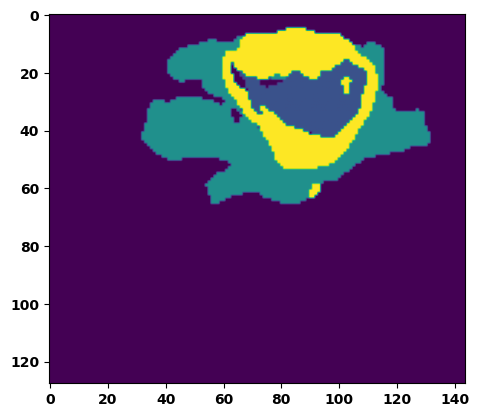

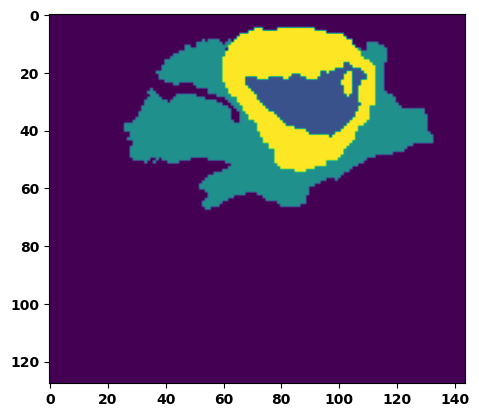

  6%|▌         | 2/36 [00:03<00:52,  1.55s/it]

Batch_id:  1 Eval loss:  0.07741905748844147
Batch_id:  1 Eval IoU:  tensor(0.8699, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:48,  1.46s/it]

Batch_id:  2 Eval loss:  0.08937546610832214
Batch_id:  2 Eval IoU:  tensor(0.8454, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 11%|█         | 4/36 [00:06<00:49,  1.55s/it]

Batch_id:  3 Eval loss:  0.7174409627914429
Batch_id:  3 Eval IoU:  tensor(0.2554, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9511, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9327, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9439, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9975, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.46s/it]

Batch_id:  4 Eval loss:  0.15839135646820068
Batch_id:  4 Eval IoU:  tensor(0.7497, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:42,  1.43s/it]

Batch_id:  5 Eval loss:  0.2868390679359436
Batch_id:  5 Eval IoU:  tensor(0.6134, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9557, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9394, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.46s/it]

Batch_id:  6 Eval loss:  0.20235131680965424
Batch_id:  6 Eval IoU:  tensor(0.6843, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9537, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9821, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.43s/it]

Batch_id:  7 Eval loss:  0.2876775860786438
Batch_id:  7 Eval IoU:  tensor(0.6471, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:40,  1.48s/it]

Batch_id:  8 Eval loss:  0.1447472870349884
Batch_id:  8 Eval IoU:  tensor(0.7837, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.48s/it]

Batch_id:  9 Eval loss:  0.1912378966808319
Batch_id:  9 Eval IoU:  tensor(0.7206, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  10 Eval loss:  0.22008034586906433
Batch_id:  10 Eval IoU:  tensor(0.6848, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9805, device='cuda:0')


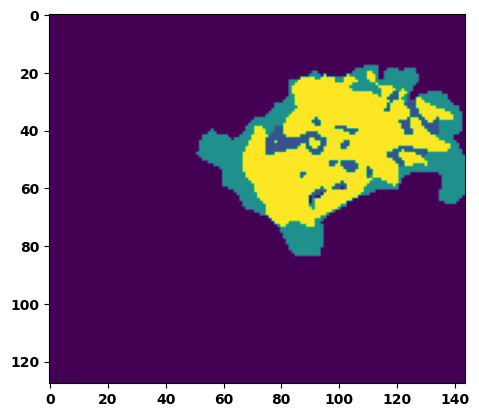

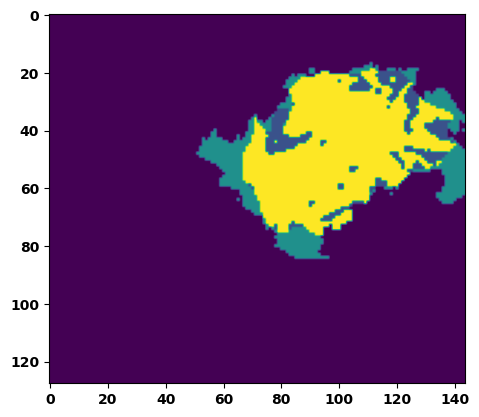

 33%|███▎      | 12/36 [00:17<00:36,  1.52s/it]

Batch_id:  11 Eval loss:  0.4035394489765167
Batch_id:  11 Eval IoU:  tensor(0.5312, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9067, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.8612, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.8606, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:33,  1.46s/it]

Batch_id:  12 Eval loss:  0.2523469924926758
Batch_id:  12 Eval IoU:  tensor(0.6983, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:31,  1.44s/it]

Batch_id:  13 Eval loss:  0.17819498479366302
Batch_id:  13 Eval IoU:  tensor(0.7266, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:30,  1.46s/it]

Batch_id:  14 Eval loss:  0.09872782230377197
Batch_id:  14 Eval IoU:  tensor(0.8633, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9956, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:30,  1.54s/it]

Batch_id:  15 Eval loss:  0.05822911858558655
Batch_id:  15 Eval IoU:  tensor(0.8994, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:28,  1.52s/it]

Batch_id:  16 Eval loss:  0.10555356740951538
Batch_id:  16 Eval IoU:  tensor(0.8212, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:27,  1.50s/it]

Batch_id:  17 Eval loss:  0.39334291219711304
Batch_id:  17 Eval IoU:  tensor(0.5351, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9978, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:25,  1.48s/it]

Batch_id:  18 Eval loss:  0.07908967137336731
Batch_id:  18 Eval IoU:  tensor(0.8628, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9910, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:24,  1.55s/it]

Batch_id:  19 Eval loss:  0.25308388471603394
Batch_id:  19 Eval IoU:  tensor(0.6544, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9463, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  20 Eval loss:  0.12696097791194916
Batch_id:  20 Eval IoU:  tensor(0.8026, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9601, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9434, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


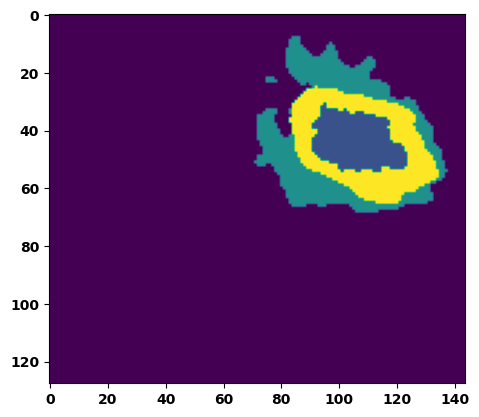

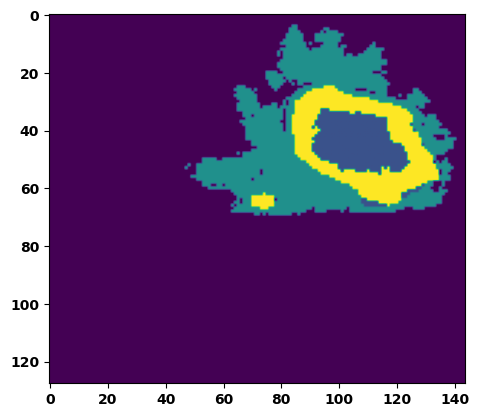

 61%|██████    | 22/36 [00:33<00:21,  1.56s/it]

Batch_id:  21 Eval loss:  0.08230890333652496
Batch_id:  21 Eval IoU:  tensor(0.8598, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9967, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:19,  1.49s/it]

Batch_id:  22 Eval loss:  0.39838284254074097
Batch_id:  22 Eval IoU:  tensor(0.4873, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9408, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9252, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9191, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9892, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.48s/it]

Batch_id:  23 Eval loss:  0.1888156533241272
Batch_id:  23 Eval IoU:  tensor(0.7213, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9961, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:16,  1.50s/it]

Batch_id:  24 Eval loss:  0.19245167076587677
Batch_id:  24 Eval IoU:  tensor(0.7124, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.45s/it]

Batch_id:  25 Eval loss:  0.2709651589393616
Batch_id:  25 Eval IoU:  tensor(0.6260, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9915, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:13,  1.47s/it]

Batch_id:  26 Eval loss:  0.23927094042301178
Batch_id:  26 Eval IoU:  tensor(0.6635, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.45s/it]

Batch_id:  27 Eval loss:  0.0636945515871048
Batch_id:  27 Eval IoU:  tensor(0.8978, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:09,  1.42s/it]

Batch_id:  28 Eval loss:  0.0945761650800705
Batch_id:  28 Eval IoU:  tensor(0.8427, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.45s/it]

Batch_id:  29 Eval loss:  0.3977878987789154
Batch_id:  29 Eval IoU:  tensor(0.5284, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  30 Eval loss:  0.48968279361724854
Batch_id:  30 Eval IoU:  tensor(0.4099, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9381, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9314, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9359, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9981, device='cuda:0')


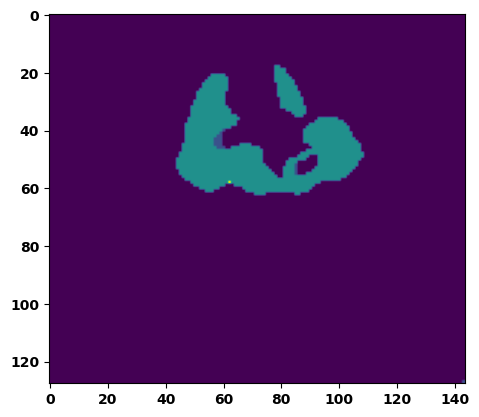

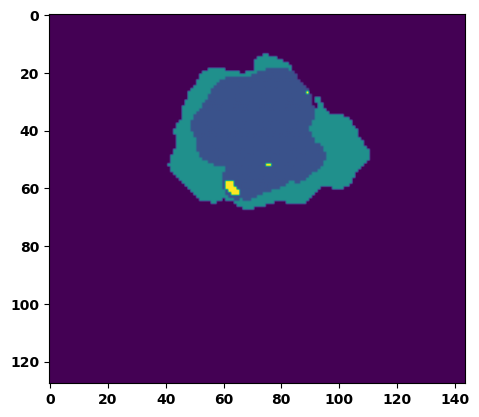

 89%|████████▉ | 32/36 [00:47<00:06,  1.52s/it]

Batch_id:  31 Eval loss:  0.14324676990509033
Batch_id:  31 Eval IoU:  tensor(0.7663, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9857, device='cuda:0')


 92%|█████████▏| 33/36 [00:49<00:04,  1.53s/it]

Batch_id:  32 Eval loss:  0.10044901072978973
Batch_id:  32 Eval IoU:  tensor(0.8276, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:03,  1.52s/it]

Batch_id:  33 Eval loss:  0.6000159978866577
Batch_id:  33 Eval IoU:  tensor(0.3517, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 97%|█████████▋| 35/36 [00:52<00:01,  1.50s/it]

Batch_id:  34 Eval loss:  0.19535350799560547
Batch_id:  34 Eval IoU:  tensor(0.7025, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9869, device='cuda:0')


100%|██████████| 36/36 [00:53<00:00,  1.49s/it]

Batch_id:  35 Eval loss:  0.07628369331359863
Batch_id:  35 Eval IoU:  tensor(0.8827, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')
Epoch  41 Training loss:  0.16524076692082665
Epoch  41 Evaluation loss:  0.22017682674858305
Epoch  41 Training accuracy :  tensor(0.7637)
Epoch  41 Evaluation accuracy :  tensor(0.7059)
Epoch  41 Training Mean Dice Score:  tensor(0.9813)
Epoch  41 Eval Mean Dice Score:  tensor(0.9736)
Epoch  41 Training Non-tumor Dice Score:  tensor(0.9827)
Epoch  41 Eval Non-tumor Dice Score:  tensor(0.9729)
Epoch  41 Training NCR/NET Dice Score:  tensor(0.9915)
Epoch  41 Eval NCR/NET Dice Score:  tensor(0.9872)
Epoch  41 Training ED Dice Score:  tensor(0.

Epoch: 42
Training in session: 


  1%|          | 1/110 [00:01<02:38,  1.46s/it]

Batch_id:  0 Training loss:  0.35007649660110474
Batch_id:  0 Training IoU:  tensor(0.5868, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:32,  1.41s/it]

Batch_id:  1 Training loss:  0.11210609972476959
Batch_id:  1 Training IoU:  tensor(0.8150, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9773, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:35,  1.45s/it]

Batch_id:  2 Training loss:  0.23123691976070404
Batch_id:  2 Training IoU:  tensor(0.6564, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:37,  1.48s/it]

Batch_id:  3 Training loss:  0.15008297562599182
Batch_id:  3 Training IoU:  tensor(0.7661, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:35,  1.48s/it]

Batch_id:  4 Training loss:  0.15544065833091736
Batch_id:  4 Training IoU:  tensor(0.7523, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9712, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:36,  1.51s/it]

Batch_id:  5 Training loss:  0.12827405333518982
Batch_id:  5 Training IoU:  tensor(0.8029, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:34,  1.50s/it]

Batch_id:  6 Training loss:  0.15332868695259094
Batch_id:  6 Training IoU:  tensor(0.7533, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:32,  1.50s/it]

Batch_id:  7 Training loss:  0.14134849607944489
Batch_id:  7 Training IoU:  tensor(0.7894, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:30,  1.49s/it]

Batch_id:  8 Training loss:  0.37725430727005005
Batch_id:  8 Training IoU:  tensor(0.5415, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:35,  1.55s/it]

Batch_id:  9 Training loss:  0.06460048258304596
Batch_id:  9 Training IoU:  tensor(0.8923, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 10%|█         | 11/110 [00:16<02:28,  1.50s/it]

Batch_id:  10 Training loss:  0.14337758719921112
Batch_id:  10 Training IoU:  tensor(0.7802, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 11%|█         | 12/110 [00:17<02:24,  1.48s/it]

Batch_id:  11 Training loss:  0.24325871467590332
Batch_id:  11 Training IoU:  tensor(0.6879, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:28,  1.53s/it]

Batch_id:  12 Training loss:  0.1304401457309723
Batch_id:  12 Training IoU:  tensor(0.8021, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:26,  1.53s/it]

Batch_id:  13 Training loss:  0.10112358629703522
Batch_id:  13 Training IoU:  tensor(0.8286, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:27,  1.55s/it]

Batch_id:  14 Training loss:  0.15518106520175934
Batch_id:  14 Training IoU:  tensor(0.7699, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:23,  1.53s/it]

Batch_id:  15 Training loss:  0.056422099471092224
Batch_id:  15 Training IoU:  tensor(0.9055, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:21,  1.53s/it]

Batch_id:  16 Training loss:  0.4525272846221924
Batch_id:  16 Training IoU:  tensor(0.4697, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:19,  1.51s/it]

Batch_id:  17 Training loss:  0.0601649284362793
Batch_id:  17 Training IoU:  tensor(0.8967, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:18,  1.52s/it]

Batch_id:  18 Training loss:  0.3941986560821533
Batch_id:  18 Training IoU:  tensor(0.5095, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9238, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:15,  1.51s/it]

Batch_id:  19 Training loss:  0.15372180938720703
Batch_id:  19 Training IoU:  tensor(0.7482, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:13,  1.50s/it]

Batch_id:  20 Training loss:  0.09212686121463776
Batch_id:  20 Training IoU:  tensor(0.8422, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 20%|██        | 22/110 [00:32<02:08,  1.46s/it]

Batch_id:  21 Training loss:  0.21746926009655
Batch_id:  21 Training IoU:  tensor(0.6839, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 21%|██        | 23/110 [00:34<02:06,  1.46s/it]

Batch_id:  22 Training loss:  0.045318603515625
Batch_id:  22 Training IoU:  tensor(0.9212, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:05,  1.46s/it]

Batch_id:  23 Training loss:  0.10661524534225464
Batch_id:  23 Training IoU:  tensor(0.8375, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9920, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:04,  1.46s/it]

Batch_id:  24 Training loss:  0.12506818771362305
Batch_id:  24 Training IoU:  tensor(0.7996, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:07,  1.52s/it]

Batch_id:  25 Training loss:  0.0891101211309433
Batch_id:  25 Training IoU:  tensor(0.8476, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 25%|██▍       | 27/110 [00:40<02:04,  1.50s/it]

Batch_id:  26 Training loss:  0.0849258303642273
Batch_id:  26 Training IoU:  tensor(0.8542, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 25%|██▌       | 28/110 [00:42<02:09,  1.58s/it]

Batch_id:  27 Training loss:  0.07685212790966034
Batch_id:  27 Training IoU:  tensor(0.8817, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 26%|██▋       | 29/110 [00:43<02:06,  1.56s/it]

Batch_id:  28 Training loss:  0.3215811550617218
Batch_id:  28 Training IoU:  tensor(0.6434, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 27%|██▋       | 30/110 [00:45<02:07,  1.59s/it]

Batch_id:  29 Training loss:  0.09730951488018036
Batch_id:  29 Training IoU:  tensor(0.8360, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 28%|██▊       | 31/110 [00:46<02:02,  1.55s/it]

Batch_id:  30 Training loss:  0.23708850145339966
Batch_id:  30 Training IoU:  tensor(0.6601, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 29%|██▉       | 32/110 [00:48<01:57,  1.51s/it]

Batch_id:  31 Training loss:  0.19646134972572327
Batch_id:  31 Training IoU:  tensor(0.7030, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 30%|███       | 33/110 [00:49<01:58,  1.53s/it]

Batch_id:  32 Training loss:  0.17937098443508148
Batch_id:  32 Training IoU:  tensor(0.7340, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 31%|███       | 34/110 [00:51<01:56,  1.53s/it]

Batch_id:  33 Training loss:  0.236657053232193
Batch_id:  33 Training IoU:  tensor(0.6502, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9352, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9764, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:51,  1.49s/it]

Batch_id:  34 Training loss:  0.24247494339942932
Batch_id:  34 Training IoU:  tensor(0.6415, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9768, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:50,  1.49s/it]

Batch_id:  35 Training loss:  0.09121555089950562
Batch_id:  35 Training IoU:  tensor(0.8433, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 34%|███▎      | 37/110 [00:55<01:48,  1.48s/it]

Batch_id:  36 Training loss:  0.16009774804115295
Batch_id:  36 Training IoU:  tensor(0.7872, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 35%|███▍      | 38/110 [00:57<01:44,  1.45s/it]

Batch_id:  37 Training loss:  0.20790748298168182
Batch_id:  37 Training IoU:  tensor(0.6881, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 35%|███▌      | 39/110 [00:58<01:41,  1.43s/it]

Batch_id:  38 Training loss:  0.13094395399093628
Batch_id:  38 Training IoU:  tensor(0.8081, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 36%|███▋      | 40/110 [00:59<01:38,  1.41s/it]

Batch_id:  39 Training loss:  0.211033433675766
Batch_id:  39 Training IoU:  tensor(0.6840, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:37,  1.41s/it]

Batch_id:  40 Training loss:  0.3210632801055908
Batch_id:  40 Training IoU:  tensor(0.6171, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9504, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:36,  1.41s/it]

Batch_id:  41 Training loss:  0.12320505082607269
Batch_id:  41 Training IoU:  tensor(0.8038, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:36,  1.43s/it]

Batch_id:  42 Training loss:  0.1783418506383896
Batch_id:  42 Training IoU:  tensor(0.7340, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 40%|████      | 44/110 [01:05<01:33,  1.41s/it]

Batch_id:  43 Training loss:  0.1555119901895523
Batch_id:  43 Training IoU:  tensor(0.7809, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 41%|████      | 45/110 [01:06<01:31,  1.41s/it]

Batch_id:  44 Training loss:  0.10340982675552368
Batch_id:  44 Training IoU:  tensor(0.8253, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:32,  1.44s/it]

Batch_id:  45 Training loss:  0.1662406027317047
Batch_id:  45 Training IoU:  tensor(0.8033, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 43%|████▎     | 47/110 [01:10<01:35,  1.52s/it]

Batch_id:  46 Training loss:  0.09738399088382721
Batch_id:  46 Training IoU:  tensor(0.8372, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:31,  1.48s/it]

Batch_id:  47 Training loss:  0.19484764337539673
Batch_id:  47 Training IoU:  tensor(0.7106, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9600, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


 45%|████▍     | 49/110 [01:13<01:32,  1.52s/it]

Batch_id:  48 Training loss:  0.20096607506275177
Batch_id:  48 Training IoU:  tensor(0.6990, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 45%|████▌     | 50/110 [01:14<01:30,  1.51s/it]

Batch_id:  49 Training loss:  0.26439547538757324
Batch_id:  49 Training IoU:  tensor(0.6477, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 46%|████▋     | 51/110 [01:16<01:30,  1.53s/it]

Batch_id:  50 Training loss:  0.16905267536640167
Batch_id:  50 Training IoU:  tensor(0.7283, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 47%|████▋     | 52/110 [01:17<01:25,  1.47s/it]

Batch_id:  51 Training loss:  0.14961998164653778
Batch_id:  51 Training IoU:  tensor(0.7589, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 48%|████▊     | 53/110 [01:19<01:24,  1.48s/it]

Batch_id:  52 Training loss:  0.15696656703948975
Batch_id:  52 Training IoU:  tensor(0.8080, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 49%|████▉     | 54/110 [01:20<01:21,  1.45s/it]

Batch_id:  53 Training loss:  0.09388069808483124
Batch_id:  53 Training IoU:  tensor(0.8367, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:21,  1.47s/it]

Batch_id:  54 Training loss:  0.16798673570156097
Batch_id:  54 Training IoU:  tensor(0.8227, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 51%|█████     | 56/110 [01:23<01:18,  1.45s/it]

Batch_id:  55 Training loss:  0.18787755072116852
Batch_id:  55 Training IoU:  tensor(0.7209, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9822, device='cuda:0')


 52%|█████▏    | 57/110 [01:25<01:20,  1.51s/it]

Batch_id:  56 Training loss:  0.07882958650588989
Batch_id:  56 Training IoU:  tensor(0.8688, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 53%|█████▎    | 58/110 [01:26<01:19,  1.53s/it]

Batch_id:  57 Training loss:  0.10754431784152985
Batch_id:  57 Training IoU:  tensor(0.8270, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 54%|█████▎    | 59/110 [01:28<01:18,  1.55s/it]

Batch_id:  58 Training loss:  0.04565587639808655
Batch_id:  58 Training IoU:  tensor(0.9203, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 55%|█████▍    | 60/110 [01:29<01:17,  1.54s/it]

Batch_id:  59 Training loss:  0.1420624554157257
Batch_id:  59 Training IoU:  tensor(0.7688, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 55%|█████▌    | 61/110 [01:31<01:15,  1.53s/it]

Batch_id:  60 Training loss:  0.18612727522850037
Batch_id:  60 Training IoU:  tensor(0.7154, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 56%|█████▋    | 62/110 [01:32<01:12,  1.51s/it]

Batch_id:  61 Training loss:  0.09050464630126953
Batch_id:  61 Training IoU:  tensor(0.8440, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 57%|█████▋    | 63/110 [01:34<01:10,  1.49s/it]

Batch_id:  62 Training loss:  0.10488252341747284
Batch_id:  62 Training IoU:  tensor(0.8326, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 58%|█████▊    | 64/110 [01:35<01:07,  1.47s/it]

Batch_id:  63 Training loss:  0.25874271988868713
Batch_id:  63 Training IoU:  tensor(0.6339, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9305, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 59%|█████▉    | 65/110 [01:36<01:05,  1.45s/it]

Batch_id:  64 Training loss:  0.09648795425891876
Batch_id:  64 Training IoU:  tensor(0.8382, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 60%|██████    | 66/110 [01:38<01:04,  1.46s/it]

Batch_id:  65 Training loss:  0.2026357799768448
Batch_id:  65 Training IoU:  tensor(0.6895, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9245, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 61%|██████    | 67/110 [01:39<01:02,  1.44s/it]

Batch_id:  66 Training loss:  0.18318915367126465
Batch_id:  66 Training IoU:  tensor(0.7198, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 62%|██████▏   | 68/110 [01:41<01:00,  1.45s/it]

Batch_id:  67 Training loss:  0.1869327425956726
Batch_id:  67 Training IoU:  tensor(0.7124, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9738, device='cuda:0')


 63%|██████▎   | 69/110 [01:42<01:00,  1.48s/it]

Batch_id:  68 Training loss:  0.21933116018772125
Batch_id:  68 Training IoU:  tensor(0.7278, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 64%|██████▎   | 70/110 [01:44<00:59,  1.49s/it]

Batch_id:  69 Training loss:  0.14114175736904144
Batch_id:  69 Training IoU:  tensor(0.7659, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9744, device='cuda:0')


 65%|██████▍   | 71/110 [01:45<00:57,  1.47s/it]

Batch_id:  70 Training loss:  0.2494322508573532
Batch_id:  70 Training IoU:  tensor(0.6510, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9832, device='cuda:0')


 65%|██████▌   | 72/110 [01:47<00:55,  1.47s/it]

Batch_id:  71 Training loss:  0.08602994680404663
Batch_id:  71 Training IoU:  tensor(0.8518, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 66%|██████▋   | 73/110 [01:48<00:54,  1.48s/it]

Batch_id:  72 Training loss:  0.17881250381469727
Batch_id:  72 Training IoU:  tensor(0.7169, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 67%|██████▋   | 74/110 [01:50<00:52,  1.45s/it]

Batch_id:  73 Training loss:  0.08600784838199615
Batch_id:  73 Training IoU:  tensor(0.8649, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 68%|██████▊   | 75/110 [01:51<00:49,  1.42s/it]

Batch_id:  74 Training loss:  0.08985316753387451
Batch_id:  74 Training IoU:  tensor(0.8470, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 69%|██████▉   | 76/110 [01:53<00:49,  1.46s/it]

Batch_id:  75 Training loss:  0.3449377417564392
Batch_id:  75 Training IoU:  tensor(0.6306, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 70%|███████   | 77/110 [01:54<00:49,  1.49s/it]

Batch_id:  76 Training loss:  0.08953601121902466
Batch_id:  76 Training IoU:  tensor(0.8505, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 71%|███████   | 78/110 [01:56<00:48,  1.51s/it]

Batch_id:  77 Training loss:  0.244201198220253
Batch_id:  77 Training IoU:  tensor(0.7111, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:47,  1.53s/it]

Batch_id:  78 Training loss:  0.5242742300033569
Batch_id:  78 Training IoU:  tensor(0.4230, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 73%|███████▎  | 80/110 [01:59<00:47,  1.58s/it]

Batch_id:  79 Training loss:  0.26731833815574646
Batch_id:  79 Training IoU:  tensor(0.6845, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 74%|███████▎  | 81/110 [02:01<00:46,  1.60s/it]

Batch_id:  80 Training loss:  0.12473361194133759
Batch_id:  80 Training IoU:  tensor(0.8135, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 75%|███████▍  | 82/110 [02:02<00:42,  1.51s/it]

Batch_id:  81 Training loss:  0.06855720281600952
Batch_id:  81 Training IoU:  tensor(0.8804, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 75%|███████▌  | 83/110 [02:03<00:40,  1.50s/it]

Batch_id:  82 Training loss:  0.20902036130428314
Batch_id:  82 Training IoU:  tensor(0.7186, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 76%|███████▋  | 84/110 [02:05<00:38,  1.47s/it]

Batch_id:  83 Training loss:  0.09196500480175018
Batch_id:  83 Training IoU:  tensor(0.8456, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 77%|███████▋  | 85/110 [02:06<00:36,  1.44s/it]

Batch_id:  84 Training loss:  0.28090018033981323
Batch_id:  84 Training IoU:  tensor(0.6638, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 78%|███████▊  | 86/110 [02:08<00:35,  1.47s/it]

Batch_id:  85 Training loss:  0.27378904819488525
Batch_id:  85 Training IoU:  tensor(0.6299, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9575, device='cuda:0')


 79%|███████▉  | 87/110 [02:09<00:33,  1.48s/it]

Batch_id:  86 Training loss:  0.12168097496032715
Batch_id:  86 Training IoU:  tensor(0.8060, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 80%|████████  | 88/110 [02:11<00:31,  1.43s/it]

Batch_id:  87 Training loss:  0.09319622814655304
Batch_id:  87 Training IoU:  tensor(0.8494, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 81%|████████  | 89/110 [02:12<00:30,  1.46s/it]

Batch_id:  88 Training loss:  0.04084843397140503
Batch_id:  88 Training IoU:  tensor(0.9294, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 82%|████████▏ | 90/110 [02:14<00:30,  1.55s/it]

Batch_id:  89 Training loss:  0.1390846222639084
Batch_id:  89 Training IoU:  tensor(0.8134, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 83%|████████▎ | 91/110 [02:15<00:28,  1.50s/it]

Batch_id:  90 Training loss:  0.1076531708240509
Batch_id:  90 Training IoU:  tensor(0.8214, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 84%|████████▎ | 92/110 [02:17<00:27,  1.50s/it]

Batch_id:  91 Training loss:  0.21206271648406982
Batch_id:  91 Training IoU:  tensor(0.6822, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 85%|████████▍ | 93/110 [02:18<00:25,  1.47s/it]

Batch_id:  92 Training loss:  0.11479911208152771
Batch_id:  92 Training IoU:  tensor(0.8176, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 85%|████████▌ | 94/110 [02:20<00:24,  1.51s/it]

Batch_id:  93 Training loss:  0.1073848307132721
Batch_id:  93 Training IoU:  tensor(0.8208, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 86%|████████▋ | 95/110 [02:21<00:22,  1.47s/it]

Batch_id:  94 Training loss:  0.08985473215579987
Batch_id:  94 Training IoU:  tensor(0.8489, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 87%|████████▋ | 96/110 [02:23<00:20,  1.49s/it]

Batch_id:  95 Training loss:  0.07311224937438965
Batch_id:  95 Training IoU:  tensor(0.8726, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 88%|████████▊ | 97/110 [02:24<00:18,  1.42s/it]

Batch_id:  96 Training loss:  0.1295272558927536
Batch_id:  96 Training IoU:  tensor(0.7938, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 89%|████████▉ | 98/110 [02:25<00:17,  1.47s/it]

Batch_id:  97 Training loss:  0.08994665741920471
Batch_id:  97 Training IoU:  tensor(0.8524, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 90%|█████████ | 99/110 [02:27<00:16,  1.48s/it]

Batch_id:  98 Training loss:  0.0491250604391098
Batch_id:  98 Training IoU:  tensor(0.9202, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:14,  1.48s/it]

Batch_id:  99 Training loss:  0.0838671326637268
Batch_id:  99 Training IoU:  tensor(0.8824, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 92%|█████████▏| 101/110 [02:30<00:13,  1.45s/it]

Batch_id:  100 Training loss:  0.16902083158493042
Batch_id:  100 Training IoU:  tensor(0.7364, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 93%|█████████▎| 102/110 [02:31<00:11,  1.45s/it]

Batch_id:  101 Training loss:  0.22086401283740997
Batch_id:  101 Training IoU:  tensor(0.7292, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 94%|█████████▎| 103/110 [02:33<00:09,  1.42s/it]

Batch_id:  102 Training loss:  0.15969593822956085
Batch_id:  102 Training IoU:  tensor(0.7439, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 95%|█████████▍| 104/110 [02:34<00:08,  1.43s/it]

Batch_id:  103 Training loss:  0.1372644007205963
Batch_id:  103 Training IoU:  tensor(0.7995, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 95%|█████████▌| 105/110 [02:36<00:07,  1.48s/it]

Batch_id:  104 Training loss:  0.3293033242225647
Batch_id:  104 Training IoU:  tensor(0.6153, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 96%|█████████▋| 106/110 [02:37<00:05,  1.48s/it]

Batch_id:  105 Training loss:  0.14864780008792877
Batch_id:  105 Training IoU:  tensor(0.7597, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 97%|█████████▋| 107/110 [02:39<00:04,  1.50s/it]

Batch_id:  106 Training loss:  0.058518186211586
Batch_id:  106 Training IoU:  tensor(0.8993, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 98%|█████████▊| 108/110 [02:40<00:02,  1.45s/it]

Batch_id:  107 Training loss:  0.12189304828643799
Batch_id:  107 Training IoU:  tensor(0.7987, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9865, device='cuda:0')


 99%|█████████▉| 109/110 [02:42<00:01,  1.47s/it]

Batch_id:  108 Training loss:  0.12940947711467743
Batch_id:  108 Training IoU:  tensor(0.7872, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


100%|██████████| 110/110 [02:43<00:00,  1.49s/it]


Batch_id:  109 Training loss:  0.24948270618915558
Batch_id:  109 Training IoU:  tensor(0.6508, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9952, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.5979756116867065
Batch_id:  0 Eval IoU:  tensor(0.3549, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


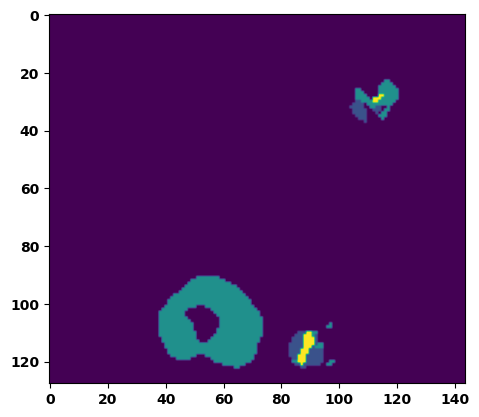

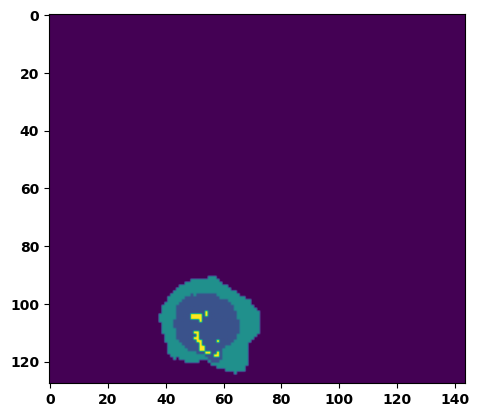

  6%|▌         | 2/36 [00:03<00:53,  1.58s/it]

Batch_id:  1 Eval loss:  0.15047861635684967
Batch_id:  1 Eval IoU:  tensor(0.7566, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9848, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:47,  1.44s/it]

Batch_id:  2 Eval loss:  0.14243197441101074
Batch_id:  2 Eval IoU:  tensor(0.7869, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9961, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


 11%|█         | 4/36 [00:05<00:46,  1.46s/it]

Batch_id:  3 Eval loss:  0.2892715036869049
Batch_id:  3 Eval IoU:  tensor(0.6470, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:44,  1.43s/it]

Batch_id:  4 Eval loss:  0.1538436859846115
Batch_id:  4 Eval IoU:  tensor(0.7554, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:44,  1.47s/it]

Batch_id:  5 Eval loss:  0.18018925189971924
Batch_id:  5 Eval IoU:  tensor(0.7247, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:41,  1.43s/it]

Batch_id:  6 Eval loss:  0.20990630984306335
Batch_id:  6 Eval IoU:  tensor(0.6748, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9472, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9543, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9814, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.46s/it]

Batch_id:  7 Eval loss:  0.20082716643810272
Batch_id:  7 Eval IoU:  tensor(0.7009, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:39,  1.48s/it]

Batch_id:  8 Eval loss:  0.19032903015613556
Batch_id:  8 Eval IoU:  tensor(0.7209, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.49s/it]

Batch_id:  9 Eval loss:  0.2400253564119339
Batch_id:  9 Eval IoU:  tensor(0.6612, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  10 Eval loss:  0.058603301644325256
Batch_id:  10 Eval IoU:  tensor(0.8992, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


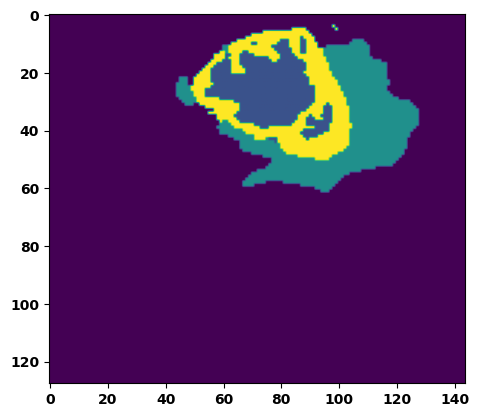

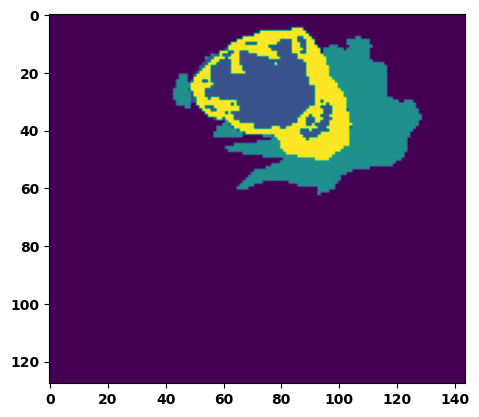

 33%|███▎      | 12/36 [00:18<00:37,  1.57s/it]

Batch_id:  11 Eval loss:  0.22506587207317352
Batch_id:  11 Eval IoU:  tensor(0.6796, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9812, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.52s/it]

Batch_id:  12 Eval loss:  0.289142906665802
Batch_id:  12 Eval IoU:  tensor(0.6119, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9393, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9928, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:35,  1.60s/it]

Batch_id:  13 Eval loss:  0.7200697660446167
Batch_id:  13 Eval IoU:  tensor(0.2541, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9332, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.51s/it]

Batch_id:  14 Eval loss:  0.061239093542099
Batch_id:  14 Eval IoU:  tensor(0.9019, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9953, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:29,  1.50s/it]

Batch_id:  15 Eval loss:  0.18952177464962006
Batch_id:  15 Eval IoU:  tensor(0.7215, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:27,  1.47s/it]

Batch_id:  16 Eval loss:  0.08096756041049957
Batch_id:  16 Eval IoU:  tensor(0.8593, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 50%|█████     | 18/36 [00:27<00:26,  1.47s/it]

Batch_id:  17 Eval loss:  0.40434324741363525
Batch_id:  17 Eval IoU:  tensor(0.5207, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9929, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:25,  1.51s/it]

Batch_id:  18 Eval loss:  0.2579078674316406
Batch_id:  18 Eval IoU:  tensor(0.6495, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9455, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 56%|█████▌    | 20/36 [00:30<00:23,  1.49s/it]

Batch_id:  19 Eval loss:  0.09044328331947327
Batch_id:  19 Eval IoU:  tensor(0.8492, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  20 Eval loss:  0.10134488344192505
Batch_id:  20 Eval IoU:  tensor(0.8263, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


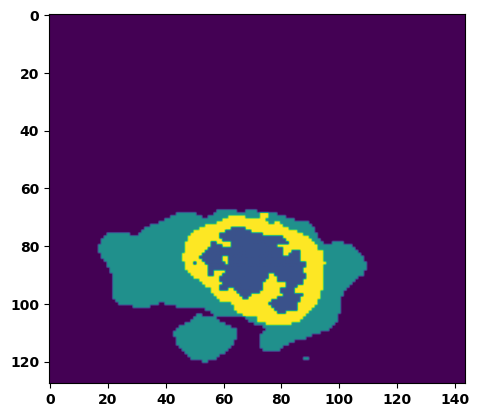

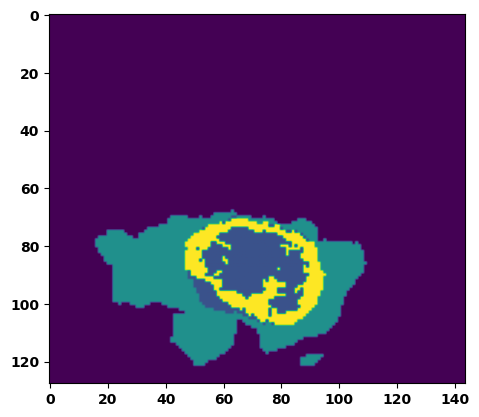

 61%|██████    | 22/36 [00:33<00:22,  1.57s/it]

Batch_id:  21 Eval loss:  0.08843246102333069
Batch_id:  21 Eval IoU:  tensor(0.8469, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9902, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:20,  1.55s/it]

Batch_id:  22 Eval loss:  0.4069257974624634
Batch_id:  22 Eval IoU:  tensor(0.5279, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9054, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.8592, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.8586, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 67%|██████▋   | 24/36 [00:36<00:18,  1.50s/it]

Batch_id:  23 Eval loss:  0.2571561336517334
Batch_id:  23 Eval IoU:  tensor(0.6947, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 69%|██████▉   | 25/36 [00:37<00:16,  1.52s/it]

Batch_id:  24 Eval loss:  0.3980208933353424
Batch_id:  24 Eval IoU:  tensor(0.4890, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9252, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9190, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


 72%|███████▏  | 26/36 [00:39<00:14,  1.43s/it]

Batch_id:  25 Eval loss:  0.06802693009376526
Batch_id:  25 Eval IoU:  tensor(0.8832, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 75%|███████▌  | 27/36 [00:40<00:12,  1.41s/it]

Batch_id:  26 Eval loss:  0.13015975058078766
Batch_id:  26 Eval IoU:  tensor(0.7983, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9592, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9447, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.38s/it]

Batch_id:  27 Eval loss:  0.07342448830604553
Batch_id:  27 Eval IoU:  tensor(0.8879, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 81%|████████  | 29/36 [00:43<00:09,  1.40s/it]

Batch_id:  28 Eval loss:  0.0923532247543335
Batch_id:  28 Eval IoU:  tensor(0.8735, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.41s/it]

Batch_id:  29 Eval loss:  0.38912588357925415
Batch_id:  29 Eval IoU:  tensor(0.5408, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  30 Eval loss:  0.5022342801094055
Batch_id:  30 Eval IoU:  tensor(0.4052, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9362, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9301, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


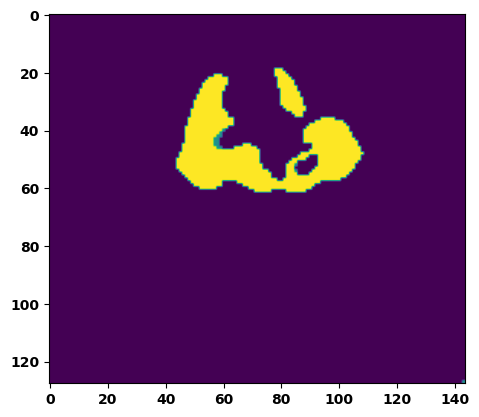

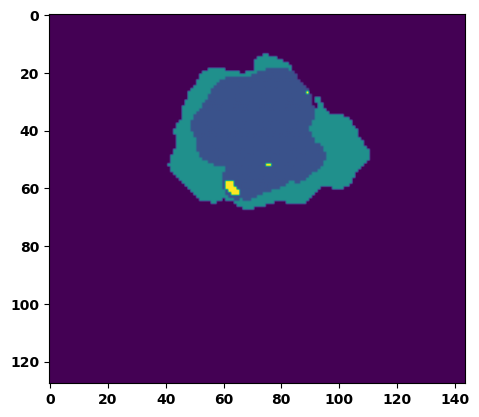

 89%|████████▉ | 32/36 [00:47<00:05,  1.50s/it]

Batch_id:  31 Eval loss:  0.1970655471086502
Batch_id:  31 Eval IoU:  tensor(0.7008, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


 92%|█████████▏| 33/36 [00:49<00:04,  1.47s/it]

Batch_id:  32 Eval loss:  0.3026124835014343
Batch_id:  32 Eval IoU:  tensor(0.5953, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9353, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:03,  1.51s/it]

Batch_id:  33 Eval loss:  0.10342100262641907
Batch_id:  33 Eval IoU:  tensor(0.8251, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 97%|█████████▋| 35/36 [00:52<00:01,  1.52s/it]

Batch_id:  34 Eval loss:  0.08059293031692505
Batch_id:  34 Eval IoU:  tensor(0.8631, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9970, device='cuda:0')


100%|██████████| 36/36 [00:53<00:00,  1.49s/it]

Batch_id:  35 Eval loss:  0.07816584408283234
Batch_id:  35 Eval IoU:  tensor(0.8680, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')
Epoch 00043: reducing learning rate of group 0 to 7.8125e-06.
Epoch  42 Training loss:  0.16422020413658836
Epoch  42 Evaluation loss:  0.22226793650123808
Epoch  42 Training accuracy :  tensor(0.7647)
Epoch  42 Evaluation accuracy :  tensor(0.7043)
Epoch  42 Training Mean Dice Score:  tensor(0.9814)
Epoch  42 Eval Mean Dice Score:  tensor(0.9735)
Epoch  42 Training Non-tumor Dice Score:  tensor(0.9829)
Epoch  42 Eval Non-tumor Dice Score:  tensor(0.9725)
Epoch  42 Training NCR/NET Dice Score:  tensor(0.9915)
Epoch  42 Eval NCR/NET Dice Score

Epoch completed and model successfully saved
Epoch: 43
Training in session: 


  1%|          | 1/110 [00:01<02:30,  1.38s/it]

Batch_id:  0 Training loss:  0.31700849533081055
Batch_id:  0 Training IoU:  tensor(0.6531, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:31,  1.41s/it]

Batch_id:  1 Training loss:  0.17307983338832855
Batch_id:  1 Training IoU:  tensor(0.7242, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:41,  1.51s/it]

Batch_id:  2 Training loss:  0.20785072445869446
Batch_id:  2 Training IoU:  tensor(0.6893, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:45,  1.56s/it]

Batch_id:  3 Training loss:  0.09043000638484955
Batch_id:  3 Training IoU:  tensor(0.8445, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:43,  1.56s/it]

Batch_id:  4 Training loss:  0.12332998216152191
Batch_id:  4 Training IoU:  tensor(0.8145, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:35,  1.50s/it]

Batch_id:  5 Training loss:  0.1591247171163559
Batch_id:  5 Training IoU:  tensor(0.7485, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9707, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:38,  1.54s/it]

Batch_id:  6 Training loss:  0.20919209718704224
Batch_id:  6 Training IoU:  tensor(0.6864, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:37,  1.54s/it]

Batch_id:  7 Training loss:  0.14997145533561707
Batch_id:  7 Training IoU:  tensor(0.7862, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:36,  1.55s/it]

Batch_id:  8 Training loss:  0.08552443981170654
Batch_id:  8 Training IoU:  tensor(0.8660, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:31,  1.51s/it]

Batch_id:  9 Training loss:  0.12342120707035065
Batch_id:  9 Training IoU:  tensor(0.8020, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 10%|█         | 11/110 [00:16<02:26,  1.48s/it]

Batch_id:  10 Training loss:  0.13835041224956512
Batch_id:  10 Training IoU:  tensor(0.7857, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 11%|█         | 12/110 [00:18<02:30,  1.53s/it]

Batch_id:  11 Training loss:  0.10767477750778198
Batch_id:  11 Training IoU:  tensor(0.8193, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9543, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:26,  1.51s/it]

Batch_id:  12 Training loss:  0.08594505488872528
Batch_id:  12 Training IoU:  tensor(0.8519, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9835, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:30,  1.57s/it]

Batch_id:  13 Training loss:  0.04654310643672943
Batch_id:  13 Training IoU:  tensor(0.9183, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:26,  1.54s/it]

Batch_id:  14 Training loss:  0.12892143428325653
Batch_id:  14 Training IoU:  tensor(0.7884, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:22,  1.52s/it]

Batch_id:  15 Training loss:  0.17646127939224243
Batch_id:  15 Training IoU:  tensor(0.7297, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:20,  1.51s/it]

Batch_id:  16 Training loss:  0.10748055577278137
Batch_id:  16 Training IoU:  tensor(0.8282, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9627, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:16,  1.48s/it]

Batch_id:  17 Training loss:  0.46214425563812256
Batch_id:  17 Training IoU:  tensor(0.4598, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:21,  1.56s/it]

Batch_id:  18 Training loss:  0.09928083419799805
Batch_id:  18 Training IoU:  tensor(0.8481, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:18,  1.54s/it]

Batch_id:  19 Training loss:  0.1906972974538803
Batch_id:  19 Training IoU:  tensor(0.7073, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9405, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9732, device='cuda:0')


 19%|█▉        | 21/110 [00:32<02:16,  1.53s/it]

Batch_id:  20 Training loss:  0.07191552221775055
Batch_id:  20 Training IoU:  tensor(0.8745, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 20%|██        | 22/110 [00:33<02:14,  1.53s/it]

Batch_id:  21 Training loss:  0.21161581575870514
Batch_id:  21 Training IoU:  tensor(0.6827, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 21%|██        | 23/110 [00:35<02:13,  1.54s/it]

Batch_id:  22 Training loss:  0.3828139305114746
Batch_id:  22 Training IoU:  tensor(0.5369, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:11,  1.53s/it]

Batch_id:  23 Training loss:  0.39349591732025146
Batch_id:  23 Training IoU:  tensor(0.5102, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9240, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 23%|██▎       | 25/110 [00:38<02:08,  1.52s/it]

Batch_id:  24 Training loss:  0.14490282535552979
Batch_id:  24 Training IoU:  tensor(0.7661, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:07,  1.52s/it]

Batch_id:  25 Training loss:  0.14880014955997467
Batch_id:  25 Training IoU:  tensor(0.7596, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9889, device='cuda:0')


 25%|██▍       | 27/110 [00:40<02:02,  1.48s/it]

Batch_id:  26 Training loss:  0.05524732172489166
Batch_id:  26 Training IoU:  tensor(0.9067, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 25%|██▌       | 28/110 [00:42<01:59,  1.46s/it]

Batch_id:  27 Training loss:  0.13624094426631927
Batch_id:  27 Training IoU:  tensor(0.7724, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9750, device='cuda:0')


 26%|██▋       | 29/110 [00:43<01:58,  1.46s/it]

Batch_id:  28 Training loss:  0.24322237074375153
Batch_id:  28 Training IoU:  tensor(0.7133, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 27%|██▋       | 30/110 [00:45<02:04,  1.55s/it]

Batch_id:  29 Training loss:  0.2137613445520401
Batch_id:  29 Training IoU:  tensor(0.7360, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 28%|██▊       | 31/110 [00:47<02:02,  1.55s/it]

Batch_id:  30 Training loss:  0.5237123370170593
Batch_id:  30 Training IoU:  tensor(0.4247, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 29%|██▉       | 32/110 [00:48<02:01,  1.56s/it]

Batch_id:  31 Training loss:  0.13940903544425964
Batch_id:  31 Training IoU:  tensor(0.7921, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 30%|███       | 33/110 [00:50<02:00,  1.57s/it]

Batch_id:  32 Training loss:  0.09270992875099182
Batch_id:  32 Training IoU:  tensor(0.8442, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


 31%|███       | 34/110 [00:51<01:57,  1.54s/it]

Batch_id:  33 Training loss:  0.2006063461303711
Batch_id:  33 Training IoU:  tensor(0.6977, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 32%|███▏      | 35/110 [00:53<01:57,  1.56s/it]

Batch_id:  34 Training loss:  0.08326001465320587
Batch_id:  34 Training IoU:  tensor(0.8837, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:53,  1.54s/it]

Batch_id:  35 Training loss:  0.1220054030418396
Batch_id:  35 Training IoU:  tensor(0.8054, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 34%|███▎      | 37/110 [00:56<01:50,  1.52s/it]

Batch_id:  36 Training loss:  0.180573508143425
Batch_id:  36 Training IoU:  tensor(0.7219, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9660, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 35%|███▍      | 38/110 [00:57<01:50,  1.53s/it]

Batch_id:  37 Training loss:  0.12664814293384552
Batch_id:  37 Training IoU:  tensor(0.8054, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 35%|███▌      | 39/110 [00:59<01:48,  1.53s/it]

Batch_id:  38 Training loss:  0.0878095030784607
Batch_id:  38 Training IoU:  tensor(0.8543, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 36%|███▋      | 40/110 [01:01<01:47,  1.54s/it]

Batch_id:  39 Training loss:  0.10860943794250488
Batch_id:  39 Training IoU:  tensor(0.8254, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 37%|███▋      | 41/110 [01:02<01:45,  1.53s/it]

Batch_id:  40 Training loss:  0.09741221368312836
Batch_id:  40 Training IoU:  tensor(0.8379, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 38%|███▊      | 42/110 [01:04<01:43,  1.53s/it]

Batch_id:  41 Training loss:  0.14354541897773743
Batch_id:  41 Training IoU:  tensor(0.7749, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 39%|███▉      | 43/110 [01:05<01:40,  1.50s/it]

Batch_id:  42 Training loss:  0.3491477370262146
Batch_id:  42 Training IoU:  tensor(0.5893, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 40%|████      | 44/110 [01:06<01:38,  1.49s/it]

Batch_id:  43 Training loss:  0.12060630321502686
Batch_id:  43 Training IoU:  tensor(0.8061, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 41%|████      | 45/110 [01:08<01:40,  1.55s/it]

Batch_id:  44 Training loss:  0.07817122340202332
Batch_id:  44 Training IoU:  tensor(0.8709, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 42%|████▏     | 46/110 [01:10<01:36,  1.50s/it]

Batch_id:  45 Training loss:  0.15968522429466248
Batch_id:  45 Training IoU:  tensor(0.7633, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9634, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 43%|████▎     | 47/110 [01:11<01:35,  1.52s/it]

Batch_id:  46 Training loss:  0.04962235689163208
Batch_id:  46 Training IoU:  tensor(0.9195, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 44%|████▎     | 48/110 [01:13<01:32,  1.50s/it]

Batch_id:  47 Training loss:  0.1694028079509735
Batch_id:  47 Training IoU:  tensor(0.7469, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 45%|████▍     | 49/110 [01:14<01:29,  1.46s/it]

Batch_id:  48 Training loss:  0.21698613464832306
Batch_id:  48 Training IoU:  tensor(0.7326, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 45%|████▌     | 50/110 [01:15<01:26,  1.45s/it]

Batch_id:  49 Training loss:  0.2759385406970978
Batch_id:  49 Training IoU:  tensor(0.6673, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 46%|████▋     | 51/110 [01:17<01:26,  1.46s/it]

Batch_id:  50 Training loss:  0.33010828495025635
Batch_id:  50 Training IoU:  tensor(0.6142, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 47%|████▋     | 52/110 [01:18<01:22,  1.42s/it]

Batch_id:  51 Training loss:  0.09542691707611084
Batch_id:  51 Training IoU:  tensor(0.8378, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 48%|████▊     | 53/110 [01:20<01:21,  1.43s/it]

Batch_id:  52 Training loss:  0.05529634654521942
Batch_id:  52 Training IoU:  tensor(0.9050, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 49%|████▉     | 54/110 [01:21<01:20,  1.44s/it]

Batch_id:  53 Training loss:  0.08842335641384125
Batch_id:  53 Training IoU:  tensor(0.8481, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 50%|█████     | 55/110 [01:22<01:18,  1.43s/it]

Batch_id:  54 Training loss:  0.11014096438884735
Batch_id:  54 Training IoU:  tensor(0.8148, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 51%|█████     | 56/110 [01:24<01:18,  1.45s/it]

Batch_id:  55 Training loss:  0.10885962843894958
Batch_id:  55 Training IoU:  tensor(0.8207, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9782, device='cuda:0')


 52%|█████▏    | 57/110 [01:25<01:14,  1.41s/it]

Batch_id:  56 Training loss:  0.09695501625537872
Batch_id:  56 Training IoU:  tensor(0.8377, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 53%|█████▎    | 58/110 [01:27<01:11,  1.38s/it]

Batch_id:  57 Training loss:  0.34349942207336426
Batch_id:  57 Training IoU:  tensor(0.6348, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 54%|█████▎    | 59/110 [01:28<01:11,  1.40s/it]

Batch_id:  58 Training loss:  0.06489633023738861
Batch_id:  58 Training IoU:  tensor(0.8911, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 55%|█████▍    | 60/110 [01:29<01:09,  1.39s/it]

Batch_id:  59 Training loss:  0.1616165041923523
Batch_id:  59 Training IoU:  tensor(0.7871, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 55%|█████▌    | 61/110 [01:31<01:13,  1.50s/it]

Batch_id:  60 Training loss:  0.26386868953704834
Batch_id:  60 Training IoU:  tensor(0.6492, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 56%|█████▋    | 62/110 [01:33<01:12,  1.52s/it]

Batch_id:  61 Training loss:  0.16176211833953857
Batch_id:  61 Training IoU:  tensor(0.8152, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 57%|█████▋    | 63/110 [01:34<01:11,  1.51s/it]

Batch_id:  62 Training loss:  0.20912276208400726
Batch_id:  62 Training IoU:  tensor(0.7186, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 58%|█████▊    | 64/110 [01:36<01:08,  1.49s/it]

Batch_id:  63 Training loss:  0.2467033863067627
Batch_id:  63 Training IoU:  tensor(0.6368, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9763, device='cuda:0')


 59%|█████▉    | 65/110 [01:37<01:05,  1.47s/it]

Batch_id:  64 Training loss:  0.2435055673122406
Batch_id:  64 Training IoU:  tensor(0.6606, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9846, device='cuda:0')


 60%|██████    | 66/110 [01:39<01:04,  1.47s/it]

Batch_id:  65 Training loss:  0.13803353905677795
Batch_id:  65 Training IoU:  tensor(0.8131, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 61%|██████    | 67/110 [01:40<01:01,  1.43s/it]

Batch_id:  66 Training loss:  0.06724254786968231
Batch_id:  66 Training IoU:  tensor(0.8832, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 62%|██████▏   | 68/110 [01:41<01:00,  1.44s/it]

Batch_id:  67 Training loss:  0.15666420757770538
Batch_id:  67 Training IoU:  tensor(0.7438, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9817, device='cuda:0')


 63%|██████▎   | 69/110 [01:43<01:00,  1.47s/it]

Batch_id:  68 Training loss:  0.23593784868717194
Batch_id:  68 Training IoU:  tensor(0.6507, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9429, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 64%|██████▎   | 70/110 [01:44<00:57,  1.43s/it]

Batch_id:  69 Training loss:  0.1055147796869278
Batch_id:  69 Training IoU:  tensor(0.8213, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 65%|██████▍   | 71/110 [01:46<00:56,  1.44s/it]

Batch_id:  70 Training loss:  0.09478497505187988
Batch_id:  70 Training IoU:  tensor(0.8382, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9927, device='cuda:0')


 65%|██████▌   | 72/110 [01:47<00:54,  1.42s/it]

Batch_id:  71 Training loss:  0.08884148299694061
Batch_id:  71 Training IoU:  tensor(0.8498, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 66%|██████▋   | 73/110 [01:49<00:54,  1.46s/it]

Batch_id:  72 Training loss:  0.05831874907016754
Batch_id:  72 Training IoU:  tensor(0.8994, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 67%|██████▋   | 74/110 [01:50<00:51,  1.44s/it]

Batch_id:  73 Training loss:  0.20971576869487762
Batch_id:  73 Training IoU:  tensor(0.6917, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 68%|██████▊   | 75/110 [01:52<00:51,  1.46s/it]

Batch_id:  74 Training loss:  0.12833622097969055
Batch_id:  74 Training IoU:  tensor(0.8117, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 69%|██████▉   | 76/110 [01:53<00:50,  1.48s/it]

Batch_id:  75 Training loss:  0.08748415112495422
Batch_id:  75 Training IoU:  tensor(0.8562, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 70%|███████   | 77/110 [01:54<00:47,  1.44s/it]

Batch_id:  76 Training loss:  0.23569254577159882
Batch_id:  76 Training IoU:  tensor(0.6521, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9399, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9535, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9770, device='cuda:0')


 71%|███████   | 78/110 [01:56<00:45,  1.41s/it]

Batch_id:  77 Training loss:  0.24700377881526947
Batch_id:  77 Training IoU:  tensor(0.6857, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:44,  1.42s/it]

Batch_id:  78 Training loss:  0.09234662353992462
Batch_id:  78 Training IoU:  tensor(0.8391, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 73%|███████▎  | 80/110 [01:59<00:41,  1.39s/it]

Batch_id:  79 Training loss:  0.1696319729089737
Batch_id:  79 Training IoU:  tensor(0.7356, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9776, device='cuda:0')


 74%|███████▎  | 81/110 [02:00<00:40,  1.39s/it]

Batch_id:  80 Training loss:  0.2641447186470032
Batch_id:  80 Training IoU:  tensor(0.6278, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9297, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 75%|███████▍  | 82/110 [02:01<00:38,  1.38s/it]

Batch_id:  81 Training loss:  0.15879446268081665
Batch_id:  81 Training IoU:  tensor(0.7466, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 75%|███████▌  | 83/110 [02:03<00:38,  1.41s/it]

Batch_id:  82 Training loss:  0.20326410233974457
Batch_id:  82 Training IoU:  tensor(0.6897, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9245, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 76%|███████▋  | 84/110 [02:04<00:36,  1.42s/it]

Batch_id:  83 Training loss:  0.0880790501832962
Batch_id:  83 Training IoU:  tensor(0.8485, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 77%|███████▋  | 85/110 [02:06<00:34,  1.40s/it]

Batch_id:  84 Training loss:  0.19478386640548706
Batch_id:  84 Training IoU:  tensor(0.7106, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9602, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9778, device='cuda:0')


 78%|███████▊  | 86/110 [02:07<00:35,  1.46s/it]

Batch_id:  85 Training loss:  0.07691694796085358
Batch_id:  85 Training IoU:  tensor(0.8830, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 79%|███████▉  | 87/110 [02:09<00:34,  1.48s/it]

Batch_id:  86 Training loss:  0.10479427874088287
Batch_id:  86 Training IoU:  tensor(0.8253, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 80%|████████  | 88/110 [02:10<00:31,  1.41s/it]

Batch_id:  87 Training loss:  0.1285431832075119
Batch_id:  87 Training IoU:  tensor(0.7954, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 81%|████████  | 89/110 [02:11<00:28,  1.37s/it]

Batch_id:  88 Training loss:  0.3223498463630676
Batch_id:  88 Training IoU:  tensor(0.6151, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9655, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 82%|████████▏ | 90/110 [02:13<00:27,  1.40s/it]

Batch_id:  89 Training loss:  0.17395271360874176
Batch_id:  89 Training IoU:  tensor(0.7407, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 83%|████████▎ | 91/110 [02:14<00:26,  1.41s/it]

Batch_id:  90 Training loss:  0.12043654918670654
Batch_id:  90 Training IoU:  tensor(0.8008, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 84%|████████▎ | 92/110 [02:15<00:25,  1.39s/it]

Batch_id:  91 Training loss:  0.189945787191391
Batch_id:  91 Training IoU:  tensor(0.7200, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 85%|████████▍ | 93/110 [02:17<00:24,  1.42s/it]

Batch_id:  92 Training loss:  0.15085022151470184
Batch_id:  92 Training IoU:  tensor(0.7571, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9852, device='cuda:0')


 85%|████████▌ | 94/110 [02:18<00:22,  1.42s/it]

Batch_id:  93 Training loss:  0.1364353597164154
Batch_id:  93 Training IoU:  tensor(0.8004, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 86%|████████▋ | 95/110 [02:20<00:21,  1.43s/it]

Batch_id:  94 Training loss:  0.08666720986366272
Batch_id:  94 Training IoU:  tensor(0.8495, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 87%|████████▋ | 96/110 [02:22<00:21,  1.56s/it]

Batch_id:  95 Training loss:  0.09992155432701111
Batch_id:  95 Training IoU:  tensor(0.8331, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 88%|████████▊ | 97/110 [02:23<00:19,  1.53s/it]

Batch_id:  96 Training loss:  0.24789956212043762
Batch_id:  96 Training IoU:  tensor(0.6483, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9621, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 89%|████████▉ | 98/110 [02:25<00:19,  1.59s/it]

Batch_id:  97 Training loss:  0.1535768061876297
Batch_id:  97 Training IoU:  tensor(0.8189, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 90%|█████████ | 99/110 [02:26<00:17,  1.60s/it]

Batch_id:  98 Training loss:  0.04123227298259735
Batch_id:  98 Training IoU:  tensor(0.9291, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:16,  1.61s/it]

Batch_id:  99 Training loss:  0.16696710884571075
Batch_id:  99 Training IoU:  tensor(0.8306, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 92%|█████████▏| 101/110 [02:30<00:14,  1.60s/it]

Batch_id:  100 Training loss:  0.044760480523109436
Batch_id:  100 Training IoU:  tensor(0.9230, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 93%|█████████▎| 102/110 [02:31<00:12,  1.50s/it]

Batch_id:  101 Training loss:  0.20502065122127533
Batch_id:  101 Training IoU:  tensor(0.6951, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9914, device='cuda:0')


 94%|█████████▎| 103/110 [02:32<00:10,  1.48s/it]

Batch_id:  102 Training loss:  0.24924315512180328
Batch_id:  102 Training IoU:  tensor(0.6504, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 95%|█████████▍| 104/110 [02:34<00:09,  1.54s/it]

Batch_id:  103 Training loss:  0.27217715978622437
Batch_id:  103 Training IoU:  tensor(0.6319, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9578, device='cuda:0')


 95%|█████████▌| 105/110 [02:36<00:08,  1.60s/it]

Batch_id:  104 Training loss:  0.12999145686626434
Batch_id:  104 Training IoU:  tensor(0.8034, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 96%|█████████▋| 106/110 [02:37<00:06,  1.56s/it]

Batch_id:  105 Training loss:  0.0935768187046051
Batch_id:  105 Training IoU:  tensor(0.8486, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 97%|█████████▋| 107/110 [02:39<00:04,  1.56s/it]

Batch_id:  106 Training loss:  0.15471668541431427
Batch_id:  106 Training IoU:  tensor(0.7503, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 98%|█████████▊| 108/110 [02:40<00:03,  1.51s/it]

Batch_id:  107 Training loss:  0.11613544821739197
Batch_id:  107 Training IoU:  tensor(0.8152, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 99%|█████████▉| 109/110 [02:42<00:01,  1.50s/it]

Batch_id:  108 Training loss:  0.1673486828804016
Batch_id:  108 Training IoU:  tensor(0.7297, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


100%|██████████| 110/110 [02:43<00:00,  1.49s/it]


Batch_id:  109 Training loss:  0.2591167688369751
Batch_id:  109 Training IoU:  tensor(0.6954, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9992, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.10388638079166412
Batch_id:  0 Eval IoU:  tensor(0.8246, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


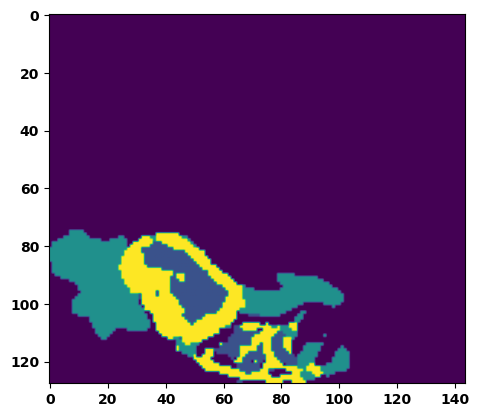

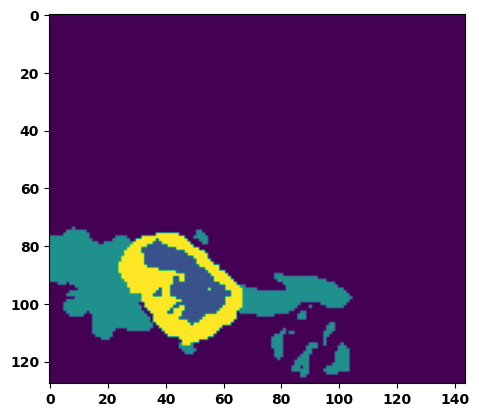

  6%|▌         | 2/36 [00:03<00:55,  1.63s/it]

Batch_id:  1 Eval loss:  0.39065390825271606
Batch_id:  1 Eval IoU:  tensor(0.5383, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9978, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:50,  1.52s/it]

Batch_id:  2 Eval loss:  0.1438506841659546
Batch_id:  2 Eval IoU:  tensor(0.7849, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


 11%|█         | 4/36 [00:06<00:47,  1.48s/it]

Batch_id:  3 Eval loss:  0.40233319997787476
Batch_id:  3 Eval IoU:  tensor(0.5226, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:46,  1.51s/it]

Batch_id:  4 Eval loss:  0.25649896264076233
Batch_id:  4 Eval IoU:  tensor(0.6507, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9459, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:47,  1.58s/it]

Batch_id:  5 Eval loss:  0.2078324407339096
Batch_id:  5 Eval IoU:  tensor(0.6772, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9815, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:44,  1.52s/it]

Batch_id:  6 Eval loss:  0.2554205060005188
Batch_id:  6 Eval IoU:  tensor(0.6974, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:42,  1.53s/it]

Batch_id:  7 Eval loss:  0.09375236928462982
Batch_id:  7 Eval IoU:  tensor(0.8714, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  8 Eval loss:  0.08894824981689453
Batch_id:  8 Eval IoU:  tensor(0.8461, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  

 25%|██▌       | 9/36 [00:14<00:42,  1.59s/it]

tensor(0.9908, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


 28%|██▊       | 10/36 [00:15<00:39,  1.53s/it]

Batch_id:  9 Eval loss:  0.12858742475509644
Batch_id:  9 Eval IoU:  tensor(0.8001, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9597, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9454, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  10 Eval loss:  0.396995484828949
Batch_id:  10 Eval IoU:  tensor(0.4892, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9409, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9254, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9193, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


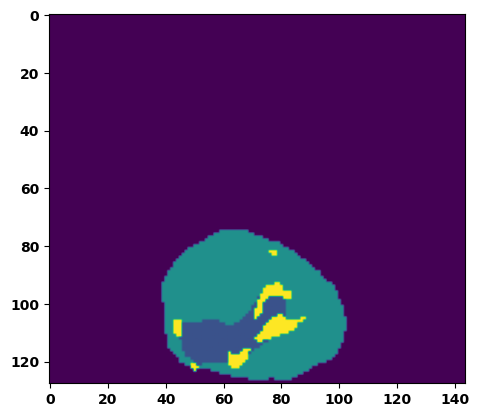

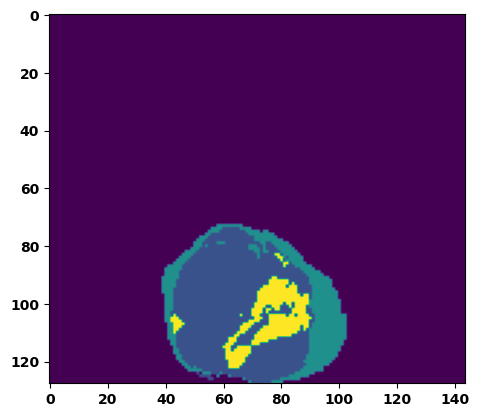

 33%|███▎      | 12/36 [00:18<00:38,  1.59s/it]

Batch_id:  11 Eval loss:  0.5979858636856079
Batch_id:  11 Eval IoU:  tensor(0.3543, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 36%|███▌      | 13/36 [00:20<00:35,  1.56s/it]

Batch_id:  12 Eval loss:  0.40532994270324707
Batch_id:  12 Eval IoU:  tensor(0.5291, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9059, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.8600, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.8594, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:33,  1.51s/it]

Batch_id:  13 Eval loss:  0.06761381030082703
Batch_id:  13 Eval IoU:  tensor(0.8839, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:30,  1.44s/it]

Batch_id:  14 Eval loss:  0.07437226176261902
Batch_id:  14 Eval IoU:  tensor(0.8858, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:28,  1.44s/it]

Batch_id:  15 Eval loss:  0.28455936908721924
Batch_id:  15 Eval IoU:  tensor(0.6165, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:26,  1.42s/it]

Batch_id:  16 Eval loss:  0.2005375623703003
Batch_id:  16 Eval IoU:  tensor(0.7022, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 50%|█████     | 18/36 [00:27<00:25,  1.43s/it]

Batch_id:  17 Eval loss:  0.49884283542633057
Batch_id:  17 Eval IoU:  tensor(0.4049, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9368, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9446, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9305, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9371, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 53%|█████▎    | 19/36 [00:28<00:24,  1.42s/it]

Batch_id:  18 Eval loss:  0.1911730021238327
Batch_id:  18 Eval IoU:  tensor(0.7194, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:22,  1.42s/it]

Batch_id:  19 Eval loss:  0.1562497615814209
Batch_id:  19 Eval IoU:  tensor(0.7529, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  20 Eval loss:  0.1489235907793045
Batch_id:  20 Eval IoU:  tensor(0.7588, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9850, device='cuda:0')


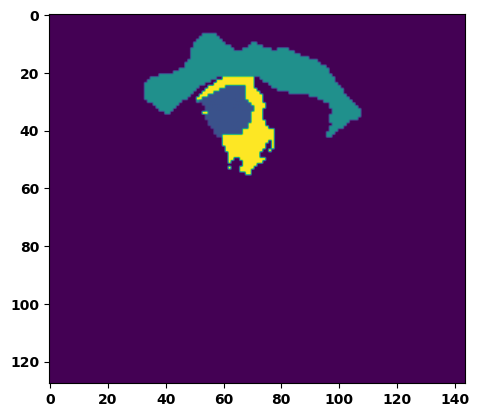

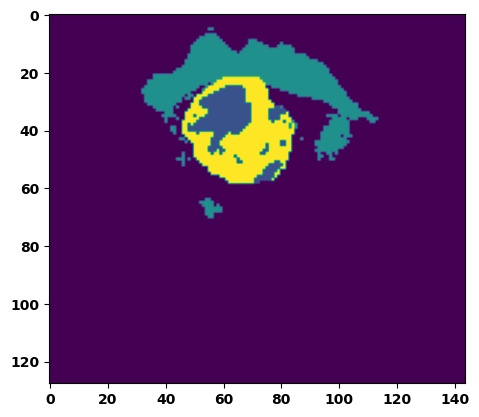

 61%|██████    | 22/36 [00:32<00:19,  1.40s/it]

Batch_id:  21 Eval loss:  0.22321712970733643
Batch_id:  21 Eval IoU:  tensor(0.6815, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9810, device='cuda:0')


 64%|██████▍   | 23/36 [00:34<00:18,  1.39s/it]

Batch_id:  22 Eval loss:  0.2887973189353943
Batch_id:  22 Eval IoU:  tensor(0.6465, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:16,  1.41s/it]

Batch_id:  23 Eval loss:  0.0619693249464035
Batch_id:  23 Eval IoU:  tensor(0.9007, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.41s/it]

Batch_id:  24 Eval loss:  0.29566818475723267
Batch_id:  24 Eval IoU:  tensor(0.6010, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9417, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:13,  1.40s/it]

Batch_id:  25 Eval loss:  0.17927874624729156
Batch_id:  25 Eval IoU:  tensor(0.7250, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:12,  1.40s/it]

Batch_id:  26 Eval loss:  0.08125603199005127
Batch_id:  26 Eval IoU:  tensor(0.8617, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:11,  1.39s/it]

Batch_id:  27 Eval loss:  0.0916338562965393
Batch_id:  27 Eval IoU:  tensor(0.8479, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:09,  1.43s/it]

Batch_id:  28 Eval loss:  0.19707182049751282
Batch_id:  28 Eval IoU:  tensor(0.6999, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


 83%|████████▎ | 30/36 [00:44<00:08,  1.42s/it]

Batch_id:  29 Eval loss:  0.058405086398124695
Batch_id:  29 Eval IoU:  tensor(0.8994, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  30 Eval loss:  0.07813028991222382
Batch_id:  30 Eval IoU:  tensor(0.8684, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')


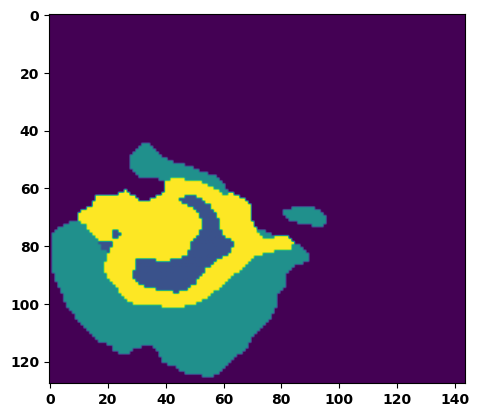

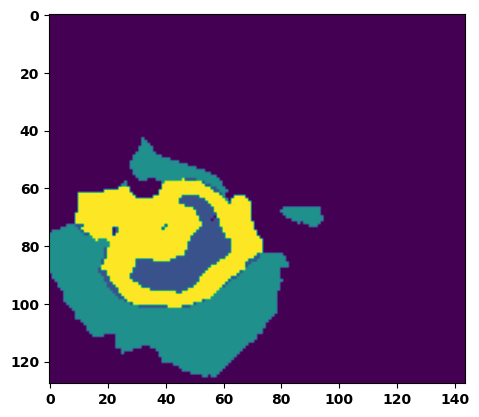

 89%|████████▉ | 32/36 [00:47<00:05,  1.47s/it]

Batch_id:  31 Eval loss:  0.08053600788116455
Batch_id:  31 Eval IoU:  tensor(0.8601, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.48s/it]

Batch_id:  32 Eval loss:  0.10097409784793854
Batch_id:  32 Eval IoU:  tensor(0.8265, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 94%|█████████▍| 34/36 [00:50<00:02,  1.49s/it]

Batch_id:  33 Eval loss:  0.7185754776000977
Batch_id:  33 Eval IoU:  tensor(0.2546, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9518, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9331, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.51s/it]

Batch_id:  34 Eval loss:  0.24022512137889862
Batch_id:  34 Eval IoU:  tensor(0.6611, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


100%|██████████| 36/36 [00:53<00:00,  1.47s/it]

Batch_id:  35 Eval loss:  0.18917305767536163
Batch_id:  35 Eval IoU:  tensor(0.7220, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')
Epoch  43 Training loss:  0.16370624656027014
Epoch  43 Evaluation loss:  0.22164608786503473
Epoch  43 Training accuracy :  tensor(0.7657)
Epoch  43 Evaluation accuracy :  tensor(0.7046)
Epoch  43 Training Mean Dice Score:  tensor(0.9815)
Epoch  43 Eval Mean Dice Score:  tensor(0.9736)
Epoch  43 Training Non-tumor Dice Score:  tensor(0.9829)
Epoch  43 Eval Non-tumor Dice Score:  tensor(0.9727)
Epoch  43 Training NCR/NET Dice Score:  tensor(0.9916)
Epoch  43 Eval NCR/NET Dice Score:  tensor(0.9872)
Epoch  43 Training ED Dice Score:  tensor(0.

Epoch completed and model successfully saved
Epoch: 44
Training in session: 


  1%|          | 1/110 [00:01<02:35,  1.43s/it]

Batch_id:  0 Training loss:  0.24454930424690247
Batch_id:  0 Training IoU:  tensor(0.6526, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9622, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9598, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:48,  1.56s/it]

Batch_id:  1 Training loss:  0.13756488263607025
Batch_id:  1 Training IoU:  tensor(0.7702, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9748, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:43,  1.53s/it]

Batch_id:  2 Training loss:  0.0845281183719635
Batch_id:  2 Training IoU:  tensor(0.8809, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:38,  1.50s/it]

Batch_id:  3 Training loss:  0.10775300860404968
Batch_id:  3 Training IoU:  tensor(0.8262, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:33,  1.46s/it]

Batch_id:  4 Training loss:  0.10125944018363953
Batch_id:  4 Training IoU:  tensor(0.8451, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:34,  1.48s/it]

Batch_id:  5 Training loss:  0.040549471974372864
Batch_id:  5 Training IoU:  tensor(0.9303, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:35,  1.51s/it]

Batch_id:  6 Training loss:  0.0857936292886734
Batch_id:  6 Training IoU:  tensor(0.8650, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:29,  1.47s/it]

Batch_id:  7 Training loss:  0.05687472224235535
Batch_id:  7 Training IoU:  tensor(0.9019, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:30,  1.49s/it]

Batch_id:  8 Training loss:  0.1572631448507309
Batch_id:  8 Training IoU:  tensor(0.7508, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9710, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:26,  1.47s/it]

Batch_id:  9 Training loss:  0.1745096743106842
Batch_id:  9 Training IoU:  tensor(0.7394, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 10%|█         | 11/110 [00:16<02:25,  1.47s/it]

Batch_id:  10 Training loss:  0.09642589092254639
Batch_id:  10 Training IoU:  tensor(0.8391, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 11%|█         | 12/110 [00:17<02:20,  1.43s/it]

Batch_id:  11 Training loss:  0.32046037912368774
Batch_id:  11 Training IoU:  tensor(0.6180, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9590, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:17,  1.41s/it]

Batch_id:  12 Training loss:  0.10582897067070007
Batch_id:  12 Training IoU:  tensor(0.8218, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:16,  1.42s/it]

Batch_id:  13 Training loss:  0.2157808393239975
Batch_id:  13 Training IoU:  tensor(0.7355, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:16,  1.44s/it]

Batch_id:  14 Training loss:  0.18324711918830872
Batch_id:  14 Training IoU:  tensor(0.7188, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9653, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:15,  1.44s/it]

Batch_id:  15 Training loss:  0.24986739456653595
Batch_id:  15 Training IoU:  tensor(0.6518, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:22,  1.53s/it]

Batch_id:  16 Training loss:  0.08822424709796906
Batch_id:  16 Training IoU:  tensor(0.8480, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:18,  1.51s/it]

Batch_id:  17 Training loss:  0.12923508882522583
Batch_id:  17 Training IoU:  tensor(0.8096, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:19,  1.54s/it]

Batch_id:  18 Training loss:  0.2719583511352539
Batch_id:  18 Training IoU:  tensor(0.6314, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9581, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9576, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:15,  1.50s/it]

Batch_id:  19 Training loss:  0.16118064522743225
Batch_id:  19 Training IoU:  tensor(0.7880, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:14,  1.51s/it]

Batch_id:  20 Training loss:  0.2759172022342682
Batch_id:  20 Training IoU:  tensor(0.6669, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 20%|██        | 22/110 [00:32<02:11,  1.50s/it]

Batch_id:  21 Training loss:  0.18168756365776062
Batch_id:  21 Training IoU:  tensor(0.7226, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 21%|██        | 23/110 [00:34<02:12,  1.52s/it]

Batch_id:  22 Training loss:  0.16774530708789825
Batch_id:  22 Training IoU:  tensor(0.7294, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 22%|██▏       | 24/110 [00:35<02:09,  1.51s/it]

Batch_id:  23 Training loss:  0.4561694860458374
Batch_id:  23 Training IoU:  tensor(0.4672, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:07,  1.50s/it]

Batch_id:  24 Training loss:  0.07292430102825165
Batch_id:  24 Training IoU:  tensor(0.8737, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 24%|██▎       | 26/110 [00:38<02:07,  1.52s/it]

Batch_id:  25 Training loss:  0.10857447981834412
Batch_id:  25 Training IoU:  tensor(0.8182, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 25%|██▍       | 27/110 [00:40<02:07,  1.54s/it]

Batch_id:  26 Training loss:  0.13982290029525757
Batch_id:  26 Training IoU:  tensor(0.7840, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 25%|██▌       | 28/110 [00:41<02:07,  1.56s/it]

Batch_id:  27 Training loss:  0.26418358087539673
Batch_id:  27 Training IoU:  tensor(0.6479, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 26%|██▋       | 29/110 [00:43<02:09,  1.60s/it]

Batch_id:  28 Training loss:  0.20927977561950684
Batch_id:  28 Training IoU:  tensor(0.6928, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 27%|██▋       | 30/110 [00:45<02:05,  1.57s/it]

Batch_id:  29 Training loss:  0.1255466192960739
Batch_id:  29 Training IoU:  tensor(0.8061, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 28%|██▊       | 31/110 [00:46<02:00,  1.53s/it]

Batch_id:  30 Training loss:  0.1888633370399475
Batch_id:  30 Training IoU:  tensor(0.7213, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 29%|██▉       | 32/110 [00:48<02:00,  1.54s/it]

Batch_id:  31 Training loss:  0.24890005588531494
Batch_id:  31 Training IoU:  tensor(0.6509, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 30%|███       | 33/110 [00:49<01:58,  1.54s/it]

Batch_id:  32 Training loss:  0.16725531220436096
Batch_id:  32 Training IoU:  tensor(0.8297, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 31%|███       | 34/110 [00:51<01:56,  1.53s/it]

Batch_id:  33 Training loss:  0.15940603613853455
Batch_id:  33 Training IoU:  tensor(0.7645, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:52,  1.50s/it]

Batch_id:  34 Training loss:  0.094479501247406
Batch_id:  34 Training IoU:  tensor(0.8470, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:51,  1.50s/it]

Batch_id:  35 Training loss:  0.1557379513978958
Batch_id:  35 Training IoU:  tensor(0.7511, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 34%|███▎      | 37/110 [00:55<01:57,  1.62s/it]

Batch_id:  36 Training loss:  0.05802538990974426
Batch_id:  36 Training IoU:  tensor(0.8999, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 35%|███▍      | 38/110 [00:57<01:51,  1.55s/it]

Batch_id:  37 Training loss:  0.2098657786846161
Batch_id:  37 Training IoU:  tensor(0.6882, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 35%|███▌      | 39/110 [00:59<01:53,  1.59s/it]

Batch_id:  38 Training loss:  0.17655088007450104
Batch_id:  38 Training IoU:  tensor(0.7200, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 36%|███▋      | 40/110 [01:00<01:46,  1.52s/it]

Batch_id:  39 Training loss:  0.11484304070472717
Batch_id:  39 Training IoU:  tensor(0.8169, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 37%|███▋      | 41/110 [01:02<01:45,  1.53s/it]

Batch_id:  40 Training loss:  0.10393896698951721
Batch_id:  40 Training IoU:  tensor(0.8234, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 38%|███▊      | 42/110 [01:03<01:41,  1.50s/it]

Batch_id:  41 Training loss:  0.12416011095046997
Batch_id:  41 Training IoU:  tensor(0.8011, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 39%|███▉      | 43/110 [01:05<01:45,  1.57s/it]

Batch_id:  42 Training loss:  0.38111263513565063
Batch_id:  42 Training IoU:  tensor(0.5393, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 40%|████      | 44/110 [01:06<01:45,  1.60s/it]

Batch_id:  43 Training loss:  0.23477566242218018
Batch_id:  43 Training IoU:  tensor(0.6523, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9570, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9489, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 41%|████      | 45/110 [01:08<01:41,  1.57s/it]

Batch_id:  44 Training loss:  0.3462058901786804
Batch_id:  44 Training IoU:  tensor(0.5924, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 42%|████▏     | 46/110 [01:09<01:38,  1.55s/it]

Batch_id:  45 Training loss:  0.08560386300086975
Batch_id:  45 Training IoU:  tensor(0.8530, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 43%|████▎     | 47/110 [01:11<01:36,  1.52s/it]

Batch_id:  46 Training loss:  0.10662241280078888
Batch_id:  46 Training IoU:  tensor(0.8230, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 44%|████▎     | 48/110 [01:12<01:37,  1.57s/it]

Batch_id:  47 Training loss:  0.21448343992233276
Batch_id:  47 Training IoU:  tensor(0.7352, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 45%|████▍     | 49/110 [01:14<01:34,  1.55s/it]

Batch_id:  48 Training loss:  0.12292879819869995
Batch_id:  48 Training IoU:  tensor(0.8040, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 45%|████▌     | 50/110 [01:16<01:33,  1.56s/it]

Batch_id:  49 Training loss:  0.13891850411891937
Batch_id:  49 Training IoU:  tensor(0.7933, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 46%|████▋     | 51/110 [01:17<01:31,  1.55s/it]

Batch_id:  50 Training loss:  0.23395483195781708
Batch_id:  50 Training IoU:  tensor(0.6542, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9404, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9542, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9769, device='cuda:0')


 47%|████▋     | 52/110 [01:19<01:30,  1.56s/it]

Batch_id:  51 Training loss:  0.09479270875453949
Batch_id:  51 Training IoU:  tensor(0.8386, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 48%|████▊     | 53/110 [01:20<01:28,  1.55s/it]

Batch_id:  52 Training loss:  0.39323896169662476
Batch_id:  52 Training IoU:  tensor(0.5092, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9481, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9231, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 49%|████▉     | 54/110 [01:22<01:26,  1.55s/it]

Batch_id:  53 Training loss:  0.08739587664604187
Batch_id:  53 Training IoU:  tensor(0.8561, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 50%|█████     | 55/110 [01:23<01:23,  1.52s/it]

Batch_id:  54 Training loss:  0.19189858436584473
Batch_id:  54 Training IoU:  tensor(0.7146, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9608, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


 51%|█████     | 56/110 [01:25<01:20,  1.48s/it]

Batch_id:  55 Training loss:  0.045596644282341
Batch_id:  55 Training IoU:  tensor(0.9218, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 52%|█████▏    | 57/110 [01:26<01:19,  1.49s/it]

Batch_id:  56 Training loss:  0.3282347321510315
Batch_id:  56 Training IoU:  tensor(0.6164, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 53%|█████▎    | 58/110 [01:28<01:18,  1.51s/it]

Batch_id:  57 Training loss:  0.13971559703350067
Batch_id:  57 Training IoU:  tensor(0.8123, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 54%|█████▎    | 59/110 [01:29<01:18,  1.53s/it]

Batch_id:  58 Training loss:  0.08758273720741272
Batch_id:  58 Training IoU:  tensor(0.8481, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 55%|█████▍    | 60/110 [01:31<01:16,  1.53s/it]

Batch_id:  59 Training loss:  0.19979774951934814
Batch_id:  59 Training IoU:  tensor(0.6979, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 55%|█████▌    | 61/110 [01:32<01:15,  1.54s/it]

Batch_id:  60 Training loss:  0.20177620649337769
Batch_id:  60 Training IoU:  tensor(0.6913, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9408, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9436, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9253, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 56%|█████▋    | 62/110 [01:34<01:14,  1.56s/it]

Batch_id:  61 Training loss:  0.12267474830150604
Batch_id:  61 Training IoU:  tensor(0.8057, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 57%|█████▋    | 63/110 [01:35<01:11,  1.52s/it]

Batch_id:  62 Training loss:  0.15432175993919373
Batch_id:  62 Training IoU:  tensor(0.7509, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 58%|█████▊    | 64/110 [01:37<01:07,  1.46s/it]

Batch_id:  63 Training loss:  0.05567885935306549
Batch_id:  63 Training IoU:  tensor(0.9062, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 59%|█████▉    | 65/110 [01:38<01:05,  1.46s/it]

Batch_id:  64 Training loss:  0.15512388944625854
Batch_id:  64 Training IoU:  tensor(0.7464, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9820, device='cuda:0')


 60%|██████    | 66/110 [01:40<01:03,  1.45s/it]

Batch_id:  65 Training loss:  0.1287333220243454
Batch_id:  65 Training IoU:  tensor(0.7886, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 61%|██████    | 67/110 [01:41<01:01,  1.43s/it]

Batch_id:  66 Training loss:  0.2407812476158142
Batch_id:  66 Training IoU:  tensor(0.7173, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 62%|██████▏   | 68/110 [01:42<01:00,  1.45s/it]

Batch_id:  67 Training loss:  0.09310641884803772
Batch_id:  67 Training IoU:  tensor(0.8380, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 63%|██████▎   | 69/110 [01:44<01:00,  1.48s/it]

Batch_id:  68 Training loss:  0.07685290277004242
Batch_id:  68 Training IoU:  tensor(0.8819, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 64%|██████▎   | 70/110 [01:45<00:58,  1.46s/it]

Batch_id:  69 Training loss:  0.11097081005573273
Batch_id:  69 Training IoU:  tensor(0.8175, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


 65%|██████▍   | 71/110 [01:47<00:56,  1.45s/it]

Batch_id:  70 Training loss:  0.15240639448165894
Batch_id:  70 Training IoU:  tensor(0.7545, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 65%|██████▌   | 72/110 [01:48<00:55,  1.45s/it]

Batch_id:  71 Training loss:  0.08784198760986328
Batch_id:  71 Training IoU:  tensor(0.8479, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 66%|██████▋   | 73/110 [01:50<00:52,  1.42s/it]

Batch_id:  72 Training loss:  0.1521334946155548
Batch_id:  72 Training IoU:  tensor(0.7838, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 67%|██████▋   | 74/110 [01:51<00:52,  1.45s/it]

Batch_id:  73 Training loss:  0.09175010025501251
Batch_id:  73 Training IoU:  tensor(0.8465, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 68%|██████▊   | 75/110 [01:52<00:49,  1.42s/it]

Batch_id:  74 Training loss:  0.14468368887901306
Batch_id:  74 Training IoU:  tensor(0.7664, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9687, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9661, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 69%|██████▉   | 76/110 [01:54<00:48,  1.43s/it]

Batch_id:  75 Training loss:  0.12358473241329193
Batch_id:  75 Training IoU:  tensor(0.8143, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 70%|███████   | 77/110 [01:55<00:47,  1.43s/it]

Batch_id:  76 Training loss:  0.1300516277551651
Batch_id:  76 Training IoU:  tensor(0.7935, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 71%|███████   | 78/110 [01:57<00:45,  1.41s/it]

Batch_id:  77 Training loss:  0.0968637764453888
Batch_id:  77 Training IoU:  tensor(0.8379, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 72%|███████▏  | 79/110 [01:58<00:43,  1.40s/it]

Batch_id:  78 Training loss:  0.06481899321079254
Batch_id:  78 Training IoU:  tensor(0.8915, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 73%|███████▎  | 80/110 [01:59<00:41,  1.39s/it]

Batch_id:  79 Training loss:  0.24258224666118622
Batch_id:  79 Training IoU:  tensor(0.6422, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9771, device='cuda:0')


 74%|███████▎  | 81/110 [02:01<00:40,  1.40s/it]

Batch_id:  80 Training loss:  0.08871331810951233
Batch_id:  80 Training IoU:  tensor(0.8520, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 75%|███████▍  | 82/110 [02:02<00:39,  1.42s/it]

Batch_id:  81 Training loss:  0.5233033895492554
Batch_id:  81 Training IoU:  tensor(0.4248, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 75%|███████▌  | 83/110 [02:04<00:38,  1.44s/it]

Batch_id:  82 Training loss:  0.16707812249660492
Batch_id:  82 Training IoU:  tensor(0.7390, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9778, device='cuda:0')


 76%|███████▋  | 84/110 [02:05<00:38,  1.47s/it]

Batch_id:  83 Training loss:  0.046159788966178894
Batch_id:  83 Training IoU:  tensor(0.9187, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 77%|███████▋  | 85/110 [02:07<00:35,  1.44s/it]

Batch_id:  84 Training loss:  0.3463292717933655
Batch_id:  84 Training IoU:  tensor(0.6280, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 78%|███████▊  | 86/110 [02:08<00:34,  1.44s/it]

Batch_id:  85 Training loss:  0.18769308924674988
Batch_id:  85 Training IoU:  tensor(0.7111, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9516, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9734, device='cuda:0')


 79%|███████▉  | 87/110 [02:10<00:34,  1.48s/it]

Batch_id:  86 Training loss:  0.1299685835838318
Batch_id:  86 Training IoU:  tensor(0.8029, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 80%|████████  | 88/110 [02:11<00:31,  1.41s/it]

Batch_id:  87 Training loss:  0.13779963552951813
Batch_id:  87 Training IoU:  tensor(0.7984, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 81%|████████  | 89/110 [02:13<00:31,  1.48s/it]

Batch_id:  88 Training loss:  0.1610325425863266
Batch_id:  88 Training IoU:  tensor(0.8140, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 82%|████████▏ | 90/110 [02:14<00:29,  1.50s/it]

Batch_id:  89 Training loss:  0.15062697231769562
Batch_id:  89 Training IoU:  tensor(0.7579, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 83%|████████▎ | 91/110 [02:16<00:27,  1.45s/it]

Batch_id:  90 Training loss:  0.06752917170524597
Batch_id:  90 Training IoU:  tensor(0.8823, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 84%|████████▎ | 92/110 [02:17<00:25,  1.44s/it]

Batch_id:  91 Training loss:  0.2101476490497589
Batch_id:  91 Training IoU:  tensor(0.7162, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 85%|████████▍ | 93/110 [02:18<00:24,  1.42s/it]

Batch_id:  92 Training loss:  0.1752587854862213
Batch_id:  92 Training IoU:  tensor(0.7390, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 85%|████████▌ | 94/110 [02:20<00:23,  1.49s/it]

Batch_id:  93 Training loss:  0.08991914987564087
Batch_id:  93 Training IoU:  tensor(0.8485, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 86%|████████▋ | 95/110 [02:21<00:22,  1.48s/it]

Batch_id:  94 Training loss:  0.04938887059688568
Batch_id:  94 Training IoU:  tensor(0.9202, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 87%|████████▋ | 96/110 [02:23<00:21,  1.56s/it]

Batch_id:  95 Training loss:  0.09107829630374908
Batch_id:  95 Training IoU:  tensor(0.8444, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 88%|████████▊ | 97/110 [02:25<00:19,  1.54s/it]

Batch_id:  96 Training loss:  0.10690638422966003
Batch_id:  96 Training IoU:  tensor(0.8292, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9849, device='cuda:0')


 89%|████████▉ | 98/110 [02:26<00:18,  1.57s/it]

Batch_id:  97 Training loss:  0.2571040987968445
Batch_id:  97 Training IoU:  tensor(0.6998, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 90%|█████████ | 99/110 [02:28<00:17,  1.55s/it]

Batch_id:  98 Training loss:  0.09042680263519287
Batch_id:  98 Training IoU:  tensor(0.8452, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 91%|█████████ | 100/110 [02:29<00:15,  1.53s/it]

Batch_id:  99 Training loss:  0.07732130587100983
Batch_id:  99 Training IoU:  tensor(0.8712, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 92%|█████████▏| 101/110 [02:31<00:13,  1.50s/it]

Batch_id:  100 Training loss:  0.15258200466632843
Batch_id:  100 Training IoU:  tensor(0.8191, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 93%|█████████▎| 102/110 [02:32<00:11,  1.50s/it]

Batch_id:  101 Training loss:  0.2106945812702179
Batch_id:  101 Training IoU:  tensor(0.6840, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 94%|█████████▎| 103/110 [02:34<00:10,  1.49s/it]

Batch_id:  102 Training loss:  0.2620142698287964
Batch_id:  102 Training IoU:  tensor(0.6298, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9503, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9297, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 95%|█████████▍| 104/110 [02:35<00:08,  1.43s/it]

Batch_id:  103 Training loss:  0.2114468514919281
Batch_id:  103 Training IoU:  tensor(0.6835, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 95%|█████████▌| 105/110 [02:36<00:07,  1.43s/it]

Batch_id:  104 Training loss:  0.32323604822158813
Batch_id:  104 Training IoU:  tensor(0.6428, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 96%|█████████▋| 106/110 [02:38<00:05,  1.43s/it]

Batch_id:  105 Training loss:  0.14564655721187592
Batch_id:  105 Training IoU:  tensor(0.7719, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 97%|█████████▋| 107/110 [02:39<00:04,  1.45s/it]

Batch_id:  106 Training loss:  0.2450745552778244
Batch_id:  106 Training IoU:  tensor(0.6882, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 98%|█████████▊| 108/110 [02:41<00:02,  1.42s/it]

Batch_id:  107 Training loss:  0.12143358588218689
Batch_id:  107 Training IoU:  tensor(0.7993, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 99%|█████████▉| 109/110 [02:42<00:01,  1.42s/it]

Batch_id:  108 Training loss:  0.0971670150756836
Batch_id:  108 Training IoU:  tensor(0.8372, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


100%|██████████| 110/110 [02:43<00:00,  1.49s/it]


Batch_id:  109 Training loss:  0.20248734951019287
Batch_id:  109 Training IoU:  tensor(0.6989, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9915, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.20417793095111847
Batch_id:  0 Eval IoU:  tensor(0.6976, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9688, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9919, device='cuda:0')


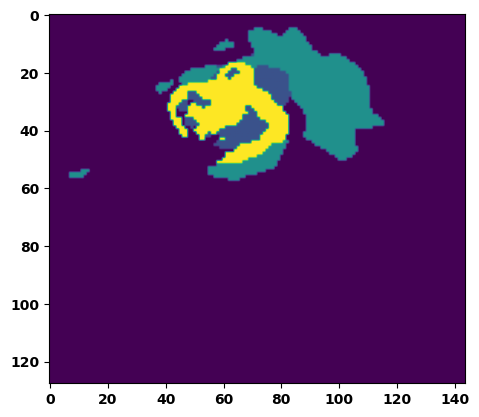

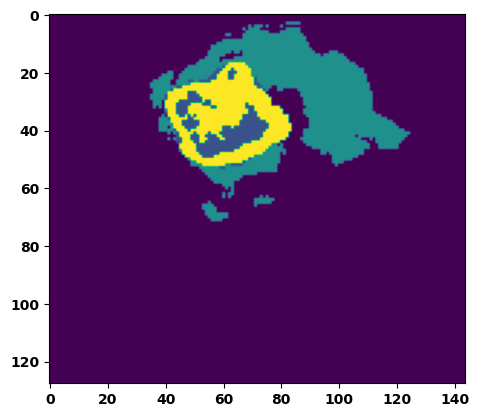

  6%|▌         | 2/36 [00:03<00:52,  1.55s/it]

Batch_id:  1 Eval loss:  0.15270185470581055
Batch_id:  1 Eval IoU:  tensor(0.7530, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9845, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:49,  1.51s/it]

Batch_id:  2 Eval loss:  0.09198959171772003
Batch_id:  2 Eval IoU:  tensor(0.8471, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 11%|█         | 4/36 [00:06<00:47,  1.47s/it]

Batch_id:  3 Eval loss:  0.0813969075679779
Batch_id:  3 Eval IoU:  tensor(0.8615, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.46s/it]

Batch_id:  4 Eval loss:  0.09318073093891144
Batch_id:  4 Eval IoU:  tensor(0.8703, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:41,  1.39s/it]

Batch_id:  5 Eval loss:  0.14303965866565704
Batch_id:  5 Eval IoU:  tensor(0.7857, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:41,  1.42s/it]

Batch_id:  6 Eval loss:  0.12934179604053497
Batch_id:  6 Eval IoU:  tensor(0.7991, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9449, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:39,  1.42s/it]

Batch_id:  7 Eval loss:  0.08919006586074829
Batch_id:  7 Eval IoU:  tensor(0.8462, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:39,  1.47s/it]

Batch_id:  8 Eval loss:  0.719478964805603
Batch_id:  8 Eval IoU:  tensor(0.2543, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9333, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.47s/it]

Batch_id:  9 Eval loss:  0.19033664464950562
Batch_id:  9 Eval IoU:  tensor(0.7208, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  10 Eval loss:  0.10049900412559509
Batch_id:  10 Eval IoU:  tensor(0.8271, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


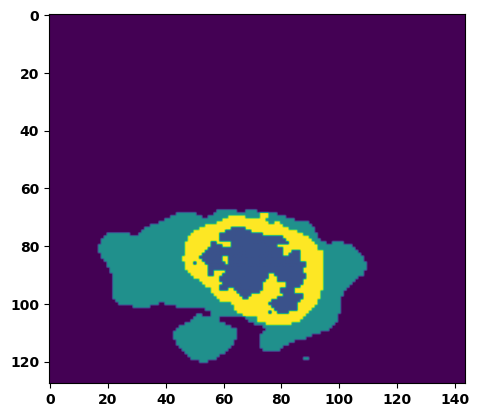

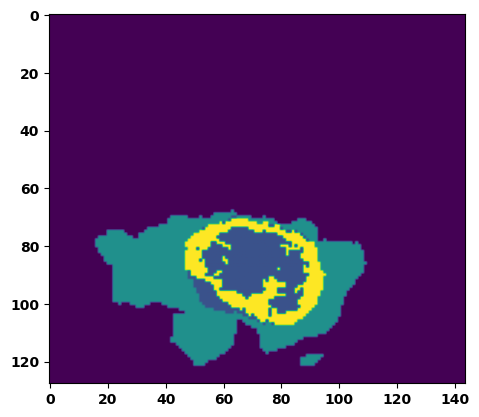

 33%|███▎      | 12/36 [00:17<00:36,  1.52s/it]

Batch_id:  11 Eval loss:  0.40438294410705566
Batch_id:  11 Eval IoU:  tensor(0.5213, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:34,  1.51s/it]

Batch_id:  12 Eval loss:  0.2076316624879837
Batch_id:  12 Eval IoU:  tensor(0.6779, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9524, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9476, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9818, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:32,  1.49s/it]

Batch_id:  13 Eval loss:  0.2851269841194153
Batch_id:  13 Eval IoU:  tensor(0.6159, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9404, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:30,  1.43s/it]

Batch_id:  14 Eval loss:  0.5009903907775879
Batch_id:  14 Eval IoU:  tensor(0.4059, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9363, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9302, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:27,  1.40s/it]

Batch_id:  15 Eval loss:  0.17973162233829498
Batch_id:  15 Eval IoU:  tensor(0.7245, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:26,  1.38s/it]

Batch_id:  16 Eval loss:  0.22304147481918335
Batch_id:  16 Eval IoU:  tensor(0.6815, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9807, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:24,  1.35s/it]

Batch_id:  17 Eval loss:  0.1576717495918274
Batch_id:  17 Eval IoU:  tensor(0.7506, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:23,  1.36s/it]

Batch_id:  18 Eval loss:  0.06801041960716248
Batch_id:  18 Eval IoU:  tensor(0.8833, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 56%|█████▌    | 20/36 [00:28<00:22,  1.38s/it]

Batch_id:  19 Eval loss:  0.1956726461648941
Batch_id:  19 Eval IoU:  tensor(0.7019, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  20 Eval loss:  0.05827970802783966
Batch_id:  20 Eval IoU:  tensor(0.8994, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


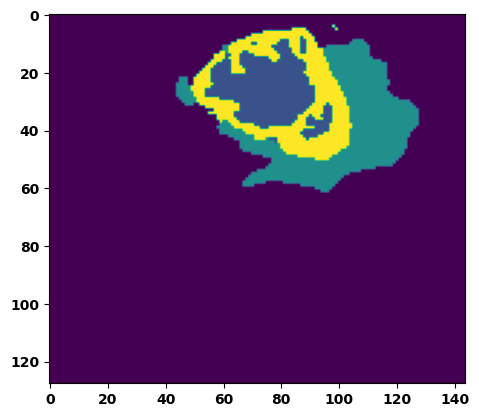

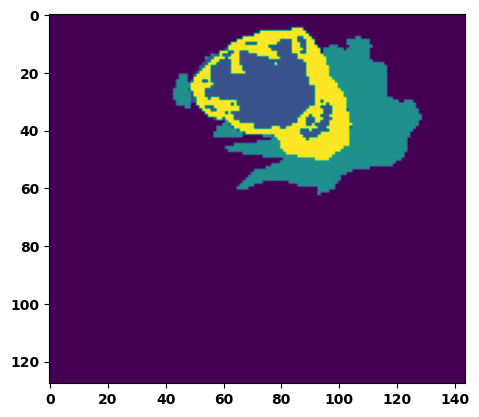

 61%|██████    | 22/36 [00:32<00:20,  1.47s/it]

Batch_id:  21 Eval loss:  0.39815932512283325
Batch_id:  21 Eval IoU:  tensor(0.4879, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9253, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9192, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.47s/it]

Batch_id:  22 Eval loss:  0.25591138005256653
Batch_id:  22 Eval IoU:  tensor(0.6510, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9457, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:17,  1.46s/it]

Batch_id:  23 Eval loss:  0.07768920063972473
Batch_id:  23 Eval IoU:  tensor(0.8694, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9869, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:16,  1.47s/it]

Batch_id:  24 Eval loss:  0.07366977632045746
Batch_id:  24 Eval IoU:  tensor(0.8869, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:15,  1.53s/it]

Batch_id:  25 Eval loss:  0.23993539810180664
Batch_id:  25 Eval IoU:  tensor(0.6615, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:13,  1.52s/it]

Batch_id:  26 Eval loss:  0.4062083065509796
Batch_id:  26 Eval IoU:  tensor(0.5284, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9057, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.8596, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.8591, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 78%|███████▊  | 28/36 [00:41<00:12,  1.50s/it]

Batch_id:  27 Eval loss:  0.3887486159801483
Batch_id:  27 Eval IoU:  tensor(0.5413, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 81%|████████  | 29/36 [00:42<00:10,  1.53s/it]

Batch_id:  28 Eval loss:  0.5975279808044434
Batch_id:  28 Eval IoU:  tensor(0.3549, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9950, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.43s/it]

Batch_id:  29 Eval loss:  0.06227631866931915
Batch_id:  29 Eval IoU:  tensor(0.9002, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  30 Eval loss:  0.30768632888793945
Batch_id:  30 Eval IoU:  tensor(0.5898, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9543, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9350, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9404, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9903, device='cuda:0')


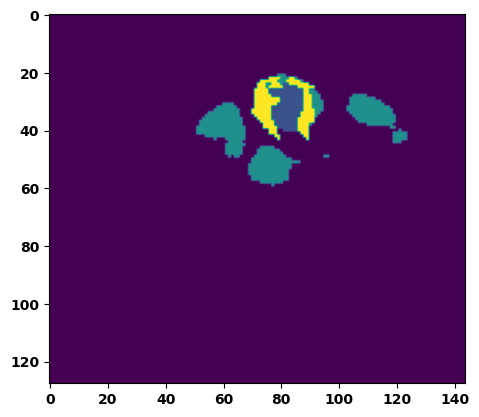

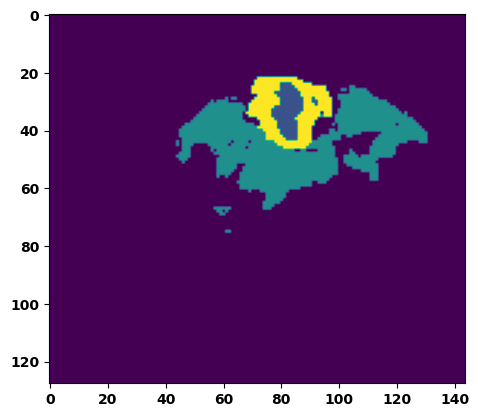

 89%|████████▉ | 32/36 [00:46<00:05,  1.47s/it]

Batch_id:  31 Eval loss:  0.10301810503005981
Batch_id:  31 Eval IoU:  tensor(0.8261, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 92%|█████████▏| 33/36 [00:48<00:04,  1.46s/it]

Batch_id:  32 Eval loss:  0.28818458318710327
Batch_id:  32 Eval IoU:  tensor(0.6475, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.41s/it]

Batch_id:  33 Eval loss:  0.2551894783973694
Batch_id:  33 Eval IoU:  tensor(0.6965, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 97%|█████████▋| 35/36 [00:51<00:01,  1.43s/it]

Batch_id:  34 Eval loss:  0.08014649152755737
Batch_id:  34 Eval IoU:  tensor(0.8610, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.46s/it]

Batch_id:  35 Eval loss:  0.1892240047454834
Batch_id:  35 Eval IoU:  tensor(0.7222, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')
Epoch  44 Training loss:  0.16365360712463206
Epoch  44 Evaluation loss:  0.22220689016911718
Epoch  44 Training accuracy :  tensor(0.7657)
Epoch  44 Evaluation accuracy :  tensor(0.7042)
Epoch  44 Training Mean Dice Score:  tensor(0.9815)
Epoch  44 Eval Mean Dice Score:  tensor(0.9735)
Epoch  44 Training Non-tumor Dice Score:  tensor(0.9829)
Epoch  44 Eval Non-tumor Dice Score:  tensor(0.9725)
Epoch  44 Training NCR/NET Dice Score:  tensor(0.9916)
Epoch  44 Eval NCR/NET Dice Score:  tensor(0.9872)
Epoch  44 Training ED Dice Score:  tensor(0.9

Epoch: 45
Training in session: 


  1%|          | 1/110 [00:01<02:35,  1.43s/it]

Batch_id:  0 Training loss:  0.05670182406902313
Batch_id:  0 Training IoU:  tensor(0.9024, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:29,  1.38s/it]

Batch_id:  1 Training loss:  0.08587805926799774
Batch_id:  1 Training IoU:  tensor(0.8655, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:32,  1.43s/it]

Batch_id:  2 Training loss:  0.12250469624996185
Batch_id:  2 Training IoU:  tensor(0.8156, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:29,  1.41s/it]

Batch_id:  3 Training loss:  0.10764528810977936
Batch_id:  3 Training IoU:  tensor(0.8217, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:30,  1.43s/it]

Batch_id:  4 Training loss:  0.24489949643611908
Batch_id:  4 Training IoU:  tensor(0.6886, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:30,  1.45s/it]

Batch_id:  5 Training loss:  0.3496115803718567
Batch_id:  5 Training IoU:  tensor(0.5878, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:32,  1.48s/it]

Batch_id:  6 Training loss:  0.17221267521381378
Batch_id:  6 Training IoU:  tensor(0.7427, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:41,  1.58s/it]

Batch_id:  7 Training loss:  0.125766783952713
Batch_id:  7 Training IoU:  tensor(0.8074, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:32,  1.51s/it]

Batch_id:  8 Training loss:  0.08718912303447723
Batch_id:  8 Training IoU:  tensor(0.8492, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:33,  1.53s/it]

Batch_id:  9 Training loss:  0.23473630845546722
Batch_id:  9 Training IoU:  tensor(0.6512, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9484, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 10%|█         | 11/110 [00:16<02:30,  1.52s/it]

Batch_id:  10 Training loss:  0.1665741205215454
Batch_id:  10 Training IoU:  tensor(0.7393, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


 11%|█         | 12/110 [00:17<02:30,  1.53s/it]

Batch_id:  11 Training loss:  0.06546524167060852
Batch_id:  11 Training IoU:  tensor(0.8904, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:27,  1.52s/it]

Batch_id:  12 Training loss:  0.15283797681331635
Batch_id:  12 Training IoU:  tensor(0.7528, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:22,  1.48s/it]

Batch_id:  13 Training loss:  0.3222652077674866
Batch_id:  13 Training IoU:  tensor(0.6151, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9492, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:20,  1.48s/it]

Batch_id:  14 Training loss:  0.3450168967247009
Batch_id:  14 Training IoU:  tensor(0.6306, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:22,  1.51s/it]

Batch_id:  15 Training loss:  0.09119883179664612
Batch_id:  15 Training IoU:  tensor(0.8449, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:22,  1.53s/it]

Batch_id:  16 Training loss:  0.17507079243659973
Batch_id:  16 Training IoU:  tensor(0.7378, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:20,  1.53s/it]

Batch_id:  17 Training loss:  0.19784896075725555
Batch_id:  17 Training IoU:  tensor(0.7009, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:20,  1.54s/it]

Batch_id:  18 Training loss:  0.09100955724716187
Batch_id:  18 Training IoU:  tensor(0.8470, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:19,  1.54s/it]

Batch_id:  19 Training loss:  0.16574515402317047
Batch_id:  19 Training IoU:  tensor(0.8314, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:17,  1.55s/it]

Batch_id:  20 Training loss:  0.04588326811790466
Batch_id:  20 Training IoU:  tensor(0.9197, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 20%|██        | 22/110 [00:33<02:16,  1.56s/it]

Batch_id:  21 Training loss:  0.12121851742267609
Batch_id:  21 Training IoU:  tensor(0.8065, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9875, device='cuda:0')


 21%|██        | 23/110 [00:34<02:13,  1.54s/it]

Batch_id:  22 Training loss:  0.20833665132522583
Batch_id:  22 Training IoU:  tensor(0.6865, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:09,  1.51s/it]

Batch_id:  23 Training loss:  0.10497862100601196
Batch_id:  23 Training IoU:  tensor(0.8321, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9637, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:07,  1.49s/it]

Batch_id:  24 Training loss:  0.15857630968093872
Batch_id:  24 Training IoU:  tensor(0.7891, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:04,  1.48s/it]

Batch_id:  25 Training loss:  0.056074514985084534
Batch_id:  25 Training IoU:  tensor(0.9059, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 25%|██▍       | 27/110 [00:40<02:03,  1.49s/it]

Batch_id:  26 Training loss:  0.20778344571590424
Batch_id:  26 Training IoU:  tensor(0.6871, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 25%|██▌       | 28/110 [00:42<02:04,  1.52s/it]

Batch_id:  27 Training loss:  0.17795976996421814
Batch_id:  27 Training IoU:  tensor(0.7180, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 26%|██▋       | 29/110 [00:43<02:02,  1.51s/it]

Batch_id:  28 Training loss:  0.13965709507465363
Batch_id:  28 Training IoU:  tensor(0.7670, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9744, device='cuda:0')


 27%|██▋       | 30/110 [00:45<02:03,  1.54s/it]

Batch_id:  29 Training loss:  0.15285080671310425
Batch_id:  29 Training IoU:  tensor(0.8172, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 28%|██▊       | 31/110 [00:46<02:01,  1.54s/it]

Batch_id:  30 Training loss:  0.10242392122745514
Batch_id:  30 Training IoU:  tensor(0.8268, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 29%|██▉       | 32/110 [00:48<01:56,  1.50s/it]

Batch_id:  31 Training loss:  0.11614441871643066
Batch_id:  31 Training IoU:  tensor(0.8148, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 30%|███       | 33/110 [00:49<01:52,  1.46s/it]

Batch_id:  32 Training loss:  0.07372188568115234
Batch_id:  32 Training IoU:  tensor(0.8719, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 31%|███       | 34/110 [00:51<01:51,  1.47s/it]

Batch_id:  33 Training loss:  0.08643017709255219
Batch_id:  33 Training IoU:  tensor(0.8582, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:53,  1.51s/it]

Batch_id:  34 Training loss:  0.21864594519138336
Batch_id:  34 Training IoU:  tensor(0.7280, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9976, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:49,  1.48s/it]

Batch_id:  35 Training loss:  0.131509929895401
Batch_id:  35 Training IoU:  tensor(0.8059, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 34%|███▎      | 37/110 [00:55<01:48,  1.48s/it]

Batch_id:  36 Training loss:  0.24129235744476318
Batch_id:  36 Training IoU:  tensor(0.7141, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 35%|███▍      | 38/110 [00:57<01:50,  1.53s/it]

Batch_id:  37 Training loss:  0.14213372766971588
Batch_id:  37 Training IoU:  tensor(0.7685, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 35%|███▌      | 39/110 [00:58<01:47,  1.52s/it]

Batch_id:  38 Training loss:  0.16264499723911285
Batch_id:  38 Training IoU:  tensor(0.8103, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 36%|███▋      | 40/110 [01:00<01:46,  1.52s/it]

Batch_id:  39 Training loss:  0.2017599642276764
Batch_id:  39 Training IoU:  tensor(0.6978, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:44,  1.52s/it]

Batch_id:  40 Training loss:  0.11836977303028107
Batch_id:  40 Training IoU:  tensor(0.8034, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 38%|███▊      | 42/110 [01:03<01:43,  1.52s/it]

Batch_id:  41 Training loss:  0.08840185403823853
Batch_id:  41 Training IoU:  tensor(0.8476, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:43,  1.55s/it]

Batch_id:  42 Training loss:  0.3873403072357178
Batch_id:  42 Training IoU:  tensor(0.5162, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9498, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9430, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9258, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 40%|████      | 44/110 [01:06<01:41,  1.53s/it]

Batch_id:  43 Training loss:  0.15534737706184387
Batch_id:  43 Training IoU:  tensor(0.7457, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 41%|████      | 45/110 [01:07<01:38,  1.52s/it]

Batch_id:  44 Training loss:  0.15414245426654816
Batch_id:  44 Training IoU:  tensor(0.7701, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9639, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 42%|████▏     | 46/110 [01:09<01:37,  1.52s/it]

Batch_id:  45 Training loss:  0.09098345041275024
Batch_id:  45 Training IoU:  tensor(0.8522, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 43%|████▎     | 47/110 [01:10<01:35,  1.52s/it]

Batch_id:  46 Training loss:  0.12972791492938995
Batch_id:  46 Training IoU:  tensor(0.7862, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 44%|████▎     | 48/110 [01:12<01:31,  1.48s/it]

Batch_id:  47 Training loss:  0.13903461396694183
Batch_id:  47 Training IoU:  tensor(0.7988, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 45%|████▍     | 49/110 [01:13<01:29,  1.47s/it]

Batch_id:  48 Training loss:  0.21129435300827026
Batch_id:  48 Training IoU:  tensor(0.7136, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 45%|████▌     | 50/110 [01:15<01:28,  1.47s/it]

Batch_id:  49 Training loss:  0.05843663215637207
Batch_id:  49 Training IoU:  tensor(0.8995, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 46%|████▋     | 51/110 [01:16<01:26,  1.47s/it]

Batch_id:  50 Training loss:  0.09708002209663391
Batch_id:  50 Training IoU:  tensor(0.8379, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 47%|████▋     | 52/110 [01:18<01:29,  1.55s/it]

Batch_id:  51 Training loss:  0.18701885640621185
Batch_id:  51 Training IoU:  tensor(0.7225, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 48%|████▊     | 53/110 [01:19<01:24,  1.48s/it]

Batch_id:  52 Training loss:  0.19043679535388947
Batch_id:  52 Training IoU:  tensor(0.7158, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


 49%|████▉     | 54/110 [01:21<01:26,  1.55s/it]

Batch_id:  53 Training loss:  0.07711665332317352
Batch_id:  53 Training IoU:  tensor(0.8809, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


 50%|█████     | 55/110 [01:23<01:25,  1.56s/it]

Batch_id:  54 Training loss:  0.10878561437129974
Batch_id:  54 Training IoU:  tensor(0.8255, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 51%|█████     | 56/110 [01:24<01:23,  1.54s/it]

Batch_id:  55 Training loss:  0.08536981046199799
Batch_id:  55 Training IoU:  tensor(0.8532, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9837, device='cuda:0')


 52%|█████▏    | 57/110 [01:25<01:18,  1.49s/it]

Batch_id:  56 Training loss:  0.3176669478416443
Batch_id:  56 Training IoU:  tensor(0.6513, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9958, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9954, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 53%|█████▎    | 58/110 [01:27<01:15,  1.46s/it]

Batch_id:  57 Training loss:  0.4583452641963959
Batch_id:  57 Training IoU:  tensor(0.4639, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 54%|█████▎    | 59/110 [01:28<01:15,  1.48s/it]

Batch_id:  58 Training loss:  0.06975698471069336
Batch_id:  58 Training IoU:  tensor(0.8786, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 55%|█████▍    | 60/110 [01:30<01:15,  1.52s/it]

Batch_id:  59 Training loss:  0.07863081991672516
Batch_id:  59 Training IoU:  tensor(0.8684, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 55%|█████▌    | 61/110 [01:31<01:14,  1.51s/it]

Batch_id:  60 Training loss:  0.1319921463727951
Batch_id:  60 Training IoU:  tensor(0.7907, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 56%|█████▋    | 62/110 [01:33<01:13,  1.53s/it]

Batch_id:  61 Training loss:  0.09778502583503723
Batch_id:  61 Training IoU:  tensor(0.8365, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 57%|█████▋    | 63/110 [01:34<01:11,  1.51s/it]

Batch_id:  62 Training loss:  0.24292975664138794
Batch_id:  62 Training IoU:  tensor(0.6546, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9615, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 58%|█████▊    | 64/110 [01:36<01:07,  1.47s/it]

Batch_id:  63 Training loss:  0.2152680903673172
Batch_id:  63 Training IoU:  tensor(0.6847, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 59%|█████▉    | 65/110 [01:37<01:06,  1.47s/it]

Batch_id:  64 Training loss:  0.32780763506889343
Batch_id:  64 Training IoU:  tensor(0.6171, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9774, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 60%|██████    | 66/110 [01:39<01:06,  1.51s/it]

Batch_id:  65 Training loss:  0.20217014849185944
Batch_id:  65 Training IoU:  tensor(0.6909, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9405, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9435, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9250, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 61%|██████    | 67/110 [01:40<01:05,  1.51s/it]

Batch_id:  66 Training loss:  0.14154933393001556
Batch_id:  66 Training IoU:  tensor(0.7816, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9894, device='cuda:0')


 62%|██████▏   | 68/110 [01:42<01:08,  1.63s/it]

Batch_id:  67 Training loss:  0.08455851674079895
Batch_id:  67 Training IoU:  tensor(0.8804, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 63%|██████▎   | 69/110 [01:44<01:07,  1.63s/it]

Batch_id:  68 Training loss:  0.1484277844429016
Batch_id:  68 Training IoU:  tensor(0.7685, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 64%|██████▎   | 70/110 [01:46<01:04,  1.61s/it]

Batch_id:  69 Training loss:  0.12393255531787872
Batch_id:  69 Training IoU:  tensor(0.8024, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 65%|██████▍   | 71/110 [01:47<01:01,  1.58s/it]

Batch_id:  70 Training loss:  0.13894714415073395
Batch_id:  70 Training IoU:  tensor(0.8128, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 65%|██████▌   | 72/110 [01:49<00:59,  1.57s/it]

Batch_id:  71 Training loss:  0.09073543548583984
Batch_id:  71 Training IoU:  tensor(0.8441, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 66%|██████▋   | 73/110 [01:50<00:57,  1.56s/it]

Batch_id:  72 Training loss:  0.27504444122314453
Batch_id:  72 Training IoU:  tensor(0.6661, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 67%|██████▋   | 74/110 [01:52<00:56,  1.56s/it]

Batch_id:  73 Training loss:  0.040934011340141296
Batch_id:  73 Training IoU:  tensor(0.9294, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 68%|██████▊   | 75/110 [01:53<00:54,  1.55s/it]

Batch_id:  74 Training loss:  0.1570347249507904
Batch_id:  74 Training IoU:  tensor(0.7509, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9710, device='cuda:0')


 69%|██████▉   | 76/110 [01:55<00:52,  1.55s/it]

Batch_id:  75 Training loss:  0.15541143715381622
Batch_id:  75 Training IoU:  tensor(0.7505, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 70%|███████   | 77/110 [01:56<00:50,  1.53s/it]

Batch_id:  76 Training loss:  0.2139793336391449
Batch_id:  76 Training IoU:  tensor(0.7356, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 71%|███████   | 78/110 [01:58<00:49,  1.55s/it]

Batch_id:  77 Training loss:  0.11140108108520508
Batch_id:  77 Training IoU:  tensor(0.8166, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 72%|███████▏  | 79/110 [01:59<00:46,  1.50s/it]

Batch_id:  78 Training loss:  0.105584055185318
Batch_id:  78 Training IoU:  tensor(0.8221, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 73%|███████▎  | 80/110 [02:01<00:44,  1.49s/it]

Batch_id:  79 Training loss:  0.1522306501865387
Batch_id:  79 Training IoU:  tensor(0.7542, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 74%|███████▎  | 81/110 [02:02<00:43,  1.50s/it]

Batch_id:  80 Training loss:  0.2340291440486908
Batch_id:  80 Training IoU:  tensor(0.6529, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9396, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9366, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9765, device='cuda:0')


 75%|███████▍  | 82/110 [02:04<00:41,  1.49s/it]

Batch_id:  81 Training loss:  0.2595049738883972
Batch_id:  81 Training IoU:  tensor(0.6964, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 75%|███████▌  | 83/110 [02:05<00:40,  1.49s/it]

Batch_id:  82 Training loss:  0.2597233057022095
Batch_id:  82 Training IoU:  tensor(0.6324, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9510, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9556, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9308, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 76%|███████▋  | 84/110 [02:07<00:37,  1.44s/it]

Batch_id:  83 Training loss:  0.151081383228302
Batch_id:  83 Training IoU:  tensor(0.7846, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 77%|███████▋  | 85/110 [02:08<00:36,  1.46s/it]

Batch_id:  84 Training loss:  0.08765946328639984
Batch_id:  84 Training IoU:  tensor(0.8521, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 78%|███████▊  | 86/110 [02:10<00:35,  1.47s/it]

Batch_id:  85 Training loss:  0.08829337358474731
Batch_id:  85 Training IoU:  tensor(0.8469, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 79%|███████▉  | 87/110 [02:11<00:33,  1.44s/it]

Batch_id:  86 Training loss:  0.09350588917732239
Batch_id:  86 Training IoU:  tensor(0.8410, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 80%|████████  | 88/110 [02:12<00:31,  1.44s/it]

Batch_id:  87 Training loss:  0.10825623571872711
Batch_id:  87 Training IoU:  tensor(0.8188, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9644, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9499, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 81%|████████  | 89/110 [02:14<00:31,  1.49s/it]

Batch_id:  88 Training loss:  0.18794161081314087
Batch_id:  88 Training IoU:  tensor(0.7107, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9736, device='cuda:0')


 82%|████████▏ | 90/110 [02:15<00:29,  1.48s/it]

Batch_id:  89 Training loss:  0.1506091207265854
Batch_id:  89 Training IoU:  tensor(0.7582, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 83%|████████▎ | 91/110 [02:17<00:27,  1.44s/it]

Batch_id:  90 Training loss:  0.09708842635154724
Batch_id:  90 Training IoU:  tensor(0.8375, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 84%|████████▎ | 92/110 [02:18<00:26,  1.46s/it]

Batch_id:  91 Training loss:  0.1827870011329651
Batch_id:  91 Training IoU:  tensor(0.7198, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 85%|████████▍ | 93/110 [02:20<00:25,  1.48s/it]

Batch_id:  92 Training loss:  0.14024251699447632
Batch_id:  92 Training IoU:  tensor(0.7916, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 85%|████████▌ | 94/110 [02:21<00:23,  1.47s/it]

Batch_id:  93 Training loss:  0.24347896873950958
Batch_id:  93 Training IoU:  tensor(0.6409, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9768, device='cuda:0')


 86%|████████▋ | 95/110 [02:23<00:22,  1.49s/it]

Batch_id:  94 Training loss:  0.27309510111808777
Batch_id:  94 Training IoU:  tensor(0.6302, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9577, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9575, device='cuda:0')


 87%|████████▋ | 96/110 [02:24<00:20,  1.45s/it]

Batch_id:  95 Training loss:  0.12442637979984283
Batch_id:  95 Training IoU:  tensor(0.8002, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 88%|████████▊ | 97/110 [02:26<00:20,  1.54s/it]

Batch_id:  96 Training loss:  0.5241101980209351
Batch_id:  96 Training IoU:  tensor(0.4237, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 89%|████████▉ | 98/110 [02:27<00:17,  1.46s/it]

Batch_id:  97 Training loss:  0.09299002587795258
Batch_id:  97 Training IoU:  tensor(0.8380, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 90%|█████████ | 99/110 [02:29<00:15,  1.45s/it]

Batch_id:  98 Training loss:  0.04495568573474884
Batch_id:  98 Training IoU:  tensor(0.9226, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 91%|█████████ | 100/110 [02:30<00:14,  1.40s/it]

Batch_id:  99 Training loss:  0.18054009974002838
Batch_id:  99 Training IoU:  tensor(0.7239, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9659, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 92%|█████████▏| 101/110 [02:31<00:12,  1.41s/it]

Batch_id:  100 Training loss:  0.24839159846305847
Batch_id:  100 Training IoU:  tensor(0.6517, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 93%|█████████▎| 102/110 [02:33<00:11,  1.42s/it]

Batch_id:  101 Training loss:  0.24969172477722168
Batch_id:  101 Training IoU:  tensor(0.6519, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9838, device='cuda:0')


 94%|█████████▎| 103/110 [02:34<00:10,  1.43s/it]

Batch_id:  102 Training loss:  0.08876101672649384
Batch_id:  102 Training IoU:  tensor(0.8529, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 95%|█████████▍| 104/110 [02:36<00:08,  1.40s/it]

Batch_id:  103 Training loss:  0.10154490172863007
Batch_id:  103 Training IoU:  tensor(0.8449, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 95%|█████████▌| 105/110 [02:37<00:06,  1.39s/it]

Batch_id:  104 Training loss:  0.38230425119400024
Batch_id:  104 Training IoU:  tensor(0.5376, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 96%|█████████▋| 106/110 [02:38<00:05,  1.42s/it]

Batch_id:  105 Training loss:  0.2632749676704407
Batch_id:  105 Training IoU:  tensor(0.6488, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 97%|█████████▋| 107/110 [02:40<00:04,  1.45s/it]

Batch_id:  106 Training loss:  0.12936769425868988
Batch_id:  106 Training IoU:  tensor(0.8038, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 98%|█████████▊| 108/110 [02:42<00:03,  1.51s/it]

Batch_id:  107 Training loss:  0.04949474334716797
Batch_id:  107 Training IoU:  tensor(0.9205, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 99%|█████████▉| 109/110 [02:43<00:01,  1.47s/it]

Batch_id:  108 Training loss:  0.1672639399766922
Batch_id:  108 Training IoU:  tensor(0.7308, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


100%|██████████| 110/110 [02:44<00:00,  1.50s/it]


Batch_id:  109 Training loss:  0.20281900465488434
Batch_id:  109 Training IoU:  tensor(0.6972, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9914, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.18920516967773438
Batch_id:  0 Eval IoU:  tensor(0.7218, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


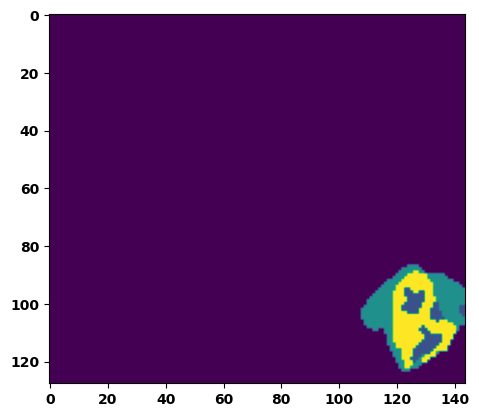

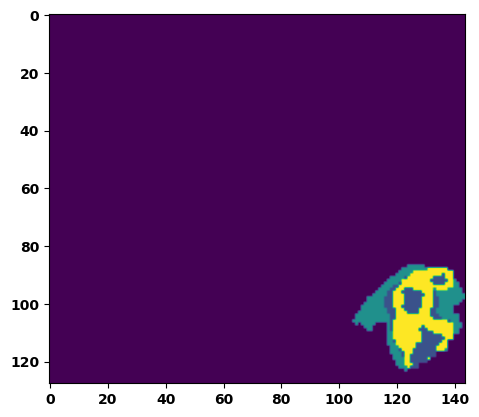

  6%|▌         | 2/36 [00:02<00:49,  1.45s/it]

Batch_id:  1 Eval loss:  0.20823492109775543
Batch_id:  1 Eval IoU:  tensor(0.6771, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9479, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9816, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:47,  1.43s/it]

Batch_id:  2 Eval loss:  0.500322699546814
Batch_id:  2 Eval IoU:  tensor(0.4056, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9425, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9302, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9380, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 11%|█         | 4/36 [00:05<00:45,  1.41s/it]

Batch_id:  3 Eval loss:  0.2846498489379883
Batch_id:  3 Eval IoU:  tensor(0.6165, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9563, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:44,  1.44s/it]

Batch_id:  4 Eval loss:  0.3892914354801178
Batch_id:  4 Eval IoU:  tensor(0.5404, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:44,  1.50s/it]

Batch_id:  5 Eval loss:  0.39749613404273987
Batch_id:  5 Eval IoU:  tensor(0.4890, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9408, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9253, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9192, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9894, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.48s/it]

Batch_id:  6 Eval loss:  0.09315052628517151
Batch_id:  6 Eval IoU:  tensor(0.8729, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:39,  1.42s/it]

Batch_id:  7 Eval loss:  0.17940855026245117
Batch_id:  7 Eval IoU:  tensor(0.7252, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:39,  1.46s/it]

Batch_id:  8 Eval loss:  0.1034560352563858
Batch_id:  8 Eval IoU:  tensor(0.8249, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:38,  1.49s/it]

Batch_id:  9 Eval loss:  0.1905619204044342
Batch_id:  9 Eval IoU:  tensor(0.7203, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  10 Eval loss:  0.15586304664611816
Batch_id:  10 Eval IoU:  tensor(0.7529, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9942, device='cuda:0')


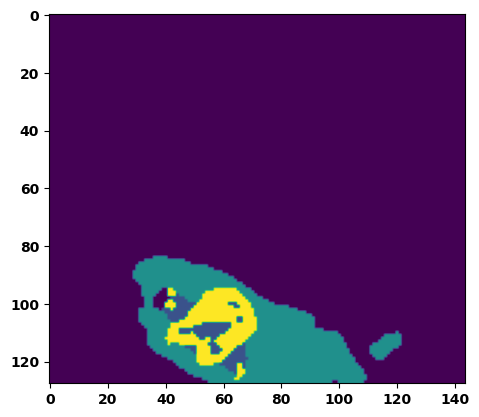

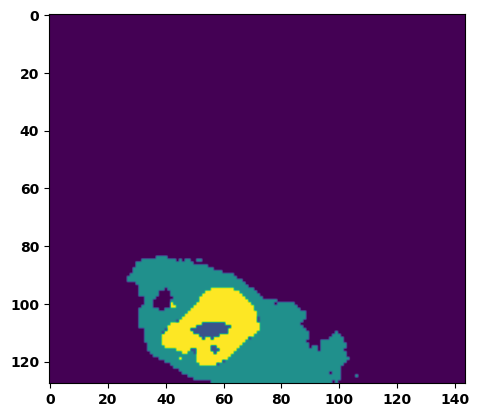

 33%|███▎      | 12/36 [00:17<00:34,  1.42s/it]

Batch_id:  11 Eval loss:  0.7191305756568909
Batch_id:  11 Eval IoU:  tensor(0.2542, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9519, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9331, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9456, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:31,  1.39s/it]

Batch_id:  12 Eval loss:  0.22311434149742126
Batch_id:  12 Eval IoU:  tensor(0.6815, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9810, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:30,  1.38s/it]

Batch_id:  13 Eval loss:  0.08110517263412476
Batch_id:  13 Eval IoU:  tensor(0.8622, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9970, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:28,  1.38s/it]

Batch_id:  14 Eval loss:  0.06753382086753845
Batch_id:  14 Eval IoU:  tensor(0.8841, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 44%|████▍     | 16/36 [00:22<00:28,  1.41s/it]

Batch_id:  15 Eval loss:  0.25562959909439087
Batch_id:  15 Eval IoU:  tensor(0.6963, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:27,  1.44s/it]

Batch_id:  16 Eval loss:  0.06170174479484558
Batch_id:  16 Eval IoU:  tensor(0.9009, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 50%|█████     | 18/36 [00:25<00:25,  1.44s/it]

Batch_id:  17 Eval loss:  0.28883522748947144
Batch_id:  17 Eval IoU:  tensor(0.6462, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.43s/it]

Batch_id:  18 Eval loss:  0.14973334968090057
Batch_id:  18 Eval IoU:  tensor(0.7578, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9849, device='cuda:0')


 56%|█████▌    | 20/36 [00:28<00:22,  1.42s/it]

Batch_id:  19 Eval loss:  0.08064176142215729
Batch_id:  19 Eval IoU:  tensor(0.8601, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  20 Eval loss:  0.09137541055679321
Batch_id:  20 Eval IoU:  tensor(0.8481, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


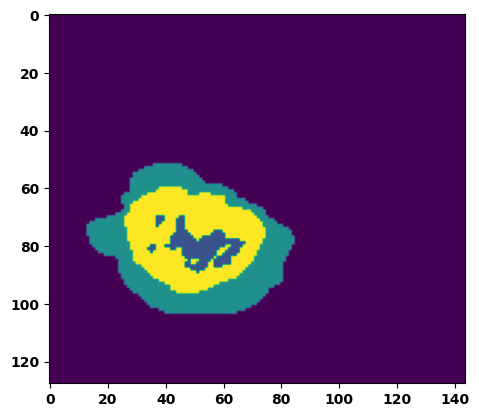

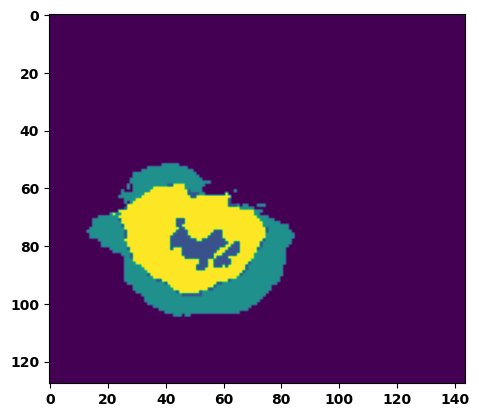

 61%|██████    | 22/36 [00:31<00:19,  1.42s/it]

Batch_id:  21 Eval loss:  0.20096156001091003
Batch_id:  21 Eval IoU:  tensor(0.7011, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9690, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9921, device='cuda:0')


 64%|██████▍   | 23/36 [00:32<00:17,  1.38s/it]

Batch_id:  22 Eval loss:  0.29913127422332764
Batch_id:  22 Eval IoU:  tensor(0.5977, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9549, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9358, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:17,  1.45s/it]

Batch_id:  23 Eval loss:  0.23982547223567963
Batch_id:  23 Eval IoU:  tensor(0.6613, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 69%|██████▉   | 25/36 [00:35<00:16,  1.47s/it]

Batch_id:  24 Eval loss:  0.5979337692260742
Batch_id:  24 Eval IoU:  tensor(0.3541, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


 72%|███████▏  | 26/36 [00:37<00:14,  1.43s/it]

Batch_id:  25 Eval loss:  0.10103961825370789
Batch_id:  25 Eval IoU:  tensor(0.8266, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 75%|███████▌  | 27/36 [00:38<00:13,  1.46s/it]

Batch_id:  26 Eval loss:  0.40264245867729187
Batch_id:  26 Eval IoU:  tensor(0.5227, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.42s/it]

Batch_id:  27 Eval loss:  0.07806697487831116
Batch_id:  27 Eval IoU:  tensor(0.8686, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')


 81%|████████  | 29/36 [00:41<00:09,  1.43s/it]

Batch_id:  28 Eval loss:  0.08814947307109833
Batch_id:  28 Eval IoU:  tensor(0.8475, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9901, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.43s/it]

Batch_id:  29 Eval loss:  0.05838139355182648
Batch_id:  29 Eval IoU:  tensor(0.8994, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  30 Eval loss:  0.12923100590705872
Batch_id:  30 Eval IoU:  tensor(0.7993, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9595, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


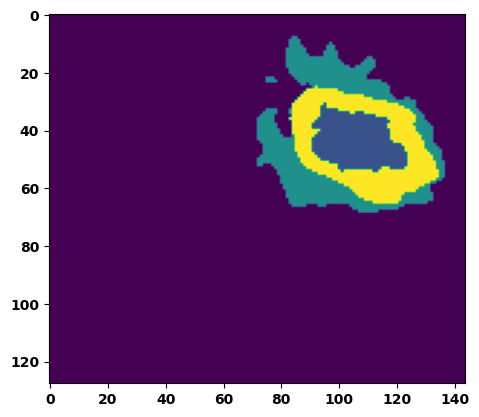

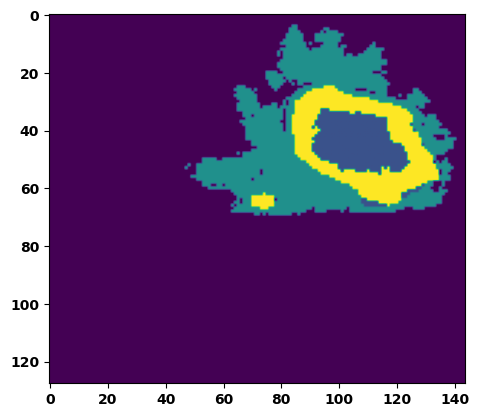

 89%|████████▉ | 32/36 [00:46<00:05,  1.47s/it]

Batch_id:  31 Eval loss:  0.07388177514076233
Batch_id:  31 Eval IoU:  tensor(0.8862, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 92%|█████████▏| 33/36 [00:47<00:04,  1.51s/it]

Batch_id:  32 Eval loss:  0.25683632493019104
Batch_id:  32 Eval IoU:  tensor(0.6505, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9459, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:03,  1.51s/it]

Batch_id:  33 Eval loss:  0.1437210887670517
Batch_id:  33 Eval IoU:  tensor(0.7851, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 97%|█████████▋| 35/36 [00:50<00:01,  1.50s/it]

Batch_id:  34 Eval loss:  0.4057539105415344
Batch_id:  34 Eval IoU:  tensor(0.5288, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9058, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.8598, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.8592, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


100%|██████████| 36/36 [00:52<00:00,  1.45s/it]

Batch_id:  35 Eval loss:  0.19705897569656372
Batch_id:  35 Eval IoU:  tensor(0.7005, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')
Epoch  45 Training loss:  0.16344043138352307
Epoch  45 Evaluation loss:  0.22175156573454538
Epoch  45 Training accuracy :  tensor(0.7657)
Epoch  45 Evaluation accuracy :  tensor(0.7047)
Epoch  45 Training Mean Dice Score:  tensor(0.9815)
Epoch  45 Eval Mean Dice Score:  tensor(0.9736)
Epoch  45 Training Non-tumor Dice Score:  tensor(0.9829)
Epoch  45 Eval Non-tumor Dice Score:  tensor(0.9726)
Epoch  45 Training NCR/NET Dice Score:  tensor(0.9916)
Epoch  45 Eval NCR/NET Dice Score:  tensor(0.9873)
Epoch  45 Training ED Dice Score:  tensor(0.

Epoch completed and model successfully saved
Epoch: 46
Training in session: 


  1%|          | 1/110 [00:01<02:53,  1.60s/it]

Batch_id:  0 Training loss:  0.08519148826599121
Batch_id:  0 Training IoU:  tensor(0.8525, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:43,  1.52s/it]

Batch_id:  1 Training loss:  0.17392238974571228
Batch_id:  1 Training IoU:  tensor(0.7402, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:41,  1.51s/it]

Batch_id:  2 Training loss:  0.0854361355304718
Batch_id:  2 Training IoU:  tensor(0.8657, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:43,  1.54s/it]

Batch_id:  3 Training loss:  0.11368255317211151
Batch_id:  3 Training IoU:  tensor(0.8192, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9669, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:34,  1.47s/it]

Batch_id:  4 Training loss:  0.08534722030162811
Batch_id:  4 Training IoU:  tensor(0.8531, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9835, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:31,  1.45s/it]

Batch_id:  5 Training loss:  0.09237322211265564
Batch_id:  5 Training IoU:  tensor(0.8422, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:31,  1.47s/it]

Batch_id:  6 Training loss:  0.24891355633735657
Batch_id:  6 Training IoU:  tensor(0.6509, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:33,  1.50s/it]

Batch_id:  7 Training loss:  0.20735269784927368
Batch_id:  7 Training IoU:  tensor(0.6888, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:28,  1.47s/it]

Batch_id:  8 Training loss:  0.1592126190662384
Batch_id:  8 Training IoU:  tensor(0.7638, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9640, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:33,  1.54s/it]

Batch_id:  9 Training loss:  0.24289405345916748
Batch_id:  9 Training IoU:  tensor(0.6606, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9843, device='cuda:0')


 10%|█         | 11/110 [00:16<02:29,  1.51s/it]

Batch_id:  10 Training loss:  0.21031306684017181
Batch_id:  10 Training IoU:  tensor(0.6912, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 11%|█         | 12/110 [00:18<02:28,  1.52s/it]

Batch_id:  11 Training loss:  0.23364917933940887
Batch_id:  11 Training IoU:  tensor(0.6540, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9399, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9532, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9369, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9769, device='cuda:0')


 12%|█▏        | 13/110 [00:19<02:26,  1.51s/it]

Batch_id:  12 Training loss:  0.09163463115692139
Batch_id:  12 Training IoU:  tensor(0.8464, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:27,  1.54s/it]

Batch_id:  13 Training loss:  0.21389104425907135
Batch_id:  13 Training IoU:  tensor(0.7355, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 14%|█▎        | 15/110 [00:22<02:22,  1.50s/it]

Batch_id:  14 Training loss:  0.13884297013282776
Batch_id:  14 Training IoU:  tensor(0.7854, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:18,  1.47s/it]

Batch_id:  15 Training loss:  0.10560692846775055
Batch_id:  15 Training IoU:  tensor(0.8245, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 15%|█▌        | 17/110 [00:25<02:21,  1.52s/it]

Batch_id:  16 Training loss:  0.12903428077697754
Batch_id:  16 Training IoU:  tensor(0.8044, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:17,  1.49s/it]

Batch_id:  17 Training loss:  0.1235421746969223
Batch_id:  17 Training IoU:  tensor(0.8017, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 17%|█▋        | 19/110 [00:28<02:18,  1.52s/it]

Batch_id:  18 Training loss:  0.26518797874450684
Batch_id:  18 Training IoU:  tensor(0.6473, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:15,  1.50s/it]

Batch_id:  19 Training loss:  0.1039436012506485
Batch_id:  19 Training IoU:  tensor(0.8244, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 19%|█▉        | 21/110 [00:31<02:14,  1.51s/it]

Batch_id:  20 Training loss:  0.1280931979417801
Batch_id:  20 Training IoU:  tensor(0.7893, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 20%|██        | 22/110 [00:32<02:09,  1.47s/it]

Batch_id:  21 Training loss:  0.09655120968818665
Batch_id:  21 Training IoU:  tensor(0.8389, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 21%|██        | 23/110 [00:34<02:10,  1.49s/it]

Batch_id:  22 Training loss:  0.3871607780456543
Batch_id:  22 Training IoU:  tensor(0.5168, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9263, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:13,  1.55s/it]

Batch_id:  23 Training loss:  0.1813032478094101
Batch_id:  23 Training IoU:  tensor(0.7211, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9657, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 23%|██▎       | 25/110 [00:37<02:10,  1.53s/it]

Batch_id:  24 Training loss:  0.15189604461193085
Batch_id:  24 Training IoU:  tensor(0.7557, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:11,  1.56s/it]

Batch_id:  25 Training loss:  0.04690323770046234
Batch_id:  25 Training IoU:  tensor(0.9175, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 25%|██▍       | 27/110 [00:40<02:04,  1.51s/it]

Batch_id:  26 Training loss:  0.21504858136177063
Batch_id:  26 Training IoU:  tensor(0.6785, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9782, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9757, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 25%|██▌       | 28/110 [00:42<02:04,  1.51s/it]

Batch_id:  27 Training loss:  0.12398497760295868
Batch_id:  27 Training IoU:  tensor(0.8096, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 26%|██▋       | 29/110 [00:43<02:00,  1.49s/it]

Batch_id:  28 Training loss:  0.10990883409976959
Batch_id:  28 Training IoU:  tensor(0.8192, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9782, device='cuda:0')


 27%|██▋       | 30/110 [00:45<01:58,  1.48s/it]

Batch_id:  29 Training loss:  0.10453587770462036
Batch_id:  29 Training IoU:  tensor(0.8230, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9823, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 28%|██▊       | 31/110 [00:46<01:56,  1.48s/it]

Batch_id:  30 Training loss:  0.040990978479385376
Batch_id:  30 Training IoU:  tensor(0.9289, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 29%|██▉       | 32/110 [00:48<01:54,  1.47s/it]

Batch_id:  31 Training loss:  0.2079475373029709
Batch_id:  31 Training IoU:  tensor(0.6901, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 30%|███       | 33/110 [00:49<01:53,  1.48s/it]

Batch_id:  32 Training loss:  0.2731369733810425
Batch_id:  32 Training IoU:  tensor(0.6713, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 31%|███       | 34/110 [00:51<01:52,  1.48s/it]

Batch_id:  33 Training loss:  0.18814034759998322
Batch_id:  33 Training IoU:  tensor(0.7106, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9738, device='cuda:0')


 32%|███▏      | 35/110 [00:52<01:49,  1.46s/it]

Batch_id:  34 Training loss:  0.20128053426742554
Batch_id:  34 Training IoU:  tensor(0.6918, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9408, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9255, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 33%|███▎      | 36/110 [00:53<01:48,  1.46s/it]

Batch_id:  35 Training loss:  0.05518297851085663
Batch_id:  35 Training IoU:  tensor(0.9051, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 34%|███▎      | 37/110 [00:55<01:47,  1.47s/it]

Batch_id:  36 Training loss:  0.12339474260807037
Batch_id:  36 Training IoU:  tensor(0.8143, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 35%|███▍      | 38/110 [00:56<01:46,  1.47s/it]

Batch_id:  37 Training loss:  0.16846740245819092
Batch_id:  37 Training IoU:  tensor(0.7374, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 35%|███▌      | 39/110 [00:58<01:44,  1.47s/it]

Batch_id:  38 Training loss:  0.16169245541095734
Batch_id:  38 Training IoU:  tensor(0.8125, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 36%|███▋      | 40/110 [00:59<01:43,  1.48s/it]

Batch_id:  39 Training loss:  0.12041476368904114
Batch_id:  39 Training IoU:  tensor(0.8068, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


 37%|███▋      | 41/110 [01:01<01:42,  1.49s/it]

Batch_id:  40 Training loss:  0.10787688195705414
Batch_id:  40 Training IoU:  tensor(0.8192, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9543, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 38%|███▊      | 42/110 [01:02<01:39,  1.47s/it]

Batch_id:  41 Training loss:  0.2463342249393463
Batch_id:  41 Training IoU:  tensor(0.6364, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9771, device='cuda:0')


 39%|███▉      | 43/110 [01:04<01:42,  1.53s/it]

Batch_id:  42 Training loss:  0.16787901520729065
Batch_id:  42 Training IoU:  tensor(0.8251, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 40%|████      | 44/110 [01:05<01:39,  1.51s/it]

Batch_id:  43 Training loss:  0.24610383808612823
Batch_id:  43 Training IoU:  tensor(0.6858, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 41%|████      | 45/110 [01:07<01:37,  1.50s/it]

Batch_id:  44 Training loss:  0.0867796391248703
Batch_id:  44 Training IoU:  tensor(0.8493, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 42%|████▏     | 46/110 [01:08<01:34,  1.47s/it]

Batch_id:  45 Training loss:  0.21680060029029846
Batch_id:  45 Training IoU:  tensor(0.7337, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 43%|████▎     | 47/110 [01:10<01:33,  1.48s/it]

Batch_id:  46 Training loss:  0.14430807530879974
Batch_id:  46 Training IoU:  tensor(0.7743, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 44%|████▎     | 48/110 [01:11<01:31,  1.48s/it]

Batch_id:  47 Training loss:  0.08703339099884033
Batch_id:  47 Training IoU:  tensor(0.8537, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 45%|████▍     | 49/110 [01:13<01:30,  1.49s/it]

Batch_id:  48 Training loss:  0.17502270638942719
Batch_id:  48 Training IoU:  tensor(0.7399, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 45%|████▌     | 50/110 [01:14<01:27,  1.47s/it]

Batch_id:  49 Training loss:  0.2611764073371887
Batch_id:  49 Training IoU:  tensor(0.6309, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9553, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9304, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 46%|████▋     | 51/110 [01:16<01:27,  1.48s/it]

Batch_id:  50 Training loss:  0.1672438085079193
Batch_id:  50 Training IoU:  tensor(0.7296, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 47%|████▋     | 52/110 [01:17<01:24,  1.45s/it]

Batch_id:  51 Training loss:  0.07251286506652832
Batch_id:  51 Training IoU:  tensor(0.8739, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 48%|████▊     | 53/110 [01:19<01:23,  1.46s/it]

Batch_id:  52 Training loss:  0.044924959540367126
Batch_id:  52 Training IoU:  tensor(0.9231, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 49%|████▉     | 54/110 [01:20<01:20,  1.44s/it]

Batch_id:  53 Training loss:  0.20943941175937653
Batch_id:  53 Training IoU:  tensor(0.7167, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 50%|█████     | 55/110 [01:21<01:18,  1.44s/it]

Batch_id:  54 Training loss:  0.06690236926078796
Batch_id:  54 Training IoU:  tensor(0.8834, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 51%|█████     | 56/110 [01:23<01:18,  1.46s/it]

Batch_id:  55 Training loss:  0.16084139049053192
Batch_id:  55 Training IoU:  tensor(0.7878, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 52%|█████▏    | 57/110 [01:25<01:19,  1.50s/it]

Batch_id:  56 Training loss:  0.34390729665756226
Batch_id:  56 Training IoU:  tensor(0.6331, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 53%|█████▎    | 58/110 [01:26<01:17,  1.50s/it]

Batch_id:  57 Training loss:  0.15648223459720612
Batch_id:  57 Training IoU:  tensor(0.7489, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 54%|█████▎    | 59/110 [01:28<01:18,  1.54s/it]

Batch_id:  58 Training loss:  0.27018898725509644
Batch_id:  58 Training IoU:  tensor(0.6340, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9580, device='cuda:0')


 55%|█████▍    | 60/110 [01:29<01:17,  1.55s/it]

Batch_id:  59 Training loss:  0.12895821034908295
Batch_id:  59 Training IoU:  tensor(0.8093, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 55%|█████▌    | 61/110 [01:31<01:14,  1.52s/it]

Batch_id:  60 Training loss:  0.13675537705421448
Batch_id:  60 Training IoU:  tensor(0.7719, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9750, device='cuda:0')


 56%|█████▋    | 62/110 [01:32<01:12,  1.51s/it]

Batch_id:  61 Training loss:  0.1509258896112442
Batch_id:  61 Training IoU:  tensor(0.8196, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 57%|█████▋    | 63/110 [01:34<01:11,  1.53s/it]

Batch_id:  62 Training loss:  0.155246764421463
Batch_id:  62 Training IoU:  tensor(0.7461, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9819, device='cuda:0')


 58%|█████▊    | 64/110 [01:35<01:10,  1.54s/it]

Batch_id:  63 Training loss:  0.04889708757400513
Batch_id:  63 Training IoU:  tensor(0.9207, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 59%|█████▉    | 65/110 [01:37<01:10,  1.57s/it]

Batch_id:  64 Training loss:  0.09222288429737091
Batch_id:  64 Training IoU:  tensor(0.8392, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 60%|██████    | 66/110 [01:39<01:09,  1.57s/it]

Batch_id:  65 Training loss:  0.13879574835300446
Batch_id:  65 Training IoU:  tensor(0.7933, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 61%|██████    | 67/110 [01:40<01:08,  1.59s/it]

Batch_id:  66 Training loss:  0.08454807102680206
Batch_id:  66 Training IoU:  tensor(0.8805, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 62%|██████▏   | 68/110 [01:42<01:07,  1.62s/it]

Batch_id:  67 Training loss:  0.05826389789581299
Batch_id:  67 Training IoU:  tensor(0.8993, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 63%|██████▎   | 69/110 [01:43<01:04,  1.58s/it]

Batch_id:  68 Training loss:  0.06472918391227722
Batch_id:  68 Training IoU:  tensor(0.8913, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 64%|██████▎   | 70/110 [01:45<01:01,  1.53s/it]

Batch_id:  69 Training loss:  0.31666702032089233
Batch_id:  69 Training IoU:  tensor(0.6524, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 65%|██████▍   | 71/110 [01:46<00:58,  1.51s/it]

Batch_id:  70 Training loss:  0.14549537003040314
Batch_id:  70 Training IoU:  tensor(0.7654, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9662, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 65%|██████▌   | 72/110 [01:48<00:56,  1.48s/it]

Batch_id:  71 Training loss:  0.08721713721752167
Batch_id:  71 Training IoU:  tensor(0.8554, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 66%|██████▋   | 73/110 [01:49<00:56,  1.51s/it]

Batch_id:  72 Training loss:  0.10842205584049225
Batch_id:  72 Training IoU:  tensor(0.8241, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 67%|██████▋   | 74/110 [01:51<00:55,  1.53s/it]

Batch_id:  73 Training loss:  0.34807896614074707
Batch_id:  73 Training IoU:  tensor(0.5896, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9982, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 68%|██████▊   | 75/110 [01:52<00:53,  1.53s/it]

Batch_id:  74 Training loss:  0.24340727925300598
Batch_id:  74 Training IoU:  tensor(0.7143, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 69%|██████▉   | 76/110 [01:54<00:51,  1.52s/it]

Batch_id:  75 Training loss:  0.4553602933883667
Batch_id:  75 Training IoU:  tensor(0.4673, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 70%|███████   | 77/110 [01:55<00:50,  1.52s/it]

Batch_id:  76 Training loss:  0.18857277929782867
Batch_id:  76 Training IoU:  tensor(0.7219, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 71%|███████   | 78/110 [01:57<00:47,  1.49s/it]

Batch_id:  77 Training loss:  0.1503252238035202
Batch_id:  77 Training IoU:  tensor(0.7852, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 72%|███████▏  | 79/110 [01:58<00:46,  1.49s/it]

Batch_id:  78 Training loss:  0.19055941700935364
Batch_id:  78 Training IoU:  tensor(0.7156, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9610, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9675, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9711, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9778, device='cuda:0')


 73%|███████▎  | 80/110 [02:00<00:43,  1.47s/it]

Batch_id:  79 Training loss:  0.24932190775871277
Batch_id:  79 Training IoU:  tensor(0.6470, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 74%|███████▎  | 81/110 [02:01<00:43,  1.49s/it]

Batch_id:  80 Training loss:  0.32674652338027954
Batch_id:  80 Training IoU:  tensor(0.6190, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 75%|███████▍  | 82/110 [02:03<00:42,  1.52s/it]

Batch_id:  81 Training loss:  0.3224947452545166
Batch_id:  81 Training IoU:  tensor(0.6156, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9588, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9493, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 75%|███████▌  | 83/110 [02:04<00:41,  1.52s/it]

Batch_id:  82 Training loss:  0.12268541753292084
Batch_id:  82 Training IoU:  tensor(0.8036, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 76%|███████▋  | 84/110 [02:06<00:40,  1.54s/it]

Batch_id:  83 Training loss:  0.0997498631477356
Batch_id:  83 Training IoU:  tensor(0.8330, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 77%|███████▋  | 85/110 [02:07<00:37,  1.51s/it]

Batch_id:  84 Training loss:  0.5249612331390381
Batch_id:  84 Training IoU:  tensor(0.4237, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9784, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 78%|███████▊  | 86/110 [02:09<00:36,  1.51s/it]

Batch_id:  85 Training loss:  0.38175123929977417
Batch_id:  85 Training IoU:  tensor(0.5386, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 79%|███████▉  | 87/110 [02:11<00:36,  1.57s/it]

Batch_id:  86 Training loss:  0.08801145851612091
Batch_id:  86 Training IoU:  tensor(0.8483, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 80%|████████  | 88/110 [02:12<00:34,  1.58s/it]

Batch_id:  87 Training loss:  0.15773563086986542
Batch_id:  87 Training IoU:  tensor(0.7503, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9709, device='cuda:0')


 81%|████████  | 89/110 [02:14<00:34,  1.62s/it]

Batch_id:  88 Training loss:  0.13776417076587677
Batch_id:  88 Training IoU:  tensor(0.8140, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 82%|████████▏ | 90/110 [02:15<00:32,  1.62s/it]

Batch_id:  89 Training loss:  0.09084391593933105
Batch_id:  89 Training IoU:  tensor(0.8442, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 83%|████████▎ | 91/110 [02:17<00:30,  1.62s/it]

Batch_id:  90 Training loss:  0.10545657575130463
Batch_id:  90 Training IoU:  tensor(0.8323, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9853, device='cuda:0')


 84%|████████▎ | 92/110 [02:19<00:29,  1.63s/it]

Batch_id:  91 Training loss:  0.10150627791881561
Batch_id:  91 Training IoU:  tensor(0.8446, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 85%|████████▍ | 93/110 [02:20<00:27,  1.60s/it]

Batch_id:  92 Training loss:  0.05642397701740265
Batch_id:  92 Training IoU:  tensor(0.9044, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 85%|████████▌ | 94/110 [02:22<00:24,  1.54s/it]

Batch_id:  93 Training loss:  0.1368357390165329
Batch_id:  93 Training IoU:  tensor(0.8005, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 86%|████████▋ | 95/110 [02:23<00:23,  1.55s/it]

Batch_id:  94 Training loss:  0.07726876437664032
Batch_id:  94 Training IoU:  tensor(0.8715, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 87%|████████▋ | 96/110 [02:25<00:20,  1.49s/it]

Batch_id:  95 Training loss:  0.20230674743652344
Batch_id:  95 Training IoU:  tensor(0.6975, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 88%|████████▊ | 97/110 [02:26<00:20,  1.56s/it]

Batch_id:  96 Training loss:  0.15585556626319885
Batch_id:  96 Training IoU:  tensor(0.7504, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 89%|████████▉ | 98/110 [02:28<00:17,  1.48s/it]

Batch_id:  97 Training loss:  0.09302474558353424
Batch_id:  97 Training IoU:  tensor(0.8492, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 90%|█████████ | 99/110 [02:29<00:17,  1.56s/it]

Batch_id:  98 Training loss:  0.08802387118339539
Batch_id:  98 Training IoU:  tensor(0.8553, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 91%|█████████ | 100/110 [02:31<00:15,  1.52s/it]

Batch_id:  99 Training loss:  0.1295410394668579
Batch_id:  99 Training IoU:  tensor(0.7939, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 92%|█████████▏| 101/110 [02:32<00:13,  1.50s/it]

Batch_id:  100 Training loss:  0.09322051703929901
Batch_id:  100 Training IoU:  tensor(0.8412, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9899, device='cuda:0')


 93%|█████████▎| 102/110 [02:34<00:12,  1.51s/it]

Batch_id:  101 Training loss:  0.09625865519046783
Batch_id:  101 Training IoU:  tensor(0.8386, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 94%|█████████▎| 103/110 [02:35<00:10,  1.45s/it]

Batch_id:  102 Training loss:  0.2012825459241867
Batch_id:  102 Training IoU:  tensor(0.6999, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 95%|█████████▍| 104/110 [02:36<00:08,  1.43s/it]

Batch_id:  103 Training loss:  0.17822320759296417
Batch_id:  103 Training IoU:  tensor(0.7180, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9663, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 95%|█████████▌| 105/110 [02:38<00:07,  1.46s/it]

Batch_id:  104 Training loss:  0.260543555021286
Batch_id:  104 Training IoU:  tensor(0.6943, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 96%|█████████▋| 106/110 [02:40<00:05,  1.49s/it]

Batch_id:  105 Training loss:  0.18201155960559845
Batch_id:  105 Training IoU:  tensor(0.7228, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9696, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9880, device='cuda:0')


 97%|█████████▋| 107/110 [02:41<00:04,  1.46s/it]

Batch_id:  106 Training loss:  0.15016062557697296
Batch_id:  106 Training IoU:  tensor(0.7580, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 98%|█████████▊| 108/110 [02:42<00:02,  1.46s/it]

Batch_id:  107 Training loss:  0.233137309551239
Batch_id:  107 Training IoU:  tensor(0.6549, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9574, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9435, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 99%|█████████▉| 109/110 [02:44<00:01,  1.54s/it]

Batch_id:  108 Training loss:  0.07660345733165741
Batch_id:  108 Training IoU:  tensor(0.8821, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


100%|██████████| 110/110 [02:45<00:00,  1.51s/it]


Batch_id:  109 Training loss:  0.12069068849086761
Batch_id:  109 Training IoU:  tensor(0.8000, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9865, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.07786238193511963
Batch_id:  0 Eval IoU:  tensor(0.8692, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9869, device='cuda:0')


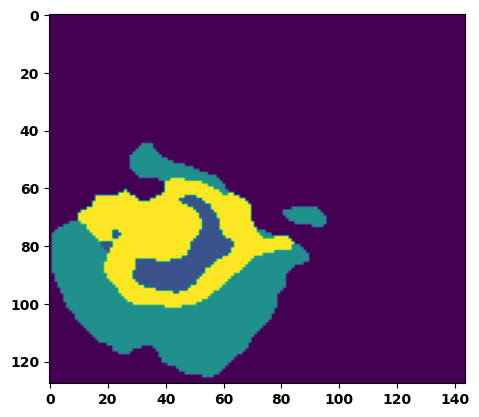

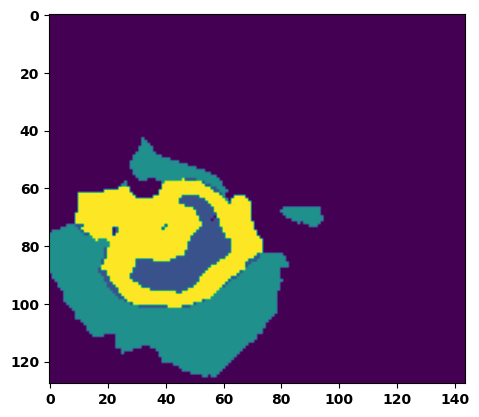

  6%|▌         | 2/36 [00:03<00:53,  1.59s/it]

Batch_id:  1 Eval loss:  0.1507672220468521
Batch_id:  1 Eval IoU:  tensor(0.7557, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9848, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:47,  1.45s/it]

Batch_id:  2 Eval loss:  0.15714186429977417
Batch_id:  2 Eval IoU:  tensor(0.7512, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')


 11%|█         | 4/36 [00:05<00:46,  1.47s/it]

Batch_id:  3 Eval loss:  0.10362209379673004
Batch_id:  3 Eval IoU:  tensor(0.8252, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:45,  1.48s/it]

Batch_id:  4 Eval loss:  0.7181503772735596
Batch_id:  4 Eval IoU:  tensor(0.2548, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9517, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9331, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:44,  1.50s/it]

Batch_id:  5 Eval loss:  0.5979465246200562
Batch_id:  5 Eval IoU:  tensor(0.3544, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9949, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:42,  1.45s/it]

Batch_id:  6 Eval loss:  0.19093723595142365
Batch_id:  6 Eval IoU:  tensor(0.7200, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.45s/it]

Batch_id:  7 Eval loss:  0.3004932105541229
Batch_id:  7 Eval IoU:  tensor(0.5960, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9362, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 25%|██▌       | 9/36 [00:13<00:38,  1.43s/it]

Batch_id:  8 Eval loss:  0.3984295725822449
Batch_id:  8 Eval IoU:  tensor(0.4876, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9252, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9190, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:37,  1.43s/it]

Batch_id:  9 Eval loss:  0.40499475598335266
Batch_id:  9 Eval IoU:  tensor(0.5293, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9061, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.8602, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.8596, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  10 Eval loss:  0.06765072047710419
Batch_id:  10 Eval IoU:  tensor(0.8837, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


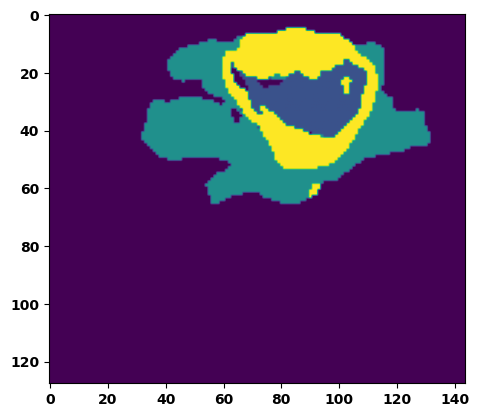

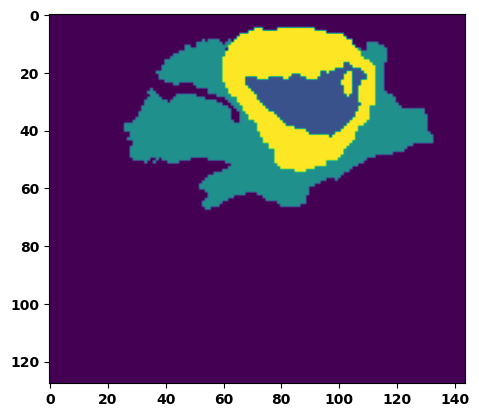

 33%|███▎      | 12/36 [00:17<00:33,  1.41s/it]

Batch_id:  11 Eval loss:  0.1794271320104599
Batch_id:  11 Eval IoU:  tensor(0.7247, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


 36%|███▌      | 13/36 [00:18<00:31,  1.38s/it]

Batch_id:  12 Eval loss:  0.0925394743680954
Batch_id:  12 Eval IoU:  tensor(0.8460, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9945, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:29,  1.35s/it]

Batch_id:  13 Eval loss:  0.4028504490852356
Batch_id:  13 Eval IoU:  tensor(0.5227, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9652, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 42%|████▏     | 15/36 [00:21<00:29,  1.40s/it]

Batch_id:  14 Eval loss:  0.19624438881874084
Batch_id:  14 Eval IoU:  tensor(0.7007, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:28,  1.43s/it]

Batch_id:  15 Eval loss:  0.058234184980392456
Batch_id:  15 Eval IoU:  tensor(0.8995, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 47%|████▋     | 17/36 [00:24<00:26,  1.39s/it]

Batch_id:  16 Eval loss:  0.1439761519432068
Batch_id:  16 Eval IoU:  tensor(0.7852, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9909, device='cuda:0')


 50%|█████     | 18/36 [00:25<00:24,  1.36s/it]

Batch_id:  17 Eval loss:  0.12847980856895447
Batch_id:  17 Eval IoU:  tensor(0.8003, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9453, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 53%|█████▎    | 19/36 [00:26<00:22,  1.34s/it]

Batch_id:  18 Eval loss:  0.2026054859161377
Batch_id:  18 Eval IoU:  tensor(0.6994, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9702, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9698, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9920, device='cuda:0')


 56%|█████▌    | 20/36 [00:28<00:22,  1.38s/it]

Batch_id:  19 Eval loss:  0.18961304426193237
Batch_id:  19 Eval IoU:  tensor(0.7214, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')
Batch_id:  20 Eval loss:  0.289661169052124
Batch_id:  20 Eval IoU:  tensor(0.6467, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


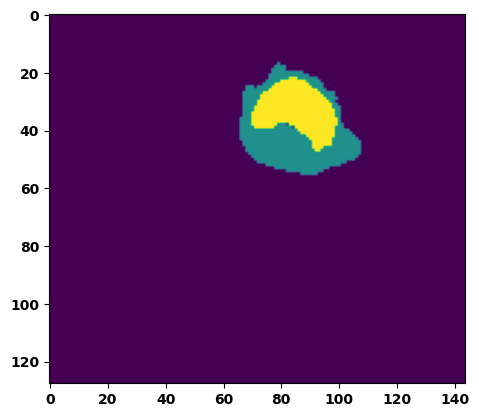

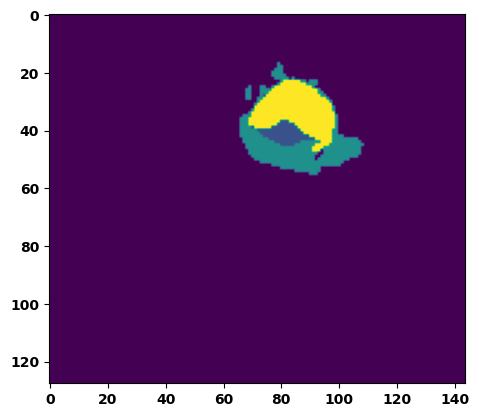

 61%|██████    | 22/36 [00:31<00:20,  1.48s/it]

Batch_id:  21 Eval loss:  0.38930824398994446
Batch_id:  21 Eval IoU:  tensor(0.5402, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 64%|██████▍   | 23/36 [00:32<00:18,  1.42s/it]

Batch_id:  22 Eval loss:  0.07413440942764282
Batch_id:  22 Eval IoU:  tensor(0.8863, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:16,  1.39s/it]

Batch_id:  23 Eval loss:  0.2059207558631897
Batch_id:  23 Eval IoU:  tensor(0.6798, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9530, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9486, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9550, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9819, device='cuda:0')


 69%|██████▉   | 25/36 [00:35<00:15,  1.43s/it]

Batch_id:  24 Eval loss:  0.09288047254085541
Batch_id:  24 Eval IoU:  tensor(0.8708, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


 72%|███████▏  | 26/36 [00:36<00:13,  1.38s/it]

Batch_id:  25 Eval loss:  0.08953961730003357
Batch_id:  25 Eval IoU:  tensor(0.8452, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


 75%|███████▌  | 27/36 [00:38<00:12,  1.44s/it]

Batch_id:  26 Eval loss:  0.25542575120925903
Batch_id:  26 Eval IoU:  tensor(0.6517, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


 78%|███████▊  | 28/36 [00:39<00:11,  1.44s/it]

Batch_id:  27 Eval loss:  0.25506681203842163
Batch_id:  27 Eval IoU:  tensor(0.6966, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 81%|████████  | 29/36 [00:41<00:10,  1.45s/it]

Batch_id:  28 Eval loss:  0.24118447303771973
Batch_id:  28 Eval IoU:  tensor(0.6599, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 83%|████████▎ | 30/36 [00:42<00:08,  1.44s/it]

Batch_id:  29 Eval loss:  0.5002314448356628
Batch_id:  29 Eval IoU:  tensor(0.4057, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9301, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9379, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  30 Eval loss:  0.2229142040014267
Batch_id:  30 Eval IoU:  tensor(0.6823, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9806, device='cuda:0')


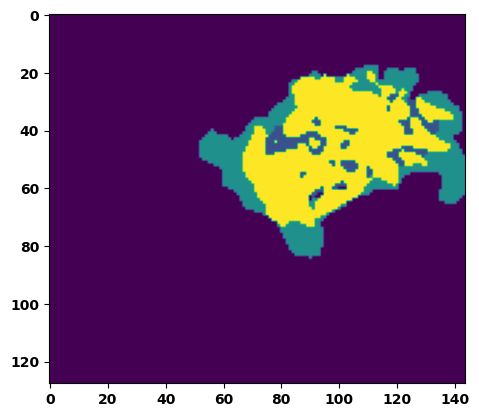

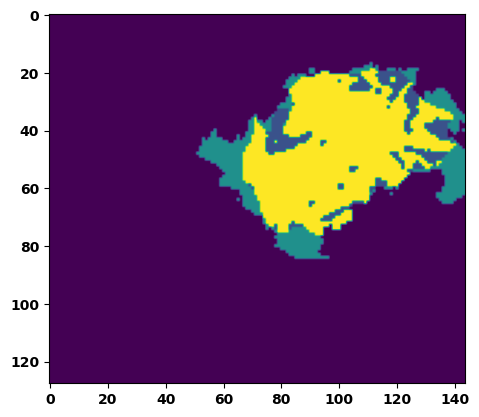

 89%|████████▉ | 32/36 [00:45<00:05,  1.46s/it]

Batch_id:  31 Eval loss:  0.08020666241645813
Batch_id:  31 Eval IoU:  tensor(0.8608, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9909, device='cuda:0')


 92%|█████████▏| 33/36 [00:47<00:04,  1.44s/it]

Batch_id:  32 Eval loss:  0.08133663237094879
Batch_id:  32 Eval IoU:  tensor(0.8615, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 94%|█████████▍| 34/36 [00:48<00:02,  1.48s/it]

Batch_id:  33 Eval loss:  0.1004871279001236
Batch_id:  33 Eval IoU:  tensor(0.8272, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')


 97%|█████████▋| 35/36 [00:50<00:01,  1.40s/it]

Batch_id:  34 Eval loss:  0.28441888093948364
Batch_id:  34 Eval IoU:  tensor(0.6162, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9579, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9564, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9402, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


100%|██████████| 36/36 [00:51<00:00,  1.43s/it]

Batch_id:  35 Eval loss:  0.06208905577659607
Batch_id:  35 Eval IoU:  tensor(0.9003, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')
Epoch  46 Training loss:  0.16328777074813844
Epoch  46 Evaluation loss:  0.22185477200481626
Epoch  46 Training accuracy :  tensor(0.7662)
Epoch  46 Evaluation accuracy :  tensor(0.7044)
Epoch  46 Training Mean Dice Score:  tensor(0.9816)
Epoch  46 Eval Mean Dice Score:  tensor(0.9736)
Epoch  46 Training Non-tumor Dice Score:  tensor(0.9830)
Epoch  46 Eval Non-tumor Dice Score:  tensor(0.9726)
Epoch  46 Training NCR/NET Dice Score:  tensor(0.9917)
Epoch  46 Eval NCR/NET Dice Score:  tensor(0.9872)
Epoch  46 Training ED Dice Score:  tensor(0.

Epoch: 47
Training in session: 


  1%|          | 1/110 [00:01<02:30,  1.38s/it]

Batch_id:  0 Training loss:  0.32065606117248535
Batch_id:  0 Training IoU:  tensor(0.6174, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9658, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9589, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9501, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:34,  1.43s/it]

Batch_id:  1 Training loss:  0.16577263176441193
Batch_id:  1 Training IoU:  tensor(0.7324, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:31,  1.41s/it]

Batch_id:  2 Training loss:  0.1525077521800995
Batch_id:  2 Training IoU:  tensor(0.7840, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:34,  1.46s/it]

Batch_id:  3 Training loss:  0.24879613518714905
Batch_id:  3 Training IoU:  tensor(0.6511, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9855, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:27,  1.41s/it]

Batch_id:  4 Training loss:  0.20159655809402466
Batch_id:  4 Training IoU:  tensor(0.6995, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:35,  1.49s/it]

Batch_id:  5 Training loss:  0.15052609145641327
Batch_id:  5 Training IoU:  tensor(0.7582, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:29,  1.45s/it]

Batch_id:  6 Training loss:  0.045319005846977234
Batch_id:  6 Training IoU:  tensor(0.9220, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:32,  1.49s/it]

Batch_id:  7 Training loss:  0.12965050339698792
Batch_id:  7 Training IoU:  tensor(0.8097, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:30,  1.49s/it]

Batch_id:  8 Training loss:  0.3268704116344452
Batch_id:  8 Training IoU:  tensor(0.6184, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:27,  1.47s/it]

Batch_id:  9 Training loss:  0.15286590158939362
Batch_id:  9 Training IoU:  tensor(0.7493, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9651, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9823, device='cuda:0')


 10%|█         | 11/110 [00:16<02:26,  1.48s/it]

Batch_id:  10 Training loss:  0.2710839807987213
Batch_id:  10 Training IoU:  tensor(0.6321, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9575, device='cuda:0')


 11%|█         | 12/110 [00:17<02:22,  1.46s/it]

Batch_id:  11 Training loss:  0.09319746494293213
Batch_id:  11 Training IoU:  tensor(0.8377, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:18,  1.43s/it]

Batch_id:  12 Training loss:  0.08747836947441101
Batch_id:  12 Training IoU:  tensor(0.8534, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:14,  1.40s/it]

Batch_id:  13 Training loss:  0.2600868344306946
Batch_id:  13 Training IoU:  tensor(0.6321, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9507, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9552, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9302, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:15,  1.42s/it]

Batch_id:  14 Training loss:  0.11063507199287415
Batch_id:  14 Training IoU:  tensor(0.8179, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:15,  1.44s/it]

Batch_id:  15 Training loss:  0.09094204008579254
Batch_id:  15 Training IoU:  tensor(0.8474, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:14,  1.45s/it]

Batch_id:  16 Training loss:  0.3450213074684143
Batch_id:  16 Training IoU:  tensor(0.6278, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 16%|█▋        | 18/110 [00:25<02:08,  1.40s/it]

Batch_id:  17 Training loss:  0.0684279352426529
Batch_id:  17 Training IoU:  tensor(0.8807, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:07,  1.40s/it]

Batch_id:  18 Training loss:  0.10183919966220856
Batch_id:  18 Training IoU:  tensor(0.8440, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9925, device='cuda:0')


 18%|█▊        | 20/110 [00:28<02:05,  1.39s/it]

Batch_id:  19 Training loss:  0.10809129476547241
Batch_id:  19 Training IoU:  tensor(0.8211, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:07,  1.43s/it]

Batch_id:  20 Training loss:  0.057720690965652466
Batch_id:  20 Training IoU:  tensor(0.9004, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 20%|██        | 22/110 [00:31<02:05,  1.42s/it]

Batch_id:  21 Training loss:  0.08878839015960693
Batch_id:  21 Training IoU:  tensor(0.8530, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 21%|██        | 23/110 [00:32<02:02,  1.41s/it]

Batch_id:  22 Training loss:  0.15061885118484497
Batch_id:  22 Training IoU:  tensor(0.7565, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9887, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:04,  1.45s/it]

Batch_id:  23 Training loss:  0.12291404604911804
Batch_id:  23 Training IoU:  tensor(0.8154, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 23%|██▎       | 25/110 [00:35<01:58,  1.40s/it]

Batch_id:  24 Training loss:  0.0730186253786087
Batch_id:  24 Training IoU:  tensor(0.8733, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 24%|██▎       | 26/110 [00:37<01:59,  1.42s/it]

Batch_id:  25 Training loss:  0.14496363699436188
Batch_id:  25 Training IoU:  tensor(0.7727, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 25%|██▍       | 27/110 [00:38<01:58,  1.43s/it]

Batch_id:  26 Training loss:  0.09325887262821198
Batch_id:  26 Training IoU:  tensor(0.8491, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9975, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 25%|██▌       | 28/110 [00:40<01:57,  1.44s/it]

Batch_id:  27 Training loss:  0.26286688446998596
Batch_id:  27 Training IoU:  tensor(0.6499, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 26%|██▋       | 29/110 [00:41<01:57,  1.45s/it]

Batch_id:  28 Training loss:  0.10497842729091644
Batch_id:  28 Training IoU:  tensor(0.8231, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 27%|██▋       | 30/110 [00:43<02:00,  1.50s/it]

Batch_id:  29 Training loss:  0.214779332280159
Batch_id:  29 Training IoU:  tensor(0.7343, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9978, device='cuda:0')


 28%|██▊       | 31/110 [00:44<01:59,  1.52s/it]

Batch_id:  30 Training loss:  0.13797643780708313
Batch_id:  30 Training IoU:  tensor(0.8116, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:53,  1.46s/it]

Batch_id:  31 Training loss:  0.1439715176820755
Batch_id:  31 Training IoU:  tensor(0.7670, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9693, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 30%|███       | 33/110 [00:47<01:53,  1.47s/it]

Batch_id:  32 Training loss:  0.04883025586605072
Batch_id:  32 Training IoU:  tensor(0.9208, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 31%|███       | 34/110 [00:49<01:51,  1.47s/it]

Batch_id:  33 Training loss:  0.12397722899913788
Batch_id:  33 Training IoU:  tensor(0.8011, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:49,  1.45s/it]

Batch_id:  34 Training loss:  0.0415215790271759
Batch_id:  34 Training IoU:  tensor(0.9282, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 33%|███▎      | 36/110 [00:51<01:47,  1.45s/it]

Batch_id:  35 Training loss:  0.5263599157333374
Batch_id:  35 Training IoU:  tensor(0.4220, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:46,  1.46s/it]

Batch_id:  36 Training loss:  0.34726759791374207
Batch_id:  36 Training IoU:  tensor(0.5900, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 35%|███▍      | 38/110 [00:54<01:44,  1.45s/it]

Batch_id:  37 Training loss:  0.12016540765762329
Batch_id:  37 Training IoU:  tensor(0.8080, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:46,  1.51s/it]

Batch_id:  38 Training loss:  0.12884674966335297
Batch_id:  38 Training IoU:  tensor(0.8050, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:47,  1.53s/it]

Batch_id:  39 Training loss:  0.23413968086242676
Batch_id:  39 Training IoU:  tensor(0.6534, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9524, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9377, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9769, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:45,  1.53s/it]

Batch_id:  40 Training loss:  0.17134124040603638
Batch_id:  40 Training IoU:  tensor(0.7439, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9886, device='cuda:0')


 38%|███▊      | 42/110 [01:01<01:40,  1.47s/it]

Batch_id:  41 Training loss:  0.1569916158914566
Batch_id:  41 Training IoU:  tensor(0.7475, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:38,  1.47s/it]

Batch_id:  42 Training loss:  0.3168991208076477
Batch_id:  42 Training IoU:  tensor(0.6520, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9990, device='cuda:0')


 40%|████      | 44/110 [01:04<01:38,  1.49s/it]

Batch_id:  43 Training loss:  0.16379064321517944
Batch_id:  43 Training IoU:  tensor(0.8335, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 41%|████      | 45/110 [01:05<01:35,  1.46s/it]

Batch_id:  44 Training loss:  0.16041581332683563
Batch_id:  44 Training IoU:  tensor(0.7628, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9684, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9942, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:32,  1.44s/it]

Batch_id:  45 Training loss:  0.13741548359394073
Batch_id:  45 Training IoU:  tensor(0.7873, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:29,  1.42s/it]

Batch_id:  46 Training loss:  0.12265859544277191
Batch_id:  46 Training IoU:  tensor(0.8042, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:27,  1.41s/it]

Batch_id:  47 Training loss:  0.2543630599975586
Batch_id:  47 Training IoU:  tensor(0.7027, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 45%|████▍     | 49/110 [01:10<01:25,  1.40s/it]

Batch_id:  48 Training loss:  0.20735415816307068
Batch_id:  48 Training IoU:  tensor(0.6938, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9898, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:27,  1.46s/it]

Batch_id:  49 Training loss:  0.24948038160800934
Batch_id:  49 Training IoU:  tensor(0.6533, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9844, device='cuda:0')


 46%|████▋     | 51/110 [01:13<01:24,  1.44s/it]

Batch_id:  50 Training loss:  0.12068672478199005
Batch_id:  50 Training IoU:  tensor(0.8006, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9864, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:24,  1.46s/it]

Batch_id:  51 Training loss:  0.08772662281990051
Batch_id:  51 Training IoU:  tensor(0.8489, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:24,  1.48s/it]

Batch_id:  52 Training loss:  0.10715539753437042
Batch_id:  52 Training IoU:  tensor(0.8283, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9700, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9631, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9850, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:26,  1.54s/it]

Batch_id:  53 Training loss:  0.08585226535797119
Batch_id:  53 Training IoU:  tensor(0.8511, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 50%|█████     | 55/110 [01:20<01:26,  1.57s/it]

Batch_id:  54 Training loss:  0.06380295753479004
Batch_id:  54 Training IoU:  tensor(0.8924, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:23,  1.55s/it]

Batch_id:  55 Training loss:  0.08743424713611603
Batch_id:  55 Training IoU:  tensor(0.8562, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 52%|█████▏    | 57/110 [01:23<01:21,  1.55s/it]

Batch_id:  56 Training loss:  0.09684967994689941
Batch_id:  56 Training IoU:  tensor(0.8384, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:19,  1.53s/it]

Batch_id:  57 Training loss:  0.08574944734573364
Batch_id:  57 Training IoU:  tensor(0.8654, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 54%|█████▎    | 59/110 [01:26<01:18,  1.55s/it]

Batch_id:  58 Training loss:  0.18272404372692108
Batch_id:  58 Training IoU:  tensor(0.7192, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 55%|█████▍    | 60/110 [01:28<01:18,  1.57s/it]

Batch_id:  59 Training loss:  0.10605649650096893
Batch_id:  59 Training IoU:  tensor(0.8219, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9548, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9502, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9926, device='cuda:0')


 55%|█████▌    | 61/110 [01:29<01:15,  1.54s/it]

Batch_id:  60 Training loss:  0.2093421220779419
Batch_id:  60 Training IoU:  tensor(0.6899, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 56%|█████▋    | 62/110 [01:31<01:16,  1.60s/it]

Batch_id:  61 Training loss:  0.15901140868663788
Batch_id:  61 Training IoU:  tensor(0.8245, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9997, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 57%|█████▋    | 63/110 [01:32<01:16,  1.62s/it]

Batch_id:  62 Training loss:  0.1256970912218094
Batch_id:  62 Training IoU:  tensor(0.8075, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 58%|█████▊    | 64/110 [01:34<01:11,  1.56s/it]

Batch_id:  63 Training loss:  0.085831418633461
Batch_id:  63 Training IoU:  tensor(0.8524, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9834, device='cuda:0')


 59%|█████▉    | 65/110 [01:35<01:10,  1.57s/it]

Batch_id:  64 Training loss:  0.1697429120540619
Batch_id:  64 Training IoU:  tensor(0.7353, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9767, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9775, device='cuda:0')


 60%|██████    | 66/110 [01:37<01:07,  1.53s/it]

Batch_id:  65 Training loss:  0.09508691728115082
Batch_id:  65 Training IoU:  tensor(0.8380, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 61%|██████    | 67/110 [01:38<01:05,  1.52s/it]

Batch_id:  66 Training loss:  0.24741220474243164
Batch_id:  66 Training IoU:  tensor(0.6842, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 62%|██████▏   | 68/110 [01:40<01:03,  1.50s/it]

Batch_id:  67 Training loss:  0.16289667785167694
Batch_id:  67 Training IoU:  tensor(0.7867, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 63%|██████▎   | 69/110 [01:41<01:01,  1.49s/it]

Batch_id:  68 Training loss:  0.21595504879951477
Batch_id:  68 Training IoU:  tensor(0.7349, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 64%|██████▎   | 70/110 [01:43<01:00,  1.52s/it]

Batch_id:  69 Training loss:  0.05459226667881012
Batch_id:  69 Training IoU:  tensor(0.9063, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9959, device='cuda:0')


 65%|██████▍   | 71/110 [01:44<00:58,  1.51s/it]

Batch_id:  70 Training loss:  0.15862439572811127
Batch_id:  70 Training IoU:  tensor(0.7491, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9707, device='cuda:0')


 65%|██████▌   | 72/110 [01:46<00:57,  1.51s/it]

Batch_id:  71 Training loss:  0.1913735270500183
Batch_id:  71 Training IoU:  tensor(0.7148, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9609, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9778, device='cuda:0')


 66%|██████▋   | 73/110 [01:48<00:57,  1.56s/it]

Batch_id:  72 Training loss:  0.04665173590183258
Batch_id:  72 Training IoU:  tensor(0.9184, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9968, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9950, device='cuda:0')


 67%|██████▋   | 74/110 [01:49<00:56,  1.58s/it]

Batch_id:  73 Training loss:  0.09782598912715912
Batch_id:  73 Training IoU:  tensor(0.8365, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9905, device='cuda:0')


 68%|██████▊   | 75/110 [01:51<00:53,  1.54s/it]

Batch_id:  74 Training loss:  0.1289326250553131
Batch_id:  74 Training IoU:  tensor(0.7886, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 69%|██████▉   | 76/110 [01:52<00:53,  1.58s/it]

Batch_id:  75 Training loss:  0.07639637589454651
Batch_id:  75 Training IoU:  tensor(0.8839, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9991, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 70%|███████   | 77/110 [01:54<00:50,  1.53s/it]

Batch_id:  76 Training loss:  0.10393969714641571
Batch_id:  76 Training IoU:  tensor(0.8237, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 71%|███████   | 78/110 [01:55<00:49,  1.54s/it]

Batch_id:  77 Training loss:  0.09638234972953796
Batch_id:  77 Training IoU:  tensor(0.8382, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 72%|███████▏  | 79/110 [01:57<00:46,  1.50s/it]

Batch_id:  78 Training loss:  0.13508956134319305
Batch_id:  78 Training IoU:  tensor(0.8025, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 73%|███████▎  | 80/110 [01:58<00:46,  1.53s/it]

Batch_id:  79 Training loss:  0.20839589834213257
Batch_id:  79 Training IoU:  tensor(0.6878, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 74%|███████▎  | 81/110 [02:00<00:44,  1.53s/it]

Batch_id:  80 Training loss:  0.2461790293455124
Batch_id:  80 Training IoU:  tensor(0.7094, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 75%|███████▍  | 82/110 [02:01<00:42,  1.50s/it]

Batch_id:  81 Training loss:  0.15632951259613037
Batch_id:  81 Training IoU:  tensor(0.7500, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9827, device='cuda:0')


 75%|███████▌  | 83/110 [02:03<00:41,  1.52s/it]

Batch_id:  82 Training loss:  0.08707720041275024
Batch_id:  82 Training IoU:  tensor(0.8496, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 76%|███████▋  | 84/110 [02:04<00:39,  1.50s/it]

Batch_id:  83 Training loss:  0.13704130053520203
Batch_id:  83 Training IoU:  tensor(0.7710, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9750, device='cuda:0')


 77%|███████▋  | 85/110 [02:06<00:40,  1.62s/it]

Batch_id:  84 Training loss:  0.20185448229312897
Batch_id:  84 Training IoU:  tensor(0.6914, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9406, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9436, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9250, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 78%|███████▊  | 86/110 [02:08<00:37,  1.57s/it]

Batch_id:  85 Training loss:  0.1838943362236023
Batch_id:  85 Training IoU:  tensor(0.7167, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9533, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9596, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9744, device='cuda:0')


 79%|███████▉  | 87/110 [02:09<00:36,  1.57s/it]

Batch_id:  86 Training loss:  0.09041638672351837
Batch_id:  86 Training IoU:  tensor(0.8450, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9955, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 80%|████████  | 88/110 [02:11<00:33,  1.53s/it]

Batch_id:  87 Training loss:  0.3895810544490814
Batch_id:  87 Training IoU:  tensor(0.5136, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9491, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9247, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 81%|████████  | 89/110 [02:12<00:32,  1.55s/it]

Batch_id:  88 Training loss:  0.2322637140750885
Batch_id:  88 Training IoU:  tensor(0.6546, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9494, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 82%|████████▏ | 90/110 [02:14<00:30,  1.54s/it]

Batch_id:  89 Training loss:  0.21367032825946808
Batch_id:  89 Training IoU:  tensor(0.6809, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 83%|████████▎ | 91/110 [02:15<00:29,  1.55s/it]

Batch_id:  90 Training loss:  0.08483386039733887
Batch_id:  90 Training IoU:  tensor(0.8804, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 84%|████████▎ | 92/110 [02:17<00:27,  1.55s/it]

Batch_id:  91 Training loss:  0.18820162117481232
Batch_id:  91 Training IoU:  tensor(0.7219, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 85%|████████▍ | 93/110 [02:18<00:26,  1.54s/it]

Batch_id:  92 Training loss:  0.20778170228004456
Batch_id:  92 Training IoU:  tensor(0.7192, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 85%|████████▌ | 94/110 [02:20<00:24,  1.56s/it]

Batch_id:  93 Training loss:  0.37841030955314636
Batch_id:  93 Training IoU:  tensor(0.5418, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 86%|████████▋ | 95/110 [02:22<00:23,  1.55s/it]

Batch_id:  94 Training loss:  0.05579841136932373
Batch_id:  94 Training IoU:  tensor(0.9061, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 87%|████████▋ | 96/110 [02:23<00:21,  1.55s/it]

Batch_id:  95 Training loss:  0.24294254183769226
Batch_id:  95 Training IoU:  tensor(0.6411, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9767, device='cuda:0')


 88%|████████▊ | 97/110 [02:25<00:20,  1.57s/it]

Batch_id:  96 Training loss:  0.11743777990341187
Batch_id:  96 Training IoU:  tensor(0.8122, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9770, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9681, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9984, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9668, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 89%|████████▉ | 98/110 [02:26<00:19,  1.62s/it]

Batch_id:  97 Training loss:  0.13899211585521698
Batch_id:  97 Training IoU:  tensor(0.7934, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 90%|█████████ | 99/110 [02:28<00:18,  1.68s/it]

Batch_id:  98 Training loss:  0.07746465504169464
Batch_id:  98 Training IoU:  tensor(0.8711, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 91%|█████████ | 100/110 [02:30<00:16,  1.62s/it]

Batch_id:  99 Training loss:  0.19616350531578064
Batch_id:  99 Training IoU:  tensor(0.7025, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 92%|█████████▏| 101/110 [02:31<00:14,  1.56s/it]

Batch_id:  100 Training loss:  0.17893624305725098
Batch_id:  100 Training IoU:  tensor(0.7253, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9726, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9879, device='cuda:0')


 93%|█████████▎| 102/110 [02:33<00:12,  1.57s/it]

Batch_id:  101 Training loss:  0.1752426028251648
Batch_id:  101 Training IoU:  tensor(0.7390, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 94%|█████████▎| 103/110 [02:34<00:10,  1.52s/it]

Batch_id:  102 Training loss:  0.46078020334243774
Batch_id:  102 Training IoU:  tensor(0.4606, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 95%|█████████▍| 104/110 [02:36<00:09,  1.60s/it]

Batch_id:  103 Training loss:  0.17733965814113617
Batch_id:  103 Training IoU:  tensor(0.7190, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 95%|█████████▌| 105/110 [02:37<00:07,  1.54s/it]

Batch_id:  104 Training loss:  0.24322950839996338
Batch_id:  104 Training IoU:  tensor(0.6544, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9619, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9525, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 96%|█████████▋| 106/110 [02:39<00:06,  1.56s/it]

Batch_id:  105 Training loss:  0.10837344825267792
Batch_id:  105 Training IoU:  tensor(0.8258, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9787, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 97%|█████████▋| 107/110 [02:40<00:04,  1.54s/it]

Batch_id:  106 Training loss:  0.15112335979938507
Batch_id:  106 Training IoU:  tensor(0.8186, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 98%|█████████▊| 108/110 [02:42<00:03,  1.53s/it]

Batch_id:  107 Training loss:  0.08932612836360931
Batch_id:  107 Training IoU:  tensor(0.8468, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 99%|█████████▉| 109/110 [02:43<00:01,  1.50s/it]

Batch_id:  108 Training loss:  0.13203026354312897
Batch_id:  108 Training IoU:  tensor(0.7916, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


100%|██████████| 110/110 [02:45<00:00,  1.50s/it]


Batch_id:  109 Training loss:  0.2761968970298767
Batch_id:  109 Training IoU:  tensor(0.6653, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9953, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.23869869112968445
Batch_id:  0 Eval IoU:  tensor(0.6635, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


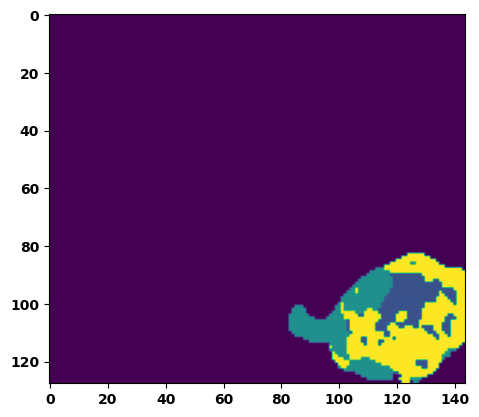

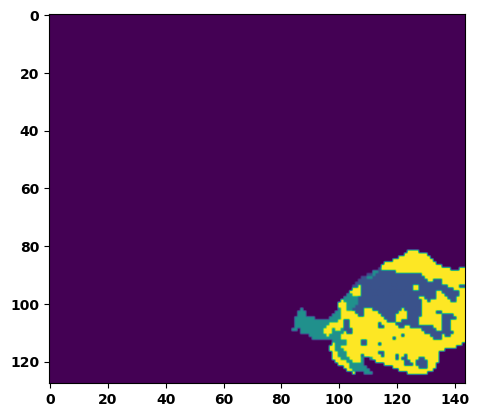

  6%|▌         | 2/36 [00:03<00:54,  1.59s/it]

Batch_id:  1 Eval loss:  0.05804672837257385
Batch_id:  1 Eval IoU:  tensor(0.8993, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:50,  1.52s/it]

Batch_id:  2 Eval loss:  0.29678988456726074
Batch_id:  2 Eval IoU:  tensor(0.5989, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9551, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9361, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 11%|█         | 4/36 [00:06<00:49,  1.55s/it]

Batch_id:  3 Eval loss:  0.2543286681175232
Batch_id:  3 Eval IoU:  tensor(0.6528, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9569, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9924, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:43,  1.42s/it]

Batch_id:  4 Eval loss:  0.22167952358722687
Batch_id:  4 Eval IoU:  tensor(0.6833, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9805, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:41,  1.37s/it]

Batch_id:  5 Eval loss:  0.7190669775009155
Batch_id:  5 Eval IoU:  tensor(0.2545, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9333, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9459, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:40,  1.39s/it]

Batch_id:  6 Eval loss:  0.20474006235599518
Batch_id:  6 Eval IoU:  tensor(0.6812, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9529, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9482, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9823, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:38,  1.37s/it]

Batch_id:  7 Eval loss:  0.12932007014751434
Batch_id:  7 Eval IoU:  tensor(0.7994, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9594, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 25%|██▌       | 9/36 [00:12<00:37,  1.39s/it]

Batch_id:  8 Eval loss:  0.06291542947292328
Batch_id:  8 Eval IoU:  tensor(0.8979, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9951, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:36,  1.39s/it]

Batch_id:  9 Eval loss:  0.19483095407485962
Batch_id:  9 Eval IoU:  tensor(0.7021, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  10 Eval loss:  0.40580615401268005
Batch_id:  10 Eval IoU:  tensor(0.5288, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9058, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.8598, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.8592, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


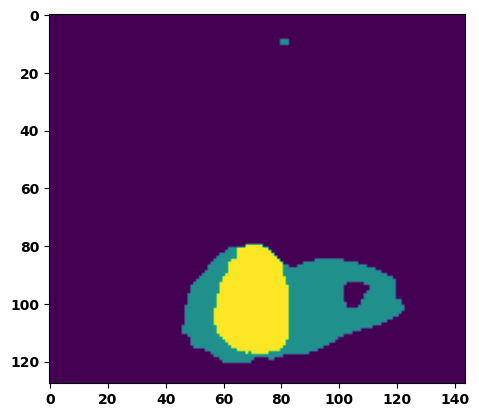

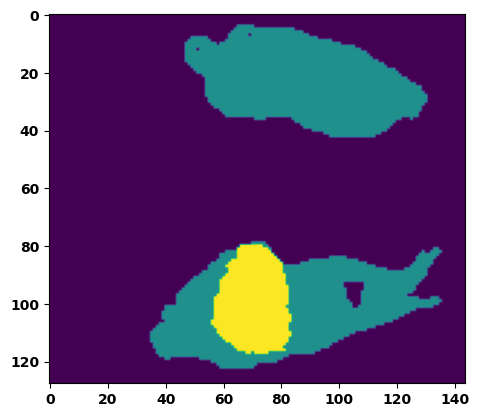

 33%|███▎      | 12/36 [00:17<00:36,  1.53s/it]

Batch_id:  11 Eval loss:  0.10027644038200378
Batch_id:  11 Eval IoU:  tensor(0.8275, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:35,  1.52s/it]

Batch_id:  12 Eval loss:  0.4024236798286438
Batch_id:  12 Eval IoU:  tensor(0.5231, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9931, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:32,  1.49s/it]

Batch_id:  13 Eval loss:  0.19915162026882172
Batch_id:  13 Eval IoU:  tensor(0.7037, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.48s/it]

Batch_id:  14 Eval loss:  0.18940933048725128
Batch_id:  14 Eval IoU:  tensor(0.7213, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.48s/it]

Batch_id:  15 Eval loss:  0.4988592863082886
Batch_id:  15 Eval IoU:  tensor(0.4074, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9420, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9303, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9384, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:28,  1.48s/it]

Batch_id:  16 Eval loss:  0.10412777960300446
Batch_id:  16 Eval IoU:  tensor(0.8240, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:26,  1.47s/it]

Batch_id:  17 Eval loss:  0.14853763580322266
Batch_id:  17 Eval IoU:  tensor(0.7589, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9851, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:24,  1.43s/it]

Batch_id:  18 Eval loss:  0.09325852990150452
Batch_id:  18 Eval IoU:  tensor(0.8442, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:22,  1.42s/it]

Batch_id:  19 Eval loss:  0.08779425919055939
Batch_id:  19 Eval IoU:  tensor(0.8476, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  20 Eval loss:  0.09423758089542389
Batch_id:  20 Eval IoU:  tensor(0.8692, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')


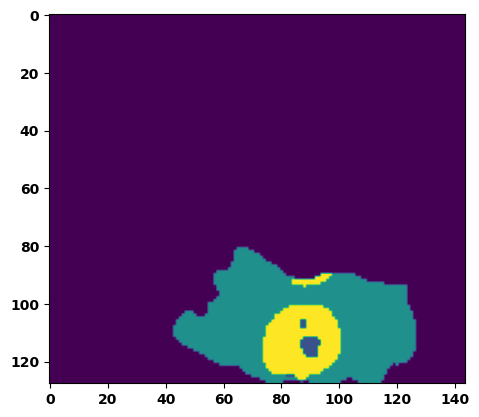

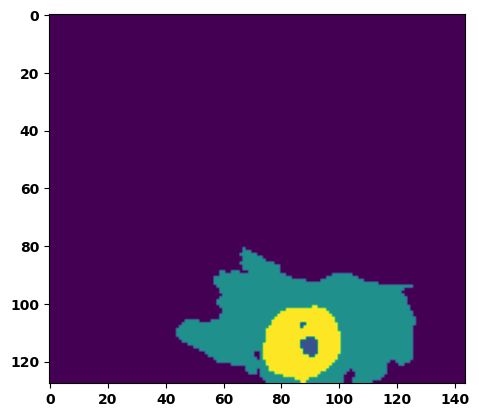

 61%|██████    | 22/36 [00:32<00:21,  1.50s/it]

Batch_id:  21 Eval loss:  0.08208371698856354
Batch_id:  21 Eval IoU:  tensor(0.8606, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:19,  1.48s/it]

Batch_id:  22 Eval loss:  0.18893975019454956
Batch_id:  22 Eval IoU:  tensor(0.7218, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


 67%|██████▋   | 24/36 [00:35<00:17,  1.46s/it]

Batch_id:  23 Eval loss:  0.07366369664669037
Batch_id:  23 Eval IoU:  tensor(0.8863, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:16,  1.47s/it]

Batch_id:  24 Eval loss:  0.07949338853359222
Batch_id:  24 Eval IoU:  tensor(0.8616, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9910, device='cuda:0')


 72%|███████▏  | 26/36 [00:38<00:14,  1.42s/it]

Batch_id:  25 Eval loss:  0.14310206472873688
Batch_id:  25 Eval IoU:  tensor(0.7859, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9909, device='cuda:0')


 75%|███████▌  | 27/36 [00:39<00:12,  1.42s/it]

Batch_id:  26 Eval loss:  0.38806647062301636
Batch_id:  26 Eval IoU:  tensor(0.5420, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:10,  1.35s/it]

Batch_id:  27 Eval loss:  0.06848366558551788
Batch_id:  27 Eval IoU:  tensor(0.8821, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9794, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9904, device='cuda:0')


 81%|████████  | 29/36 [00:41<00:09,  1.34s/it]

Batch_id:  28 Eval loss:  0.28666073083877563
Batch_id:  28 Eval IoU:  tensor(0.6490, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:07,  1.29s/it]

Batch_id:  29 Eval loss:  0.28149282932281494
Batch_id:  29 Eval IoU:  tensor(0.6195, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9586, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9413, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  30 Eval loss:  0.2538965344429016
Batch_id:  30 Eval IoU:  tensor(0.6966, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


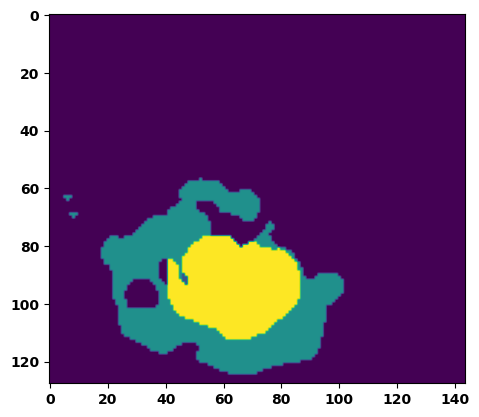

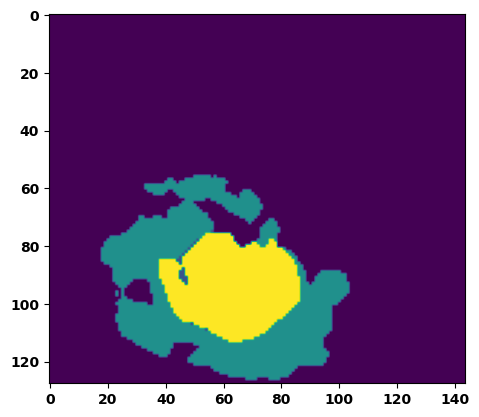

 89%|████████▉ | 32/36 [00:46<00:05,  1.36s/it]

Batch_id:  31 Eval loss:  0.07747933268547058
Batch_id:  31 Eval IoU:  tensor(0.8695, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9870, device='cuda:0')


 92%|█████████▏| 33/36 [00:47<00:04,  1.38s/it]

Batch_id:  32 Eval loss:  0.5984967947006226
Batch_id:  32 Eval IoU:  tensor(0.3539, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 94%|█████████▍| 34/36 [00:48<00:02,  1.42s/it]

Batch_id:  33 Eval loss:  0.3986181616783142
Batch_id:  33 Eval IoU:  tensor(0.4873, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9408, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9254, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9193, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9892, device='cuda:0')


 97%|█████████▋| 35/36 [00:50<00:01,  1.39s/it]

Batch_id:  34 Eval loss:  0.17884238064289093
Batch_id:  34 Eval IoU:  tensor(0.7258, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9891, device='cuda:0')


100%|██████████| 36/36 [00:51<00:00,  1.43s/it]

Batch_id:  35 Eval loss:  0.1600605696439743
Batch_id:  35 Eval IoU:  tensor(0.7476, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9940, device='cuda:0')
Epoch  47 Training loss:  0.16319244598800486
Epoch  47 Evaluation loss:  0.2212133159240087
Epoch  47 Training accuracy :  tensor(0.7663)
Epoch  47 Evaluation accuracy :  tensor(0.7049)
Epoch  47 Training Mean Dice Score:  tensor(0.9816)
Epoch  47 Eval Mean Dice Score:  tensor(0.9736)
Epoch  47 Training Non-tumor Dice Score:  tensor(0.9830)
Epoch  47 Eval Non-tumor Dice Score:  tensor(0.9726)
Epoch  47 Training NCR/NET Dice Score:  tensor(0.9916)
Epoch  47 Eval NCR/NET Dice Score:  tensor(0.9872)
Epoch  47 Training ED Dice Score:  tensor(0.97

Epoch completed and model successfully saved
Epoch: 48
Training in session: 


  1%|          | 1/110 [00:01<02:40,  1.47s/it]

Batch_id:  0 Training loss:  0.32068952918052673
Batch_id:  0 Training IoU:  tensor(0.6167, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9585, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9494, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


  2%|▏         | 2/110 [00:02<02:38,  1.47s/it]

Batch_id:  1 Training loss:  0.2388119101524353
Batch_id:  1 Training IoU:  tensor(0.6455, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9781, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:35,  1.46s/it]

Batch_id:  2 Training loss:  0.09376423060894012
Batch_id:  2 Training IoU:  tensor(0.8368, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9916, device='cuda:0')


  4%|▎         | 4/110 [00:05<02:32,  1.44s/it]

Batch_id:  3 Training loss:  0.11957257986068726
Batch_id:  3 Training IoU:  tensor(0.8018, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9867, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:34,  1.47s/it]

Batch_id:  4 Training loss:  0.12735696136951447
Batch_id:  4 Training IoU:  tensor(0.8031, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


  5%|▌         | 6/110 [00:08<02:29,  1.44s/it]

Batch_id:  5 Training loss:  0.19382639229297638
Batch_id:  5 Training IoU:  tensor(0.7065, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:30,  1.46s/it]

Batch_id:  6 Training loss:  0.07657867670059204
Batch_id:  6 Training IoU:  tensor(0.8805, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9985, device='cuda:0')


  7%|▋         | 8/110 [00:11<02:25,  1.43s/it]

Batch_id:  7 Training loss:  0.1883859783411026
Batch_id:  7 Training IoU:  tensor(0.7104, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9733, device='cuda:0')


  8%|▊         | 9/110 [00:12<02:22,  1.41s/it]

Batch_id:  8 Training loss:  0.08850282430648804
Batch_id:  8 Training IoU:  tensor(0.8510, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


  9%|▉         | 10/110 [00:14<02:24,  1.44s/it]

Batch_id:  9 Training loss:  0.045341506600379944
Batch_id:  9 Training IoU:  tensor(0.9208, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 10%|█         | 11/110 [00:16<02:26,  1.48s/it]

Batch_id:  10 Training loss:  0.12161949276924133
Batch_id:  10 Training IoU:  tensor(0.8175, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9965, device='cuda:0')


 11%|█         | 12/110 [00:17<02:23,  1.46s/it]

Batch_id:  11 Training loss:  0.0583910197019577
Batch_id:  11 Training IoU:  tensor(0.8994, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9929, device='cuda:0')


 12%|█▏        | 13/110 [00:18<02:21,  1.46s/it]

Batch_id:  12 Training loss:  0.12310786545276642
Batch_id:  12 Training IoU:  tensor(0.8024, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 13%|█▎        | 14/110 [00:20<02:15,  1.41s/it]

Batch_id:  13 Training loss:  0.1416601687669754
Batch_id:  13 Training IoU:  tensor(0.7819, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9892, device='cuda:0')


 14%|█▎        | 15/110 [00:21<02:13,  1.41s/it]

Batch_id:  14 Training loss:  0.10358239710330963
Batch_id:  14 Training IoU:  tensor(0.8418, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9923, device='cuda:0')


 15%|█▍        | 16/110 [00:23<02:14,  1.43s/it]

Batch_id:  15 Training loss:  0.08526907861232758
Batch_id:  15 Training IoU:  tensor(0.8530, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 15%|█▌        | 17/110 [00:24<02:20,  1.51s/it]

Batch_id:  16 Training loss:  0.2620375156402588
Batch_id:  16 Training IoU:  tensor(0.6512, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 16%|█▋        | 18/110 [00:26<02:17,  1.49s/it]

Batch_id:  17 Training loss:  0.07343240082263947
Batch_id:  17 Training IoU:  tensor(0.8727, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9901, device='cuda:0')


 17%|█▋        | 19/110 [00:27<02:13,  1.47s/it]

Batch_id:  18 Training loss:  0.12311652302742004
Batch_id:  18 Training IoU:  tensor(0.8043, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 18%|█▊        | 20/110 [00:29<02:09,  1.44s/it]

Batch_id:  19 Training loss:  0.08767843246459961
Batch_id:  19 Training IoU:  tensor(0.8505, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 19%|█▉        | 21/110 [00:30<02:09,  1.46s/it]

Batch_id:  20 Training loss:  0.16115613281726837
Batch_id:  20 Training IoU:  tensor(0.8115, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 20%|██        | 22/110 [00:31<02:06,  1.43s/it]

Batch_id:  21 Training loss:  0.17935754358768463
Batch_id:  21 Training IoU:  tensor(0.7242, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9876, device='cuda:0')


 21%|██        | 23/110 [00:33<02:02,  1.41s/it]

Batch_id:  22 Training loss:  0.24281208217144012
Batch_id:  22 Training IoU:  tensor(0.6551, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9617, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9829, device='cuda:0')


 22%|██▏       | 24/110 [00:34<02:06,  1.48s/it]

Batch_id:  23 Training loss:  0.1401636302471161
Batch_id:  23 Training IoU:  tensor(0.8103, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 23%|██▎       | 25/110 [00:36<02:04,  1.46s/it]

Batch_id:  24 Training loss:  0.17478163540363312
Batch_id:  24 Training IoU:  tensor(0.7397, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9881, device='cuda:0')


 24%|██▎       | 26/110 [00:37<02:03,  1.47s/it]

Batch_id:  25 Training loss:  0.1238211840391159
Batch_id:  25 Training IoU:  tensor(0.8021, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9763, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9744, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9873, device='cuda:0')


 25%|██▍       | 27/110 [00:39<02:03,  1.49s/it]

Batch_id:  26 Training loss:  0.25431379675865173
Batch_id:  26 Training IoU:  tensor(0.7027, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9993, device='cuda:0')


 25%|██▌       | 28/110 [00:40<01:59,  1.45s/it]

Batch_id:  27 Training loss:  0.38587599992752075
Batch_id:  27 Training IoU:  tensor(0.5160, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9845, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9424, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9254, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9963, device='cuda:0')


 26%|██▋       | 29/110 [00:42<01:57,  1.45s/it]

Batch_id:  28 Training loss:  0.3443220257759094
Batch_id:  28 Training IoU:  tensor(0.6334, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 27%|██▋       | 30/110 [00:43<01:57,  1.47s/it]

Batch_id:  29 Training loss:  0.08898371458053589
Batch_id:  29 Training IoU:  tensor(0.8459, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 28%|██▊       | 31/110 [00:45<01:57,  1.49s/it]

Batch_id:  30 Training loss:  0.15203143656253815
Batch_id:  30 Training IoU:  tensor(0.7548, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9885, device='cuda:0')


 29%|██▉       | 32/110 [00:46<01:51,  1.43s/it]

Batch_id:  31 Training loss:  0.13938067853450775
Batch_id:  31 Training IoU:  tensor(0.7960, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 30%|███       | 33/110 [00:47<01:49,  1.43s/it]

Batch_id:  32 Training loss:  0.1528218686580658
Batch_id:  32 Training IoU:  tensor(0.7497, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9648, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 31%|███       | 34/110 [00:49<01:49,  1.43s/it]

Batch_id:  33 Training loss:  0.2596973776817322
Batch_id:  33 Training IoU:  tensor(0.6327, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9547, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9302, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 32%|███▏      | 35/110 [00:50<01:48,  1.45s/it]

Batch_id:  34 Training loss:  0.17650219798088074
Batch_id:  34 Training IoU:  tensor(0.7196, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9719, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9710, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9674, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9860, device='cuda:0')


 33%|███▎      | 36/110 [00:52<01:47,  1.45s/it]

Batch_id:  35 Training loss:  0.1528613567352295
Batch_id:  35 Training IoU:  tensor(0.7838, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 34%|███▎      | 37/110 [00:53<01:46,  1.46s/it]

Batch_id:  36 Training loss:  0.20095151662826538
Batch_id:  36 Training IoU:  tensor(0.6992, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9915, device='cuda:0')


 35%|███▍      | 38/110 [00:55<01:40,  1.40s/it]

Batch_id:  37 Training loss:  0.15188857913017273
Batch_id:  37 Training IoU:  tensor(0.7536, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9861, device='cuda:0')


 35%|███▌      | 39/110 [00:56<01:42,  1.45s/it]

Batch_id:  38 Training loss:  0.5232793688774109
Batch_id:  38 Training IoU:  tensor(0.4239, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9941, device='cuda:0')


 36%|███▋      | 40/110 [00:58<01:41,  1.44s/it]

Batch_id:  39 Training loss:  0.15974847972393036
Batch_id:  39 Training IoU:  tensor(0.7896, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 37%|███▋      | 41/110 [00:59<01:39,  1.44s/it]

Batch_id:  40 Training loss:  0.09071999788284302
Batch_id:  40 Training IoU:  tensor(0.8471, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9777, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9761, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9871, device='cuda:0')


 38%|███▊      | 42/110 [01:00<01:39,  1.47s/it]

Batch_id:  41 Training loss:  0.16624590754508972
Batch_id:  41 Training IoU:  tensor(0.7403, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9771, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 39%|███▉      | 43/110 [01:02<01:36,  1.43s/it]

Batch_id:  42 Training loss:  0.10873353481292725
Batch_id:  42 Training IoU:  tensor(0.8204, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9868, device='cuda:0')


 40%|████      | 44/110 [01:03<01:35,  1.45s/it]

Batch_id:  43 Training loss:  0.23152899742126465
Batch_id:  43 Training IoU:  tensor(0.6563, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9571, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9490, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9431, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


 41%|████      | 45/110 [01:05<01:33,  1.44s/it]

Batch_id:  44 Training loss:  0.08847792446613312
Batch_id:  44 Training IoU:  tensor(0.8470, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 42%|████▏     | 46/110 [01:06<01:32,  1.44s/it]

Batch_id:  45 Training loss:  0.23400038480758667
Batch_id:  45 Training IoU:  tensor(0.6532, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9539, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9523, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9374, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9767, device='cuda:0')


 43%|████▎     | 47/110 [01:08<01:30,  1.44s/it]

Batch_id:  46 Training loss:  0.08977842330932617
Batch_id:  46 Training IoU:  tensor(0.8489, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9970, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 44%|████▎     | 48/110 [01:09<01:27,  1.41s/it]

Batch_id:  47 Training loss:  0.05592535436153412
Batch_id:  47 Training IoU:  tensor(0.9060, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 45%|████▍     | 49/110 [01:10<01:26,  1.42s/it]

Batch_id:  48 Training loss:  0.18238447606563568
Batch_id:  48 Training IoU:  tensor(0.7202, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9765, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 45%|████▌     | 50/110 [01:12<01:25,  1.42s/it]

Batch_id:  49 Training loss:  0.11607162654399872
Batch_id:  49 Training IoU:  tensor(0.8144, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 46%|████▋     | 51/110 [01:13<01:22,  1.40s/it]

Batch_id:  50 Training loss:  0.09664063155651093
Batch_id:  50 Training IoU:  tensor(0.8381, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9828, device='cuda:0')


 47%|████▋     | 52/110 [01:15<01:22,  1.43s/it]

Batch_id:  51 Training loss:  0.16547922790050507
Batch_id:  51 Training IoU:  tensor(0.7334, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9918, device='cuda:0')


 48%|████▊     | 53/110 [01:16<01:22,  1.45s/it]

Batch_id:  52 Training loss:  0.12882550060749054
Batch_id:  52 Training IoU:  tensor(0.8044, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 49%|████▉     | 54/110 [01:18<01:19,  1.43s/it]

Batch_id:  53 Training loss:  0.4563497304916382
Batch_id:  53 Training IoU:  tensor(0.4655, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9649, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 50%|█████     | 55/110 [01:19<01:22,  1.50s/it]

Batch_id:  54 Training loss:  0.215921550989151
Batch_id:  54 Training IoU:  tensor(0.7302, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 51%|█████     | 56/110 [01:21<01:19,  1.47s/it]

Batch_id:  55 Training loss:  0.09302258491516113
Batch_id:  55 Training IoU:  tensor(0.8415, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9900, device='cuda:0')


 52%|█████▏    | 57/110 [01:22<01:18,  1.48s/it]

Batch_id:  56 Training loss:  0.15493255853652954
Batch_id:  56 Training IoU:  tensor(0.7696, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9685, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9641, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 53%|█████▎    | 58/110 [01:24<01:16,  1.47s/it]

Batch_id:  57 Training loss:  0.10881614685058594
Batch_id:  57 Training IoU:  tensor(0.8256, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 54%|█████▎    | 59/110 [01:25<01:15,  1.48s/it]

Batch_id:  58 Training loss:  0.3217964768409729
Batch_id:  58 Training IoU:  tensor(0.6435, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9989, device='cuda:0')


 55%|█████▍    | 60/110 [01:26<01:11,  1.43s/it]

Batch_id:  59 Training loss:  0.04534347355365753
Batch_id:  59 Training IoU:  tensor(0.9213, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 55%|█████▌    | 61/110 [01:28<01:09,  1.42s/it]

Batch_id:  60 Training loss:  0.23985645174980164
Batch_id:  60 Training IoU:  tensor(0.7173, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9974, device='cuda:0')


 56%|█████▋    | 62/110 [01:29<01:09,  1.44s/it]

Batch_id:  61 Training loss:  0.3484342694282532
Batch_id:  61 Training IoU:  tensor(0.5903, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 57%|█████▋    | 63/110 [01:31<01:09,  1.49s/it]

Batch_id:  62 Training loss:  0.20110321044921875
Batch_id:  62 Training IoU:  tensor(0.6922, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9438, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9252, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9855, device='cuda:0')


 58%|█████▊    | 64/110 [01:32<01:08,  1.49s/it]

Batch_id:  63 Training loss:  0.2723771929740906
Batch_id:  63 Training IoU:  tensor(0.6309, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9580, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9574, device='cuda:0')


 59%|█████▉    | 65/110 [01:34<01:09,  1.53s/it]

Batch_id:  64 Training loss:  0.14200571179389954
Batch_id:  64 Training IoU:  tensor(0.7693, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9697, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9665, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 60%|██████    | 66/110 [01:36<01:08,  1.56s/it]

Batch_id:  65 Training loss:  0.04083903133869171
Batch_id:  65 Training IoU:  tensor(0.9299, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 61%|██████    | 67/110 [01:37<01:06,  1.54s/it]

Batch_id:  66 Training loss:  0.0926947146654129
Batch_id:  66 Training IoU:  tensor(0.8497, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 62%|██████▏   | 68/110 [01:39<01:05,  1.57s/it]

Batch_id:  67 Training loss:  0.07706771790981293
Batch_id:  67 Training IoU:  tensor(0.8714, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 63%|██████▎   | 69/110 [01:40<01:03,  1.55s/it]

Batch_id:  68 Training loss:  0.14696040749549866
Batch_id:  68 Training IoU:  tensor(0.7697, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 64%|██████▎   | 70/110 [01:42<01:00,  1.52s/it]

Batch_id:  69 Training loss:  0.1031106561422348
Batch_id:  69 Training IoU:  tensor(0.8247, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 65%|██████▍   | 71/110 [01:43<00:58,  1.50s/it]

Batch_id:  70 Training loss:  0.15012513101100922
Batch_id:  70 Training IoU:  tensor(0.7583, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 65%|██████▌   | 72/110 [01:45<00:56,  1.49s/it]

Batch_id:  71 Training loss:  0.04946039617061615
Batch_id:  71 Training IoU:  tensor(0.9203, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9949, device='cuda:0')


 66%|██████▋   | 73/110 [01:46<00:57,  1.55s/it]

Batch_id:  72 Training loss:  0.3268734812736511
Batch_id:  72 Training IoU:  tensor(0.6184, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9946, device='cuda:0')


 67%|██████▋   | 74/110 [01:48<00:55,  1.55s/it]

Batch_id:  73 Training loss:  0.08454626798629761
Batch_id:  73 Training IoU:  tensor(0.8538, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 68%|██████▊   | 75/110 [01:49<00:53,  1.52s/it]

Batch_id:  74 Training loss:  0.2760283946990967
Batch_id:  74 Training IoU:  tensor(0.6663, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9840, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 69%|██████▉   | 76/110 [01:51<00:51,  1.51s/it]

Batch_id:  75 Training loss:  0.15577778220176697
Batch_id:  75 Training IoU:  tensor(0.7502, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 70%|███████   | 77/110 [01:52<00:49,  1.51s/it]

Batch_id:  76 Training loss:  0.11028724908828735
Batch_id:  76 Training IoU:  tensor(0.8186, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9777, device='cuda:0')


 71%|███████   | 78/110 [01:54<00:48,  1.51s/it]

Batch_id:  77 Training loss:  0.24816198647022247
Batch_id:  77 Training IoU:  tensor(0.6529, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9729, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9712, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9836, device='cuda:0')


 72%|███████▏  | 79/110 [01:55<00:47,  1.54s/it]

Batch_id:  78 Training loss:  0.128927543759346
Batch_id:  78 Training IoU:  tensor(0.8095, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 73%|███████▎  | 80/110 [01:57<00:47,  1.57s/it]

Batch_id:  79 Training loss:  0.15314969420433044
Batch_id:  79 Training IoU:  tensor(0.8148, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9983, device='cuda:0')


 74%|███████▎  | 81/110 [01:59<00:45,  1.57s/it]

Batch_id:  80 Training loss:  0.16424109041690826
Batch_id:  80 Training IoU:  tensor(0.8353, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 75%|███████▍  | 82/110 [02:00<00:45,  1.62s/it]

Batch_id:  81 Training loss:  0.09801428020000458
Batch_id:  81 Training IoU:  tensor(0.8359, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 75%|███████▌  | 83/110 [02:02<00:43,  1.60s/it]

Batch_id:  82 Training loss:  0.10868692398071289
Batch_id:  82 Training IoU:  tensor(0.8183, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9545, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9498, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 76%|███████▋  | 84/110 [02:03<00:39,  1.52s/it]

Batch_id:  83 Training loss:  0.06808127462863922
Batch_id:  83 Training IoU:  tensor(0.8808, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9931, device='cuda:0')


 77%|███████▋  | 85/110 [02:05<00:38,  1.55s/it]

Batch_id:  84 Training loss:  0.13897128403186798
Batch_id:  84 Training IoU:  tensor(0.7933, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9987, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 78%|███████▊  | 86/110 [02:06<00:36,  1.52s/it]

Batch_id:  85 Training loss:  0.09701129794120789
Batch_id:  85 Training IoU:  tensor(0.8369, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9957, device='cuda:0')


 79%|███████▉  | 87/110 [02:08<00:36,  1.59s/it]

Batch_id:  86 Training loss:  0.09005492925643921
Batch_id:  86 Training IoU:  tensor(0.8457, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


 80%|████████  | 88/110 [02:10<00:34,  1.57s/it]

Batch_id:  87 Training loss:  0.20930437743663788
Batch_id:  87 Training IoU:  tensor(0.7177, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 81%|████████  | 89/110 [02:11<00:32,  1.57s/it]

Batch_id:  88 Training loss:  0.12958461046218872
Batch_id:  88 Training IoU:  tensor(0.7941, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 82%|████████▏ | 90/110 [02:13<00:31,  1.58s/it]

Batch_id:  89 Training loss:  0.10564109683036804
Batch_id:  89 Training IoU:  tensor(0.8222, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 83%|████████▎ | 91/110 [02:14<00:29,  1.54s/it]

Batch_id:  90 Training loss:  0.212552011013031
Batch_id:  90 Training IoU:  tensor(0.6822, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9783, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9906, device='cuda:0')


 84%|████████▎ | 92/110 [02:16<00:27,  1.51s/it]

Batch_id:  91 Training loss:  0.13763226568698883
Batch_id:  91 Training IoU:  tensor(0.7701, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9749, device='cuda:0')


 85%|████████▍ | 93/110 [02:17<00:25,  1.50s/it]

Batch_id:  92 Training loss:  0.0641692578792572
Batch_id:  92 Training IoU:  tensor(0.8923, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9764, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 85%|████████▌ | 94/110 [02:19<00:24,  1.52s/it]

Batch_id:  93 Training loss:  0.08581377565860748
Batch_id:  93 Training IoU:  tensor(0.8651, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 86%|████████▋ | 95/110 [02:20<00:22,  1.48s/it]

Batch_id:  94 Training loss:  0.2490200400352478
Batch_id:  94 Training IoU:  tensor(0.6507, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 87%|████████▋ | 96/110 [02:22<00:21,  1.50s/it]

Batch_id:  95 Training loss:  0.1882643699645996
Batch_id:  95 Training IoU:  tensor(0.7217, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9824, device='cuda:0')


 88%|████████▊ | 97/110 [02:23<00:19,  1.49s/it]

Batch_id:  96 Training loss:  0.21389006078243256
Batch_id:  96 Training IoU:  tensor(0.7369, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 89%|████████▉ | 98/110 [02:25<00:18,  1.50s/it]

Batch_id:  97 Training loss:  0.12903550267219543
Batch_id:  97 Training IoU:  tensor(0.7877, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 90%|█████████ | 99/110 [02:26<00:16,  1.50s/it]

Batch_id:  98 Training loss:  0.20742662250995636
Batch_id:  98 Training IoU:  tensor(0.6894, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 91%|█████████ | 100/110 [02:28<00:14,  1.50s/it]

Batch_id:  99 Training loss:  0.17321178317070007
Batch_id:  99 Training IoU:  tensor(0.7411, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 92%|█████████▏| 101/110 [02:29<00:13,  1.48s/it]

Batch_id:  100 Training loss:  0.3813523054122925
Batch_id:  100 Training IoU:  tensor(0.5385, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


 93%|█████████▎| 102/110 [02:31<00:12,  1.52s/it]

Batch_id:  101 Training loss:  0.08341355621814728
Batch_id:  101 Training IoU:  tensor(0.8817, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 94%|█████████▎| 103/110 [02:32<00:10,  1.47s/it]

Batch_id:  102 Training loss:  0.20823481678962708
Batch_id:  102 Training IoU:  tensor(0.6880, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9934, device='cuda:0')


 95%|█████████▍| 104/110 [02:34<00:08,  1.49s/it]

Batch_id:  103 Training loss:  0.24555471539497375
Batch_id:  103 Training IoU:  tensor(0.6869, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 95%|█████████▌| 105/110 [02:35<00:07,  1.51s/it]

Batch_id:  104 Training loss:  0.08706213533878326
Batch_id:  104 Training IoU:  tensor(0.8568, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 96%|█████████▋| 106/110 [02:37<00:06,  1.51s/it]

Batch_id:  105 Training loss:  0.10533080995082855
Batch_id:  105 Training IoU:  tensor(0.8318, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9643, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9686, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9856, device='cuda:0')


 97%|█████████▋| 107/110 [02:38<00:04,  1.48s/it]

Batch_id:  106 Training loss:  0.1572664976119995
Batch_id:  106 Training IoU:  tensor(0.7505, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9708, device='cuda:0')


 98%|█████████▊| 108/110 [02:39<00:02,  1.46s/it]

Batch_id:  107 Training loss:  0.21106767654418945
Batch_id:  107 Training IoU:  tensor(0.6895, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9755, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9896, device='cuda:0')


 99%|█████████▉| 109/110 [02:41<00:01,  1.45s/it]

Batch_id:  108 Training loss:  0.18862603604793549
Batch_id:  108 Training IoU:  tensor(0.7187, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9614, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9676, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


100%|██████████| 110/110 [02:42<00:00,  1.48s/it]


Batch_id:  109 Training loss:  0.05621476471424103
Batch_id:  109 Training IoU:  tensor(0.9034, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9958, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.7192342281341553
Batch_id:  0 Eval IoU:  tensor(0.2542, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9520, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9331, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


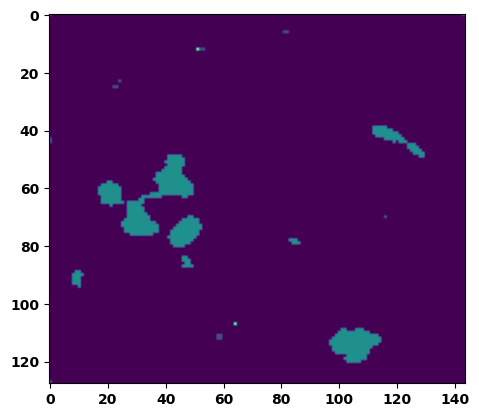

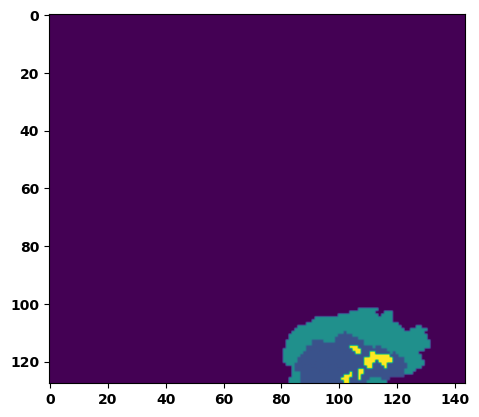

  6%|▌         | 2/36 [00:03<00:51,  1.52s/it]

Batch_id:  1 Eval loss:  0.19654281437397003
Batch_id:  1 Eval IoU:  tensor(0.7003, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:48,  1.48s/it]

Batch_id:  2 Eval loss:  0.14618045091629028
Batch_id:  2 Eval IoU:  tensor(0.7618, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9853, device='cuda:0')


 11%|█         | 4/36 [00:05<00:44,  1.40s/it]

Batch_id:  3 Eval loss:  0.287275493144989
Batch_id:  3 Eval IoU:  tensor(0.6482, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9976, device='cuda:0')


 14%|█▍        | 5/36 [00:07<00:42,  1.37s/it]

Batch_id:  4 Eval loss:  0.17888115346431732
Batch_id:  4 Eval IoU:  tensor(0.7260, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


 17%|█▋        | 6/36 [00:08<00:42,  1.42s/it]

Batch_id:  5 Eval loss:  0.10398122668266296
Batch_id:  5 Eval IoU:  tensor(0.8246, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


 19%|█▉        | 7/36 [00:10<00:41,  1.43s/it]

Batch_id:  6 Eval loss:  0.07341529428958893
Batch_id:  6 Eval IoU:  tensor(0.8865, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 22%|██▏       | 8/36 [00:11<00:40,  1.44s/it]

Batch_id:  7 Eval loss:  0.38866788148880005
Batch_id:  7 Eval IoU:  tensor(0.5409, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9733, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9992, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 25%|██▌       | 9/36 [00:12<00:38,  1.43s/it]

Batch_id:  8 Eval loss:  0.12976495921611786
Batch_id:  8 Eval IoU:  tensor(0.7986, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9448, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9422, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 28%|██▊       | 10/36 [00:14<00:39,  1.53s/it]

Batch_id:  9 Eval loss:  0.5980534553527832
Batch_id:  9 Eval IoU:  tensor(0.3542, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  10 Eval loss:  0.1888371855020523
Batch_id:  10 Eval IoU:  tensor(0.7221, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9885, device='cuda:0')


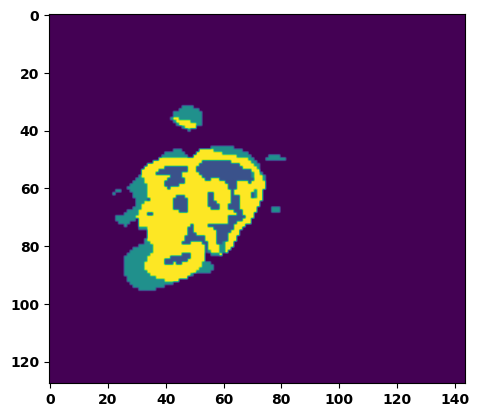

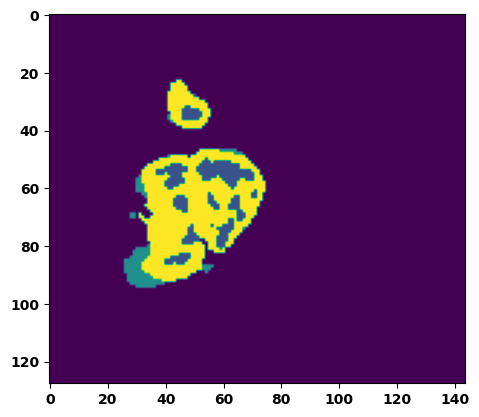

 33%|███▎      | 12/36 [00:17<00:37,  1.55s/it]

Batch_id:  11 Eval loss:  0.09311307966709137
Batch_id:  11 Eval IoU:  tensor(0.8708, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9868, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:35,  1.56s/it]

Batch_id:  12 Eval loss:  0.23793518543243408
Batch_id:  12 Eval IoU:  tensor(0.6645, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 39%|███▉      | 14/36 [00:20<00:33,  1.52s/it]

Batch_id:  13 Eval loss:  0.401508629322052
Batch_id:  13 Eval IoU:  tensor(0.5237, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


 42%|████▏     | 15/36 [00:22<00:31,  1.48s/it]

Batch_id:  14 Eval loss:  0.49905750155448914
Batch_id:  14 Eval IoU:  tensor(0.4063, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9364, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9421, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9303, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9385, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 44%|████▍     | 16/36 [00:23<00:29,  1.50s/it]

Batch_id:  15 Eval loss:  0.08125962316989899
Batch_id:  15 Eval IoU:  tensor(0.8617, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9969, device='cuda:0')


 47%|████▋     | 17/36 [00:25<00:27,  1.45s/it]

Batch_id:  16 Eval loss:  0.2222590446472168
Batch_id:  16 Eval IoU:  tensor(0.6825, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9706, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9802, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9810, device='cuda:0')


 50%|█████     | 18/36 [00:26<00:25,  1.41s/it]

Batch_id:  17 Eval loss:  0.18897704780101776
Batch_id:  17 Eval IoU:  tensor(0.7217, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9962, device='cuda:0')


 53%|█████▎    | 19/36 [00:27<00:23,  1.39s/it]

Batch_id:  18 Eval loss:  0.09157140552997589
Batch_id:  18 Eval IoU:  tensor(0.8478, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


 56%|█████▌    | 20/36 [00:29<00:21,  1.37s/it]

Batch_id:  19 Eval loss:  0.20705464482307434
Batch_id:  19 Eval IoU:  tensor(0.6784, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9485, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9732, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9546, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  20 Eval loss:  0.1432461142539978
Batch_id:  20 Eval IoU:  tensor(0.7855, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


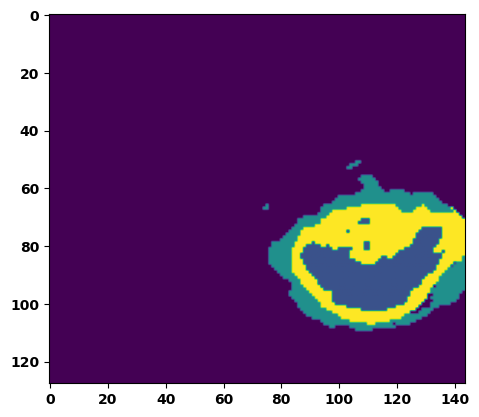

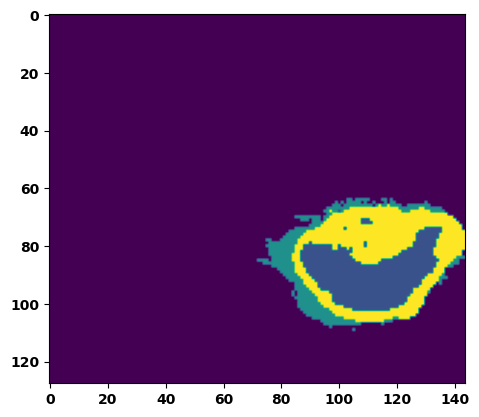

 61%|██████    | 22/36 [00:31<00:19,  1.37s/it]

Batch_id:  21 Eval loss:  0.19822274148464203
Batch_id:  21 Eval IoU:  tensor(0.7057, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9708, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9926, device='cuda:0')


 64%|██████▍   | 23/36 [00:33<00:17,  1.37s/it]

Batch_id:  22 Eval loss:  0.07807712256908417
Batch_id:  22 Eval IoU:  tensor(0.8688, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9869, device='cuda:0')


 67%|██████▋   | 24/36 [00:34<00:16,  1.39s/it]

Batch_id:  23 Eval loss:  0.25628870725631714
Batch_id:  23 Eval IoU:  tensor(0.6509, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9568, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9460, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9416, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 69%|██████▉   | 25/36 [00:36<00:15,  1.40s/it]

Batch_id:  24 Eval loss:  0.40612879395484924
Batch_id:  24 Eval IoU:  tensor(0.5287, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9057, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.8596, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.8590, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')


 72%|███████▏  | 26/36 [00:37<00:13,  1.38s/it]

Batch_id:  25 Eval loss:  0.1011117696762085
Batch_id:  25 Eval IoU:  tensor(0.8264, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 75%|███████▌  | 27/36 [00:38<00:12,  1.39s/it]

Batch_id:  26 Eval loss:  0.08069688081741333
Batch_id:  26 Eval IoU:  tensor(0.8597, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9907, device='cuda:0')


 78%|███████▊  | 28/36 [00:40<00:11,  1.39s/it]

Batch_id:  27 Eval loss:  0.25545600056648254
Batch_id:  27 Eval IoU:  tensor(0.6958, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9715, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 81%|████████  | 29/36 [00:41<00:09,  1.38s/it]

Batch_id:  28 Eval loss:  0.2916775643825531
Batch_id:  28 Eval IoU:  tensor(0.6040, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9554, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9365, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9909, device='cuda:0')


 83%|████████▎ | 30/36 [00:43<00:08,  1.41s/it]

Batch_id:  29 Eval loss:  0.3965844511985779
Batch_id:  29 Eval IoU:  tensor(0.4893, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9410, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9255, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9195, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  30 Eval loss:  0.08553957939147949
Batch_id:  30 Eval IoU:  tensor(0.8518, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9901, device='cuda:0')


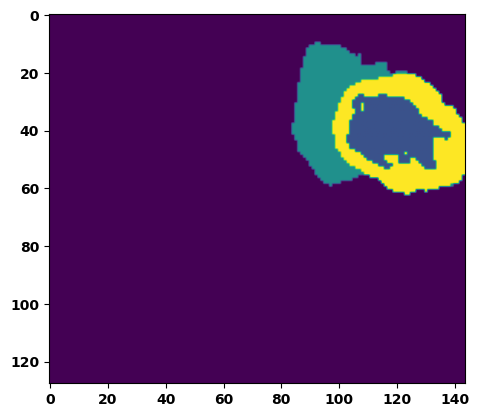

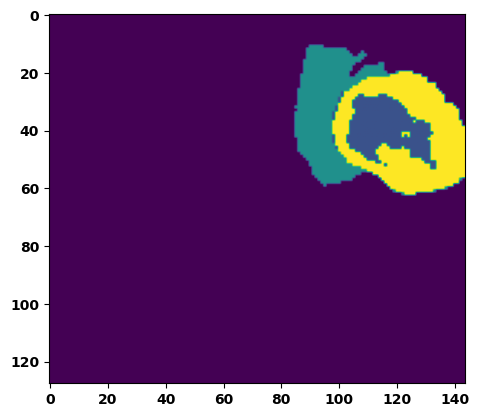

 89%|████████▉ | 32/36 [00:46<00:05,  1.46s/it]

Batch_id:  31 Eval loss:  0.058214619755744934
Batch_id:  31 Eval IoU:  tensor(0.9001, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9939, device='cuda:0')


 92%|█████████▏| 33/36 [00:47<00:04,  1.53s/it]

Batch_id:  32 Eval loss:  0.1584780514240265
Batch_id:  32 Eval IoU:  tensor(0.7487, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')


 94%|█████████▍| 34/36 [00:49<00:02,  1.47s/it]

Batch_id:  33 Eval loss:  0.0679541677236557
Batch_id:  33 Eval IoU:  tensor(0.8831, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 97%|█████████▋| 35/36 [00:50<00:01,  1.41s/it]

Batch_id:  34 Eval loss:  0.2801935076713562
Batch_id:  34 Eval IoU:  tensor(0.6208, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9575, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9414, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


100%|██████████| 36/36 [00:51<00:00,  1.44s/it]

Batch_id:  35 Eval loss:  0.061724260449409485
Batch_id:  35 Eval IoU:  tensor(0.9010, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')
Epoch 00049: reducing learning rate of group 0 to 3.9063e-06.
Epoch  48 Training loss:  0.1630089823495258
Epoch  48 Evaluation loss:  0.22092123991913265
Epoch  48 Training accuracy :  tensor(0.7663)
Epoch  48 Evaluation accuracy :  tensor(0.7054)
Epoch  48 Training Mean Dice Score:  tensor(0.9816)
Epoch  48 Eval Mean Dice Score:  tensor(0.9736)
Epoch  48 Training Non-tumor Dice Score:  tensor(0.9830)
Epoch  48 Eval Non-tumor Dice Score:  tensor(0.9727)
Epoch  48 Training NCR/NET Dice Score:  tensor(0.9916)
Epoch  48 Eval NCR/NET Dice Score

Epoch: 49
Training in session: 


  1%|          | 1/110 [00:01<02:59,  1.64s/it]

Batch_id:  0 Training loss:  0.15974874794483185
Batch_id:  0 Training IoU:  tensor(0.8160, device='cuda:0')
Batch_id:  0 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  0 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  0 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  0 Training ED Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  0 Training ET Dice Score:  tensor(0.9968, device='cuda:0')


  2%|▏         | 2/110 [00:03<02:53,  1.61s/it]

Batch_id:  1 Training loss:  0.06417743861675262
Batch_id:  1 Training IoU:  tensor(0.8926, device='cuda:0')
Batch_id:  1 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  1 Training Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  1 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  1 Training ED Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  1 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


  3%|▎         | 3/110 [00:04<02:47,  1.56s/it]

Batch_id:  2 Training loss:  0.12183211743831635
Batch_id:  2 Training IoU:  tensor(0.8060, device='cuda:0')
Batch_id:  2 Training Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  2 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  2 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  2 Training ED Dice Score:  tensor(0.9724, device='cuda:0')
Batch_id:  2 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


  4%|▎         | 4/110 [00:06<02:39,  1.50s/it]

Batch_id:  3 Training loss:  0.15060874819755554
Batch_id:  3 Training IoU:  tensor(0.7576, device='cuda:0')
Batch_id:  3 Training Mean Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  3 Training Non-tumor Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  3 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  3 Training ED Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  3 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


  5%|▍         | 5/110 [00:07<02:39,  1.52s/it]

Batch_id:  4 Training loss:  0.32708311080932617
Batch_id:  4 Training IoU:  tensor(0.6185, device='cuda:0')
Batch_id:  4 Training Mean Dice Score:  tensor(0.9843, device='cuda:0')
Batch_id:  4 Training Non-tumor Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  4 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  4 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  4 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


  5%|▌         | 6/110 [00:09<02:42,  1.57s/it]

Batch_id:  5 Training loss:  0.12144234776496887
Batch_id:  5 Training IoU:  tensor(0.8054, device='cuda:0')
Batch_id:  5 Training Mean Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  5 Training Non-tumor Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  5 Training NCR/NET Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  5 Training ED Dice Score:  tensor(0.9746, device='cuda:0')
Batch_id:  5 Training ET Dice Score:  tensor(0.9878, device='cuda:0')


  6%|▋         | 7/110 [00:10<02:35,  1.51s/it]

Batch_id:  6 Training loss:  0.15720024704933167
Batch_id:  6 Training IoU:  tensor(0.7510, device='cuda:0')
Batch_id:  6 Training Mean Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  6 Training Non-tumor Dice Score:  tensor(0.9800, device='cuda:0')
Batch_id:  6 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  6 Training ED Dice Score:  tensor(0.9844, device='cuda:0')
Batch_id:  6 Training ET Dice Score:  tensor(0.9709, device='cuda:0')


  7%|▋         | 8/110 [00:12<02:31,  1.49s/it]

Batch_id:  7 Training loss:  0.17532065510749817
Batch_id:  7 Training IoU:  tensor(0.7309, device='cuda:0')
Batch_id:  7 Training Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  7 Training Non-tumor Dice Score:  tensor(0.9725, device='cuda:0')
Batch_id:  7 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  7 Training ED Dice Score:  tensor(0.9679, device='cuda:0')
Batch_id:  7 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


  8%|▊         | 9/110 [00:13<02:33,  1.52s/it]

Batch_id:  8 Training loss:  0.0903165340423584
Batch_id:  8 Training IoU:  tensor(0.8452, device='cuda:0')
Batch_id:  8 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  8 Training Non-tumor Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  8 Training NCR/NET Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  8 Training ED Dice Score:  tensor(0.9880, device='cuda:0')
Batch_id:  8 Training ET Dice Score:  tensor(0.9930, device='cuda:0')


  9%|▉         | 10/110 [00:15<02:33,  1.54s/it]

Batch_id:  9 Training loss:  0.08492247760295868
Batch_id:  9 Training IoU:  tensor(0.8533, device='cuda:0')
Batch_id:  9 Training Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  9 Training Non-tumor Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  9 Training NCR/NET Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  9 Training ED Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  9 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 10%|█         | 11/110 [00:16<02:31,  1.53s/it]

Batch_id:  10 Training loss:  0.2473253607749939
Batch_id:  10 Training IoU:  tensor(0.6526, device='cuda:0')
Batch_id:  10 Training Mean Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  10 Training Non-tumor Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  10 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  10 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  10 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 11%|█         | 12/110 [00:18<02:31,  1.55s/it]

Batch_id:  11 Training loss:  0.12202301621437073
Batch_id:  11 Training IoU:  tensor(0.8164, device='cuda:0')
Batch_id:  11 Training Mean Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  11 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  11 Training NCR/NET Dice Score:  tensor(0.9985, device='cuda:0')
Batch_id:  11 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  11 Training ET Dice Score:  tensor(0.9964, device='cuda:0')


 12%|█▏        | 13/110 [00:20<02:34,  1.59s/it]

Batch_id:  12 Training loss:  0.08366771042346954
Batch_id:  12 Training IoU:  tensor(0.8810, device='cuda:0')
Batch_id:  12 Training Mean Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  12 Training Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  12 Training NCR/NET Dice Score:  tensor(0.9996, device='cuda:0')
Batch_id:  12 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  12 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 13%|█▎        | 14/110 [00:21<02:29,  1.56s/it]

Batch_id:  13 Training loss:  0.31460845470428467
Batch_id:  13 Training IoU:  tensor(0.6550, device='cuda:0')
Batch_id:  13 Training Mean Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  13 Training Non-tumor Dice Score:  tensor(0.9956, device='cuda:0')
Batch_id:  13 Training NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  13 Training ED Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  13 Training ET Dice Score:  tensor(0.9991, device='cuda:0')


 14%|█▎        | 15/110 [00:23<02:25,  1.53s/it]

Batch_id:  14 Training loss:  0.10434311628341675
Batch_id:  14 Training IoU:  tensor(0.8237, device='cuda:0')
Batch_id:  14 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  14 Training Non-tumor Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  14 Training NCR/NET Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  14 Training ED Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  14 Training ET Dice Score:  tensor(0.9937, device='cuda:0')


 15%|█▍        | 16/110 [00:24<02:25,  1.54s/it]

Batch_id:  15 Training loss:  0.11059580743312836
Batch_id:  15 Training IoU:  tensor(0.8179, device='cuda:0')
Batch_id:  15 Training Mean Dice Score:  tensor(0.9772, device='cuda:0')
Batch_id:  15 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  15 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  15 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  15 Training ET Dice Score:  tensor(0.9779, device='cuda:0')


 15%|█▌        | 17/110 [00:26<02:27,  1.59s/it]

Batch_id:  16 Training loss:  0.18212595582008362
Batch_id:  16 Training IoU:  tensor(0.7203, device='cuda:0')
Batch_id:  16 Training Mean Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  16 Training Non-tumor Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  16 Training NCR/NET Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  16 Training ED Dice Score:  tensor(0.9656, device='cuda:0')
Batch_id:  16 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 16%|█▋        | 18/110 [00:27<02:21,  1.54s/it]

Batch_id:  17 Training loss:  0.1506011039018631
Batch_id:  17 Training IoU:  tensor(0.7867, device='cuda:0')
Batch_id:  17 Training Mean Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  17 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  17 Training NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  17 Training ED Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  17 Training ET Dice Score:  tensor(0.9962, device='cuda:0')


 17%|█▋        | 19/110 [00:29<02:21,  1.56s/it]

Batch_id:  18 Training loss:  0.16007228195667267
Batch_id:  18 Training IoU:  tensor(0.7896, device='cuda:0')
Batch_id:  18 Training Mean Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  18 Training Non-tumor Dice Score:  tensor(0.9932, device='cuda:0')
Batch_id:  18 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  18 Training ED Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  18 Training ET Dice Score:  tensor(0.9988, device='cuda:0')


 18%|█▊        | 20/110 [00:30<02:18,  1.54s/it]

Batch_id:  19 Training loss:  0.3479170501232147
Batch_id:  19 Training IoU:  tensor(0.5904, device='cuda:0')
Batch_id:  19 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  19 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  19 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  19 Training ED Dice Score:  tensor(0.9901, device='cuda:0')
Batch_id:  19 Training ET Dice Score:  tensor(0.9969, device='cuda:0')


 19%|█▉        | 21/110 [00:32<02:15,  1.52s/it]

Batch_id:  20 Training loss:  0.08704841136932373
Batch_id:  20 Training IoU:  tensor(0.8489, device='cuda:0')
Batch_id:  20 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  20 Training Non-tumor Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  20 Training NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  20 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  20 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 20%|██        | 22/110 [00:33<02:07,  1.45s/it]

Batch_id:  21 Training loss:  0.5231662392616272
Batch_id:  21 Training IoU:  tensor(0.4250, device='cuda:0')
Batch_id:  21 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  21 Training Non-tumor Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  21 Training NCR/NET Dice Score:  tensor(0.9967, device='cuda:0')
Batch_id:  21 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  21 Training ET Dice Score:  tensor(0.9939, device='cuda:0')


 21%|██        | 23/110 [00:35<02:08,  1.48s/it]

Batch_id:  22 Training loss:  0.09400331974029541
Batch_id:  22 Training IoU:  tensor(0.8395, device='cuda:0')
Batch_id:  22 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  22 Training Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  22 Training NCR/NET Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  22 Training ED Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  22 Training ET Dice Score:  tensor(0.9897, device='cuda:0')


 22%|██▏       | 24/110 [00:36<02:07,  1.49s/it]

Batch_id:  23 Training loss:  0.0862312912940979
Batch_id:  23 Training IoU:  tensor(0.8645, device='cuda:0')
Batch_id:  23 Training Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  23 Training Non-tumor Dice Score:  tensor(0.9756, device='cuda:0')
Batch_id:  23 Training NCR/NET Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  23 Training ED Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  23 Training ET Dice Score:  tensor(0.9877, device='cuda:0')


 23%|██▎       | 25/110 [00:38<02:06,  1.49s/it]

Batch_id:  24 Training loss:  0.20021790266036987
Batch_id:  24 Training IoU:  tensor(0.6935, device='cuda:0')
Batch_id:  24 Training Mean Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  24 Training Non-tumor Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  24 Training NCR/NET Dice Score:  tensor(0.9444, device='cuda:0')
Batch_id:  24 Training ED Dice Score:  tensor(0.9259, device='cuda:0')
Batch_id:  24 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 24%|██▎       | 26/110 [00:39<02:07,  1.52s/it]

Batch_id:  25 Training loss:  0.07658900320529938
Batch_id:  25 Training IoU:  tensor(0.8730, device='cuda:0')
Batch_id:  25 Training Mean Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  25 Training Non-tumor Dice Score:  tensor(0.9818, device='cuda:0')
Batch_id:  25 Training NCR/NET Dice Score:  tensor(0.9944, device='cuda:0')
Batch_id:  25 Training ED Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  25 Training ET Dice Score:  tensor(0.9910, device='cuda:0')


 25%|██▍       | 27/110 [00:41<02:11,  1.59s/it]

Batch_id:  26 Training loss:  0.2061651200056076
Batch_id:  26 Training IoU:  tensor(0.6921, device='cuda:0')
Batch_id:  26 Training Mean Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  26 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  26 Training NCR/NET Dice Score:  tensor(0.9919, device='cuda:0')
Batch_id:  26 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  26 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 25%|██▌       | 28/110 [00:43<02:08,  1.57s/it]

Batch_id:  27 Training loss:  0.12256528437137604
Batch_id:  27 Training IoU:  tensor(0.8034, device='cuda:0')
Batch_id:  27 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  27 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  27 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  27 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  27 Training ET Dice Score:  tensor(0.9936, device='cuda:0')


 26%|██▋       | 29/110 [00:44<02:02,  1.51s/it]

Batch_id:  28 Training loss:  0.17383426427841187
Batch_id:  28 Training IoU:  tensor(0.7403, device='cuda:0')
Batch_id:  28 Training Mean Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  28 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  28 Training NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  28 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  28 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 27%|██▋       | 30/110 [00:45<02:01,  1.52s/it]

Batch_id:  29 Training loss:  0.2405855804681778
Batch_id:  29 Training IoU:  tensor(0.6448, device='cuda:0')
Batch_id:  29 Training Mean Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  29 Training Non-tumor Dice Score:  tensor(0.9874, device='cuda:0')
Batch_id:  29 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  29 Training ED Dice Score:  tensor(0.9670, device='cuda:0')
Batch_id:  29 Training ET Dice Score:  tensor(0.9768, device='cuda:0')


 28%|██▊       | 31/110 [00:47<01:57,  1.48s/it]

Batch_id:  30 Training loss:  0.19815941154956818
Batch_id:  30 Training IoU:  tensor(0.7014, device='cuda:0')
Batch_id:  30 Training Mean Dice Score:  tensor(0.9816, device='cuda:0')
Batch_id:  30 Training Non-tumor Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  30 Training NCR/NET Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  30 Training ED Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  30 Training ET Dice Score:  tensor(0.9943, device='cuda:0')


 29%|██▉       | 32/110 [00:48<01:56,  1.50s/it]

Batch_id:  31 Training loss:  0.18724888563156128
Batch_id:  31 Training IoU:  tensor(0.7206, device='cuda:0')
Batch_id:  31 Training Mean Dice Score:  tensor(0.9618, device='cuda:0')
Batch_id:  31 Training Non-tumor Dice Score:  tensor(0.9680, device='cuda:0')
Batch_id:  31 Training NCR/NET Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  31 Training ED Dice Score:  tensor(0.9673, device='cuda:0')
Batch_id:  31 Training ET Dice Score:  tensor(0.9780, device='cuda:0')


 30%|███       | 33/110 [00:50<01:58,  1.54s/it]

Batch_id:  32 Training loss:  0.2408229410648346
Batch_id:  32 Training IoU:  tensor(0.7168, device='cuda:0')
Batch_id:  32 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  32 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  32 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  32 Training ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  32 Training ET Dice Score:  tensor(0.9973, device='cuda:0')


 31%|███       | 34/110 [00:51<01:54,  1.51s/it]

Batch_id:  33 Training loss:  0.23201145231723785
Batch_id:  33 Training IoU:  tensor(0.6548, device='cuda:0')
Batch_id:  33 Training Mean Dice Score:  tensor(0.9573, device='cuda:0')
Batch_id:  33 Training Non-tumor Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  33 Training NCR/NET Dice Score:  tensor(0.9825, device='cuda:0')
Batch_id:  33 Training ED Dice Score:  tensor(0.9433, device='cuda:0')
Batch_id:  33 Training ET Dice Score:  tensor(0.9967, device='cuda:0')


 32%|███▏      | 35/110 [00:53<01:51,  1.49s/it]

Batch_id:  34 Training loss:  0.2456800639629364
Batch_id:  34 Training IoU:  tensor(0.6520, device='cuda:0')
Batch_id:  34 Training Mean Dice Score:  tensor(0.9620, device='cuda:0')
Batch_id:  34 Training Non-tumor Dice Score:  tensor(0.9593, device='cuda:0')
Batch_id:  34 Training NCR/NET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  34 Training ED Dice Score:  tensor(0.9527, device='cuda:0')
Batch_id:  34 Training ET Dice Score:  tensor(0.9831, device='cuda:0')


 33%|███▎      | 36/110 [00:54<01:51,  1.50s/it]

Batch_id:  35 Training loss:  0.0896109789609909
Batch_id:  35 Training IoU:  tensor(0.8492, device='cuda:0')
Batch_id:  35 Training Mean Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  35 Training Non-tumor Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  35 Training NCR/NET Dice Score:  tensor(0.9964, device='cuda:0')
Batch_id:  35 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  35 Training ET Dice Score:  tensor(0.9945, device='cuda:0')


 34%|███▎      | 37/110 [00:56<01:51,  1.53s/it]

Batch_id:  36 Training loss:  0.10080434381961823
Batch_id:  36 Training IoU:  tensor(0.8462, device='cuda:0')
Batch_id:  36 Training Mean Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  36 Training Non-tumor Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  36 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  36 Training ED Dice Score:  tensor(0.9865, device='cuda:0')
Batch_id:  36 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 35%|███▍      | 38/110 [00:58<01:56,  1.62s/it]

Batch_id:  37 Training loss:  0.15104089677333832
Batch_id:  37 Training IoU:  tensor(0.8198, device='cuda:0')
Batch_id:  37 Training Mean Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  37 Training Non-tumor Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  37 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  37 Training ED Dice Score:  tensor(0.9873, device='cuda:0')
Batch_id:  37 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 35%|███▌      | 39/110 [00:59<01:52,  1.58s/it]

Batch_id:  38 Training loss:  0.08547653257846832
Batch_id:  38 Training IoU:  tensor(0.8527, device='cuda:0')
Batch_id:  38 Training Mean Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  38 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  38 Training NCR/NET Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  38 Training ED Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  38 Training ET Dice Score:  tensor(0.9835, device='cuda:0')


 36%|███▋      | 40/110 [01:01<01:51,  1.60s/it]

Batch_id:  39 Training loss:  0.34422969818115234
Batch_id:  39 Training IoU:  tensor(0.6297, device='cuda:0')
Batch_id:  39 Training Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  39 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  39 Training NCR/NET Dice Score:  tensor(0.9998, device='cuda:0')
Batch_id:  39 Training ED Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  39 Training ET Dice Score:  tensor(0.9998, device='cuda:0')


 37%|███▋      | 41/110 [01:03<01:50,  1.60s/it]

Batch_id:  40 Training loss:  0.09748932719230652
Batch_id:  40 Training IoU:  tensor(0.8371, device='cuda:0')
Batch_id:  40 Training Mean Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  40 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  40 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  40 Training ED Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  40 Training ET Dice Score:  tensor(0.9907, device='cuda:0')


 38%|███▊      | 42/110 [01:04<01:50,  1.63s/it]

Batch_id:  41 Training loss:  0.057709649205207825
Batch_id:  41 Training IoU:  tensor(0.9003, device='cuda:0')
Batch_id:  41 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  41 Training Non-tumor Dice Score:  tensor(0.9856, device='cuda:0')
Batch_id:  41 Training NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  41 Training ED Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  41 Training ET Dice Score:  tensor(0.9928, device='cuda:0')


 39%|███▉      | 43/110 [01:06<01:45,  1.58s/it]

Batch_id:  42 Training loss:  0.24561789631843567
Batch_id:  42 Training IoU:  tensor(0.6868, device='cuda:0')
Batch_id:  42 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  42 Training Non-tumor Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  42 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  42 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  42 Training ET Dice Score:  tensor(0.9935, device='cuda:0')


 40%|████      | 44/110 [01:07<01:45,  1.59s/it]

Batch_id:  43 Training loss:  0.12930308282375336
Batch_id:  43 Training IoU:  tensor(0.8042, device='cuda:0')
Batch_id:  43 Training Mean Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  43 Training Non-tumor Dice Score:  tensor(0.9803, device='cuda:0')
Batch_id:  43 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  43 Training ED Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  43 Training ET Dice Score:  tensor(0.9909, device='cuda:0')


 41%|████      | 45/110 [01:09<01:41,  1.56s/it]

Batch_id:  44 Training loss:  0.20965144038200378
Batch_id:  44 Training IoU:  tensor(0.6849, device='cuda:0')
Batch_id:  44 Training Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  44 Training Non-tumor Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  44 Training NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  44 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  44 Training ET Dice Score:  tensor(0.9908, device='cuda:0')


 42%|████▏     | 46/110 [01:10<01:38,  1.53s/it]

Batch_id:  45 Training loss:  0.1360631287097931
Batch_id:  45 Training IoU:  tensor(0.8027, device='cuda:0')
Batch_id:  45 Training Mean Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  45 Training Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  45 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  45 Training ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  45 Training ET Dice Score:  tensor(0.9955, device='cuda:0')


 43%|████▎     | 47/110 [01:12<01:35,  1.52s/it]

Batch_id:  46 Training loss:  0.27545997500419617
Batch_id:  46 Training IoU:  tensor(0.6655, device='cuda:0')
Batch_id:  46 Training Mean Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  46 Training Non-tumor Dice Score:  tensor(0.9872, device='cuda:0')
Batch_id:  46 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  46 Training ED Dice Score:  tensor(0.9841, device='cuda:0')
Batch_id:  46 Training ET Dice Score:  tensor(0.9954, device='cuda:0')


 44%|████▎     | 48/110 [01:13<01:31,  1.47s/it]

Batch_id:  47 Training loss:  0.15222804248332977
Batch_id:  47 Training IoU:  tensor(0.7535, device='cuda:0')
Batch_id:  47 Training Mean Dice Score:  tensor(0.9833, device='cuda:0')
Batch_id:  47 Training Non-tumor Dice Score:  tensor(0.9912, device='cuda:0')
Batch_id:  47 Training NCR/NET Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  47 Training ED Dice Score:  tensor(0.9875, device='cuda:0')
Batch_id:  47 Training ET Dice Score:  tensor(0.9858, device='cuda:0')


 45%|████▍     | 49/110 [01:15<01:30,  1.49s/it]

Batch_id:  48 Training loss:  0.0763975977897644
Batch_id:  48 Training IoU:  tensor(0.8822, device='cuda:0')
Batch_id:  48 Training Mean Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  48 Training Non-tumor Dice Score:  tensor(0.9894, device='cuda:0')
Batch_id:  48 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  48 Training ED Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  48 Training ET Dice Score:  tensor(0.9986, device='cuda:0')


 45%|████▌     | 50/110 [01:16<01:31,  1.53s/it]

Batch_id:  49 Training loss:  0.1725592464208603
Batch_id:  49 Training IoU:  tensor(0.7427, device='cuda:0')
Batch_id:  49 Training Mean Dice Score:  tensor(0.9780, device='cuda:0')
Batch_id:  49 Training Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  49 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  49 Training ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  49 Training ET Dice Score:  tensor(0.9883, device='cuda:0')


 46%|████▋     | 51/110 [01:18<01:29,  1.52s/it]

Batch_id:  50 Training loss:  0.09303249418735504
Batch_id:  50 Training IoU:  tensor(0.8384, device='cuda:0')
Batch_id:  50 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  50 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  50 Training NCR/NET Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  50 Training ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  50 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 47%|████▋     | 52/110 [01:19<01:28,  1.52s/it]

Batch_id:  51 Training loss:  0.15272502601146698
Batch_id:  51 Training IoU:  tensor(0.7548, device='cuda:0')
Batch_id:  51 Training Mean Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  51 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  51 Training NCR/NET Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  51 Training ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  51 Training ET Dice Score:  tensor(0.9830, device='cuda:0')


 48%|████▊     | 53/110 [01:21<01:24,  1.48s/it]

Batch_id:  52 Training loss:  0.08827865123748779
Batch_id:  52 Training IoU:  tensor(0.8474, device='cuda:0')
Batch_id:  52 Training Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  52 Training Non-tumor Dice Score:  tensor(0.9879, device='cuda:0')
Batch_id:  52 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  52 Training ED Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  52 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 49%|████▉     | 54/110 [01:22<01:23,  1.49s/it]

Batch_id:  53 Training loss:  0.18818238377571106
Batch_id:  53 Training IoU:  tensor(0.7103, device='cuda:0')
Batch_id:  53 Training Mean Dice Score:  tensor(0.9515, device='cuda:0')
Batch_id:  53 Training Non-tumor Dice Score:  tensor(0.9572, device='cuda:0')
Batch_id:  53 Training NCR/NET Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  53 Training ED Dice Score:  tensor(0.9412, device='cuda:0')
Batch_id:  53 Training ET Dice Score:  tensor(0.9735, device='cuda:0')


 50%|█████     | 55/110 [01:24<01:23,  1.51s/it]

Batch_id:  54 Training loss:  0.21520183980464935
Batch_id:  54 Training IoU:  tensor(0.7319, device='cuda:0')
Batch_id:  54 Training Mean Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  54 Training Non-tumor Dice Score:  tensor(0.9882, device='cuda:0')
Batch_id:  54 Training NCR/NET Dice Score:  tensor(0.9995, device='cuda:0')
Batch_id:  54 Training ED Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  54 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 51%|█████     | 56/110 [01:25<01:22,  1.52s/it]

Batch_id:  55 Training loss:  0.17766621708869934
Batch_id:  55 Training IoU:  tensor(0.7182, device='cuda:0')
Batch_id:  55 Training Mean Dice Score:  tensor(0.9717, device='cuda:0')
Batch_id:  55 Training Non-tumor Dice Score:  tensor(0.9709, device='cuda:0')
Batch_id:  55 Training NCR/NET Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  55 Training ED Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  55 Training ET Dice Score:  tensor(0.9859, device='cuda:0')


 52%|█████▏    | 57/110 [01:27<01:19,  1.49s/it]

Batch_id:  56 Training loss:  0.23286542296409607
Batch_id:  56 Training IoU:  tensor(0.6543, device='cuda:0')
Batch_id:  56 Training Mean Dice Score:  tensor(0.9400, device='cuda:0')
Batch_id:  56 Training Non-tumor Dice Score:  tensor(0.9534, device='cuda:0')
Batch_id:  56 Training NCR/NET Dice Score:  tensor(0.9526, device='cuda:0')
Batch_id:  56 Training ED Dice Score:  tensor(0.9374, device='cuda:0')
Batch_id:  56 Training ET Dice Score:  tensor(0.9767, device='cuda:0')


 53%|█████▎    | 58/110 [01:28<01:18,  1.51s/it]

Batch_id:  57 Training loss:  0.21224533021450043
Batch_id:  57 Training IoU:  tensor(0.6894, device='cuda:0')
Batch_id:  57 Training Mean Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  57 Training Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  57 Training NCR/NET Dice Score:  tensor(0.9953, device='cuda:0')
Batch_id:  57 Training ED Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  57 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 54%|█████▎    | 59/110 [01:30<01:16,  1.51s/it]

Batch_id:  58 Training loss:  0.045581966638565063
Batch_id:  58 Training IoU:  tensor(0.9212, device='cuda:0')
Batch_id:  58 Training Mean Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  58 Training Non-tumor Dice Score:  tensor(0.9910, device='cuda:0')
Batch_id:  58 Training NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  58 Training ED Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  58 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 55%|█████▍    | 60/110 [01:31<01:14,  1.50s/it]

Batch_id:  59 Training loss:  0.0732385516166687
Batch_id:  59 Training IoU:  tensor(0.8722, device='cuda:0')
Batch_id:  59 Training Mean Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  59 Training Non-tumor Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  59 Training NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  59 Training ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  59 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 55%|█████▌    | 61/110 [01:33<01:15,  1.54s/it]

Batch_id:  60 Training loss:  0.045887112617492676
Batch_id:  60 Training IoU:  tensor(0.9195, device='cuda:0')
Batch_id:  60 Training Mean Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  60 Training Non-tumor Dice Score:  tensor(0.9950, device='cuda:0')
Batch_id:  60 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  60 Training ED Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  60 Training ET Dice Score:  tensor(0.9951, device='cuda:0')


 56%|█████▋    | 62/110 [01:34<01:12,  1.52s/it]

Batch_id:  61 Training loss:  0.13062672317028046
Batch_id:  61 Training IoU:  tensor(0.7927, device='cuda:0')
Batch_id:  61 Training Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  61 Training Non-tumor Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  61 Training NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  61 Training ED Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  61 Training ET Dice Score:  tensor(0.9902, device='cuda:0')


 57%|█████▋    | 63/110 [01:36<01:09,  1.48s/it]

Batch_id:  62 Training loss:  0.21328480541706085
Batch_id:  62 Training IoU:  tensor(0.7376, device='cuda:0')
Batch_id:  62 Training Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  62 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  62 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  62 Training ED Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  62 Training ET Dice Score:  tensor(0.9981, device='cuda:0')


 58%|█████▊    | 64/110 [01:37<01:08,  1.49s/it]

Batch_id:  63 Training loss:  0.09283813834190369
Batch_id:  63 Training IoU:  tensor(0.8496, device='cuda:0')
Batch_id:  63 Training Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  63 Training Non-tumor Dice Score:  tensor(0.9822, device='cuda:0')
Batch_id:  63 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  63 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  63 Training ET Dice Score:  tensor(0.9953, device='cuda:0')


 59%|█████▉    | 65/110 [01:39<01:06,  1.48s/it]

Batch_id:  64 Training loss:  0.32170140743255615
Batch_id:  64 Training IoU:  tensor(0.6160, device='cuda:0')
Batch_id:  64 Training Mean Dice Score:  tensor(0.9654, device='cuda:0')
Batch_id:  64 Training Non-tumor Dice Score:  tensor(0.9587, device='cuda:0')
Batch_id:  64 Training NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  64 Training ED Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  64 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 60%|██████    | 66/110 [01:40<01:07,  1.54s/it]

Batch_id:  65 Training loss:  0.06769232451915741
Batch_id:  65 Training IoU:  tensor(0.8819, device='cuda:0')
Batch_id:  65 Training Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  65 Training Non-tumor Dice Score:  tensor(0.9917, device='cuda:0')
Batch_id:  65 Training NCR/NET Dice Score:  tensor(0.9965, device='cuda:0')
Batch_id:  65 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  65 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 61%|██████    | 67/110 [01:42<01:04,  1.50s/it]

Batch_id:  66 Training loss:  0.09126344323158264
Batch_id:  66 Training IoU:  tensor(0.8468, device='cuda:0')
Batch_id:  66 Training Mean Dice Score:  tensor(0.9778, device='cuda:0')
Batch_id:  66 Training Non-tumor Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  66 Training NCR/NET Dice Score:  tensor(0.9889, device='cuda:0')
Batch_id:  66 Training ED Dice Score:  tensor(0.9762, device='cuda:0')
Batch_id:  66 Training ET Dice Score:  tensor(0.9869, device='cuda:0')


 62%|██████▏   | 68/110 [01:44<01:05,  1.55s/it]

Batch_id:  67 Training loss:  0.1422400027513504
Batch_id:  67 Training IoU:  tensor(0.7684, device='cuda:0')
Batch_id:  67 Training Mean Dice Score:  tensor(0.9738, device='cuda:0')
Batch_id:  67 Training Non-tumor Dice Score:  tensor(0.9695, device='cuda:0')
Batch_id:  67 Training NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  67 Training ED Dice Score:  tensor(0.9666, device='cuda:0')
Batch_id:  67 Training ET Dice Score:  tensor(0.9904, device='cuda:0')


 63%|██████▎   | 69/110 [01:45<01:02,  1.53s/it]

Batch_id:  68 Training loss:  0.15670059621334076
Batch_id:  68 Training IoU:  tensor(0.7671, device='cuda:0')
Batch_id:  68 Training Mean Dice Score:  tensor(0.9736, device='cuda:0')
Batch_id:  68 Training Non-tumor Dice Score:  tensor(0.9689, device='cuda:0')
Batch_id:  68 Training NCR/NET Dice Score:  tensor(0.9931, device='cuda:0')
Batch_id:  68 Training ED Dice Score:  tensor(0.9645, device='cuda:0')
Batch_id:  68 Training ET Dice Score:  tensor(0.9944, device='cuda:0')


 64%|██████▎   | 70/110 [01:47<01:01,  1.53s/it]

Batch_id:  69 Training loss:  0.055500298738479614
Batch_id:  69 Training IoU:  tensor(0.9060, device='cuda:0')
Batch_id:  69 Training Mean Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  69 Training Non-tumor Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  69 Training NCR/NET Dice Score:  tensor(0.9981, device='cuda:0')
Batch_id:  69 Training ED Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  69 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 65%|██████▍   | 71/110 [01:48<01:00,  1.55s/it]

Batch_id:  70 Training loss:  0.20408739149570465
Batch_id:  70 Training IoU:  tensor(0.6926, device='cuda:0')
Batch_id:  70 Training Mean Dice Score:  tensor(0.9851, device='cuda:0')
Batch_id:  70 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  70 Training NCR/NET Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  70 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  70 Training ET Dice Score:  tensor(0.9952, device='cuda:0')


 65%|██████▌   | 72/110 [01:50<00:58,  1.53s/it]

Batch_id:  71 Training loss:  0.10877691209316254
Batch_id:  71 Training IoU:  tensor(0.8179, device='cuda:0')
Batch_id:  71 Training Mean Dice Score:  tensor(0.9642, device='cuda:0')
Batch_id:  71 Training Non-tumor Dice Score:  tensor(0.9543, device='cuda:0')
Batch_id:  71 Training NCR/NET Dice Score:  tensor(0.9963, device='cuda:0')
Batch_id:  71 Training ED Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  71 Training ET Dice Score:  tensor(0.9924, device='cuda:0')


 66%|██████▋   | 73/110 [01:51<00:56,  1.52s/it]

Batch_id:  72 Training loss:  0.26185864210128784
Batch_id:  72 Training IoU:  tensor(0.6302, device='cuda:0')
Batch_id:  72 Training Mean Dice Score:  tensor(0.9506, device='cuda:0')
Batch_id:  72 Training Non-tumor Dice Score:  tensor(0.9553, device='cuda:0')
Batch_id:  72 Training NCR/NET Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  72 Training ED Dice Score:  tensor(0.9301, device='cuda:0')
Batch_id:  72 Training ET Dice Score:  tensor(0.9932, device='cuda:0')


 67%|██████▋   | 74/110 [01:53<00:53,  1.48s/it]

Batch_id:  73 Training loss:  0.14573955535888672
Batch_id:  73 Training IoU:  tensor(0.7719, device='cuda:0')
Batch_id:  73 Training Mean Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  73 Training Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  73 Training NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  73 Training ED Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  73 Training ET Dice Score:  tensor(0.9884, device='cuda:0')


 68%|██████▊   | 75/110 [01:54<00:53,  1.52s/it]

Batch_id:  74 Training loss:  0.13879171013832092
Batch_id:  74 Training IoU:  tensor(0.7679, device='cuda:0')
Batch_id:  74 Training Mean Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  74 Training Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  74 Training NCR/NET Dice Score:  tensor(0.9863, device='cuda:0')
Batch_id:  74 Training ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  74 Training ET Dice Score:  tensor(0.9747, device='cuda:0')


 69%|██████▉   | 76/110 [01:56<00:52,  1.55s/it]

Batch_id:  75 Training loss:  0.1389796882867813
Batch_id:  75 Training IoU:  tensor(0.7926, device='cuda:0')
Batch_id:  75 Training Mean Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  75 Training Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  75 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  75 Training ED Dice Score:  tensor(0.9849, device='cuda:0')
Batch_id:  75 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 70%|███████   | 77/110 [01:57<00:50,  1.53s/it]

Batch_id:  76 Training loss:  0.1075315773487091
Batch_id:  76 Training IoU:  tensor(0.8219, device='cuda:0')
Batch_id:  76 Training Mean Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  76 Training Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  76 Training NCR/NET Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  76 Training ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  76 Training ET Dice Score:  tensor(0.9870, device='cuda:0')


 71%|███████   | 78/110 [01:59<00:48,  1.53s/it]

Batch_id:  77 Training loss:  0.26278531551361084
Batch_id:  77 Training IoU:  tensor(0.6489, device='cuda:0')
Batch_id:  77 Training Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  77 Training Non-tumor Dice Score:  tensor(0.9834, device='cuda:0')
Batch_id:  77 Training NCR/NET Dice Score:  tensor(0.9966, device='cuda:0')
Batch_id:  77 Training ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  77 Training ET Dice Score:  tensor(0.9970, device='cuda:0')


 72%|███████▏  | 79/110 [02:00<00:48,  1.57s/it]

Batch_id:  78 Training loss:  0.2572425603866577
Batch_id:  78 Training IoU:  tensor(0.6978, device='cuda:0')
Batch_id:  78 Training Mean Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  78 Training Non-tumor Dice Score:  tensor(0.9862, device='cuda:0')
Batch_id:  78 Training NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  78 Training ED Dice Score:  tensor(0.9815, device='cuda:0')
Batch_id:  78 Training ET Dice Score:  tensor(0.9992, device='cuda:0')


 73%|███████▎  | 80/110 [02:02<00:46,  1.55s/it]

Batch_id:  79 Training loss:  0.27112406492233276
Batch_id:  79 Training IoU:  tensor(0.6324, device='cuda:0')
Batch_id:  79 Training Mean Dice Score:  tensor(0.9583, device='cuda:0')
Batch_id:  79 Training Non-tumor Dice Score:  tensor(0.9728, device='cuda:0')
Batch_id:  79 Training NCR/NET Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  79 Training ED Dice Score:  tensor(0.9699, device='cuda:0')
Batch_id:  79 Training ET Dice Score:  tensor(0.9576, device='cuda:0')


 74%|███████▎  | 81/110 [02:03<00:44,  1.53s/it]

Batch_id:  80 Training loss:  0.09638717770576477
Batch_id:  80 Training IoU:  tensor(0.8381, device='cuda:0')
Batch_id:  80 Training Mean Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  80 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  80 Training NCR/NET Dice Score:  tensor(0.9976, device='cuda:0')
Batch_id:  80 Training ED Dice Score:  tensor(0.9876, device='cuda:0')
Batch_id:  80 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 75%|███████▍  | 82/110 [02:05<00:42,  1.53s/it]

Batch_id:  81 Training loss:  0.1034417450428009
Batch_id:  81 Training IoU:  tensor(0.8242, device='cuda:0')
Batch_id:  81 Training Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  81 Training Non-tumor Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  81 Training NCR/NET Dice Score:  tensor(0.9824, device='cuda:0')
Batch_id:  81 Training ED Dice Score:  tensor(0.9828, device='cuda:0')
Batch_id:  81 Training ET Dice Score:  tensor(0.9882, device='cuda:0')


 75%|███████▌  | 83/110 [02:06<00:41,  1.52s/it]

Batch_id:  82 Training loss:  0.14932820200920105
Batch_id:  82 Training IoU:  tensor(0.7586, device='cuda:0')
Batch_id:  82 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  82 Training Non-tumor Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  82 Training NCR/NET Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  82 Training ED Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  82 Training ET Dice Score:  tensor(0.9888, device='cuda:0')


 76%|███████▋  | 84/110 [02:08<00:40,  1.57s/it]

Batch_id:  83 Training loss:  0.04943573474884033
Batch_id:  83 Training IoU:  tensor(0.9199, device='cuda:0')
Batch_id:  83 Training Mean Dice Score:  tensor(0.9850, device='cuda:0')
Batch_id:  83 Training Non-tumor Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  83 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  83 Training ED Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  83 Training ET Dice Score:  tensor(0.9948, device='cuda:0')


 77%|███████▋  | 85/110 [02:10<00:39,  1.58s/it]

Batch_id:  84 Training loss:  0.13953274488449097
Batch_id:  84 Training IoU:  tensor(0.7846, device='cuda:0')
Batch_id:  84 Training Mean Dice Score:  tensor(0.9809, device='cuda:0')
Batch_id:  84 Training Non-tumor Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  84 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  84 Training ED Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  84 Training ET Dice Score:  tensor(0.9895, device='cuda:0')


 78%|███████▊  | 86/110 [02:11<00:38,  1.60s/it]

Batch_id:  85 Training loss:  0.12909410893917084
Batch_id:  85 Training IoU:  tensor(0.8093, device='cuda:0')
Batch_id:  85 Training Mean Dice Score:  tensor(0.9864, device='cuda:0')
Batch_id:  85 Training Non-tumor Dice Score:  tensor(0.9860, device='cuda:0')
Batch_id:  85 Training NCR/NET Dice Score:  tensor(0.9969, device='cuda:0')
Batch_id:  85 Training ED Dice Score:  tensor(0.9826, device='cuda:0')
Batch_id:  85 Training ET Dice Score:  tensor(0.9938, device='cuda:0')


 79%|███████▉  | 87/110 [02:13<00:36,  1.59s/it]

Batch_id:  86 Training loss:  0.09717094898223877
Batch_id:  86 Training IoU:  tensor(0.8376, device='cuda:0')
Batch_id:  86 Training Mean Dice Score:  tensor(0.9790, device='cuda:0')
Batch_id:  86 Training Non-tumor Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  86 Training NCR/NET Dice Score:  tensor(0.9943, device='cuda:0')
Batch_id:  86 Training ED Dice Score:  tensor(0.9754, device='cuda:0')
Batch_id:  86 Training ET Dice Score:  tensor(0.9826, device='cuda:0')


 80%|████████  | 88/110 [02:15<00:35,  1.63s/it]

Batch_id:  87 Training loss:  0.3785349726676941
Batch_id:  87 Training IoU:  tensor(0.5416, device='cuda:0')
Batch_id:  87 Training Mean Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  87 Training Non-tumor Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  87 Training NCR/NET Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  87 Training ED Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  87 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 81%|████████  | 89/110 [02:16<00:34,  1.67s/it]

Batch_id:  88 Training loss:  0.2092982977628708
Batch_id:  88 Training IoU:  tensor(0.7177, device='cuda:0')
Batch_id:  88 Training Mean Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  88 Training Non-tumor Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  88 Training NCR/NET Dice Score:  tensor(0.9980, device='cuda:0')
Batch_id:  88 Training ED Dice Score:  tensor(0.9888, device='cuda:0')
Batch_id:  88 Training ET Dice Score:  tensor(0.9966, device='cuda:0')


 82%|████████▏ | 90/110 [02:18<00:33,  1.68s/it]

Batch_id:  89 Training loss:  0.13835512101650238
Batch_id:  89 Training IoU:  tensor(0.8127, device='cuda:0')
Batch_id:  89 Training Mean Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  89 Training Non-tumor Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  89 Training NCR/NET Dice Score:  tensor(0.9990, device='cuda:0')
Batch_id:  89 Training ED Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  89 Training ET Dice Score:  tensor(0.9971, device='cuda:0')


 83%|████████▎ | 91/110 [02:20<00:31,  1.67s/it]

Batch_id:  90 Training loss:  0.04124404489994049
Batch_id:  90 Training IoU:  tensor(0.9288, device='cuda:0')
Batch_id:  90 Training Mean Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  90 Training Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  90 Training NCR/NET Dice Score:  tensor(0.9972, device='cuda:0')
Batch_id:  90 Training ED Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  90 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 84%|████████▎ | 92/110 [02:21<00:29,  1.63s/it]

Batch_id:  91 Training loss:  0.08701899647712708
Batch_id:  91 Training IoU:  tensor(0.8570, device='cuda:0')
Batch_id:  91 Training Mean Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  91 Training Non-tumor Dice Score:  tensor(0.9903, device='cuda:0')
Batch_id:  91 Training NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  91 Training ED Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  91 Training ET Dice Score:  tensor(0.9903, device='cuda:0')


 85%|████████▍ | 93/110 [02:23<00:27,  1.64s/it]

Batch_id:  92 Training loss:  0.12010133266448975
Batch_id:  92 Training IoU:  tensor(0.8017, device='cuda:0')
Batch_id:  92 Training Mean Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  92 Training Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  92 Training NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  92 Training ED Dice Score:  tensor(0.9798, device='cuda:0')
Batch_id:  92 Training ET Dice Score:  tensor(0.9866, device='cuda:0')


 85%|████████▌ | 94/110 [02:24<00:25,  1.59s/it]

Batch_id:  93 Training loss:  0.15370456874370575
Batch_id:  93 Training IoU:  tensor(0.7480, device='cuda:0')
Batch_id:  93 Training Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  93 Training Non-tumor Dice Score:  tensor(0.9752, device='cuda:0')
Batch_id:  93 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  93 Training ED Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  93 Training ET Dice Score:  tensor(0.9820, device='cuda:0')


 86%|████████▋ | 95/110 [02:26<00:23,  1.56s/it]

Batch_id:  94 Training loss:  0.16436058282852173
Batch_id:  94 Training IoU:  tensor(0.8352, device='cuda:0')
Batch_id:  94 Training Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  94 Training Non-tumor Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  94 Training NCR/NET Dice Score:  tensor(0.9999, device='cuda:0')
Batch_id:  94 Training ED Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  94 Training ET Dice Score:  tensor(0.9984, device='cuda:0')


 87%|████████▋ | 96/110 [02:28<00:21,  1.57s/it]

Batch_id:  95 Training loss:  0.056102484464645386
Batch_id:  95 Training IoU:  tensor(0.9034, device='cuda:0')
Batch_id:  95 Training Mean Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  95 Training Non-tumor Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  95 Training NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  95 Training ED Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  95 Training ET Dice Score:  tensor(0.9958, device='cuda:0')


 88%|████████▊ | 97/110 [02:29<00:20,  1.54s/it]

Batch_id:  96 Training loss:  0.12864352762699127
Batch_id:  96 Training IoU:  tensor(0.7887, device='cuda:0')
Batch_id:  96 Training Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  96 Training Non-tumor Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  96 Training NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  96 Training ED Dice Score:  tensor(0.9877, device='cuda:0')
Batch_id:  96 Training ET Dice Score:  tensor(0.9947, device='cuda:0')


 89%|████████▉ | 98/110 [02:31<00:19,  1.61s/it]

Batch_id:  97 Training loss:  0.10849133133888245
Batch_id:  97 Training IoU:  tensor(0.8250, device='cuda:0')
Batch_id:  97 Training Mean Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  97 Training Non-tumor Dice Score:  tensor(0.9806, device='cuda:0')
Batch_id:  97 Training NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  97 Training ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  97 Training ET Dice Score:  tensor(0.9972, device='cuda:0')


 90%|█████████ | 99/110 [02:32<00:17,  1.60s/it]

Batch_id:  98 Training loss:  0.18679586052894592
Batch_id:  98 Training IoU:  tensor(0.7234, device='cuda:0')
Batch_id:  98 Training Mean Dice Score:  tensor(0.9817, device='cuda:0')
Batch_id:  98 Training Non-tumor Dice Score:  tensor(0.9898, device='cuda:0')
Batch_id:  98 Training NCR/NET Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  98 Training ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  98 Training ET Dice Score:  tensor(0.9825, device='cuda:0')


 91%|█████████ | 100/110 [02:34<00:15,  1.59s/it]

Batch_id:  99 Training loss:  0.16515502333641052
Batch_id:  99 Training IoU:  tensor(0.7330, device='cuda:0')
Batch_id:  99 Training Mean Dice Score:  tensor(0.9796, device='cuda:0')
Batch_id:  99 Training Non-tumor Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  99 Training NCR/NET Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  99 Training ED Dice Score:  tensor(0.9839, device='cuda:0')
Batch_id:  99 Training ET Dice Score:  tensor(0.9917, device='cuda:0')


 92%|█████████▏| 101/110 [02:36<00:14,  1.59s/it]

Batch_id:  100 Training loss:  0.105581134557724
Batch_id:  100 Training IoU:  tensor(0.8319, device='cuda:0')
Batch_id:  100 Training Mean Dice Score:  tensor(0.9705, device='cuda:0')
Batch_id:  100 Training Non-tumor Dice Score:  tensor(0.9636, device='cuda:0')
Batch_id:  100 Training NCR/NET Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  100 Training ED Dice Score:  tensor(0.9683, device='cuda:0')
Batch_id:  100 Training ET Dice Score:  tensor(0.9854, device='cuda:0')


 93%|█████████▎| 102/110 [02:37<00:12,  1.56s/it]

Batch_id:  101 Training loss:  0.11510886251926422
Batch_id:  101 Training IoU:  tensor(0.8164, device='cuda:0')
Batch_id:  101 Training Mean Dice Score:  tensor(0.9768, device='cuda:0')
Batch_id:  101 Training Non-tumor Dice Score:  tensor(0.9677, device='cuda:0')
Batch_id:  101 Training NCR/NET Dice Score:  tensor(0.9986, device='cuda:0')
Batch_id:  101 Training ED Dice Score:  tensor(0.9664, device='cuda:0')
Batch_id:  101 Training ET Dice Score:  tensor(0.9977, device='cuda:0')


 94%|█████████▎| 103/110 [02:39<00:10,  1.54s/it]

Batch_id:  102 Training loss:  0.09104186296463013
Batch_id:  102 Training IoU:  tensor(0.8446, device='cuda:0')
Batch_id:  102 Training Mean Dice Score:  tensor(0.9871, device='cuda:0')
Batch_id:  102 Training Non-tumor Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  102 Training NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  102 Training ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  102 Training ET Dice Score:  tensor(0.9933, device='cuda:0')


 95%|█████████▍| 104/110 [02:40<00:09,  1.56s/it]

Batch_id:  103 Training loss:  0.12649434804916382
Batch_id:  103 Training IoU:  tensor(0.8052, device='cuda:0')
Batch_id:  103 Training Mean Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  103 Training Non-tumor Dice Score:  tensor(0.9918, device='cuda:0')
Batch_id:  103 Training NCR/NET Dice Score:  tensor(0.9978, device='cuda:0')
Batch_id:  103 Training ED Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  103 Training ET Dice Score:  tensor(0.9982, device='cuda:0')


 95%|█████████▌| 105/110 [02:42<00:07,  1.52s/it]

Batch_id:  104 Training loss:  0.16741520166397095
Batch_id:  104 Training IoU:  tensor(0.7382, device='cuda:0')
Batch_id:  104 Training Mean Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  104 Training Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  104 Training NCR/NET Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  104 Training ED Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  104 Training ET Dice Score:  tensor(0.9778, device='cuda:0')


 96%|█████████▋| 106/110 [02:43<00:05,  1.49s/it]

Batch_id:  105 Training loss:  0.2443116307258606
Batch_id:  105 Training IoU:  tensor(0.6586, device='cuda:0')
Batch_id:  105 Training Mean Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  105 Training Non-tumor Dice Score:  tensor(0.9915, device='cuda:0')
Batch_id:  105 Training NCR/NET Dice Score:  tensor(0.9731, device='cuda:0')
Batch_id:  105 Training ED Dice Score:  tensor(0.9720, device='cuda:0')
Batch_id:  105 Training ET Dice Score:  tensor(0.9840, device='cuda:0')


 97%|█████████▋| 107/110 [02:44<00:04,  1.50s/it]

Batch_id:  106 Training loss:  0.38624152541160583
Batch_id:  106 Training IoU:  tensor(0.5163, device='cuda:0')
Batch_id:  106 Training Mean Dice Score:  tensor(0.9496, device='cuda:0')
Batch_id:  106 Training Non-tumor Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  106 Training NCR/NET Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  106 Training ED Dice Score:  tensor(0.9255, device='cuda:0')
Batch_id:  106 Training ET Dice Score:  tensor(0.9961, device='cuda:0')


 98%|█████████▊| 108/110 [02:46<00:03,  1.55s/it]

Batch_id:  107 Training loss:  0.08827166259288788
Batch_id:  107 Training IoU:  tensor(0.8525, device='cuda:0')
Batch_id:  107 Training Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  107 Training Non-tumor Dice Score:  tensor(0.9940, device='cuda:0')
Batch_id:  107 Training NCR/NET Dice Score:  tensor(0.9971, device='cuda:0')
Batch_id:  107 Training ED Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  107 Training ET Dice Score:  tensor(0.9940, device='cuda:0')


 99%|█████████▉| 109/110 [02:48<00:01,  1.54s/it]

Batch_id:  108 Training loss:  0.4583413004875183
Batch_id:  108 Training IoU:  tensor(0.4642, device='cuda:0')
Batch_id:  108 Training Mean Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  108 Training Non-tumor Dice Score:  tensor(0.9667, device='cuda:0')
Batch_id:  108 Training NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  108 Training ED Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  108 Training ET Dice Score:  tensor(0.9960, device='cuda:0')


100%|██████████| 110/110 [02:49<00:00,  1.54s/it]


Batch_id:  109 Training loss:  0.20224827527999878
Batch_id:  109 Training IoU:  tensor(0.6974, device='cuda:0')
Batch_id:  109 Training Mean Dice Score:  tensor(0.9758, device='cuda:0')
Batch_id:  109 Training Non-tumor Dice Score:  tensor(0.9795, device='cuda:0')
Batch_id:  109 Training NCR/NET Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  109 Training ED Dice Score:  tensor(0.9718, device='cuda:0')
Batch_id:  109 Training ET Dice Score:  tensor(0.9914, device='cuda:0')
Evaluation in session: 


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Eval loss:  0.10301509499549866
Batch_id:  0 Eval IoU:  tensor(0.8257, device='cuda:0')
Batch_id:  0 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  0 Eval Non-tumor Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  0 Eval NCR/NET Dice Score:  tensor(0.9945, device='cuda:0')
Batch_id:  0 Eval ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  0 Eval ET Dice Score:  tensor(0.9905, device='cuda:0')


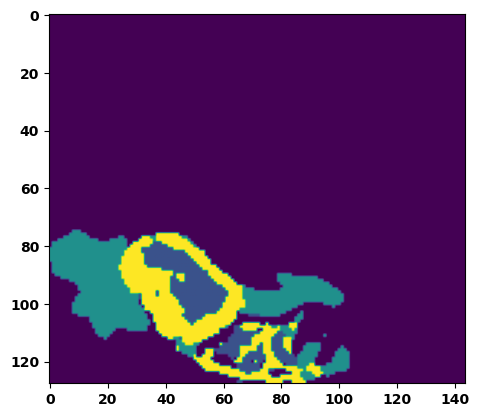

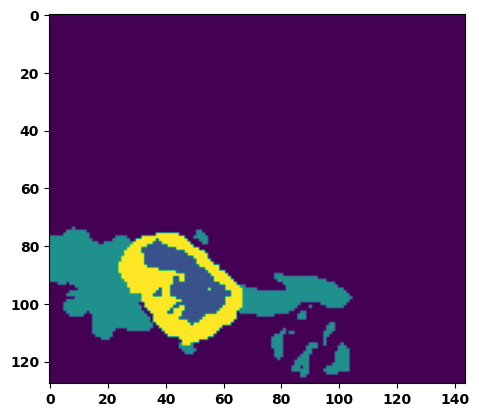

  6%|▌         | 2/36 [00:03<00:55,  1.63s/it]

Batch_id:  1 Eval loss:  0.09143996238708496
Batch_id:  1 Eval IoU:  tensor(0.8482, device='cuda:0')
Batch_id:  1 Eval Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  1 Eval Non-tumor Dice Score:  tensor(0.9921, device='cuda:0')
Batch_id:  1 Eval NCR/NET Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  1 Eval ED Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  1 Eval ET Dice Score:  tensor(0.9946, device='cuda:0')


  8%|▊         | 3/36 [00:04<00:51,  1.56s/it]

Batch_id:  2 Eval loss:  0.18913930654525757
Batch_id:  2 Eval IoU:  tensor(0.7218, device='cuda:0')
Batch_id:  2 Eval Mean Dice Score:  tensor(0.9925, device='cuda:0')
Batch_id:  2 Eval Non-tumor Dice Score:  tensor(0.9952, device='cuda:0')
Batch_id:  2 Eval NCR/NET Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  2 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  2 Eval ET Dice Score:  tensor(0.9963, device='cuda:0')


 11%|█         | 4/36 [00:06<00:50,  1.58s/it]

Batch_id:  3 Eval loss:  0.23883919417858124
Batch_id:  3 Eval IoU:  tensor(0.6625, device='cuda:0')
Batch_id:  3 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  3 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  3 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  3 Eval ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  3 Eval ET Dice Score:  tensor(0.9877, device='cuda:0')


 14%|█▍        | 5/36 [00:08<00:49,  1.58s/it]

Batch_id:  4 Eval loss:  0.3985622823238373
Batch_id:  4 Eval IoU:  tensor(0.4874, device='cuda:0')
Batch_id:  4 Eval Mean Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  4 Eval Non-tumor Dice Score:  tensor(0.9885, device='cuda:0')
Batch_id:  4 Eval NCR/NET Dice Score:  tensor(0.9252, device='cuda:0')
Batch_id:  4 Eval ED Dice Score:  tensor(0.9191, device='cuda:0')
Batch_id:  4 Eval ET Dice Score:  tensor(0.9893, device='cuda:0')


 17%|█▋        | 6/36 [00:09<00:46,  1.55s/it]

Batch_id:  5 Eval loss:  0.08096413314342499
Batch_id:  5 Eval IoU:  tensor(0.8626, device='cuda:0')
Batch_id:  5 Eval Mean Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  5 Eval Non-tumor Dice Score:  tensor(0.9858, device='cuda:0')
Batch_id:  5 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  5 Eval ED Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  5 Eval ET Dice Score:  tensor(0.9970, device='cuda:0')


 19%|█▉        | 7/36 [00:11<00:45,  1.56s/it]

Batch_id:  6 Eval loss:  0.10088677704334259
Batch_id:  6 Eval IoU:  tensor(0.8267, device='cuda:0')
Batch_id:  6 Eval Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  6 Eval Non-tumor Dice Score:  tensor(0.9859, device='cuda:0')
Batch_id:  6 Eval NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  6 Eval ED Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  6 Eval ET Dice Score:  tensor(0.9898, device='cuda:0')


 22%|██▏       | 8/36 [00:12<00:42,  1.53s/it]

Batch_id:  7 Eval loss:  0.17983651161193848
Batch_id:  7 Eval IoU:  tensor(0.7247, device='cuda:0')
Batch_id:  7 Eval Mean Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  7 Eval Non-tumor Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  7 Eval NCR/NET Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  7 Eval ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  7 Eval ET Dice Score:  tensor(0.9890, device='cuda:0')


 25%|██▌       | 9/36 [00:14<00:41,  1.54s/it]

Batch_id:  8 Eval loss:  0.06161341071128845
Batch_id:  8 Eval IoU:  tensor(0.9012, device='cuda:0')
Batch_id:  8 Eval Mean Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  8 Eval Non-tumor Dice Score:  tensor(0.9935, device='cuda:0')
Batch_id:  8 Eval NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  8 Eval ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  8 Eval ET Dice Score:  tensor(0.9952, device='cuda:0')


 28%|██▊       | 10/36 [00:15<00:39,  1.52s/it]

Batch_id:  9 Eval loss:  0.07769420742988586
Batch_id:  9 Eval IoU:  tensor(0.8693, device='cuda:0')
Batch_id:  9 Eval Mean Dice Score:  tensor(0.9812, device='cuda:0')
Batch_id:  9 Eval Non-tumor Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  9 Eval NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  9 Eval ED Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  9 Eval ET Dice Score:  tensor(0.9869, device='cuda:0')
Batch_id:  10 Eval loss:  0.20777557790279388
Batch_id:  10 Eval IoU:  tensor(0.6775, device='cuda:0')
Batch_id:  10 Eval Mean Dice Score:  tensor(0.9524, device='cuda:0')
Batch_id:  10 Eval Non-tumor Dice Score:  tensor(0.9475, device='cuda:0')
Batch_id:  10 Eval NCR/NET Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  10 Eval ED Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  10 Eval ET Dice Score:  tensor(0.9818, device='cuda:0')


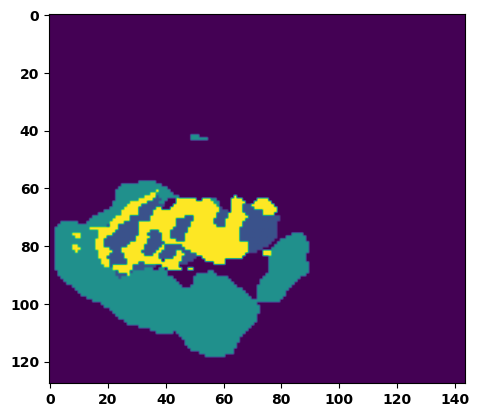

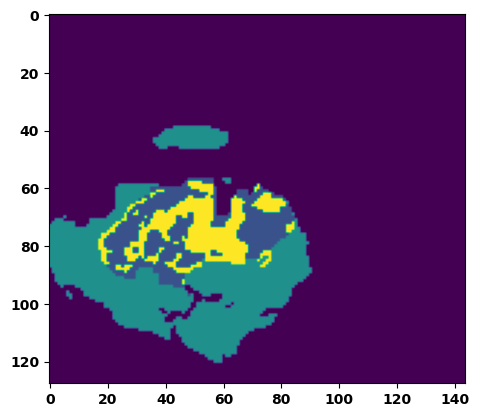

 33%|███▎      | 12/36 [00:18<00:35,  1.50s/it]

Batch_id:  11 Eval loss:  0.30224359035491943
Batch_id:  11 Eval IoU:  tensor(0.5939, device='cuda:0')
Batch_id:  11 Eval Mean Dice Score:  tensor(0.9544, device='cuda:0')
Batch_id:  11 Eval Non-tumor Dice Score:  tensor(0.9351, device='cuda:0')
Batch_id:  11 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  11 Eval ED Dice Score:  tensor(0.9403, device='cuda:0')
Batch_id:  11 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 36%|███▌      | 13/36 [00:19<00:33,  1.46s/it]

Batch_id:  12 Eval loss:  0.06800925731658936
Batch_id:  12 Eval IoU:  tensor(0.8831, device='cuda:0')
Batch_id:  12 Eval Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  12 Eval Non-tumor Dice Score:  tensor(0.9791, device='cuda:0')
Batch_id:  12 Eval NCR/NET Dice Score:  tensor(0.9949, device='cuda:0')
Batch_id:  12 Eval ED Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  12 Eval ET Dice Score:  tensor(0.9906, device='cuda:0')


 39%|███▉      | 14/36 [00:21<00:32,  1.48s/it]

Batch_id:  13 Eval loss:  0.0880604088306427
Batch_id:  13 Eval IoU:  tensor(0.8478, device='cuda:0')
Batch_id:  13 Eval Mean Dice Score:  tensor(0.9895, device='cuda:0')
Batch_id:  13 Eval Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  13 Eval NCR/NET Dice Score:  tensor(0.9909, device='cuda:0')
Batch_id:  13 Eval ED Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  13 Eval ET Dice Score:  tensor(0.9900, device='cuda:0')


 42%|████▏     | 15/36 [00:23<00:32,  1.56s/it]

Batch_id:  14 Eval loss:  0.18897365033626556
Batch_id:  14 Eval IoU:  tensor(0.7222, device='cuda:0')
Batch_id:  14 Eval Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  14 Eval Non-tumor Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  14 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  14 Eval ED Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  14 Eval ET Dice Score:  tensor(0.9884, device='cuda:0')


 44%|████▍     | 16/36 [00:24<00:31,  1.56s/it]

Batch_id:  15 Eval loss:  0.25638869404792786
Batch_id:  15 Eval IoU:  tensor(0.6506, device='cuda:0')
Batch_id:  15 Eval Mean Dice Score:  tensor(0.9567, device='cuda:0')
Batch_id:  15 Eval Non-tumor Dice Score:  tensor(0.9458, device='cuda:0')
Batch_id:  15 Eval NCR/NET Dice Score:  tensor(0.9905, device='cuda:0')
Batch_id:  15 Eval ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  15 Eval ET Dice Score:  tensor(0.9922, device='cuda:0')


 47%|████▋     | 17/36 [00:26<00:29,  1.57s/it]

Batch_id:  16 Eval loss:  0.072762131690979
Batch_id:  16 Eval IoU:  tensor(0.8875, device='cuda:0')
Batch_id:  16 Eval Mean Dice Score:  tensor(0.9942, device='cuda:0')
Batch_id:  16 Eval Non-tumor Dice Score:  tensor(0.9930, device='cuda:0')
Batch_id:  16 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  16 Eval ED Dice Score:  tensor(0.9920, device='cuda:0')
Batch_id:  16 Eval ET Dice Score:  tensor(0.9983, device='cuda:0')


 50%|█████     | 18/36 [00:27<00:27,  1.55s/it]

Batch_id:  17 Eval loss:  0.1571047455072403
Batch_id:  17 Eval IoU:  tensor(0.7506, device='cuda:0')
Batch_id:  17 Eval Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  17 Eval Non-tumor Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  17 Eval NCR/NET Dice Score:  tensor(0.9924, device='cuda:0')
Batch_id:  17 Eval ED Dice Score:  tensor(0.9745, device='cuda:0')
Batch_id:  17 Eval ET Dice Score:  tensor(0.9941, device='cuda:0')


 53%|█████▎    | 19/36 [00:29<00:25,  1.51s/it]

Batch_id:  18 Eval loss:  0.28393375873565674
Batch_id:  18 Eval IoU:  tensor(0.6169, device='cuda:0')
Batch_id:  18 Eval Mean Dice Score:  tensor(0.9582, device='cuda:0')
Batch_id:  18 Eval Non-tumor Dice Score:  tensor(0.9848, device='cuda:0')
Batch_id:  18 Eval NCR/NET Dice Score:  tensor(0.9565, device='cuda:0')
Batch_id:  18 Eval ED Dice Score:  tensor(0.9407, device='cuda:0')
Batch_id:  18 Eval ET Dice Score:  tensor(0.9927, device='cuda:0')


 56%|█████▌    | 20/36 [00:31<00:25,  1.57s/it]

Batch_id:  19 Eval loss:  0.09164318442344666
Batch_id:  19 Eval IoU:  tensor(0.8727, device='cuda:0')
Batch_id:  19 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  19 Eval Non-tumor Dice Score:  tensor(0.9870, device='cuda:0')
Batch_id:  19 Eval NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  19 Eval ED Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  19 Eval ET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  20 Eval loss:  0.40363484621047974
Batch_id:  20 Eval IoU:  tensor(0.5215, device='cuda:0')
Batch_id:  20 Eval Mean Dice Score:  tensor(0.9737, device='cuda:0')
Batch_id:  20 Eval Non-tumor Dice Score:  tensor(0.9646, device='cuda:0')
Batch_id:  20 Eval NCR/NET Dice Score:  tensor(0.9933, device='cuda:0')
Batch_id:  20 Eval ED Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  20 Eval ET Dice Score:  tensor(0.9930, device='cuda:0')


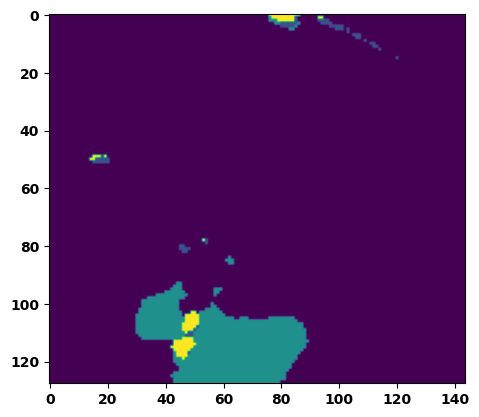

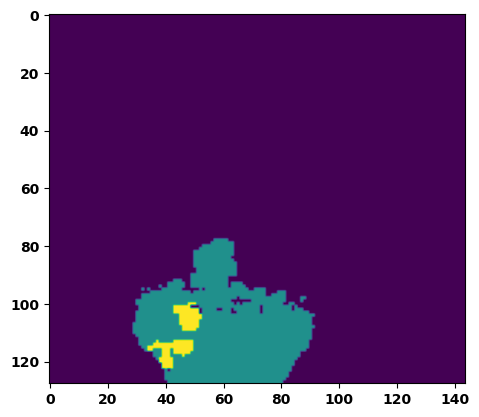

 61%|██████    | 22/36 [00:34<00:22,  1.62s/it]

Batch_id:  21 Eval loss:  0.13072951138019562
Batch_id:  21 Eval IoU:  tensor(0.7978, device='cuda:0')
Batch_id:  21 Eval Mean Dice Score:  tensor(0.9591, device='cuda:0')
Batch_id:  21 Eval Non-tumor Dice Score:  tensor(0.9444, device='cuda:0')
Batch_id:  21 Eval NCR/NET Dice Score:  tensor(0.9973, device='cuda:0')
Batch_id:  21 Eval ED Dice Score:  tensor(0.9418, device='cuda:0')
Batch_id:  21 Eval ET Dice Score:  tensor(0.9937, device='cuda:0')


 64%|██████▍   | 23/36 [00:35<00:20,  1.54s/it]

Batch_id:  22 Eval loss:  0.2558785676956177
Batch_id:  22 Eval IoU:  tensor(0.6953, device='cuda:0')
Batch_id:  22 Eval Mean Dice Score:  tensor(0.9799, device='cuda:0')
Batch_id:  22 Eval Non-tumor Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  22 Eval NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  22 Eval ED Dice Score:  tensor(0.9714, device='cuda:0')
Batch_id:  22 Eval ET Dice Score:  tensor(0.9958, device='cuda:0')


 67%|██████▋   | 24/36 [00:37<00:19,  1.59s/it]

Batch_id:  23 Eval loss:  0.38685160875320435
Batch_id:  23 Eval IoU:  tensor(0.5436, device='cuda:0')
Batch_id:  23 Eval Mean Dice Score:  tensor(0.9820, device='cuda:0')
Batch_id:  23 Eval Non-tumor Dice Score:  tensor(0.9739, device='cuda:0')
Batch_id:  23 Eval NCR/NET Dice Score:  tensor(0.9994, device='cuda:0')
Batch_id:  23 Eval ED Dice Score:  tensor(0.9749, device='cuda:0')
Batch_id:  23 Eval ET Dice Score:  tensor(0.9979, device='cuda:0')


 69%|██████▉   | 25/36 [00:39<00:17,  1.63s/it]

Batch_id:  24 Eval loss:  0.4067171812057495
Batch_id:  24 Eval IoU:  tensor(0.5280, device='cuda:0')
Batch_id:  24 Eval Mean Dice Score:  tensor(0.9055, device='cuda:0')
Batch_id:  24 Eval Non-tumor Dice Score:  tensor(0.8593, device='cuda:0')
Batch_id:  24 Eval NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  24 Eval ED Dice Score:  tensor(0.8587, device='cuda:0')
Batch_id:  24 Eval ET Dice Score:  tensor(0.9984, device='cuda:0')


 72%|███████▏  | 26/36 [00:40<00:16,  1.61s/it]

Batch_id:  25 Eval loss:  0.05818411707878113
Batch_id:  25 Eval IoU:  tensor(0.8998, device='cuda:0')
Batch_id:  25 Eval Mean Dice Score:  tensor(0.9892, device='cuda:0')
Batch_id:  25 Eval Non-tumor Dice Score:  tensor(0.9904, device='cuda:0')
Batch_id:  25 Eval NCR/NET Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  25 Eval ED Dice Score:  tensor(0.9896, device='cuda:0')
Batch_id:  25 Eval ET Dice Score:  tensor(0.9938, device='cuda:0')


 75%|███████▌  | 27/36 [00:42<00:13,  1.55s/it]

Batch_id:  26 Eval loss:  0.14243488013744354
Batch_id:  26 Eval IoU:  tensor(0.7862, device='cuda:0')
Batch_id:  26 Eval Mean Dice Score:  tensor(0.9797, device='cuda:0')
Batch_id:  26 Eval Non-tumor Dice Score:  tensor(0.9769, device='cuda:0')
Batch_id:  26 Eval NCR/NET Dice Score:  tensor(0.9960, device='cuda:0')
Batch_id:  26 Eval ED Dice Score:  tensor(0.9753, device='cuda:0')
Batch_id:  26 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')


 78%|███████▊  | 28/36 [00:43<00:11,  1.46s/it]

Batch_id:  27 Eval loss:  0.2882004380226135
Batch_id:  27 Eval IoU:  tensor(0.6478, device='cuda:0')
Batch_id:  27 Eval Mean Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  27 Eval Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  27 Eval NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  27 Eval ED Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  27 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


 81%|████████  | 29/36 [00:44<00:10,  1.45s/it]

Batch_id:  28 Eval loss:  0.1489732265472412
Batch_id:  28 Eval IoU:  tensor(0.7585, device='cuda:0')
Batch_id:  28 Eval Mean Dice Score:  tensor(0.9785, device='cuda:0')
Batch_id:  28 Eval Non-tumor Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  28 Eval NCR/NET Dice Score:  tensor(0.9934, device='cuda:0')
Batch_id:  28 Eval ED Dice Score:  tensor(0.9867, device='cuda:0')
Batch_id:  28 Eval ET Dice Score:  tensor(0.9851, device='cuda:0')


 83%|████████▎ | 30/36 [00:46<00:08,  1.41s/it]

Batch_id:  29 Eval loss:  0.08035038411617279
Batch_id:  29 Eval IoU:  tensor(0.8605, device='cuda:0')
Batch_id:  29 Eval Mean Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  29 Eval Non-tumor Dice Score:  tensor(0.9878, device='cuda:0')
Batch_id:  29 Eval NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  29 Eval ED Dice Score:  tensor(0.9831, device='cuda:0')
Batch_id:  29 Eval ET Dice Score:  tensor(0.9908, device='cuda:0')
Batch_id:  30 Eval loss:  0.7198898792266846
Batch_id:  30 Eval IoU:  tensor(0.2540, device='cuda:0')
Batch_id:  30 Eval Mean Dice Score:  tensor(0.9521, device='cuda:0')
Batch_id:  30 Eval Non-tumor Dice Score:  tensor(0.9332, device='cuda:0')
Batch_id:  30 Eval NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  30 Eval ED Dice Score:  tensor(0.9461, device='cuda:0')
Batch_id:  30 Eval ET Dice Score:  tensor(0.9977, device='cuda:0')


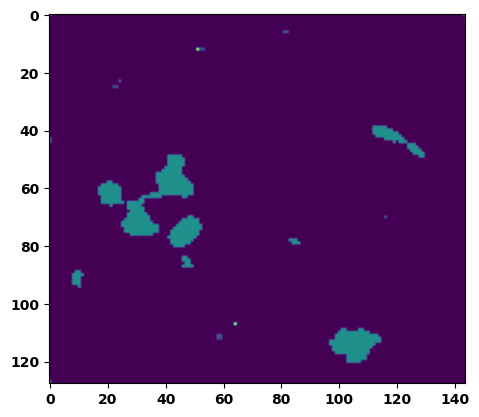

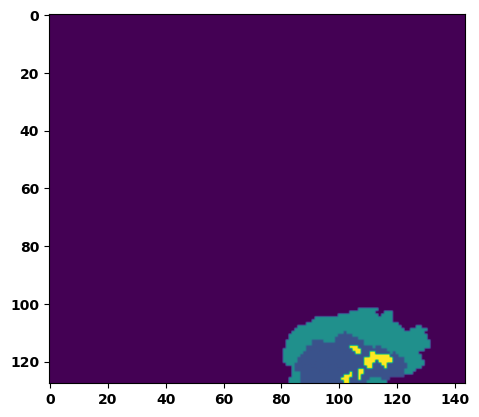

 89%|████████▉ | 32/36 [00:49<00:06,  1.56s/it]

Batch_id:  31 Eval loss:  0.1989966332912445
Batch_id:  31 Eval IoU:  tensor(0.7040, device='cuda:0')
Batch_id:  31 Eval Mean Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  31 Eval Non-tumor Dice Score:  tensor(0.9703, device='cuda:0')
Batch_id:  31 Eval NCR/NET Dice Score:  tensor(0.9805, device='cuda:0')
Batch_id:  31 Eval ED Dice Score:  tensor(0.9691, device='cuda:0')
Batch_id:  31 Eval ET Dice Score:  tensor(0.9923, device='cuda:0')


 92%|█████████▏| 33/36 [00:50<00:04,  1.51s/it]

Batch_id:  32 Eval loss:  0.597724199295044
Batch_id:  32 Eval IoU:  tensor(0.3549, device='cuda:0')
Batch_id:  32 Eval Mean Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  32 Eval Non-tumor Dice Score:  tensor(0.9734, device='cuda:0')
Batch_id:  32 Eval NCR/NET Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  32 Eval ED Dice Score:  tensor(0.9740, device='cuda:0')
Batch_id:  32 Eval ET Dice Score:  tensor(0.9947, device='cuda:0')


 94%|█████████▍| 34/36 [00:52<00:02,  1.47s/it]

Batch_id:  33 Eval loss:  0.5032203197479248
Batch_id:  33 Eval IoU:  tensor(0.4052, device='cuda:0')
Batch_id:  33 Eval Mean Dice Score:  tensor(0.9358, device='cuda:0')
Batch_id:  33 Eval Non-tumor Dice Score:  tensor(0.9400, device='cuda:0')
Batch_id:  33 Eval NCR/NET Dice Score:  tensor(0.9299, device='cuda:0')
Batch_id:  33 Eval ED Dice Score:  tensor(0.9390, device='cuda:0')
Batch_id:  33 Eval ET Dice Score:  tensor(0.9985, device='cuda:0')


 97%|█████████▋| 35/36 [00:53<00:01,  1.45s/it]

Batch_id:  34 Eval loss:  0.22367076575756073
Batch_id:  34 Eval IoU:  tensor(0.6805, device='cuda:0')
Batch_id:  34 Eval Mean Dice Score:  tensor(0.9704, device='cuda:0')
Batch_id:  34 Eval Non-tumor Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  34 Eval NCR/NET Dice Score:  tensor(0.9801, device='cuda:0')
Batch_id:  34 Eval ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  34 Eval ET Dice Score:  tensor(0.9808, device='cuda:0')


100%|██████████| 36/36 [00:55<00:00,  1.54s/it]

Batch_id:  35 Eval loss:  0.1958349496126175
Batch_id:  35 Eval IoU:  tensor(0.7015, device='cuda:0')
Batch_id:  35 Eval Mean Dice Score:  tensor(0.9750, device='cuda:0')
Batch_id:  35 Eval Non-tumor Dice Score:  tensor(0.9735, device='cuda:0')
Batch_id:  35 Eval NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  35 Eval ED Dice Score:  tensor(0.9707, device='cuda:0')
Batch_id:  35 Eval ET Dice Score:  tensor(0.9867, device='cuda:0')
Epoch  49 Training loss:  0.16268023685975508
Epoch  49 Evaluation loss:  0.22167159409986603
Epoch  49 Training accuracy :  tensor(0.7668)
Epoch  49 Evaluation accuracy :  tensor(0.7048)
Epoch  49 Training Mean Dice Score:  tensor(0.9816)
Epoch  49 Eval Mean Dice Score:  tensor(0.9736)
Epoch  49 Training Non-tumor Dice Score:  tensor(0.9830)
Epoch  49 Eval Non-tumor Dice Score:  tensor(0.9726)
Epoch  49 Training NCR/NET Dice Score:  tensor(0.9917)
Epoch  49 Eval NCR/NET Dice Score:  tensor(0.9873)
Epoch  49 Training ED Dice Score:  tensor(0.9

Epoch completed and model successfully saved


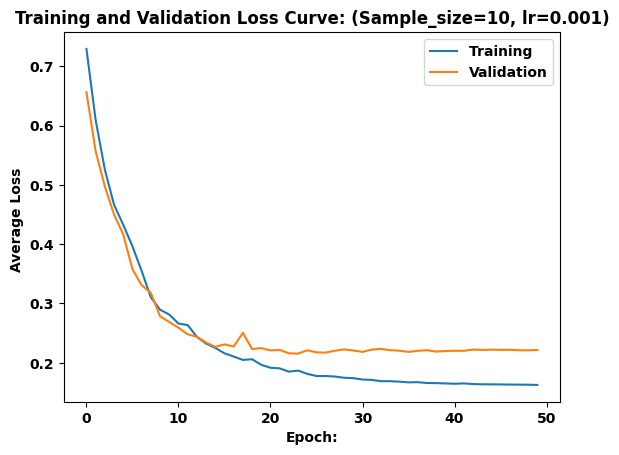

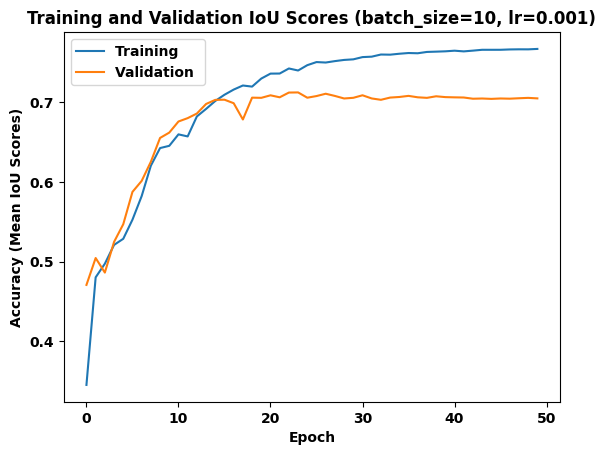

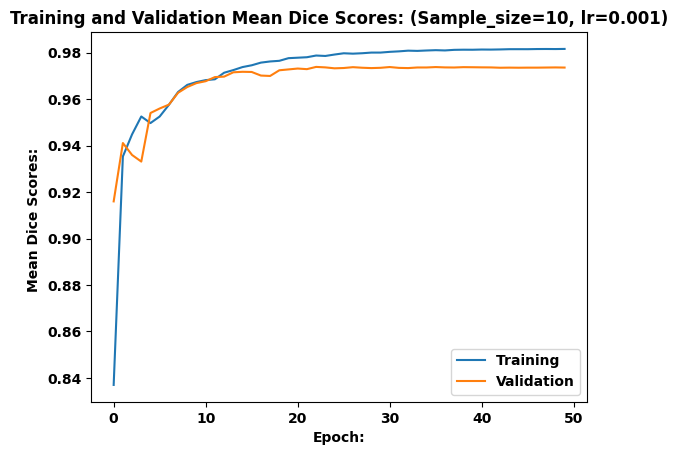

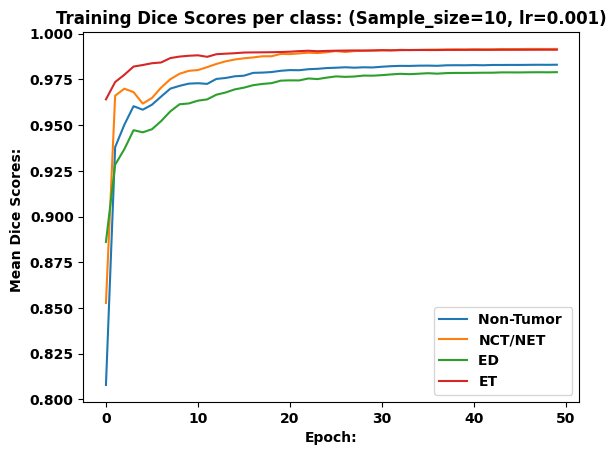

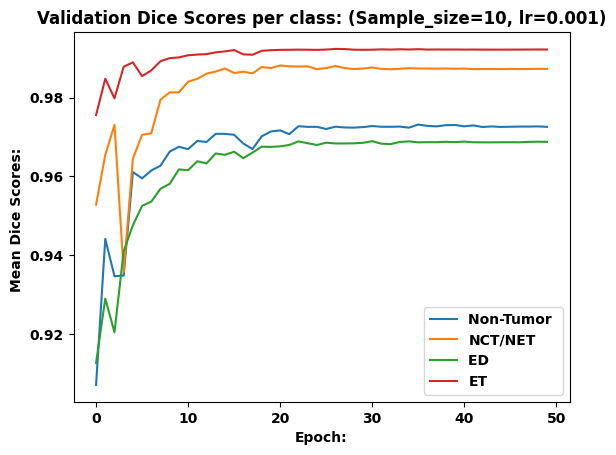

test in session: 
Model loaded! Epoch =  23 Mean eval dice scores is:  tensor(0.9737)
Dice Scorese Per class: 
Non-Tumor:  tensor(0.9725)
NCR/NET:  tensor(0.9879)
ED:  tensor(0.9684)
ET:  tensor(0.9921)


  0%|          | 0/36 [00:00<?, ?it/s]

Batch_id:  0 Test loss:  0.10511910915374756
Batch_id:  0 Test IoU:  tensor(0.8239, device='cuda:0')
Batch_id:  0 Test Mean Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  0 Test Non-tumor Dice Score:  tensor(0.9789, device='cuda:0')
Batch_id:  0 Test NCR/NET Dice Score:  tensor(0.9948, device='cuda:0')
Batch_id:  0 Test ED Dice Score:  tensor(0.9861, device='cuda:0')
Batch_id:  0 Test ET Dice Score:  tensor(0.9914, device='cuda:0')


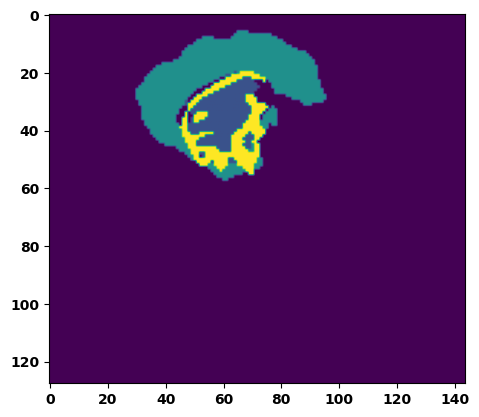

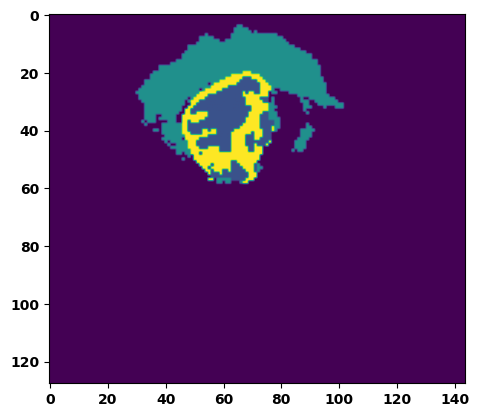

  3%|▎         | 1/36 [00:01<00:52,  1.49s/it]

Batch_id:  1 Test loss:  0.08796490728855133
Batch_id:  1 Test IoU:  tensor(0.8726, device='cuda:0')
Batch_id:  1 Test Mean Dice Score:  tensor(0.9929, device='cuda:0')
Batch_id:  1 Test Non-tumor Dice Score:  tensor(0.9911, device='cuda:0')
Batch_id:  1 Test NCR/NET Dice Score:  tensor(0.9993, device='cuda:0')
Batch_id:  1 Test ED Dice Score:  tensor(0.9902, device='cuda:0')
Batch_id:  1 Test ET Dice Score:  tensor(0.9981, device='cuda:0')


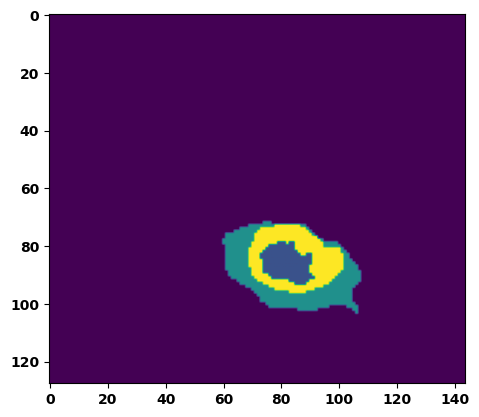

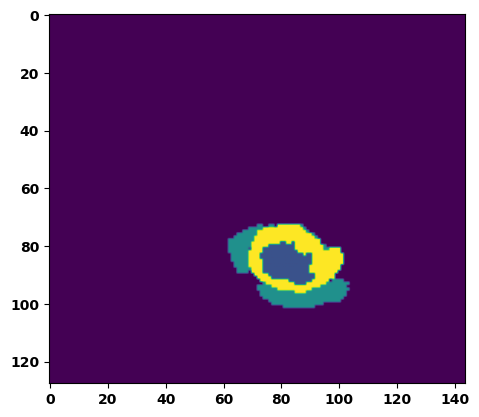

  6%|▌         | 2/36 [00:03<00:57,  1.68s/it]

Batch_id:  2 Test loss:  0.07925014197826385
Batch_id:  2 Test IoU:  tensor(0.8705, device='cuda:0')
Batch_id:  2 Test Mean Dice Score:  tensor(0.9814, device='cuda:0')
Batch_id:  2 Test Non-tumor Dice Score:  tensor(0.9807, device='cuda:0')
Batch_id:  2 Test NCR/NET Dice Score:  tensor(0.9927, device='cuda:0')
Batch_id:  2 Test ED Dice Score:  tensor(0.9838, device='cuda:0')
Batch_id:  2 Test ET Dice Score:  tensor(0.9871, device='cuda:0')


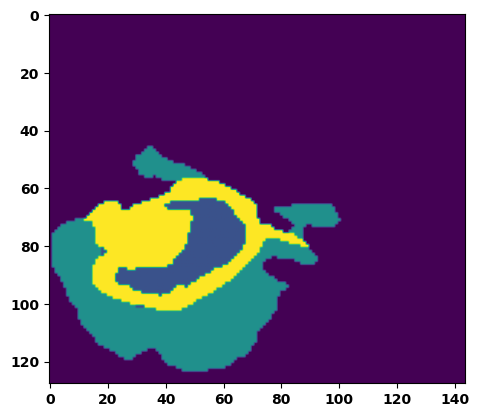

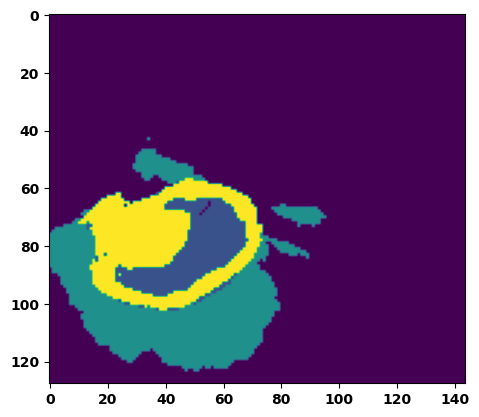

  8%|▊         | 3/36 [00:04<00:52,  1.59s/it]

Batch_id:  3 Test loss:  0.37550610303878784
Batch_id:  3 Test IoU:  tensor(0.5532, device='cuda:0')
Batch_id:  3 Test Mean Dice Score:  tensor(0.9748, device='cuda:0')
Batch_id:  3 Test Non-tumor Dice Score:  tensor(0.9694, device='cuda:0')
Batch_id:  3 Test NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  3 Test ED Dice Score:  tensor(0.9701, device='cuda:0')
Batch_id:  3 Test ET Dice Score:  tensor(0.9943, device='cuda:0')


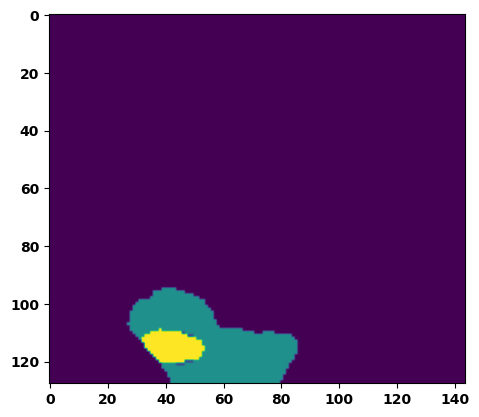

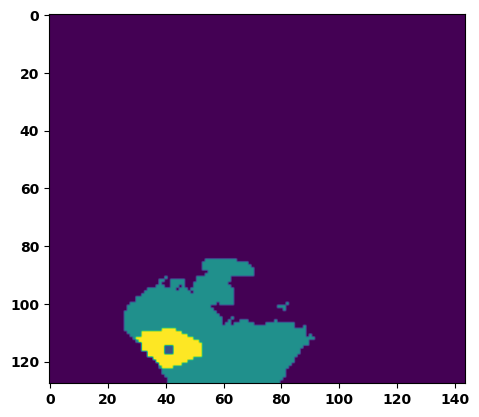

 11%|█         | 4/36 [00:06<00:51,  1.60s/it]

Batch_id:  4 Test loss:  0.12499231100082397
Batch_id:  4 Test IoU:  tensor(0.8057, device='cuda:0')
Batch_id:  4 Test Mean Dice Score:  tensor(0.9612, device='cuda:0')
Batch_id:  4 Test Non-tumor Dice Score:  tensor(0.9478, device='cuda:0')
Batch_id:  4 Test NCR/NET Dice Score:  tensor(0.9974, device='cuda:0')
Batch_id:  4 Test ED Dice Score:  tensor(0.9451, device='cuda:0')
Batch_id:  4 Test ET Dice Score:  tensor(0.9933, device='cuda:0')


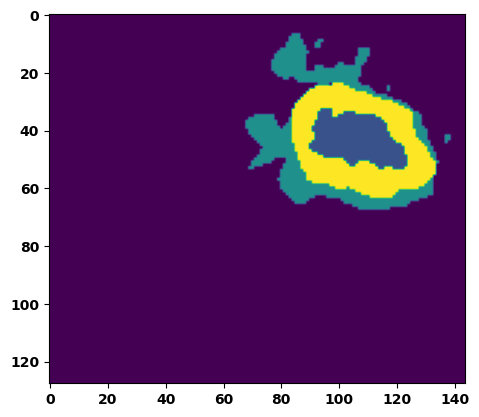

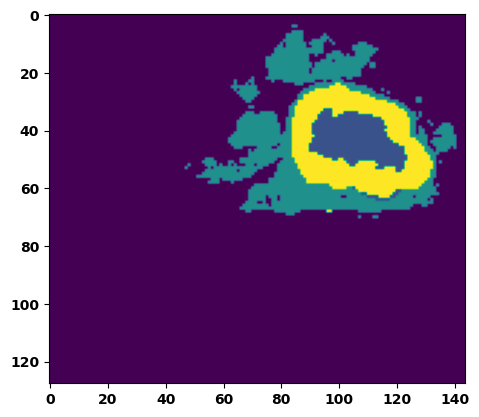

 14%|█▍        | 5/36 [00:07<00:48,  1.56s/it]

Batch_id:  5 Test loss:  0.17648370563983917
Batch_id:  5 Test IoU:  tensor(0.7320, device='cuda:0')
Batch_id:  5 Test Mean Dice Score:  tensor(0.9836, device='cuda:0')
Batch_id:  5 Test Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  5 Test NCR/NET Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  5 Test ED Dice Score:  tensor(0.9813, device='cuda:0')
Batch_id:  5 Test ET Dice Score:  tensor(0.9887, device='cuda:0')


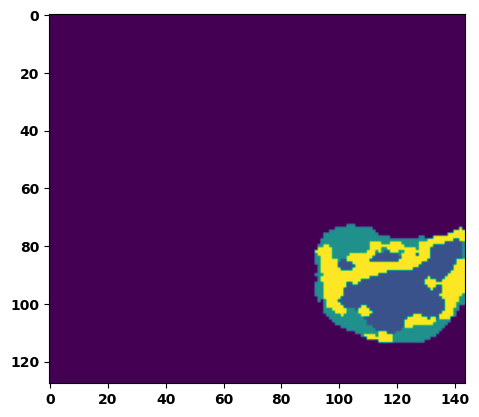

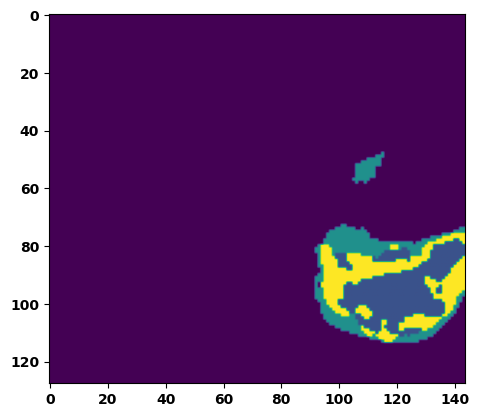

 17%|█▋        | 6/36 [00:09<00:44,  1.49s/it]

Batch_id:  6 Test loss:  0.1062295138835907
Batch_id:  6 Test IoU:  tensor(0.8190, device='cuda:0')
Batch_id:  6 Test Mean Dice Score:  tensor(0.9810, device='cuda:0')
Batch_id:  6 Test Non-tumor Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  6 Test NCR/NET Dice Score:  tensor(0.9899, device='cuda:0')
Batch_id:  6 Test ED Dice Score:  tensor(0.9792, device='cuda:0')
Batch_id:  6 Test ET Dice Score:  tensor(0.9886, device='cuda:0')


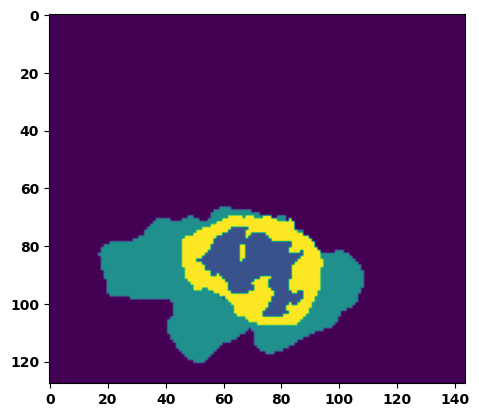

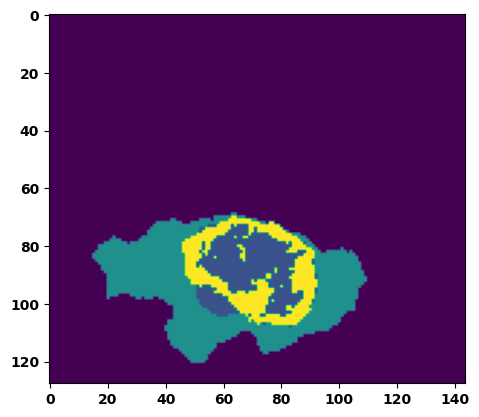

 19%|█▉        | 7/36 [00:10<00:44,  1.54s/it]

Batch_id:  7 Test loss:  0.5895591974258423
Batch_id:  7 Test IoU:  tensor(0.3596, device='cuda:0')
Batch_id:  7 Test Mean Dice Score:  tensor(0.9723, device='cuda:0')
Batch_id:  7 Test Non-tumor Dice Score:  tensor(0.9747, device='cuda:0')
Batch_id:  7 Test NCR/NET Dice Score:  tensor(0.9751, device='cuda:0')
Batch_id:  7 Test ED Dice Score:  tensor(0.9742, device='cuda:0')
Batch_id:  7 Test ET Dice Score:  tensor(0.9928, device='cuda:0')


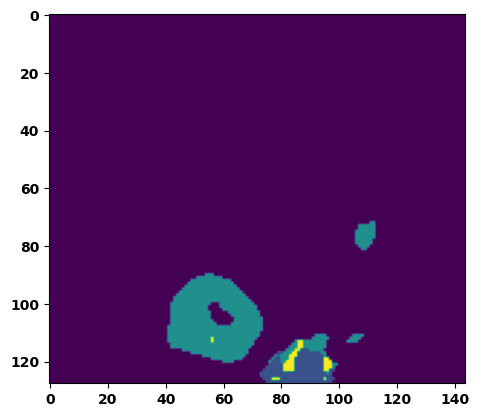

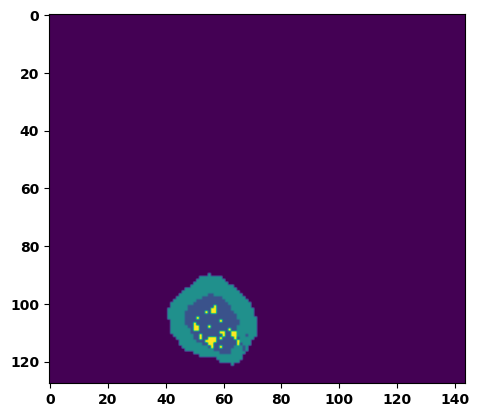

 22%|██▏       | 8/36 [00:12<00:43,  1.57s/it]

Batch_id:  8 Test loss:  0.7286732792854309
Batch_id:  8 Test IoU:  tensor(0.2472, device='cuda:0')
Batch_id:  8 Test Mean Dice Score:  tensor(0.9437, device='cuda:0')
Batch_id:  8 Test Non-tumor Dice Score:  tensor(0.9245, device='cuda:0')
Batch_id:  8 Test NCR/NET Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  8 Test ED Dice Score:  tensor(0.9329, device='cuda:0')
Batch_id:  8 Test ET Dice Score:  tensor(0.9945, device='cuda:0')


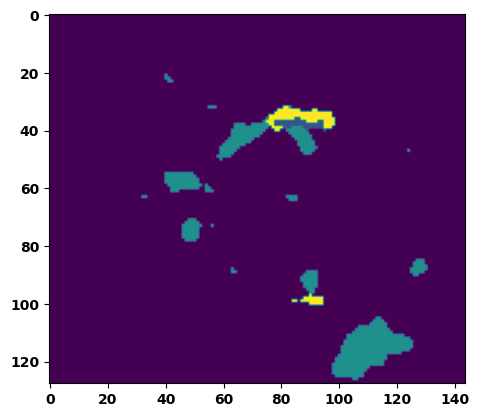

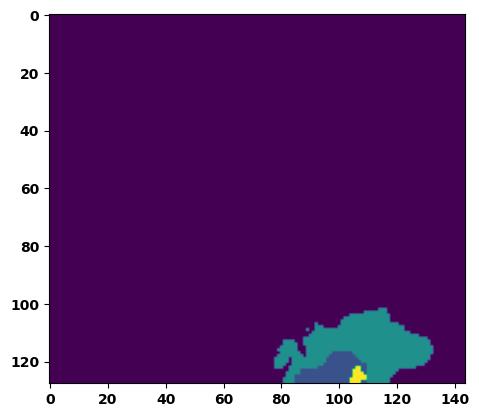

 25%|██▌       | 9/36 [00:14<00:43,  1.63s/it]

Batch_id:  9 Test loss:  0.06913700699806213
Batch_id:  9 Test IoU:  tensor(0.8963, device='cuda:0')
Batch_id:  9 Test Mean Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  9 Test Non-tumor Dice Score:  tensor(0.9936, device='cuda:0')
Batch_id:  9 Test NCR/NET Dice Score:  tensor(0.9977, device='cuda:0')
Batch_id:  9 Test ED Dice Score:  tensor(0.9913, device='cuda:0')
Batch_id:  9 Test ET Dice Score:  tensor(0.9952, device='cuda:0')


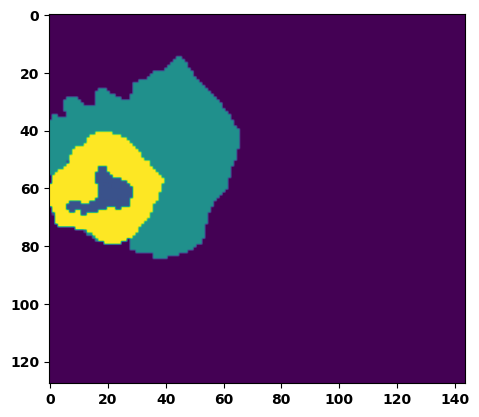

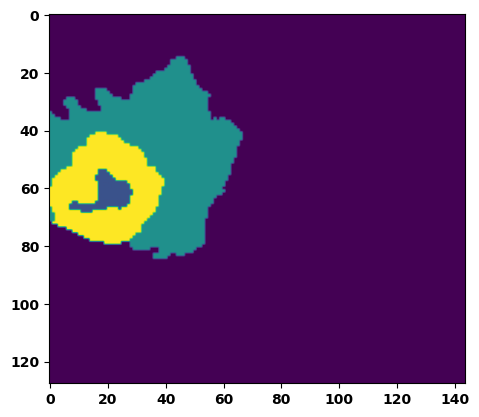

 28%|██▊       | 10/36 [00:15<00:42,  1.65s/it]

Batch_id:  10 Test loss:  0.24115383625030518
Batch_id:  10 Test IoU:  tensor(0.6640, device='cuda:0')
Batch_id:  10 Test Mean Dice Score:  tensor(0.9647, device='cuda:0')
Batch_id:  10 Test Non-tumor Dice Score:  tensor(0.9835, device='cuda:0')
Batch_id:  10 Test NCR/NET Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  10 Test ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  10 Test ET Dice Score:  tensor(0.9930, device='cuda:0')


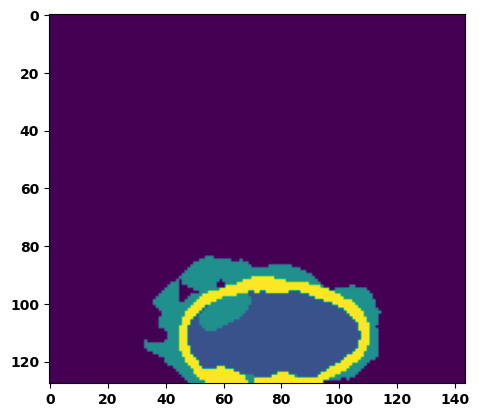

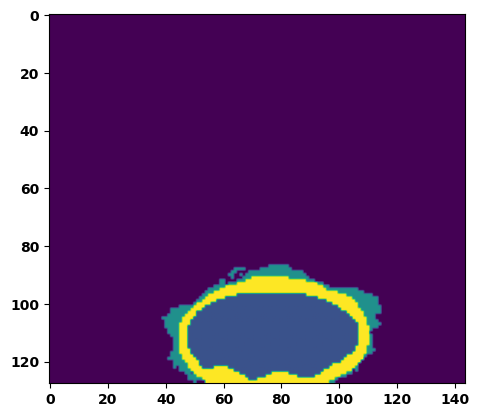

 31%|███       | 11/36 [00:17<00:39,  1.60s/it]

Batch_id:  11 Test loss:  0.2129410356283188
Batch_id:  11 Test IoU:  tensor(0.6726, device='cuda:0')
Batch_id:  11 Test Mean Dice Score:  tensor(0.9497, device='cuda:0')
Batch_id:  11 Test Non-tumor Dice Score:  tensor(0.9428, device='cuda:0')
Batch_id:  11 Test NCR/NET Dice Score:  tensor(0.9741, device='cuda:0')
Batch_id:  11 Test ED Dice Score:  tensor(0.9495, device='cuda:0')
Batch_id:  11 Test ET Dice Score:  tensor(0.9825, device='cuda:0')


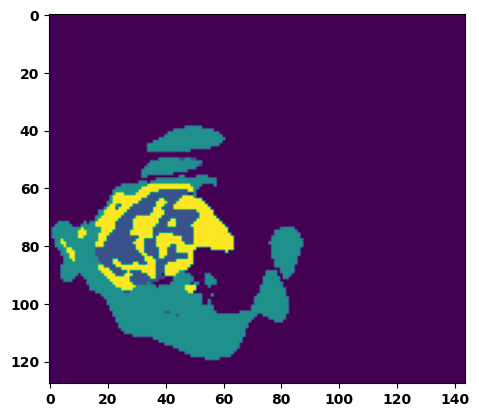

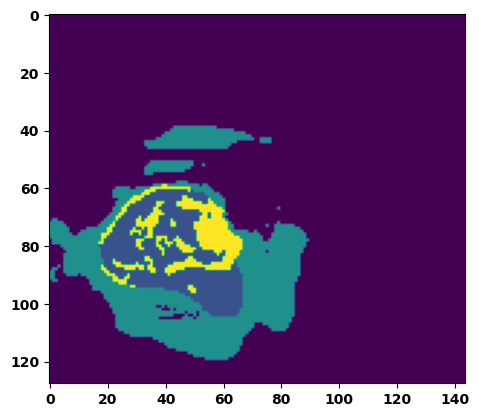

 33%|███▎      | 12/36 [00:19<00:39,  1.64s/it]

Batch_id:  12 Test loss:  0.11674131453037262
Batch_id:  12 Test IoU:  tensor(0.8046, device='cuda:0')
Batch_id:  12 Test Mean Dice Score:  tensor(0.9788, device='cuda:0')
Batch_id:  12 Test Non-tumor Dice Score:  tensor(0.9722, device='cuda:0')
Batch_id:  12 Test NCR/NET Dice Score:  tensor(0.9926, device='cuda:0')
Batch_id:  12 Test ED Dice Score:  tensor(0.9821, device='cuda:0')
Batch_id:  12 Test ET Dice Score:  tensor(0.9895, device='cuda:0')


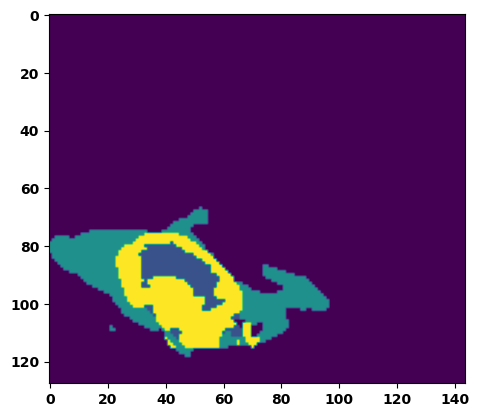

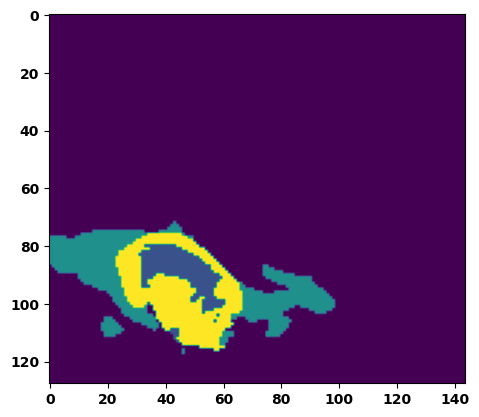

 36%|███▌      | 13/36 [00:20<00:37,  1.63s/it]

Batch_id:  13 Test loss:  0.07963171601295471
Batch_id:  13 Test IoU:  tensor(0.8624, device='cuda:0')
Batch_id:  13 Test Mean Dice Score:  tensor(0.9853, device='cuda:0')
Batch_id:  13 Test Non-tumor Dice Score:  tensor(0.9881, device='cuda:0')
Batch_id:  13 Test NCR/NET Dice Score:  tensor(0.9941, device='cuda:0')
Batch_id:  13 Test ED Dice Score:  tensor(0.9829, device='cuda:0')
Batch_id:  13 Test ET Dice Score:  tensor(0.9906, device='cuda:0')


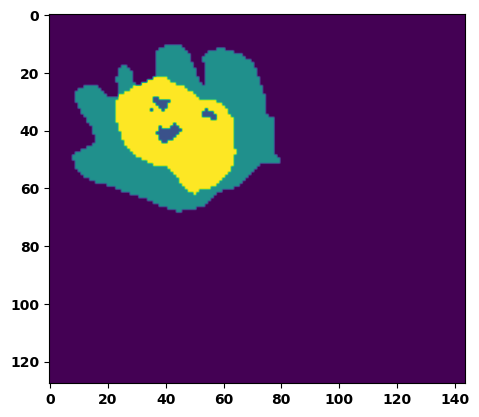

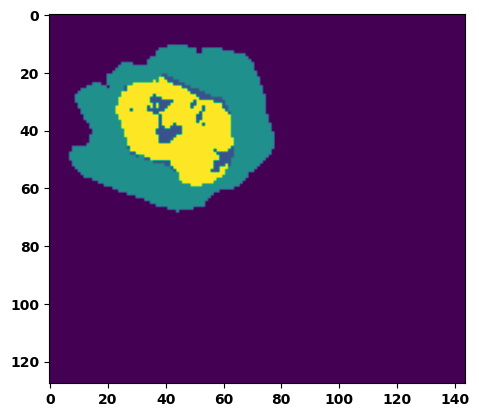

 39%|███▉      | 14/36 [00:22<00:36,  1.66s/it]

Batch_id:  14 Test loss:  0.4066006541252136
Batch_id:  14 Test IoU:  tensor(0.5300, device='cuda:0')
Batch_id:  14 Test Mean Dice Score:  tensor(0.9058, device='cuda:0')
Batch_id:  14 Test Non-tumor Dice Score:  tensor(0.8598, device='cuda:0')
Batch_id:  14 Test NCR/NET Dice Score:  tensor(1.0000, device='cuda:0')
Batch_id:  14 Test ED Dice Score:  tensor(0.8591, device='cuda:0')
Batch_id:  14 Test ET Dice Score:  tensor(0.9987, device='cuda:0')


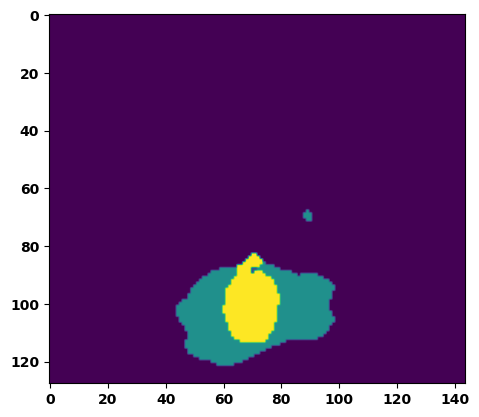

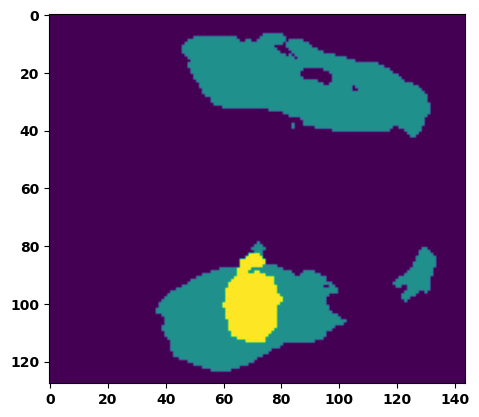

 42%|████▏     | 15/36 [00:24<00:35,  1.70s/it]

Batch_id:  15 Test loss:  0.11844596266746521
Batch_id:  15 Test IoU:  tensor(0.8447, device='cuda:0')
Batch_id:  15 Test Mean Dice Score:  tensor(0.9883, device='cuda:0')
Batch_id:  15 Test Non-tumor Dice Score:  tensor(0.9866, device='cuda:0')
Batch_id:  15 Test NCR/NET Dice Score:  tensor(0.9989, device='cuda:0')
Batch_id:  15 Test ED Dice Score:  tensor(0.9847, device='cuda:0')
Batch_id:  15 Test ET Dice Score:  tensor(0.9949, device='cuda:0')


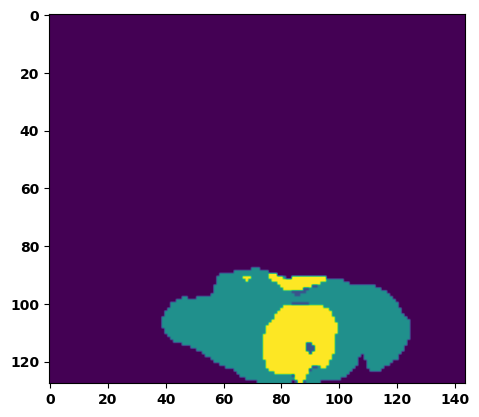

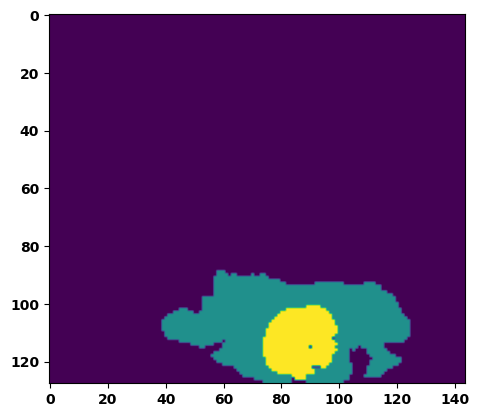

 44%|████▍     | 16/36 [00:25<00:32,  1.64s/it]

Batch_id:  16 Test loss:  0.4189404845237732
Batch_id:  16 Test IoU:  tensor(0.5054, device='cuda:0')
Batch_id:  16 Test Mean Dice Score:  tensor(0.9759, device='cuda:0')
Batch_id:  16 Test Non-tumor Dice Score:  tensor(0.9650, device='cuda:0')
Batch_id:  16 Test NCR/NET Dice Score:  tensor(0.9988, device='cuda:0')
Batch_id:  16 Test ED Dice Score:  tensor(0.9671, device='cuda:0')
Batch_id:  16 Test ET Dice Score:  tensor(0.9969, device='cuda:0')


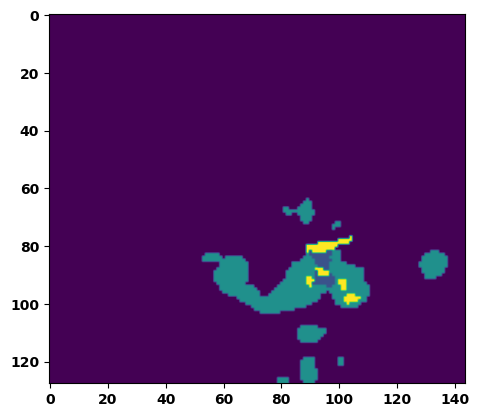

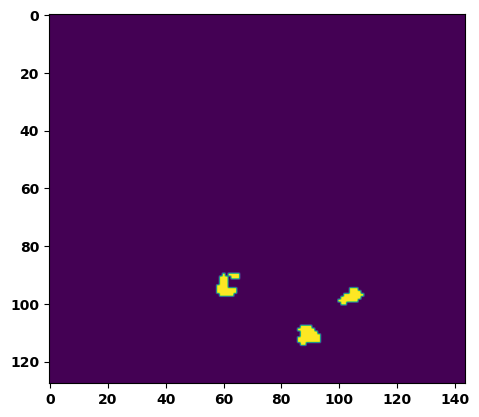

 47%|████▋     | 17/36 [00:27<00:30,  1.63s/it]

Batch_id:  17 Test loss:  0.14048956334590912
Batch_id:  17 Test IoU:  tensor(0.7796, device='cuda:0')
Batch_id:  17 Test Mean Dice Score:  tensor(0.9830, device='cuda:0')
Batch_id:  17 Test Non-tumor Dice Score:  tensor(0.9827, device='cuda:0')
Batch_id:  17 Test NCR/NET Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  17 Test ED Dice Score:  tensor(0.9776, device='cuda:0')
Batch_id:  17 Test ET Dice Score:  tensor(0.9948, device='cuda:0')


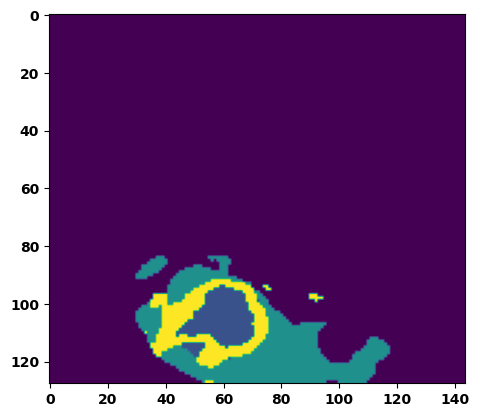

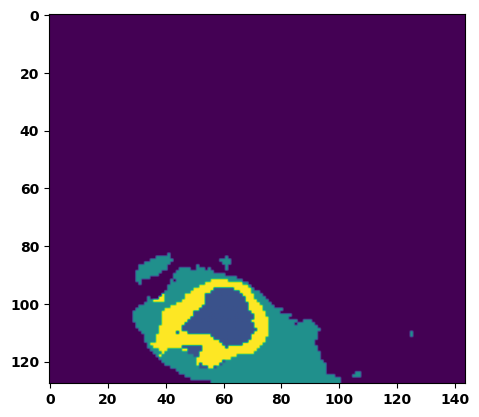

 50%|█████     | 18/36 [00:28<00:28,  1.61s/it]

Batch_id:  18 Test loss:  0.08026780188083649
Batch_id:  18 Test IoU:  tensor(0.8625, device='cuda:0')
Batch_id:  18 Test Mean Dice Score:  tensor(0.9900, device='cuda:0')
Batch_id:  18 Test Non-tumor Dice Score:  tensor(0.9938, device='cuda:0')
Batch_id:  18 Test NCR/NET Dice Score:  tensor(0.9923, device='cuda:0')
Batch_id:  18 Test ED Dice Score:  tensor(0.9939, device='cuda:0')
Batch_id:  18 Test ET Dice Score:  tensor(0.9899, device='cuda:0')


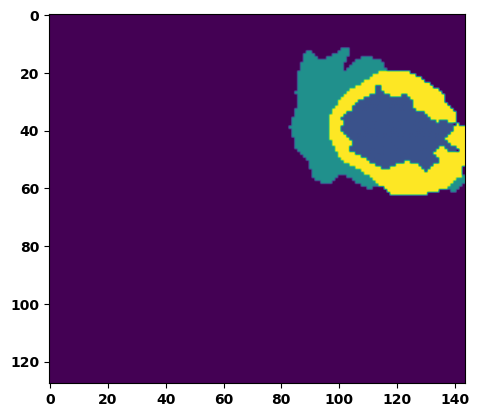

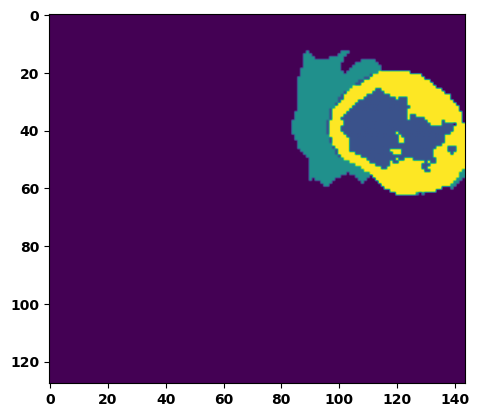

 53%|█████▎    | 19/36 [00:30<00:27,  1.59s/it]

Batch_id:  19 Test loss:  0.4467102885246277
Batch_id:  19 Test IoU:  tensor(0.4485, device='cuda:0')
Batch_id:  19 Test Mean Dice Score:  tensor(0.9401, device='cuda:0')
Batch_id:  19 Test Non-tumor Dice Score:  tensor(0.9467, device='cuda:0')
Batch_id:  19 Test NCR/NET Dice Score:  tensor(0.9342, device='cuda:0')
Batch_id:  19 Test ED Dice Score:  tensor(0.9415, device='cuda:0')
Batch_id:  19 Test ET Dice Score:  tensor(0.9978, device='cuda:0')


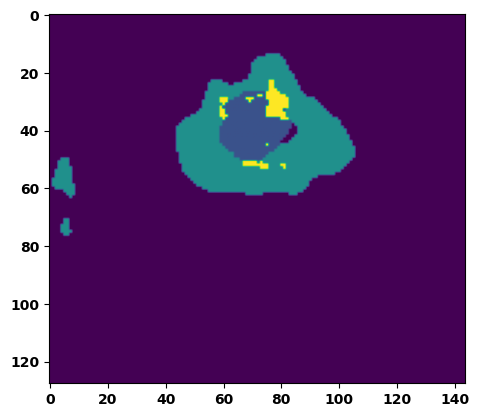

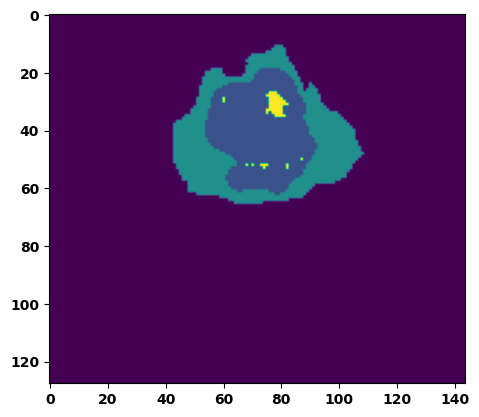

 56%|█████▌    | 20/36 [00:32<00:26,  1.68s/it]

Batch_id:  20 Test loss:  0.1872234344482422
Batch_id:  20 Test IoU:  tensor(0.7277, device='cuda:0')
Batch_id:  20 Test Mean Dice Score:  tensor(0.9922, device='cuda:0')
Batch_id:  20 Test Non-tumor Dice Score:  tensor(0.9946, device='cuda:0')
Batch_id:  20 Test NCR/NET Dice Score:  tensor(0.9951, device='cuda:0')
Batch_id:  20 Test ED Dice Score:  tensor(0.9914, device='cuda:0')
Batch_id:  20 Test ET Dice Score:  tensor(0.9956, device='cuda:0')


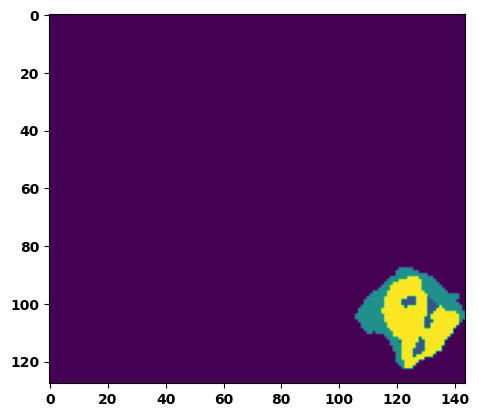

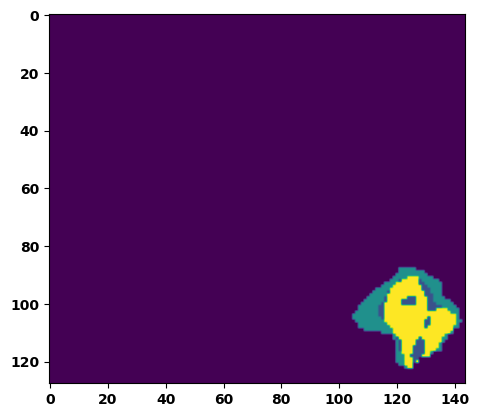

 58%|█████▊    | 21/36 [00:34<00:25,  1.68s/it]

Batch_id:  21 Test loss:  0.07427982985973358
Batch_id:  21 Test IoU:  tensor(0.8741, device='cuda:0')
Batch_id:  21 Test Mean Dice Score:  tensor(0.9793, device='cuda:0')
Batch_id:  21 Test Non-tumor Dice Score:  tensor(0.9773, device='cuda:0')
Batch_id:  21 Test NCR/NET Dice Score:  tensor(0.9947, device='cuda:0')
Batch_id:  21 Test ED Dice Score:  tensor(0.9760, device='cuda:0')
Batch_id:  21 Test ET Dice Score:  tensor(0.9898, device='cuda:0')


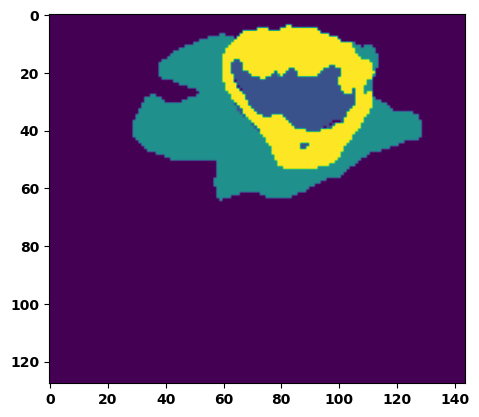

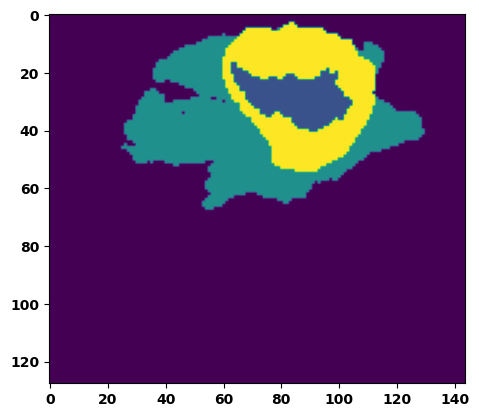

 61%|██████    | 22/36 [00:35<00:23,  1.66s/it]

Batch_id:  22 Test loss:  0.2547193765640259
Batch_id:  22 Test IoU:  tensor(0.6532, device='cuda:0')
Batch_id:  22 Test Mean Dice Score:  tensor(0.9566, device='cuda:0')
Batch_id:  22 Test Non-tumor Dice Score:  tensor(0.9459, device='cuda:0')
Batch_id:  22 Test NCR/NET Dice Score:  tensor(0.9906, device='cuda:0')
Batch_id:  22 Test ED Dice Score:  tensor(0.9411, device='cuda:0')
Batch_id:  22 Test ET Dice Score:  tensor(0.9920, device='cuda:0')


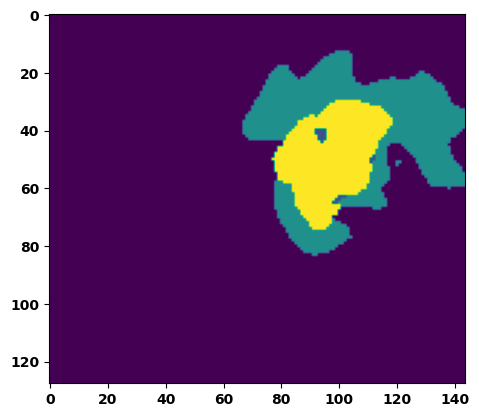

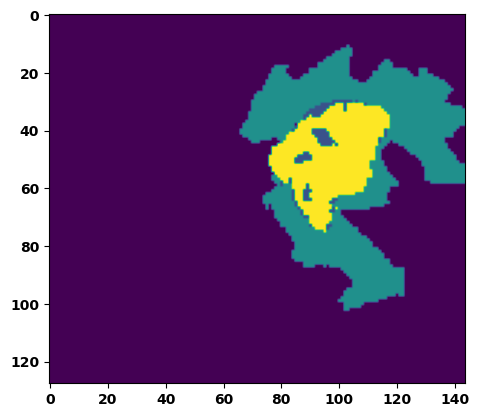

 64%|██████▍   | 23/36 [00:37<00:22,  1.70s/it]

Batch_id:  23 Test loss:  0.20599330961704254
Batch_id:  23 Test IoU:  tensor(0.7065, device='cuda:0')
Batch_id:  23 Test Mean Dice Score:  tensor(0.9819, device='cuda:0')
Batch_id:  23 Test Non-tumor Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  23 Test NCR/NET Dice Score:  tensor(0.9928, device='cuda:0')
Batch_id:  23 Test ED Dice Score:  tensor(0.9837, device='cuda:0')
Batch_id:  23 Test ET Dice Score:  tensor(0.9884, device='cuda:0')


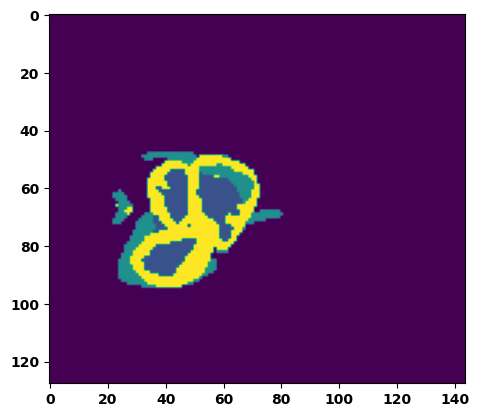

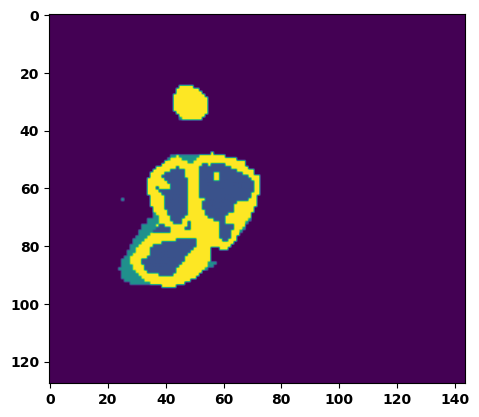

 67%|██████▋   | 24/36 [00:39<00:20,  1.70s/it]

Batch_id:  24 Test loss:  0.25082141160964966
Batch_id:  24 Test IoU:  tensor(0.6678, device='cuda:0')
Batch_id:  24 Test Mean Dice Score:  tensor(0.9886, device='cuda:0')
Batch_id:  24 Test Non-tumor Dice Score:  tensor(0.9890, device='cuda:0')
Batch_id:  24 Test NCR/NET Dice Score:  tensor(0.9959, device='cuda:0')
Batch_id:  24 Test ED Dice Score:  tensor(0.9842, device='cuda:0')
Batch_id:  24 Test ET Dice Score:  tensor(0.9967, device='cuda:0')


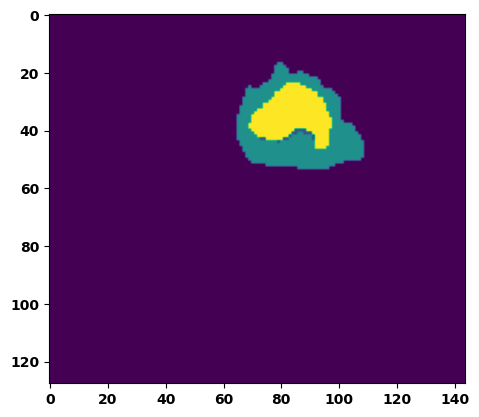

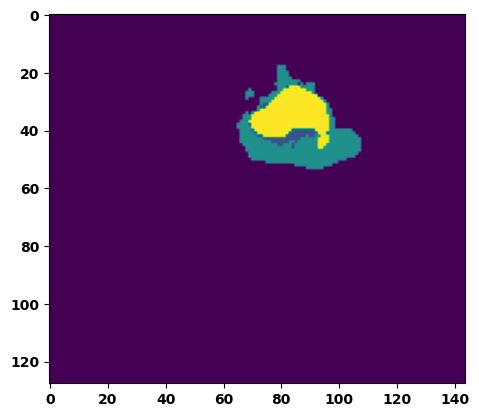

 69%|██████▉   | 25/36 [00:40<00:18,  1.65s/it]

Batch_id:  25 Test loss:  0.22846724092960358
Batch_id:  25 Test IoU:  tensor(0.6772, device='cuda:0')
Batch_id:  25 Test Mean Dice Score:  tensor(0.9811, device='cuda:0')
Batch_id:  25 Test Non-tumor Dice Score:  tensor(0.9852, device='cuda:0')
Batch_id:  25 Test NCR/NET Dice Score:  tensor(0.9897, device='cuda:0')
Batch_id:  25 Test ED Dice Score:  tensor(0.9808, device='cuda:0')
Batch_id:  25 Test ET Dice Score:  tensor(0.9875, device='cuda:0')


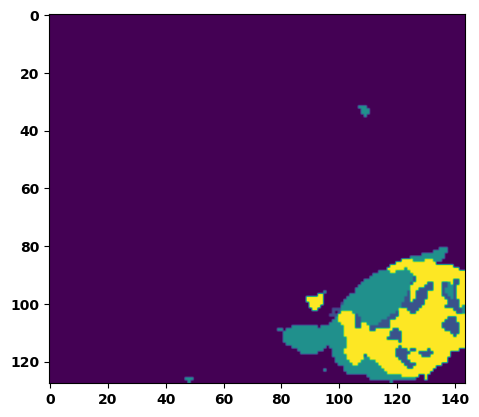

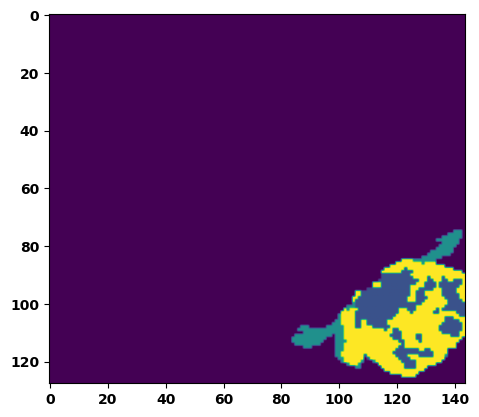

 72%|███████▏  | 26/36 [00:42<00:16,  1.66s/it]

Batch_id:  26 Test loss:  0.2585206627845764
Batch_id:  26 Test IoU:  tensor(0.6972, device='cuda:0')
Batch_id:  26 Test Mean Dice Score:  tensor(0.9786, device='cuda:0')
Batch_id:  26 Test Non-tumor Dice Score:  tensor(0.9721, device='cuda:0')
Batch_id:  26 Test NCR/NET Dice Score:  tensor(0.9983, device='cuda:0')
Batch_id:  26 Test ED Dice Score:  tensor(0.9692, device='cuda:0')
Batch_id:  26 Test ET Dice Score:  tensor(0.9961, device='cuda:0')


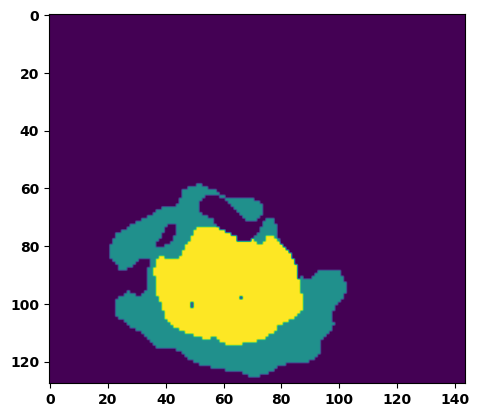

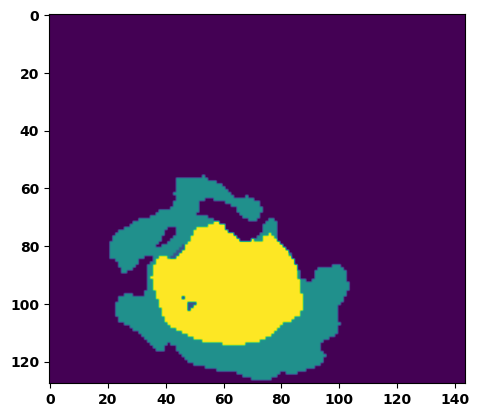

 75%|███████▌  | 27/36 [00:43<00:14,  1.62s/it]

Batch_id:  27 Test loss:  0.1581835299730301
Batch_id:  27 Test IoU:  tensor(0.7600, device='cuda:0')
Batch_id:  27 Test Mean Dice Score:  tensor(0.9766, device='cuda:0')
Batch_id:  27 Test Non-tumor Dice Score:  tensor(0.9779, device='cuda:0')
Batch_id:  27 Test NCR/NET Dice Score:  tensor(0.9846, device='cuda:0')
Batch_id:  27 Test ED Dice Score:  tensor(0.9716, device='cuda:0')
Batch_id:  27 Test ET Dice Score:  tensor(0.9956, device='cuda:0')


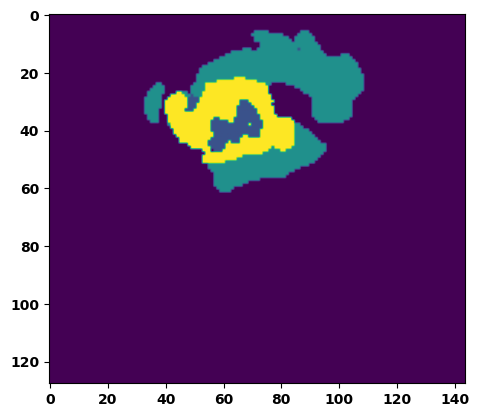

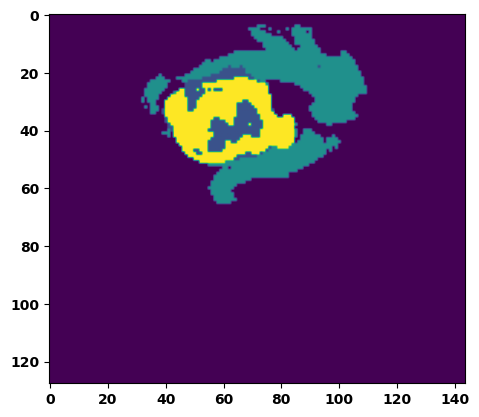

 78%|███████▊  | 28/36 [00:45<00:12,  1.60s/it]

Batch_id:  28 Test loss:  0.06206496059894562
Batch_id:  28 Test IoU:  tensor(0.8935, device='cuda:0')
Batch_id:  28 Test Mean Dice Score:  tensor(0.9884, device='cuda:0')
Batch_id:  28 Test Non-tumor Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  28 Test NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  28 Test ED Dice Score:  tensor(0.9891, device='cuda:0')
Batch_id:  28 Test ET Dice Score:  tensor(0.9931, device='cuda:0')


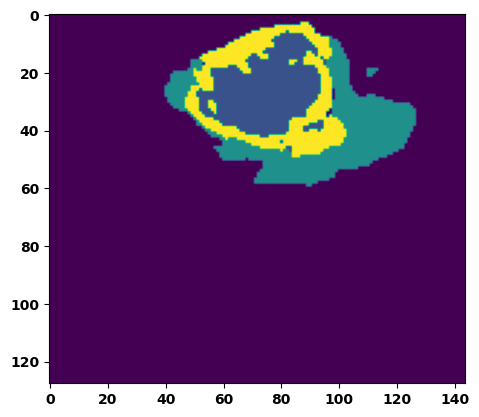

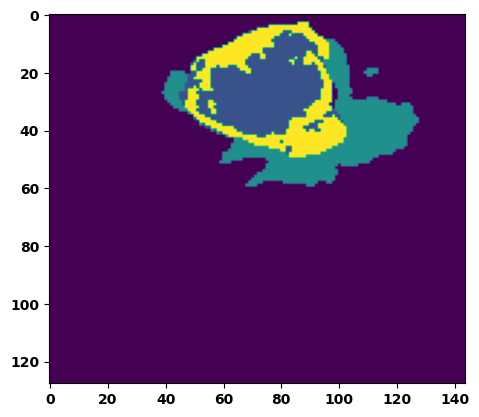

 81%|████████  | 29/36 [00:47<00:11,  1.62s/it]

Batch_id:  29 Test loss:  0.09678852558135986
Batch_id:  29 Test IoU:  tensor(0.8395, device='cuda:0')
Batch_id:  29 Test Mean Dice Score:  tensor(0.9893, device='cuda:0')
Batch_id:  29 Test Non-tumor Dice Score:  tensor(0.9916, device='cuda:0')
Batch_id:  29 Test NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  29 Test ED Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  29 Test ET Dice Score:  tensor(0.9937, device='cuda:0')


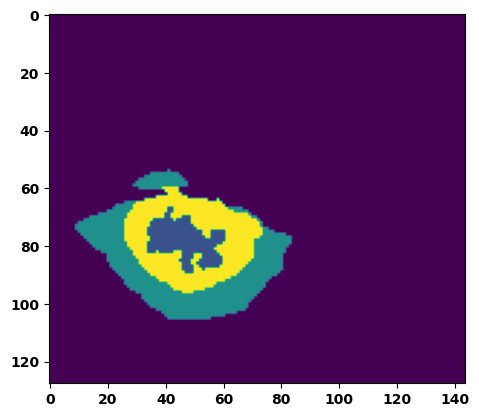

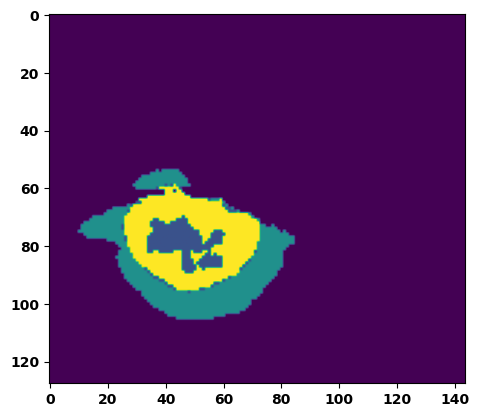

 83%|████████▎ | 30/36 [00:48<00:09,  1.59s/it]

Batch_id:  30 Test loss:  0.38141825795173645
Batch_id:  30 Test IoU:  tensor(0.5035, device='cuda:0')
Batch_id:  30 Test Mean Dice Score:  tensor(0.9427, device='cuda:0')
Batch_id:  30 Test Non-tumor Dice Score:  tensor(0.9887, device='cuda:0')
Batch_id:  30 Test NCR/NET Dice Score:  tensor(0.9280, device='cuda:0')
Batch_id:  30 Test ED Dice Score:  tensor(0.9217, device='cuda:0')
Batch_id:  30 Test ET Dice Score:  tensor(0.9898, device='cuda:0')


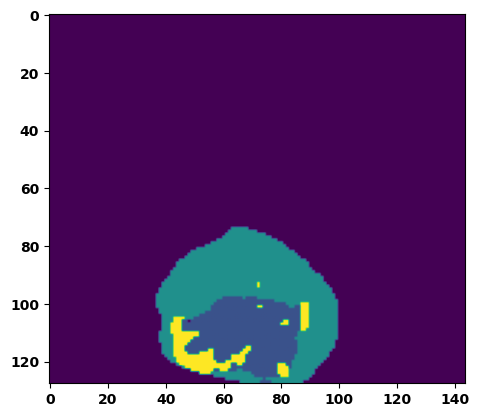

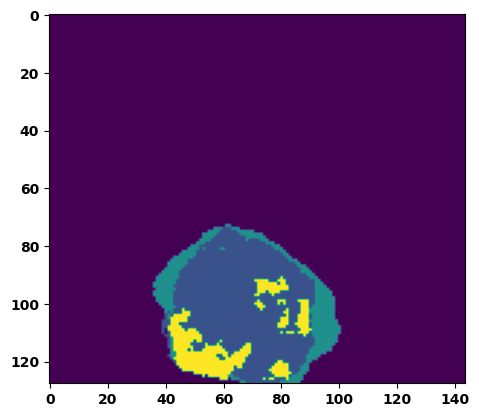

 86%|████████▌ | 31/36 [00:50<00:07,  1.58s/it]

Batch_id:  31 Test loss:  0.20668543875217438
Batch_id:  31 Test IoU:  tensor(0.6910, device='cuda:0')
Batch_id:  31 Test Mean Dice Score:  tensor(0.9730, device='cuda:0')
Batch_id:  31 Test Non-tumor Dice Score:  tensor(0.9713, device='cuda:0')
Batch_id:  31 Test NCR/NET Dice Score:  tensor(0.9937, device='cuda:0')
Batch_id:  31 Test ED Dice Score:  tensor(0.9678, device='cuda:0')
Batch_id:  31 Test ET Dice Score:  tensor(0.9863, device='cuda:0')


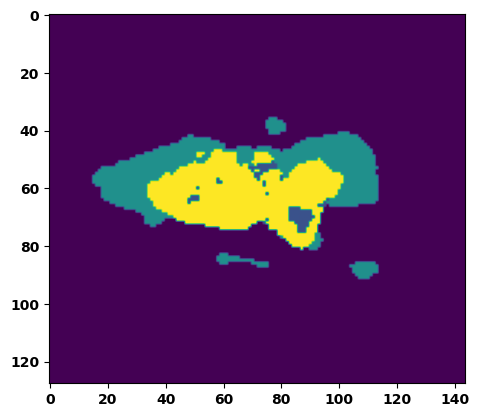

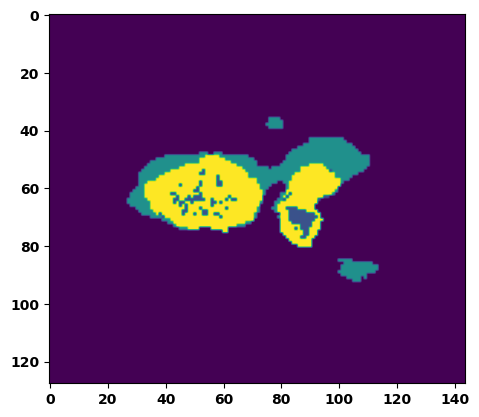

 89%|████████▉ | 32/36 [00:51<00:06,  1.59s/it]

Batch_id:  32 Test loss:  0.08516903221607208
Batch_id:  32 Test IoU:  tensor(0.8568, device='cuda:0')
Batch_id:  32 Test Mean Dice Score:  tensor(0.9854, device='cuda:0')
Batch_id:  32 Test Non-tumor Dice Score:  tensor(0.9857, device='cuda:0')
Batch_id:  32 Test NCR/NET Dice Score:  tensor(0.9907, device='cuda:0')
Batch_id:  32 Test ED Dice Score:  tensor(0.9832, device='cuda:0')
Batch_id:  32 Test ET Dice Score:  tensor(0.9964, device='cuda:0')


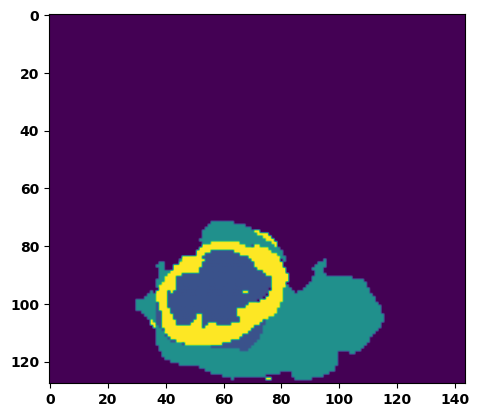

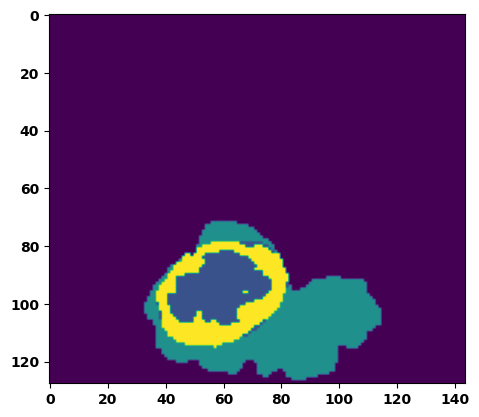

 92%|█████████▏| 33/36 [00:53<00:05,  1.68s/it]

Batch_id:  33 Test loss:  0.1551281362771988
Batch_id:  33 Test IoU:  tensor(0.7715, device='cuda:0')
Batch_id:  33 Test Mean Dice Score:  tensor(0.9775, device='cuda:0')
Batch_id:  33 Test Non-tumor Dice Score:  tensor(0.9743, device='cuda:0')
Batch_id:  33 Test NCR/NET Dice Score:  tensor(0.9957, device='cuda:0')
Batch_id:  33 Test ED Dice Score:  tensor(0.9727, device='cuda:0')
Batch_id:  33 Test ET Dice Score:  tensor(0.9897, device='cuda:0')


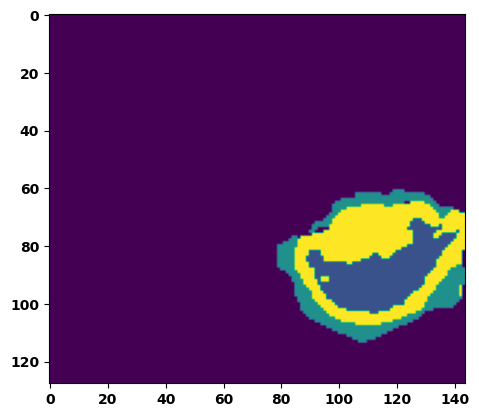

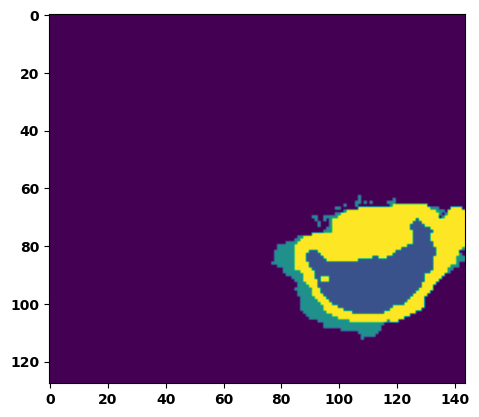

 94%|█████████▍| 34/36 [00:55<00:03,  1.62s/it]

Batch_id:  34 Test loss:  0.2358788102865219
Batch_id:  34 Test IoU:  tensor(0.6663, device='cuda:0')
Batch_id:  34 Test Mean Dice Score:  tensor(0.9682, device='cuda:0')
Batch_id:  34 Test Non-tumor Dice Score:  tensor(0.9804, device='cuda:0')
Batch_id:  34 Test NCR/NET Dice Score:  tensor(0.9781, device='cuda:0')
Batch_id:  34 Test ED Dice Score:  tensor(0.9672, device='cuda:0')
Batch_id:  34 Test ET Dice Score:  tensor(0.9790, device='cuda:0')


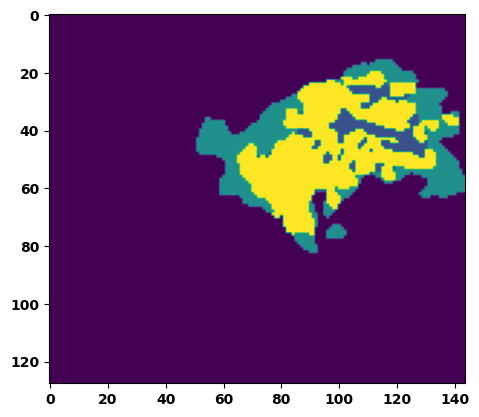

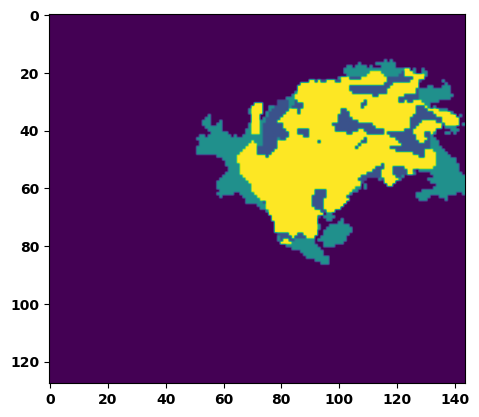

 97%|█████████▋| 35/36 [00:56<00:01,  1.60s/it]

Batch_id:  35 Test loss:  0.21183280646800995
Batch_id:  35 Test IoU:  tensor(0.7013, device='cuda:0')
Batch_id:  35 Test Mean Dice Score:  tensor(0.9638, device='cuda:0')
Batch_id:  35 Test Non-tumor Dice Score:  tensor(0.9487, device='cuda:0')
Batch_id:  35 Test NCR/NET Dice Score:  tensor(0.9979, device='cuda:0')
Batch_id:  35 Test ED Dice Score:  tensor(0.9505, device='cuda:0')
Batch_id:  35 Test ET Dice Score:  tensor(0.9943, device='cuda:0')


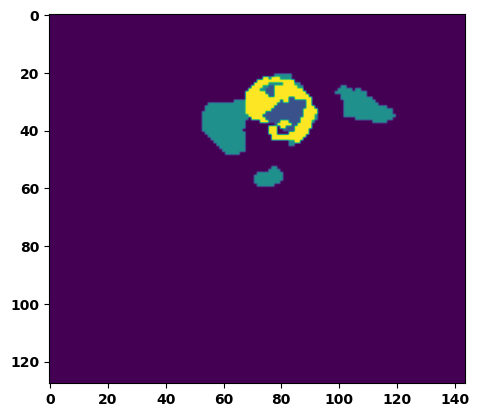

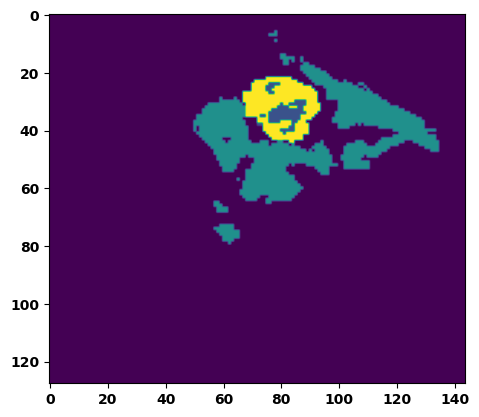

100%|██████████| 36/36 [00:58<00:00,  1.62s/it]

Avg IoU:  tensor(0.7123)
Avg Loss:  0.7758012697100639
Avg Dice Scores:  tensor(0.9737)
Non-Tumor Dice Scores:  tensor(0.9725)
NCR/NET Dice Scores:  tensor(0.9879)
ED Dice Scores:  tensor(0.9684)
ET Dice Scores:  tensor(0.9921)


In [39]:
"""
yellow - label 4
dark blue - label 1 
green - label 2 

purple - label 0
"""

main(0.70)

In [ ]:
'''
input:

y: [slice_num,h,w]

x:[slice_num,input_channel,h,w]

res:[slice_num,output_channel,h,w]


'''

def feature_extraction():
    # Load data
    train_data = torch.load(MODEL_PATH+'trdata.pth')
    eval_data = torch.load(MODEL_PATH+'edata.pth')
    test_data = torch.load(MODEL_PATH+'tdata.pth')
    
    train_pred=torch.tensor()
    train_tar=torch.tensor()
    
    eval_pred=torch.tensor()
    eval_tar=torch.tensor()
    
    test_pred=torch.tensor()
    test_tar=torch.tensor()
    
    
    
    checkpoint = torch.load(MODEL_PATH+'#19-BEST')
    model = Unet(in_channel=INPUT_CHANNEL,out_channel=4).to(device)
    opt = optim.Adam(model.parameters(), lr=LEARNING_RATE)
    model.load_state_dict(checkpoint['model_state_dict'])
    opt.load_state_dict(checkpoint['optim_state_dict'])
    
    print('Best Model loaded!')
 


    #training data set
    print('Training data feature extraction: ')
    model.eval()
    with torch.no_grad():
        
        for index, batch in enumerate(train_data):
            x, y,other= batch 
            a,b,c,d,e=x.shape
            x=x.reshape(a*b,c,d,e)
            x=x.float()
        
            a,b,c,d=y.shape
            y=y.reshape(a*b,c,d)
        
            x,y=x.to(device),y.to(device)
            res = model(x)
            res=res.to(device)
            res = torch.argmax(res,dim=1)

            
            
    #Eval data set    
    print('Eval data feature extraction: ')
    
    with torch.no_grad():
        
        for index, batch in enumerate(eval_data):
            x, y,other= batch 
            a,b,c,d,e=x.shape
            x=x.reshape(a*b,c,d,e)
            x=x.float()
        
            a,b,c,d=y.shape
            y=y.reshape(a*b,c,d)
        
            x,y=x.to(device),y.to(device)
            res,dfeatures = model(x)
            res=res.to(device)   
            dfeatures=dfeatures.to(device)
            res = torch.argmax(res,dim=1)
            res = F.one_hot(res,num_classes=4)
            res = res.permute(0,3,1,2)
            y=F.one_hot(y,num_classes=4)
            y = y.permute(0,3,1,2)
            pred = torch.cat((res,dfeatures),dim=1)
            target = torch.cat((res,dfeatures),dim=1)
            if index == 1:
                eval_pred=pred
                eval_tar=target
            else
                eval_pred=torch.cat((eval_pred,pred),dim=0)
                eval_tar=torch.cat((eval_tar,target),dim=0)    
    
    
    
    
    
    #Test data set    
    print('Test data feature extraction: ')
    
    with torch.no_grad():
        
        for index, batch in enumerate(test_data):
            x, y,other= batch 
            a,b,c,d,e=x.shape
            x=x.reshape(a*b,c,d,e)
            x=x.float()
        
            a,b,c,d=y.shape
            y=y.reshape(a*b,c,d)
        
            x,y=x.to(device),y.to(device)
            res,dfeatures = model(x)
            res=res.to(device)    
            dfeatures=dfeatures.to(device)
            res = torch.argmax(res,dim=1)
            res = F.one_hot(res,num_classes=4)
            res = res.permute(0,3,1,2)
            y=F.one_hot(y,num_classes=4)
            y = y.permute(0,3,1,2)
            pred = torch.cat((res,dfeatures),dim=1)
            target = torch.cat((res,dfeatures),dim=1)
            if index == 1:
                test_pred=pred
                test_tar=target
            else
                test_pred=torch.cat((test_pred,pred),dim=0)
                test_tar=torch.cat((test_tar,target),dim=0) 
    
    

In [ ]:
def feature_reduction():
    

In [ ]:
# classification class def: short-term(0): less than 10 months, mid-term(1): between 10 months and 15 months
# long-term(2): more than 15 months

def prediction Model():
    
    